In [1]:
#%pip install tensorflow --user

In [1]:
import random
import numpy as np
import pandas as pd
from keras.layers import Dense
from keras.models import Sequential
from keras.optimizers import Adam

%matplotlib inline
%load_ext autoreload
%autoreload 2

## Работа с данными

In [2]:
t = pd.read_csv('LKOH20150310.csv')
t.head()

,Time,BidPrice1,BidVolume1,AskPrice1,AskVolume1,Last Trade Price,Last Trade Volume,Side,isNewTrade,LastDealTime,...,BidLiquidityRatio,FutureVWAP1,FutureVWAP30,FutureVWAP60,Difference1,Difference30,Difference60,IsUp1,IsUp30,IsUp60
0,1900-01-01 10:00:02.013,2787.2,246.0,2789.0,201.0,2788.9,19.0,1.0,0.0,100001988.0,...,0.550336,2791.158259,2791.139716,2788.789634,6.227369,9.170860,6.820778,1.0,1.0,1.0
1,1900-01-01 10:00:02.036,2787.2,166.0,2789.0,201.0,2787.2,80.0,1.0,-1.0,100002036.0,...,0.452316,2791.191749,2791.139716,2788.789634,5.328342,8.930348,6.580266,1.0,1.0,1.0
2,1900-01-01 10:00:02.047,2787.2,161.0,2789.0,201.0,2787.2,5.0,1.0,0.0,100002047.0,...,0.444751,2791.191749,2791.139716,2788.789634,5.328342,8.930348,6.580266,1.0,1.0,1.0
3,1900-01-01 10:00:02.191,2787.3,40.0,2789.0,201.0,2787.2,5.0,1.0,0.0,100002047.0,...,0.165975,2791.379439,2791.139716,2788.789634,5.516032,8.930348,6.580266,1.0,1.0,1.0
4,1900-01-01 10:00:02.373,2787.3,40.0,2789.0,195.0,2789.0,6.0,1.0,1.0,100002373.0,...,0.170213,2791.348007,2790.852239,2788.789634,3.786242,8.605351,6.542746,1.0,1.0,1.0


In [3]:
data = t[['AskPrice1', 'AskVolume1', 'BidPrice1', 'BidVolume1']]
data.head()

,AskPrice1,AskVolume1,BidPrice1,BidVolume1
0,2789.0,201.0,2787.2,246.0
1,2789.0,201.0,2787.2,166.0
2,2789.0,201.0,2787.2,161.0
3,2789.0,201.0,2787.3,40.0
4,2789.0,195.0,2787.3,40.0


In [4]:
data.drop_duplicates(inplace=True)

<ipython-input-4-515f69ef7765>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop_duplicates(inplace=True)


In [5]:
class DataFeed(object):
    def __init__(self, data_RA):
        self.data_RA = data_RA
        self.rewind()
    def next(self):
        try:
            return self.__gen.__next__()
        except StopIteration as e:
            raise e
    def rewind(self):
        self.__gen = (row for row in self.data_RA)

In [6]:
data_RA = np.array(data)
data_generator = DataFeed(data_RA)

## Среда для DQN агента

In [7]:
class Env(object):
    """Abstract class for an environment. Simplified OpenAI API.
    """

    def __init__(self):
        self.n_actions = None
        self.state_shape = None

    def step(self, action):
        """Run one timestep of the environment's dynamics.
        Accepts an action and returns a tuple (observation, reward, done, info).
        Args:
            action (numpy.array): action array
        Returns:
            tuple:
                - observation (numpy.array): Agent's observation of the current environment.
                - reward (float) : Amount of reward returned after previous action.
                - done (bool): Whether the episode has ended, in which case further step() calls will return undefined results.
                - info (str): Contains auxiliary diagnostic information (helpful for debugging, and sometimes learning).
        """
        raise NotImplementedError()

    def reset(self):
        """Reset the state of the environment and returns an initial observation.
        Returns:
            numpy.array: The initial observation of the space. Initial reward is assumed to be 0.
        """
        raise NotImplementedError()

    def render(self):
        """Render the environment.
        """
        raise NotImplementedError()

In [8]:
class SpreadTrading(Env):
    """Class for a discrete (buy/hold/sell) spread trading environment.
    """

    _actions = {
        'hold': np.array([1, 0, 0]),
        'buy': np.array([0, 1, 0]),
        'sell': np.array([0, 0, 1])
    }

    _positions = {
        'flat': np.array([1, 0, 0]),
        'long': np.array([0, 1, 0]),
        'short': np.array([0, 0, 1])
    }

    def __init__(self, data_generator, spread_coefficients, episode_length=1000, trading_fee=0, time_fee=0, cash_limit_total=1000000, cash_deal_limit=50000, history_length=2, amount_own=0):
        """Initialisation function
        Args:
            data_generator (tgym.core.DataGenerator): A data
                generator object yielding a 1D array of bid-ask prices.
            spread_coefficients (list): A list of signed integers defining
                how much of each product to buy (positive) or sell (negative)
                when buying or selling the spread.
            episode_length (int): number of steps to play the game for
            trading_fee (float): penalty for trading
            time_fee (float): time fee
            depths_history: bid, ask depth
            history_length (int): number of historical states to stack in the
                observation vector.
        """
        #assert data_generator.n_products == len(spread_coefficients)
        assert history_length > 0
        self._data_generator = data_generator
        self._spread_coefficients = spread_coefficients
        self._first_render = True
        self._trading_fee = trading_fee
        self._time_fee = time_fee
        self._episode_length = episode_length
        self.n_actions = 3
        self._prices_history = []
        self._depths_history = []
        self._history_length = history_length
        self._cash_limit_total = cash_limit_total
        self._cash_deal_limit = cash_deal_limit
        self._amount_own = amount_own
        self.reset()

    def reset(self):
        """Reset the trading environment. Reset rewards, data generator...
        Returns:
            observation (numpy.array): observation of the state
        """
        self._iteration = 0
        self._data_generator.rewind()
        self._total_reward = 0
        self._total_pnl = 0
        self._position = self._positions['flat']
        #попробать ещё none поставить на entry_price/exit_price
        self._entry_price = 0
        self._exit_price = 0
        self._closed_plot = False
        self._cash_limit_total = 1000000
        self._amount_own = 0

        for i in range(self._history_length):
            gen = np.array(self._data_generator.next())
            self._prices_history.append(gen[[2,0]])
            self._depths_history.append(gen[[3,1]])
        
        #self._ask, self._ask_depth, self._bid, self._bid_depth = self._data_generator.next()
        #self._price = {'bid': self._bid, 'ask': self._ask}

        observation = self._get_observation()
        self.state_shape = observation.shape
        self._action = self._actions['hold']

        self._bid_vol = self._cash_deal_limit/gen[2]
        self._ask_vol = self._cash_deal_limit/gen[0]
            
        if self._bid_vol < gen[3]:
            self._bid_vol = self._bid_vol
        else:
            self._bid_vol = gen[3]
        
        if self._ask_vol < gen[1]:
            self._ask_vol = self._ask_vol
        else:
            self._ask_vol = gen[1]

        
        return observation

    def step(self, action):
        """Take an action (buy/sell/hold) and computes the immediate reward.
        Args:
            action (numpy.array): Action to be taken, one-hot encoded.
        Returns:
            tuple:
                - observation (numpy.array): Agent's observation of the current environment.
                - reward (float) : Amount of reward returned after previous action.
                - done (bool): Whether the episode has ended, in which case further step() calls will return undefined results.
                - info (dict): Contains auxiliary diagnostic information (helpful for debugging, and sometimes learning).
        """

        assert any([(action == x).all() for x in self._actions.values()])
        self._action = action
        self._iteration += 1
        done = False
        instant_pnl = 0
        info = {}
        reward = -self._time_fee
        #r = np.random.rand(1)
        q = np.float(self._depths_history[-1][0])/(self._depths_history[-1][0] + self._depths_history[-1][1])
        fill_ask = True 
        fill_bid = True 
        
        #if q>0.8:
        #    fill_bid = False 
        #elif q<0.2:
        #    fill_ask = False 

        if all(action == self._actions['buy']) and (fill_bid) and (self._cash_limit_total > 0):
            reward -= self._trading_fee
            if all(self._position == self._positions['flat']):         
                self._position = self._positions['long']
                self._entry_price =  self._prices_history[-1][0]  # bid
                #reward -= 0 #self._entry_price
                #уменьшаем кэш с учётом объёма и цены покупки            
                self._cash_limit_total -= self._bid_vol*self._entry_price
                #увеличиваем число акции которое есть у агента в inventory
                self._amount_own += self._bid_vol
            elif all(self._position == self._positions['short']): # closed out a short position          
                self._position = self._positions['flat']
                self._exit_price = self._prices_history[-1][0]  # bid
                #прибыль/убыток от закрытия короткой позиции
                instant_pnl = self._bid_vol*(self._entry_price - self._exit_price)
                self._entry_price = 0
            #elif all(self._position == self._positions['long']):
                #raise ValueError("can't buy already got")
        
        elif all(action == self._actions['sell']) and (fill_ask):
            reward -= self._trading_fee
            if all(self._position == self._positions['flat']):
                self._position = self._positions['short']
                self._entry_price = self._prices_history[-1][1]  # ask
                self._cash_limit_total += self._ask_vol*self._entry_price
                self._amount_own -= self._ask_vol
            elif all(self._position == self._positions['long']):
                self._exit_price = self._prices_history[-1][1]  # ask
                self._position = self._positions['flat']
                instant_pnl = self._ask_vol*(self._exit_price - self._entry_price)
                self._entry_price = 0
            #elif all(self._position == self._positions['short']):
                #raise ValueError("can't sell already short")
                
        reward += instant_pnl
        self._total_pnl += instant_pnl
        self._total_reward += reward

        # Game over logic
        try:
            gen = np.array(self._data_generator.next())
            #self._price = {'bid': gen[2], 'ask': gen[0]}
            self._bid_vol = self._cash_deal_limit/gen[2]
            self._ask_vol = self._cash_deal_limit/gen[0]
            
            if self._bid_vol < gen[3]:
                self._bid_vol = self._bid_vol
            else:
                self._bid_vol = gen[3]
        
            if self._ask_vol < gen[1]:
                self._ask_vol = self._ask_vol
            else:
                self._ask_vol = gen[1]
                
            self._prices_history.append(gen[[2,0]])
            self._depths_history.append(gen[[3,1]])
        except StopIteration:
            done = True
            info['status'] = 'No more data.'
        if self._iteration >= self._episode_length:
            done = True
            info['status'] = 'Time out.'
        if self._closed_plot:
            info['status'] = 'Closed plot'

        observation = self._get_observation()
        return observation, reward, done, info
    
    def _handle_close(self, evt):
        self._closed_plot = True

    def render(self, savefig=False, filename='myfig'):
        """Matlplotlib rendering of each step.
        Args:
            savefig (bool): Whether to save the figure as an image or not.
            filename (str): Name of the image file.
        """
        if self._first_render:
            self._f, self._ax = plt.subplots(
                len(self._spread_coefficients) + int(len(self._spread_coefficients) > 1),
                sharex=True
            )
            if len(self._spread_coefficients) == 1:
                self._ax = [self._ax]
            self._f.set_size_inches(12, 6)
            self._first_render = False
            self._f.canvas.mpl_connect('close_event', self._handle_close)
        if len(self._spread_coefficients) > 1:
            # TODO: To be checked
            for prod_i in range(len(self._spread_coefficients)):
                bid = self._prices_history[-1][2 * prod_i]
                ask = self._prices_history[-1][2 * prod_i + 1]
                self._ax[prod_i].plot([self._iteration, self._iteration + 1],
                                      [bid, bid], color='white')
                self._ax[prod_i].plot([self._iteration, self._iteration + 1],
                                      [ask, ask], color='white')
                self._ax[prod_i].set_title('Product {} (spread coef {})'.format(
                    prod_i, str(self._spread_coefficients[prod_i])))

        # Spread price
        prices = self._prices_history[-1]
        bid, ask = calc_spread(prices, self._spread_coefficients)
        self._ax[-1].plot([self._iteration, self._iteration + 1],
                          [bid, bid], color='white')
        self._ax[-1].plot([self._iteration, self._iteration + 1],
                          [ask, ask], color='white')
        ymin, ymax = self._ax[-1].get_ylim()
        yrange = ymax - ymin
        if (self._action == self._actions['sell']).all():
            self._ax[-1].scatter(self._iteration + 0.5, bid + 0.03 *
                                 yrange, color='orangered', marker='v')
        elif (self._action == self._actions['buy']).all():
            self._ax[-1].scatter(self._iteration + 0.5, ask - 0.03 *
                                 yrange, color='lawngreen', marker='^')
        plt.suptitle('Cumulated Reward: ' + "%.2f" % self._total_reward + ' ~ ' +
                     'Cumulated PnL: ' + "%.2f" % self._total_pnl + ' ~ ' +
                     'Position: ' + ['flat', 'long', 'short'][list(self._position).index(1)] + ' ~ ' +
                     'Entry Price: ' + "%.2f" % self._entry_price)
        self._f.tight_layout()
        plt.xticks(range(self._iteration)[::5])
        plt.xlim([max(0, self._iteration - 80.5), self._iteration + 0.5])
        plt.subplots_adjust(top=0.85)
        plt.pause(0.01)
        if savefig:
            plt.savefig(filename)

    def _get_observation(self):
        """Concatenate all necessary elements to create the observation.
        Returns:
            numpy.array: observation array.
        """
        return np.concatenate(
            [prices for prices in self._prices_history[-self._history_length:]] +

            [depths for depths in self._depths_history[-self._history_length:]] +
            [
                np.array([self._entry_price]),
                np.array(self._position)
            ]
        )

    @staticmethod
    def random_action_fun():
        """The default random action for exploration.
        We hold 80% of the time and buy or sell 10% of the time each.
        Returns:
            numpy.array: array with a 1 on the action index, 0 elsewhere.
        """
        return np.random.multinomial(1, [0.8, 0.1, 0.1])

## Агент DQN

In [9]:
class DQNAgent:
    def __init__(self,
                 state_size,
                 action_size,
                 episodes,
                 episode_length,
                 memory_size=2000,
                 train_interval=100,
                 gamma=0.95,
                 learning_rate=0.001,
                 batch_size=64,
                 epsilon_min=0.01
                 ):
        self.state_size = state_size
        self.action_size = action_size
        self.memory_size = memory_size
        self.memory = [None] * memory_size
        self.gamma = gamma
        self.epsilon = 1.0
        self.epsilon_min = epsilon_min
        self.epsilon_decrement = (self.epsilon - epsilon_min)\
            * train_interval / (episodes * episode_length)  # linear decrease rate
        self.learning_rate = learning_rate
        self.train_interval = train_interval
        self.batch_size = batch_size
        self.brain = self._build_brain()
        self.i = 0

    def _build_brain(self):
        """Build the agent's brain
        """
        brain = Sequential()
        neurons_per_layer = 24
        activation = "relu"
        brain.add(Dense(neurons_per_layer,
                        input_dim=self.state_size,
                        activation=activation))
        brain.add(Dense(neurons_per_layer, activation=activation))
        brain.add(Dense(self.action_size, activation='linear'))
        brain.compile(loss='mse', optimizer=Adam(lr=self.learning_rate))
        return brain

    def act(self, state):
        """Acting Policy of the DQNAgent
        """
        action = np.zeros(self.action_size)
        valid_actions = []
        position = state[-3:]
        
        if all(position == [1,0,0]): # flat
            valid_actions = [0,1,2]
        elif all(position == [0,1,0]):  # long
            valid_actions = [0,2]  # hold or sell
        else: # short
            valid_actions = [0,1]  # hold or buy
        
        if np.random.rand() <= self.epsilon:    
            action[valid_actions[random.randrange(len(valid_actions))]] = 1   
        else:
            state = state.reshape(1, self.state_size)
            act_values = self.brain.predict(state)
            print(act_values[0])
            action[valid_actions[np.argmax(act_values[0][valid_actions])]] = 1
        return action

    def observe(self, state, action, reward, next_state, done, warming_up=False):
        """Memory Management and training of the agent
        """
        self.i = (self.i + 1) % self.memory_size
        self.memory[self.i] = (state, action, reward, next_state, done)
        if (not warming_up) and (self.i % self.train_interval) == 0:
            if self.epsilon > self.epsilon_min:
                self.epsilon -= self.epsilon_decrement
            state, action, reward, next_state, done = self._get_batches()
            #print(next_state)
            reward += (self.gamma
                       * np.logical_not(done)
                       * np.amax(self.brain.predict(np.asarray(next_state).astype('float32')),
                                 axis=1))
            q_target = self.brain.predict(np.asarray(state).astype('float32'))
            print ("state: ", state[0])
            print ("action[0]: ", action[0])
            print ("action[1]: ", action[1])
            print ("q_target: ", q_target[action[0], action[1]])
            print ("reward: ", reward)
            
            q_target[action[0], action[1]] = reward
            return self.brain.fit(np.asarray(state).astype('float32'), q_target,
                                  batch_size=self.batch_size,
                                  epochs=1,
                                  verbose=False)

    def _get_batches(self):
        """Selecting a batch of memory
           Split it into categorical subbatches
           Process action_batch into a position vector
        """
        batch = np.array(random.sample(self.memory, self.batch_size))
        state_batch = np.concatenate(batch[:, 0])\
            .reshape(self.batch_size, self.state_size)
        action_batch = np.concatenate(batch[:, 1])\
            .reshape(self.batch_size, self.action_size)
        reward_batch = batch[:, 2]
        next_state_batch = np.concatenate(batch[:, 3])\
            .reshape(self.batch_size, self.state_size)
        done_batch = batch[:, 4]
        # action processing
        action_batch = np.where(action_batch == 1)
        return state_batch, action_batch, reward_batch, next_state_batch, done_batch

## Обучение

In [10]:
import matplotlib.pyplot as plt
#import sys
#sys.path.append('/Users/matthewdixon/Downloads/Trading-Gym/')
#from tgym.envs import SpreadTrading
#from tgym.gens.deterministic import WavySignal
#from tgym.gens.random import AR1
#from tgym.gens.csvstream import CSVStreamer
# Instantiating the environmnent
generator = data_generator
#generator = AR1(a=0.1, ba_spread=0.1)   #WavySignal(period_1=25, period_2=50, epsilon=-0.5)
episodes = 100
episode_length = 400
trading_fee = .0
time_fee = 0
history_length = 2
environment = SpreadTrading(spread_coefficients=[1],
                            data_generator=generator,
                                trading_fee=trading_fee,
                                time_fee=time_fee,
                                history_length=history_length)

In [11]:
state = environment.reset()
# Instantiating the agent
memory_size = 3000
state_size = len(state)
gamma = 0.96
epsilon_min = 0.01
batch_size = 64
action_size = len(SpreadTrading._actions)
train_interval = 10
learning_rate = 0.001
agent = DQNAgent(state_size=state_size,
                     action_size=action_size,
                     memory_size=memory_size,
                     episodes=episodes,
                     episode_length=episode_length,
                     train_interval=train_interval,
                     gamma=gamma,
                     learning_rate=learning_rate,
                     batch_size=batch_size,
                     epsilon_min=epsilon_min)

In [12]:
# Warming up the agent
for _ in range(memory_size):
        action = agent.act(state)
        next_state, reward, done, _ = environment.step(action)
        agent.observe(state, action, reward, next_state, done, warming_up=True)
        
rews = []
losses = []
epsilons = []
# Training the agent
for ep in range(episodes):
    state = environment.reset()
    rew = 0
    for _ in range(episode_length):
        action = agent.act(np.asarray(state).astype('float32'))
        
        for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            position_name = position
        
    
        for _action in environment._actions:
          if all(action==environment._actions[_action]):
            action_name = _action
        
        next_state, reward, done, _ = environment.step(action)
        
        for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            next_position_name = position
        
        
           
        #print position_name, action_name, next_position_name
        loss = agent.observe(state, action, reward, next_state, done)
        state = next_state
        rew += reward
    print("Ep:" + str(ep)
           + "| rew:" + str(round(rew, 2))
           + "| eps:" + str(round(agent.epsilon, 2))
           + "| loss:" + str(round(loss.history["loss"][0], 4)))
    rews.append(rew)
    epsilons.append(agent.epsilon)
    losses.append(loss.history["loss"][0])

<ipython-input-9-3159d9e736ed>:98: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  batch = np.array(random.sample(self.memory, self.batch_size))


state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 0 0 0 1 2 0 0 0 2 0 2 2 1 0 0 1 1 0 2 2 2 2 1 2 1 1 2 1 0 0 2 2 0
 2 2 0 1 0 2 0 0 2 2 0 2 2 1 1 0 0 1 2 0 1 2 2 1 1 2 1]
q_target:  [1565.2427  -485.15314 1565.2427   188.0102  1565.2427  1565.2427
 1565.2427   188.0102  -485.15314 1565.2427  1565.2427  1565.2427
 -485.15314 1565.2427  -485.15314 -485.15314  188.0102  1565.2427
 1565.2427   188.0102   188.0102  1565.2427  -485.15314 -485.15314
 -485.15314 -485.15314  188.0102  -485.15314  188.0102   188.0102
 -485.1531   188.0102  1565.2427  1565.2427  -485.15314 -485.15314
 1565.2427  -485.15314 -485.15314 1565.2427   188.0102  1565.2427
 -485.15314 1565.2427  1565.242

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 0 2 2 2 0 0 2 0 1 2 0 2 0 2 0 0 1 1 1 0 1 1 2 1 2 1 2 2 0 2 1 1
 0 1 1 0 0 2 2 2 2 2 2 1 0 1 2 2 1 1 2 2 2 0 1 1 2 2 2]
q_target:  [ 408.13907  408.13907  408.13907  408.13907 -291.4948  1160.7312
 -291.4948  -291.4948  -291.4948  1160.7312  1160.7312  -291.4948
 1160.7312   408.13907 -291.4948  1160.7312  -291.4948  1160.7312
 -291.4948  1160.7312  1160.7312   408.13907  408.13907  408.13907
 1160.7312   408.13907  408.13907 -291.4948   408.13907 -291.4948
  408.139   -291.49496 -291.4948  1160.7312  -291.4948   408.13907
  408.13907 1160.7312   408.13907  408.13907 1160.7312  1160.7312
 -291.4948  -291.4948  -291.494

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 0 1 2 1 0 0 0 0 0 1 0 1 2 2 0 2 1 2 2 1 0 2 1 1 2 2 1 1 0 1 2 1 0
 2 2 1 2 0 1 2 1 2 2 2 1 2 2 1 1 2 2 1 0 0 1 0 0 0 2 0]
q_target:  [ 848.64246  435.25204  510.61038  848.64246 1039.2698   510.61038
 -137.94743  510.61038 1043.2051   848.64246  848.64246  848.64246
  848.64246  510.61038  848.64246  510.61038 -137.94743 -137.94743
  848.64246 -137.94743  510.61038 -137.94743 -137.94743  510.61038
  848.64246 -137.94743  510.61038  510.61038 -137.94743 -284.52792
  510.61038  510.61038  848.64246  510.61038 -137.94743  510.61038
  848.64246 -137.94743 -137.94743  510.61038 -137.94743  848.64246
  510.61038 -137.94743  51

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 1 0 1 0 2 2 2 1 1 0 1 2 1 1 2 1 1 0 2 1 1 1 1 0 0 0 2 1 2 2 2 0 1
 0 1 0 0 1 1 2 2 2 2 2 1 2 0 1 2 0 2 0 0 2 1 2 0 0 2 2]
q_target:  [582.3842   -12.722716 582.3842   521.0762   521.0762   582.3842
 521.0762   582.3842   -12.722716 -12.722716 -12.722716 521.0762
 521.0762   582.3842   521.0762   -12.722716 521.0762   521.0762
 -12.722716 521.0762   521.0762   582.3842   -12.722716 521.0762
 521.0762   521.0762   521.0762   582.3842   582.3842   561.3673
 -12.722705 521.07623  -12.722716 -12.722716 -12.722716 582.3842
 521.0762   582.3842   521.0762   582.3842   582.3842   521.0762
 521.0762   -12.722716 -12.722716 -12.72

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 2 1 2 1 1 2 0 2 1 1 1 0 1 0 2 1 0 1 2 0 0 1 1 2 0 1 1 2 1 0 1 0 1
 1 1 1 2 2 1 1 0 2 1 1 1 0 0 1 1 1 1 0 1 0 0 1 2 1 1 0]
q_target:  [326.33    419.2127  419.2127  326.33     87.59315 419.2127   87.59315
 419.2127  419.2127   87.59315 326.33     87.59315 419.2127  419.2127
 419.2127  326.33    419.2127  326.33     87.59315 419.2127  326.33
 419.2127   87.59315 384.08072 326.33    419.2127  419.2127   87.59315
 326.33    419.2127  419.2126   87.59315 419.2127  326.33    419.2127
 419.34967 419.2127  419.2127  419.2127  419.2127   87.59315  87.59315
 421.9018  419.2127  326.33     65.48806 419.2127  419.2127  419.2127
 326

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 0 0 0 2 0 0 0 2 0 0 0 2 0 2 1 1 0 0 1 0 1 1 1 1 1 0 0 1 2 1 1 1 1 2
 2 1 1 0 2 1 2 2 1 2 2 1 2 1 1 0 2 0 0 0 0 2 1 2 1 1 2]
q_target:  [141.45457  141.45457  139.12589  141.45457  141.45457  141.45457
 139.12589  141.45457  141.45457  141.45457  139.12589  141.45457
 141.45457  141.45457  139.12589  141.45457  139.12589  270.14114
 270.14114  141.45457  141.45457  270.14114  141.45457  270.14114
 270.14114  270.14114  270.14114  270.14114  141.45457  141.45457
 270.14124  139.12592  270.14114  270.14114  270.14114  270.14114
 139.12589   30.746008 365.86478  270.14114  103.79009  139.12589
 270.14114  139.12589  139.12589 

Ep:0| rew:10265.78| eps:0.99| loss:4901.9092
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 0 2 0 1 0 1 1 0 1 1 2 1 2 1 0 0 1 1 0 0 2 1 1 1 2 1 1 2 0 0 0 1 2
 1 1 1 0 2 1 2 0 1 2 2 2 2 0 1 2 1 2 2 0 1 0 1 0 0 2 2]
q_target:  [140.28691  142.5578   142.5578   161.09279  101.60607  140.28691
  50.956467 142.5578    50.956467 142.5578   142.5578    50.956467
 142.5578   142.5578   140.28691  142.5578   140.28691  142.5578
  50.956467  50.956467 142.5578   142.5578    50.956467 148.17793
 140.28691  138.30978  142.5578   142.5578   140.28691  142.5578
 142.55786  140.28696   50.956467  89.28113   50.956467 142.5578
 140.28691  142.5578   213.08897  142.5578    50.956467 

state:  [2.7872e+03 2.7958e+03 2.7872e+03 2.7949e+03 3.0000e+00 6.0000e+00
 3.0000e+00 2.9900e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 2 1 0 0 0 2 1 1 2 1 0 0 0 0 0 0 2 1 0 1 1 1 0 1 0 0 1 1 2 1 2 1 1
 0 1 1 1 1 2 1 1 0 0 2 2 0 2 2 0 1 1 2 1 2 2 1 2 0 2 1]
q_target:  [ 25.482733  68.320465  68.320465  20.717422 122.67824   68.320465
  20.717422  20.717422  20.717422 122.67824   68.320465  84.84318
 122.67824   68.320465 150.83192   20.717422  20.717422  20.717422
  93.42311   14.28512  122.67824   68.320465  20.717422  68.320465
  68.320465  68.320465  20.717422  68.320465  20.717422  20.717422
  68.32044   68.32044  122.67824   68.320465 122.67824  115.52169
  68.320465  20.717422  68.320465 159.60246   68.320465  68.320465
 122.67824   68.320465  68.3

 102.37705      9.751452   102.37704    102.37704   ]
reward:  [125.9243408203125 98.09749511718749 137.80882493661977 0.0 0.0
 203.96439673403907 0.0 121.045107421875 53.8367669226904 0.0 0.0
 109.687529296875 0.0 0.0 0.0 0.0 0.0 0.0 103.278251953125
 130.9924072265625 0.0 131.03244140625 102.0469921875 37.71822688412177
 277.11904218689216 84.39273145155988 72.195263671875 82.0385888671875 0.0
 0.0 0.0 32.27888960619266 0.0 0.0 0.0 0.0 132.98182617187499
 41.31786009413612 0.0 135.002841796875 0.0 0.0 127.2953759765625
 149.6981103515625 0.0 0.0 69.98004638671874 0.0 144.80302734375 0.0 0.0
 75.8041552734375 98.8238818359375 93.48388013656158 129.638525390625
 123.5531103515625 0.0 0.0 17.983670826889185 0.0 131.90419921875 0.0
 61.06541183232319 0.0]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 2

state:  [2.7867e+03 2.7949e+03 2.7868e+03 2.7949e+03 1.2500e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 2 0 0 0 1 1 1 1 2 0 0 2 1 2 2 2 0 0 2 1 0 0 2 0 2 0 0 2 2 1 2 1 0
 1 1 0 1 1 0 0 1 0 2 0 1 0 2 0 1 2 1 2 1 1 1 1 2 0 2 2]
q_target:  [ 94.846504   87.74665   138.4791      2.2313886  87.74665     2.2313886
   2.2313886   2.2313886  -9.570726   -9.570726   -9.570726   -9.570726
  87.74665    60.405205  165.2174      2.8253686 -32.73324    87.74665
  87.74665    87.74665     2.2313886   2.2313886  87.74665   -50.574165
   2.2313886  25.293938   87.74665   132.60863   112.5861      2.2313886
   2.231236   87.746666   87.74665    -9.570726   87.74665    -9.570726
 126.82469    -9.570726   -9.570726  138.32153    -9.570726   

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 0 2 0 1 2 0 2 2 1 1 0 1 0 1 1 0 2 2 1 0 0 0 0 0 2 1 0 0 0 2 1 0 0 1
 2 2 2 1 1 1 0 2 0 2 1 2 2 2 2 1 0 2 2 1 0 0 0 1 1 1 0]
q_target:  [   0.88874966   80.23414      80.23414       5.238325     80.23414
    5.238325      0.88874966   80.23414       5.238325     80.23414
   80.23414       0.88874966    0.88874966    5.238325      0.88874966
 -129.85315       0.88874966    0.88874966    5.238325     80.23414
   72.63743      -9.102781    130.68774     143.03214       5.238325
    5.238325      5.238325     80.23414       0.88874966    5.238325
    5.2382565     5.2382565    80.23414       0.88874966    5.238325
    5.238325 

state:  [2.7880e+03 2.7889e+03 2.7880e+03 2.7890e+03 3.0000e+00 4.0000e+02
 3.0000e+00 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 1 1 0 0 2 0 2 2 2 1 1 0 1 2 1 1 2 2 0 2 1 0 1 0 1 0 2 2 2 0 1 2 2
 0 1 0 2 0 1 1 1 2 0 0 1 2 0 0 2 1 1 1 2 2 2 1 2 0 1 1]
q_target:  [ -8.31667   125.51696    13.2328205 121.71195    32.231472   32.231472
  13.2328205  13.2328205  78.07881    13.2328205  78.07881    78.07881
  78.07881    32.231472    7.3304853 148.08109    32.231472   78.07881
 120.76209    32.231472   78.07881    78.07881    13.2328205  74.684265
  32.231472  103.568954  122.235695   13.2328205  32.231472   13.2328205
  78.07881    78.07881    78.07881    13.2328205 109.70153    78.07881
  27.132448   -3.1106303  32.231472   13.2328205  78.07881    13.

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 1 1 2 0 1 0 2 2 0 2 2 0 1 1 2 0 0 0 0 1 1 2 0 2 2 0 1 0 0 0 1 0 0
 2 1 2 0 1 0 0 1 0 0 0 2 1 2 2 1 0 1 1 1 0 2 2 0 2 0 0]
q_target:  [ 52.704056  20.144758  20.144758  75.457855  52.704056  52.704056
  75.457855 152.84923  143.72281   20.144758  75.457855  36.433296
  20.144758  64.53878    8.119716 137.44159   52.704056  52.704056
 105.27673   20.144758  20.144758  20.144758  20.144758  52.704056
  52.704056  37.89153   20.144758  76.431885  94.947464  20.144758
  52.703964  20.144793  25.07933   20.144758  52.704056  20.144758
  20.144758  75.457855  52.704056  75.457855  20.144758 154.74666
  21.294828 -52.762367 154.

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 1 1 2 1 0 0 0 2 0 1 0 1 0 1 1 1 0 2 1 1 0 2 2 0 1 2 0 0 2 2 0 0 1
 2 2 1 2 1 2 2 0 0 1 2 2 2 0 0 1 2 1 1 0 2 2 1 2 0 1 0]
q_target:  [ 69.987206   57.24257    69.987206  129.90373    57.24257    57.24257
  12.3052845  57.24257    24.316381   24.316381   24.316381   69.987206
 214.63025    57.24257    24.316381   57.24257   151.84763   133.87686
  57.24257    57.24257   167.81735    69.987206   57.24257    57.24257
 172.16405    69.987206   69.987206   24.316381   57.24257    69.987206
  24.316639   24.316639   69.987206   69.987206   25.344088   24.316381
  57.24257    50.25692    69.987206   57.24257    69.987206   57.2

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 1 1 0 1 2 0 0 2 2 0 2 0 0 1 0 1 0 1 0 2 0 0 2 2 0 2 2 1 1 0 1 1 2 2
 0 0 2 1 2 1 2 2 0 0 2 0 2 0 2 2 1 2 0 0 1 2 0 2 1 1 0]
q_target:  [ 26.004023   26.004023   53.667507   53.667507   53.667507   49.53662
  53.667507   65.35834    26.004023  141.91493    53.44406    65.35834
  26.004023   65.35834    26.004023   26.004023   53.667507   26.004023
  53.667507   26.004023   53.667507   26.004023   65.35834    26.004023
 148.63882    65.35834    65.35834    26.004023   65.35834   106.76801
  11.208789   53.667423   26.004023   53.667507   52.080624   65.35834
  65.35834   158.37134    26.004023   57.613342   53.667507   65.35

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 0 2 2 0 0 1 2 2 1 0 2 1 1 1 2 0 2 0 0 1 0 2 2 2 0 1 0 2 1 2 0 1 1 2
 0 2 2 0 0 2 0 2 1 2 0 1 1 0 2 1 2 1 1 2 2 0 1 0 0 1 2]
q_target:  [ 24.305954   58.97366    24.305954   24.305954   58.97366    58.97366
  24.305954  166.07414   158.89238    58.97366    93.69796    45.167892
  24.305954   58.97366    45.167892   41.025467   45.167892   58.97366
 170.2713     58.97366   192.67694    24.305954   45.167892  163.07167
  58.97366    58.97366    58.97366   198.68033    34.563545  147.30978
  58.973587   92.02947    58.97366    24.305954   45.167892  169.20459
  58.97366    41.58918    23.214458   73.6379     24.305954   24.305

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 0 2 1 2 1 2 1 2 0 2 0 0 2 0 1 1 1 2 2 0 0 1 2 2 2 0 1 1 2 2 2 1 2 2
 1 2 0 0 2 1 1 1 1 0 1 0 2 1 2 0 1 2 1 0 2 2 0 1 2 1 0]
q_target:  [ 20.77043   54.056793  20.77043   20.77043   54.056793  37.37055
  24.238749  37.37055   54.056793  37.37055   54.056793  20.77043
  54.056793  20.77043   20.77043   75.68891   20.77043   42.0423
  37.37055   37.37055   54.056793  49.80916   20.77043   20.77043
  37.37055   54.056793  54.056793   5.124833  20.77043   37.37055
  37.370426  54.056744  54.056793  54.056793  37.37055   42.085236
  54.056793  37.37055   54.056793  20.77043   18.568699  54.056793
  37.37055  114.49793  123.23275

[ 6.3647857 50.356762  77.65452  ]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 0 2 2 1 0 2 1 0 0 1 0 2 0 0 1 0 1 2 0 0 0 2 1 1 0 1 2 0 1 0 1 2 0 0
 0 1 2 2 0 2 1 0 2 0 1 0 0 2 1 0 1 2 0 0 2 2 2 0 0 2 0]
q_target:  [ 14.368266  12.725154  14.368266  14.368266  54.039646  54.039646
  41.475254 212.69778   51.15737   41.475254 169.12881   26.772287
  41.475254 195.41014   54.039646  14.368266 221.49588   41.475254
 211.65108   48.25053   54.039646  14.368266  14.368266  14.368266
  54.039646  41.475254  41.475254 209.74025   48.83609   54.039646
  10.479387  41.475323 172.10011   41.475254  25.83606  167.23708
  14.368266  14.368266  63.93502   54.039646  28.28879   14

[201.95564  142.33098   21.174908]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 0 0 0 0 1 2 2 2 1 2 1 0 2 0 0 0 2 2 0 2 1 2 0 0 1 0 1 2 0 0 0 1 1 2
 1 1 1 2 1 2 0 0 0 0 1 2 0 0 0 1 2 0 1 0 2 0 0 0 2 1 2]
q_target:  [ 57.048996  211.88094    11.512556   11.512556   11.512556   11.512556
 -30.495983   47.380352   57.048996   43.513382   57.048996   47.380352
  57.048996   45.301754  204.91956    94.55938    11.512556   11.512556
 146.49886    57.048996   57.048996   11.512556   57.048996   47.380352
  13.336889    7.6287518 189.37206    47.380352  177.03899    47.380352
  57.049072   11.512655   11.512556   11.512556   47.380352   47.380352
  57.048996   53.465973  122

state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 8.0000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 0 1 0 0 1 0 1 2 2 1 1 1 0 1 0 0 2 0 1 0 1 1 1 0 1 2 1 2 0 2 1 2 0 2
 1 1 0 0 1 1 0 1 2 2 0 1 0 1 0 2 0 0 0 2 0 0 0 2 1 0 1]
q_target:  [200.84595   193.81175    11.464089  201.32088    55.115616   11.464089
 189.48105   121.89783    11.464089   55.115616   61.649036   61.649036
 190.43965    55.115616   55.115616   13.2570715  55.115616   11.464089
 234.39404    61.649036   11.464089   55.115616   11.464089  216.10883
  55.115616   55.115616   11.464089   47.87286    61.649036   33.16702
  61.64896    11.463973   61.649036   57.190304   32.867455  148.8119
  61.649036   55.115616   30.134296   -7.186528  216.5052     55.11

state:  [2.7882e+03 2.7976e+03 2.7882e+03 2.7974e+03 5.4800e+02 5.0000e+00
 5.4800e+02 3.4000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 0 2 0 0 0 0 2 1 0 0 2 0 2 0 1 1 2 0 0 1 2 2 0 0 0 2 0 0 0 0 0 0 1
 0 1 0 0 2 1 2 0 1 0 2 2 1 1 1 2 0 1 1 0 0 0 0 0 2 0 1]
q_target:  [149.94844    67.51055    91.116486   12.624859  172.70421    67.51055
 232.33353    12.624859   12.624859   12.624859   67.51055    63.23162
 218.35738   220.62012     5.7978463  12.624859   67.51055   186.7458
  63.23162    65.48653    62.47292   203.48654    12.624859  177.56056
  67.51055    67.51055   206.85593   222.77725   198.14761    67.51055
 214.87308    12.625045   12.624859   12.624859   10.841407   12.624859
  70.82217    -3.1266348  63.23162    30.018393   12.624859   26.0862

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 1 1 1 2 2 0 0 0 1 1 2 2 1 0 0 2 0 0 0 1 2 0 0 1 0 0 2 1 0 2 0 0 0
 0 1 0 0 0 0 0 0 1 0 2 1 1 1 1 0 1 1 0 0 0 0 2 0 0 2 2]
q_target:  [ 74.462395  17.234392  95.21354   74.462395  69.58637   69.58637
 167.15425   91.66549   87.88424  184.57173   20.878735  15.795732
  63.19542   69.58637   91.376015  74.462395  69.58637   17.234392
 218.54301   57.86169  179.4384    35.10183  189.87285  193.33475
  65.88297   17.234392  50.04717   69.58637  186.18292   17.234392
  74.4624    49.90719  225.1118    13.460289  17.234392  17.234392
  17.234392  17.234392  69.58637   17.234392  17.234392 230.14297
  17.234392  13.008143 169.41

state:  [2.7886e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 0 1 1 2 0 0 1 1 2 0 0 0 0 0 0 2 1 0 0 1 1 1 2 0 2 2 0 2 0 0 0 1 0
 0 1 0 1 2 1 1 2 0 2 1 2 1 2 1 1 1 2 0 0 2 2 2 2 1 0 0]
q_target:  [ 57.453617  56.882404  20.938997  78.58231   20.938997  70.56687
  70.56687   78.58231   20.938997 172.85762   70.56687   45.85638
  73.098816  18.111074 218.51666   20.938997  20.938997 230.21674
  20.938997 100.44589   70.56687   40.91604  213.8842   205.27936
  79.201485 142.96585   70.25804   20.938997  78.58231   89.45615
  20.938976  62.454872 213.09795   35.919506  20.938997  70.56687
  20.938997 -20.764397 181.14424  259.28134   70.56687   62.675407
  70.56687   70.56687   52.77076

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 2 2 0 2 0 1 2 1 1 2 1 2 2 2 2 0 2 1 1 0 0 0 0 1 2 0 2 1 0 0 1 1
 0 1 0 1 1 1 2 0 2 2 2 1 0 2 0 2 1 2 0 2 2 0 1 1 0 2 2]
q_target:  [ 27.440775  102.23352    87.761284  235.41087    97.35778   117.270905
 114.66085    -3.3158557  87.761284   27.440775   72.91667   108.31023
  72.91667   154.2925    105.05174   215.95732   111.38174    87.761284
  87.761284   87.761284  181.55798   115.43534    72.91667    72.91667
  27.440775   27.440775   27.440775  268.09586    72.91667    87.761284
  13.281265   87.76132   187.31294    27.440775   27.440775   72.91667
  63.99031    27.440775   72.91667    27.440775   72.91667    72.9

[202.75844 202.85422 104.10253]
[ 12.920331  89.40495  115.05081 ]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 0 1 2 2 2 2 1 1 2 0 2 1 2 2 1 1 1 2 0 2 2 2 2 1 0 0 1 2 1 0 0 0 2 0
 0 1 2 1 1 0 2 1 0 0 0 0 0 1 2 0 0 1 1 2 2 1 0 0 0 1 2]
q_target:  [ 74.90953   91.605255 103.43883  176.31041   62.117718  91.605255
  76.19897   54.33858   91.605255  66.08276   74.90953   96.17077
  29.945913 122.877525  74.90953   91.605255  91.605255  74.90953
  74.90953   74.90953   91.605255  32.004654  91.605255  91.605255
  91.605255 101.42782   50.546124  29.945913 -12.459139  56.320286
 117.136955 166.79326   29.945913 251.76062   29.945913  91.605255
  34.672577  22.95431   54.0

[ 9.767346 76.66116  36.79509 ]
[212.69415 167.51663  95.04312]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 1 1 0 1 0 0 2 1 0 2 2 1 1 1 1 2 2 2 0 0 0 2 0 2 2 2 0 2 2 1 1 2 2
 1 1 1 1 1 2 1 0 1 0 1 0 2 2 0 0 1 0 0 0 0 1 0 2 1 1 2]
q_target:  [ 94.777214 117.274475  94.92198   29.45197   85.16905   85.16905
  29.45197   85.16905  238.38881   29.45197   94.777214  85.16905
  29.45197   94.777214  94.777214  85.16905   77.68297   85.16905
  85.16905   94.777214  92.341675  94.00438  210.17807  223.42055
 202.1781    94.777214  29.45197   94.777214 100.681885 121.14151
  31.750479  94.77724  105.12963   85.16905   85.16905   94.777214
  94.777214 200.5139    60.413082 

state:  [2.7919e+03 2.7937e+03 2.7919e+03 2.7938e+03 4.0000e+02 1.0900e+02
 4.0000e+02 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 0 2 2 2 1 1 0 1 2 2 2 0 1 0 2 1 2 2 0 2 0 1 2 0 1 1 0 0 1 2 0 1 1
 2 0 2 2 1 0 2 1 2 0 0 1 1 2 2 2 2 2 0 1 0 2 1 2 0 0 0]
q_target:  [117.64099  227.3882    26.670044  26.670044  26.670044  93.575615
  64.38343  128.8999    75.35656   64.709404  44.625217  87.49393
 126.5082    93.575615  93.575615  26.670044  87.49393  247.24368
 132.0787    87.49393   93.575615 111.22413   26.670044  93.575615
  26.670044 205.63377   93.575615 228.4441    91.963776  75.63458
 255.5836   187.38234  191.09476   93.575615  26.670044  87.49393
  75.78576  106.54954   26.670044 132.87898   84.46519   87.49393
 239.91145   93.575615 185.1494

state:  [2.7880e+03 2.7937e+03 2.7940e+03 2.7943e+03 3.0000e+00 2.2700e+02
 4.7000e+01 1.0000e+00 2.7919e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 1 2 0 2 0 2 1 0 1 0 0 2 1 2 2 1 0 1 1 0 2 1 1 0 0 0 0 2 1 2 0 0
 2 2 1 0 2 2 2 1 2 1 0 1 0 2 2 2 0 1 1 0 0 1 2 1 1 2 1]
q_target:  [177.86668  129.        73.247925  96.02023  109.52317   85.50383
  96.02023  201.63089  111.477745 221.25336   75.614235 183.24933
  25.898918  85.50383   25.898918  20.611881  80.52622   85.50383
  71.630516 118.4401    85.50383   25.898918  91.92525   85.50383
  28.513525  96.02023   73.65889   85.50383  213.13255  218.01903
 205.12335   25.89892   96.02023   85.50383   96.02023  183.24402
  25.898918  96.02023   96.02023   85.50383   23.376547  96.02023
 106.70507   96.02023  250.0342  

[239.57918 182.29276 127.79822]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 1 1 1 2 1 1 0 1 0 2 0 2 1 0 0 1 0 0 2 0 0 1 2 0 0 2 1 0 1 2 1 1 0
 2 1 2 0 1 1 0 0 2 0 1 0 2 1 1 1 1 1 2 0 0 0 2 0 0 0 1]
q_target:  [ 30.768845 176.2138    52.236073 112.979095  60.666462  81.03952
  81.03952  156.91895   69.44234   81.394684  30.768845 207.01392
  52.31985  127.032776  34.075314 117.747635 176.31845   31.881834
  30.768845  81.03952  259.9993    30.768845 100.67392   30.768845
 317.57477   51.38274  144.15367   30.768845 250.28513  100.67392
 201.19742   30.769001  81.03952  100.67392   71.570755  81.03952
  30.768845 100.67392  182.33737  100.67392   30.768845  81.79778

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 2 0 0 1 0 2 1 2 2 2 1 2 0 1 2 0 2 1 2 2 0 0 2 0 0 0 1 0 1 2 0 1 2
 2 0 2 0 1 1 2 0 1 2 0 1 1 0 1 2 1 0 2 0 0 1 1 2 0 0 1]
q_target:  [ 74.44213   89.0328   240.83696   35.25584   85.27737  203.48642
 231.43648   34.545284 -21.82371  139.89636  109.55691  100.59032
 128.00417  100.59032   84.70412  156.12285  237.40762  184.27795
 100.59032   35.25584  100.59032   94.54521  100.59032  100.59032
 255.33397   31.776583 100.59032   31.027266  35.25584   35.25584
  50.377613  23.776213  74.44213   73.92925  201.40524  198.88565
 100.59032  100.59032   35.25584  156.80519  218.8573    74.44213
 101.928825 100.59032  231.1944  

state:  [2.7903e+03 2.7943e+03 2.7903e+03 2.7911e+03 1.3000e+01 1.0000e+00
 1.3000e+01 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 0 1 0 1 2 1 0 1 2 1 1 2 0 2 0 2 2 2 0 0 0 0 2 0 2 1 2 1 0 0 0 2 2
 1 1 1 2 1 0 2 0 1 2 0 0 0 2 2 0 1 0 0 1 1 2 0 2 0 2 1]
q_target:  [ 37.768055  33.72336   65.50038  101.49632   34.130894  76.18767
 259.79294   62.13791   49.052307 143.78555  231.71217  207.80003
 174.53189   76.18767   76.18767  111.52297  189.95096  101.49632
 202.47853  101.49632   75.94189  167.63457   33.72336   33.72336
 213.93715  253.6265   101.49632   33.72336  101.49632  163.4457
 164.83727   37.920685  33.72336  225.1309    48.605072 131.8742
 101.49632   76.18767   76.18767   91.32231  122.67303   76.18767
 262.11752   83.8599    33.72336  2

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 2 0 0 2 1 2 1 2 0 0 1 0 2 2 1 0 1 0 2 1 0 2 0 0 1 2 2 2 2 1 1 1 2 2
 2 0 1 1 1 0 0 2 0 2 1 0 2 1 2 2 0 1 2 0 2 2 2 1 0 2 1]
q_target:  [ 29.769447  97.34437   29.769447 158.36566  199.054    215.93584
 106.12307   84.802345  50.766903  84.802345 144.38832  193.43208
 235.11363  206.77583  232.98727   85.94254  113.78324   84.802345
 285.72247   86.17217   33.19939  206.40088   61.02588  232.93488
  99.4594    12.25065  223.20328   84.802345 101.26675  106.12307
 106.12306   66.51621   84.802345 201.6386    84.802345 102.98769
 106.12307  145.17732   23.67156   84.802345 327.1244   219.19919
 115.689926  22.684097 153.68452

state:  [2.7897e+03 2.7978e+03 2.7898e+03 2.7978e+03 2.3700e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 2 1 1 1 1 0 1 1 0 1 0 0 1 1 1 2 0 1 1 0 1 1 2 1 2 1 2 0 2 0 1 1 1
 2 1 1 0 2 2 0 1 0 1 2 1 0 0 2 1 0 0 0 2 0 2 0 1 0 0 2]
q_target:  [ 78.65336  231.18805  223.46396  177.60164  113.345024 178.35184
 186.89133  178.60005   92.4957    35.845753  99.08186   92.4957
 284.24075  100.44671   46.41336  201.62311  227.18974   80.71224
  92.4957   162.53569  238.68047   78.44093   92.4957   210.30739
  92.4957    92.4957   113.345024  92.4957   113.345024  80.05235
 154.16115  226.18666  113.345024  35.845753  92.4957    92.4957
  77.755165  93.19999   92.4957    92.4957    35.845753 134.8926
 113.345024 227.65083   78.988594  3

state:  [2.7942e+03 2.7943e+03 2.7942e+03 2.7943e+03 1.3000e+01 5.8000e+01
 5.0000e+00 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 1 1 2 0 0 0 0 1 2 1 0 0 2 1 1 0 1 2 1 1 0 0 1 0 2 0 2 2 1 1 2 1 1
 0 2 2 1 0 0 0 2 2 1 1 2 2 0 0 2 0 2 0 0 0 0 0 1 0 1 0]
q_target:  [ 45.38598  115.717575 244.70311  194.09703  111.44876   73.60924
 200.84795  228.72426  192.22528  228.04509  219.79831   93.39181
 115.717575  93.39181  234.00148  204.7649   154.70642  223.2767
 100.192696 215.78194   93.39181  156.50438   95.197426 228.1918
  42.89772  187.80626   93.39181   42.89772  115.717575 242.6246
 161.1751   115.717575  86.92018  213.49579  175.44101   93.39181
 190.07066   42.89772  159.31674  139.50986   93.39181   36.01148
  42.092785  42.89772  115.717575 11

[227.23299 194.2771  166.07753]
[50.275356 94.2156   99.01686 ]
[223.52809 193.33385 163.74692]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 5.2000e+02
 1.0300e+02 5.1000e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 0 1 0 2 1 2 0 2 1 2 2 2 0 1 1 0 2 0 2 1 2 2 1 1 1 2 1 1 0 1 2 1 1
 1 1 1 2 1 2 1 0 0 0 2 1 1 2 1 1 1 2 2 0 0 2 0 2 2 1 1]
q_target:  [226.12149  121.53485  185.13004  106.49225  226.11351   96.061516
 247.60222  116.226295 193.53552  116.226295 216.27574  116.226295
  96.061516 143.89008  116.226295  61.755787  51.308376  88.6943
 190.04391  260.74722  194.87074   51.308376  96.1897   189.6051
  66.55161  116.226295  96.061516  96.061516  76.7952   116.226295
 168.85414  168.60161   47.321255 217.52277  116.226295 228.8862
  9

state:  [2.7912e+03 2.7938e+03 2.7912e+03 2.7937e+03 1.2900e+02 8.3000e+01
 1.2900e+02 6.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 2 0 1 1 2 1 0 1 0 1 0 1 0 2 0 2 2 0 1 2 2 0 2 0 2 2 2 0 1 1 2 0 2
 0 2 1 2 2 2 0 1 0 1 1 1 0 0 2 2 1 1 0 1 2 2 0 0 2 1 0]
q_target:  [122.0698   120.99154  109.57325  105.214226 192.45998  228.2819
 109.57325  257.89905  232.97815   96.12057  272.70868  243.78621
  58.808865 202.41156   58.808865 120.58661  229.9639   161.1674
  77.89219  175.00684  120.99154   54.02609  115.30867  104.33905
 234.11787  210.83015  120.99154   58.808865 196.49779  159.06938
 194.37318  163.14287   77.44046  104.61902  112.86788    4.987162
 120.99154   58.808865 154.33104  109.57325  120.99154  140.96239
 192.2894   264.39407   88.54445  

[255.77693 237.84448 200.82631]
state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 8.0000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 1 0 2 1 0 1 0 1 0 1 0 1 1 2 2 1 0 1 0 0 2 2 1 2 2 2 0 2 1 1 2 0 1
 2 0 1 0 0 2 0 0 0 2 1 0 0 0 0 2 1 2 0 0 2 1 1 0 2 2 0]
q_target:  [120.31003   68.87011  255.73274  128.97432  269.92578  267.67896
 128.97432  224.56117  279.869    240.95316   72.34832  131.65959
 116.79035  131.65959   68.87011  139.43295  131.65959  128.97432
 186.91136  131.65959   68.87011  131.65959  244.26372   68.87011
 137.79915  153.37164  268.87744  128.97432  128.97432  149.50798
 286.35626  207.93533  113.34985  120.625854 205.937    221.32825
 131.65959  196.23425  289.92627  131.65959   35.667404 272.94223
 

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 0 0 1 1 2 0 0 0 2 1 0 1 1 0 1 2 0 1 1 2 0 1 2 0 1 2 0 2 1 1 0 0 1 0
 0 0 2 1 0 1 2 1 0 2 2 0 0 1 1 0 1 0 2 1 0 1 0 1 0 1 0]
q_target:  [ 81.6851    54.502987 270.02768   70.52212   65.33012  144.39165
 117.03827  136.5123    81.6851   297.7835   264.337    126.78079
 138.4712   290.39734  229.00243  138.4712    77.37912  200.1521
 136.93617  102.44181  213.35576  138.4712   136.93617  288.73596
 123.15602  136.93617   81.6851   142.25189  219.6723    73.93251
 167.06728  238.57677  149.60403  286.79297   98.60435  127.20014
  65.33012   81.6851    81.73771  231.49783  138.4712    73.60464
 148.91676  204.05333  162.6685   

state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7979e+03 2.3600e+02 3.7000e+01
 2.3300e+02 3.7000e+01 2.7889e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 1 1 1 1 1 0 0 0 0 0 1 2 2 1 1 0 0 2 0 2 2 0 1 1 1 0 0 0 1 2 0 0 1
 1 1 1 0 1 0 2 2 2 0 1 2 0 2 0 1 0 2 1 2 1 0 0 1 1 1 1]
q_target:  [261.95218  230.76973  168.4682   196.31395  235.61722  254.51245
 186.27669  125.594604 256.76953  251.73787   75.37488   85.79645
 284.1608   265.0924   174.2543   148.74355  105.35052  151.97182
 266.06982  108.69905  239.2947   148.74355  275.4032   148.74355
 164.9244    85.79645  214.43837  154.67744  133.13402  281.9502
 247.69533  229.00511  239.45842  148.74355  214.4806   262.5499
 155.69452  273.14627  165.40364  155.69452  284.64575  163.34341
 294.54962  223.78003  214.06439  1

state:  [2.7893e+03 2.7929e+03 2.7893e+03 2.7938e+03 7.0000e+00 9.7000e+01
 7.0000e+00 1.0000e+02 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 0 1 1 2 2 1 2 2 0 0 2 0 0 1 1 0 0 0 0 0 0 0 0 1 2 1 0 1 2 1 2 1 0
 2 1 2 1 2 2 2 1 1 0 1 2 0 0 1 0 1 0 2 2 0 0 2 0 0 0 1]
q_target:  [212.92023  218.30333  197.95561   92.42685   92.42685  232.81966
 180.80988  158.5301   120.41921  229.60094  143.10117  229.58269
 234.97987   87.02266  184.22505   92.42685  115.39484  262.53473
 241.37405   90.99721  109.189285 259.94012  264.88556  273.54874
 291.35675  287.72574   96.78442  151.33221  158.5301   164.06528
  86.054016 238.26445  250.8134   163.96413  191.0261   164.11104
  78.43367  144.5551   151.56686  212.18187  163.96413  214.42259
 140.9724   243.29129  182.64009 

state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 7.4000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 1 0 0 0 2 1 1 1 2 0 2 1 1 0 1 0 0 2 2 2 0 2 0 1 1 2 2 2 1 1 2 1 0 1
 1 0 2 0 2 2 0 2 1 2 2 0 2 1 1 2 2 1 2 2 0 1 0 0 2 1 0]
q_target:  [ 96.12787 240.26257 278.5283  251.4779  179.89674 277.11273  69.08229
 231.74208 166.72635 146.80365 166.72635 233.44101 261.97314 221.15262
 313.46475 267.2706  276.84375 244.21492 241.27856 101.7734  243.29355
 209.25578 185.00836 271.1924  230.29388 278.92172 264.31677 262.86343
 168.49692 168.49692 192.9859  155.35861 154.0424  191.77722 166.38745
 285.747   162.45407 250.9538  290.76532 250.44562 124.74164 234.9473
 168.49692 281.3476  162.67885 170.39821 222.55176 251.49098 258.12872

[284.1259  243.98671 231.3134 ]
[123.25873 171.85118 173.32347]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 1 1 2 2 1 1 1 1 0 1 2 2 2 0 0 1 2 0 2 2 0 1 0 2 1 0 1 0 2 0 2 0 2
 1 1 1 0 0 2 1 2 0 2 0 1 0 2 0 0 0 0 1 0 1 1 2 1 0 1 2]
q_target:  [165.78189  131.63722  143.22559  216.81822  244.00737  165.78189
 177.76564  256.95145  274.03314  190.09137  247.47148  241.78716
 268.1501   229.61522  135.44383  134.80296  278.91284  307.251
 283.75998  160.08144  177.76564  116.362595 180.11458  168.24074
 116.362595 165.78189   84.05165  177.14662  154.68277  257.30133
 233.77318  101.35488  166.74034  114.58792  180.25328  285.2337
 198.74739  169.61115  247.13835  275.

 362.61043831864254 0.0]
state:  [2.7887e+03 2.7978e+03 2.7887e+03 2.7978e+03 3.3500e+02 3.6000e+01
 3.3500e+02 2.6000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 2 2 1 1 0 2 2 0 0 1 1 1 2 2 2 2 0 2 1 0 1 0 2 2 0 0 0 2 2 1 0 2 0
 2 1 0 1 2 0 2 0 1 1 2 2 0 0 0 2 1 0 0 2 0 2 1 1 2 2 1]
q_target:  [293.63196  292.8453    82.7586   313.81454  223.56752  281.1885
 285.04346  317.86658  291.84628  176.86891  272.01822  288.9967
 154.48064  171.41658  406.38208  254.24915  190.0174   150.57729
 262.55374  234.51628  116.61232  320.64227  251.0452    84.537
 277.8059   286.42276  272.5399   191.29567  124.50946  292.88638
 148.5093   246.80086  282.87823  252.85417  118.75343  285.1705
 287.7116   212.59628  178.46439  126.34016  179.55878  191.29567
 127.968285 1

state:  [2.7918e+03 2.7978e+03 2.7919e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0700e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 0 0 0 0 2 2 0 1 0 2 0 2 1 1 0 1 2 2 1 0 2 0 0 0 2 0 2 0 2 0 1 2
 0 2 1 0 0 0 2 0 0 2 0 2 0 2 0 0 1 0 0 0 0 1 2 1 2 0 1]
q_target:  [188.04008 264.02368 169.68642 180.02094 302.55283 266.29593 141.91188
 138.11551 135.97423 201.06996 231.12534 139.22205 285.0628  301.76376
 210.17998 288.68082 195.99847 180.02094 283.77213 292.63202 180.02094
 222.07974 272.93555 316.92178 300.71506 219.08932 135.6487  107.69363
 137.47333 226.97243 303.28104 195.99847 134.59532 162.07349 294.00046
 189.85895 195.99847 136.72986 195.99847 318.40195 170.39964 137.90108
 127.78973 180.77664 167.74187 135.97423 236.46349 136.85088 223.0696

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.8000e+02
 1.1300e+02 4.7000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 0 1 0 1 0 0 0 2 0 1 1 1 1 0 0 0 1 1 2 1 0 2 1 2 2 0 2 1 0 2 0 0 1
 1 0 0 1 2 0 0 2 2 0 1 0 0 1 0 0 0 2 2 2 0 2 0 2 0 2 1]
q_target:  [130.94983 224.57193 115.94542 279.7866  150.87729 264.482   154.87903
 195.25803 301.484   270.59076 270.27448 192.91553 281.98615 267.42972
 288.09692 302.7684  195.25803 150.87729 113.07564 142.84982 180.6574
 265.37445 227.74763 224.17445 157.13776 262.0936  293.0367  238.02971
 292.49008 167.58746 201.30644 318.18503 150.87729 248.92796 268.67172
 313.36768 180.6107  220.10689 320.673   185.55994 170.62987 202.36703
 283.701   295.27698 228.22261 337.0053  302.82608 258.3591  294.54877

state:  [2.7888e+03 2.7911e+03 2.7890e+03 2.7911e+03 9.2000e+01 2.0000e+00
 9.2000e+01 2.0000e+00 2.7888e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 0 2 2 0 0 2 2 0 0 1 0 0 2 1 1 0 1 2 0 0 2 0 2 2 2 0 2 1 1 0 0 0 2
 0 2 2 1 1 2 0 2 1 0 0 2 1 1 0 2 0 2 0 1 0 0 2 0 1 2 2]
q_target:  [286.4013  231.37367 285.3136  397.01227 144.93855 218.18202 213.81314
 165.39473 158.42041 238.08472 304.80426 158.42041 310.4352  290.15146
 299.2855  119.90607 298.59882 204.1415  331.5388  302.9645  215.03957
 187.93059 332.30853 127.16362 169.65775 312.77283 285.64914 275.70618
 236.0023  303.7358  276.52017 297.6727  294.2119  311.92145 156.79044
 307.56345 237.14426 311.5895  213.81314 274.5089  284.09863 277.4782
 299.97385 279.08643 198.00398 174.47774 168.89569 117.78189 282.2786


state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 0 1 2 0 2 2 0 2 1 2 0 1 1 1 2 1 0 0 2 0 2 0 2 2 1 0 0 1 2 1 0 0 1
 0 0 2 0 1 2 0 0 0 0 0 2 0 1 1 0 2 2 1 1 2 1 1 0 2 0 0]
q_target:  [208.52182 173.93732 223.45392 198.06738 134.7372  290.13626 189.91495
 303.40814 225.68646 251.64993 173.93732 306.6929  271.77087 308.05658
 171.12804 215.60052 282.08157 215.60052 267.09262 193.6561  309.93427
 167.96179 225.68646 333.60712 292.51767 332.6027  225.68646 260.60486
 193.54831 301.3209  180.55464 215.60048 316.42487 217.44038 300.99365
 336.9214  230.29929 162.19135 313.3399  314.91647 301.11804 321.73996
 267.0949  171.32004 175.60452 160.74416 322.16513 336.72998 277.9726

[187.76941 240.93456 227.73407]
state:  [2.7866e+03 2.7872e+03 2.7866e+03 2.7898e+03 2.9000e+01 1.0000e+02
 2.9000e+01 5.0400e+02 2.7898e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 1 0 0 0 1 1 2 2 0 0 1 1 0 2 1 2 1 0 1 0 1 1 0 0 2 0 1 1 2 2 2 1 0
 0 2 2 2 1 1 0 2 0 1 1 1 0 1 2 2 0 2 0 2 0 0 0 0 1 0 1]
q_target:  [305.38843 181.22604 315.4468  325.91385 204.38776 173.86429 214.52188
 332.9811  304.5406  231.08357 219.92627 250.65155 181.22604 337.22693
 307.1476  225.70935 337.22693 244.58708 242.71661 263.53848 225.70935
 187.24625 312.3117  173.25945 229.04607 214.75844 340.89124 332.55695
 234.24393 173.32921 234.26552 311.08057 302.10925 277.3132  301.67245
 233.65294 147.3609  335.57782 302.57407 301.53247 394.5084  300.67395
 225.70935 333.3584  221.98611 334.35

[172.0511  227.17531 213.35231]
state:  [2.7948e+03 2.7960e+03 2.7970e+03 2.7971e+03 1.9000e+01 2.0000e+00
 1.6400e+02 1.4400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 0 0 2 2 2 0 2 0 0 0 2 2 0 1 2 1 0 0 0 2 2 2 0 2 1 0 2 0 0 0 0 2 0
 2 1 1 0 0 0 2 0 1 2 2 1 0 0 0 1 2 2 1 1 1 2 1 1 0 0 2]
q_target:  [262.53558 313.2107  152.597   315.76575 310.53006 161.08879 295.20883
 245.03673 212.66919 149.7722  301.2466  330.8407  177.77798 320.29373
 218.63942 386.1462  343.20056 348.48654 242.44173 273.554   355.93423
 330.51855 197.45789 224.94875 304.79895 327.95386 334.26144 357.83325
 359.55057 323.32056 234.57265 335.12155 184.15367 328.49326 311.07016
 295.04486 337.86176 257.93973 254.38455 406.27017 187.59094 205.7637
 338.6079  284.58856 356.5613  273.677

[360.79446 351.5356  343.10925]
state:  [2.7894e+03 2.7949e+03 2.7895e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.6000e+01 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 1 0 1 0 2 0 0 0 0 1 1 1 2 0 1 1 0 0 1 2 2 2 2 0 0 2 2 0 0 0 2 1 0
 0 0 2 1 1 1 1 2 0 0 2 0 0 1 2 2 2 1 0 0 1 0 0 0 0 0 1]
q_target:  [266.1356  181.15172 329.28995 300.2001  369.98645 350.69806 321.36893
 364.78738 238.52487 333.01324 251.57677 334.44858 385.7178  342.54584
 345.10587 280.74796 277.99844 368.3434  321.816   255.77747 376.62653
 383.48572 362.08823 352.19696 226.93137 300.2001  364.2513  331.07315
 233.22464 337.0585  277.27573 348.68964 358.39774 210.07483 349.6908
 270.13272 353.6033  355.4519  357.17023 315.21964 342.54584 340.1658
 344.34744 300.9613  364.24283 196.3072

state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 3.6000e+01 1.0000e+03
 3.6000e+01 6.5100e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 2 2 1 0 1 1 1 2 0 0 0 0 1 2 1 2 0 0 1 0 2 0 1 1 0 0 2 1 0 2 0 1 0 1
 1 2 2 0 1 0 0 2 2 0 0 2 1 2 1 0 1 1 1 1 2 0 0 2 0 2 1]
q_target:  [365.16718 285.00848 402.82065 312.2682  370.47565 372.18753 293.68076
 350.43915 355.51996 288.39194 327.84985 267.70767 409.9619  363.91092
 393.15936 301.0394  296.38684 301.10776 294.07303 240.04985 388.17566
 288.4219  405.48444 365.64328 418.92557 359.63968 369.40146 395.2233
 391.07126 243.33275 386.27194 405.37985 380.37503 420.5869  281.23383
 420.43402 356.00687 358.4421  319.8399  365.81046 401.63837 334.78226
 381.70074 264.98642 360.16782 377.5555  385.33063 235.36015 356.8858


[396.0189  430.27078 408.15247]
[400.00256 428.13144 409.64038]
state:  [2.7928e+03 2.7930e+03 2.7880e+03 2.7937e+03 2.5900e+02 5.2000e+01
 3.0000e+00 2.2700e+02 2.7928e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 2 2 0 2 1 1 0 2 2 0 0 2 0 0 0 2 1 2 0 1 2 2 0 1 1 0 0 0 0 2 1 0 0
 1 0 1 0 1 2 1 2 0 1 0 0 2 1 0 1 0 1 2 0 0 2 1 2 2 0 2]
q_target:  [390.71545 320.8786  409.04788 238.28888 347.31088 346.2204  432.56653
 347.65387 309.19138 371.66656 233.86012 348.02222 320.8786  278.65955
 394.49582 347.8688  244.14107 300.75052 412.4005  395.9711  398.5616
 390.0326  265.8703  390.8017  303.8899  306.90826 420.45602 386.01465
 414.2065  408.09253 242.0157  382.19095 431.93597 408.00125 286.3023
 266.9741  297.7515  413.59402 264.24942 263.84927 444.48108 390.19373
 407.71

[436.92923 432.01468 416.69873]
state:  [2.7893e+03 2.7931e+03 2.7893e+03 2.7935e+03 8.0000e+00 1.0000e+02
 8.0000e+00 4.0000e+02 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 1 0 0 2 0 0 1 2 1 0 0 0 0 1 1 2 2 0 0 1 0 1 0 2 2 2 2 2 2 0 2 1 1 2
 0 1 1 0 0 0 1 0 2 1 0 2 1 1 1 2 0 0 2 0 0 1 0 0 2 0 1]
q_target:  [422.29272 301.66925 454.53882 362.92117 251.1979  294.2296  358.05002
 415.7749  408.98752 351.9367  427.0779  349.2583  296.3405  274.604
 417.38165 436.24207 362.99054 327.00333 378.32404 460.66537 430.33063
 419.1126  344.41995 274.87253 443.43832 427.52884 474.24225 426.2128
 353.5992  356.99542 413.8377  394.06308 409.64972 501.2097  443.97055
 479.8208  418.64346 442.08127 379.87268 360.84488 318.37338 289.64578
 424.36966 328.7054  287.70538 443.35468

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 4.8000e+02
 1.1300e+02 4.8000e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 2 1 1 0 0 0 0 2 0 0 0 1 0 0 0 0 0 0 2 1 2 0 0 2 1 2 0 0 0 2 1 2 0
 1 0 1 0 0 0 0 1 0 2 0 0 2 0 2 0 0 2 2 0 1 0 1 1 1 1 0]
q_target:  [444.56235 345.8184  395.7885  412.58655 487.07028 384.0634  459.9355
 436.13477 319.87164 470.1648  464.88507 430.16373 471.8443  452.61618
 485.3985  512.2157  304.9834  325.40164 454.50995 359.41467 442.75946
 434.15494 464.76376 482.88898 454.68738 444.21887 452.688   454.14084
 400.46014 477.17856 478.39276 463.36694 468.08188 413.3748  396.07965
 394.10287 318.90643 426.117   463.13843 475.75806 464.52863 468.54413
 444.0559  443.92407 482.70392 443.1797  334.5112  283.22607 324.19037

state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.1400e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 2 1 2 0 0 0 2 0 0 2 0 1 0 0 0 2 1 1 0 1 0 2 0 0 2 1 0 0 1 0 1 0
 1 2 2 2 0 0 0 0 2 0 2 0 2 0 2 1 2 0 0 1 0 1 0 0 1 2 2]
q_target:  [555.4022  508.0655  455.5771  444.75455 514.3426  367.62207 473.1119
 582.965   351.58188 517.4997  520.93555 460.52023 370.5399  522.8392
 483.4648  524.1459  516.4215  530.9739  496.83762 543.26056 441.44165
 511.39215 473.2614  513.5415  508.9712  531.41394 517.4387  506.837
 374.0367  427.92517 530.8939  353.02176 490.3163  481.3086  353.02188
 501.30154 379.1597  534.31287 505.57028 524.5803  493.9127  527.9233
 495.09024 502.73856 539.625   551.848   521.1561  506.91052 441.7596
 417

state:  [2.7899e+03 2.7949e+03 2.7867e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2500e+02 9.5000e+01 2.7899e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 0 2 1 1 2 1 0 2 1 1 2 1 0 2 0 1 1 1 1 1 0 0 1 0 2 0 2 0 2 2 1 0 2
 2 0 2 0 2 0 0 0 0 1 0 0 1 2 1 1 1 1 1 1 2 2 0 1 1 0 0]
q_target:  [594.6121  490.62988 538.31165 570.3547  435.79996 504.36505 568.9554
 588.5864  473.62167 506.92615 596.82135 435.39395 578.3545  487.4649
 499.0678  557.2756  557.35565 451.25    409.75208 533.42163 574.6399
 523.3304  551.02313 573.8963  393.00418 578.11694 583.02094 573.09344
 559.56335 426.83752 448.46893 578.76227 469.27933 554.78485 575.6517
 421.26184 461.41058 507.30588 564.7631  402.96573 590.4623  412.12573
 578.0296  543.989   422.60944 570.8404  593.7397  565.68585 596.31805
 5

state:  [2.7865e+03 2.7872e+03 2.7866e+03 2.7872e+03 8.3000e+01 1.0000e+02
 3.0000e+01 1.0000e+02 2.7872e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 0 0 2 2 0 0 0 1 0 2 1 0 2 1 1 1 0 0 2 0 2 1 0 2 2 1 0 0 1 1 0 1
 2 1 1 0 0 2 2 2 0 0 1 0 0 0 0 0 1 1 0 1 1 2 1 2 0 1 2]
q_target:  [621.5804  601.1768  520.12067 587.61664 603.1464  472.6055  620.07404
 565.3068  612.0596  423.01407 620.6519  470.48682 573.9542  472.2606
 706.1522  629.07764 577.1734  472.15622 555.0579  625.20435 639.3122
 439.4899  485.24362 633.89746 480.44156 487.97525 654.6021  617.58057
 636.32025 463.5012  638.86664 515.27454 484.92795 766.20026 558.69794
 567.33734 629.2412  515.516   583.1672  677.96344 441.16663 640.8768
 511.17935 519.81464 520.2747  580.8754  609.6159  611.47943 592.50665
 

[673.4321 685.0896 677.0244]
[673.0785  723.83484 712.1709 ]
state:  [2.7882e+03 2.7978e+03 2.7883e+03 2.7978e+03 5.4800e+02 1.0000e+01
 5.0000e+01 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 0 0 0 1 1 0 0 1 1 2 1 0 1 1 0 1 2 2 0 1 0 1 0 0 2 1 0 2 0 0 0 1 2
 0 0 0 1 0 1 1 1 2 2 2 0 0 0 2 0 1 0 0 2 0 2 0 0 0 2 1]
q_target:  [631.43915 647.3943  680.1595  513.24536 659.20483 675.8469  601.59534
 731.31696 713.42145 530.6782  672.3873  688.16345 686.8019  656.2926
 715.1594  661.4536  713.42145 643.19135 680.4022  628.82074 615.87976
 589.54535 533.4042  642.10535 661.2593  659.5591  676.41724 662.03796
 611.40894 665.0843  532.24664 660.22314 517.9254  533.0859  640.99634
 745.6692  563.0995  656.7919  533.8556  660.9106  673.0864  540.9836
 634.3181 

[728.9646 733.2576 712.9365]
state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0500e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 1 0 1 0 2 0 0 0 0 2 1 2 1 0 0 0 0 2 2 0 2 0 1 0 0 0 2 2 2 1 2 0 1
 0 0 0 0 0 0 1 2 2 2 0 0 2 0 1 1 0 0 2 2 2 1 1 1 0 0 0]
q_target:  [704.66876 741.4108  723.6809  662.48865 778.4075  750.6894  665.76074
 621.2197  738.77686 736.5317  594.024   750.53217 725.53046 617.9238
 732.1374  553.21747 665.45166 581.6767  737.72235 563.7854  716.62885
 621.92126 746.18353 650.6434  652.64276 724.0637  712.051   728.5017
 721.6344  718.10986 620.7195  674.21545 637.9443  725.1517  652.8854
 716.1105  791.78955 596.47    723.64484 736.56354 581.9135  598.09625
 715.3263  733.2455  728.5336  729.12384 62

state:  [2.7883e+03 2.7949e+03 2.7884e+03 2.7949e+03 1.0200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 2 2 1 0 0 0 0 0 0 2 2 2 2 1 2 0 1 0 1 0 1 1 1 2 1 0 0 0 2 0 1 2 1
 0 2 0 1 0 1 0 0 0 0 0 1 2 0 1 0 0 2 1 0 2 0 0 1 0 2 1]
q_target:  [792.36774 801.87396 689.47644 796.30536 732.7074  826.54584 818.9394
 792.75214 787.7054  797.91675 803.37305 699.3373  804.588   838.7268
 735.16174 839.4913  693.3554  857.7934  720.4422  803.91815 769.39154
 811.5367  735.1305  812.6973  796.6795  772.9763  829.7272  814.1852
 743.71246 800.01886 728.9759  795.36597 747.6032  796.9024  790.5897
 774.0516  840.77924 794.5071  701.32404 805.5099  828.8471  791.37164
 769.5905  792.9373  803.4168  791.02106 784.42804 789.47723 777.45557
 7

state:  [2.7892e+03 2.7937e+03 2.7892e+03 2.7937e+03 3.5000e+01 1.1000e+02
 3.5000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 0 2 1 0 2 1 2 0 0 1 1 2 0 1 2 2 2 1 0 1 0 0 1 2 1 0 0 0 2 0 0 2 1
 2 0 1 1 1 2 1 0 0 0 0 1 2 1 0 1 2 0 0 1 0 2 0 1 0 2 1]
q_target:  [767.15216 821.9947  869.88446 858.84174 723.28424 770.1329  795.1414
 834.5179  861.5337  823.6621  842.3184  848.7699  819.14325 845.4597
 805.28766 854.667   822.85114 780.8573  686.4373  742.5695  738.7518
 829.6809  823.5926  824.5249  731.6462  837.1119  875.37384 848.9872
 875.1903  768.5284  813.4389  770.2638  830.9694  829.03546 691.2145
 864.8052  868.83276 782.23126 825.28546 824.35944 807.8974  866.5556
 836.84814 803.729   692.93365 840.6016  723.4945  816.63074 809.33185
 829

state:  [2.7906e+03 2.7933e+03 2.7898e+03 2.7932e+03 2.7500e+02 4.0000e+02
 1.0000e+00 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 0 1 2 2 1 0 2 0 1 0 2 0 0 0 2 1 0 2 2 2 1 0 2 0 0 0 2 0 2 0 2 2 0
 0 1 1 0 0 2 0 0 2 0 2 2 0 0 0 1 2 2 2 0 0 0 0 0 2 0 1]
q_target:  [766.1719  839.4946  867.932   832.81665 806.99756 925.0873  907.4718
 805.0486  862.2588  854.23474 935.21875 899.6325  832.0649  872.82086
 882.97437 872.01355 859.444   855.444   840.41675 876.00244 778.1488
 829.26886 904.868   792.89    879.4846  862.7427  792.77734 888.4292
 745.5801  777.7289  809.19653 833.1692  923.05994 880.2655  832.2097
 920.31055 861.90106 856.92664 864.2375  880.69    880.0412  856.088
 936.43384 863.0663  775.261   917.5016  780.19885 794.9121  899.80804
 868

[818.37524 996.1662  894.6378 ]
state:  [2.7912e+03 2.7938e+03 2.7912e+03 2.7937e+03 1.2900e+02 8.3000e+01
 1.2900e+02 6.0000e+00 2.7938e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 0 0 1 0 0 0 0 0 0 0 0 0 1 2 2 2 0 1 1 1 0 2 1 0 1 0 1 0 1 0 0 0 0
 1 2 2 2 1 1 2 0 0 1 1 0 1 0 2 2 0 0 1 1 0 0 0 0 2 2 2]
q_target:  [916.86383 885.66254 911.5201  847.4953  891.27545 893.0096  941.78534
 904.5208  887.624   893.44183 887.0085  870.8243  889.55927 830.8836
 920.4499  885.32153 915.48615 933.4944  981.84015 946.2834  820.0121
 900.8318  950.63654 939.2399  898.6408  890.35706 997.4889  821.80646
 904.6502  886.07355 903.59644 886.92163 911.3552  889.8223  885.9687
 911.37823 825.79126 899.6917  886.4749  857.7418  904.4439  938.22284
 786.9888  877.308   911.967   891.70844

state:  [2.7899e+03 2.7949e+03 2.7900e+03 2.7949e+03 8.0000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 0 2 2 2 0 0 2 2 0 0 2 2 0 1 1 1 1 1 1 1 1 2 1 0 1 0 0 0 2 0 0 2 2
 1 0 2 2 2 1 1 2 1 2 2 0 2 0 2 0 0 0 0 2 2 2 1 1 1 0 0]
q_target:  [ 824.37494  939.46124  914.67163  885.94446  936.828   1009.6896
  921.5392   985.75116  916.1293   904.9455   944.65985  865.9741
  930.4708   974.8459   998.65826 1072.976    934.0232   970.0024
  884.4651  1025.8494   931.483    963.78235  933.7315  1159.1599
 1030.51     810.18933  892.56903  908.18005  906.81714  905.3772
  926.2798   925.04083 1066.0115   939.9927   924.8297   938.3525
  864.7021   948.3167   869.59375  996.7301   897.2671   910.9383
  939.5263   910.05023  914.9388 

state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 0 0 0 2 1 2 2 0 0 2 1 0 2 0 0 2 0 0 2 2 2 1 0 2 0 0 1 2 0 1 2 2 0 0
 1 2 0 0 0 0 2 1 2 1 0 0 0 0 1 0 0 2 0 0 2 1 0 1 1 0 0]
q_target:  [ 940.4644   976.0442  1019.17694  944.67395  970.34314  912.13824
  934.04736 1000.3858   967.38983  898.5475   889.7263   896.8474
  946.22424  955.91486  956.0024   920.42017  888.2476   945.3744
  975.0912   970.8146   941.4634  1007.77515  878.02905 1027.559
  944.98     975.18243  914.20874  908.86383  952.87683  900.39655
  972.93915  939.87866 1016.9456   882.1165  1029.7445   975.7649
  925.0669  1025.734    915.2464   941.22327  918.6117   972.0199
  869.45605  935.84094  969.0921

state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 1.0100e+02 9.5000e+01
 2.1700e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 2 0 1 1 0 1 1 0 0 1 2 0 2 2 0 2 1 0 0 0 0 0 2 0 0 0 1 2 0 0 2 2 2
 2 0 0 1 0 1 2 0 0 0 0 2 2 0 1 0 0 2 1 0 0 2 0 1 0 0 0]
q_target:  [ 925.2536   978.029    995.82935 1027.9099  1062.9965   907.9725
  982.3691   983.34406 1061.6962  1025.4281  1039.3367   941.7607
  977.9662   987.7729  1005.84064  912.37103  984.62494  917.1493
 1005.35175  989.6423  1047.9388   982.33673  997.4567   911.6092
 1007.8582   982.7781  1089.6915   983.20776 1005.2059  1004.94586
 1051.0957  1060.3557   965.26605 1005.1596  1048.5513  1027.0697
  927.8688   997.526    999.4088  1033.7715   993.8515   932.1606
 1011.53613 1051.0774  1033.4918

[ 987.4268  1004.60675 1007.84924]
state:  [2.7872e+03 2.7950e+03 2.7872e+03 2.7949e+03 2.9100e+02 5.8000e+01
 2.9100e+02 1.4000e+01 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 2 2 0 0 1 1 0 0 0 1 2 1 0 2 2 0 1 1 0 0 1 1 2 1 0 2 2 2 2 0 0 0 2
 2 2 0 1 1 1 0 1 1 0 2 2 2 0 0 2 2 0 2 1 1 0 2 0 0 0 0]
q_target:  [1010.0663   971.4101  1013.2137  1001.846    941.8808   960.31006
 1040.1246  1004.3057  1061.0269  1027.2125   946.46606  979.4539
  986.40137 1059.0096   917.58997 1034.692    982.1721   893.76965
 1069.1136   942.0791  1022.95844 1010.2418   973.0686  1005.42883
  995.135   1004.03436 1030.1154  1007.75146  990.5564  1015.762
 1006.1534  1056.9722  1030.4944   978.8725   971.0757  1001.5775
 1025.4783  1077.5812   941.8808   986.9169  1119.372   1073.2

[1038.3828 1062.3641 1084.9784]
[1031.9496 1052.5078 1049.7107]
[1022.76416 1109.1978  1092.1029 ]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 0 2 2 2 2 0 1 2 2 0 2 2 1 1 0 0 0 0 1 1 1 0 0 1 2 0 1 0 1 0 0 0 1
 0 2 2 2 0 0 0 2 0 1 2 0 2 0 2 1 0 2 1 0 0 0 0 0 1 0 1]
q_target:  [ 976.1595  1098.9054  1037.125   1056.1631   970.3081  1060.9235
  964.6889  1052.5479  1034.9431  1005.8799  1087.003   1031.4844
 1095.4467  1004.1526  1064.4131  1035.984   1055.9261  1017.4909
 1003.38245 1038.0967  1030.5282  1003.3675  1084.0079  1054.5508
 1178.8489  1013.1296  1041.1476  1079.701   1051.6676  1016.59094
  923.7095  1010.73926 1054.7849  1038.1708  1067.2554  1004.7028

[1062.0835 1089.657  1101.5386]
[1040.6012 1022.864  1039.1702]
state:  [2.7872e+03 2.7943e+03 2.7872e+03 2.7942e+03 3.4100e+02 5.8000e+01
 3.4100e+02 3.0000e+00 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 2 1 2 2 0 0 2 0 0 1 0 2 2 1 2 0 1 2 0 0 1 0 0 2 0 2 2 2 1 1 1 0 1
 0 0 2 2 0 0 0 0 0 1 0 2 2 2 0 0 2 0 1 1 2 1 2 0 0 0 1]
q_target:  [1077.9017   931.4912  1061.5914  1041.806   1103.0653  1101.0967
 1103.2766  1086.7863  1071.382   1039.8326  1085.6234  1034.692
 1052.6255  1088.1028  1072.2854  1108.5311  1036.806   1061.3519
 1189.6333  1048.0237  1043.46    1089.5477  1062.6158  1063.2299
 1055.8673  1033.851   1036.9652  1063.684    914.2396  1110.1628
  932.371   1103.9481  1016.67346 1062.7877   999.2104  1005.0615
 1052.7981  1064.8646  1046.5192  10

[1041.5049 1080.2833 1091.9934]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7978e+03 2.3300e+02 3.7000e+01
 2.3300e+02 1.0000e+00 2.7979e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 2 0 2 0 0 0 2 0 2 1 0 0 0 1 0 2 2 0 0 1 0 1 1 1 1 2 0 0 0 1 0 0 1
 2 0 1 0 0 0 0 0 0 1 0 1 0 0 2 0 0 2 0 0 2 0 2 0 0 0 1]
q_target:  [1116.5657  1305.525   1079.6052  1077.3501  1072.8937  1007.7552
 1100.88    1025.5298  1003.7598  1043.882   1100.1289  1042.0021
 1116.485   1088.4403  1034.7666  1032.938   1003.20044 1067.0725
 1118.8969  1033.4716  1129.576   1063.62    1104.2867  1074.2086
 1021.84064 1082.8147  1065.2301  1120.826   1081.1514  1086.9202
 1104.0422  1017.38043 1066.377   1072.0844  1046.0869  1043.2354
 1050.6445  1029.5146  1007.8024   984.8521  1005.629   1033.3027
 

q_target:  [1113.0933  1067.6292  1117.2164  1052.9865  1065.835   1139.8057
 1062.056   1147.2451  1082.8306  1065.5583  1086.9546  1061.1001
 1137.2568  1090.9092  1075.2345  1069.4937   998.78503 1134.3295
 1139.1747  1144.4792  1115.8903  1107.2372  1090.3934  1091.6139
 1096.1722  1096.3398  1073.8197  1094.6888  1044.0687  1160.4364
 1107.4153  1228.8536  1073.8488  1048.5061  1039.8917  1128.9003
 1126.8053  1048.172   1102.726   1080.8146  1041.9808  1053.5865
 1068.8652  1110.295   1118.3723  1041.3856  1065.2126  1111.1129
 1049.0625  1081.2954  1045.5592  1080.8995  1081.721   1143.0691
 1073.29    1014.4908  1052.7637  1095.9937  1097.6323  1061.7684
 1092.7231  1136.7091  1074.5973  1047.4855 ]
reward:  [1154.1969569629105 1082.9811328125 1166.8503515625 1053.6610546875
 1067.635007729029 1213.2881485363869 1030.0814437438341
 1199.4172105527211 1134.9311261739713 1071.6131249999999
 1091.1570703124999 1088.0330859375 1187.9543049659087 1156.6989112437545
 1082.19429165398

[1078.2397 1105.1188 1071.7147]
state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 1.1600e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 0 2 0 0 2 1 0 1 2 0 1 1 1 0 0 0 0 0 1 2 0 2 0 2 0 1 0 1 1 0 0 2
 2 1 0 2 2 1 0 0 0 1 0 0 1 0 0 0 1 1 1 2 0 1 1 0 1 2 0]
q_target:  [1107.622   1041.0232  1153.7943  1128.5881  1064.5813  1118.0468
 1143.5317  1033.9772  1039.0743  1077.3541  1076.0831  1094.5802
 1078.8795  1073.1729  1082.5961  1071.222   1183.5363  1160.4093
 1076.1145  1107.2904  1075.7496  1073.1005  1074.7504  1060.264
  968.84973 1102.7828  1064.4498  1049.0887  1176.0204  1113.8578
 1164.9965  1111.4861  1119.584   1172.3246  1024.0028  1075.7163
 1069.7462  1069.0914  1124.2017  1065.0747  1112.5698  1109.5144
 1

[1130.8219 1094.8335 1099.4199]
state:  [2.7874e+03 2.7949e+03 2.7875e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1400e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 0 0 0 0 2 1 2 0 1 2 0 1 1 2 2 2 2 1 2 0 0 0 2 2 1 2 2 0 1 0 0 1 1 2
 0 2 0 0 2 2 1 2 0 0 0 2 2 1 1 1 1 2 2 0 0 0 1 0 1 0 1]
q_target:  [1120.0354 1238.5009 1137.0092 1115.2103 1095.8344 1090.5708 1116.6825
 1151.2281 1132.7402 1149.4921 1097.9762 1120.6165 1112.7146 1147.597
 1132.2377 1058.4055 1125.5883 1159.2062 1161.8544 1066.1195 1236.9144
 1070.8651 1057.0719 1126.7885 1059.7748 1195.3402 1068.6163 1131.362
 1124.2137 1178.3715 1087.1056 1168.3921 1054.2152 1108.8951 1188.0208
 1095.6034 1047.1414 1100.5781 1130.479  1141.4662 1058.3369 1136.1313
 1058.4772 1239.9464 1196.1829 1182.871

[1057.5677 1091.0842 1065.8337]
state:  [2.7894e+03 2.7949e+03 2.7895e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.6000e+01 9.5000e+01 2.7894e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 0 0 2 2 0 1 0 0 2 0 2 0 1 1 0 1 2 1 0 1 1 0 2 0 0 1 0 0 2 0 1 1 0 0
 0 0 1 0 1 1 2 1 2 0 0 0 0 1 0 2 1 2 2 2 2 2 2 1 1 1 2]
q_target:  [1139.3542 1081.5454 1172.2378 1112.7633 1113.0432 1157.071  1093.1222
 1104.0703 1170.9768 1104.0703 1102.6455 1202.5007 1039.185  1182.983
 1139.7703 1197.7628 1390.6453 1116.8965 1180.5206 1148.1212 1202.8674
 1108.1578 1129.874  1153.9752 1161.7175 1101.2892 1080.0614 1100.1688
 1172.1971 1104.8605 1098.8333 1109.2279 1120.5768 1128.6146 1130.5707
 1150.5205 1137.1687 1141.841  1111.6097 1196.8619 1062.6676 1137.4418
 1094.29   1088.8601 1147.5515 1123.62

state:  [2.7887e+03 2.7977e+03 2.7888e+03 2.7977e+03 2.5200e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 1 1 1 0 1 0 1 2 1 1 0 1 0 2 0 1 2 0 0 0 2 0 1 0 0 1 2 2 2 0 0 0 0 1
 2 0 1 2 2 0 1 1 1 2 0 2 0 2 1 1 0 2 0 2 2 2 2 1 1 2 2]
q_target:  [1162.4391 1150.2621 1161.0219 1177.4601 1158.8516 1137.8027 1165.2599
 1219.8953 1165.0925 1234.0042 1108.4402 1213.7134 1213.7565 1163.5818
 1181.6271 1122.5294 1020.6312 1076.9697 1167.5364 1208.764  1075.5112
 1140.2117 1147.413  1103.6552 1121.2795 1117.8113 1109.1709 1102.1112
 1112.9512 1132.0356 1147.8584 1128.3622 1163.4971 1136.0055 1169.1393
 1121.0087 1193.7744 1177.4219 1111.533  1192.5564 1168.836  1299.1475
 1150.0919 1175.1099 1054.207  1112.5923 1037.351  1089.009  1116.671

state:  [2.7895e+03 2.7949e+03 2.7896e+03 2.7949e+03 8.6000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7894e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 0 1 2 1 1 2 2 1 1 1 1 1 1 1 2 1 1 0 2 1 2 0 1 2 0 1 1 0 0 2 2 2 1
 0 0 1 1 2 1 1 0 2 2 2 0 2 2 1 0 1 0 0 1 0 1 0 0 0 1 2]
q_target:  [1220.0636 1111.384  1198.8768 1149.0457 1130.0653 1295.9148 1119.233
 1174.88   1176.4484 1148.7028 1215.855  1182.6406 1142.9238 1204.721
 1208.7744 1138.8999 1136.2661 1131.0785 1118.383  1114.3984 1133.5135
 1172.3804 1160.3612 1169.2483 1156.1611 1131.2454 1073.8961 1150.7074
 1189.6624 1181.3915 1185.4619 1129.952  1168.7477 1131.793  1135.4406
 1146.0507 1121.4236 1125.5703 1131.7512 1167.9678 1158.4424 1181.1555
 1108.3989 1160.1571 1147.6066 1186.5918 1069.2979 1147.0582 1062.467
 

state:  [2.7885e+03 2.7887e+03 2.7865e+03 2.7887e+03 2.1700e+02 3.5000e+01
 6.4600e+02 3.5000e+01 2.7885e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 1 0 2 1 0 2 2 0 1 2 0 1 0 0 0 1 1 2 0 1 2 2 0 2 1 1 1 2 0 1 1 2 0
 2 1 0 2 0 0 2 2 2 2 0 0 2 2 2 1 1 2 0 0 2 0 2 0 2 0 2]
q_target:  [1289.7712 1156.4934 1132.7173 1179.8853 1163.1069 1138.5117 1154.6586
 1147.4832 1172.7782 1168.1871 1152.6786 1132.2736 1229.157  1122.1288
 1132.4255 1173.2242 1189.329  1117.7671 1132.2501 1222.1461 1140.1022
 1160.3665 1167.8462 1124.7097 1123.1741 1196.7313 1140.3618 1195.2416
 1193.3069 1248.0974 1185.6796 1112.8616 1166.1096 1185.7941 1160.082
 1142.6898 1136.3964 1173.4777 1116.9099 1150.3558 1197.6267 1149.622
 1173.3182 1131.6921 1124.2252 1147.5538 1139.3099 1145.1978 1170.342
 

[1238.6495 1293.6067 1317.6029]
state:  [2.7868e+03 2.7949e+03 2.7869e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2200e+02 9.5000e+01 2.7868e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 0 1 2 1 1 0 0 0 1 0 0 0 1 2 1 2 2 1 2 0 0 2 1 0 1 1 0 2 1 0 2 0 0 1
 0 0 0 0 2 0 0 2 2 0 2 0 2 0 2 0 2 2 1 1 0 0 2 1 0 0 2]
q_target:  [1187.9427 1141.514  1140.8346 1142.1268 1185.1475 1211.3285 1190.4716
 1180.92   1158.2214 1158.2062 1179.2773 1143.7192 1148.3969 1140.5902
 1142.2396 1208.2723 1209.2329 1183.6788 1156.909  1107.9952 1214.2869
 1110.6848 1155.1527 1138.3165 1202.5957 1177.8617 1143.8915 1189.1785
 1240.4784 1104.566  1177.814  1135.0637 1141.7012 1144.1958 1171.2135
 1168.3104 1196.4487 1187.5365 1101.066  1189.214  1154.7334 1149.6979
 1238.1243 1189.5364 1201.0115 1160.9

[1133.1721 1193.0862 1171.5259]
state:  [2.7948e+03 2.7950e+03 2.7872e+03 2.7949e+03 1.9000e+01 5.8000e+01
 3.2100e+02 1.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 0 1 2 0 2 1 2 2 0 1 0 2 0 2 1 0 2 1 2 1 2 2 0 0 0 0 0 2 0 0 1 1 2
 1 1 0 1 1 2 0 1 0 0 0 0 1 0 2 0 2 1 1 1 0 1 2 1 2 0 0]
q_target:  [1132.9706 1149.6332 1152.8687 1103.5814 1128.2234 1227.6436 1191.9073
 1100.1805 1245.3398 1228.6971 1140.9152 1210.6119 1137.4608 1126.4503
 1141.4669 1139.9977 1158.0398 1188.0112 1142.8469 1173.1685 1192.5598
 1172.7113 1183.5935 1228.7622 1221.9766 1113.7649 1172.1884 1140.9583
 1099.9501 1139.7007 1168.0009 1272.4045 1109.5035 1132.6359 1254.793
 1178.1831 1194.012  1238.5209 1270.8245 1141.4635 1178.4886 1272.9749
 1214.0795 1193.5126 1154.9081 1114.71

state:  [2.7873e+03 2.7890e+03 2.7873e+03 2.7890e+03 4.0000e+01 1.9500e+02
 3.0000e+01 1.9500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 1 1 2 1 2 0 0 0 0 2 0 2 2 1 0 1 1 1 2 0 1 1 0 2 1 1 0 1 1 0 2 1 0
 2 0 0 0 0 1 0 2 1 2 1 1 0 0 0 0 1 1 2 0 1 0 2 2 0 2 0]
q_target:  [1107.3611 1195.5374 1147.0052 1161.611  1275.7012 1159.7957 1232.3728
 1196.403  1347.0338 1175.9586 1116.6837 1156.3282 1148.9913 1220.9215
 1166.552  1222.7435 1189.7472 1050.0513 1136.8302 1191.7844 1191.4167
 1442.153  1153.7772 1213.6115 1205.1765 1183.8676 1131.3888 1068.653
 1178.3577 1178.5747 1176.4138 1127.957  1268.8325 1130.8767 1151.1714
 1179.1255 1134.7059 1141.1708 1136.8026 1195.61   1167.5895 1179.9662
 1188.4382 1177.2377 1167.0922 1301.6924 1121.3397 1199.8312 1177.3562

state:  [2.7878e+03 2.7977e+03 2.7879e+03 2.7977e+03 1.6000e+01 8.3000e+01
 2.6200e+02 8.3000e+01 2.7918e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 2 0 0 1 0 1 0 2 0 1 2 0 1 2 1 0 0 1 2 2 2 2 0 1 1 1 2 0 0 2 2 2 2
 2 0 1 0 0 1 2 1 0 2 0 1 1 1 1 0 2 2 1 1 2 0 0 2 2 1 0]
q_target:  [1149.8914 1174.4478 1195.653  1248.7537 1178.3528 1142.6115 1140.6466
 1149.2825 1143.5822 1196.7661 1107.3584 1133.4711 1134.28   1231.1184
 1144.2396 1153.4946 1113.5916 1162.0681 1235.9149 1108.4613 1113.0754
 1216.9343 1223.745  1062.294  1120.4519 1145.8306 1176.8251 1191.7755
 1210.8761 1130.8156 1165.1984 1133.4148 1122.7252 1306.1838 1127.8593
 1148.0356 1222.6449 1211.4672 1104.0043 1217.0853 1119.3192 1143.4739
 1181.8871 1233.9994 1167.0934 1167.3501 1132.1312 1151.1029 1146.578

[1151.6381 1177.19   1182.6215]
state:  [2.7866e+03 2.7898e+03 2.7867e+03 2.7898e+03 2.9000e+01 5.0400e+02
 2.0000e+01 1.0400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 0 2 0 2 0 2 2 0 1 0 1 0 0 0 0 1 0 1 2 0 0 0 1 2 0 0 1 2 1 0 0 2
 0 1 1 2 1 1 0 0 0 1 2 2 0 1 0 2 1 1 2 0 2 1 2 1 1 0 1]
q_target:  [1058.8716 1182.1248 1279.7783 1189.3479 1098.3086 1163.836  1127.7434
 1139.7948 1138.7618 1155.3058 1093.2507 1133.6042 1095.341  1183.5763
 1120.1729 1214.3297 1099.2297 1154.6663 1122.8788 1088.7522 1172.363
 1120.1133 1137.4663 1200.2242 1162.4481 1211.8759 1164.6179 1158.2373
 1213.4246 1161.0402 1130.4666 1119.2338 1187.2349 1255.5963 1146.008
 1124.9005 1098.8545 1106.8916 1127.812  1222.179  1095.7456 1405.4889
 1125.4816 1120.2935 1164.6201 1146.397

state:  [2.7909e+03 2.7977e+03 2.7882e+03 2.7977e+03 2.2200e+02 8.3000e+01
 2.5900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 1 2 0 1 1 0 0 0 1 2 0 2 0 1 0 0 2 2 0 0 0 0 1 0 1 0 0 0 2 2 0 0 2
 0 1 1 1 1 1 2 0 0 0 0 2 2 0 0 1 0 2 0 0 1 1 1 1 2 2 1]
q_target:  [1146.3175 1108.8837 1202.512  1113.2697 1165.9845 1101.0925 1113.7067
 1117.8081 1089.7897 1135.0514 1161.3427 1088.901  1193.493  1290.8269
 1127.1415 1279.327  1086.2439 1100.0778 1139.201  1080.2285 1103.0942
 1129.7955 1128.8655 1285.288  1149.8906 1130.1002 1172.8857 1155.4718
 1123.9172 1113.0328 1106.6903 1075.2202 1159.9877 1138.4294 1162.7881
 1209.8983 1119.1139 1162.0667 1141.1653 1165.1592 1139.1709 1125.5967
 1210.6345 1218.966  1209.5681 1071.9528 1078.9681 1107.5795 1130.644

state:  [2.7916e+03 2.7977e+03 2.7917e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.0900e+02 8.3000e+01 2.7906e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 1 2 2 1 0 0 2 0 2 1 2 1 0 0 2 0 1 2 0 0 0 1 1 1 2 1 0 1 1 0 1 1 0
 2 2 0 2 2 1 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 2 0 1 2 2 0]
q_target:  [1186.5507 1121.5232 1125.0889 1158.2317 1115.3687 1129.0839 1033.1293
 1145.8226 1203.8246 1156.142  1170.779  1129.046  1161.455  1196.2654
 1131.9205 1146.9225 1077.6737 1102.62   1166.9231 1112.381  1141.3538
 1176.2737 1110.4954 1119.136  1150.2902 1105.868  1189.508  1260.9692
 1179.9237 1113.933  1133.2155 1115.3342 1203.3484 1108.1292 1158.8275
 1139.8097 1119.3815 1164.7526 1120.6276 1204.2728 1201.1136 1116.0417
 1182.1786 1135.4863 1099.3165 1099.3002 1161.6547 1133.4092 1120.524

q_target:  [1087.9854 1285.4888 1153.9568 1139.2524 1179.6807 1152.5332 1173.6235
 1072.2151 1101.065  1144.9775 1191.7338 1187.6299 1198.8462 1201.4471
 1097.6764 1116.0242 1111.9071 1139.717  1195.9299 1189.6445 1071.4501
 1090.3503 1096.6699 1131.7003 1125.1954 1189.2306 1055.3237 1121.2836
 1185.4387 1141.7709 1110.0548 1172.3612 1137.4655 1060.6877 1163.04
 1082.2166 1135.0248 1174.7632 1226.346  1179.7762 1135.172  1096.5433
 1207.8309 1194.2759 1137.1765 1109.7004 1119.3159 1165.3595 1120.9053
 1152.8984 1110.3412 1145.2926 1123.607  1065.2261 1124.1647 1099.9915
 1127.5493 1285.4888 1119.9669 1157.577  1096.8578 1085.7656 1165.446
 1216.018 ]
reward:  [1109.44171875 1263.2771484375 1128.9740625 1160.9933203125
 1169.6319140624998 1168.5317578125 1158.9812109375 1050.3966796875
 1091.3895703125 1078.6365585187527 1260.9078833057756 1237.067106897282
 1252.7017793843315 1286.7402560515604 1088.4349218749999 1098.9357421875
 1108.5152343749999 1091.0537890624996 1238.1302343749999

[1143.7357 1208.7147 1205.7883]
[1143.5334 1208.171  1205.3291]
state:  [2.7912e+03 2.7938e+03 2.7912e+03 2.7937e+03 1.2900e+02 8.3000e+01
 1.2900e+02 6.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 1 1 0 2 0 0 0 1 2 0 0 1 0 0 1 0 2 2 1 0 1 1 1 1 0 1 2 0 0 0 1 0 0 2
 1 2 2 2 0 0 1 0 2 0 0 1 1 2 2 2 2 0 0 0 0 0 1 1 2 2 0]
q_target:  [1068.1885 1132.055  1090.3362 1090.2698 1220.86   1154.457  1170.369
 1109.3475 1141.292  1109.2092 1188.5006 1325.4453 1125.2711 1128.8933
 1122.7786 1103.3422 1051.9313 1277.5488 1104.0604 1192.3607 1070.1411
 1150.587  1092.2383 1010.8479 1274.2485 1106.1747 1144.1168 1075.2688
 1097.4388 1182.6143 1097.8367 1122.637  1122.5471 1010.8479 1121.5197
 1100.9762 1129.447  1167.8844 1153.5868 1154.821  1167.593  1107.8035
 1062.

state:  [2.7909e+03 2.7978e+03 2.7910e+03 2.7978e+03 2.2100e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 1 1 0 0 0 0 0 2 2 0 0 0 1 0 0 0 1 1 0 1 1 0 0 2 2 2 1 2 0 1 2 0 2
 1 0 0 1 0 1 0 2 1 1 2 1 2 1 2 0 0 1 1 0 1 0 0 0 1 2 1]
q_target:  [1224.7911 1208.3063 1208.181  1163.338  1130.704  1167.4985 1072.9354
 1168.5338 1135.5795 1148.6671 1129.3502 1203.7473 1231.575  1173.0258
 1163.6444 1120.4729 1177.1127 1075.2286 1139.9547 1128.0142 1121.253
 1115.4232 1149.5992 1222.9137 1177.9601 1135.9144 1177.454  1178.5006
 1090.1093 1116.9558 1233.5995 1119.5565 1119.6095 1095.6887 1132.0812
 1159.7673 1133.7051 1092.233  1135.6982 1123.1306 1165.6993 1146.5066
 1152.8838 1128.7845 1119.1317 1087.7717 1221.334  1124.0574 1207.0894

[1067.4105 1123.1698 1061.517 ]
state:  [2.7900e+03 2.7978e+03 2.7900e+03 2.7978e+03 3.1000e+02 5.1000e+01
 3.1000e+02 1.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 2 0 1 0 0 0 1 2 1 2 2 1 2 2 2 2 1 0 0 2 0 0 2 1 2 2 2 1 1 2 0 2 1
 0 2 0 1 2 0 2 2 0 2 2 0 1 0 1 2 0 2 0 1 1 1 2 0 1 2 0]
q_target:  [1120.2122 1133.2847 1128.8657 1146.9985 1108.467  1178.7483 1239.9032
 1121.9462 1134.6631 1062.9232 1228.92   1044.3629 1311.5778 1148.5758
 1157.1017 1214.6246 1232.367  1175.8622 1112.3629 1140.849  1228.2502
 1134.917  1145.7864 1177.9612 1156.0778 1123.2345 1135.6213 1169.632
 1174.9705 1183.3099 1286.642  1238.2369 1219.6901 1209.5305 1107.2942
 1095.7891 1187.6346 1146.379  1126.5358 1137.0908 1171.8737 1216.34
 1187.4403 1145.6586 1131.7628 1232.5837

state:  [2.7893e+03 2.7926e+03 2.7900e+03 2.7938e+03 1.5000e+01 9.3000e+01
 4.0000e+02 1.0000e+02 2.7927e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 1 2 0 2 0 0 1 1 0 0 0 1 2 0 0 1 0 0 2 0 1 1 0 2 1 0 2 2 0 1 2 0 0
 0 1 2 0 2 0 2 0 0 0 2 1 0 0 2 1 1 2 0 0 0 0 0 1 2 2 1]
q_target:  [1159.6895 1130.7933 1132.1196 1116.184  1176.7163 1218.615  1117.8531
 1323.9061 1121.5027 1084.0762 1200.032  1227.5468 1079.6552 1085.1328
 1174.926  1221.8644 1148.7169 1117.1816 1124.1389 1164.7472 1126.303
 1187.242  1190.8907 1147.2756 1179.5083 1253.9244 1080.7297 1114.9188
 1258.8866 1078.8289 1187.6533 1235.9723 1086.4441 1238.9161 1156.0133
 1176.8477 1144.0598 1169.5422 1222.3602 1096.3403 1182.9299 1116.9601
 1095.1565 1130.119  1134.2976 1175.5994 1147.6548 1218.3375 1146.3085

state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 9.3000e+01
 3.0000e+00 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 2 0 2 0 1 0 0 2 2 0 0 0 2 0 0 1 1 2 1 1 2 2 1 1 2 0 2 2 0 0 2 0 1
 1 0 0 0 0 0 1 1 0 0 0 1 0 2 0 2 1 1 2 1 1 1 1 0 1 0 0]
q_target:  [1127.026  1143.5848 1162.8763 1192.2144 1092.0482 1158.4358 1316.2041
 1244.1958 1208.4661 1098.018  1180.6858 1234.5007 1156.9617 1154.1562
 1168.9266 1146.5035 1165.2378 1163.9011 1198.912  1194.0872 1210.5164
 1146.6683 1145.2266 1225.3184 1243.0479 1138.3666 1237.6533 1092.0549
 1154.0541 1189.8162 1138.5366 1138.0911 1153.8398 1145.2927 1196.9816
 1138.1956 1148.485  1239.3696 1154.7463 1144.3748 1142.2354 1140.1809
 1082.1677 1134.061  1241.1648 1167.8665 1129.0082 1155.1637 1248.476

[1124.8451 1153.9215 1149.2607]
[1127.9581 1154.0221 1150.969 ]
state:  [2.7874e+03 2.7949e+03 2.7875e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1400e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 0 1 0 2 2 1 2 0 2 0 0 0 0 0 0 0 2 2 2 0 1 2 0 2 1 0 1 0 0 0 2 2 2 0
 0 2 2 2 0 2 2 2 0 2 1 0 1 1 0 1 1 0 1 2 0 2 2 2 1 2 0]
q_target:  [1178.8395 1198.1161 1175.1285 1106.0055 1132.7101 1153.8463 1179.7341
 1235.6323 1157.854  1148.5659 1151.4996 1202.5116 1127.8713 1105.2306
 1174.0801 1129.8916 1208.1443 1208.3798 1161.789  1146.0331 1137.3145
 1225.8695 1109.5985 1163.443  1135.4521 1173.1498 1328.5842 1198.6672
 1203.9049 1201.3221 1210.4397 1199.9268 1107.8121 1211.4675 1168.1276
 1151.0581 1127.5535 1173.8777 1202.61   1205.5767 1239.2179 1222.611
 1223.

[1152.0233 1184.5703 1190.6884]
state:  [2.7881e+03 2.7949e+03 2.7882e+03 2.7949e+03 1.0000e+02 1.2500e+02
 7.7000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 1 2 0 1 2 0 1 1 2 0 2 1 2 2 2 1 0 0 0 0 0 0 1 2 0 0 0 0 1 2 2 0 2
 2 1 0 2 2 2 2 1 1 2 0 0 1 1 0 2 0 0 0 1 1 2 0 2 0 0 1]
q_target:  [1155.4095 1234.261  1155.4994 1171.0132 1185.7311 1168.0342 1159.3649
 1178.831  1163.5209 1194.5063 1245.562  1251.3331 1112.1603 1159.7839
 1174.8574 1245.5214 1329.4348 1184.3851 1227.9257 1206.9366 1111.6427
 1123.2274 1212.5538 1196.7678 1155.3466 1158.6976 1215.0083 1228.298
 1155.2914 1122.4232 1196.0514 1256.8394 1169.9696 1228.5049 1159.4384
 1182.6583 1153.1375 1237.2434 1153.5825 1122.7081 1222.1755 1155.3448
 1238.9457 1367.2965 1214.8596 1195.22

[1177.2965 1219.3185 1234.6945]
[1185.3759 1212.4137 1222.9454]
state:  [2.7910e+03 2.7950e+03 2.7949e+03 2.7950e+03 2.0000e+00 1.5100e+02
 1.9000e+01 1.5100e+02 2.7942e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 1 1 1 1 1 1 0 2 0 2 0 0 1 0 0 0 0 1 1 0 2 0 2 0 0 0 1 0 2 0 1 0 0 1
 0 0 2 2 0 2 2 0 0 1 2 2 2 0 0 0 1 0 2 2 2 0 2 0 0 1 2]
q_target:  [1143.3512 1148.9976 1193.1539 1207.6212 1248.4625 1168.9131 1256.7305
 1282.7621 1158.1469 1193.533  1224.3186 1159.7238 1162.605  1148.0345
 1103.7172 1202.5042 1191.2632 1170.1364 1121.0771 1168.8317 1191.6082
 1144.1694 1143.0846 1117.2416 1143.9288 1223.3846 1109.8375 1160.3478
 1188.2217 1326.4396 1140.6796 1188.7023 1158.3995 1266.1139 1158.2118
 1151.1096 1263.9808 1143.2573 1193.5802 1230.7872 1226.5087 1127.9595
 1172

[1176.4884 1201.7084 1206.8464]
state:  [2.7885e+03 2.7949e+03 2.7883e+03 2.7891e+03 1.0000e+02 1.2500e+02
 2.0000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 0 2 0 0 2 2 0 1 0 0 0 0 1 0 2 1 0 0 0 0 0 2 0 1 1 2 0 0 2 1 0 1 2 2
 0 0 0 2 0 2 0 0 0 2 0 2 2 1 1 1 0 0 0 2 0 1 0 2 0 1 1]
q_target:  [1112.5454 1240.2719 1142.719  1151.4989 1115.6509 1175.1893 1112.3391
 1172.0248 1229.5321 1199.2942 1184.2435 1169.0387 1136.1636 1174.8583
 1111.034  1272.4845 1167.4747 1180.9886 1272.4845 1199.5919 1140.6053
 1148.3541 1308.7921 1195.8025 1247.3085 1162.2487 1240.2584 1255.5205
 1182.5265 1189.1254 1177.3446 1152.5356 1176.7559 1174.0482 1253.5399
 1179.2684 1222.7476 1152.6625 1130.0798 1116.9446 1137.4685 1254.1328
 1147.3104 1134.7961 1118.5697 1161.5

[1104.63   1151.0505 1152.7063]
state:  [2.7891e+03 2.7978e+03 2.7892e+03 2.7978e+03 2.4600e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 1 2 1 1 0 0 2 0 0 0 1 1 1 0 0 0 1 0 2 2 2 0 1 1 0 2 1 0 0 2 2 0 0
 0 1 2 2 2 2 1 0 0 0 1 1 2 0 0 2 0 1 2 2 0 2 0 0 1 2 1]
q_target:  [1208.3711 1150.7886 1131.9747 1132.7927 1196.1332 1153.9603 1159.1161
 1157.8419 1138.1615 1113.8668 1198.1022 1167.3546 1119.5951 1184.7761
 1241.0505 1179.6134 1218.7124 1180.1427 1144.088  1120.1078 1437.489
 1138.7323 1222.5312 1264.0048 1157.8727 1163.0922 1138.1171 1181.8108
 1165.1744 1185.2135 1256.8218 1137.904  1107.3457 1172.4879 1174.9769
 1107.0139 1147.2452 1150.4462 1186.5397 1232.182  1189.252  1116.2245
 1245.3079 1183.5079 1176.3961 1097.30

[1233.9419 1329.4103 1339.024 ]
state:  [2.7919e+03 2.7937e+03 2.7919e+03 2.7938e+03 4.0000e+02 1.0900e+02
 4.0000e+02 1.0000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 0 2 1 0 0 0 1 2 0 2 1 1 1 0 2 1 2 2 0 1 1 0 2 1 2 1 2 2 2 1 0 2 0 1
 0 2 0 1 0 1 2 0 1 1 2 2 0 1 0 0 2 0 1 2 2 2 0 0 0 1 0]
q_target:  [1286.6671 1153.6716 1256.1583 1281.7991 1206.305  1223.7389 1170.2432
 1186.853  1180.8937 1150.648  1241.663  1142.3236 1217.6356 1138.9296
 1190.8993 1206.604  1165.1768 1170.2404 1192.7987 1135.7283 1256.1377
 1134.0916 1275.3593 1136.7428 1166.5298 1223.8585 1243.2596 1156.7292
 1220.2965 1173.7036 1181.7856 1161.4938 1217.5182 1098.1129 1217.8057
 1179.9302 1227.7389 1114.0399 1197.0702 1135.432  1256.5917 1170.0591
 1258.0941 1256.1583 1129.3114 1283.3

[1111.619  1138.7    1150.1449]
[1137.5992 1165.6477 1132.935 ]
state:  [2.7896e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 0 1 2 2 1 1 2 0 0 1 2 2 1 1 2 2 2 1 0 2 2 0 0 0 1 1 0 1 0 2 0 2 0
 1 2 0 0 0 2 1 0 0 2 1 0 2 0 2 0 1 1 1 0 1 0 2 2 2 1 2]
q_target:  [1222.3851 1216.2184 1172.5958 1252.2715 1112.7958 1258.809  1188.1898
 1179.7335 1230.8666 1216.7703 1145.7659 1178.1301 1216.4308 1137.3527
 1187.333  1224.8617 1196.7048 1262.7094 1211.7107 1160.9493 1181.5392
 1214.3528 1139.4377 1218.7726 1178.6425 1152.2594 1107.7883 1168.5732
 1220.6621 1260.0403 1147.2584 1218.527  1142.102  1181.6688 1087.2189
 1222.2639 1167.5065 1160.0032 1238.7405 1120.0961 1181.4586 1154.8839
 1177

state:  [2.7908e+03 2.7977e+03 2.7909e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.2200e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 1 2 0 1 2 2 2 2 1 0 2 2 0 0 2 1 2 0 2 0 1 0 1 0 1 2 0 0 1 0 1 1 2
 2 2 0 0 2 1 2 0 1 2 1 2 1 1 1 2 2 2 1 0 0 1 1 2 2 0 0]
q_target:  [1209.4747 1250.2784 1156.0538 1212.281  1214.4867 1234.3549 1106.9962
 1210.6047 1177.8915 1236.8486 1155.9052 1242.2218 1266.3433 1196.1603
 1217.9403 1201.8561 1231.483  1130.3779 1231.9218 1164.4308 1184.5763
 1149.4767 1230.4492 1250.2784 1272.6178 1175.355  1255.1295 1166.9406
 1164.2737 1214.8306 1216.4137 1238.8002 1195.272  1222.1558 1243.9988
 1214.3344 1180.9811 1271.9951 1202.5358 1199.2258 1188.6686 1268.8202
 1279.9308 1225.9788 1153.6318 1209.6265 1194.4032 1197.5372 1153.129

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.5600e+02
 3.0200e+02 4.4600e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 0 2 1 1 2 2 1 2 0 0 0 0 1 0 0 0 0 2 2 2 1 0 1 2 0 1 1 1 1 2 0 2 1
 2 2 1 2 0 1 0 2 1 0 1 2 0 0 2 0 0 0 0 2 1 0 0 1 2 0 2]
q_target:  [1241.8107 1262.8066 1169.6802 1142.8848 1139.9995 1182.6083 1304.2781
 1193.2927 1135.0873 1182.2983 1280.6346 1218.9196 1217.5679 1155.2026
 1187.474  1163.0465 1204.9094 1194.8807 1177.5012 1163.0465 1201.635
 1256.7437 1215.719  1239.0641 1281.1195 1169.5084 1261.8903 1175.3616
 1158.6903 1323.8754 1171.3127 1188.8966 1248.4022 1198.0638 1161.0828
 1222.7234 1280.5261 1190.0817 1189.4801 1286.7069 1199.5309 1169.5084
 1257.111  1138.4498 1150.0608 1175.5889 1100.7085 1212.3751 1178.3174

q_target:  [1182.4711 1174.4326 1197.177  1219.2062 1192.764  1141.3433 1200.1763
 1212.2256 1201.8414 1136.192  1203.4248 1100.2396 1177.4102 1349.5824
 1184.3962 1165.6459 1093.4554 1202.8186 1166.914  1184.9359 1120.0367
 1167.6868 1110.3884 1183.1985 1229.1898 1204.5781 1171.5627 1170.367
 1130.4364 1157.5614 1353.1117 1153.0739 1204.6174 1171.8485 1129.7637
 1213.1658 1207.789  1197.1873 1262.3038 1141.2394 1093.2782 1246.0671
 1143.4801 1182.4227 1286.4554 1252.3918 1185.6007 1150.1112 1223.0184
 1116.5573 1115.6659 1184.933  1113.7866 1204.0326 1277.9703 1263.7843
 1266.4329 1227.4816 1178.9375 1162.5839 1204.0349 1151.1593 1177.1597
 1207.7163]
reward:  [1169.39484375 1209.53203125 1213.8146484375 1206.4587546255962
 1187.0542968749999 1162.5121875 1097.5538671875 1207.6836328125
 1191.4396875 1116.2197265625 1208.7427734374999 1100.620078125
 1193.6984765625 1407.7292695495498 1171.5160546875 1167.6599999999999
 1154.6984765625 1207.670859375 1176.7817578125 1196.4716015625
 1

state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.3000e+01 2.9900e+02
 3.3000e+01 2.3500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 0 2 1 0 0 2 2 0 2 0 0 1 1 1 2 2 2 2 2 2 0 2 1 2 1 0 2 2 2 1 2 0 1
 0 2 1 1 1 1 1 1 1 2 1 0 1 1 2 1 1 0 2 2 1 1 2 1 1 2 0]
q_target:  [1164.1819 1143.3547 1258.0582 1142.4904 1166.4323 1213.45   1217.2156
 1162.9445 1178.4294 1189.6345 1146.8195 1227.5166 1178.2539 1181.137
 1167.6573 1337.3878 1269.6943 1186.8943 1194.5139 1105.2671 1194.4822
 1253.349  1352.7059 1258.3007 1165.0297 1200.3147 1150.1187 1274.778
 1208.8381 1122.1265 1253.9569 1206.895  1220.5051 1170.8977 1196.8513
 1193.7694 1271.3345 1139.2949 1245.1382 1278.6235 1240.3171 1228.6134
 1147.2856 1220.218  1153.6785 1211.8907 1238.8625 1217.0145 1218.5981


[1197.6348 1233.8384 1260.6271]
state:  [2.7901e+03 2.7949e+03 2.7902e+03 2.7949e+03 7.7000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 0 0 2 2 0 2 0 0 1 1 0 1 2 1 1 2 2 1 1 2 0 1 2 2 1 0 2 2 1 2 1 2 1
 1 1 0 1 1 0 2 2 0 2 2 1 0 0 2 0 1 2 2 1 0 0 1 1 0 2 1]
q_target:  [1291.1171 1253.6786 1286.1135 1251.2395 1228.7955 1226.3124 1190.4574
 1158.4551 1203.9512 1236.4602 1156.1055 1180.0754 1348.4481 1274.8046
 1161.4949 1152.4049 1264.9406 1295.9005 1186.5221 1240.6527 1250.1584
 1159.1802 1171.9352 1194.33   1178.8855 1227.6187 1364.1296 1203.5297
 1275.6995 1225.9308 1101.8868 1225.3358 1292.9207 1193.404  1292.7789
 1279.605  1282.1472 1271.7362 1172.8256 1229.838  1231.1927 1217.3027
 1221.4181 1251.3257 1152.1903 1179.8

state:  [2.7887e+03 2.7978e+03 2.7887e+03 2.7978e+03 3.3500e+02 2.6000e+01
 3.3500e+02 1.6000e+01 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 0 0 1 0 0 0 1 1 1 2 0 1 1 0 0 2 1 1 1 0 0 1 1 2 2 0 0 2 1 0 2 0 2 1
 1 1 1 1 2 2 2 2 1 2 2 0 0 2 2 1 0 0 1 1 1 0 0 0 0 0 2]
q_target:  [1242.5658 1227.4272 1156.309  1243.387  1228.5355 1160.8059 1198.6381
 1178.3478 1226.1025 1250.6257 1192.5576 1300.6013 1238.1155 1203.9454
 1245.9048 1300.0737 1224.0865 1125.0242 1151.5903 1299.4017 1279.4474
 1235.2316 1133.286  1173.0769 1208.8811 1290.6411 1213.5165 1214.8383
 1176.2463 1180.577  1230.0472 1157.1832 1180.8531 1281.2308 1174.533
 1227.6565 1207.9003 1267.2556 1310.0297 1211.9087 1354.9034 1199.1664
 1244.4009 1194.6613 1217.8065 1237.7074 1193.0803 1176.5608 1196.1565

state:  [2.7912e+03 2.7938e+03 2.7912e+03 2.7938e+03 1.5200e+02 8.3000e+01
 2.3000e+01 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 0 0 2 0 2 2 1 1 0 2 2 1 0 0 0 2 1 0 2 0 2 0 1 1 1 0 0 0 2 0 0 2 1
 1 0 1 1 1 0 2 0 0 2 1 1 1 1 1 1 2 1 1 0 0 2 0 2 0 2 1]
q_target:  [1198.0867 1219.3196 1250.6481 1161.227  1186.6025 1163.8579 1195.583
 1287.5358 1273.2352 1233.3386 1254.2571 1196.3221 1127.522  1273.7
 1278.6967 1258.9569 1156.119  1174.9473 1189.1565 1258.0272 1157.0183
 1218.2302 1194.6119 1227.5917 1280.8589 1248.069  1229.8479 1288.5468
 1168.4216 1239.714  1217.7432 1135.5428 1300.2383 1187.8945 1236.9443
 1186.093  1108.6473 1226.8176 1226.5258 1240.4017 1156.6896 1285.2157
 1217.8134 1282.7311 1175.4623 1198.2682 1190.2269 1308.2163 1247.3096
 1

state:  [2.7892e+03 2.7927e+03 2.7893e+03 2.7927e+03 1.7000e+02 4.0000e+02
 1.5000e+01 4.0000e+02 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 2 0 2 1 2 1 2 1 1 0 0 1 2 1 0 0 1 2 2 2 0 0 0 0 1 0 1 1 0 2 2 0 1
 0 1 1 2 2 2 2 0 1 2 2 1 0 2 0 0 0 2 1 1 2 2 0 0 0 2 0]
q_target:  [1199.2877 1200.7527 1312.235  1268.3977 1225.1765 1215.0254 1168.4282
 1308.0212 1213.5708 1321.9249 1308.3351 1190.8386 1192.4    1206.2781
 1253.494  1267.8085 1184.3624 1317.3314 1208.8523 1229.29   1264.2029
 1287.1885 1194.7267 1111.703  1214.913  1235.117  1215.0685 1213.7549
 1235.0166 1167.187  1167.1165 1239.0504 1138.5802 1292.054  1199.1248
 1225.4092 1300.2861 1168.1395 1224.1604 1262.9243 1211.9777 1208.0009
 1221.1663 1284.5975 1122.4783 1234.0817 1204.9822 1246.3701 1298.261

state:  [2.7912e+03 2.7938e+03 2.7912e+03 2.7938e+03 1.5200e+02 8.3000e+01
 2.3000e+01 8.3000e+01 2.7938e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 0 1 1 1 1 2 0 0 0 0 1 2 0 0 1 1 1 2 2 1 2 2 0 0 0 1 0 0 2 2 0 0 0
 1 0 0 0 0 2 2 1 2 1 2 2 2 1 2 0 2 2 0 2 2 0 2 0 1 0 0]
q_target:  [1219.15   1227.5288 1304.952  1268.2129 1216.8383 1317.9669 1219.2352
 1269.5671 1248.0193 1268.7578 1186.2518 1204.5192 1233.6246 1235.0099
 1246.4468 1321.4307 1206.1249 1251.7118 1240.083  1187.3947 1308.3593
 1184.5453 1268.4133 1328.1357 1230.9108 1219.788  1252.2308 1316.8617
 1204.7189 1219.2352 1186.7726 1194.3427 1228.5809 1220.0391 1153.524
 1209.1793 1178.8192 1204.8099 1156.1143 1197.8749 1195.5851 1233.315
 1240.6359 1214.695  1221.9346 1422.525  1130.5509 1182.206  1249.6965


[1196.4413 1265.04   1262.2455]
[1248.8052 1313.5015 1280.796 ]
state:  [2.7883e+03 2.7949e+03 2.7883e+03 2.7949e+03 1.0000e+02 1.2500e+02
 1.2000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 2 0 2 1 0 1 1 1 0 2 1 1 0 0 2 0 1 1 1 1 1 1 0 2 2 0 0 1 2 2 0 2 2
 0 2 2 0 0 2 1 2 0 0 2 0 2 2 2 2 2 0 2 0 0 2 0 1 2 1 1]
q_target:  [1222.1923 1297.2571 1279.0718 1270.3438 1278.181  1226.54   1217.2754
 1249.2809 1274.0707 1275.9725 1214.408  1219.2981 1231.838  1233.3042
 1270.8032 1329.9644 1159.8    1289.8896 1222.1923 1186.0466 1261.6023
 1192.1157 1314.3718 1253.3313 1265.0898 1263.5645 1229.7268 1441.6968
 1195.798  1224.0432 1273.1316 1190.1361 1304.5974 1241.3394 1265.8945
 1273.4589 1140.7439 1269.6265 1199.3315 1273.4915 1234.9883 1200.2126
 1219

state:  [2.7866e+03 2.7898e+03 2.7867e+03 2.7898e+03 2.9000e+01 5.0400e+02
 2.0000e+01 1.0400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 0 0 2 1 2 1 0 1 0 2 0 0 1 0 2 2 0 1 2 0 0 2 0 2 0 2 1 1 0 0 2 1 2
 1 2 1 0 2 1 0 2 1 2 0 1 2 0 2 1 0 1 1 0 0 0 0 0 2 2 2]
q_target:  [1144.8812 1259.6599 1240.5991 1215.4585 1201.7749 1324.9604 1136.6696
 1259.7856 1240.9166 1331.0751 1202.3871 1197.7565 1256.1504 1279.0282
 1197.0559 1170.3966 1323.8501 1253.698  1248.6895 1196.4651 1216.995
 1406.8359 1178.05   1263.5446 1194.3918 1233.84   1211.8572 1130.7383
 1160.9015 1287.6852 1248.8901 1276.509  1153.6813 1231.5996 1210.3892
 1271.8367 1243.6033 1192.5145 1194.4861 1309.5664 1224.6884 1279.2352
 1191.8931 1208.2529 1254.4795 1307.2802 1225.3093 1169.0135 1235.1719

state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 2.7896e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 1 1 2 0 0 1 0 2 1 0 0 1 1 0 0 0 0 2 1 2 0 0 0 0 0 0 1 0 1 1 0 1 0
 2 2 2 0 0 0 1 0 0 0 1 1 0 2 2 0 1 1 1 2 0 0 1 1 0 0 2]
q_target:  [1286.0579 1232.8336 1324.879  1270.2545 1266.0363 1325.4814 1230.5294
 1200.2526 1215.6958 1239.9867 1226.8867 1194.827  1323.3489 1200.2526
 1228.1045 1194.3564 1193.3542 1225.8267 1169.001  1170.7164 1221.5137
 1315.8497 1255.3152 1238.2799 1256.0239 1216.9156 1244.2277 1196.4751
 1240.4266 1163.6166 1298.0153 1252.5952 1290.8038 1360.3394 1225.2802
 1333.5637 1202.6011 1268.26   1295.2754 1211.2787 1223.1862 1259.9597
 1210.6201 1263.3083 1237.9545 1237.6246 1163.9879 1260.1371 1346.142

state:  [2.7879e+03 2.7949e+03 2.7880e+03 2.7949e+03 2.1700e+02 1.0500e+02
 9.7000e+01 1.0500e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 2 1 1 0 2 1 1 1 2 1 0 0 0 1 0 1 0 1 0 0 2 1 1 0 0 2 1 0 1 0 0 1
 2 2 0 2 1 0 1 0 2 0 0 1 2 1 2 1 1 0 1 2 0 1 0 0 2 0 2]
q_target:  [1264.6315 1312.5381 1132.507  1336.6549 1225.8318 1172.7676 1206.1532
 1318.4115 1188.6561 1226.7249 1186.6483 1319.6654 1329.0452 1301.1282
 1298.3916 1275.7589 1255.4463 1250.5875 1310.3224 1264.1879 1328.9977
 1229.831  1208.4456 1226.6067 1222.497  1229.2928 1243.4841 1275.3616
 1246.851  1202.8157 1252.0004 1198.8938 1217.0686 1211.5303 1281.5311
 1186.3324 1329.0933 1280.6473 1296.3344 1271.485  1275.0599 1263.456
 1219.6539 1203.9398 1239.2067 1185.3068 1186.4159 1274.559  1249.907


state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 5.0000e+01 1.2300e+02
 8.0000e+01 1.2300e+02 2.7898e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 2 1 0 2 0 0 0 2 0 0 0 2 1 1 2 2 2 2 0 2 1 2 0 2 1 1 1 2 2 1 1 1 1 2
 2 2 2 0 2 0 1 2 0 1 1 2 0 1 2 2 1 0 0 0 1 0 0 2 0 1 1]
q_target:  [1204.337  1307.521  1169.9727 1361.8644 1187.4204 1166.9792 1223.6447
 1255.1566 1212.6954 1179.2028 1287.2529 1195.9972 1313.5929 1213.8955
 1291.9568 1253.2081 1170.8385 1277.676  1175.6718 1222.9406 1223.1687
 1171.462  1262.926  1264.1115 1196.0543 1242.0088 1209.5314 1321.2823
 1263.902  1216.341  1221.3339 1218.3115 1319.8636 1253.2081 1271.2958
 1219.6476 1219.7739 1242.8464 1219.4535 1240.6718 1226.792  1291.2695
 1224.0621 1234.9128 1254.9412 1202.3184 1293.6924 1256.9641 1261.742

[1222.0887 1284.3446 1294.1592]
state:  [2.7894e+03 2.7977e+03 2.7895e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.4100e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 0 1 0 2 0 2 0 2 1 2 0 1 2 2 1 1 1 0 2 0 1 0 2 0 0 1 0 0 0 1 2 1
 2 0 1 1 0 1 2 1 0 1 0 2 0 0 2 0 0 0 2 0 0 1 0 2 1 0 2]
q_target:  [1233.2593 1234.5901 1185.0803 1158.3342 1177.4369 1169.0499 1223.7404
 1211.6508 1270.7131 1199.2744 1213.6565 1214.4335 1230.1277 1222.3077
 1299.292  1207.4143 1286.7904 1119.728  1264.918  1166.4242 1218.3768
 1179.3157 1193.2152 1121.396  1222.1447 1154.544  1189.2673 1254.8699
 1223.2197 1222.0989 1286.5308 1157.5958 1173.0529 1194.7566 1173.4795
 1188.8606 1180.5898 1214.7017 1145.2465 1321.1445 1218.2786 1179.2194
 1222.8688 1178.8235 1152.6472 1141.7

state:  [2.7900e+03 2.7978e+03 2.7900e+03 2.7978e+03 3.1000e+02 5.1000e+01
 3.1000e+02 1.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 1 2 1 1 0 2 2 2 1 1 0 0 0 0 0 0 1 2 0 0 1 1 1 2 2 0 0 1 2 0 1 2 2 0
 2 0 2 2 0 1 2 1 1 0 0 0 2 0 0 1 2 1 0 0 2 1 2 2 0 0 2]
q_target:  [1191.1172 1150.0033 1213.0787 1219.7843 1141.9102 1179.597  1235.3767
 1175.2042 1166.4468 1229.7229 1227.7295 1177.0913 1173.5845 1160.034
 1187.6984 1286.2584 1187.8871 1208.5592 1227.4982 1208.9467 1171.0385
 1133.4121 1183.2042 1209.3768 1229.797  1199.0256 1244.4861 1236.5775
 1149.3795 1224.6621 1266.4753 1226.3568 1218.6195 1271.7251 1201.8146
 1204.5619 1144.9619 1272.5065 1216.9818 1378.6295 1230.2731 1174.0734
 1194.44   1221.1443 1209.4918 1272.9186 1209.5353 1217.3942 1225.6306

state:  [2.7888e+03 2.7949e+03 2.7890e+03 2.7949e+03 3.7200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 2 0 2 1 0 2 0 0 2 1 2 2 0 0 0 0 2 1 0 1 1 2 0 2 0 0 0 1 0 0 0 1 0
 2 1 0 0 0 1 1 1 0 0 0 2 0 2 0 0 0 1 1 2 1 1 2 0 2 1 0]
q_target:  [1204.4962 1294.3744 1162.4819 1297.5251 1248.134  1222.5598 1256.6512
 1221.0844 1187.7021 1267.0914 1222.5142 1181.508  1259.1925 1290.8014
 1097.2006 1256.5238 1155.3606 1221.8069 1279.6571 1236.1387 1145.3477
 1233.399  1241.0908 1187.8136 1153.7139 1199.7227 1180.6927 1278.3374
 1086.0497 1246.2047 1171.2578 1191.305  1293.6686 1174.5834 1231.7714
 1227.1146 1228.1802 1197.2828 1233.5496 1232.4082 1135.4663 1158.683
 1171.7517 1281.9138 1140.9241 1189.7096 1221.091  1215.663  1241.1823

[1136.471  1175.984  1143.6234]
[1196.7646 1248.4078 1217.8748]
[1175.5541 1227.1947 1199.686 ]
state:  [2.7880e+03 2.7937e+03 2.7869e+03 2.7937e+03 3.0000e+00 1.0000e+02
 2.4300e+02 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 1 0 0 0 2 1 2 2 0 2 2 2 0 0 0 0 2 2 1 1 0 0 0 0 0 1 0 0 1 2 0 0 2
 0 1 2 2 2 2 1 2 2 2 1 2 0 0 2 0 0 2 2 0 0 0 2 2 1 0 0]
q_target:  [1185.4757 1204.7139 1232.43   1228.772  1312.7848 1224.133  1173.8656
 1237.2976 1195.3573 1274.8796 1205.4939 1241.5231 1178.7251 1248.8995
 1216.1383 1310.2584 1159.0358 1177.8391 1229.0121 1224.0381 1178.414
 1285.8508 1256.588  1236.5243 1265.8059 1204.3292 1135.6647 1246.8357
 1219.5802 1214.4727 1140.46   1207.9799 1164.5658 1202.1343 1144.9238
 1133.4933 1196.6719 1234.0315 1244.975  1222

[1263.4094 1318.9979 1313.2686]
state:  [2.7870e+03 2.7949e+03 2.7871e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1900e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 1 0 0 2 1 0 0 2 0 1 2 0 2 1 0 1 2 0 2 0 0 1 0 2 2 1 0 0 0 1 2 0 1
 1 0 0 1 2 0 0 0 2 0 2 1 1 0 1 1 0 0 0 0 0 1 1 0 1 2 1]
q_target:  [1258.5111 1209.7131 1153.1584 1190.2036 1181.5997 1166.1445 1157.2212
 1258.0026 1155.6978 1235.7954 1225.4946 1184.444  1155.2466 1250.3193
 1193.6066 1250.46   1236.1462 1221.0677 1176.5842 1199.9796 1243.0905
 1206.5214 1322.016  1249.6395 1197.3828 1224.7126 1240.5448 1204.6133
 1287.1198 1243.2354 1239.9785 1166.1829 1184.9548 1181.2249 1215.2202
 1238.996  1304.7441 1148.292  1208.1621 1181.8026 1158.8109 1193.6764
 1156.9287 1238.9725 1158.9307 1243.7

state:  [2.7894e+03 2.7978e+03 2.7895e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.4000e+02 1.0000e+00 2.7894e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 1 1 2 2 0 1 2 1 0 1 1 0 2 2 1 0 1 0 0 0 0 1 2 2 0 0 0 1 2 1 1 2 2
 1 1 0 1 1 1 0 0 1 2 1 1 0 1 1 0 2 2 1 0 1 2 1 0 0 0 0]
q_target:  [1254.5962 1161.9729 1157.8029 1312.5734 1191.1804 1169.0255 1259.613
 1284.7648 1210.7202 1286.565  1239.2051 1234.78   1239.7562 1428.5348
 1301.4293 1166.0181 1228.6926 1375.4634 1237.6873 1180.4816 1328.1582
 1176.6102 1250.1664 1224.7657 1146.69   1289.6917 1411.0505 1241.4583
 1185.3308 1240.7982 1154.8796 1250.0143 1205.757  1184.8315 1124.3958
 1141.6252 1188.3524 1261.9177 1209.807  1200.1299 1237.7002 1229.5758
 1159.1772 1175.2991 1196.0889 1167.0759 1127.076  1185.1619 1204.6309

[1148.4327 1180.0718 1184.5752]
state:  [2.7883e+03 2.7891e+03 2.7899e+03 2.7949e+03 2.0000e+01 2.0000e+00
 9.8000e+01 1.2500e+02 2.7885e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 2 1 2 2 0 2 1 0 2 1 0 2 2 1 0 1 2 2 0 1 2 0 0 1 2 0 0 1 2 0 1 0 0
 1 0 2 0 1 2 0 0 0 0 0 0 1 0 2 2 0 1 2 0 2 0 1 0 1 1 2]
q_target:  [1191.1097 1213.1337 1145.3289 1223.6157 1243.3126 1190.6587 1228.7098
 1225.8068 1229.7297 1112.2944 1233.8636 1197.2788 1217.7289 1280.2936
 1211.1964 1198.1906 1195.92   1295.1506 1172.5881 1264.3126 1206.334
 1193.0259 1195.7388 1266.6194 1220.5166 1229.4828 1246.8845 1259.3835
 1224.3319 1179.1122 1182.6624 1238.61   1263.1847 1200.6034 1279.7269
 1175.1917 1230.0057 1290.408  1213.0858 1252.095  1197.5731 1184.5984
 1232.1144 1153.8446 1161.9808 1156.92

[1177.4963 1222.8451 1227.2144]
state:  [2.7869e+03 2.7937e+03 2.7870e+03 2.7937e+03 2.4300e+02 1.0000e+02
 4.2000e+01 1.0000e+02 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 0 2 1 1 0 2 0 2 0 0 0 1 1 0 1 1 1 2 0 0 0 2 0 1 1 0 0 2 0 2 0 1 1
 2 2 0 0 2 1 2 0 0 1 0 1 2 2 1 2 2 1 2 0 1 2 2 2 0 2 2]
q_target:  [1234.6484 1218.2484 1187.9916 1243.9297 1186.5166 1181.205  1271.5511
 1186.2446 1232.1553 1267.4354 1193.936  1379.9988 1270.7653 1182.1086
 1174.5684 1244.171  1319.7745 1235.3169 1323.9347 1310.3483 1202.6833
 1282.438  1208.0825 1194.5204 1236.69   1239.1766 1142.1254 1338.1312
 1282.5164 1233.2023 1150.2119 1259.9048 1148.4956 1166.8433 1256.8817
 1262.1104 1189.9781 1251.6438 1175.2625 1191.6461 1150.0723 1189.8254
 1222.4713 1336.2153 1231.1704 1193.6

state:  [2.7870e+03 2.7938e+03 2.7937e+03 2.7938e+03 4.2000e+01 8.3000e+01
 6.0000e+00 8.3000e+01 2.7938e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 1 0 1 2 0 1 0 1 1 1 1 0 2 1 2 1 1 0 2 0 0 1 2 1 0 0 0 1 0 2 1 0 1
 0 2 1 0 1 2 0 1 0 0 0 0 0 1 0 2 0 0 1 1 1 0 2 0 0 2 2]
q_target:  [1254.112  1156.4186 1198.1193 1240.6658 1457.9221 1114.8074 1250.0593
 1204.9769 1146.2921 1272.0204 1149.3197 1216.0449 1267.7435 1236.4539
 1257.9513 1255.192  1258.9519 1359.5361 1297.7833 1242.2498 1339.0817
 1255.548  1194.8895 1160.2949 1250.3837 1280.989  1212.1914 1352.3071
 1197.596  1241.8746 1200.5878 1268.21   1240.7476 1203.8191 1311.8092
 1214.2239 1242.826  1148.7267 1347.2201 1290.3717 1145.2258 1326.8701
 1224.4889 1181.1539 1244.7219 1241.7865 1200.5253 1208.0874 1141.708

state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7978e+03 2.3300e+02 3.7000e+01
 2.3300e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 1 1 1 0 1 2 0 1 0 1 0 2 0 1 1 1 0 2 1 2 0 2 1 1 2 0 0 2 0 2 0 2 2
 0 2 2 1 2 1 0 2 1 0 2 0 2 0 0 0 0 2 2 2 0 0 2 2 1 0 1]
q_target:  [1207.5781 1262.3085 1276.5695 1355.4766 1193.9756 1213.9038 1237.9873
 1252.8232 1321.5623 1261.6328 1220.8647 1267.3197 1266.6763 1236.8617
 1278.172  1204.8312 1172.8279 1258.0634 1306.9012 1312.6362 1179.5559
 1244.498  1281.249  1243.8464 1220.1853 1219.8134 1280.235  1216.63
 1236.8718 1235.7151 1289.676  1302.0171 1179.8049 1315.0127 1210.9618
 1263.2969 1269.7737 1264.532  1267.8071 1262.3717 1234.1754 1236.507
 1265.2355 1218.9015 1157.5369 1264.7395 1232.4236 1218.2943 1234.4014
 

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.1600e+02
 3.0200e+02 3.1500e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 0 2 0 0 2 2 0 2 1 0 0 0 2 1 2 0 1 2 1 1 0 1 1 0 0 0 0 2 0 0 2 2 2
 1 2 0 1 1 2 0 0 2 0 1 2 0 0 0 0 2 0 1 0 2 0 1 0 1 1 2]
q_target:  [1264.8201 1216.042  1265.2734 1177.096  1154.7935 1412.3092 1218.5544
 1273.9504 1214.9885 1256.1342 1167.3635 1184.3099 1191.0708 1198.8296
 1175.118  1219.062  1261.7983 1234.3093 1223.9324 1171.0088 1173.1934
 1223.7831 1241.9441 1279.2427 1221.5143 1228.7135 1232.0264 1238.431
 1215.5322 1177.2191 1285.0491 1201.2426 1209.9625 1215.6912 1292.041
 1203.8829 1249.7638 1196.0316 1219.3458 1187.4525 1282.0724 1293.4252
 1228.7137 1216.3817 1260.0188 1223.7831 1261.167  1229.3795 1261.0345


state:  [2.7873e+03 2.7890e+03 2.7873e+03 2.7890e+03 4.0000e+01 1.9500e+02
 3.0000e+01 1.9500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 1 2 2 2 1 2 0 1 2 2 2 2 0 2 0 1 0 1 2 1 2 0 0 1 1 0 0 0 2 1 2 0 0
 0 0 2 0 1 0 1 0 0 1 2 1 2 2 2 1 0 0 0 1 0 2 1 2 2 0 0]
q_target:  [1164.8582 1236.5472 1210.2013 1231.9698 1233.7328 1238.3192 1193.3466
 1145.8716 1190.9952 1111.9004 1118.0443 1368.828  1276.3782 1303.2793
 1213.5521 1250.3569 1194.1788 1213.532  1164.6063 1235.5402 1156.7186
 1238.7878 1112.3783 1250.0177 1266.3394 1213.0764 1208.0824 1121.3915
 1202.1849 1106.2699 1233.5645 1198.5049 1192.3982 1176.3398 1211.8431
 1156.019  1180.69   1127.4174 1196.0856 1264.3645 1151.2037 1257.1946
 1144.3883 1205.0264 1142.8536 1183.2885 1227.8933 1190.1875 1165.744

[1180.4219 1225.864  1203.8807]
state:  [2.7865e+03 2.7898e+03 2.7865e+03 2.7898e+03 2.2000e+02 1.1300e+02
 2.2000e+02 1.2300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 0 1 0 0 1 0 2 2 2 1 2 1 1 0 1 0 1 2 0 0 0 0 1 2 0 0 0 2 0 0 0 0 2
 1 2 2 0 1 2 2 2 2 1 2 2 1 1 1 2 0 2 2 1 1 1 2 0 2 1 1]
q_target:  [1181.2031 1236.9578 1246.3748 1182.7812 1158.0505 1246.5239 1140.214
 1229.141  1306.8105 1110.9036 1274.5974 1200.7933 1265.7083 1219.2241
 1260.3317 1187.913  1212.4194 1144.1287 1240.8823 1189.2634 1164.399
 1271.9315 1214.1284 1219.6176 1202.9664 1229.4387 1289.1874 1127.3085
 1172.5773 1185.1428 1129.5679 1334.9391 1158.1257 1228.9781 1204.0519
 1218.9934 1248.0249 1245.2527 1191.2068 1217.6313 1192.3442 1369.7402
 1216.7466 1181.3463 1281.1691 1219.441

[1227.5795 1246.6885 1253.8037]
state:  [2.7878e+03 2.7906e+03 2.7916e+03 2.7977e+03 2.0000e+00 1.0000e+01
 3.0000e+02 8.3000e+01 2.7906e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 2 1 0 1 1 0 2 0 2 2 0 2 0 0 0 1 2 0 0 1 0 0 1 1 0 2 0 0 0 0 2 2
 0 0 1 1 0 1 2 1 0 2 1 1 2 0 2 1 1 2 1 0 1 2 0 1 0 2 0]
q_target:  [1303.6844 1282.6614 1179.9144 1238.1903 1316.1812 1224.9368 1282.3624
 1240.2235 1208.514  1223.5618 1194.3344 1342.8951 1139.5852 1267.399
 1196.1462 1202.9047 1203.0126 1234.1097 1189.7936 1218.6455 1230.12
 1193.564  1222.5476 1193.5857 1172.6556 1212.4419 1168.5477 1178.055
 1240.5367 1177.5951 1267.0023 1258.4093 1218.9059 1185.0621 1207.4529
 1280.5023 1278.6239 1250.7578 1162.301  1320.7181 1155.7942 1221.6669
 1322.8564 1225.9436 1229.8627 1247.3137 

state:  [2.7888e+03 2.7978e+03 2.7889e+03 2.7978e+03 4.0000e+02 1.6000e+01
 2.3600e+02 1.6000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 0 2 0 2 1 0 2 0 1 1 1 2 1 0 0 1 2 2 0 2 0 2 1 2 2 1 2 2 1 2 2 0 1 0
 1 0 1 2 0 2 1 1 2 2 0 1 0 2 0 2 0 2 2 2 2 1 1 2 1 1 0]
q_target:  [1263.5831 1165.7252 1318.7482 1250.5165 1209.849  1216.1871 1188.8372
 1213.885  1129.7811 1278.719  1174.5675 1165.792  1185.5199 1318.7229
 1191.775  1185.2141 1226.9568 1262.6581 1316.3857 1199.3047 1255.0282
 1239.0334 1169.9565 1239.4512 1231.3165 1286.1638 1198.3357 1232.4957
 1211.991  1342.2032 1166.881  1308.4905 1251.1116 1253.964  1153.8588
 1259.4612 1252.5002 1299.1447 1251.698  1473.9587 1232.6659 1154.3583
 1192.8926 1244.7798 1242.1622 1270.6816 1247.9049 1219.8798 1236.527

state:  [2.7878e+03 2.7949e+03 2.7879e+03 2.7949e+03 8.2000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 0 1 1 0 1 1 0 0 2 2 1 0 2 0 1 1 1 0 0 0 2 0 1 1 1 0 1 0 1 0 2 1 1
 2 0 1 1 1 1 2 1 1 0 1 1 2 0 1 0 1 1 1 0 0 1 0 1 0 1 0]
q_target:  [1190.5868 1165.441  1219.8212 1258.2281 1200.622  1297.604  1226.138
 1205.2363 1180.6384 1147.0106 1250.6222 1212.7953 1250.7473 1207.4656
 1330.3865 1191.009  1257.2832 1215.839  1230.3636 1188.6273 1253.1261
 1185.9911 1186.8866 1173.751  1192.5042 1114.8354 1286.5153 1288.1404
 1285.914  1262.0154 1235.3145 1205.4213 1462.7551 1211.557  1264.1272
 1311.7156 1188.6465 1259.307  1154.9552 1244.6565 1191.3713 1306.087
 1172.723  1217.7065 1239.9857 1287.5046 1209.4615 1192.404  1177.7662


[1208.1664 1269.9929 1247.7666]
state:  [2.7890e+03 2.7977e+03 2.7891e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.4700e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 1 0 2 2 0 0 1 2 2 1 2 0 0 0 0 0 1 1 2 0 2 0 2 1 2 0 1 2 0 2 0 2 1 2
 0 1 1 0 0 1 0 2 0 0 2 1 2 1 1 2 0 2 0 0 2 0 1 0 0 0 1]
q_target:  [1194.2137 1202.7529 1189.9191 1236.9297 1112.5632 1237.0276 1204.1683
 1150.1177 1310.9268 1211.749  1249.8221 1197.116  1231.0603 1151.6819
 1222.0839 1158.0819 1159.1033 1199.6621 1190.4019 1229.1846 1194.0011
 1209.2502 1145.179  1138.4131 1236.6709 1169.4369 1218.2642 1230.5505
 1227.1794 1239.8773 1246.953  1176.5576 1248.3724 1184.7936 1181.7617
 1245.914  1204.1522 1180.8887 1185.0116 1250.4587 1207.2859 1175.1917
 1288.6388 1149.0288 1258.2262 1189.8

[1224.9663 1290.4845 1267.8844]
[1193.9133 1253.9915 1234.315 ]
state:  [2.7948e+03 2.7949e+03 2.7959e+03 2.7960e+03 1.9000e+01 9.5000e+01
 2.6600e+02 2.0000e+00 2.7948e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 1 1 2 1 0 1 1 0 2 1 0 2 2 1 1 2 1 0 1 2 2 0 0 1 0 0 2 2 1 2 1 0 0 0
 1 2 0 2 0 2 1 2 2 0 0 2 2 0 1 0 0 2 1 2 2 1 0 0 1 0 0]
q_target:  [1211.9468 1176.0288 1281.4452 1221.2595 1297.9921 1282.0975 1166.8198
 1137.4412 1166.8198 1146.0778 1251.9438 1170.124  1140.7328 1158.5177
 1205.6273 1242.9211 1230.4674 1274.7113 1146.7552 1171.3793 1188.7635
 1272.106  1187.7896 1255.8408 1193.0625 1207.4265 1315.5272 1208.313
 1179.8704 1275.7386 1226.248  1215.3623 1201.3535 1275.9042 1198.6427
 1267.9277 1207.5948 1228.7072 1279.2938 1174.0422 1238.388  1232.5945
 1252.

state:  [2.7886e+03 2.7946e+03 2.7886e+03 2.7946e+03 7.2000e+01 7.0000e+00
 9.2000e+01 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 0 0 0 2 0 1 0 1 1 0 2 1 0 0 0 2 1 1 0 0 2 2 0 0 0 1 2 0 2 2 0 0 1
 0 0 1 2 1 1 0 1 2 1 2 0 1 0 1 2 0 2 2 0 2 0 0 0 0 1 1]
q_target:  [1190.1453 1074.8942 1204.0199 1284.7196 1193.6974 1195.3724 1220.2057
 1113.6083 1163.982  1233.8735 1192.9932 1284.8276 1261.1067 1144.0648
 1232.9719 1301.827  1173.5958 1209.5785 1180.9961 1234.05   1179.8333
 1191.5896 1219.7467 1165.3478 1219.9324 1232.2285 1324.2697 1138.7949
 1190.0668 1333.1741 1232.7297 1186.5724 1212.6959 1231.0898 1139.2991
 1153.9016 1107.1322 1161.9563 1161.3229 1158.8628 1235.4652 1211.9082
 1188.9594 1223.2449 1247.2363 1232.2285 1149.5302 1110.0435 1222.407

state:  [2.7872e+03 2.7949e+03 2.7873e+03 2.7949e+03 5.3000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 2 2 1 0 0 0 0 1 1 2 2 1 1 1 0 1 0 1 1 0 1 0 2 2 1 1 0 2 2 2 1 0 0 0
 1 0 0 0 1 2 1 0 0 2 2 0 0 2 0 2 2 2 2 1 1 0 0 2 2 0 2]
q_target:  [1120.7678 1256.2601 1200.4727 1307.7135 1263.0806 1239.3887 1171.0596
 1201.2904 1128.547  1099.4543 1179.6425 1120.14   1180.7214 1184.488
 1209.3379 1211.3384 1267.8519 1121.1798 1212.0631 1173.4037 1182.355
 1273.2759 1133.4865 1258.0262 1110.8085 1197.0885 1083.7931 1204.8633
 1118.1255 1108.2985 1170.5411 1114.6423 1145.8054 1143.523  1127.9828
 1173.0228 1264.2865 1132.3846 1122.3962 1171.7007 1139.5835 1337.5172
 1185.3756 1215.55   1210.1418 1231.1832 1196.8236 1244.6824 1147.3325


state:  [2.7902e+03 2.7949e+03 2.7948e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.9000e+01 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 1 1 1 2 1 1 1 2 0 2 1 1 2 2 1 2 2 2 2 1 1 0 0 0 2 2 1 0 2 1 2 0 1
 0 2 1 2 1 2 2 0 2 0 0 1 1 1 2 2 1 2 1 1 0 0 2 2 1 2 1]
q_target:  [1209.3738 1178.3247 1211.8884 1170.4429 1170.108  1222.3354 1113.7126
 1070.6946 1228.7722 1140.0226 1253.777  1143.3348 1199.1519 1087.6112
 1224.0117 1204.9619 1159.045  1241.7018 1168.9998 1181.39   1369.4976
 1181.3003 1185.321  1271.0973 1272.9794 1189.5486 1122.2736 1123.4336
 1246.7196 1161.4424 1123.8082 1189.2344 1166.8312 1149.8779 1302.2247
 1175.0002 1207.936  1122.8751 1229.7189 1167.3359 1223.3094 1190.9207
 1172.7308 1192.3589 1111.3091 1182.7814 1162.1097 1200.2845 1091.584

state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7973e+03 5.4800e+02 2.1000e+01
 5.6200e+02 2.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 0 0 0 0 1 1 0 0 1 1 2 0 2 1 1 1 1 1 0 1 1 1 2 0 1 2 2 0 0 1 2 2 2 2
 1 2 0 1 2 1 1 0 2 1 1 1 2 1 2 2 0 2 1 0 0 1 2 2 2 1 0]
q_target:  [1230.2788 1126.4279 1191.2643 1117.7578 1134.3823 1206.7284 1167.7783
 1136.2854 1207.2733 1276.1768 1161.3582 1223.9497 1461.182  1199.9532
 1110.589  1215.2362 1193.7314 1159.6259 1337.8317 1224.6909 1259.7495
 1168.0068 1258.8362 1221.0311 1200.6859 1178.7848 1272.4302 1093.5505
 1169.4434 1173.5554 1195.393  1151.0476 1338.0758 1149.8188 1151.4674
 1181.0417 1292.9761 1264.9531 1253.189  1105.9978 1278.7504 1214.316
 1183.514  1336.8007 1185.3044 1168.4276 1114.7461 1231.9563 1206.111


state:  [2.7900e+03 2.7977e+03 2.7901e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3300e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 1 0 1 0 0 0 2 0 1 2 0 0 0 1 2 2 1 1 0 1 2 2 1 1 2 1 1 2 1 2 1 0 1
 0 0 1 2 0 1 1 0 1 0 1 1 0 0 2 2 2 0 0 1 1 1 0 1 1 0 1]
q_target:  [1258.7703 1171.1882 1147.9321 1197.8679 1288.2181 1214.0344 1257.5851
 1204.2795 1205.0203 1209.5364 1154.201  1146.1373 1248.145  1175.0857
 1189.4835 1230.8018 1117.5519 1140.0167 1092.3833 1180.3735 1119.8638
 1282.4216 1110.5574 1179.9072 1162.7772 1161.5276 1196.6144 1219.0502
 1174.4718 1147.339  1368.0764 1196.3795 1216.9177 1243.7299 1278.8015
 1120.654  1176.9745 1213.0306 1121.3997 1223.9739 1180.3446 1170.6174
 1156.9896 1071.4796 1161.4734 1184.698  1231.4397 1176.0671 1189.325

[1127.7258 1206.4653 1179.6494]
[1189.3864 1230.6991 1206.6793]
state:  [2.7885e+03 2.7949e+03 2.7885e+03 2.7887e+03 2.1700e+02 9.5000e+01
 2.1700e+02 3.5000e+01 2.7884e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 0 0 2 0 2 2 0 2 0 1 2 2 1 1 0 0 1 0 1 2 0 0 1 0 1 0 0 2 0 2 0 1 0
 0 0 2 0 2 0 2 1 1 0 0 1 0 0 0 0 0 2 1 2 1 0 2 0 0 0 0]
q_target:  [1236.6924 1155.2722 1064.0706 1262.8337 1146.8988 1163.0585 1159.8109
 1189.5262 1192.2422 1248.9023 1178.6915 1248.5778 1177.549  1199.7494
 1130.6659 1236.0363 1265.1987 1193.4451 1209.3885 1115.1847 1217.7528
 1151.5085 1226.7507 1236.0857 1236.672  1231.6023 1301.0461 1207.9926
 1156.3822 1125.5688 1162.9584 1186.7097 1194.5153 1224.9819 1167.0986
 1128.6262 1175.1771 1192.7601 1156.9073 1233.0908 1288.8009 1170.2189
 1180

[1211.8339 1244.158  1215.823 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 3.1500e+02
 2.9200e+02 3.1500e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 1 1 2 0 2 2 2 2 0 0 0 1 1 1 2 2 1 1 0 1 2 0 0 0 0 2 2 2 2 2 0 2 0
 2 2 1 1 0 0 0 0 0 1 2 0 2 1 0 2 0 2 2 1 0 1 0 2 2 1 0]
q_target:  [1269.3596 1192.4193 1273.2037 1148.109  1232.5504 1207.7416 1361.426
 1213.0151 1129.5273 1182.463  1170.0618 1167.9838 1228.5656 1241.5927
 1151.2003 1214.3533 1240.4259 1165.8707 1181.1262 1266.7418 1214.3533
 1290.9369 1161.8184 1217.9543 1314.9543 1160.0055 1192.7526 1247.73
 1228.1691 1277.3259 1332.9144 1173.1713 1209.672  1257.0857 1171.4697
 1203.7333 1273.0825 1328.6956 1168.1245 1183.5212 1171.9773 1165.7418
 1248.5824 1257.6299 1141.9108 1134.2955

[1245.8556 1277.0186 1274.2798]
state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 1.1600e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 0 1 1 0 1 2 0 1 2 2 0 1 2 0 2 1 0 2 2 0 0 0 0 2 1 1 1 1 2 2 1 2 0
 0 1 1 2 0 0 2 0 0 2 0 1 2 1 0 0 1 2 0 0 0 1 0 0 1 0 1]
q_target:  [1251.268  1296.1279 1187.0038 1210.743  1172.6962 1287.7985 1179.9114
 1328.3253 1247.4463 1205.5295 1274.943  1270.0144 1236.7443 1224.8634
 1109.0068 1315.4612 1103.6929 1228.9784 1269.6956 1287.739  1278.2941
 1165.8541 1262.3826 1239.7283 1187.3286 1244.3119 1247.8649 1257.2964
 1329.853  1322.6874 1315.0792 1248.7592 1298.7979 1283.5289 1259.77
 1225.3894 1327.5532 1327.3834 1239.6984 1288.1334 1243.3312 1236.1437
 1177.6542 1099.7947 1203.0043 1230.585

[1189.3455 1253.5085 1268.2549]
state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 0 1 0 2 0 1 0 1 0 1 1 2 0 2 0 2 1 1 0 1 0 2 0 0 2 0 1 0 1 0 1 2 0 2
 2 1 0 0 0 1 0 2 0 1 2 2 2 2 2 1 0 0 0 0 2 0 0 0 2 2 0]
q_target:  [1160.6517 1195.341  1170.6533 1251.7606 1174.0414 1269.7701 1295.156
 1149.8678 1231.1455 1198.2853 1170.6533 1270.8071 1251.4131 1194.7401
 1356.1178 1189.9683 1302.8533 1224.1573 1265.9407 1261.4092 1264.2574
 1134.3031 1210.8303 1196.436  1271.2114 1206.6462 1199.2479 1294.5388
 1206.1022 1239.3754 1273.5277 1229.4447 1189.1246 1281.4984 1325.7526
 1199.7086 1359.3555 1224.5613 1279.8451 1225.2783 1117.0781 1185.1349
 1179.698  1205.2548 1219.959  1197.99

[1225.0508 1277.3097 1295.9733]
[1286.0096 1342.9714 1331.2886]
state:  [2.7942e+03 2.7943e+03 2.7942e+03 2.7950e+03 2.0000e+01 1.0000e+00
 2.0000e+01 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 0 2 2 1 1 1 2 1 0 1 1 2 1 1 2 2 0 0 0 2 1 1 2 0 0 0 2 0 1 0 0 1 1
 0 1 0 0 2 0 1 0 2 0 1 0 2 2 0 0 0 1 1 0 2 0 0 2 2 0 1]
q_target:  [1233.8082 1280.5284 1258.1837 1317.0123 1175.4711 1199.7424 1324.69
 1335.1014 1249.9395 1261.3031 1216.8665 1309.6904 1254.4442 1257.957
 1242.4419 1200.055  1325.6088 1183.7925 1238.1351 1260.3312 1281.1086
 1246.8009 1234.0839 1256.808  1276.924  1278.6016 1306.6979 1235.3494
 1295.3315 1253.5135 1284.5953 1234.1227 1341.7018 1132.4874 1230.3875
 1242.4042 1195.9666 1236.1364 1308.8839 1353.2299 1258.6881 1291.4093
 1272.50

[1357.1388 1420.1569 1429.8922]
[1358.2195 1421.3258 1429.9084]
state:  [2.7886e+03 2.7946e+03 2.7886e+03 2.7946e+03 7.2000e+01 7.0000e+00
 9.2000e+01 7.0000e+00 2.7886e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 0 1 1 1 2 1 1 1 0 1 0 2 0 0 0 1 1 2 2 0 0 1 0 2 1 0 1 2 2 0 2 0 2 0
 1 1 0 0 0 2 0 0 2 2 0 0 2 2 1 0 1 2 2 2 0 2 2 0 2 1 2]
q_target:  [1249.2614 1231.3551 1231.1307 1274.7057 1317.6641 1295.7716 1270.7999
 1262.7034 1334.267  1219.2953 1285.4954 1265.9624 1346.6857 1267.3092
 1257.7062 1257.5885 1280.417  1225.5022 1251.1542 1340.673  1244.4557
 1305.2065 1242.9287 1266.2731 1285.4954 1202.6652 1391.0044 1185.0132
 1308.2473 1276.9791 1243.8094 1326.0667 1284.1176 1238.3909 1258.04
 1212.1499 1308.3416 1361.4442 1319.7621 1243.9861 1217.2053 1231.8015
 1292.4

[1206.109  1275.2003 1259.2124]
[1154.1936 1176.9242 1164.1621]
[1190.8256 1219.1532 1194.385 ]
state:  [2.7898e+03 2.7978e+03 2.7898e+03 2.7978e+03 3.1000e+02 3.1000e+01
 3.1000e+02 5.1000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 2 2 2 1 0 0 2 2 2 0 1 2 2 0 2 2 1 1 2 2 0 0 2 1 2 1 1 2 1 0 2 2 0
 0 0 0 0 1 1 2 1 0 2 2 1 1 2 2 0 2 2 1 1 1 1 2 1 1 2 1]
q_target:  [1372.9781 1253.8423 1245.4436 1281.7448 1325.3818 1351.181  1320.233
 1301.3965 1196.6316 1242.9673 1275.6527 1301.0315 1264.5815 1279.4504
 1317.9774 1225.601  1280.418  1219.0776 1197.0408 1335.4497 1203.8076
 1302.469  1257.9677 1303.3907 1304.8577 1285.1625 1285.4813 1369.358
 1265.2843 1305.1287 1334.0265 1338.5616 1276.4869 1284.9666 1310.8179
 1267.213  1199.0171 1260.0144 1248.4028 1174.

[1419.1862 1571.8096 1500.9885]
state:  [2.7873e+03 2.7890e+03 2.7873e+03 2.7890e+03 4.0000e+01 1.9500e+02
 3.0000e+01 1.9500e+02 2.7890e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 1 2 1 2 0 2 1 0 0 1 2 2 0 1 0 1 1 0 0 2 1 1 1 0 0 1 2 0 1 1 0 1 1
 0 2 1 2 2 0 2 0 1 0 2 2 1 0 1 2 1 2 2 0 1 0 2 1 0 1 1]
q_target:  [1286.0392 1357.9036 1259.4224 1360.769  1276.2152 1232.3176 1237.8229
 1271.968  1299.5892 1406.085  1296.7115 1219.6799 1326.7467 1312.0038
 1266.0492 1271.968  1252.9924 1339.1239 1316.1052 1339.194  1326.7437
 1277.0804 1218.5719 1318.0138 1257.9612 1359.1373 1342.9808 1259.4224
 1278.7935 1428.0919 1255.419  1334.864  1313.7245 1227.27   1268.9337
 1292.8976 1320.8828 1273.5059 1235.9952 1327.7203 1212.0642 1344.4951
 1253.7148 1288.0332 1276.1719 1253.8

state:  [2.7873e+03 2.7890e+03 2.7873e+03 2.7890e+03 4.0000e+01 2.0100e+02
 4.0000e+01 1.9500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 0 1 1 0 2 2 2 1 0 0 2 0 1 2 0 0 0 1 0 2 1 0 0 2 0 2 1 2 2 0 0 1 0
 2 1 0 1 2 0 0 2 0 2 0 0 0 0 1 1 0 2 1 0 1 0 0 0 0 0 2]
q_target:  [1210.6571 1241.208  1350.9994 1253.8783 1222.3438 1269.142  1461.7255
 1296.1125 1336.1395 1261.6462 1318.9648 1273.3983 1217.5015 1228.851
 1256.4387 1222.1508 1295.3712 1285.1304 1221.6652 1284.3826 1255.1102
 1302.836  1290.8151 1266.5955 1385.1613 1259.5013 1308.7948 1225.5836
 1337.4176 1330.1473 1295.2584 1328.1669 1358.1892 1256.6807 1229.9088
 1264.3461 1258.0139 1326.0875 1210.2174 1343.9476 1369.2856 1280.5491
 1320.622  1299.5985 1229.5557 1260.9572 1268.9719 1276.4279 1296.7225

[1294.16   1334.6118 1317.4093]
[1212.2714 1251.7449 1250.4713]
state:  [2.7906e+03 2.7978e+03 2.7907e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.2300e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 0 0 2 1 2 2 2 0 2 1 2 1 1 0 0 0 0 1 1 2 1 0 0 2 1 0 0 2 2 2 1 0 0
 1 2 1 1 0 2 0 2 0 1 2 1 1 1 0 0 1 1 2 2 1 1 1 2 2 0 1]
q_target:  [1329.9631 1297.6344 1287.7231 1325.9565 1262.0559 1277.2994 1345.1292
 1395.027  1377.7026 1188.3435 1321.6664 1261.2411 1449.1257 1409.8374
 1240.2365 1278.6382 1237.1656 1276.0748 1274.0022 1276.2606 1252.3584
 1268.3691 1402.4915 1342.0896 1208.1012 1247.3682 1246.0875 1254.6265
 1313.8423 1291.1998 1215.9474 1267.7736 1269.7107 1184.858  1313.954
 1221.2428 1250.2716 1321.8633 1303.1547 1318.4777 1249.9938 1306.2977
 1347.

[1270.591  1308.3113 1280.2349]
[1220.3215 1261.0302 1262.0845]
[1276.4026 1320.7462 1292.0344]
[1225.7705 1265.5321 1277.6907]
[1281.5625 1329.025  1299.4543]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 3.6000e+01 1.0000e+03
 3.6000e+01 6.5100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 2 2 2 2 0 2 1 0 1 0 1 0 0 1 0 0 0 2 1 0 0 1 2 0 0 0 1 2 1 1 0 1 0 2
 1 1 1 0 0 1 1 2 1 1 0 0 0 0 1 1 2 0 1 0 2 2 0 1 1 2 1]
q_target:  [1142.3676 1317.502  1319.3157 1352.0278 1305.8528 1351.784  1289.7003
 1316.2854 1282.836  1324.8107 1344.8652 1236.8212 1281.6842 1304.5857
 1308.7491 1280.3872 1378.7734 1238.045  1334.9546 1268.9211 1323.8678
 1328.4287 1245.8738 1290.7361 1259.5372 1341.6075 1271.2787 1285.0508
 1214.4475 1288.7283 1284.9176 1356.667  1332.5614 

[1272.6754 1298.771  1312.0889]
state:  [2.7899e+03 2.7949e+03 2.7900e+03 2.7949e+03 8.0000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7898e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 1 2 0 0 1 0 2 2 0 2 0 2 1 2 2 1 0 2 0 2 0 0 2 2 0 0 1 0 1 0 1 2
 0 1 1 0 2 2 0 1 2 2 2 2 1 2 1 1 1 0 1 1 1 0 2 0 1 1 0]
q_target:  [1277.741  1315.9177 1337.9296 1329.731  1239.8362 1268.6439 1270.5719
 1259.6322 1169.3513 1177.6902 1227.3485 1326.7557 1270.7006 1274.3412
 1248.9276 1288.4224 1270.5719 1177.611  1312.5319 1318.7076 1344.8259
 1260.0543 1324.5001 1183.3828 1195.1544 1203.1521 1275.6863 1231.9312
 1299.5225 1198.2886 1256.7537 1172.8368 1250.1989 1233.9661 1280.1807
 1268.7806 1310.4542 1205.8119 1294.8938 1337.234  1178.5754 1257.7112
 1345.3402 1287.9899 1183.7316 1311.1

[1242.3123 1310.1118 1298.658 ]
[1199.5272 1225.2122 1258.1975]
state:  [2.7893e+03 2.7923e+03 2.7892e+03 2.7923e+03 7.0000e+00 4.0000e+02
 1.7000e+02 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 0 0 0 2 0 0 0 1 2 2 0 0 0 1 0 1 0 1 2 1 2 1 0 1 1 1 1 1 0 2 2 0 2 2
 1 0 1 2 0 0 2 0 1 1 0 2 0 2 1 1 0 0 2 0 0 0 2 0 0 1 2]
q_target:  [1156.7833 1153.1404 1277.882  1335.3639 1305.9829 1252.6073 1241.8289
 1258.2562 1241.8915 1196.9049 1260.708  1237.7112 1442.3196 1198.8634
 1217.8252 1233.3146 1287.5078 1242.2535 1147.7188 1336.34   1258.1235
 1316.6588 1230.8861 1260.4242 1334.8887 1213.92   1333.8986 1250.0486
 1214.279  1201.9658 1327.4167 1236.9359 1374.7668 1212.4031 1248.4719
 1234.4589 1223.5101 1182.5901 1223.6681 1291.9132 1318.6781 1274.8507
 1239

state:  [2.7970e+03 2.7971e+03 2.7948e+03 2.7971e+03 1.6400e+02 1.4400e+02
 1.9000e+01 1.4400e+02 2.7960e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 1 0 0 2 2 0 0 1 0 1 0 1 1 1 0 2 0 0 1 1 0 2 2 1 1 1 1 2 2 2 2 2
 0 0 2 2 0 0 0 1 1 2 0 2 2 1 2 1 1 1 0 1 0 1 0 2 2 2 0]
q_target:  [1247.9279 1276.8301 1243.9504 1238.4941 1208.6018 1209.8293 1181.025
 1230.3162 1273.8087 1232.0573 1249.3717 1265.1344 1211.0122 1193.4423
 1238.9741 1240.1813 1241.9076 1254.7733 1374.4875 1221.6077 1244.4325
 1189.4285 1183.2863 1217.4962 1217.8679 1135.184  1276.7524 1160.0254
 1195.743  1174.5052 1312.6124 1324.3981 1282.4856 1211.4369 1179.9878
 1264.0458 1144.0461 1230.334  1170.0879 1160.9502 1225.0084 1262.8832
 1334.5868 1250.6401 1206.0812 1164.3304 1274.7405 1226.7211 1237.3733

[1232.2352 1251.2073 1209.9385]
state:  [2.7902e+03 2.7978e+03 2.7903e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.2900e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 0 0 2 0 1 2 1 0 0 1 2 1 1 1 0 2 2 2 0 2 0 0 1 0 2 0 0 2 2 0 1 2 1
 0 0 1 0 0 2 0 0 0 2 1 1 1 1 0 1 1 0 1 1 0 2 2 1 1 0 2]
q_target:  [1185.2753 1195.5123 1212.4955 1198.1732 1177.3522 1261.3978 1266.9618
 1227.7977 1405.5616 1234.0458 1284.8097 1221.9181 1172.5701 1260.4008
 1145.6692 1216.2649 1268.2952 1259.0454 1210.1129 1269.9172 1212.8848
 1269.262  1258.8529 1303.2974 1233.5618 1183.3586 1198.2612 1171.3815
 1313.8514 1256.447  1175.847  1254.0905 1231.7188 1264.7058 1130.6079
 1293.714  1182.7357 1242.4369 1141.0748 1173.992  1196.2498 1257.2676
 1217.8678 1276.8473 1271.2206 1212.1

state:  [2.7870e+03 2.7937e+03 2.7870e+03 2.7938e+03 4.2000e+01 1.0000e+02
 4.2000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 1 1 2 1 0 2 1 0 2 2 1 2 1 0 1 1 1 0 2 0 2 1 2 2 1 2 1 2 1 2 1 2 1 1
 2 2 0 0 1 1 2 0 0 2 0 0 1 0 1 2 2 2 0 1 2 2 2 1 1 1 0]
q_target:  [1160.8296 1317.6149 1250.1633 1275.1279 1283.9349 1230.8268 1269.1761
 1272.3766 1202.7611 1291.144  1158.546  1258.2334 1179.6167 1405.1953
 1222.5337 1213.3907 1264.4701 1148.4583 1235.428  1261.1494 1203.448
 1198.1259 1268.2416 1207.0043 1148.3127 1243.1793 1265.7269 1270.064
 1133.9274 1255.3411 1273.1158 1333.4592 1269.3503 1265.6641 1253.9286
 1285.0203 1396.7064 1253.8395 1146.177  1183.8564 1112.4484 1208.7653
 1363.0613 1279.6984 1266.3445 1218.6031 1206.2726 1338.1765 1189.8304


[1190.3735 1241.6362 1208.994 ]
[1136.2589 1196.5067 1156.0016]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 3.6000e+01 1.0000e+03
 3.6000e+01 6.5100e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 2 1 1 1 1 2 0 0 0 0 2 0 1 0 1 1 2 1 0 0 2 0 1 0 1 1 0 2 1 0 1 0
 2 1 0 1 2 2 0 0 2 2 0 2 2 0 2 1 0 0 2 2 1 1 2 0 0 2 1]
q_target:  [1158.8878 1255.979  1244.9573 1211.4503 1245.2554 1100.7828 1240.0742
 1189.3286 1273.512  1251.3259 1250.0447 1265.2483 1225.6356 1232.7512
 1108.545  1151.7274 1227.9862 1411.8909 1246.1932 1320.0643 1156.7745
 1264.5483 1245.355  1271.0098 1225.7565 1295.5938 1250.8905 1273.2473
 1265.6759 1156.959  1271.338  1169.1898 1386.0023 1295.5016 1116.6661
 1331.5972 1202.9924 1264.4039 1161.7145 1272.2935 1218.4076 1248.7759
 1190

state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.0400e+02
 1.4000e+01 5.7400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 2 2 2 2 0 0 2 0 0 2 2 1 0 1 2 0 2 1 2 2 0 0 1 0 0 1 0 0 2 0 1 1 1
 1 1 0 1 2 0 2 0 1 0 1 2 0 1 0 2 1 2 1 0 0 1 1 1 0 0 0]
q_target:  [1107.5952 1265.8335 1244.5446 1350.0569 1285.9478 1251.4241 1229.0778
 1337.8376 1188.005  1224.1786 1260.7695 1244.6451 1140.8492 1264.2504
 1186.9242 1225.2119 1265.8243 1265.2291 1263.728  1205.4711 1274.9249
 1234.038  1223.7744 1231.6478 1200.0579 1264.2146 1346.897  1211.756
 1244.2295 1286.3939 1212.9825 1159.9237 1233.7948 1247.3713 1304.5042
 1345.5446 1257.1306 1265.1458 1248.1577 1109.8503 1345.8198 1280.9043
 1149.6042 1269.5525 1276.2096 1282.4153 1255.6055 1225.6522 1199.178


[1170.6918 1233.4407 1243.339 ]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.1400e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 0 0 2 1 1 1 1 0 1 0 1 0 0 2 0 2 0 2 2 2 2 1 1 1 0 1 2 0 1 1 1 1 0 1
 0 1 0 0 2 0 1 1 1 1 0 0 2 1 0 2 2 1 1 2 2 0 2 0 1 1 2]
q_target:  [1268.9744 1230.3455 1215.9982 1118.7662 1124.8942 1229.3707 1343.4093
 1251.2913 1303.1453 1161.1196 1173.0372 1162.5016 1223.431  1257.3522
 1249.0754 1218.3105 1180.3368 1267.9926 1289.2992 1178.8813 1153.0858
 1318.3833 1223.7205 1251.5859 1261.984  1270.9789 1300.9769 1205.6647
 1250.3773 1243.339  1114.424  1324.6075 1272.1621 1278.2373 1205.8768
 1168.149  1264.1207 1275.478  1204.914  1286.7806 1253.0895 1318.1797
 1254.5259 1304.0758 1357.9095 1282.0

[1232.526  1271.0753 1293.3523]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.5600e+02
 3.0200e+02 4.4600e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 0 1 2 0 0 0 2 1 0 2 2 2 2 2 2 0 0 2 2 2 1 1 1 2 1 1 0 2 0 0 1 0 1
 1 2 1 2 0 1 1 1 0 1 1 1 1 2 2 0 2 0 0 1 0 2 1 2 2 0 0]
q_target:  [1257.162  1241.0486 1209.0009 1251.2225 1183.7205 1225.6937 1262.389
 1203.4286 1182.8984 1203.2205 1228.6232 1329.4357 1182.8704 1263.3527
 1298.2069 1257.64   1218.6803 1199.9753 1297.0765 1284.115  1174.4338
 1233.1962 1257.641  1254.3185 1180.9972 1367.3025 1340.6715 1287.3125
 1214.2848 1325.7278 1223.9884 1252.3654 1222.8032 1358.8699 1174.2068
 1264.8945 1281.9001 1335.7976 1241.9796 1276.0079 1224.5935 1155.7712
 1233.9305 1254.391  1280.6896 1219.11

state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.1000e+01
 5.6200e+02 1.8000e+01 2.7973e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 0 0 0 1 0 2 0 0 0 2 0 2 2 2 2 2 0 1 1 1 0 0 0 0 2 2 0 0 0 2 0 0 0 0
 1 0 1 2 2 2 1 1 0 0 1 0 1 0 0 1 0 0 1 1 1 2 0 2 1 0 0]
q_target:  [1410.6678 1268.1515 1242.0474 1120.2131 1231.4882 1248.4906 1315.473
 1258.7849 1309.6755 1235.9983 1268.3936 1177.8871 1299.3342 1265.3638
 1234.7042 1271.7937 1231.2698 1245.3546 1202.7245 1117.8776 1252.4764
 1340.4968 1255.0398 1209.4506 1243.8165 1208.0731 1201.7604 1204.7675
 1299.5142 1191.9447 1207.8363 1170.3058 1303.1556 1280.5144 1262.0006
 1280.7179 1227.036  1290.7466 1150.3004 1183.3853 1312.5319 1242.0304
 1264.1013 1176.7064 1362.0824 1228.2194 1222.3663 1327.3143 1151.5527

[1238.4205 1289.3401 1269.4991]
state:  [2.7917e+03 2.7977e+03 2.7878e+03 2.7977e+03 2.0900e+02 8.3000e+01
 2.0000e+00 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 0 2 0 0 1 1 0 1 1 1 2 1 0 2 1 2 0 1 1 0 2 0 2 0 2 0 2 1 0 1 0 0 2
 0 1 1 0 0 2 1 0 0 0 0 1 2 0 1 1 0 1 0 0 1 1 2 2 2 2 0]
q_target:  [1219.9283 1178.1583 1176.9266 1185.3893 1208.2472 1235.8442 1180.8735
 1235.8633 1270.8259 1337.6875 1280.6393 1308.283  1332.3955 1289.7285
 1284.4733 1150.3197 1185.102  1240.1874 1281.662  1356.4949 1211.7465
 1190.8634 1222.8434 1221.3878 1305.873  1225.6915 1216.94   1268.1388
 1372.6538 1167.3411 1306.0427 1302.4467 1251.7137 1151.5818 1216.7638
 1181.1981 1284.2578 1255.9088 1326.584  1238.4722 1232.9082 1243.9489
 1306.1454 1252.8848 1284.5431 1232.7

state:  [2.7945e+03 2.7946e+03 2.7886e+03 2.7946e+03 1.9000e+01 7.0000e+00
 7.2000e+01 7.0000e+00 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 0 2 1 2 2 1 2 1 2 0 0 2 2 1 0 2 2 0 1 0 1 0 2 2 0 0 0 0 2 0 0 2 1
 0 0 1 2 1 2 0 2 0 0 2 0 0 0 2 1 1 2 2 0 1 0 0 0 0 0 0]
q_target:  [1243.2408 1341.0885 1347.9529 1420.9446 1233.3915 1282.611  1293.7899
 1415.2151 1298.8025 1268.4598 1212.8    1222.1831 1270.7996 1274.6775
 1206.568  1238.9198 1245.142  1296.2607 1271.3477 1221.3003 1304.5928
 1213.7998 1321.5051 1220.7012 1423.6686 1263.1735 1218.9917 1175.586
 1265.1356 1142.1019 1277.0071 1224.7448 1276.6276 1225.8666 1272.3711
 1267.8651 1245.5988 1247.362  1168.8845 1424.6544 1188.6044 1261.4479
 1273.6298 1221.9344 1259.4783 1177.7858 1281.6587 1267.1301 1163.8353

state:  [2.7892e+03 2.7922e+03 2.7892e+03 2.7937e+03 1.7000e+02 8.9000e+01
 1.7000e+02 1.1000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 2 2 2 0 0 2 1 0 1 1 0 2 0 2 1 1 2 1 2 2 2 1 0 2 0 0 0 1 2 2 0 0 1
 0 0 0 0 2 1 0 1 1 2 1 0 0 1 2 0 2 2 0 1 0 0 0 2 1 1 2]
q_target:  [1253.2919 1228.6752 1221.9672 1293.8124 1246.4631 1152.2913 1240.1003
 1184.9255 1122.1387 1250.3557 1287.0382 1246.5862 1370.4707 1258.707
 1224.3909 1274.2751 1212.3289 1248.6481 1288.9043 1348.482  1213.8544
 1344.4751 1225.1676 1307.4612 1258.9656 1285.5845 1232.0264 1165.701
 1198.3148 1185.9941 1300.9939 1233.92   1214.8813 1314.9034 1222.1984
 1173.9689 1357.1023 1147.2267 1259.7042 1268.9639 1225.2491 1252.9292
 1290.7529 1288.4108 1439.3319 1368.9014 1287.5796 1227.3894 1271.4167


[1246.743  1258.3485 1202.1359]
state:  [2.7900e+03 2.7904e+03 2.7878e+03 2.7906e+03 3.1000e+02 1.0000e+01
 2.0000e+00 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 0 0 1 2 2 1 2 0 2 0 2 2 2 1 1 1 0 2 0 1 1 2 1 1 0 2 0 1 2 0 0 2 2
 1 0 0 1 0 0 2 2 1 1 2 1 2 0 2 2 2 0 2 2 0 2 0 2 1 1 1]
q_target:  [1247.1772 1365.318  1297.3279 1310.6959 1265.4391 1200.2208 1302.2003
 1288.0481 1260.8217 1359.8341 1304.9401 1267.3191 1316.2727 1199.0144
 1320.649  1188.8268 1313.0442 1323.5674 1381.4095 1299.5029 1314.5201
 1257.2576 1219.2421 1281.65   1323.4725 1256.1499 1376.0276 1267.5342
 1195.476  1206.364  1205.2039 1294.1688 1288.0535 1264.7416 1201.4307
 1333.3204 1331.7373 1284.7239 1186.8607 1195.0935 1327.577  1316.6102
 1215.9418 1374.2664 1408.1534 1300.4

[1191.2694 1234.0515 1234.6866]
[1262.3734 1404.6055 1353.9803]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.7000e+02
 1.1300e+02 4.6600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 0 0 1 2 2 2 1 2 2 0 0 0 0 0 2 0 2 1 0 0 2 2 2 1 1 2 1 0 1 1 1 2 0
 0 2 2 0 0 2 0 1 1 1 1 2 2 1 2 0 1 0 2 2 2 0 2 0 1 0 2]
q_target:  [1238.8823 1257.6729 1261.1165 1391.7983 1289.2131 1382.4791 1228.5627
 1267.1095 1255.1176 1288.1166 1381.7705 1251.2332 1290.2179 1291.0397
 1264.7931 1258.0417 1249.0684 1310.5153 1280.174  1265.7367 1403.7343
 1280.5148 1331.8712 1295.6503 1500.675  1320.3563 1327.203  1331.0109
 1282.5931 1350.1925 1273.2601 1246.4803 1300.9962 1374.0538 1318.741
 1358.3746 1284.4357 1252.9921 1293.345  1188.503  1271.8821 1312.5758
 1296.

[1178.2494 1233.2373 1244.0704]
[1216.9723 1257.3518 1245.7905]
[1163.5261 1187.5334 1186.4381]
[1233.8303 1265.6935 1243.045 ]
state:  [2.7900e+03 2.7938e+03 2.7893e+03 2.7937e+03 4.0000e+02 1.0000e+02
 1.5000e+01 1.0900e+02 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 1 2 2 2 1 0 0 1 1 0 2 0 1 2 1 1 0 0 2 1 0 1 2 0 2 1 0 1 1 1 0 0 0
 1 0 2 0 2 0 1 1 0 2 0 1 1 0 1 0 0 0 2 0 1 0 2 1 0 2 1]
q_target:  [1309.183  1330.8065 1274.6672 1250.5056 1397.3485 1246.483  1281.0363
 1288.5898 1442.6808 1290.716  1242.8054 1364.8942 1288.8464 1258.4742
 1147.1012 1206.2081 1402.6292 1318.3431 1232.7264 1246.2588 1244.5775
 1216.2279 1262.963  1261.5344 1263.3585 1180.6603 1269.1022 1264.6661
 1300.4921 1222.0005 1198.3945 1225.4133 1309.8593 1444.6931 1276.5883
 1212.9523 1

[1151.1808 1194.0092 1195.1058]
[1199.9579 1249.9955 1226.2544]
[1177.2947 1220.4866 1236.7913]
[1222.4331 1289.2948 1265.0511]
[1187.8591 1233.8131 1250.9685]
state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 1.0000e+02 1.2500e+02
 8.8000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 0 1 1 2 0 2 2 1 1 0 2 0 0 2 0 2 1 2 1 2 0 2 2 0 2 0 0 1 2 0 2 1 0
 0 2 2 0 1 2 0 2 1 2 0 1 0 2 1 0 2 2 0 1 1 0 0 2 0 0 2]
q_target:  [1233.8132 1219.8448 1312.6504 1273.8783 1303.4498 1269.6605 1237.8639
 1246.6858 1180.6018 1233.9304 1174.5527 1300.7129 1270.2059 1226.0779
 1246.6772 1218.4333 1117.4867 1311.7048 1251.6079 1278.8259 1207.2869
 1310.9816 1249.699  1332.4945 1211.6785 1273.0903 1279.885  1270.3539
 1330.1147 1198.9276 1185.823  1256.7268 1308.3961 

[1211.1833 1231.5116 1263.2399]
[1218.3217 1267.2485 1243.7639]
[1200.097  1237.5447 1250.0321]
[1245.5919 1290.3411 1278.9496]
state:  [2.7891e+03 2.7892e+03 2.7880e+03 2.7892e+03 1.2850e+03 9.0000e+00
 3.0000e+00 9.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 2 1 1 1 1 2 0 1 2 1 0 2 1 0 2 2 2 2 0 0 2 1 0 0 0 1 1 2 0 2 2 1 2 1
 0 2 0 1 1 1 1 1 0 1 1 1 2 1 0 0 2 2 1 1 0 0 2 2 0 2 2]
q_target:  [1444.6082 1254.3759 1203.911  1331.0748 1238.3137 1281.2878 1265.6776
 1281.2878 1227.5056 1235.9653 1212.6047 1298.5294 1268.9882 1175.4657
 1258.5127 1367.0105 1151.2855 1212.2736 1243.2816 1206.7717 1332.817
 1351.697  1189.7244 1220.6364 1260.7761 1190.6423 1231.4254 1201.3566
 1342.0183 1222.8239 1257.9663 1185.3071 1206.9436 1288.349  1149.8267
 1237.5323 12

[1223.9427 1277.77   1272.7161]
state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 2.7896e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 1 0 0 2 1 2 0 0 1 0 1 1 1 1 2 1 1 1 2 0 1 0 2 2 1 0 1 2 1 0 1 2 2
 2 1 0 2 0 1 0 0 0 0 0 2 0 1 2 0 0 2 1 1 2 0 2 2 0 1 0]
q_target:  [1261.4675 1268.3094 1217.4749 1362.4891 1294.6543 1225.8083 1282.7428
 1282.0239 1214.3282 1261.7533 1205.7689 1200.1908 1303.1509 1223.1573
 1321.4535 1270.2957 1318.661  1174.4095 1330.1283 1270.9397 1366.2701
 1270.9397 1316.9382 1269.1696 1398.1091 1212.3998 1477.6729 1182.5505
 1263.3964 1205.2665 1232.8988 1227.91   1294.3059 1250.3802 1315.0144
 1120.8832 1239.993  1160.3938 1219.3605 1214.9791 1326.784  1355.5426
 1373.83   1198.4203 1203.9049 1205.4

[1236.6118 1284.5682 1274.7227]
[1282.3293 1335.8761 1299.682 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.4600e+02
 3.0200e+02 4.2600e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 0 1 0 1 2 1 1 1 1 2 2 1 0 2 0 1 0 1 0 2 2 0 0 1 1 1 0 1 1 2 0 1
 0 0 0 1 0 2 1 0 2 0 2 1 1 1 1 0 1 0 0 2 2 2 1 2 1 0 2]
q_target:  [1284.     1401.0367 1285.0845 1263.1495 1200.0303 1270.734  1255.484
 1252.1903 1368.9983 1163.9447 1391.4808 1350.6732 1342.3188 1337.1981
 1308.1754 1219.0554 1185.3988 1266.7645 1256.6869 1247.4393 1266.013
 1331.214  1266.2634 1238.3995 1308.956  1215.1604 1303.8822 1324.1066
 1251.2296 1294.6727 1288.4385 1326.0802 1381.6726 1301.4589 1297.9707
 1303.7268 1373.1279 1274.2952 1274.4064 1252.6088 1339.0233 1231.5288
 1273.2

[1342.3662 1402.511  1357.9905]
state:  [2.7882e+03 2.7979e+03 2.7882e+03 2.7972e+03 5.6200e+02 3.0000e+01
 5.6200e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 1 1 1 2 1 1 1 0 1 2 0 2 2 1 2 1 0 2 1 0 1 2 0 1 1 0 1 2 0 0 2 0 0
 2 1 2 1 0 2 1 0 2 0 0 1 0 1 2 0 0 2 2 2 1 2 1 1 0 2 0]
q_target:  [1445.7567 1347.3303 1240.0153 1414.6212 1315.814  1363.9923 1394.726
 1252.2183 1375.5159 1320.1997 1416.9543 1291.114  1410.706  1320.6793
 1345.5343 1277.7242 1293.4799 1407.4266 1287.2885 1333.5372 1344.2919
 1318.1025 1275.1556 1175.6937 1315.8154 1339.9167 1302.2686 1391.6727
 1348.7029 1239.6508 1343.3721 1346.4631 1254.017  1306.9601 1318.2616
 1254.6089 1320.6381 1284.9907 1317.0979 1315.5061 1376.1458 1284.2568
 1350.5886 1281.683  1281.841  1273.50

[1437.5901 1492.8486 1476.8206]
state:  [2.7885e+03 2.7949e+03 2.7885e+03 2.7887e+03 2.1700e+02 9.5000e+01
 2.1700e+02 3.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 1 1 2 1 0 0 1 1 2 0 1 2 0 1 1 0 2 2 2 1 0 0 0 0 0 2 1 0 2 1 2 0 1
 1 1 2 0 1 2 2 2 1 2 2 0 0 0 2 2 0 0 2 0 1 0 0 2 1 2 0]
q_target:  [1333.8845 1303.5826 1413.227  1239.8671 1488.4459 1339.8352 1299.9722
 1295.6848 1325.2927 1351.1995 1321.4294 1292.2292 1294.4502 1300.3291
 1326.8962 1315.2983 1272.4796 1355.8114 1341.8154 1362.6788 1490.953
 1408.9338 1346.282  1357.7815 1263.9326 1272.5215 1351.3933 1259.5073
 1345.6299 1297.7802 1317.2803 1399.0446 1348.3165 1403.5486 1333.6444
 1215.8201 1293.882  1279.6791 1365.3798 1409.3005 1435.2045 1349.2516
 1376.0166 1364.7938 1324.3815 1392.25

 1340.7205078125 1351.6374609375 1235.5850390624998 1279.4902734375]
[1238.2412 1239.8252 1219.6096]
[1244.3464 1246.9482 1227.6052]
[1262.5748 1268.5908 1251.7307]
[1205.2921 1249.8455 1222.4834]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 3.4000e+01 5.3000e+02
 3.4000e+01 5.2000e+02 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 2 2 2 1 0 1 2 0 0 0 1 0 0 2 1 0 2 0 0 1 2 0 1 2 2 2 2 0 1 2 2 0 0
 0 2 2 0 0 1 0 2 0 2 0 2 2 0 1 2 0 2 1 0 2 0 0 1 1 1 2]
q_target:  [1244.3464 1320.6123 1323.0325 1339.3823 1270.7246 1310.0361 1290.3322
 1412.5361 1367.5751 1335.0575 1357.059  1299.6815 1351.8496 1350.4691
 1355.2804 1334.6493 1287.0453 1262.6396 1396.5902 1267.2025 1205.4143
 1330.6238 1294.9386 1336.2546 1405.9668 1285.4955 1367.737  1321.2092
 1435.4573 126

[1293.1353 1328.9569 1329.7607]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 9.3000e+01
 3.0000e+00 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 2 1 1 0 2 0 1 0 0 0 0 2 2 0 2 1 2 0 2 2 0 0 1 0 1 2 0 1 1 1 2 1
 0 1 2 2 2 0 0 1 2 0 2 0 2 1 1 2 2 0 1 2 1 0 1 1 0 2 0]
q_target:  [1251.8856 1252.9907 1218.4661 1193.3209 1198.3801 1292.0315 1278.9083
 1332.8983 1228.8578 1365.4486 1270.5769 1314.6914 1274.0743 1334.5862
 1319.2695 1260.1002 1293.4027 1283.4    1257.0139 1308.2394 1309.023
 1298.6753 1243.3491 1194.244  1353.5001 1305.8795 1257.2062 1269.4419
 1203.8446 1434.0264 1296.6157 1245.8948 1248.8292 1475.8002 1339.7039
 1278.089  1237.3442 1335.4486 1243.5094 1263.5466 1349.6807 1306.2894
 1224.7094 1286.9661 1292.4844 1333.00

[1253.4968 1273.7058 1300.6841]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 2.7869e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 0 2 0 2 2 2 0 1 0 2 0 2 0 2 0 2 2 0 0 0 1 1 1 2 1 0 1 2 1 2 1 2 1
 0 0 0 0 1 0 2 0 0 2 0 0 0 1 0 1 1 1 1 0 1 2 1 0 0 0 0]
q_target:  [1250.1882 1269.7587 1251.7874 1285.5245 1194.6283 1232.4371 1355.3458
 1333.6158 1327.3054 1446.8457 1201.6123 1361.0076 1249.2552 1310.8802
 1269.2677 1365.5267 1275.3536 1234.1989 1158.3619 1306.1373 1280.929
 1275.36   1250.4501 1308.7415 1411.2454 1295.5496 1309.3033 1306.5619
 1340.4668 1302.0597 1226.5471 1359.2444 1393.2891 1251.9015 1258.1366
 1344.7362 1315.0157 1185.5476 1313.4956 1313.007  1381.9989 1315.9967
 1222.2853 1151.1296 1307.6041 1187.72

[1210.9144 1240.3042 1252.5145]
[1250.4529 1302.4307 1278.1979]
state:  [2.7878e+03 2.7949e+03 2.7879e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0800e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 2 1 2 2 2 1 2 2 0 0 0 1 2 2 0 1 0 2 0 0 0 1 2 1 0 0 1 2 0 2 1 0 2
 0 1 0 0 0 2 1 0 0 2 2 2 2 0 0 1 0 1 2 1 2 1 0 0 2 1 1]
q_target:  [1279.5115 1317.342  1350.728  1301.9698 1314.5519 1306.1882 1394.9055
 1257.5326 1274.2311 1358.8887 1490.4805 1320.8928 1255.433  1211.6372
 1175.3711 1273.5094 1399.001  1259.4332 1238.1418 1296.6506 1240.0178
 1273.4554 1218.2926 1228.1411 1215.3059 1261.087  1326.2767 1297.6383
 1260.7972 1228.7843 1288.0797 1251.429  1245.2285 1192.5479 1322.8499
 1171.8032 1285.2557 1288.6956 1328.2523 1174.604  1231.6921 1229.316
 1246.

[1269.8336 1319.9766 1298.2991]
[1331.9438 1381.0034 1387.2113]
state:  [2.7898e+03 2.7949e+03 2.7899e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.0000e+01 9.5000e+01 2.7898e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 0 0 1 1 2 1 0 1 2 0 1 2 0 1 0 2 0 0 2 2 2 2 1 0 1 2 0 1 0 0 0 0
 2 0 0 1 2 0 2 0 1 1 2 2 1 1 1 2 1 0 0 0 1 0 2 2 2 0 1]
q_target:  [1290.7273 1297.052  1218.4974 1363.041  1208.3118 1216.6188 1237.1885
 1204.8801 1198.098  1271.7977 1159.7444 1251.7529 1294.5544 1195.4407
 1274.5011 1372.4939 1287.3177 1236.419  1262.155  1254.371  1289.8972
 1255.5358 1275.42   1232.8722 1316.5177 1219.901  1221.7107 1307.6548
 1253.4636 1343.1975 1225.8918 1161.5969 1277.1951 1220.3237 1221.2444
 1218.4974 1204.2772 1193.3855 1225.1147 1304.0546 1271.4048 1121.1249
 1211

[1203.9655 1235.1124 1251.0253]
[1240.5854 1317.8195 1293.6803]
state:  [2.7877e+03 2.7949e+03 2.7878e+03 2.7949e+03 1.1100e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 0 1 1 1 2 1 2 2 1 2 2 1 2 2 0 0 1 2 1 0 1 1 0 1 0 2 0 2 2 0 0 0 2 1
 1 1 1 2 0 2 1 0 1 2 1 2 1 1 2 1 1 2 1 0 1 1 2 2 1 0 2]
q_target:  [1192.9384 1262.8082 1226.4039 1215.6259 1187.1135 1268.5886 1289.012
 1226.6803 1261.5619 1196.7668 1137.7932 1246.5424 1349.6544 1241.5023
 1313.0807 1148.1359 1176.4425 1128.538  1243.2631 1171.5894 1248.962
 1137.6381 1214.376  1255.2035 1161.6786 1175.7584 1215.2031 1101.865
 1223.756  1212.3175 1246.6293 1297.6287 1186.8705 1161.7264 1278.5192
 1208.2639 1196.6987 1262.0437 1324.178  1342.2145 1290.5018 1228.1017
 1304.31

state:  [2.7887e+03 2.7978e+03 2.7977e+03 2.7978e+03 8.0000e+01 3.4000e+01
 1.9000e+01 3.4000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 0 1 0 1 0 2 0 2 1 1 0 0 2 1 2 0 1 1 2 2 0 0 1 1 1 0 0 1 1 2 1 2 2
 1 0 0 1 0 2 0 0 2 2 0 0 1 0 2 2 2 1 2 2 0 1 0 1 2 0 0]
q_target:  [1202.9159 1289.2389 1234.2317 1186.3134 1232.8657 1184.0472 1250.7537
 1179.1527 1176.7389 1194.3182 1228.3392 1248.6442 1260.6644 1257.8098
 1180.885  1244.2468 1294.3359 1211.1497 1187.5956 1154.0591 1279.4318
 1292.1202 1294.7609 1266.5231 1207.7612 1223.5574 1195.6895 1235.6627
 1316.5214 1152.8113 1232.4729 1321.6134 1246.094  1199.7349 1186.0317
 1193.2417 1348.8346 1138.388  1199.783  1244.1193 1254.5669 1090.5845
 1225.945  1289.8861 1248.2438 1226.885  1238.4117 1100.9259 1181.697

state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 3.0000e+01 1.1300e+02
 3.0000e+01 9.3000e+01 2.7898e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 2 1 2 2 0 2 1 0 0 1 0 1 2 2 0 1 2 0 1 0 0 2 2 1 1 1 2 0 0 0 2 2 0
 2 1 0 0 0 2 0 2 1 2 1 1 0 0 0 2 0 1 2 2 0 1 2 1 0 2 2]
q_target:  [1243.6599 1210.8134 1226.977  1212.5073 1237.7858 1198.5092 1305.9908
 1267.4131 1250.9453 1391.7697 1254.2616 1174.1132 1178.3877 1322.2974
 1273.063  1289.9172 1289.9568 1279.9783 1190.7185 1335.9438 1238.3329
 1155.0444 1400.5442 1247.0735 1150.7279 1269.446  1254.1493 1226.2043
 1333.9169 1263.9296 1228.409  1274.1929 1184.6825 1219.4934 1227.6067
 1204.6364 1215.6838 1242.7183 1248.6829 1259.6603 1354.8154 1221.4792
 1218.9253 1280.8152 1345.3479 1258.896  1287.9542 1273.6503 1344.127

[1147.9791 1139.2568 1118.9159]
[1145.1913 1137.7015 1114.802 ]
state:  [2.7893e+03 2.7937e+03 2.7892e+03 2.7937e+03 1.5000e+01 1.0900e+02
 1.7000e+02 1.0900e+02 2.7927e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 0 2 0 2 1 0 2 2 0 2 0 2 1 2 0 1 0 1 1 2 2 2 1 0 1 2 2 2 1 2 1 1 1
 0 0 0 2 1 0 0 0 1 1 2 0 1 1 1 0 2 0 0 1 1 0 2 2 2 2 2]
q_target:  [1226.4825 1266.471  1278.1403 1249.7589 1271.8512 1252.5034 1231.7609
 1223.2542 1239.1982 1222.2936 1252.845  1246.4365 1280.153  1232.1896
 1268.37   1265.8553 1303.5383 1241.7466 1263.4963 1223.2681 1198.9293
 1283.9219 1209.7971 1261.4482 1289.3904 1220.073  1186.3082 1208.9275
 1215.8856 1222.3177 1266.6406 1316.8405 1337.3212 1264.4044 1206.2493
 1302.4408 1193.7493 1090.8168 1172.7565 1206.5754 1222.4257 1172.5278
 1214

[1088.6476 1151.4353 1117.2517]
state:  [2.7903e+03 2.7906e+03 2.7903e+03 2.7943e+03 1.3000e+01 3.5300e+02
 1.3000e+01 1.0000e+00 2.7903e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 1 0 2 0 0 0 1 2 1 1 2 1 0 2 0 0 2 0 0 2 0 1 1 0 0 0 2 1 0 1 0 2 0
 2 0 1 1 1 1 1 2 2 0 2 2 0 0 0 2 2 0 1 0 2 0 0 2 2 1 0]
q_target:  [1183.2379 1139.4214 1231.6927 1185.6968 1243.7573 1198.6913 1386.6737
 1079.8483 1192.9633 1243.2677 1134.4917 1257.1349 1264.6849 1177.5896
 1233.4364 1265.4554 1152.1647 1124.5151 1252.5697 1183.1062 1339.6366
 1250.9735 1271.5254 1245.8179 1213.914  1152.2567 1403.8402 1180.7262
 1195.6771 1211.859  1170.8997 1215.4435 1199.604  1336.781  1241.0789
 1175.8665 1217.8729 1254.5763 1108.3923 1176.1823 1249.9587 1255.105
 1297.8269 1242.4427 1268.747  1289.08

[1173.7778 1233.2501 1245.776 ]
[1155.4298 1208.5281 1221.507 ]
[1162.0416 1190.8984 1167.4691]
[1188.5612 1231.9331 1203.1484]
state:  [2.7893e+03 2.7929e+03 2.7893e+03 2.7929e+03 8.0000e+00 9.7000e+01
 7.0000e+00 9.7000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 0 0 1 1 2 1 1 1 1 2 1 2 1 1 2 2 0 2 1 0 2 1 1 0 0 2 2 0 0 0 1 2 1
 2 0 1 2 0 1 0 1 2 2 0 0 2 1 0 1 2 0 2 2 2 0 2 1 2 1 0]
q_target:  [1195.1803 1204.4513 1212.3019 1376.886  1284.959  1158.4768 1246.3423
 1254.1251 1262.9313 1331.6914 1269.3314 1242.1313 1210.3806 1212.2675
 1318.3031 1029.942  1155.423  1267.536  1272.3826 1274.583  1194.2083
 1261.2786 1229.0269 1261.4478 1218.7498 1402.8765 1254.6685 1223.7754
 1229.7891 1250.868  1267.2618 1156.806  1261.2361 1180.7057 1288.039
 1300.9397 11

[1174.5353 1208.9039 1217.2445]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.2500e+02
 2.0000e+01 6.1500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 2 1 2 1 1 1 2 0 0 1 0 2 2 0 1 1 0 1 2 1 2 1 1 0 2 1 1 0 2 2 0 0
 0 0 1 1 0 2 1 2 0 0 0 0 0 2 1 0 2 1 1 1 2 0 0 0 0 2 0]
q_target:  [1095.9454 1288.6914 1249.2712 1253.1053 1274.0397 1198.7386 1128.8219
 1243.3826 1274.0948 1232.1747 1203.7756 1316.3959 1308.6858 1186.4327
 1250.7823 1250.3011 1231.4509 1239.1216 1304.7297 1409.0505 1132.565
 1301.4401 1263.193  1300.3711 1184.857  1285.9318 1313.6499 1154.9552
 1154.3059 1203.858  1211.5656 1260.8552 1255.919  1274.9069 1306.902
 1226.3326 1191.0409 1285.8081 1210.8977 1313.6499 1292.7635 1284.1469
 1225.147  1289.9504 1276.0885 1160.523

[1226.0917 1266.4052 1238.3787]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 0 0 0 2 1 0 0 0 0 2 1 0 1 0 1 0 2 0 0 0 1 0 2 1 2 2 2 0 1 2 1 0 2
 0 0 0 2 2 0 0 2 2 2 0 0 1 2 1 1 0 2 1 2 1 0 1 1 1 2 1]
q_target:  [1224.5526 1218.7069 1232.3174 1238.3362 1227.9675 1208.0026 1230.0654
 1227.1406 1157.7765 1191.5894 1183.683  1226.7343 1096.6224 1272.4741
 1375.181  1158.829  1405.9292 1189.2018 1245.6279 1215.0835 1275.839
 1198.0177 1134.76   1214.6975 1315.5752 1204.398  1260.285  1307.176
 1229.0612 1239.775  1244.6041 1190.7637 1199.0881 1209.2201 1250.2085
 1281.3724 1285.6581 1212.6603 1200.5436 1280.7655 1222.8064 1238.3383
 1170.2057 1261.2611 1334.0164 1253.937

state:  [2.7894e+03 2.7949e+03 2.7895e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.6000e+01 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 1 0 1 0 0 0 0 0 2 2 2 1 1 1 2 0 2 1 2 1 1 1 0 2 1 0 0 2 0 1 2 0 0
 2 1 0 2 2 1 0 2 0 2 0 0 0 0 2 0 0 2 0 0 0 1 2 0 1 1 1]
q_target:  [1254.6627 1253.0825 1142.5991 1253.5195 1242.9156 1235.2112 1224.8604
 1309.5111 1212.1095 1189.079  1217.9928 1215.2496 1202.5675 1226.5244
 1167.7169 1249.183  1337.1078 1247.0795 1258.0546 1214.2548 1218.9111
 1138.572  1283.2191 1388.4993 1256.9489 1249.9333 1242.4751 1384.6672
 1276.8821 1228.7087 1215.072  1135.2402 1168.3767 1247.4156 1197.1462
 1172.9268 1305.2225 1258.0039 1275.866  1138.729  1185.7404 1287.1516
 1283.9432 1183.4882 1285.4348 1241.0524 1265.1372 1109.8866 1238.480

[1217.4794 1266.621  1252.4594]
state:  [2.7872e+03 2.7949e+03 2.7943e+03 2.7949e+03 2.9100e+02 1.4000e+01
 5.8000e+01 1.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 0 2 2 2 0 1 0 2 0 0 1 2 0 1 2 0 2 2 2 2 2 0 0 0 2 1 2 1 2 1 1 1 0
 1 0 1 0 2 1 1 1 1 1 0 2 2 2 1 2 0 2 1 1 0 2 0 1 1 2 1]
q_target:  [1227.2634 1268.0857 1178.1172 1285.2373 1122.2034 1431.7947 1218.0443
 1337.1044 1170.5936 1187.2799 1148.0999 1236.8406 1206.5197 1208.0474
 1199.2062 1240.1621 1227.2542 1326.9517 1256.8615 1193.5945 1259.584
 1206.7183 1214.4993 1389.3817 1386.6229 1211.5728 1119.808  1198.2129
 1220.1943 1200.0922 1254.8794 1229.6711 1320.6954 1265.0516 1195.7667
 1244.4093 1205.0427 1228.6919 1214.8667 1206.6863 1229.0626 1219.8834
 1244.4303 1160.1877 1184.3127 1240.27

[1255.5353 1318.5525 1291.79  ]
[1194.8761 1225.0521 1235.7802]
state:  [2.7887e+03 2.7978e+03 2.7977e+03 2.7978e+03 8.0000e+01 3.4000e+01
 1.9000e+01 3.4000e+01 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 0 0 0 0 2 1 2 0 2 0 2 2 0 0 1 0 2 0 1 2 1 2 0 0 1 1 0 2 1 1 2 0 0
 0 2 2 0 2 2 0 0 2 2 2 2 0 2 0 0 0 1 0 1 1 0 2 0 0 2 1]
q_target:  [1220.4404 1211.3872 1274.5326 1404.833  1236.4602 1233.1383 1180.5153
 1144.5033 1279.9243 1237.9127 1294.2684 1176.431  1273.7053 1146.367
 1335.7744 1213.4164 1084.988  1218.0812 1351.9742 1226.9513 1276.8019
 1182.1295 1326.2386 1182.1202 1318.2345 1273.4688 1197.6256 1246.1055
 1211.6812 1241.4332 1137.0714 1199.338  1294.513  1321.8177 1297.2363
 1205.6093 1154.4233 1221.746  1128.4591 1196.5991 1195.2173 1254.9407
 1262.

[1338.4249 1418.6036 1392.3116]
state:  [2.7878e+03 2.7898e+03 2.7878e+03 2.7899e+03 1.4000e+01 1.0000e+01
 1.4000e+01 5.5000e+02 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 0 1 1 0 0 2 0 1 0 2 2 0 1 1 0 1 2 2 1 2 2 0 1 1 2 2 0 0 0 2 1 1 0
 1 0 2 2 1 1 2 2 2 2 2 2 0 0 1 2 1 0 0 1 1 1 1 0 1 2 1]
q_target:  [1188.3153 1259.6749 1253.5667 1214.2336 1202.5906 1189.92   1198.4169
 1143.116  1253.6998 1210.4052 1268.9764 1281.0399 1241.171  1192.4717
 1242.4459 1216.1108 1332.6577 1204.894  1168.7985 1271.5033 1166.3417
 1287.9324 1267.5336 1252.8984 1274.6425 1208.243  1183.006  1155.995
 1283.388  1180.6964 1247.2361 1178.2416 1210.0682 1242.9003 1277.1069
 1208.7928 1206.7345 1255.8497 1191.382  1080.8925 1342.9106 1256.9724
 1327.2971 1235.5718 1191.3907 1213.26

state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7946e+03 2.2100e+02 7.0000e+00
 2.1100e+02 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 0 1 2 0 1 2 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0 2 1 2 1 0 0 2 1 2 1 2 2
 0 1 0 2 1 1 1 1 0 1 0 1 1 0 0 2 2 0 2 1 2 0 2 1 1 0 2]
q_target:  [1273.6315 1233.1583 1222.4476 1266.1978 1271.3713 1177.6293 1299.3843
 1205.3385 1297.197  1236.5555 1204.0392 1225.2203 1256.9763 1171.6338
 1249.7169 1214.8129 1336.9303 1215.7107 1252.0111 1271.3424 1248.5375
 1236.0338 1233.6725 1225.6681 1241.8702 1226.5748 1298.8744 1306.6556
 1335.0925 1209.8163 1245.789  1253.223  1321.2982 1301.1157 1260.2107
 1197.8063 1268.2728 1220.4127 1424.7609 1298.1611 1318.0323 1205.8568
 1276.147  1227.2373 1176.4813 1209.8163 1321.7009 1292.0835 1377.547

[1136.7772 1165.8304 1146.8452]
[1190.16   1262.9805 1205.8397]
state:  [2.7942e+03 2.7950e+03 2.7942e+03 2.7950e+03 2.0000e+01 5.8000e+01
 1.9000e+01 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 1 2 1 2 1 1 1 1 1 2 0 0 1 1 1 0 0 2 2 1 2 0 2 0 1 0 1 1 0 0 2 1 2
 2 0 0 2 0 0 0 0 1 2 2 1 0 0 2 1 1 1 2 0 0 0 2 0 2 0 2]
q_target:  [1213.312  1222.1716 1254.0923 1298.6534 1198.9825 1105.2112 1360.0011
 1245.97   1301.0012 1225.2812 1305.28   1209.2749 1353.0488 1337.6244
 1229.2161 1218.4011 1177.8254 1430.8901 1221.7546 1180.9003 1218.7405
 1145.4469 1213.5825 1280.0012 1411.8268 1262.2302 1308.3989 1202.5244
 1356.5261 1237.3589 1245.9995 1257.2786 1286.9355 1248.6453 1289.4277
 1316.872  1203.2546 1281.2871 1184.7488 1221.9009 1312.232  1278.9205
 1175

[1216.2048 1278.7434 1243.6019]
[1217.6975 1280.9468 1246.4445]
state:  [2.7970e+03 2.7971e+03 2.7948e+03 2.7971e+03 1.6400e+02 1.4400e+02
 1.9000e+01 1.4400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1 1 0 0 2 1 0 2 1 1 1 1 1 0 1 1 0
 0 1 1 2 0 0 0 0 1 1 2 1 2 1 1 2 0 1 1 1 2 0 2 2 0 0 2]
q_target:  [1184.763  1240.6669 1265.0662 1283.4014 1222.1188 1278.4463 1450.1244
 1349.6453 1220.8038 1242.523  1223.6171 1344.5443 1292.853  1373.33
 1263.0288 1202.3613 1229.2167 1177.5889 1277.9012 1248.8656 1211.0681
 1415.795  1201.0127 1204.1069 1293.2559 1283.7854 1160.6201 1361.9785
 1317.5651 1175.7091 1249.7931 1256.4707 1303.6221 1229.2167 1207.9899
 1279.5135 1178.9673 1228.4612 1275.7734 1217.672  1197.8225 1278.0454
 1189.8

[1214.7001 1256.5311 1238.3431]
[1236.7227 1267.7094 1240.7286]
state:  [2.7886e+03 2.7977e+03 2.7887e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5200e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 2 2 2 1 0 2 1 1 2 1 1 2 1 0 0 2 0 0 2 1 0 1 1 0 0 0 0 0 2 2 2 0 1
 2 2 2 0 0 2 2 0 1 2 0 0 1 1 2 0 1 0 1 0 1 2 0 2 2 2 1]
q_target:  [1301.6362 1351.3855 1379.6974 1242.251  1319.4971 1227.3295 1298.5425
 1203.3446 1181.1302 1247.2999 1357.3019 1314.5785 1404.151  1371.3986
 1260.3944 1301.981  1266.7415 1297.5968 1191.3079 1285.9688 1245.6986
 1254.1816 1301.3225 1277.0691 1245.1648 1329.5941 1301.2518 1247.3754
 1211.5911 1252.081  1297.6056 1232.368  1331.6477 1138.4448 1168.1794
 1225.8105 1316.2145 1231.7521 1297.7351 1316.0466 1255.4777 1199.3962
 1230

[1269.0996 1291.3232 1285.4093]
[1218.3206 1249.3062 1259.2463]
state:  [2.7893e+03 2.7904e+03 2.7892e+03 2.7904e+03 2.2000e+01 4.0000e+02
 1.7000e+02 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 0 0 0 2 1 2 1 0 1 2 2 0 2 0 0 0 2 2 0 1 1 0 0 1 0 0 1 0 1 2 1 2
 1 1 1 0 0 2 0 1 0 2 2 2 2 0 2 2 2 0 1 2 0 0 1 0 1 0 2]
q_target:  [1162.4056 1367.5505 1331.2563 1237.713  1305.3164 1175.5065 1297.5732
 1165.509  1319.2593 1257.1814 1311.2997 1272.1002 1169.3137 1308.2892
 1296.948  1283.2277 1250.3994 1200.4045 1205.3628 1257.9165 1315.6877
 1240.5782 1227.5736 1275.8508 1360.1299 1288.2394 1266.9198 1287.5111
 1222.638  1235.561  1209.8776 1247.5082 1284.1342 1346.1797 1230.2225
 1388.0594 1328.3737 1290.6229 1248.3827 1166.7802 1225.5447 1301.2368
 1432

[1249.5968 1342.5317 1305.8641]
[1225.2008 1285.1046 1279.4017]
[1215.1539 1258.1132 1281.0525]
state:  [2.7878e+03 2.7977e+03 2.7918e+03 2.7977e+03 2.0000e+00 8.3000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 1 2 1 2 2 2 1 0 0 2 2 0 2 2 0 2 0 1 1 0 0 2 2 0 2 2 0 1 0 2 0 1 0 1
 0 1 2 2 1 2 1 1 2 1 1 0 2 0 1 2 2 1 1 2 1 0 1 2 0 2 1]
q_target:  [1240.9436 1205.4596 1266.0209 1240.7074 1374.2316 1300.5801 1240.4323
 1136.2455 1247.7208 1333.0356 1201.9739 1277.4772 1240.5498 1220.6984
 1220.5668 1317.5826 1195.9669 1250.8405 1291.6929 1193.3904 1262.9106
 1342.1764 1176.0945 1224.5488 1299.5621 1284.5425 1202.0062 1296.9806
 1311.6724 1172.3218 1202.8381 1188.8126 1093.7621 1118.8448 1282.2202
 1237.8876 1244.2501 1157.438  1236.7358 128

[1240.1615 1290.6528 1295.5845]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 2.1800e+02 1.0500e+02
 1.0200e+02 1.0500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 0 0 2 0 1 0 0 2 1 2 0 1 2 1 2 0 2 0 2 2 0 2 2 2 1 1 1 1 0 2 1 1 0
 1 1 1 0 0 2 0 0 2 1 2 1 0 2 1 0 1 0 0 2 0 1 1 1 0 2 1]
q_target:  [1251.2882 1129.9392 1350.9182 1246.4158 1239.0244 1200.9137 1466.7124
 1320.0824 1259.5312 1147.2449 1285.0385 1236.4153 1244.9669 1200.8146
 1209.602  1310.     1245.0319 1293.1763 1308.235  1194.0096 1131.9232
 1199.8292 1309.808  1223.4697 1214.0784 1242.3573 1235.6136 1223.3932
 1309.118  1331.8337 1230.9215 1173.2716 1237.0453 1281.6498 1445.7435
 1258.5004 1185.3495 1366.7136 1303.0543 1246.6904 1102.0303 1266.4579
 1206.5868 1202.0614 1201.6517 1200.2

state:  [2.7896e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 2 0 0 2 0 1 2 2 2 1 0 2 0 0 0 2 0 0 2 1 0 2 0 1 0 0 2 0 0 1 1 2 2
 2 2 2 2 1 1 1 0 2 0 0 1 1 0 0 2 1 1 0 2 2 2 1 2 2 0 1]
q_target:  [1314.5968 1264.8584 1314.4727 1258.5015 1257.4382 1294.355  1371.533
 1221.1238 1277.9792 1268.3317 1297.0209 1206.4973 1258.1962 1431.3726
 1249.0469 1170.7223 1306.437  1266.7445 1188.5955 1138.3235 1192.2167
 1277.9792 1246.2574 1311.5767 1259.0984 1246.5386 1272.8656 1271.6667
 1227.5894 1140.6602 1422.3776 1174.3033 1269.6284 1314.231  1244.217
 1327.7957 1223.9056 1229.656  1317.5056 1247.2721 1143.708  1310.8918
 1176.4573 1324.8815 1224.3469 1286.008  1316.8152 1277.2539 1265.3276


[1218.611  1285.1055 1277.826 ]
[1181.6914 1236.167  1229.929 ]
state:  [2.7878e+03 2.7949e+03 2.7879e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0800e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 0 0 2 2 1 0 1 0 2 2 0 1 2 1 1 0 2 0 1 0 1 2 0 1 2 0 1 2 0 0 1 0 0
 0 1 0 0 2 2 0 1 0 2 0 1 1 1 2 1 2 0 1 2 2 0 0 2 1 2 2]
q_target:  [1300.4637 1314.8079 1226.1132 1217.7075 1285.619  1259.5254 1312.1198
 1205.841  1279.8767 1303.768  1232.9281 1278.859  1240.4078 1269.3964
 1188.7189 1397.7015 1182.3302 1332.5596 1196.5302 1282.6069 1327.7953
 1228.046  1239.9307 1182.783  1317.068  1333.1857 1248.3962 1235.1887
 1227.158  1270.0709 1317.2279 1207.7153 1233.4824 1178.9209 1302.5038
 1288.0942 1226.3049 1258.9877 1371.2181 1283.9569 1232.3383 1221.9006
 1294

[1194.2244 1235.6799 1233.2699]
[1413.8417 1435.7786 1480.8516]
state:  [2.7890e+03 2.7977e+03 2.7891e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.4700e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 2 1 0 0 0 2 0 0 2 2 0 0 2 2 0 2 2 1 2 2 2
 1 1 0 0 0 0 1 1 1 1 1 0 1 0 0 2 2 1 0 2 1 1 2 0 2 0 2]
q_target:  [1328.7571 1311.1522 1248.7745 1130.5836 1231.4971 1342.6031 1354.4174
 1342.5327 1265.1779 1386.2544 1292.1937 1341.6562 1237.6376 1398.2805
 1319.888  1182.2872 1278.9641 1311.5454 1277.264  1320.471  1322.5393
 1286.3629 1212.5044 1276.3966 1298.2899 1350.4703 1272.4357 1130.5836
 1292.1863 1268.062  1285.7644 1276.4817 1257.3859 1351.8074 1363.5605
 1325.108  1272.5538 1339.7217 1325.8843 1298.987  1320.4417 1268.9647
 1240

[1194.4823 1223.7659 1233.4213]
[1261.7188 1260.3013 1232.1097]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 5.0000e+02
 1.0300e+02 4.9000e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 0 2 2 2 0 2 0 2 0 0 0 0 1 2 2 2 2 0 0 0 0 2 0 1 2 0 0 1 2 2 0 2 1
 2 0 2 2 2 0 2 0 2 2 0 1 0 2 0 2 1 1 1 0 1 2 0 0 0 1 1]
q_target:  [1222.2009 1334.3126 1257.7972 1341.1873 1318.3418 1222.8501 1269.1932
 1306.973  1230.8295 1259.5048 1256.4573 1169.6432 1244.9209 1323.3337
 1209.4475 1293.0613 1306.9552 1460.371  1313.9926 1258.9413 1267.4938
 1299.3663 1336.6005 1234.7812 1202.5992 1300.5924 1313.9192 1377.2345
 1233.4213 1338.3975 1320.0765 1236.4486 1291.4741 1246.1852 1282.2249
 1292.7876 1292.2423 1377.7792 1220.2511 1307.8848 1190.0698 1279.3296
 1230

[1256.868  1302.9274 1326.619 ]
[1243.1882 1302.0297 1270.6392]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.1500e+02
 1.4000e+01 6.1500e+02 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 0 2 2 0 1 2 0 1 2 1 0 0 0 1 2 0 2 1 0 1 1 0 2 0 0 2 2 0 0 2 2 0 0 0
 0 1 2 2 1 1 2 0 2 1 2 0 2 1 2 2 0 1 0 0 0 0 2 0 0 2 2]
q_target:  [1167.8522 1327.8824 1279.6613 1260.4508 1352.9149 1299.7279 1255.1622
 1309.6821 1262.4121 1275.7866 1334.5466 1247.8806 1297.1372 1201.1016
 1151.2323 1311.1055 1316.6913 1284.6274 1209.2188 1330.9337 1346.9419
 1232.0919 1392.9022 1329.2386 1251.9684 1280.6727 1216.2227 1304.1216
 1302.1333 1283.6011 1174.5906 1336.0414 1307.2927 1354.4353 1312.2653
 1157.8236 1225.8544 1198.4603 1316.2173 1267.9952 1340.6768 1265.2537
 1278

[1242.535  1323.1757 1289.0195]
[1203.7279 1255.3147 1255.2992]
[1237.9567 1311.2214 1275.3314]
[1253.8431 1335.3604 1297.0197]
state:  [2.7889e+03 2.7978e+03 2.7924e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7889e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 1 2 2 1 2 0 0 0 0 0 1 1 2 1 2 1 1 0 1 0 0 2 0 0 0 0 2 0 2 1 1 2 1
 0 2 2 0 0 2 0 1 2 1 2 1 0 2 2 0 1 1 0 2 0 2 0 1 2 0 2]
q_target:  [1310.8677 1215.4832 1325.0856 1235.8932 1203.4686 1175.5345 1351.4012
 1253.6133 1454.1635 1187.3716 1235.911  1149.1626 1271.0293 1250.9019
 1305.6588 1300.9036 1332.3961 1300.9036 1352.6232 1310.4795 1294.7958
 1296.0743 1314.9291 1290.4246 1185.9973 1273.0925 1307.2942 1256.7233
 1289.5317 1286.2764 1334.9197 1218.3815 1266.533  1260.1772 1396.7131
 1130.8116 1

state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 1.0000e+02 1.2500e+02
 8.8000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 0 1 2 2 1 2 2 1 2 2 1 0 2 0 2 1 1 1 0 0 0 2 1 0 0 2 0 2 1 0 1 1 0 1
 0 0 2 2 1 0 2 2 0 1 2 2 1 2 2 1 1 0 2 1 1 0 1 0 2 2 1]
q_target:  [1248.6985 1277.3634 1307.7894 1273.3335 1166.6515 1258.2942 1297.6594
 1239.8568 1286.4487 1309.5822 1238.4092 1347.3528 1269.3881 1232.1552
 1253.3865 1345.5453 1257.4982 1450.567  1314.354  1324.6624 1387.6691
 1288.0404 1305.5929 1175.203  1303.8114 1379.3694 1313.323  1261.3346
 1218.1376 1278.238  1183.475  1322.4464 1197.6371 1232.2506 1362.6246
 1248.7819 1259.3785 1240.2758 1262.9625 1199.5068 1261.1667 1460.5118
 1217.7572 1286.5414 1261.9258 1173.7211 1308.1178 1134.2313 1293.105

[1251.621  1297.7335 1263.1086]
state:  [2.7880e+03 2.7903e+03 2.7913e+03 2.7919e+03 3.0000e+00 4.0000e+02
 7.1100e+02 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 2 1 2 2 0 2 1 0 0 0 1 0 2 0 2 2 0 0 0 1 0 1 2 1 2 1 0 2 2 0 1 0 0
 2 0 0 0 0 2 2 0 2 0 1 0 2 0 2 0 2 1 0 1 2 1 1 0 2 1 0]
q_target:  [1223.6222 1327.5975 1283.0645 1203.3942 1256.1904 1392.6088 1322.939
 1248.9883 1117.3065 1328.3895 1292.5548 1297.953  1322.4001 1210.8687
 1173.6825 1222.8026 1221.0725 1292.3109 1264.7147 1272.9722 1280.6852
 1276.1354 1198.6189 1333.1418 1322.5347 1376.5043 1321.5139 1314.9725
 1162.8552 1258.7677 1262.3953 1350.8822 1203.9694 1266.725  1280.7139
 1186.4697 1265.5558 1268.7992 1276.8998 1252.9142 1267.8563 1231.8932
 1201.2865 1301.2501 1195.843  1317.13

[1239.3268 1302.4978 1292.0472]
[1276.9684 1351.0713 1314.2048]
state:  [2.7894e+03 2.7978e+03 2.7894e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 3.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 2 2 2 0 1 0 0 2 0 1 2 1 0 0 1 0 2 0 0 0 1 0 0 2 1 0 0 1 2 1 0 0 0
 0 2 1 0 0 0 2 0 2 1 2 2 1 2 2 0 0 0 2 0 2 1 2 1 1 1 0]
q_target:  [1307.9467 1400.5228 1273.4569 1330.761  1308.7592 1299.0834 1236.9366
 1217.7493 1257.6903 1207.4923 1276.7063 1214.2872 1279.596  1398.3932
 1335.4011 1252.962  1267.7921 1181.715  1215.2539 1184.3705 1233.1808
 1139.6881 1248.1993 1188.7544 1332.9863 1289.8096 1269.7251 1218.8325
 1261.5552 1234.8021 1197.6166 1376.0128 1308.3854 1262.1974 1230.812
 1206.2732 1279.312  1234.6522 1187.0098 1282.9669 1217.3075 1272.3982
 1210.

[1238.5372 1305.1895 1295.1824]
[1235.015  1303.7242 1290.6741]
[1282.558  1361.0574 1322.1785]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7979e+03 2.3600e+02 3.7000e+01
 2.3300e+02 3.7000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 2 0 2 1 0 1 1 1 1 1 2 2 1 0 2 1 0 2 2 1 2 2 2 1 2 2 1 2 1 1 1 1 1
 0 1 0 2 1 1 0 0 0 1 2 2 1 0 2 0 2 0 0 0 1 2 1 0 0 2 2]
q_target:  [1299.7732 1361.6582 1261.0363 1228.9612 1183.0269 1133.8335 1256.1696
 1331.0269 1228.4141 1326.1947 1287.7482 1329.353  1217.4518 1291.6702
 1324.1255 1205.3981 1362.3983 1264.4518 1212.1881 1294.171  1236.8949
 1252.0579 1370.8181 1292.4182 1228.7648 1333.9196 1243.0269 1323.1035
 1248.4845 1306.8019 1240.167  1254.3254 1265.8467 1266.5369 1361.8633
 1231.0638 1305.1895 1207.9816 1264.2234 126

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.4600e+02
 3.0200e+02 4.2600e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 2 2 0 1 2 1 2 1 1 0 0 0 0 2 1 2 0 1 0 1 1 2 1 2 0 0 1 0 1 1 1 1 2
 2 2 1 1 0 0 0 2 0 0 0 1 0 2 0 0 0 2 1 0 2 0 0 1 0 2 1]
q_target:  [1266.9824 1333.9376 1253.2347 1263.7395 1335.6366 1349.0679 1228.7771
 1253.0391 1261.1747 1301.0305 1261.0269 1340.6272 1247.0328 1283.7665
 1257.1876 1355.6566 1257.6268 1258.17   1305.4833 1256.1785 1296.4465
 1380.223  1295.7404 1316.027  1342.3673 1250.7206 1261.0537 1334.6595
 1324.6866 1253.3563 1385.7637 1284.3049 1390.034  1396.4033 1299.142
 1300.1538 1324.9108 1269.4005 1251.2305 1285.0973 1231.1826 1257.0741
 1192.5139 1166.2721 1255.1078 1254.5243 1163.5306 1315.9485 1305.7963

[1164.4443 1199.3872 1177.1075]
[1222.5234 1240.0668 1226.0123]
[1169.2052 1205.2096 1184.5024]
[1226.6035 1245.341  1231.315 ]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.2100e+02 1.4000e+01
 3.4100e+02 1.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 0 1 0 0 0 0 2 2 2 1 0 0 1 0 0 1 1 1 0 0 1 2 1 0 0 0 2 0 2 1 0 1
 2 2 0 2 2 2 1 0 1 1 0 1 2 1 1 0 0 0 2 0 0 2 0 2 2 0 0]
q_target:  [1357.4156 1233.9391 1279.138  1320.5356 1205.2094 1290.4064 1314.0021
 1336.5088 1293.8248 1221.8945 1273.869  1356.0447 1354.5054 1343.3564
 1261.3162 1346.8633 1335.4576 1298.9084 1334.2124 1325.7322 1344.3823
 1445.6583 1249.3826 1237.0881 1182.4689 1308.0587 1263.2166 1332.2892
 1162.8223 1301.675  1273.5466 1251.567  1255.541  1284.5836 1401.3821
 1309.4766 1

state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7979e+03 5.6200e+02 5.0000e+00
 5.6200e+02 3.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 1 0 2 2 2 1 2 0 2 0 0 0 2 1 2 2 0 0 0 2 2 0 0 2 1 1 1 0 1 0 0 0 2
 0 2 2 0 2 2 2 2 2 0 2 2 1 0 1 1 1 0 0 1 0 1 2 2 0 0 0]
q_target:  [1337.3202 1370.5616 1306.8314 1340.3348 1371.373  1336.9985 1293.73
 1352.9755 1347.9081 1396.072  1199.4857 1323.8027 1373.3988 1179.8107
 1346.0583 1216.8872 1353.6744 1340.0471 1301.9939 1322.1589 1268.104
 1300.5693 1260.7689 1300.5345 1361.1027 1318.8176 1130.8362 1183.2487
 1437.944  1499.8735 1609.7909 1223.4467 1313.9421 1324.5762 1251.3527
 1157.782  1305.2339 1266.6289 1314.1973 1351.2177 1334.1638 1198.6703
 1466.8676 1327.9926 1483.8417 1362.8063 1172.6688 1370.7443 1310.4297
 

[1315.4559 1363.0952 1355.6289]
[1247.3727 1284.4867 1289.2743]
[1295.806  1352.5513 1329.7931]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7946e+03 2.2100e+02 7.0000e+00
 2.1100e+02 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 1 0 1 1 0 2 1 1 2 2 1 2 2 1 1 1 0 2 2 1 1 1 0 2 2 1 2 0 1 2 1 2 0
 1 2 2 0 1 2 0 1 2 0 0 1 2 0 0 0 1 1 0 1 2 2 2 0 0 2 2]
q_target:  [1328.342  1354.6881 1301.8728 1333.485  1225.7983 1256.3339 1314.9702
 1300.8917 1296.6898 1363.2543 1409.2443 1326.4598 1264.4009 1373.9645
 1197.8729 1262.2032 1316.5374 1300.8917 1334.4755 1379.2899 1323.2264
 1126.2388 1369.8168 1279.4023 1288.328  1244.4299 1243.4562 1383.1958
 1239.0508 1428.8523 1229.4144 1246.7032 1263.0104 1171.2817 1261.8075
 1388.4117 1390.6471 1270.0321 1328.9025 141

state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.5000e+02
 1.4000e+01 5.4000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 1 0 1 2 1 2 0 2 2 0 0 0 0 2 0 2 0 1 0 2 1 0 2 1 0 2 2 1 1 1 1 2 1
 0 1 2 1 2 1 2 1 1 2 2 0 2 2 2 0 2 2 1 1 2 2 2 1 2 0 0]
q_target:  [1119.8903 1307.4384 1291.6873 1226.73   1313.136  1233.9155 1331.7126
 1173.2754 1177.9222 1278.3632 1150.4426 1241.7811 1225.3124 1267.639
 1278.745  1215.959  1311.8973 1301.4458 1120.3815 1318.578  1186.4153
 1138.3695 1209.2355 1251.3954 1314.206  1294.0316 1336.798  1281.2646
 1247.1348 1343.3583 1268.3589 1289.7678 1420.6913 1245.2137 1421.3975
 1268.7069 1394.3684 1195.216  1143.5966 1347.7528 1181.7362 1114.3002
 1367.3733 1160.2308 1332.6312 1271.9408 1321.4111 1290.1262 1280.8572

state:  [2.7893e+03 2.7977e+03 2.7894e+03 2.7977e+03 2.4400e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 2 1 1 0 1 1 2 2 2 1 0 0 2 1 0 1 1 2 0 0 1 2 0 2 0 1 0 0 2 1 0 0 1 1
 0 2 1 0 0 1 2 0 1 2 0 0 1 0 1 0 0 0 0 0 2 1 2 2 2 0 2]
q_target:  [1325.1902 1196.8867 1188.7386 1273.2162 1202.3527 1263.1698 1247.9154
 1314.8398 1233.4686 1252.737  1255.5647 1231.6537 1296.4862 1227.73
 1133.2578 1259.0406 1359.4766 1244.8643 1307.7972 1303.7736 1249.822
 1234.1865 1280.1915 1260.0763 1297.1183 1180.9366 1349.1746 1362.617
 1131.8678 1243.0007 1267.8696 1239.0571 1326.6083 1281.6445 1109.2668
 1273.7401 1308.0128 1284.3009 1217.7096 1285.177  1242.612  1264.1028
 1271.5927 1362.3977 1189.8596 1230.0775 1248.3651 1229.6891 1188.7386
 1

[1276.2267 1341.7811 1309.2334]
[1236.1725 1291.6229 1266.896 ]
state:  [2.7897e+03 2.7977e+03 2.7898e+03 2.7977e+03 2.3800e+02 8.3000e+01
 2.9900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 2 2 2 0 0 2 2 0 0 0 2 0 0 1 2 0 1 1 0 0 2 0 1 1 0 2 0 1 1 1 1 0 0 1
 1 2 2 0 2 1 1 2 0 2 1 2 1 2 2 2 2 1 0 0 1 1 0 0 2 2 1]
q_target:  [1241.4415 1297.203  1211.2455 1241.1307 1311.1128 1192.2894 1214.757
 1185.0441 1195.0176 1368.5714 1129.6417 1276.8556 1242.1029 1217.5148
 1213.986  1161.0083 1346.198  1322.7296 1149.7379 1248.5585 1348.8109
 1173.4666 1239.7544 1282.2607 1209.2382 1271.5775 1200.2441 1259.7454
 1224.7935 1226.8195 1344.5455 1338.4694 1304.3842 1303.6942 1178.9985
 1215.1083 1187.8058 1269.7499 1302.4556 1348.4778 1303.6376 1228.4847
 1292.

[1284.1427 1364.8005 1343.5953]
state:  [2.7900e+03 2.7978e+03 2.7901e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3200e+02 1.0000e+00 2.7899e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 1 0 1 2 1 0 1 0 2 2 0 0 2 2 1 1 1 2 2 2 1 0 2 2 2 0 1 0 0 0 2 2 2
 1 1 2 0 1 1 0 0 0 2 1 2 1 2 1 1 0 2 1 1 2 2 1 2 0 0 2]
q_target:  [1304.2828 1233.719  1293.2887 1443.7035 1178.1808 1238.6974 1318.3192
 1278.553  1346.9962 1206.9874 1305.6353 1258.3828 1232.9155 1276.7166
 1267.9867 1114.2281 1246.1637 1295.7062 1279.8953 1297.2491 1279.803
 1488.1666 1218.3661 1179.978  1232.2551 1186.2128 1231.8785 1319.7924
 1316.7441 1217.2538 1202.8347 1203.2682 1229.     1176.598  1340.2341
 1280.7229 1305.5333 1254.1803 1335.4906 1433.3461 1188.5339 1177.1539
 1166.473  1214.6036 1255.9219 1244.27

[1275.7817 1333.2639 1323.2946]
[1240.9092 1283.0264 1289.3057]
[1279.9415 1343.0609 1326.3667]
state:  [2.7884e+03 2.7977e+03 2.7885e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5500e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 2 2 2 2 0 1 0 1 0 1 2 2 2 1 1 0 1 0 0 0 0 0 1 1 2 1 0 2 0 0 0 2 0
 2 0 1 0 1 0 0 2 0 1 2 0 0 1 2 0 2 2 2 0 1 1 0 0 0 1 0]
q_target:  [1287.2013 1309.8527 1207.9093 1287.1561 1321.0531 1343.3815 1162.5343
 1201.2754 1201.1265 1324.1036 1214.1318 1405.6655 1281.1187 1275.8082
 1241.4246 1201.2317 1252.0947 1227.8499 1303.8641 1238.4924 1346.9232
 1276.2385 1198.4171 1225.0427 1176.5271 1191.0051 1259.8458 1393.284
 1252.7782 1306.1338 1280.9592 1168.2142 1280.8812 1280.9152 1184.5619
 1329.6692 1193.9613 1319.1565 1253.8644 1284

[1185.299  1208.0535 1211.3452]
[1143.5504 1172.7117 1174.0414]
[1205.9564 1253.3187 1224.8241]
[1128.0161 1157.8274 1159.3428]
state:  [2.7918e+03 2.7977e+03 2.7878e+03 2.7977e+03 3.0000e+02 8.3000e+01
 1.6000e+01 8.3000e+01 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 0 0 2 2 1 2 0 0 2 1 2 0 2 0 2 2 1 1 2 1 0 1 0 2 0 2 0 1 0 2 0 1 1
 0 1 1 0 2 1 1 2 0 1 0 1 0 1 2 1 0 1 2 1 2 0 0 2 1 0 0]
q_target:  [1237.6603 1317.251  1379.4738 1279.43   1124.9138 1241.7914 1068.7003
 1295.2902 1237.1838 1137.8295 1193.9224 1250.0706 1220.5679 1153.862
 1293.8617 1258.8962 1227.5886 1256.9163 1264.7098 1177.1504 1277.3881
 1258.938  1314.5668 1372.6528 1272.1035 1317.5734 1276.2843 1270.6539
 1278.811  1320.6388 1183.3055 1266.5479 1139.7745 1257.2408 1228.763
 1062.8768 129

[1130.6229 1157.6683 1155.6536]
[1243.9807 1304.7645 1263.0093]
state:  [2.7867e+03 2.7898e+03 2.7865e+03 2.7898e+03 3.0000e+00 7.3000e+01
 8.3000e+01 7.3000e+01 2.7867e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 0 0 1 2 1 2 0 0 2 0 0 0 2 1 1 2 0 1 2 0 2 2 0 1 1 1 2 2 1 0 0 2 2 2
 0 1 0 1 0 2 2 0 2 1 0 0 1 0 2 2 2 1 0 0 1 2 2 0 2 0 2]
q_target:  [1212.2571 1169.6134 1277.3073 1265.5044 1268.0387 1296.4845 1106.2249
 1243.0199 1215.4027 1353.7551 1213.3071 1305.5339 1265.198  1267.472
 1224.6526 1161.3195 1281.2458 1342.0852 1143.9941 1268.1304 1230.391
 1280.1697 1188.826  1188.2988 1221.3137 1213.7117 1334.682  1336.1437
 1229.2651 1240.4064 1268.0208 1266.6    1166.7992 1175.5436 1246.0889
 1164.9254 1162.5896 1224.8584 1295.1725 1108.9028 1331.253  1349.9136
 1201.1

state:  [2.7866e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+01 9.3000e+01
 4.0000e+00 9.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 2 0 1 0 0 1 2 0 1 0 2 1 1 0 0 2 1 0 2 2 1 0 2 2 1 0 1 2 1 1 2 2 0
 2 2 1 1 1 0 2 2 2 2 0 2 1 2 0 0 2 0 1 0 0 2 1 0 1 0 2]
q_target:  [1175.4628 1237.9185 1384.6951 1134.9735 1226.3137 1187.5857 1276.3362
 1251.4277 1280.8854 1196.0325 1230.0939 1200.2135 1126.8984 1166.4066
 1172.9005 1233.6538 1206.4368 1168.7064 1190.985  1256.5857 1267.3699
 1207.4519 1162.204  1191.5323 1305.0542 1144.591  1219.741  1226.044
 1306.4487 1240.1654 1144.0792 1199.7759 1272.9263 1261.519  1160.1752
 1256.4175 1217.7765 1286.5325 1202.657  1208.1626 1249.3904 1324.1268
 1236.0499 1273.7743 1227.0079 1188.9789 1265.6176 1173.968  1218.1296

[1127.6748 1172.869  1176.1544]
[1166.497  1219.2399 1198.1832]
state:  [2.7910e+03 2.7978e+03 2.7912e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 2 2 0 0 2 1 1 0 0 1 2 0 0 2 2 0 1 0 1 1 2 2 0 1 1 1 1 0 1 0 1 0 1 1
 0 2 2 2 1 0 1 2 2 1 2 1 2 2 2 2 2 0 2 1 0 2 1 0 0 0 1]
q_target:  [1269.5035 1127.1248 1302.8219 1137.9974 1258.9246 1098.6218 1166.2538
 1229.9681 1251.4573 1167.1566 1164.5592 1195.4109 1130.6747 1237.5897
 1231.8215 1022.1915 1162.6622 1162.9667 1064.4541 1231.6979 1146.9507
 1245.2477 1203.5385 1162.6903 1261.6757 1298.1663 1290.4249 1152.6573
 1223.3079 1283.1    1134.5012 1066.0066 1128.2124 1170.274  1143.5723
 1134.3363 1388.9965 1114.726  1168.7799 1248.8763 1240.907  1156.7157
 1179

state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 8.0000e+01 1.2300e+02
 3.0000e+01 1.2300e+02 2.7866e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 1 1 1 1 1 1 2 0 1 1 2 1 2 0 0 0 1 2 0 1 1 0 1 1 2 1 1 2 2 0 0 1 0
 2 2 0 1 1 2 2 2 2 1 0 0 0 0 1 1 0 1 0 2 2 1 1 2 2 0 1]
q_target:  [1177.2098  1026.1165  1224.5198  1019.59534 1185.499   1166.9626
 1217.0994  1182.7997  1158.8533  1238.0665  1127.3617  1158.1504
 1207.6257  1077.2236  1123.8214  1246.9745  1231.1904  1089.141
 1088.0798  1166.5251  1276.87    1169.6417  1198.0665  1157.136
 1239.1726  1281.8314  1199.7856  1218.1669  1202.963   1047.3055
 1192.0006  1230.149   1128.1587  1048.086   1152.7675  1221.3611
 1150.026   1251.615   1250.3152  1175.3344  1224.3689  1204.9532
 1361.0739  1229.8906  1189.8348  1

[1191.0072 1207.1788 1222.5297]
[1151.7552 1179.5731 1190.3031]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 3.6000e+01 6.5100e+02
 5.0000e+01 6.5100e+02 2.7881e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 1 0 2 1 0 1 0 2 0 2 1 0 1 0 0 2 0 1 1 1 1 1 2 1 0 1 0 1 2 1 0 1 0
 2 2 0 2 0 2 2 1 1 2 2 0 0 1 2 0 2 2 2 0 2 0 2 0 0 2 1]
q_target:  [1060.9491 1275.3464 1109.4778 1152.108  1087.3785 1076.3279 1187.761
 1265.641  1179.295  1189.7444 1159.5513 1204.3722 1157.2797 1067.6523
 1171.1604 1098.039  1252.5146 1240.8947 1214.195  1225.0574 1236.3575
 1206.1637 1250.3956 1267.8342 1198.0743 1210.1394 1195.6859 1189.5936
 1040.9465 1206.4365 1185.1654 1170.657  1192.5168 1176.224  1192.8962
 1284.7618 1155.8011 1139.7405 1244.3048 1111.96   1234.1606 1165.9618
 1154.

[1158.4338 1211.4224 1201.1145]
[1129.3286 1163.8717 1170.7743]
[1158.4231 1212.0497 1200.8125]
[1128.8309 1162.871  1170.246 ]
state:  [2.7887e+03 2.7946e+03 2.7945e+03 2.7946e+03 2.1100e+02 7.0000e+00
 1.9000e+01 7.0000e+00 2.7946e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 1 0 2 0 0 0 2 1 2 2 1 2 0 0 1 2 0 2 2 1 2 1 1 0 0 2 0 0 0 0 0 2 0 1
 0 1 0 0 2 1 0 1 1 2 0 1 1 1 1 0 2 2 2 2 2 1 2 0 0 2 1]
q_target:  [1150.1284 1203.146  1165.3605 1196.6188 1183.2941 1215.4188 1053.6854
 1130.8678 1172.4818 1221.3555 1199.0776 1154.9658 1208.6669 1270.847
 1207.7224 1129.4254 1142.1615 1214.5677 1222.767  1164.1683 1093.4469
 1213.2811 1214.4476 1131.4575 1125.8253 1250.6686 1180.8423 1170.9889
 1197.1127 1070.4714 1149.0453 1122.882  1229.7438 1179.2384 1231.0527
 1119.1007 12

[1148.8593 1225.624  1186.4719]
[1138.2372 1190.8403 1185.1228]
[1137.8921 1190.4486 1184.6536]
[1172.7435 1246.3201 1223.6129]
state:  [2.7892e+03 2.7937e+03 2.7893e+03 2.7937e+03 1.7000e+02 1.1000e+02
 1.4000e+01 1.1000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 2 0 0 2 0 1 1 1 0 0 0 0 0 0 1 2 2 0 2 0 2 2 1 2 2 1 1 0 2 0 1 0 0
 1 2 0 2 2 2 1 2 0 2 2 2 1 0 2 2 2 2 2 0 2 2 0 0 0 1 0]
q_target:  [1118.8325 1119.9509 1149.1697 1247.8408 1166.1104 1250.0507 1133.4208
 1179.945  1138.2369 1236.201  1215.3357 1289.1244 1055.5497 1103.149
 1120.7177 1025.2753 1148.2996 1157.0073 1251.861  1180.1213 1146.2352
 1184.4327 1213.0974 1174.8098 1183.3615 1149.2987 1187.521  1151.7728
 1123.2303 1151.9308 1180.7935 1056.7721 1185.0042 1156.4833 1252.9147
 1179.7742 12

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.6600e+02
 1.1300e+02 4.5600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 0 0 0 2 2 1 1 0 1 0 0 0 0 0 0 0 0 1 2 0 2 1 1 1 2 2 2 1 0 0 0 1 2 1
 1 1 2 1 0 2 2 2 0 0 0 1 1 2 0 0 2 2 0 1 2 1 1 2 1 1 1]
q_target:  [1089.9031 1196.8947 1122.7562 1132.5575 1146.7246 1174.747  1117.5106
 1140.991  1153.7549 1292.485  1087.2168 1173.2048 1150.2234 1130.971
 1104.169  1174.1183 1127.3031 1177.1519 1142.9985 1182.6152 1065.7457
 1121.1229 1167.5382 1157.4048 1244.3573 1259.7953 1205.6583 1208.9169
 1179.9164 1108.4098 1150.8643 1134.4353 1055.6884 1122.6215 1150.545
 1181.0283 1249.9291 1194.0612 1227.9171 1078.7783 1084.2748 1189.4474
 1157.4048 1277.6389 1180.1069 1149.5773 1037.1359 1152.4819 1177.9462


[1063.3748 1070.8674 1056.9279]
[1029.6116 1061.5381 1029.315 ]
[1085.0165 1097.8307 1085.5222]
[1041.3301 1074.7802 1044.4513]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 8.3000e+01
 3.0000e+00 7.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 0 2 2 1 0 0 2 0 1 0 1 0 1 1 1 0 2 1 0 0 2 0 2 1 0 1 2 0 2 0 0 2 2
 1 1 1 0 0 2 2 2 0 2 0 1 1 0 0 2 1 2 1 1 2 0 2 0 1 2 0]
q_target:  [1120.9069  1165.0066  1175.581   1164.3807  1125.6656  1190.1663
 1065.6418  1201.576   1162.8706  1061.6595  1049.349   1160.7933
 1139.3765  1202.2476  1093.1213  1018.84894 1129.1826  1203.3093
 1163.7095  1168.3995  1249.7488  1162.6843  1146.4109  1146.1416
 1197.5425  1181.7122  1154.6631  1212.1631  1149.2838  1089.5085
 1104.2694  1278.4027  1225.682   112

state:  [2.7924e+03 2.7978e+03 2.7890e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 0 2 1 1 1 2 2 0 2 2 2 2 2 2 1 1 0 1 0 0 1 1 2 2 0 1 0 2 2 0 2 1 0
 2 2 0 1 2 2 2 2 2 2 1 0 1 1 2 1 0 1 2 1 1 2 1 2 0 0 2]
q_target:  [1221.0717 1075.2675 1350.7834 1211.2834 1171.0026 1103.581  1220.2842
 1048.9675 1230.7068 1105.0472 1228.3473 1174.7426 1211.2834 1222.1587
 1142.6111 1254.728  1236.5388 1248.1603 1205.1483 1122.0608 1193.3022
 1124.8464 1038.8258 1144.0684 1209.059  1121.5212 1209.856  1216.1663
 1163.8206 1166.2435 1163.3726 1166.495   997.3931 1144.3008 1170.1814
 1179.9326 1057.8529 1243.3018 1157.5344 1094.3086 1205.7023 1190.764
 1240.29   1155.0696 1142.564  1142.564  1357.5583 1180.2081 1207.7341

state:  [2.7903e+03 2.7904e+03 2.7892e+03 2.7901e+03 1.3000e+01 4.0000e+02
 2.2000e+02 3.8700e+02 2.7903e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 0 1 1 1 2 2 1 1 2 2 0 1 1 0 2 1 2 2 0 2 0 0 2 2 1 0 1 2 1 1 1 2 2
 1 2 2 2 1 0 0 2 0 2 0 1 0 2 0 2 1 1 0 1 0 0 1 0 2 2 2]
q_target:  [1136.7493 1099.2384 1177.7507 1191.5    1154.1199 1365.8566 1098.3359
 1239.4594 1248.7277 1139.045  1289.7299 1239.4033 1278.9208 1182.818
 1220.3286 1066.2024 1205.693  1198.5093 1131.665  1178.6003 1185.941
 1174.524  1184.2471 1210.5243 1133.7146 1094.2604 1143.9819 1109.4187
 1260.1278 1044.7667 1235.1005 1201.3325 1284.5695 1219.9313 1219.7705
 1202.8491 1138.2527 1177.943  1187.568  1240.8936 1167.1573 1251.0599
 1105.6858 1061.0812 1149.5005 1035.8259 1175.4755 1152.6515 1196.4895


[1157.3221 1204.3678 1181.2635]
state:  [2.7881e+03 2.7949e+03 2.7882e+03 2.7949e+03 1.0000e+02 1.2500e+02
 7.7000e+01 1.2500e+02 2.7881e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 0 1 1 1 2 1 1 2 1 1 2 1 2 2 2 2 0 0 2 0 1 1 2 0 0 2 1 0 0 2 2 2 1
 0 2 1 2 2 1 0 1 1 1 2 1 2 1 1 0 0 2 1 1 2 1 0 1 0 2 2]
q_target:  [1178.5687 1162.0353 1142.8423 1189.4585 1108.8556 1192.4686 1217.5101
 1221.2627 1161.2421 1113.2719 1056.8971 1177.1686 1275.4083 1212.1763
 1170.535  1132.3136 1229.3881 1156.3945 1103.5427 1146.7576 1142.9019
 1155.3055 1231.4052 1191.9899 1205.7142 1217.3466 1183.4022 1125.6738
 1211.789  1248.0546 1171.3357 1206.7438 1156.2957 1129.2491 1238.6582
 1225.9471 1104.3309 1158.7239 1179.921  1202.1534 1219.7788 1176.388
 1301.7252 1185.0479 1097.2953 1140.07

[1150.2451 1190.6573 1167.662 ]
state:  [2.7916e+03 2.7978e+03 2.7917e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0900e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 0 0 2 0 1 0 1 0 0 1 0 2 0 2 1 1 0 2 0 1 1 2 1 1 1 0 0 2 2 1 1 1 2
 0 0 2 2 1 1 2 0 2 0 2 0 1 1 2 2 2 2 1 2 2 1 0 0 1 0 2]
q_target:  [1283.2074 1173.1117 1129.3793 1149.2026 1092.4987 1212.8016 1305.3134
 1129.1097 1228.3784 1129.5411 1202.4617 1117.956  1124.3076 1135.273
 1125.1106 1212.4971 1129.0187 1103.0754 1240.0298 1136.2665 1216.2869
 1214.2521 1116.6636 1258.9869 1207.6147 1205.6976 1184.2799 1190.8683
 1196.9248 1178.4143 1182.4651 1143.6388 1202.6772 1171.6566 1205.5315
 1279.0355 1100.1108 1224.1852 1119.4214 1189.2417 1049.1206 1283.8726
 1174.5702 1067.7175 1293.4524 1210.00

state:  [2.7887e+03 2.7949e+03 2.7888e+03 2.7949e+03 7.0000e+01 1.2500e+02
 9.6000e+01 1.2500e+02 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 0 1 1 0 0 0 1 1 0 0 1 2 2 0 0 2 1 2 1 2 2 2 2 0 2 2 2 0 2 1 1 2 0 2
 0 1 1 1 2 0 1 2 0 0 2 1 0 1 0 0 0 1 1 1 0 0 1 1 1 0 2]
q_target:  [1180.1554 1160.1309 1130.0009 1063.0743 1250.1522 1223.1055 1201.7435
 1148.1544 1101.6581 1184.448  1235.6567 1199.4608 1197.42   1310.3093
 1192.225  1069.2456 1196.2322 1154.1112 1192.058  1275.117  1200.3501
 1284.7894 1204.0721 1435.2383 1168.6681 1160.1763 1235.7102 1251.6544
 1139.2921 1275.3978 1136.4171 1237.46   1184.3588 1173.7645 1189.8428
 1180.746  1223.8613 1170.7429 1185.1259 1317.6007 1153.9606 1225.3796
 1025.6288 1202.0504 1236.8463 1181.3031 1162.4838 1192.8168 1051.195

[1264.3364 1319.4391 1315.9324]
state:  [2.7902e+03 2.7949e+03 2.7948e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.9000e+01 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 0 0 0 0 2 0 1 1 1 2 1 2 0 0 0 1 1 1 0 1 1 2 0 2 2 0 0 1 0 1 1 1 1
 0 1 2 1 1 2 2 2 2 1 1 1 2 2 2 1 1 0 0 2 2 1 1 1 1 1 2]
q_target:  [1207.2428 1252.6631 1320.8367 1289.6144 1211.9281 1171.4825 1224.3318
 1149.5718 1249.5347 1214.3156 1281.7026 1267.0024 1158.6982 1187.1696
 1191.0905 1165.6869 1126.5137 1175.5684 1241.5891 1294.3452 1218.9178
 1123.8667 1208.5494 1159.295  1121.1245 1228.7336 1178.8099 1315.3898
 1270.3917 1193.5161 1187.7955 1189.7716 1180.4808 1204.0566 1332.114
 1140.8329 1261.7368 1204.4257 1289.7743 1081.2415 1255.5006 1213.6584
 1177.112  1241.0356 1217.0132 1285.63

[1187.7334 1240.1271 1247.08  ]
state:  [2.7901e+03 2.7978e+03 2.7902e+03 2.7978e+03 2.3200e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 0 2 2 0 0 2 0 1 0 1 0 2 1 0 0 0 1 1 0 0 0 1 2 0 2 1 1 0 2 1 0 1 0
 0 2 1 2 1 2 1 2 0 2 1 1 2 1 0 2 1 1 2 1 2 2 0 0 1 1 2]
q_target:  [1241.549  1213.37   1196.015  1229.7897 1182.6124 1118.465  1325.626
 1076.5769 1237.2152 1262.7808 1199.6199 1153.1162 1196.3059 1225.6871
 1173.0177 1389.5265 1184.7961 1156.7693 1217.1514 1124.3608 1216.3307
 1268.1842 1232.9025 1259.391  1181.8901 1155.501  1235.0874 1232.4546
 1023.7463 1170.3574 1206.0874 1187.8345 1170.0482 1171.267  1150.0375
 1002.6768 1259.7098 1186.6644 1172.2682 1183.9176 1387.4885 1186.7328
 1244.4952 1291.4941 1205.3185 1161.13

[1160.0995 1223.0377 1212.4158]
[1202.6234 1263.4342 1245.9545]
state:  [2.7879e+03 2.7977e+03 2.7880e+03 2.7977e+03 2.6200e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 2 1 2 2 2 1 0 1 2 2 1 2 1 2 0 0 2 2 1 1 2 1 0 1 1 1 1 0 0 1 2 0 2
 2 0 0 1 2 0 1 2 2 0 1 1 0 1 0 1 2 1 1 1 0 0 2 2 1 2 2]
q_target:  [1254.0033  1100.3749  1102.7367  1224.5234  1015.21075 1151.9977
 1211.3728  1223.0508  1117.3324  1187.2421  1205.0977  1272.6577
 1360.2916  1176.1453  1111.2762  1207.3312  1278.3151  1165.8649
 1153.8356  1065.4564  1151.6835  1250.622   1200.4789  1279.5598
 1164.8029  1223.0355  1062.5018  1155.7085  1274.5829  1105.2946
 1275.4082  1100.0729  1205.8328  1226.3478  1175.9668  1196.535
 1201.735   1239.7578  1208.6528  10

[1125.001  1174.2865 1160.0045]
state:  [2.7893e+03 2.7977e+03 2.7894e+03 2.7977e+03 2.4400e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 0 2 2 2 2 1 2 0 0 0 0 2 1 0 2 1 0 2 2 1 2 0 1 1 2 2 0 2 1 2 0 1 1
 2 1 0 0 0 0 1 1 0 2 1 1 2 1 2 1 0 0 2 1 2 1 0 2 1 2 1]
q_target:  [1243.9913 1239.2184 1057.1621 1202.1377 1168.0988 1172.2247 1173.7135
 1171.7345 1210.2639 1227.0488 1233.3041 1181.4789 1199.3857 1092.4537
 1199.916  1114.7992 1107.4587 1100.1317 1191.691  1227.1345 1133.7476
 1101.3065 1233.4259 1216.1167 1162.5317 1166.933  1193.8843 1240.8552
 1190.5021 1139.0636 1100.0153 1165.5319 1276.8903 1163.132  1188.358
 1284.2103 1181.3918 1140.1327 1125.2291 1088.2936 1177.4862 1163.7972
 1152.4437 1161.034  1078.4266 1147.02

[1104.8733 1127.0942 1117.0067]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.5000e+02
 1.4000e+01 5.4000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 1 0 0 2 2 0 2 1 1 0 0 0 0 1 0 1 2 1 1 1 1 1 2 1 0 2 0 0 2 1 2 2 1
 0 2 1 0 1 2 2 1 2 2 1 1 1 0 0 0 2 2 0 1 2 1 1 2 2 2 2]
q_target:  [1059.412  1234.5872 1166.2218 1234.5872 1190.1356 1219.358  1185.996
 1144.2137 1074.5961 1204.7992 1249.2844 1255.7578 1187.6475 1190.4875
 1158.7894 1229.3126 1219.358  1187.6475 1301.7843 1282.8132 1260.1698
 1250.9968 1297.8901 1316.1404 1243.1619 1193.9865 1258.8776 1134.4369
 1111.854  1299.7339 1135.5902 1301.2086 1217.0826 1158.0305 1090.4415
 1156.2664 1381.6023 1167.6735 1218.4818 1151.3099 1197.3807 1311.8715
 1370.2385 1188.5864 1272.5376 1257.09

[1119.2543 1141.6036 1141.9558]
state:  [2.7896e+03 2.7977e+03 2.7897e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3800e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 1 2 0 0 1 0 1 0 0 2 1 1 1 2 2 0 0 2 1 1 0 2 2 2 2 1 0 1 0 1 0 0 2
 2 2 2 1 1 2 1 1 0 1 0 1 2 1 0 0 1 0 2 1 2 0 2 2 0 2 0]
q_target:  [1229.1083 1246.2045 1180.5    1102.0869 1284.7295 1203.5458 1174.8583
 1155.2274 1255.7375 1065.3422 1168.3771 1179.5576 1180.7567 1114.852
 1137.81   1212.7766 1208.7388 1227.5387 1220.658  1164.9996 1317.5303
 1231.337  1103.2748 1236.9185 1036.246  1270.9521 1176.8136 1185.4008
 1159.731  1210.0558 1231.2427 1180.9375 1212.805  1223.027  1189.4237
 1190.2012 1269.1947 1384.5688 1229.4082 1325.1492 1269.1499 1235.9038
 1176.8989 1143.4243 1159.7267 1212.33

[1121.7684 1151.4777 1165.8616]
[1111.6858 1161.4143 1157.699 ]
[1116.9    1156.3444 1145.2595]
[1152.299  1206.6853 1192.3533]
state:  [2.7870e+03 2.7911e+03 2.7870e+03 2.7949e+03 4.0000e+01 2.0000e+00
 4.0000e+01 1.1700e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 0 1 0 2 2 0 1 0 1 0 0 1 0 1 1 1 2 0 0 1 2 0 0 1 2 2 0 2 0 2 1 1 2
 0 2 2 0 0 1 2 0 0 0 1 1 0 1 1 1 0 0 1 0 2 0 0 1 1 1 0]
q_target:  [1146.8888 1389.3843 1247.806  1321.7042 1247.8894 1243.5406 1183.5253
 1240.7955 1153.9597 1205.0631 1303.1243 1167.1432 1174.6066 1146.1777
 1239.8351 1223.5822 1159.3931 1279.3885 1207.6315 1196.8815 1299.259
 1187.2719 1108.2433 1326.726  1190.8256 1105.6415 1106.874  1242.1375
 1158.7991 1157.5553 1287.3085 1154.2646 1168.8435 1114.72   1140.46
 1156.1053 1089

[1175.0886 1201.5033 1203.7245]
state:  [2.7896e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 1 1 1 2 0 0 2 2 0 2 1 0 0 1 2 1 2 0 0 0 2 0 1 0 2 1 0 2 0 2 1 0 1
 0 2 1 0 0 0 2 2 1 2 0 0 0 0 0 1 2 2 0 2 0 2 1 1 2 1 1]
q_target:  [1287.0042 1153.0703 1185.2866 1363.5703 1156.8307 1089.862  1250.5221
 1153.9548 1092.2943 1212.1392 1181.8416 1148.3949 1218.3759 1144.1857
 1264.1157 1097.8002 1090.3713 1117.2911 1238.3206 1182.5348 1214.8424
 1176.0541 1166.309  1230.5494 1231.3063 1226.4923 1152.8297 1195.498
 1154.2511 1248.6852 1052.7891 1204.7927 1051.6135 1351.282  1133.1094
 1161.8954 1195.3258 1159.5392 1239.5984 1245.8906 1168.7034 1058.3539
 1167.1179 1070.3667 1221.787  1205.99

[1175.8777 1200.7831 1205.6007]
[1175.8367 1200.9835 1205.4181]
[1138.5087 1174.6106 1172.4783]
[1194.951  1238.3639 1219.909 ]
state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 2 0 1 0 2 1 0 1 2 2 2 0 0 2 1 1 1 2 2 1 1 1 0 0 2 1 1 1 2 0 2 2 1 1
 0 0 1 1 1 1 2 2 2 0 0 1 1 0 2 2 2 2 1 1 1 1 2 0 0 0 1]
q_target:  [1170.8619  1123.4598   994.73315 1181.8273  1141.8702  1186.6508
 1174.1294  1229.995   1237.679   1204.1555  1175.238   1294.4126
 1171.53    1152.1864  1139.3737  1040.1628  1216.7798  1155.6381
 1101.0048  1260.3434  1134.6829  1184.6707  1161.1655  1167.6857
 1188.997   1136.3228  1073.7742  1118.1881  1044.5717  1187.6827
 1199.4766  1169.1975  1127.0752  122

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 3.1500e+02
 2.9200e+02 3.1500e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 2 0 1 1 1 2 0 2 2 1 2 0 2 0 2 2 2 0 1 0 2 1 0 0 1 0 1 2 0 2 0 2 1
 0 1 1 2 0 0 0 2 0 1 2 0 0 2 2 2 1 2 1 2 2 1 2 0 0 2 0]
q_target:  [1153.6836 1073.0826 1169.5065 1158.54   1087.1232 1095.5375 1188.058
 1186.0349 1250.6113 1179.3098 1063.8077 1173.0338 1040.507  1223.7415
 1044.6938 1143.6488 1137.3047 1122.567  1233.7434 1019.1575 1200.2279
 1077.2361 1157.7598 1115.1434 1156.0466 1131.6332 1050.8706 1072.4841
  983.2069 1144.0692 1121.2079 1160.0417 1082.3247 1142.4806 1054.5548
 1163.5569 1065.8387 1104.9772 1246.322  1117.4404 1175.314  1135.3475
 1136.5731 1160.0026 1171.4692 1103.6885 1148.2693  998.1004 1191.6312

[1144.155  1209.5463 1198.0348]
[1113.8286 1163.3534 1168.5996]
[1160.0487 1233.4259 1217.6173]
state:  [2.7869e+03 2.7911e+03 2.7870e+03 2.7911e+03 9.2000e+01 2.0000e+00
 4.0000e+01 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 2 0 1 0 0 2 1 0 1 0 2 0 2 1 2 1 2 1 2 0 0 1 0 2 2 0 0 1 2 1 1 0 2
 2 2 0 1 2 2 0 2 0 2 2 2 1 1 2 1 1 1 2 1 0 0 1 2 2 1 2]
q_target:  [1147.7037  1144.6145  1213.453   1202.1383  1073.6946   948.27
 1166.1359   959.9593  1064.575   1202.1132   986.3248  1129.0928
 1136.0765  1173.0267  1182.4515  1099.4667  1101.1127  1074.4222
 1035.2642  1121.9506  1220.5149  1202.8466  1001.4567  1135.6636
 1154.7362  1305.9296  1013.6509  1292.5966  1155.2308  1061.2584
 1129.7726  1141.2006  1205.3999  1106.3802  1254.8931   961.0073
 1220

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.5600e+02
 2.8200e+02 4.5600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 1 0 1 2 0 1 1 1 1 1 1 0 2 1 2 0 2 2 1 1 1 1 0 1 2 0 1 0 0 2 2 1 0
 2 0 1 2 0 2 0 1 1 0 2 2 1 2 2 2 2 0 0 2 2 0 1 2 0 1 0]
q_target:  [1041.5883  1129.3752  1223.5977  1127.8759  1197.7129  1106.3636
 1104.8418  1110.5674   952.3739  1247.5485  1130.6113  1165.5393
 1103.809   1112.6476  1194.8309  1059.2375  1166.492   1144.2324
 1187.2445  1084.8682  1166.3995  1187.186   1201.4623   956.0489
 1209.3861  1145.6432  1074.3511  1106.3711  1185.7372  1038.5457
 1099.8958  1105.9309  1016.877   1025.6168  1111.3804  1027.6953
  928.8737  1136.1348  1136.1414  1133.1487  1189.2211  1096.4188
 1022.5955  1104.8855  1145.8752 

[1224.3092 1334.0266 1315.7789]
[935.3042  962.02325 940.59314]
[939.651   994.5212  982.21124]
[ 964.16815 1001.29254  993.7185 ]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0000e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 0 1 1 1 2 2 0 0 0 0 1 0 0 1 1 1 1 1 2 2 2 1 1 2 1 0 1 2 1 2 0 0 1 2
 0 0 1 0 1 0 2 2 2 1 0 0 1 1 2 0 2 0 1 1 0 0 1 0 2 1 2]
q_target:  [1093.0546  1097.0906  1217.1785  1122.7048  1076.91    1169.1965
 1226.0983  1126.4952  1150.3862  1111.4943  1123.6166  1050.2635
 1056.8419  1222.1597  1094.7036  1115.1876   971.6551  1184.7595
 1148.6652  1222.8126  1223.3065  1154.0112  1076.0419  1043.7991
 1231.2147  1080.917   1312.9861  1167.132   1051.3153  1172.713
 1315.7667  1171.3177  1212.5029   

 1299.6782031250057 1183.2825 1193.8790625]
[1028.3142 1050.7218 1029.2404]
state:  [2.7894e+03 2.7978e+03 2.7895e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.4000e+02 1.0000e+00 2.7894e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 2 2 1 2 2 1 1 1 0 0 1 1 2 0 0 2 1 2 1 0 2 0 1 2 2 0 2 0 2 1 0 2 0
 2 1 2 2 2 2 2 2 2 0 0 1 0 0 1 0 1 1 2 1 2 1 2 1 1 1 1]
q_target:  [1193.5741 1004.3328 1097.4578 1106.8169 1224.2382 1084.1    1178.5834
 1227.1913 1170.5859 1095.385  1113.321  1238.7826 1192.3846 1193.8323
 1218.7672 1206.6534 1174.4034 1122.2986 1072.6672 1052.4128 1050.8168
 1120.0947 1172.0121 1261.8013 1154.057  1140.014  1206.6176 1209.8849
 1099.5972 1106.2183 1186.0983 1170.5795 1185.5443 1166.41   1054.6069
 1127.8135 1092.2467 1154.4701 1150.5989 1173.1647 1114.936  113

[1130.1136 1132.8871 1116.3832]
state:  [2.7878e+03 2.7949e+03 2.7879e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0800e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 2 2 2 0 2 2 0 2 1 2 1 0 1 0 2 2 1 1 1 2 2 1 0 0 2 0 2 0 2 2 2 1 1
 0 0 1 1 2 0 0 2 2 0 1 1 0 2 0 1 1 2 1 2 0 2 2 1 1 1 0]
q_target:  [1198.59    1133.2765  1003.7587  1183.0645   964.7265  1153.4215
 1067.4557  1216.8743  1321.4485  1054.5402   988.7321  1033.69
 1221.5835  1214.7273  1274.2338  1303.1492  1176.8115  1187.8036
 1192.2689  1334.9408  1156.4336  1145.6771  1262.4781  1163.5576
 1339.2871  1204.5457  1187.2212  1157.0522  1182.547   1242.9266
 1181.0165  1094.4728  1226.679   1018.05383 1339.2573  1179.5881
 1148.7247  1130.7009  1059.5895  1180.0375  1043.3164  1214.3181
 10

[1167.9788 1255.6927 1244.6624]
[1068.4081 1124.1805 1115.991 ]
[1152.3002 1200.4841 1178.7155]
state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 3.0000e+01 1.2300e+02
 3.0000e+01 1.1300e+02 2.7866e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 0 0 2 0 2 2 2 1 2 1 1 0 2 2 0 2 2 1 0 2 0 2 2 1 0 1 2 1 0 2 2 1 1
 0 1 0 0 0 2 2 1 1 0 2 0 0 0 2 2 1 2 0 0 2 2 1 0 1 0 1]
q_target:  [1133.9409 1242.8708 1152.935  1290.7585 1185.8096 1125.6478 1253.5027
 1172.3986 1185.7202 1183.3975 1370.2329 1084.0104 1292.8347 1266.6132
 1149.8716 1079.4612 1147.011  1219.3674 1141.768  1182.4408 1207.8889
 1175.834  1047.6768 1228.5963 1075.3081 1161.6208 1368.4226 1200.7296
 1179.6656 1107.7369 1164.15   1129.0669 1291.556  1130.2993 1289.0101
 1140.1432 1272.7449 1198.0946 1249.1555 128

[1163.7644 1201.5133 1188.1382]
[1124.2517 1189.5054 1177.5568]
state:  [2.788e+03 2.789e+03 2.788e+03 2.789e+03 1.000e+01 1.750e+02 4.000e+00
 1.750e+02 0.000e+00 1.000e+00 0.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 1 2 2 1 1 0 2 0 1 2 0 1 0 2 0 1 2 2 1 0 2 0 2 1 2 1 0 0 0 1 1 2
 0 2 2 0 1 1 1 1 0 1 1 2 2 2 1 1 1 2 1 2 1 1 0 1 2 2 0]
q_target:  [1123.9321 1242.5983 1302.6934 1246.808  1174.4031 1284.902  1048.5977
 1234.1577 1224.3873 1310.7682 1172.1188 1266.0768 1190.7192 1306.8306
 1177.31   1110.6737 1220.4747 1110.164  1219.1069 1152.6389 1275.124
 1221.6765 1221.8915 1306.4045 1110.5    1105.7811 1127.4067 1183.225
 1166.2109 1229.8523 1291.5299 1110.3174 1148.0468 1110.4591 1116.9794
 1239.9087 1122.5476 1238.6345 1300.67   1209.0809 1161.0741 1106.7037
 1255.712  1172.184

[1271.2091 1307.8518 1303.2968]
[1244.5974 1279.0013 1261.3829]
[1244.7485 1279.4845 1261.3967]
state:  [2.7879e+03 2.7949e+03 2.7880e+03 2.7949e+03 1.0800e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 2 2 2 0 1 0 1 1 1 0 1 1 0 1 2 2 1 0 2 2 0 1 1 2 0 0 1 2 2 1 1 1 1 1
 0 2 2 2 1 2 1 0 0 2 1 0 1 0 2 1 1 0 0 0 1 0 0 0 0 1 1]
q_target:  [1214.3627 1189.8824 1243.8701 1270.0814 1252.0659 1334.9974 1226.8004
 1195.8807 1211.6039 1220.2076 1248.7441 1346.165  1128.2228 1191.8187
 1134.6558 1136.298  1159.7815 1180.6812 1153.851  1132.0659 1257.4702
 1176.7515 1255.0409 1141.2697 1114.5321 1195.4276 1280.4993 1188.1403
 1177.0425 1199.1509 1216.6693 1236.0234 1207.7806 1246.6995 1186.1263
 1306.5577 1316.5521 1160.7876 1178.4635 120

[1183.1453 1235.1444 1226.0552]
state:  [2.7873e+03 2.7949e+03 2.7873e+03 2.7949e+03 2.2200e+02 1.1700e+02
 2.1800e+02 1.1700e+02 2.7870e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 0 0 1 1 0 2 1 2 1 2 0 1 2 0 1 1 0 2 2 2 2 0 2 0 0 2 2 0 2 2 1 0 0
 1 2 0 0 2 1 0 1 1 1 1 0 0 1 1 0 2 1 0 2 1 1 0 0 0 2 1]
q_target:  [1230.5355 1186.1038 1137.4404 1196.1156 1185.7434 1149.9155 1220.8971
 1101.1849 1025.4324 1101.4471 1221.7404 1178.1494 1148.4271 1237.2764
 1189.8314 1166.1688 1042.6967 1123.3698 1284.4266 1133.7006 1138.3813
 1278.5958 1242.0337 1170.3002 1249.913  1298.6274 1141.8217 1138.5736
 1217.8735 1030.8358 1179.469  1047.8799 1244.9441 1198.8374 1236.5598
 1159.9995 1026.0684 1296.4768 1212.5496 1142.83   1113.0897 1147.1094
 1200.5475 1204.3324 1220.8971 1086.5

state:  [2.7891e+03 2.7978e+03 2.7892e+03 2.7978e+03 2.4600e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 0 1 2 2 0 1 2 2 1 2 0 2 2 0 2 2 2 0 1 1 0 0 2 2 1 0 0 1 0 0 1 2 0
 1 0 2 0 0 2 0 2 2 0 2 0 2 2 2 0 1 0 0 1 1 1 2 0 0 2 2]
q_target:  [1152.7122 1230.2684 1136.9209 1103.904  1163.8778 1232.6501 1199.7292
 1249.5143 1194.5039 1178.332  1036.5627 1130.4485 1243.4395 1249.6144
 1174.6252 1023.1551 1243.9398  996.1252 1249.5891 1153.1787 1179.363
 1039.5049 1062.0352 1080.9888 1156.2129 1075.1299 1238.3563 1152.6328
 1187.6578 1198.7937 1081.1947 1094.086  1196.4563 1153.674  1187.6731
 1172.0765 1224.4017 1116.9357 1034.7445 1206.1886 1199.0452 1138.4178
 1224.8955 1124.0493 1215.4619 1249.6144 1239.8345 1187.2552 1104.4968

[1296.5363 1367.7936 1365.626 ]
[1301.9247 1374.6583 1371.364 ]
state:  [2.7942e+03 2.7943e+03 2.7942e+03 2.7943e+03 1.3000e+01 5.8000e+01
 5.0000e+00 5.8000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 1 0 2 2 2 1 0 2 1 2 2 1 0 0 0 1 2 1 1 1 0 1 2 1 0 1 1 1 0 2 0 2
 0 1 2 0 2 0 0 0 2 0 1 2 1 2 2 2 2 2 2 0 1 1 0 1 0 1 0]
q_target:  [1171.2322 1195.1644 1261.5292 1031.0609 1211.2137 1219.0922 1209.7772
 1146.578  1037.3965 1231.1125 1106.4698 1209.5386 1192.3915 1179.4379
 1091.1311 1148.343  1201.661  1110.4208 1211.7274 1181.9269 1266.4249
 1263.1384 1206.7894 1108.3    1177.8033 1180.3239 1199.0127 1191.2512
 1116.4774 1180.3239 1242.1481 1179.4379 1219.6354 1210.5732 1110.3436
 1172.6844 1162.5009 1151.9957 1106.6012 1206.4618 1152.4119 1204.1891
 1200

state:  [2.7886e+03 2.7949e+03 2.7887e+03 2.7949e+03 9.6000e+01 1.2500e+02
 7.0000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 2 2 0 2 2 2 1 1 1 2 1 2 2 0 0 1 2 0 0 2 0 0 1 0 2 2 2 1 0 0 0 1 2
 2 0 1 0 1 0 2 1 0 0 0 2 0 0 0 2 2 2 1 2 0 0 2 0 2 2 2]
q_target:  [1136.5952 1124.3746 1192.5271 1273.4695 1153.1832 1051.1085 1188.7834
 1083.992  1089.2073 1231.7413 1153.9012 1232.0642 1312.4088 1213.5916
 1381.6056 1093.7806 1217.6174 1135.9629 1110.153  1162.0562 1119.799
 1156.2188 1291.8079 1129.1621 1216.9226 1126.099  1185.2278 1178.0582
 1362.1527 1096.0123 1194.6885 1116.2405 1211.0884 1189.3088 1193.8741
 1271.4181 1208.129  1247.7585 1079.3907 1141.4252 1197.9727 1204.6537
 1174.3059 1179.3171 1113.764  1170.5889 1098.9302 1154.937  1135.2908

[1125.9442 1140.3567 1143.8188]
state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 5.0000e+01 1.2300e+02
 8.0000e+01 1.2300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 1 1 0 1 0 0 1 1 2 1 0 0 2 0 0 2 1 1 1 1 1 2 2 2 0 0 2 1 1 2 2 0
 2 1 1 2 2 2 2 2 0 0 1 0 0 1 2 1 0 1 1 0 2 0 2 0 1 0 1]
q_target:  [1107.6898  1173.3899  1190.7312  1208.2777  1212.3391  1194.6691
 1018.798   1215.3378  1243.7566  1114.7295  1114.634   1202.7317
 1193.3428  1064.9584  1173.4762  1076.0485  1154.0258  1139.3601
 1135.5792  1152.2067  1155.7938  1112.0808  1075.6477  1010.35834
 1220.1259  1224.107   1164.6195  1167.9313  1080.7361  1102.4086
 1152.3341  1151.7572  1040.1837  1123.8785  1160.1025  1200.7913
 1169.7544  1144.6128  1303.341   1278.6488  1173.8041  1118.3069


[1149.0159 1167.0822 1137.4568]
[1124.1454 1152.0405 1138.8954]
[1114.7314 1131.0156 1126.6091]
state:  [2.7887e+03 2.7946e+03 2.7945e+03 2.7946e+03 2.1100e+02 7.0000e+00
 1.9000e+01 7.0000e+00 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 0 2 2 0 0 2 0 1 1 1 2 0 0 1 1 2 2 1 0 1 1 0 0 2 1 2 2 0 2 2 1 0 2
 1 2 0 0 2 2 2 1 0 1 0 1 2 0 1 1 1 1 1 0 1 0 1 1 1 0 1]
q_target:  [1187.5    1160.9795  973.3928 1194.5411 1183.4808 1089.204  1241.6267
 1283.9302 1193.3646 1186.5176 1149.694  1140.0306 1140.0306 1228.2063
 1159.1244 1114.1841 1144.5927 1165.4792 1239.4534 1229.6887 1229.4574
 1148.5314 1082.0615 1207.914  1269.9628 1174.5707 1173.7572 1194.4088
 1097.5774 1144.904  1161.2378 1168.3405 1091.8998 1172.2288 1185.6708
 1218.4159 1178.2311 1206.9081 1151.666  115

state:  [2.7893e+03 2.7932e+03 2.7893e+03 2.7931e+03 8.0000e+00 4.0000e+02
 8.0000e+00 1.0000e+02 2.7932e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 2 2 1 0 1 2 0 1 0 1 0 2 1 1 1 2 1 1 1 2 0 0 2 0 0 2 1 0 2 1 1 2 0
 0 2 0 2 0 0 2 0 0 1 1 2 0 1 1 1 1 1 2 1 0 2 2 1 1 1 0]
q_target:  [1136.8508  1188.293   1097.2734  1138.6858  1237.5902  1164.9078
 1262.1113  1093.4617  1264.6248  1182.3998  1142.0851  1185.3964
 1022.24207 1180.5745  1100.5271  1263.5284  1012.2485  1136.1819
 1219.8947  1139.8058  1141.8674  1274.02    1293.4497  1220.3405
 1066.7395  1018.0885  1155.9166  1207.7542  1086.686   1227.8088
 1258.4968  1259.2783  1225.1439  1110.263   1195.6509  1154.5419
 1117.4794  1209.3137  1236.5195  1208.7208  1139.4902  1209.8127
 1126.9551  1351.2941  1177.1913 

[1103.9453 1180.4731 1177.2034]
[1156.6465 1233.4408 1204.5216]
state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 1.1600e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 2 2 2 2 1 0 1 2 0 2 1 2 0 2 1 0 0 2 2 2 2 1 1 2 2 0 2 1 0 1 0 0 0
 1 0 0 0 0 1 2 2 1 0 2 0 2 0 1 1 0 0 2 1 1 0 1 2 0 0 0]
q_target:  [1122.6688 1154.4414 1162.5128 1234.8453 1318.1971 1078.5386 1239.569
 1171.4641 1152.8219 1135.873  1276.0652 1139.1252 1190.6428 1250.3678
 1212.155  1154.7872 1063.1471 1094.4861 1153.5464 1167.0409 1106.4279
 1190.2516 1175.0206 1177.3708 1210.5265 1207.1099 1218.1862 1149.1698
 1215.991  1123.1699 1216.8049 1153.2693 1104.937  1298.9653 1158.9082
 1204.7168 1064.9612 1287.1744 1163.9036 1099.0227 1121.1382 1215.6179
 1276.

[1199.5485 1238.6656 1237.9702]
state:  [2.7910e+03 2.7978e+03 2.7912e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7910e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 0 0 1 0 2 1 0 1 2 2 0 2 2 2 2 2 0 0 2 2 2 2 2 0 0 2 0 1 1 2 0 0
 1 1 2 2 2 1 1 1 1 0 1 0 1 1 1 0 0 2 1 0 2 0 0 2 0 1 2]
q_target:  [1297.9896 1168.2847 1333.9574 1109.8704 1173.4904 1248.173  1184.2715
 1236.7263 1194.4698 1221.6162 1167.3419 1180.57   1265.6404 1267.1095
 1122.2311 1195.6793 1080.5541 1250.3229 1265.2125 1384.0067 1221.8846
 1135.3236 1061.6417 1264.8079 1242.4863 1132.4183 1180.1317 1220.1886
 1032.8121 1203.5597 1234.5781 1094.4583 1277.3809 1154.0698 1181.7223
 1133.3253 1093.2119 1391.8191 1212.7942 1144.7075 1185.3203 1214.1196
 1399.2571 1212.6664 1203.2292 1183.8

[1174.0325 1202.0348 1218.894 ]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 4.0000e+01 1.1700e+02
 3.8000e+01 1.1700e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 1 2 1 0 1 2 2 1 2 1 0 0 1 0 1 0 1 2 2 1 1 1 0 2 1 1 0 1 0 0 2 1 0
 2 1 0 2 1 2 2 0 1 1 2 2 1 2 1 0 1 2 0 2 0 1 1 2 2 2 1]
q_target:  [1149.5372 1225.3246 1262.3284 1168.4196 1209.8903 1244.3131 1215.6174
 1176.3872 1208.9884 1101.5359 1137.378  1319.1532 1178.3749 1209.8232
 1090.4296 1179.8339 1191.0223 1150.6694 1189.7634 1130.3218 1171.0334
 1380.5034 1248.6343 1284.7654 1187.9344 1157.631  1186.9985 1270.95
 1225.5847 1187.9911 1171.7059 1286.3768 1110.2198 1170.0996 1208.2358
 1257.2024 1218.2483 1255.9274 1407.5505 1169.4304 1195.933  1228.2672
 1232.8496 1173.7717 1200.4833 1242.652

[1198.7964 1246.9949 1234.4602]
[1180.8534 1226.9817 1229.4624]
state:  [2.7907e+03 2.7977e+03 2.7908e+03 2.7977e+03 2.2400e+02 8.3000e+01
 2.9900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 0 0 2 1 2 2 0 0 2 2 2 1 1 0 0 0 2 2 1 2 2 2 0 0 2 1 1 1 1 2 2 1 1 2
 0 2 0 0 0 0 2 0 1 1 1 2 2 2 1 0 2 2 0 1 2 0 0 2 0 1 0]
q_target:  [1180.5925  1254.0935  1248.5122  1319.5228  1208.8909  1234.628
 1346.3412  1159.2456  1221.4441  1201.2052  1228.3164  1208.5259
 1225.7188  1155.6891  1106.6799  1228.3931  1231.2346  1230.1211
 1322.8054  1149.0735  1169.9292  1263.1345  1198.5798  1247.5316
 1213.8224  1217.6245  1129.7085  1104.8273  1198.0065  1216.7277
 1160.9149  1258.8678  1248.4507  1195.2236  1180.5887  1318.4039
 1092.6764  1040.7213  1231.712   11

state:  [2.7893e+03 2.7937e+03 2.7893e+03 2.7923e+03 7.0000e+00 1.1000e+02
 7.0000e+00 4.0000e+02 2.7938e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 0 1 1 2 1 2 2 0 0 1 2 0 1 2 2 0 1 2 1 0 2 2 1 1 2 1 0 0 0 1 0 1 1
 0 1 0 1 1 1 2 1 0 1 0 0 1 1 1 1 1 2 2 0 2 1 2 1 2 2 0]
q_target:  [1107.2255  1236.9713  1268.2728  1313.0831  1123.319   1229.3297
 1139.4789  1220.1816  1143.2524  1225.4388  1158.077   1167.2162
 1170.4949  1128.0626  1254.2242  1162.749   1345.6663  1189.127
 1263.5437  1024.7032  1240.033   1261.642   1381.0315  1138.694
 1167.3159  1247.0553  1226.3783  1344.5225  1141.5962  1264.2588
 1010.14136 1199.8744  1200.8495  1277.8907  1258.4044  1229.4663
 1189.0836  1212.5172  1071.9159  1043.4672  1184.7933  1277.1654
 1234.5717  1251.0354  1263.6848  1

 1039.4565234375027 1227.90984375]
[1086.99   1092.854  1085.2068]
[1038.7024 1054.4491 1074.9357]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 3.1500e+02
 2.9200e+02 3.1500e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 0 0 2 1 2 1 1 0 0 2 0 0 0 1 2 2 0 1 0 1 1 2 2 1 2 2 2 2 1 0 2 2 2
 1 0 0 1 1 0 2 1 1 0 0 0 2 0 0 2 2 0 0 0 1 0 2 1 2 1 2]
q_target:  [1214.945   1208.1299  1159.512   1267.4587  1193.802   1161.5825
 1338.4746  1051.791   1226.9838  1140.0184  1192.9011  1233.4285
 1198.7676  1177.696   1167.207   1136.8835  1261.9316  1187.8048
 1060.5288  1149.5302  1226.0908  1203.3491  1215.3713  1217.7604
 1206.8074  1148.4966  1161.4923  1140.4724  1141.5793  1205.9349
 1117.7351  1305.3744  1225.7863  1252.1178  1157.8011  1177.1593


[1121.4443 1145.1489 1136.6041]
[1067.9772 1081.4673 1076.488 ]
[1270.7288 1316.7921 1358.5137]
[1242.4023 1309.4833 1265.1268]
state:  [2.7891e+03 2.7978e+03 2.7892e+03 2.7978e+03 2.4600e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 1 1 1 0 2 2 1 0 2 2 2 1 1 1 2 1 0 1 0 0 2 2 0 1 1 2 1 1 2 2 2 1 0
 0 1 1 1 0 2 1 2 0 2 2 1 0 1 1 2 2 0 1 0 0 1 0 0 2 0 2]
q_target:  [1221.0046 1259.9266 1188.7465 1110.2577 1280.828  1118.0254 1204.6387
 1118.0319 1174.4856 1248.5104 1262.7919 1190.6746 1176.0444 1235.2626
 1266.4584 1114.8741 1203.2544 1159.8197 1190.425  1205.3983 1114.7178
 1079.3147 1225.9197 1153.0906 1162.5045 1162.4701 1098.5089 1201.2809
 1236.8602 1191.3969 1208.5651 1095.1144 1145.7421 1209.2031 1193.8492
 1102.3484 1

state:  [2.7977e+03 2.7979e+03 2.7887e+03 2.7979e+03 1.0000e+01 8.1000e+01
 3.3500e+02 8.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 0 1 0 0 2 1 0 2 0 1 1 1 0 1 2 1 2 1 2 2 2 0 0 1 2 2 0 2 0 2 2 2 2
 2 1 1 2 0 1 2 2 1 0 2 2 2 2 0 0 0 2 2 2 0 2 1 2 1 0 0]
q_target:  [1161.7184 1141.8534 1124.2993 1288.9568 1054.6565 1120.6975 1025.533
 1086.4786 1297.8082  989.5726 1169.8177 1135.7848 1005.8424 1133.881
 1258.1637  996.8773 1192.0631 1010.9292 1220.3773 1206.2648 1068.481
 1208.8113 1149.9949 1176.4054 1176.5796 1172.0713 1100.2804 1212.5348
 1055.6681 1176.5796 1137.6697 1082.9094 1017.0061 1143.8684 1232.0563
 1234.335  1141.2909 1073.6387 1124.8562 1190.0754 1180.3073 1005.8708
 1204.3177 1110.3035 1162.824  1193.0703 1155.1193 1025.4196 1203.7546
 

[1114.0464 1156.6592 1127.5234]
[1061.2303 1081.3239 1078.891 ]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.3000e+01 2.3500e+02
 5.3000e+01 2.3500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 0 1 2 2 2 1 0 1 0 0 2 2 1 0 1 0 1 2 1 2 1 0 0 0 1 0 2 1 1 2 1 0 0
 1 2 2 2 2 0 2 2 0 2 1 0 2 2 1 0 0 2 1 1 1 1 1 0 2 2 2]
q_target:  [1123.3279 1231.1101 1181.5177 1192.7029 1105.0387 1248.823  1213.6903
 1122.8248 1126.7749 1120.5118 1229.9956 1268.6407 1135.1232 1090.7373
 1147.6051 1179.183  1300.922  1104.2324 1138.2404 1148.7478 1166.0544
 1169.2457 1029.9714 1157.1373 1205.9235 1089.3718 1191.7041 1098.9724
 1027.9257 1068.3728 1234.4786 1174.0039 1115.6235 1093.6353 1248.9954
 1099.0021 1182.4661 1113.6371 1134.6437 1281.7964 1130.3843 1111.819
 1062.

[1163.5834 1215.958  1174.3993]
state:  [2.7883e+03 2.7891e+03 2.7899e+03 2.7949e+03 2.0000e+01 2.0000e+00
 9.8000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 2 2 0 1 2 1 2 0 1 2 1 2 1 2 1 1 0 2 1 0 2 1 1 1 0 1 2 0 0 1 1 1
 2 1 2 2 0 1 2 2 2 0 2 1 1 0 0 1 2 0 0 0 2 1 2 0 1 2 0]
q_target:  [1121.6536 1062.216  1160.124  1120.6974 1014.4651 1100.361  1125.9341
 1135.1653 1241.3833 1208.0823 1059.102  1064.8142 1186.3232 1244.0005
 1099.3883 1192.6831 1214.1744 1277.158  1121.1965 1178.8976 1104.8824
 1158.7638 1054.0935 1174.2778 1057.8582 1191.877  1166.9857 1178.4015
 1309.7725 1059.8477 1209.8323 1092.6475 1280.9445 1098.4011 1180.5133
 1205.966  1305.6683 1335.1101 1122.9036 1327.1874 1053.0402 1099.8724
 1289.782  1038.1199 1171.2389 1215.4

state:  [2.7900e+03 2.7977e+03 2.7901e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3300e+02 8.3000e+01 2.7899e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 0 2 1 0 2 1 1 1 2 1 0 1 2 2 2 0 0 1 1 2 0 2 1 1 0 0 2 0 1 1 0 0 0
 0 0 2 0 1 1 2 0 0 2 2 2 0 2 1 1 0 2 1 2 0 1 1 2 2 2 2]
q_target:  [1211.1958 1159.5513 1157.0885 1194.6403 1199.8041 1198.4016 1136.1063
 1081.7781 1096.2101 1154.5125 1152.5623 1167.7502 1149.5027 1257.5399
 1084.395   980.9501 1050.3394 1171.6035 1194.0381 1252.857  1097.3353
 1112.3563 1154.6807 1129.5253 1134.0813 1216.1328 1243.2144 1288.276
 1105.0605 1038.6052 1044.384  1200.5132 1233.2141 1219.1951 1112.3999
 1231.3115 1090.7596 1191.4392 1090.7596 1102.254  1160.3738 1165.2471
 1093.6029 1201.4666 1128.337  1174.4946 1050.3394 1145.3647 1039.082


[1106.8359 1127.4503 1143.2571]
[1076.002  1089.5757 1102.9797]
state:  [2.7922e+03 2.7978e+03 2.7923e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0100e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 0 2 1 0 1 0 0 1 1 0 1 2 2 1 2 2 2 2 1 1 1 1 0 1 2 2 0 2 1 0 1 2 2 1
 0 2 2 1 0 0 2 2 2 0 0 1 2 1 0 0 0 2 0 1 0 2 0 2 0 1 1]
q_target:  [1188.1523  1147.0216  1265.5608  1111.0707  1157.8027  1253.3582
 1129.4414  1220.2058  1197.9856  1122.4464  1141.7084   987.80365
 1068.4805  1036.225   1288.6667  1095.8021  1176.0879  1103.3298
 1171.0605  1170.1816  1184.6759  1138.0393  1103.6659  1017.24677
 1161.6648  1007.5744  1152.4119  1216.3816  1178.665   1217.5896
 1046.5037  1146.093   1199.2274  1185.9512  1010.01904 1066.292
 1190.2694  1099.9185  1117.6978  

[1159.829  1244.8993 1222.8059]
[1132.8376 1216.1964 1181.256 ]
[1065.41   1124.8752 1130.9911]
[1078.2654 1142.9513 1149.0115]
state:  [2.7945e+03 2.7946e+03 2.7886e+03 2.7946e+03 1.9000e+01 7.0000e+00
 7.2000e+01 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 0 0 0 0 2 2 0 1 0 0 1 2 0 2 0 2 0 1 2 0 1 2 0 0 1 2 2 2 1 0 0 0 1
 1 1 0 0 1 1 2 1 2 2 1 1 2 0 0 0 2 1 2 0 2 2 1 0 2 0 2]
q_target:  [1121.5845 1091.8357 1069.3433 1020.6609 1120.2996 1092.138  1100.7161
 1184.2921 1155.7421 1158.9701 1177.4349 1239.1737 1072.68   1158.6531
 1137.1882 1199.8606 1096.0665 1208.9624 1098.9497 1178.1315 1084.2194
 1197.25   1153.5919  981.7549 1185.106  1224.3556 1177.5748 1118.0588
 1298.2568 1115.761  1165.2073 1156.8638 1236.7642 1159.6548 1148.558
 1150.2855 12

[1280.8922 1386.4525 1354.4434]
[1220.3284 1322.3804 1305.2843]
[1277.2274 1380.4974 1348.6167]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 2 2 1 2 2 2 2 2 2 0 0 2 1 2 1 2 1 1 2 0 0 0 2 1 1 0 1 2 2 1 2 0 2
 2 2 2 1 0 1 1 1 2 2 0 0 2 2 0 1 0 1 2 1 0 2 2 1 0 1 2]
q_target:  [1162.9312  1072.1105  1067.2737  1223.8142  1171.6188  1050.9498
 1163.3954  1092.8687  1122.714   1118.9116  1072.8751  1194.9729
 1119.5444  1115.2727  1067.1577  1290.9789  1249.3898  1148.9647
 1216.1394  1160.9248  1217.7732   996.20807 1036.2147  1101.6564
 1161.723   1061.3362  1079.3231  1089.2898   995.9685  1122.747
 1189.3436  1224.2214  1245.2229  1253.1183  1130.799   1072.1105
 110

[ 989.6899  1022.80164  991.1414 ]
[1042.9153 1049.8967 1038.0667]
[1048.8105 1055.6552 1042.4735]
[1051.891  1060.0348 1046.9009]
[1004.7208  1038.0217  1009.98816]
state:  [2.7887e+03 2.7979e+03 2.7887e+03 2.7978e+03 2.2300e+02 8.1000e+01
 2.2300e+02 1.1700e+02 2.7971e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 2 0 0 0 0 1 0 0 0 0 1 1 2 1 1 0 0 2 1 2 2 1 0 1 2 0 0 0 2 0 2 0 0
 0 0 1 1 1 2 2 2 1 0 0 1 0 2 2 2 2 1 2 2 1 1 1 1 1 2 1]
q_target:  [1267.9437 1076.188  1296.5867 1157.3978 1186.578  1231.51   1195.6259
 1103.4493 1156.6106 1252.9286 1114.6178 1206.481  1226.4513 1170.9801
 1157.0042 1323.0714 1157.4171 1192.1758 1232.9429 1244.3936 1147.8268
 1116.2423 1296.0854 1180.2299 1153.1782 1295.4438 1179.0928 1328.7826
 1061.2924 1188.5941 1197.2792 1101.143  1134

[1289.6267 1410.0836 1309.1434]
[1320.3453 1381.9178 1397.7168]
[1219.1443 1331.841  1269.448 ]
state:  [2.7886e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 2.7886e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 0 0 2 1 0 0 2 2 2 0 0 0 0 0 0 0 1 2 2 1 1 1 0 2 0 2 0 2 2 1 1 2 0
 2 1 1 2 0 0 0 2 0 0 0 2 1 1 0 1 0 1 2 0 0 2 2 1 0 0 1]
q_target:  [1206.9774 1257.8842 1120.7592 1054.5675 1262.8672 1310.8176 1224.6892
 1273.5526 1009.7354 1211.0383 1248.7179 1284.2662 1204.8329 1269.6196
 1137.895  1189.4269 1211.1093 1130.0874 1260.2887 1242.7432 1329.0477
 1258.799  1256.328  1381.429  1050.5571 1212.2252 1278.165  1196.6727
 1211.6815 1209.0538 1061.4968 1189.2701 1257.4971 1375.7211 1168.8936
 1240.615  1277.9767 1207.5985 1054.5145 132

[1153.1133 1172.6356 1160.1703]
[1205.8896 1232.1862 1205.6034]
state:  [2.7948e+03 2.7949e+03 2.7959e+03 2.7960e+03 1.9000e+01 9.5000e+01
 2.6600e+02 2.0000e+00 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 1 2 2 1 0 1 0 0 0 0 0 1 0 2 2 1 2 1 1 1 0 0 0 2 2 1 1 2 0 1 0 2 2
 1 0 0 0 2 0 1 1 1 1 2 1 0 0 1 2 0 2 1 1 0 0 1 0 1 0 1]
q_target:  [1275.1675 1208.0146 1185.2014 1274.2097 1320.8695 1187.1613 1175.1302
 1316.4774 1145.7521 1349.9681 1049.3127 1282.3236 1286.8914 1225.0254
 1182.6654 1284.0441 1235.3    1344.9674 1148.1414 1146.1656 1268.9609
 1398.4294 1287.5175 1206.5073 1258.383  1182.3851 1173.9287 1190.0989
 1256.4708 1339.3673 1065.0618 1243.4302 1210.7515 1110.694  1235.5662
 1374.5688 1436.245  1345.6748 1286.1472 1283.2144 1287.6471 1149.0212
 1225

[1184.9434 1235.53   1234.0848]
state:  [2.7899e+03 2.7978e+03 2.7900e+03 2.7978e+03 2.3500e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 0 1 1 0 0 0 2 2 2 2 0 2 2 1 0 1 0 2 1 1 0 0 1 2 1 1 0 2 1 1 2 0 1 2
 2 1 1 0 2 1 1 1 1 0 2 2 1 1 1 2 1 2 2 0 1 0 2 2 2 2 2]
q_target:  [1284.1509 1174.0186 1323.9397 1209.4178 1227.2517 1224.0117 1305.8517
 1254.9987 1256.743  1216.1636 1175.6686 1280.7086 1285.849  1169.0319
 1319.2065 1181.9872 1290.675  1301.7966 1230.7838 1273.9355 1205.8494
 1291.7673 1381.264  1177.3107 1142.3217 1190.3551 1271.1141 1286.5383
 1260.0613 1282.666  1298.4197 1319.1067 1330.2449 1257.617  1327.6697
 1332.4905 1313.9094 1241.0448 1427.2694 1223.8639 1141.8837 1150.6781
 1408.3312 1352.721  1373.0887 1286.7

state:  [2.7887e+03 2.7978e+03 2.7977e+03 2.7978e+03 8.0000e+01 3.4000e+01
 1.9000e+01 3.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 2 2 0 1 2 2 2 2 2 2 1 1 2 2 1 1 1 1 1 0 2 0 0 2 0 0 2 0 0 0 0 2 0
 2 0 2 0 2 1 2 2 1 1 1 0 0 1 1 2 0 2 0 1 1 0 1 1 1 2 2]
q_target:  [1262.4591 1261.0737 1201.0377 1386.8242 1358.0105 1124.2084 1197.0394
 1418.2533 1318.592  1284.2411 1359.7091 1238.206  1292.2457 1282.7742
 1177.3232 1314.8763 1312.6637 1338.5306 1278.8438 1345.226  1299.3354
 1258.4275 1298.5519 1270.8218 1159.6564 1283.0406 1341.5133 1274.7811
 1180.631  1259.9791 1354.404  1239.6581 1299.045  1238.9214 1281.7172
 1286.621  1181.2911 1281.6003 1229.0349 1246.898  1299.002  1320.9713
 1250.9453 1199.596  1409.1606 1292.7275 1297.7682 1353.0212 1322.400

[1333.4199 1377.1068 1353.989 ]
[1257.6632 1305.7849 1309.6628]
[1333.1519 1376.7891 1353.5502]
[1257.3309 1305.2773 1309.272 ]
[1306.4318 1333.56   1332.5327]
state:  [2.7895e+03 2.7949e+03 2.7896e+03 2.7949e+03 8.6000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 1 2 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 2 0 1 1 1 1 0 0 1 2 2
 1 2 2 2 1 1 0 2 1 2 2 0 2 2 1 1 0 2 1 0 2 1 2 0 0 0 0]
q_target:  [1304.5875 1199.9822 1305.3568 1355.0532 1169.4725 1262.9702 1206.713
 1189.1257 1331.3027 1251.6365 1243.6372 1228.0354 1252.8895 1292.7219
 1314.037  1215.4272 1298.2754 1336.2336 1257.4408 1278.5171 1327.1453
 1147.6328 1298.3645 1195.4623 1221.5402 1102.8212 1370.5048 1152.5925
 1410.9613 1153.0171 1272.5725 1237.6958 1304.0929 1

[1265.3241 1292.5505 1284.0597]
[1247.9442 1266.8958 1262.7988]
[1190.6426 1206.7869 1225.0221]
[1231.8558 1248.692  1242.1532]
[1185.9574 1200.8739 1216.5785]
state:  [2.7914e+03 2.7978e+03 2.7915e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.1200e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 1 2 2 0 2 2 0 0 2 2 2 1 0 2 0 2 0 0 0 0 0 1 2 0 1 0 0 0 0 0 1 2 1
 1 2 0 2 1 1 1 0 2 0 2 2 2 0 1 0 2 2 0 1 1 2 0 0 1 0 0]
q_target:  [1321.0825 1274.7784 1192.2146 1382.698  1316.4916 1240.4795 1295.8514
 1241.7673 1217.7418 1338.2697 1161.9844 1234.039  1227.243  1217.7418
 1259.0858 1336.3724 1236.0713 1291.4769 1239.0139 1240.0952 1225.5634
 1337.4532 1303.3767 1152.2604 1163.6619 1269.8807 1323.5669 1218.2361
 1409.8248 1280.5094 1240.3136 1266.2441 1139.696  

state:  [2.7917e+03 2.7977e+03 2.7878e+03 2.7977e+03 2.0900e+02 8.3000e+01
 2.0000e+00 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 2 1 1 1 1 0 1 2 1 1 2 2 2 1 2 1 1 1 0 0 0 2 1 2 2 2 0 2 0 0 0 1
 1 2 0 1 0 1 2 0 1 2 1 0 1 1 1 0 2 0 0 2 0 2 1 1 2 1 1]
q_target:  [1196.9642 1214.6729 1273.4292 1238.2689 1169.8212 1229.6217 1149.4536
 1319.9027 1180.631  1099.9952 1231.0646 1317.5593 1231.0261 1322.8784
 1038.0391 1221.5817 1259.0792 1285.4944 1379.0204 1256.031  1221.7809
 1149.4409 1293.5149 1069.7603 1278.9474 1229.1029 1097.0815 1170.0756
 1311.9485 1210.2194 1235.4772 1189.1677 1229.1373 1218.2145 1255.4116
 1189.5999 1216.796  1440.317  1414.5674 1155.7731 1228.7701 1154.6882
 1089.5764 1210.9072 1171.3589 1204.6545 1199.5217 1196.1683 1253.081

[1227.0869 1297.8373 1284.8854]
[1230.9625 1304.7689 1287.1033]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7978e+03 8.0000e+01 7.0000e+00
 8.0000e+01 3.4000e+01 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 1 1 2 0 1 0 0 1 1 0 1 0 0 2 2 2 1 1 2 0 2 2 2 0 0 0 2 2 2 1 2 2
 2 1 2 2 1 2 0 1 2 2 2 2 1 0 1 2 2 2 1 2 0 2 1 2 0 0 2]
q_target:  [1228.9185 1222.4607 1113.9789 1302.0428 1239.069  1099.8689 1205.0944
 1286.8414 1137.9213 1215.2716 1135.154  1206.8124 1190.0692 1212.7107
 1239.7604 1140.7368 1183.3376 1116.1393 1194.944  1193.6398 1197.3114
 1213.366  1309.0547 1128.8726 1227.1095 1253.202  1286.8414 1299.7833
 1170.796  1257.0264 1136.0848 1055.3202 1198.5624 1226.3896 1193.8386
 1246.3759 1244.3197 1254.8595 1241.3092 1042.8647 1174.4904 1340.4764
 1284

[1332.8785 1421.1709 1391.0321]
[979.96497 976.7967  945.1156 ]
[1006.5586  1016.93164  992.31226]
[1028.8218 1036.7578 1030.7772]
state:  [2.7886e+03 2.7946e+03 2.7887e+03 2.7946e+03 9.2000e+01 7.0000e+00
 8.0000e+01 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 0 1 2 1 1 2 0 2 0 2 0 1 0 0 1 1 1 1 2 0 1 1 1 1 0 0 2 1 2 0 0 0 1
 2 1 0 0 2 1 1 2 1 2 0 1 1 2 2 2 1 1 1 2 2 1 0 2 1 1 0]
q_target:  [1181.7942 1264.624  1188.0874 1175.0658 1201.4209 1016.9316 1344.0215
 1306.5383 1201.9563 1227.994  1202.3625 1284.367  1332.265  1226.3805
 1210.0496 1168.3582 1136.9847 1231.5682 1204.0294 1329.2297 1193.9712
 1273.6919 1150.9291 1168.175  1215.9706 1135.7268 1102.1345 1290.8433
 1237.72   1185.9855 1218.7467 1248.1224 1209.1376 1237.3912 1132.4032
 1163.208

[1055.2705 1090.3989 1057.8636]
[1176.758  1228.7046 1192.3204]
[1136.5416 1191.4661 1158.9567]
state:  [2.7887e+03 2.7978e+03 2.7887e+03 2.7946e+03 2.2300e+02 1.1700e+02
 2.2300e+02 7.0000e+00 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 0 1 0 0 0 1 0 0 2 2 1 2 2 2 1 2 2 0 2 0 1 1 0 2 2 2 2 2 2 0 1 1 1
 0 1 0 2 1 0 1 2 2 1 1 2 2 0 2 2 2 2 1 0 1 0 2 2 2 1 0]
q_target:  [1242.201   1295.8577  1197.3416  1133.8019  1238.0564  1211.9387
 1088.2605  1223.0669  1201.4899  1225.6644  1135.2031  1205.0165
 1158.1143  1218.4832  1260.8132  1179.5774  1086.0912  1110.2753
 1297.5902  1205.232   1241.5017  1156.0813  1206.4926  1169.7612
 1337.4451  1086.1675  1169.2002  1128.2827  1094.0323  1147.5586
  974.10516 1375.1614  1180.1808  1230.3156  1248.2428  1325.0082
 12

[1079.1559 1140.3857 1104.4531]
[1088.251  1131.4797 1099.5975]
state:  [2.7896e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 2 1 0 1 0 0 2 2 2 1 2 1 2 0 1 1 1 0 2 1 2 2 0 2 1 0 1 1 0 2 1 2 1
 0 0 0 0 2 2 1 1 1 0 0 0 0 2 0 0 1 0 1 1 2 0 1 1 2 1 0]
q_target:  [1253.9823 1176.105  1200.5927 1183.0177 1159.0315 1307.9008 1258.6914
 1141.5895 1035.5088 1308.7732 1234.4313 1169.7676 1300.274  1056.2693
 1260.1809 1133.2068 1217.3745 1137.1448 1210.3927 1296.5334 1203.3801
 1153.131  1177.4718 1209.1052 1183.1462 1161.9966 1186.4867 1143.4038
 1173.3774 1138.716  1223.7014 1235.7423 1200.1682 1218.5033 1326.4583
 1254.2173 1239.2896 1177.5481 1226.0399 1239.1526 1204.2876 1276.3596
 1335

[1139.6306 1171.4019 1173.0522]
[1230.813  1271.9305 1244.7256]
[1242.2341 1286.8662 1250.1666]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 9.8000e+01 1.2500e+02
 7.3000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 0 1 2 0 1 0 1 2 2 0 1 1 1 2 1 2 0 0 0 0 1 2 2 0 0 0 2 1 2 0 0 1 1 1
 2 1 1 1 0 1 1 1 1 1 2 1 1 2 1 2 2 2 1 0 0 2 2 1 1 0 0]
q_target:  [1199.4285  1127.525   1190.7367  1262.9034  1204.529   1212.9752
 1193.4629  1237.7568  1238.1887  1258.5189  1219.494   1131.6024
 1361.425   1184.5723  1208.3301  1118.2073  1181.3314  1210.569
 1413.0343  1150.546   1062.3772  1137.2507  1263.5547  1151.1554
 1199.1547  1281.7883  1202.7007  1015.64355 1085.2488  1291.8877
 1283.1995  1224.9719  1251.9929  1240.8958  1311.9939  1220.0702
 123

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 3.1500e+02
 2.9200e+02 3.1500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 2 2 0 0 0 0 0 0 2 1 2 0 1 1 0 0 1 2 1 1 2 0 0 2 2 1 1 1 1 1 2 2 1
 2 1 0 2 1 0 0 1 0 0 1 0 0 1 1 0 2 1 2 2 0 0 2 1 1 0 1]
q_target:  [1166.4247 1209.6948 1131.0333 1187.827  1370.3813 1281.2642 1024.2919
 1243.806  1083.4408 1279.3048 1184.4467 1120.3208 1171.9587 1342.7717
 1276.982  1189.5314 1231.2264 1223.7743 1200.5392 1256.6119 1051.4745
 1316.6222 1262.0981 1210.3804 1204.1221 1162.3344 1363.2697 1333.7502
 1421.7278 1179.71   1268.9183 1243.7565 1272.5123 1331.4702 1127.4073
 1188.9486 1102.2325 1137.2727 1297.7534 1292.2094 1289.2172 1329.4103
 1177.9973 1249.2671 1245.5599 1219.3453 1208.4878 1293.4288 1196.577

[1170.0817 1231.3921 1235.9745]
state:  [2.7876e+03 2.7949e+03 2.7877e+03 2.7949e+03 1.0200e+02 1.0500e+02
 2.1800e+02 1.0500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 1 2 2 2 1 2 0 1 2 0 0 2 2 0 2 0 1 1 2 0 1 1 0 1 0 0 1 1 2 0 0 2 1 1
 2 0 2 2 0 1 1 1 2 1 2 2 0 0 2 2 0 1 2 1 2 2 0 1 2 1 2]
q_target:  [1154.9435  1115.019   1222.3679  1314.8431  1311.4358  1316.4602
 1217.897   1156.8302  1412.3462  1214.4254  1441.1343  1238.3243
 1250.66    1104.3109  1171.3585  1295.8629  1253.5815  1174.6387
 1248.4886  1160.2908  1202.7365  1292.7778  1121.6378  1215.1285
 1255.3785  1245.9197  1376.806   1154.7385  1175.1818  1281.5719
 1167.8809  1235.7673  1218.7284  1057.9661  1191.7224  1298.4863
 1243.1459  1189.8827  1154.5641  1327.2405  1260.8021  1226.0898
 

[1207.4386 1257.6835 1246.5858]
[1218.863  1273.981  1255.1632]
[1176.2317 1221.8644 1203.651 ]
state:  [2.7902e+03 2.7949e+03 2.7884e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.4000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 1 1 1 2 0 1 0 2 2 1 1 1 0 2 2 0 1 2 1 1 0 0 1 1 0 2 0 1 0 1 1 0
 2 1 2 1 2 1 1 0 2 2 1 1 0 1 0 1 1 2 0 1 1 1 1 1 1 0 0]
q_target:  [1184.9012 1259.893  1363.0848 1343.8362 1263.4774 1239.3197 1230.2745
 1253.542  1394.0905 1197.552  1201.8785 1247.0856 1187.4075 1192.8229
 1208.8429 1316.0227 1377.1865 1279.1317 1255.3834 1086.7133 1056.723
 1179.0433 1294.2451 1267.251  1275.0466 1217.723  1037.3412 1446.3453
 1348.788  1144.1896 1205.9261 1242.3546 1258.507  1202.4596 1155.0216
 1146.0657 1132.3873 1167.9181 1102.5958 1294

[1249.0325 1292.0891 1266.0187]
[1200.8458 1242.4717 1242.5044]
[1200.5034 1241.9452 1242.1919]
state:  [2.7865e+03 2.7898e+03 2.7865e+03 2.7872e+03 8.3000e+01 7.3000e+01
 8.3000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 2 1 1 0 2 2 2 2 0 1 0 2 1 2 0 1 1 1 2 0 0 0 2 0 0 2 2 2 2 2 1 0 2
 2 1 2 1 0 2 0 2 0 2 2 1 0 1 0 0 1 1 1 2 0 0 0 0 2 1 2]
q_target:  [1195.7144  1278.2115  1228.3634  1208.123   1263.5132  1287.0803
 1267.9385  1230.8713  1062.4963  1322.8629  1207.3192  1300.9686
 1122.003   1265.3298  1274.8578  1211.5312  1097.475   1175.1628
 1203.1545  1191.981   1293.965   1275.5972  1178.544   1197.9894
 1025.2073  1131.55    1229.3544  1146.8329  1227.8602  1272.6958
 1206.1622  1225.8394  1093.2584  1220.7312  1373.3531  1181.2288
 13

[1182.5126 1209.6357 1220.5382]
[1241.8015 1268.7952 1253.2697]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.3000e+01 2.3500e+02
 5.3000e+01 2.3500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 1 2 1 2 1 2 0 2 1 2 0 1 0 1 0 1 1 1 1 2 1 0 2 0 1 1 1 2 0 2 1 0 0
 0 0 2 1 1 0 0 1 0 1 2 0 2 2 0 1 0 0 2 2 1 0 2 0 1 1 0]
q_target:  [1151.0035 1264.647  1167.3116 1215.2041 1293.4869 1307.8026 1201.391
 1385.9843 1169.2117 1198.2721 1256.7769 1132.0428 1281.4402 1217.6835
 1226.8602 1337.8813 1200.1338 1460.1879 1222.1414 1228.3866 1337.1727
 1337.4901 1307.131  1271.3794 1344.6909 1211.4457 1270.5917 1251.1256
 1309.2104 1246.5989 1258.3586 1325.8158 1077.8674 1159.9657 1363.9807
 1320.669  1228.7642 1167.4701 1214.8816 1193.3184 1120.6346 1345.9883
 1219.

[1313.9213 1401.2129 1392.2506]
state:  [2.7894e+03 2.7977e+03 2.7895e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.4100e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 2 2 2 2 2 0 1 1 1 2 0 2 1 2 0 1 1 1 2 1 0 2 1 1 1 0 2 2 2 1 2 0 0
 0 2 2 2 2 1 1 0 1 1 1 2 1 0 1 0 0 1 1 0 0 0 0 1 1 0 2]
q_target:  [1277.6165 1307.3145 1271.925  1186.7188 1251.2759 1275.383  1062.8098
 1254.1104 1263.8658 1241.0104 1340.8612 1189.8713 1411.6381 1252.3387
 1236.662  1251.2759 1252.0598 1235.9052 1072.3087 1309.8839 1294.4806
 1055.7964 1344.7228 1248.462  1309.3204 1252.9932 1342.6194 1192.6842
 1363.5361 1204.7548 1284.7777 1266.9808 1276.7122 1285.5408 1309.6675
 1138.2279 1220.509  1253.0559 1231.8534 1350.8837 1109.0674 1111.0757
 1154.6886 1126.6177 1313.1057 1185.8

[1021.0901 1063.0044 1040.4484]
[1076.0651 1092.3625 1081.2505]
[1123.8087 1161.1108 1135.7174]
state:  [2.7870e+03 2.7937e+03 2.7870e+03 2.7938e+03 4.2000e+01 1.0000e+02
 4.2000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 0 0 2 2 2 0 0 0 2 1 0 0 2 2 2 0 2 2 0 1 2 2 0 0 0 2 1 2 2 0 1 0 0
 0 1 1 2 0 1 0 2 0 2 1 1 0 1 1 2 0 0 1 0 2 2 2 1 0 1 1]
q_target:  [1193.9093 1190.6609 1266.4811 1283.4832 1110.0989 1274.6637 1279.9551
 1437.1548 1266.6884 1317.7737 1179.3462 1066.7352 1196.9108 1154.3711
 1178.068  1163.1034 1117.1656 1191.6908 1197.3462 1302.0526 1213.3859
 1285.3353 1190.0687 1204.0011 1265.5297 1054.9999 1306.5344 1120.4761
 1205.3462 1223.7653 1271.9601 1265.1787 1227.987  1222.1261 1273.4954
 1193.069  1213.2487 1206.0818 1342.7782 124

state:  [2.7922e+03 2.7978e+03 2.7923e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0100e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 0 2 1 2 0 2 0 0 2 2 2 1 2 0 1 1 1 1 1 0 1 0 1 1 1 1 1 0 1 2 2 2
 2 1 1 2 2 1 0 0 0 1 1 2 1 0 0 1 2 1 2 0 1 2 2 0 1 2 2]
q_target:  [1343.5674 1340.7218 1236.7639 1258.428  1056.7831 1174.5776 1313.4092
 1056.7831 1229.6993 1309.8528 1208.7771 1131.0156 1070.53   1278.1122
 1203.9226 1197.4824 1302.2604 1214.9225 1246.6775 1468.7975 1252.0986
 1188.3151 1269.6774 1258.8219 1285.6143 1199.1227 1228.7014 1057.6272
 1255.3917 1468.9716 1293.3905 1316.8043 1233.5925 1330.7314 1271.7205
 1149.2583 1277.9318 1253.2961 1252.039  1274.0636 1292.4218 1136.9534
 1338.5427 1173.8363 1382.784  1139.5465 1193.5135 1338.4125 1289.341

[1159.4913 1176.9001 1186.7177]
[1200.9259 1229.8695 1232.8811]
[1247.5509 1292.4498 1255.4979]
[1256.273  1300.5975 1264.2762]
state:  [2.788e+03 2.789e+03 2.788e+03 2.789e+03 4.000e+00 1.650e+02 4.000e+00
 1.350e+02 0.000e+00 1.000e+00 0.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 1 2 0 2 1 0 2 1 2 0 1 1 1 0 2 1 2 2 1 1 1 0 0 0 0 0 2 0 1 1 2 0 2
 2 1 0 2 0 2 1 2 1 2 2 2 2 0 1 2 0 0 2 0 1 2 0 2 1 0 2]
q_target:  [1153.9236 1150.3838 1224.4976 1247.06   1183.2737 1026.5532 1155.4907
 1293.4913 1041.2518 1029.9451 1197.3785 1264.3425 1294.6149 1323.1741
 1228.5289 1253.9844 1270.2267 1107.2817 1343.4635 1289.8551 1122.0452
 1299.4128 1269.0454 1344.7848 1268.6781 1073.2064 1150.0027 1381.9465
 1248.5778 1313.032  1147.0533 1192.9198 1225.8107 1347.1917 1343.2997
 1224.2493 1291.0253 112

[1196.4982 1263.9247 1207.4064]
state:  [2.7865e+03 2.7898e+03 2.7866e+03 2.7898e+03 2.2000e+02 1.2300e+02
 5.0000e+01 1.2300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 2 0 2 1 0 2 0 2 1 2 1 0 1 1 0 1 2 0 2 0 1 2 0 1 1 1 1 2 1 2 1 0 1
 1 2 1 1 0 2 1 1 1 1 0 2 1 2 0 0 0 2 0 1 1 1 1 2 0 2 1]
q_target:  [1199.8944 1345.0919 1237.0449 1285.0018 1243.4062 1191.9485 1163.1158
 1288.3295 1302.5735 1234.9813 1348.3976 1196.7137 1263.9229 1226.7603
 1461.7573 1185.8473 1286.4812 1204.3556 1275.5521 1377.9325 1207.605
 1236.9935 1276.1907 1166.7145 1335.7168 1257.0103 1368.9633 1311.1925
 1268.0344 1365.1359 1118.5146 1254.3947 1315.0455 1228.6692 1269.667
 1154.8562 1237.6587 1265.0002 1205.007  1282.0548 1130.9779 1196.3846
 1264.0413 1304.1099 1413.3961 1377.065

[1267.0083 1308.3121 1259.3507]
[1207.8792 1253.0336 1233.1388]
[1293.3352 1338.095  1290.3772]
state:  [2.7897e+03 2.7977e+03 2.7898e+03 2.7977e+03 2.3800e+02 8.3000e+01
 2.9900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 1 2 0 0 2 2 2 2 2 0 1 2 2 0 0 1 1 0 0 1 0 1 2 1 1 1 1 2 1 2 2 2 1
 1 2 2 1 2 2 0 1 0 2 1 1 2 0 1 1 0 2 0 2 2 0 2 1 2 2 2]
q_target:  [1297.9744 1305.8196 1244.7859 1236.3022 1300.0974 1314.3016 1169.1837
 1325.0956 1228.1703 1236.9208 1216.348  1396.8755 1295.092  1330.3605
 1341.6445 1137.2578 1100.1005 1042.8427 1212.0757 1341.6445 1284.1503
 1340.2755 1188.8622 1197.4231 1305.2413 1283.3706 1395.837  1122.7507
 1338.88   1179.434  1267.0562 1061.2583 1090.1929 1347.4752 1342.7147
 1319.2657 1216.9584 1273.8214 1144.1637 136

[1188.3916 1239.736  1235.4192]
state:  [2.7891e+03 2.7977e+03 2.7892e+03 2.7977e+03 2.4700e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7891e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 1 1 1 2 0 1 0 2 1 0 0 1 1 1 2 1 0 1 1 0 1 0 2 2 2 2 2 1 2 0 2 0 0
 2 1 2 1 2 1 2 2 1 1 0 2 1 1 0 0 0 1 2 2 0 1 0 1 2 1 1]
q_target:  [1341.4846 1244.4222 1312.0153 1272.0886 1101.9529 1325.45   1310.1643
 1237.0844 1245.5957 1402.6233 1226.9409 1310.8168 1374.6903 1415.0906
 1280.6604 1304.5756 1378.9888 1487.1658 1332.9349 1291.6582 1335.6694
 1406.334  1167.582  1348.9016 1265.7949 1188.8018 1313.3002 1223.7616
 1455.0321 1158.3778 1293.5605 1276.3462 1335.9934 1162.069  1287.4513
 1312.6233 1304.4773 1288.4465 1259.068  1348.1461 1242.1891 1157.647
 1229.1805 1201.6941 1380.2634 1324.65

[1295.0956 1341.5735 1329.2839]
[1312.5831 1370.6957 1342.875 ]
[1311.9886 1369.8851 1342.1967]
state:  [2.7895e+03 2.7977e+03 2.7896e+03 2.7977e+03 2.4100e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 2 0 0 2 1 2 1 2 2 1 2 2 2 1 0 1 0 2 0 1 2 2 2 0 2 1 1 1 0 0 2 2 0
 1 1 0 0 2 1 0 0 0 1 0 2 2 1 2 1 1 2 2 2 2 2 1 0 1 1 1]
q_target:  [1327.8171 1338.844  1387.3904 1386.255  1368.0411 1287.184  1297.6981
 1318.5171 1299.8894 1334.7256 1290.9226 1341.1356 1328.1876 1228.4105
 1301.7999 1247.0378 1401.3125 1422.837  1133.3248 1329.6289 1229.2971
 1410.702  1329.7585 1248.2756 1358.5402 1164.8982 1209.2844 1277.7515
 1298.1139 1298.3431 1227.8984 1286.8356 1358.1716 1324.8983 1280.4546
 1277.3624 1297.9576 1371.6387 1319.5731 120

[1318.8273 1374.6042 1357.693 ]
[1315.5925 1368.9752 1351.8867]
state:  [2.7867e+03 2.7898e+03 2.7866e+03 2.7898e+03 2.0000e+01 1.0400e+02
 2.9000e+01 1.0400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 1 0 2 0 1 0 2 2 0 1 0 0 1 2 1 0 2 1 2 2 0 1 1 1 1 0 2 0 2 1 0 1 2
 1 0 1 1 1 2 2 1 2 0 0 1 0 2 2 0 0 2 1 1 1 2 1 2 1 1 2]
q_target:  [1234.8878 1217.1875 1162.8245 1106.801  1319.4966 1136.1481 1139.564
 1264.3563 1318.3914 1202.5919 1313.0035 1370.0067 1181.5471 1331.94
 1335.7223 1245.6056 1337.5491 1305.2212 1104.4945 1221.9724 1310.7974
 1356.3038 1309.1605 1310.736  1316.1343 1335.7412 1291.8978 1237.3582
 1110.3912 1340.52   1403.1821 1447.8005 1313.1055 1318.6017 1310.0911
 1267.8972 1225.6301 1423.05   1263.2529 1360.2463 1404.0975 1356.249
 1375.598

state:  [2.7884e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.4000e+01 1.2500e+02 2.7884e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 1 2 2 1 1 1 1 0 0 0 1 2 2 0 0 0 2 2 1 1 2 1 0 1 0 2 0 2 1 2 0 1 0
 1 2 0 1 0 1 1 2 1 2 2 1 2 2 1 2 1 1 1 2 0 0 1 2 2 2 2]
q_target:  [1286.0164 1415.9333 1339.8959 1311.526  1302.5377 1434.7463 1313.1931
 1497.7867 1278.4803 1165.8027 1279.6775 1278.66   1464.6871 1304.6735
 1390.684  1301.7034 1309.8624 1398.6825 1395.2731 1283.9545 1364.4429
 1351.1592 1289.7933 1517.826  1320.3661 1390.0187 1351.0219 1332.5083
 1278.3328 1399.632  1237.9572 1284.7356 1329.4183 1380.2828 1169.79
 1247.282  1286.5228 1149.4834 1383.6202 1167.8579 1415.0581 1354.6996
 1373.7806 1374.8835 1287.0819 1425.8232 1362.7704 1272.7183 1375.9258


[1115.5514 1148.167  1146.7786]
[1125.1013 1159.3647 1156.0052]
state:  [2.7912e+03 2.7938e+03 2.7912e+03 2.7938e+03 1.5200e+02 8.3000e+01
 2.3000e+01 8.3000e+01 2.7912e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 1 1 1 2 2 1 0 1 1 2 1 2 2 1 1 0 0 2 1 1 0 0 1 0 2 0 2 1 0 1 2 2 2
 0 0 2 0 2 2 0 1 2 0 2 0 2 0 1 2 0 2 2 0 0 1 2 1 0 2 1]
q_target:  [1313.7771 1264.8578 1345.5377 1326.9849 1223.2972 1355.6755 1387.0924
 1292.6477 1334.1268 1419.7549 1526.7875 1269.5854 1292.5579 1364.4376
 1327.1526 1278.3632 1274.1693 1298.4188 1194.4097 1248.2429 1302.9215
 1386.1687 1258.3066 1409.1334 1294.1805 1187.1184 1456.4626 1329.5114
 1387.0616 1137.7219 1369.767  1360.0903 1246.1084 1420.3462 1380.7349
 1299.4543 1347.7551 1309.75   1328.7456 1326.9911 1274.4742 1314.1064
 1306

[1286.5623 1335.6299 1300.854 ]
[1186.6099 1213.9406 1192.0338]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 2.1800e+02 1.0500e+02
 1.0200e+02 1.0500e+02 2.7873e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 1 1 1 0 2 1 0 0 0 1 1 2 2 0 1 1 1 2 2 0 2 1 0 0 1 1 0 0 2 2 1 1 0
 1 0 0 2 0 0 1 2 0 2 2 2 0 1 2 2 1 0 0 2 1 1 0 1 2 0 0]
q_target:  [1323.815  1272.81   1336.4951 1247.302  1328.8411 1336.8    1396.0117
 1371.4004 1505.6274 1326.7567 1276.303  1320.7345 1238.5637 1257.2141
 1422.5693 1302.743  1302.743  1362.8442 1320.6755 1427.5227 1241.3218
 1270.698  1350.2091 1303.8079 1167.1881 1315.8666 1151.5148 1243.8251
 1455.95   1270.217  1270.2639 1309.9126 1363.3615 1322.5608 1503.1068
 1350.9747 1402.3052 1258.6536 1307.299  1361.678  1315.7395 1406.5247
 1458

[1313.8434 1331.7239 1310.1036]
[1279.6992 1285.9503 1271.8058]
[1283.1194 1292.6848 1269.522 ]
state:  [2.7906e+03 2.7978e+03 2.7907e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.2300e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 0 2 2 1 1 1 2 0 2 1 0 2 0 2 1 1 1 1 0 0 1 0 0 2 1 2 1 1 1 1 1 1 1
 2 1 2 2 2 2 2 1 0 2 2 0 2 1 2 2 0 1 1 2 2 2 1 2 0 0 2]
q_target:  [1369.1248 1180.804  1250.1432 1326.8358 1462.4585 1252.2635 1346.3806
 1295.6808 1295.1923 1510.0609 1115.7919 1279.3127 1305.295  1294.2815
 1313.0421 1309.7611 1315.6238 1170.5011 1361.3822 1346.2219 1295.2584
 1407.73   1327.2676 1266.8832 1275.3787 1548.918  1396.8333 1288.9125
 1396.4565 1361.4564 1220.3584 1410.4723 1249.0364 1242.0225 1209.6223
 1396.1891 1118.6753 1281.7167 1302.6106 133

state:  [2.7870e+03 2.7949e+03 2.7871e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1900e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 2 2 0 1 0 1 0 2 1 0 2 2 2 1 2 0 1 0 0 2 2 1 0 0 2 1 1 2 1 0 1 0 2 1
 1 1 2 2 2 1 0 2 0 1 2 1 1 0 1 1 2 1 1 0 0 1 0 0 0 0 2]
q_target:  [1288.5114 1469.7356 1295.0457 1172.2874 1222.8815 1224.7593 1258.996
 1315.9504 1289.5895 1259.0621 1228.5518 1295.0022 1266.1749 1375.7606
 1277.4116 1319.6384 1268.5944 1322.5806 1191.6241 1247.7855 1197.7883
 1125.072  1216.8953 1073.0255 1223.0807 1328.5981 1289.5526 1275.6235
 1348.6489 1269.2648 1270.451  1322.0741 1251.3208 1249.8926 1296.3915
 1267.5547 1280.8789 1171.3964 1246.358  1274.8511 1220.3099 1078.9846
 1201.4371 1142.3108 1283.3726 1225.6865 1325.0425 1228.3821 1314.1132

[1184.6461 1242.5664 1235.9973]
[1186.5853 1244.571  1237.9796]
[1152.6375 1185.2236 1203.214 ]
state:  [2.7892e+03 2.7978e+03 2.7893e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.4300e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 2 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 2 1 2 0 1 2 1 0 0 2 1 2 1 2 1 0 2 1
 1 1 2 2 1 1 2 0 2 0 1 2 1 1 0 0 2 1 2 1 1 0 0 1 2 1 1]
q_target:  [1173.8853 1244.1067 1010.6302 1237.9797 1248.8291 1205.5985 1235.863
 1164.0221 1356.9713 1268.0988 1133.1476 1156.6323 1272.2289 1069.4683
 1157.5693 1145.5194 1142.0824 1253.145  1245.6881 1282.8105 1192.7708
 1392.7308 1201.5939 1164.6117 1273.3794 1317.521  1035.0248 1210.6646
 1224.17   1104.4165 1171.8687 1267.5017 1181.6511 1277.5568 1186.186
 1242.3046 1406.2728 1079.7186 1255.2006 1225.

[1142.5704 1198.5464 1192.6375]
[1138.6006 1176.3799 1173.5764]
[1142.5289 1163.5342 1183.3119]
[1096.667  1146.2703 1136.4951]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 1 0 2 2 2 1 1 1 2 1 1 0 1 1 1 1 2 2 1 1 2 0 1 0 0 1 1 0 1 0 0 2 0
 1 2 1 1 2 1 2 1 0 1 0 2 1 2 2 0 1 1 0 0 2 0 0 2 1 1 0]
q_target:  [1142.4839 1189.3348 1281.8162 1204.0353 1236.8804 1133.1584 1049.0123
 1140.0784 1146.5145 1272.9983 1272.2085 1265.0172 1183.1833 1042.3823
 1158.7767 1028.7992 1140.8497 1253.1482 1201.9391 1204.514  1246.4635
 1146.5145  996.6693 1233.7126 1154.3867 1248.9607 1231.6218 1140.3081
 1092.8442 1162.1659 1164.5098 1141.3672 1249.1006 1067.3301 1144.7245
 1109.4078 1

[1168.8359 1205.9225 1209.1869]
[1206.3502 1289.8024 1259.8157]
[1167.5839 1204.0499 1207.7612]
state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 8.0000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 0 2 0 0 0 2 2 1 1 2 2 2 1 0 1 2 0 0 1 1 1 2 1 2 1 0 0 1 0 1 1 1 2
 1 1 1 1 0 0 1 2 0 2 0 0 1 1 2 0 1 2 1 0 2 2 1 2 1 0 1]
q_target:  [1145.4769 1291.91   1124.6544 1129.2661 1089.4089 1221.9429 1178.7007
 1117.8596 1176.2076  992.3905 1199.2683 1071.4431 1221.3689 1130.6202
 1089.3229 1173.9224 1038.3273 1138.0829 1211.7135 1120.5406 1146.3584
 1135.5706 1146.8678 1215.3859 1039.5474 1146.5145 1234.1924 1206.7278
 1183.9158 1052.3712 1105.3143 1221.6715 1156.6785 1173.6501 1254.6252
 1186.373  1234.0377 1149.1697 1262.4595 113

[1192.6237 1247.4739 1231.179 ]
[1191.499  1245.8027 1229.8518]
state:  [2.7937e+03 2.7938e+03 2.7911e+03 2.7938e+03 6.0000e+00 8.3000e+01
 4.0000e+02 8.3000e+01 2.7937e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 0 0 2 2 1 1 1 2 1 1 2 1 2 2 2 1 0 0 1 1 2 1 0 1 1 0 1 2 2 2 0 1 0
 2 1 2 1 0 2 1 1 1 1 1 1 2 2 1 0 2 0 2 2 2 1 1 0 1 2 2]
q_target:  [1215.1868   990.31323 1197.8611  1186.5172  1091.9886  1171.0338
 1110.123   1208.7291  1116.68    1247.7487  1226.2446  1170.7205
 1245.2836  1202.8386  1022.0125  1029.2306  1221.5073  1182.3529
  994.9915  1109.2974  1191.8013  1121.52    1150.2908  1247.0961
 1155.5946  1151.1501  1179.5728  1158.1876  1151.1501  1078.196
 1184.5542  1102.9072  1168.9409  1154.1144  1191.8114  1103.8312
 1108.0334  1148.5298  1175.7762  11

state:  [2.7893e+03 2.7929e+03 2.7893e+03 2.7929e+03 8.0000e+00 9.7000e+01
 7.0000e+00 9.7000e+01 2.7929e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 0 1 0 0 1 1 2 1 1 0 2 0 2 2 0 0 2 1 2 1 1 1 0 1 1 1 2 1 1 0 0 2 2 1
 2 1 2 1 1 0 0 1 0 0 0 2 2 2 2 1 1 0 0 2 2 0 1 0 2 2 1]
q_target:  [1107.0548  1159.8097  1154.307    962.79083 1140.997   1191.3215
  934.9247  1151.975   1157.8326  1195.8824  1088.4027  1250.4427
 1114.3079  1158.1592  1229.3412  1134.2927  1332.4362  1151.0845
 1062.2386  1188.2743  1215.1865  1336.6067  1174.3848  1337.5378
 1189.6062  1155.6049  1044.8094  1178.2555  1146.4025  1108.5576
 1024.1362  1069.5879  1232.4899  1212.0989  1100.759   1088.3336
 1007.4471  1083.3032  1239.7795  1109.2765  1193.2145  1204.7904
 1168.4366  1195.6273  1030.693  

[913.7033 936.4729 919.2937]
state:  [2.7902e+03 2.7949e+03 2.7884e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.4000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 2 2 1 1 1 1 0 1 0 0 0 2 2 0 1 0 0 0 2 0 0 0 0 0 2 2 1 1 2 0 1 1 0
 0 2 1 0 1 0 0 1 1 1 1 1 0 1 2 1 1 1 1 2 2 1 1 0 2 0 0]
q_target:  [1081.7789  1108.7263   963.71674 1137.1212  1115.8406  1116.0607
 1019.50586 1211.7251   913.4009  1072.3359  1126.7423  1030.7533
 1086.8176  1097.127   1086.5804  1163.3143  1191.534   1204.4788
 1238.3181  1046.2126  1187.2639  1128.6293  1217.8688  1248.4697
 1116.1831   941.58417 1080.5062  1148.404   1172.2759  1116.0548
 1272.4495  1152.2887   979.2896  1168.2334  1104.9882  1182.4508
 1168.0249  1037.2399  1074.959   1115.4634  1049.0352  1164.0836
 113

[1053.6035 1093.0592 1071.92  ]
[ 970.04517 1006.64044 1003.62396]
[1322.46   1465.8551 1374.0907]
[1183.8721 1272.6497 1210.1787]
[1122.7931 1178.2892 1178.1401]
state:  [2.7880e+03 2.7892e+03 2.7902e+03 2.7903e+03 3.0000e+00 9.0000e+00
 1.1130e+03 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 1 0 0 2 0 1 2 0 1 0 0 0 0 1 0 0 1 2 2 1 1 1 1 2 2 2 2 1 1 1 2 0 1 1
 0 0 1 2 1 1 1 2 1 2 1 0 1 1 0 2 2 2 0 1 1 1 2 0 0 1 0]
q_target:  [1122.8679  1108.2612  1203.109   1088.8191  1169.907   1120.1
 1184.9993  1104.2344  1287.1932  1058.3383  1189.4539  1319.1361
 1071.5463  1155.1321  1087.4169  1109.6409   981.23914  956.62866
 1182.6631  1130.6178  1252.799   1021.4226  1086.0466  1150.1017
 1069.781   1079.3052  1128.1129  1148.4081  1057.4349   954.7828
 116

[1073.7275 1073.8771 1056.161 ]
[1040.5103 1056.1289 1057.9535]
state:  [2.7942e+03 2.7943e+03 2.7942e+03 2.7950e+03 2.0000e+01 1.0000e+00
 2.0000e+01 5.8000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 0 1 2 0 0 1 1 1 1 0 1 2 1 1 1 0 1 1 0 1 1 0 2 1 1 1 0 1 0 0 1 0 0
 1 1 2 2 1 1 0 1 0 2 0 1 1 0 0 0 0 2 2 0 1 2 2 2 2 1 2]
q_target:  [1116.0122  1027.5941  1050.163   1013.3202  1123.1624  1096.2354
 1102.0527  1146.5688  1134.9706  1179.9205  1201.113   1027.5941
 1078.2994  1212.0189  1227.1892  1052.0626  1099.8439  1103.664
 1108.0698  1157.4177  1137.6527   935.1271   981.36816 1198.2893
 1106.4365  1099.4971  1136.4125  1096.6195  1079.8546   998.9228
 1126.2892  1141.2297   892.6881  1082.5953  1086.7167   973.27356
 1146.5688  1141.9308  1108.8682   

[ 985.2756 1010.6734 1030.367 ]
[1031.2513 1044.594  1044.0767]
[ 993.07477 1021.1391  1023.6508 ]
state:  [2.7888e+03 2.7949e+03 2.7888e+03 2.7911e+03 9.2000e+01 1.2500e+02
 9.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 0 2 0 2 1 1 2 0 0 0 1 2 1 0 2 1 2 2 2 1 1 0 2 2 0 2 1 1 2 1 1 2 1
 1 1 1 2 2 1 1 2 2 2 1 1 1 0 1 1 2 2 0 2 1 1 2 2 1 1 0]
q_target:  [1090.3079  1082.9962  1221.5366  1164.2645   997.90594 1169.6981
 1032.6388  1042.1687  1173.5428  1084.0552   990.6987  1098.0812
 1050.5005  1089.4362   918.6911  1131.1245  1003.3925  1106.7876
 1140.9075  1120.7609  1123.7439  1190.999   1004.52026 1112.0903
 1144.6162  1111.3359  1072.852   1154.0355  1136.6904   978.1018
 1168.2239  1186.8375  1130.7484  1119.9059   984.0015  1033.1799


[1027.5519 1089.4131 1100.6232]
[ 994.80414 1054.2045  1060.9219 ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.1500e+02
 1.4000e+01 6.1100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 2 0 0 1 0 2 1 1 1 2 2 2 1 0 0 1 1 2 1 0 1 2 2 2 2 2 1 0 2 0 0 1 1
 0 2 2 0 2 0 0 2 0 2 1 1 2 1 2 2 2 1 0 2 1 1 1 1 0 1 1]
q_target:  [ 923.88025 1170.1063  1003.1519  1131.7969  1292.7577  1058.9595
 1071.1108  1116.36    1273.4375  1024.5894  1101.0088  1118.2351
 1138.5286  1127.9646  1090.6624  1095.7599  1070.9388  1025.8423
 1030.054    943.8945  1246.6832  1299.9219  1066.6241  1094.5444
  992.68317 1130.9907   907.03503 1157.8436  1123.9948  1037.3037
 1094.5718  1152.2986  1145.5695  1036.1056  1079.3658  1251.9775
  895.997   1083.0363  1256.2004

state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 1.6600e+02 2.0100e+02
 1.6100e+02 2.0100e+02 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 2 1 1 1 0 1 0 1 2 1 1 0 0 1 2 1 1 1 0 0 1 1 2 0 2 2 1 1 1 2 1 2 1
 0 2 1 2 1 0 2 2 0 2 1 1 1 0 1 2 0 1 0 2 0 2 0 1 0 2 1]
q_target:  [1116.9508  1063.0897  1142.5863  1110.1573  1147.6431  1005.3054
 1200.7023  1102.101   1036.2881  1114.638   1018.0016  1093.9811
 1102.1306  1216.2462   973.93475 1103.8859  1065.9578  1322.7617
 1041.716   1140.1162  1156.6398  1023.4018  1133.8755   992.9281
 1028.4796  1201.077   1302.4692  1129.3376   962.1136  1045.5114
 1090.8286  1105.8042  1115.912   1118.6484  1097.5441  1134.3779
 1199.225   1150.9624  1029.2812  1206.4971  1089.2944  1161.242
 1014.53723 1100.9813  1069.4734  

[1120.7183 1134.6061 1146.5814]
[1135.1243 1149.6635 1149.5042]
[1099.4082 1109.6284 1121.2258]
[1152.0552 1180.1357 1164.0444]
state:  [2.7885e+03 2.7949e+03 2.7885e+03 2.7887e+03 2.1700e+02 9.5000e+01
 2.1700e+02 3.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 2 0 1 0 1 0 2 2 1 0 1 0 0 0 0 2 0 2 2 1 1 1 2 1 0 1 2 2 2 2 2 0 1
 2 0 1 2 1 1 2 2 1 0 0 0 0 1 0 2 2 0 1 0 2 1 2 1 1 1 0]
q_target:  [1118.3252  1202.1759  1131.4081  1127.9755  1122.4022  1094.9346
 1247.7755  1144.314   1238.1593  1015.2975  1068.8936  1126.8275
 1005.566   1018.2898  1058.4188  1261.8663  1066.5612  1159.2228
 1177.0126  1119.336    942.4935  1080.7751  1160.7113  1058.6365
 1177.3906  1164.0953  1029.3671   992.2073  1163.0653  1309.0347
 1087.2014  1126.7467  1072.7297  113

state:  [2.7903e+03 2.7977e+03 2.7904e+03 2.7977e+03 2.3000e+02 8.3000e+01
 2.9900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 1 0 0 0 2 1 1 0 2 0 0 1 0 0 0 2 1 1 1 1 0 2 2 2 0 0 2 1 1 1 2 1 0
 2 1 1 1 2 0 0 0 0 1 2 1 2 1 0 0 2 0 1 0 1 2 2 0 1 1 1]
q_target:  [1136.744   1288.1465  1109.7671  1112.0936  1193.1006  1083.2578
 1133.3953  1083.1321  1124.8055  1061.5367  1114.9476  1113.3438
 1096.8373  1151.0311  1094.0137  1207.3444  1025.5443  1027.8672
 1115.9567  1292.4956  1124.764   1077.7062  1203.4097  1049.1738
 1155.3887  1167.3741  1294.0793  1094.7828  1175.6302  1133.7512
  984.9591  1322.3019  1099.6594  1028.429   1004.3335  1099.5123
 1115.5652  1011.7938  1318.4127  1270.3892  1108.1277  1122.3573
 1115.2408  1133.846   1159.6184 

[1124.5166 1167.26   1151.1863]
[1123.9863 1166.5352 1150.5886]
[1086.8795 1119.2566 1115.3092]
[1128.7607 1175.9512 1154.1514]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.1000e+01
 5.6200e+02 1.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 1 1 0 2 1 2 2 2 1 1 2 2 0 0 2 1 0 1 1 1 1 2 1 2 0 2 2 1 0 1 0 2 2 0
 1 0 1 1 2 2 1 0 2 2 1 2 1 1 0 1 2 0 1 2 1 2 1 2 1 0 0]
q_target:  [1180.7306  1095.1991  1122.0559  1076.9827  1050.1066  1030.372
 1148.1788  1167.5951  1136.3229   959.43146 1059.439   1212.315
 1165.2341  1194.1707  1078.361   1092.586   1151.3989  1079.8314
 1164.3206  1063.5436   907.2526  1021.6785  1127.2983  1043.4352
 1097.2179  1120.0344   972.9105  1056.0126  1073.7308  1070.0492
 1075.0359  1164.4951  1097.219   1125.

[1027.6749 1067.8008 1053.6248]
state:  [2.7870e+03 2.7937e+03 2.7870e+03 2.7938e+03 4.2000e+01 1.0000e+02
 4.2000e+01 1.0000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 1 2 2 1 0 1 2 1 2 2 1 1 0 1 2 1 1 2 1 0 0 1 0 1 2 1 2 2 0 2 2 0 1
 0 0 1 1 1 1 0 0 2 1 2 2 1 2 1 1 2 0 0 0 2 0 1 0 2 2 1]
q_target:  [1077.9878   946.502   1077.054   1164.5278  1078.7491  1125.5782
 1061.9346  1115.68    1056.8333  1181.808   1111.496   1174.0406
  988.6779  1052.4763  1181.6178  1070.0869  1058.9812  1010.9484
 1074.6504  1008.7855  1146.4725  1059.1227  1169.8527  1043.7125
 1025.2163  1071.296   1003.5174  1129.2578  1115.0249  1195.0391
 1111.3018  1136.6022  1109.1182  1124.9827  1265.2452  1112.0558
 1159.1162  1047.6666  1129.7904  1028.602   1096.2433  1034.4017
 

[ 975.6447   990.96265 1003.91077]
[ 998.36346 1021.8502  1022.4031 ]
[ 974.06635  987.3519  1001.88574]
[1007.448  1033.1125 1030.286 ]
state:  [2.7892e+03 2.7923e+03 2.7892e+03 2.7922e+03 1.7000e+02 4.0000e+02
 1.7000e+02 8.9000e+01 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 1 0 1 1 0 1 2 2 0 0 0 0 2 1 0 2 2 2 1 1 0 1 0 1 0 2 1 2 0 2 0 2 0
 2 0 0 0 1 0 0 0 2 0 1 2 0 0 2 2 0 1 0 1 2 2 2 1 0 0 2]
q_target:  [1056.3969  1071.5295  1068.2748  1181.2269  1047.8396  1122.8823
 1055.7882  1041.9056  1006.58966  985.2871  1106.914   1023.2365
 1004.46954 1117.009   1051.6262  1055.345   1107.6287   902.32043
 1082.2955  1008.83984 1018.333   1147.7311  1053.6215  1078.6746
 1035.0295  1157.0656  1094.2896  1099.1273  1039.9541  1077.4716
 1073.528    944.45764 1057

[956.56573 975.7912  976.8673 ]
[ 987.98676 1017.3675  1010.9396 ]
[1000.261  1036.2517 1034.8727]
[ 973.08325  992.48346 1012.3242 ]
state:  [2.7872e+03 2.7949e+03 2.7943e+03 2.7949e+03 2.9100e+02 1.4000e+01
 5.8000e+01 1.4000e+01 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 2 1 1 2 0 0 2 1 2 1 1 1 0 2 1 1 2 2 2 1 2 2 0 1 2 0 1 1 2 2 2 2 0 0
 2 1 1 0 1 0 1 2 1 0 1 1 1 2 0 2 1 0 2 2 2 2 0 1 0 1 2]
q_target:  [1061.4528  1097.6537  1019.0695  1095.0693  1151.671   1025.61
 1093.6073   904.87134  944.3978  1032.0883   963.8111  1080.7137
 1084.6637  1011.3016  1062.864    865.40686 1045.3073  1037.4856
 1264.207   1104.1632   975.6871  1069.0569   975.7638  1032.8018
 1037.7844  1034.3057  1105.7413  1095.494   1108.079   1101.588
 1141.9454  1086.5964  1066.4663  

[952.8222  974.60425 983.69867]
[1006.57837 1049.7179  1033.793  ]
state:  [2.7901e+03 2.7906e+03 2.7900e+03 2.7904e+03 2.3100e+02 1.0000e+01
 3.1000e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 0 2 2 2 2 1 2 1 2 0 1 1 0 1 1 1 0 0 0 0 0 0 2 1 1 2 0 0 1 1 1 2 2
 0 2 2 2 2 2 0 2 2 1 2 2 0 2 2 1 2 2 1 0 1 1 1 1 0 1 0]
q_target:  [1097.9099   926.6871  1087.6866   960.0043  1049.9164  1148.6819
 1115.3524  1102.4579  1055.856   1144.3412  1071.6454  1107.0004
 1049.9553  1083.691   1189.5527  1124.7197  1021.7223  1005.49316
 1011.6712   931.6924   924.2847  1015.70135 1023.7002  1066.2491
 1011.88983  847.09515 1078.9353  1151.3862  1169.5325  1076.2716
 1021.05597  980.5157  1044.69    1093.6201   985.2395  1145.7368
 1020.37366  945.4998  1131.351

[1012.57855 1046.5981  1023.7101 ]
[1008.57056 1032.8586  1031.4509 ]
[1039.3533 1080.3715 1052.0375]
state:  [2.7880e+03 2.7937e+03 2.7869e+03 2.7937e+03 3.0000e+00 1.0000e+02
 2.4300e+02 1.0000e+02 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 2 0 1 0 0 1 1 2 1 0 2 0 2 0 1 2 1 2 0 0 2 1 2 0 1 1 0 0 1 0 2 1 2
 0 1 1 2 0 0 1 1 2 2 2 2 0 1 2 2 2 0 2 1 2 1 0 2 2 2 1]
q_target:  [1047.7909  1208.2211  1087.4712  1125.9342  1075.9635   980.4811
 1119.4236  1001.5952  1032.3793  1141.2736  1030.5195   972.5023
  963.6062   990.4126  1002.6989  1107.2112  1056.0243  1070.3633
 1125.1836   978.6813   882.44104 1004.00946 1074.3145  1057.0148
  936.7935   947.3991  1114.5768  1023.1969  1097.7292  1031.7417
 1023.1968  1003.4289  1153.487   1072.5382  1098.732    955.47

state:  [2.7882e+03 2.7978e+03 2.7883e+03 2.7978e+03 5.4800e+02 1.0000e+01
 5.0000e+01 1.0000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 2 1 0 0 0 1 1 2 1 2 0 2 0 0 2 2 1 1 1 1 0 0 0 2 2 2 2 2 2 2 0 1 0
 1 2 1 0 1 0 0 2 2 0 1 0 1 0 2 2 0 2 2 2 1 0 0 2 1 2 0]
q_target:  [1121.9915   992.4237  1082.6788  1023.4287  1071.3298  1079.2355
  942.1107   966.2522  1070.8783  1141.3528   975.73474 1112.0582
 1082.0337  1085.4481  1126.6887  1028.5735  1063.1893   980.3281
  879.4636   918.38617 1012.4612  1254.9264  1026.5679   957.8511
 1023.0154  1070.232   1025.5997  1023.7793  1008.77484 1017.5043
 1008.41406  960.1479   981.5647   890.569   1092.2067  1113.3318
 1039.6475   997.7927   875.99164 1037.4297   976.4446   956.38416
 1092.0267  1027.0001  1038.0249

[1053.611  1133.0712 1090.4493]
[1032.4948 1108.556  1075.1259]
[1076.8936 1161.3668 1114.1414]
[1037.0593 1113.0424 1086.1831]
[1038.8208 1107.6498 1070.9832]
[1036.5753 1111.4398 1065.7122]
state:  [2.7948e+03 2.7949e+03 2.7959e+03 2.7960e+03 1.9000e+01 9.5000e+01
 2.6600e+02 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 0 0 2 0 0 0 2 1 0 1 1 2 2 1 1 1 2 2 0 0 1 2 2 0 2 2 2 2 2 0 2 1
 2 0 2 2 0 1 1 1 0 1 1 1 1 0 2 1 1 2 2 1 1 0 2 1 0 2 2]
q_target:  [1087.9192  1116.6656  1070.7898  1175.2936  1221.8728   981.0546
  961.67413 1047.3542  1018.4525  1100.482   1051.4741  1046.3779
  985.07153 1175.0485  1089.5228  1113.0898  1064.3201  1005.36206
 1112.6647  1070.7731  1101.1532  1080.0234   978.48254 1176.6475
 1023.45135 1089.6083  1100.8418   995

[1165.7397 1209.8167 1188.0302]
[1165.558  1209.6495 1187.7734]
[1156.263  1192.6984 1179.8373]
[1118.4674 1178.4384 1169.5813]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7973e+03 5.6200e+02 2.1000e+01
 5.6200e+02 1.1000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 1 1 2 0 2 0 1 1 2 2 2 2 2 2 2 2 0 0 1 2 0 1 1 0 2 1 1 2 2 0 1 1 1
 1 0 0 2 1 0 0 2 2 2 0 2 1 0 1 1 1 1 0 2 2 1 1 0 1 2 0]
q_target:  [1289.0176  1018.43756 1176.7084  1070.8364  1188.2184  1310.354
 1169.7516  1012.20905 1091.6249  1086.1758  1056.0334  1010.85126
 1069.6226  1137.5187  1107.6389  1171.8467  1097.6533  1001.1114
 1179.826    992.50354 1139.5878  1113.9014  1173.4574  1157.7617
 1004.01825 1182.0458  1145.0304  1006.81354 1162.3861   929.01166
 1161.0771  1088.3031  1183.8187  10

[1119.0364 1168.8171 1172.6508]
[1176.6246 1197.7307 1204.6221]
[1117.2487 1167.3911 1168.8447]
state:  [2.7886e+03 2.7949e+03 2.7887e+03 2.7949e+03 3.7200e+02 9.5000e+01
 9.7000e+01 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 1 0 0 0 1 1 2 2 1 1 1 1 1 1 1 0 1 0 1 2 1 1 2 2 0 1 1 0 2 1 0 1 1
 1 2 0 0 1 2 0 2 1 0 1 1 0 2 0 1 0 1 2 1 1 2 2 1 1 0 1]
q_target:  [1160.3617 1169.425  1150.3339 1064.5527 1202.63   1140.3367 1201.7551
 1033.1045 1167.8247 1054.7283 1121.8029 1203.2888 1110.0404 1168.7172
 1195.0671 1167.2714 1155.886  1198.8174 1113.4286 1186.7479 1101.5231
 1110.9468 1165.4205 1185.052  1114.5441 1128.2075 1116.7635 1204.2295
 1047.1758 1206.3082 1076.9268 1183.4485 1023.5011 1179.6417 1105.8163
 1206.2354 1123.1239 1205.232  1172.6509 121

[ 963.1339   970.0394  1000.00085]
[1004.8868 1027.2938 1047.3525]
state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 1 0 1 2 1 0 1 1 2 2 0 2 0 0 0 1 1 0 1 1 2 1 1 0 0 1 1 0 0 1 2 1 2
 2 1 2 2 0 2 1 2 2 0 0 1 1 0 1 1 2 1 0 2 0 0 1 1 1 0 0]
q_target:  [1224.5479  1175.6229  1097.2489  1006.5712  1228.9572   963.1553
 1170.3027  1157.2551  1172.3011  1113.2445  1221.9244   979.89233
 1054.1562  1214.9764  1083.7336  1243.0924  1192.813   1080.1998
 1022.13184 1236.4431  1176.7482  1129.0253  1118.1785  1052.8218
 1172.0623  1171.0251  1102.5865  1212.2944  1209.4509  1080.5981
 1284.8397  1140.5535  1088.7043  1205.4062  1155.0737  1187.1576
 1129.8792  1149.6414  1144.894

state:  [2.7868e+03 2.7911e+03 2.7868e+03 2.7911e+03 4.2000e+01 2.0000e+00
 6.1000e+01 2.0000e+00 2.7868e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 0 1 0 0 2 1 2 1 1 0 1 1 2 1 1 1 1 1 0 2 2 2 1 1 0 2 1 1 0 1 2 0 1
 1 0 0 0 2 0 1 0 2 2 2 1 0 2 1 1 2 0 1 1 1 2 0 1 2 2 0]
q_target:  [1196.4409  1158.322   1133.7734  1169.188   1153.9678  1174.9299
 1157.385   1173.7567  1143.7893  1209.01    1075.0493  1153.8948
 1166.3735  1039.1593  1225.6355  1188.9988  1209.7172  1177.2904
 1234.782   1085.5215  1212.1833  1263.8828  1296.1708  1161.0155
 1307.4116  1280.3901  1198.2825  1200.8662  1187.656   1211.4319
 1228.8926  1120.7953  1161.5557  1390.7208  1261.5262  1217.1731
 1139.0542  1116.311   1130.8792  1166.9807  1132.7151  1168.2964
 1000.61206 1211.4457  1128.6853 

[1054.7275 1063.0972 1078.9117]
[1076.3649 1066.8843 1072.6141]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.1400e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 1 2 2 0 0 2 1 2 2 1 1 0 2 1 1 1 0 1 1 0 1 1 2 1 0 0 2 1 1 2 1 1 0
 2 2 0 2 2 0 0 0 2 1 0 0 2 2 2 0 2 2 1 1 1 0 0 2 1 0 1]
q_target:  [1264.3019 1152.5963 1200.8539 1208.4198 1221.9336 1166.893  1086.6078
 1160.807  1219.443  1239.1078 1192.9097 1251.9585 1224.4714 1205.6865
 1138.4924 1227.4829 1150.2357 1201.8313 1126.0568 1159.7919 1162.2148
 1334.2765 1269.8258 1115.5869 1225.4944 1182.8336 1188.1158 1265.5057
 1122.2875 1088.7184 1208.1827 1014.3875 1138.2958 1103.9999 1178.2607
 1302.6018 1227.1793 1241.725  1156.5526 1167.5096 1200.0745 1367.044
 1163.

[1139.4437 1179.8862 1152.596 ]
[1111.0664 1144.7706 1130.2416]
state:  [2.7909e+03 2.7977e+03 2.7882e+03 2.7977e+03 2.2200e+02 8.3000e+01
 2.5900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 1 2 2 1 1 1 2 0 0 2 2 2 1 0 2 0 0 0 1 1 0 1 2 1 1 1 2 1 0 0 0 1 2
 0 1 0 2 1 0 2 0 2 2 2 2 0 1 1 1 1 0 2 0 2 0 0 1 0 0 1]
q_target:  [1159.908   1142.2334  1205.9353  1304.425   1179.8865  1237.8462
 1012.5885  1239.8387  1399.0961  1301.7739  1131.5203  1022.1513
 1072.144   1071.9817  1082.5315  1140.8551  1094.8213  1184.5973
 1185.9369  1303.9509  1093.9514  1011.95715 1279.8494  1155.2317
 1175.8062  1147.3269  1124.7749  1106.0076  1159.5381  1193.1779
 1214.0656  1243.0541  1216.7454  1123.0574  1249.0057  1083.313
 1165.3555  1183.5887  1298.5042  11

[1094.4957 1136.697  1120.524 ]
state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 3.0000e+01 1.1300e+02
 3.0000e+01 9.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 2 1 0 2 1 0 1 1 1 1 1 2 1 1 0 1 1 0 0 2 0 1 1 0 1 2 0 1 2 0 0 2 1
 1 2 2 0 0 0 1 0 1 0 1 1 0 2 1 2 1 1 2 1 1 1 1 1 1 2 0]
q_target:  [1087.8534  1030.3215  1290.3076  1128.9829  1162.9487  1124.1609
 1194.5973  1171.7156  1295.3595  1083.8132  1075.0121  1229.1637
 1124.044   1322.6191  1177.2759  1270.62    1264.5847  1148.0826
 1143.1826  1145.6555  1213.8696  1017.4346  1174.8384  1171.6672
  988.3085  1263.3151  1103.243   1131.2231  1116.1177  1356.8643
 1051.2544  1154.3787  1131.197   1159.385   1046.361   1023.92456
 1190.6953  1270.1626  1304.1052  1131.2917  1173.7751  1084.8792


state:  [2.7893e+03 2.7929e+03 2.7893e+03 2.7938e+03 7.0000e+00 9.7000e+01
 7.0000e+00 1.0000e+02 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 1 0 1 2 1 2 1 2 0 0 1 0 1 2 2 1 1 0 1 2 0 1 1 2 1 0 1 2 0 1 2 1 0 1
 1 1 0 2 0 1 0 0 1 0 0 2 1 2 1 0 1 1 2 2 2 2 1 2 0 2 1]
q_target:  [1122.6389  1015.61066 1021.7284  1211.9661  1143.3882  1192.8785
 1225.0186  1163.1715  1343.0051  1098.8953  1041.0283  1181.5675
 1127.0062   969.4222  1114.7001  1133.6844  1064.7346  1146.3905
 1084.1338  1220.4731  1147.9347  1241.7115  1245.2488  1097.9998
 1139.1056  1211.9661  1106.6816  1217.4052  1126.1437  1086.2354
 1205.1096  1079.704   1095.276   1145.3052  1173.3019  1225.8322
 1114.5052  1147.5702  1144.3823  1177.1229  1051.2236   988.10645
 1032.7524  1122.9062  1076.7389

state:  [2.7892e+03 2.7927e+03 2.7893e+03 2.7927e+03 1.7000e+02 4.0000e+02
 1.5000e+01 4.0000e+02 2.7927e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 1 1 1 2 1 2 2 0 1 2 2 2 0 2 2 2 0 2 0 2 1 1 2 0 2 1 1 2 2 2 1 2 0
 2 1 1 2 0 1 0 1 1 2 1 2 2 1 1 1 2 0 1 2 1 0 1 1 0 2 2]
q_target:  [1026.0492  1025.6326  1090.8605  1135.9442  1162.6388  1190.1613
 1163.7664  1125.1754  1202.1034  1202.2527  1117.6248  1028.5078
 1020.3724  1085.3087  1070.4541  1161.9585  1114.9476  1193.3517
 1317.9359  1162.2789  1091.904   1128.4451  1135.2295  1113.8779
 1056.8427  1131.2915  1267.5985  1044.7823   973.0673  1040.7197
 1107.8518  1178.5117  1177.3885   893.07666 1129.4412  1038.0144
 1175.5004  1095.2646  1236.6683  1119.803    972.92084 1085.9602
 1099.0371  1161.8878  1163.7664 

[1120.9171 1182.9396 1182.4913]
state:  [2.7870e+03 2.7937e+03 2.7870e+03 2.7938e+03 4.2000e+01 4.6000e+01
 4.2000e+01 8.3000e+01 2.7870e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 2 2 2 2 0 2 2 2 0 2 2 2 1 0 1 0 2 1 2 1 1 1 1 1 1 1 1 2 1 0 2 0 2
 1 2 2 2 1 2 0 1 0 2 2 1 0 0 0 1 2 2 1 0 0 1 2 1 1 2 1]
q_target:  [1111.11    1086.5172  1112.714   1225.0444  1167.1407  1098.7399
 1085.7773  1185.8213   985.64264 1074.6422  1081.6759  1066.859
 1029.7303  1273.0812  1132.2596  1119.394   1152.3066  1175.9088
 1108.4393  1053.6852  1064.8403  1163.8766  1156.28    1333.1819
 1106.9353  1185.4803  1126.3762  1104.2314  1212.9117  1014.3654
 1126.7891  1249.2578  1171.1882  1120.0874  1069.3328  1095.4836
 1376.5553  1209.6973  1156.28     982.8893  1127.319   1130.1407
 1

[1171.8206 1233.5411 1199.8888]
[1136.1162 1177.1674 1171.4047]
[1162.9456 1216.0197 1191.6317]
[1120.6766 1159.988  1153.2758]
state:  [2.7878e+03 2.7898e+03 2.7878e+03 2.7899e+03 1.0000e+01 1.0400e+02
 1.0000e+01 6.3500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 2 0 1 1 0 1 1 1 0 2 0 1 2 2 2 2 0 2 0 0 1 2 2 0 2 0 1 2 1 2 2 2 0
 2 0 2 0 2 2 1 1 2 0 0 1 2 1 2 1 1 2 1 0 1 0 2 0 0 2 1]
q_target:  [ 938.9085  1179.6954  1159.243   1153.9769  1116.173   1056.9911
 1104.1722  1133.1499  1011.3125  1092.7268  1145.0236  1098.9778
 1015.497   1011.6842   939.7179  1175.8761  1087.2377  1105.255
 1128.6575  1098.2175  1095.5602  1127.9153  1120.6768  1150.0177
 1056.3187  1101.1991  1006.7886   998.20496 1071.257   1119.4752
 1198.551   1087.3518  1000.67377 1135

[1164.8167 1192.6353 1173.201 ]
[1111.0001 1141.2838 1135.5938]
[1110.6691 1140.8276 1135.2452]
[1168.6812 1200.998  1176.3185]
[1168.3911 1200.738  1175.93  ]
[1110.0076 1139.916  1134.5486]
state:  [2.7882e+03 2.7978e+03 2.7882e+03 2.7978e+03 5.6200e+02 2.6000e+01
 5.4800e+02 2.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 2 1 2 2 2 1 0 0 1 1 0 1 1 2 1 2 1 1 0 0 0 2 2 0 0 0 0 0 2 0 2 1 0
 2 1 1 2 1 2 0 0 1 2 0 0 1 1 1 0 1 1 2 2 2 0 1 1 1 2 2]
q_target:  [1248.9789 1146.0529 1048.0453 1128.2227 1101.4026 1078.4465 1192.6152
 1207.807  1111.19   1073.428  1126.7628 1204.1877 1117.028  1092.0973
 1126.8348  995.6398  983.0754 1162.076  1105.9878 1108.4303 1247.9811
 1042.0668 1165.914  1164.6964 1073.9167 1196.7532 1126.9585 1184.2141
 1120.5847 1162.878

state:  [2.7902e+03 2.7977e+03 2.7903e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 0 2 2 1 2 0 2 0 1 0 1 0 0 2 1 2 1 1 1 2 1 0 1 2 1 0 2 2 1 1 2 2 1
 2 1 1 1 2 1 1 2 2 0 0 2 2 0 1 1 2 2 2 1 0 2 1 1 1 2 0]
q_target:  [1145.0887  1176.5244  1165.4769  1205.6981  1108.1274  1158.7506
 1067.7397  1073.9293  1162.368   1146.4045  1041.2169  1033.2361
 1242.0919  1038.1864  1162.6002  1141.7206  1088.8474  1067.4344
  971.68353 1175.2218  1119.0603  1080.6685  1007.25006 1058.9342
 1084.8215   958.3715  1157.7441  1107.1229  1164.41    1144.9315
  984.5828  1114.7579  1162.9772  1181.2421  1180.2274  1068.2052
 1205.5796  1170.4229  1188.876   1153.1896  1149.3247  1150.6089
 1054.1389  1006.6822  1156.8197 

state:  [2.7900e+03 2.7904e+03 2.7878e+03 2.7906e+03 3.1000e+02 1.0000e+01
 2.0000e+00 1.0000e+01 2.7904e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 2 0 2 0 0 1 1 1 0 1 0 2 0 1 1 1 2 2 2 2 2 1 1 0 2 0 0 2 1 1 0 2 0
 1 2 2 2 2 2 1 1 2 2 2 0 1 0 1 2 2 2 1 2 1 2 1 2 1 2 0]
q_target:  [1108.1904  1145.5997  1142.8575  1111.2362  1226.6211  1084.9537
 1223.6528  1111.2804  1153.4547  1112.891   1164.1396  1202.505
 1134.7694  1186.1772  1234.6475  1116.385   1137.1346  1159.0134
 1222.6536  1063.3467  1087.7672  1097.8236  1116.5334  1153.4119
 1010.9486  1172.8824  1079.3506  1068.7174  1180.607    981.93195
 1135.7753  1179.8866  1152.3351  1197.8021  1151.4543  1151.5073
 1085.6547  1158.0511  1099.3015  1091.5073  1023.96    1374.8264
 1151.6757   996.0945  1041.4521 

[1145.8682 1180.0656 1178.2357]
[1115.6995 1158.7235 1170.3705]
[1091.5109 1102.9065 1132.5802]
[ 999.91223  994.5151  1021.9969 ]
state:  [2.7882e+03 2.7976e+03 2.7882e+03 2.7974e+03 5.4800e+02 5.0000e+00
 5.4800e+02 3.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 0 2 1 1 2 0 1 2 1 2 1 1 2 1 2 1 1 1 2 1 0 1 1 1 2 1 2 0 0 2 1 2 1
 1 0 0 1 1 2 0 2 1 2 0 1 0 1 2 0 0 0 2 2 1 2 1 2 1 0 2]
q_target:  [1169.6122  1074.0186  1081.5016  1099.3898  1067.6285  1120.7686
 1066.5337   911.04    1207.6678  1073.9801  1168.7703  1172.6984
 1023.9211  1120.8053  1239.596   1124.9985  1087.0055  1162.0137
 1185.0376  1118.8926  1114.4996  1006.52045 1151.9314  1159.9822
 1117.1733  1150.5825  1171.8114  1210.9177  1205.7981  1142.8914
 1187.6743  1073.516   1078.6653  

[1075.6995 1108.3419 1104.4696]
[1024.8721 1047.669  1064.816 ]
[1044.8575 1074.9639 1066.8162]
[1085.9769 1127.0573 1132.071 ]
state:  [2.7890e+03 2.7911e+03 2.7866e+03 2.7911e+03 9.2000e+01 2.0000e+00
 8.0000e+01 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 2 0 1 1 1 1 2 2 0 0 2 0 1 0 0 1 1 1 0 1 2 2 1 0 2 1 2 2 1 1 2 2 0
 1 1 1 1 2 0 0 0 2 2 2 2 2 2 2 1 1 2 0 2 0 2 2 2 1 0 1]
q_target:  [1112.851   1141.8536  1072.876   1137.525   1081.5021  1010.5733
 1058.9515  1170.9941  1103.9186  1159.6697  1037.1882  1030.8147
 1048.8357  1050.2357  1160.8391  1086.9995   894.5599  1035.5289
  920.568   1278.1621  1082.4271  1080.2893  1034.0808  1277.8228
 1081.7263  1045.7635   910.2372  1212.4635  1095.4088  1092.4874
 1118.5983  1050.4102   985.1669  107

[1046.0657 1111.5326 1081.1876]
state:  [2.7907e+03 2.7978e+03 2.7908e+03 2.7978e+03 2.2300e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 2 1 1 2 0 1 1 1 2 2 0 2 2 1 2 2 0 1 2 2 2 2 0 0 0 1 2 1 0 1 1 2 1
 2 2 0 0 1 1 0 1 1 2 1 2 1 1 0 2 1 0 1 1 1 2 2 1 2 1 1]
q_target:  [1065.8104   942.3897  1102.3812  1125.2799   926.86896 1046.7562
 1082.733   1035.9789  1079.0808  1145.7911  1084.3184  1123.3573
 1150.6644  1078.4911  1037.1389  1125.2854  1248.743   1118.7682
 1126.7837  1013.8298  1082.8125   886.8044  1093.851   1095.0509
 1023.95734 1111.542   1115.5134  1025.359   1060.1665  1174.5125
 1124.697   1154.5702   995.19666 1172.6925  1089.7196  1246.9584
 1061.8081  1050.1376  1153.0537  1050.254   1019.91895 1078.7847
 

[1037.228  1081.6989 1069.6913]
[1112.9929 1186.4657 1148.2771]
[1080.4769 1136.4178 1113.5354]
state:  [2.7876e+03 2.7949e+03 2.7877e+03 2.7949e+03 1.0200e+02 1.0500e+02
 2.1800e+02 1.0500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 2 2 0 0 2 1 1 0 0 1 2 1 1 1 2 1 1 0 0 1 0 2 0 1 2 1 0 1 1 0 1 1 1
 1 2 0 1 1 2 0 0 2 2 0 2 1 2 1 2 2 1 2 2 0 0 2 2 1 1 0]
q_target:  [1033.3649  1059.5535  1067.4246   929.78973 1255.8728  1038.5286
 1050.8225  1086.7482  1059.602    989.1768  1013.48755 1045.2651
 1027.6143  1201.5105  1137.3135  1186.4658  1119.0663  1109.5187
 1198.4906  1127.2577  1069.2098  1090.8474  1099.4242  1225.7013
 1046.4926  1000.1415   945.60596 1104.2194  1080.2563  1131.3873
 1105.9294  1143.8165  1131.4901   943.25433 1135.3447  1104.6459
 11

[1178.5204 1225.3927 1206.9658]
[1088.1559 1120.8264 1123.5554]
[1081.7726 1111.3785 1116.6882]
[1096.3334 1129.7522 1113.086 ]
[1043.3959 1069.3477 1070.1963]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.7400e+02
 1.4000e+01 5.6400e+02 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 1 1 1 0 2 2 1 1 1 2 2 1 1 1 2 1 0 1 0 0 1 2 2 2 1 0 2 2 1 2 0 2 0
 2 2 1 0 2 0 0 1 1 2 2 2 2 0 0 1 2 2 1 1 1 2 1 1 1 2 1]
q_target:  [ 961.2954  1116.4521  1091.061   1083.7472   998.3421  1088.2898
 1115.8041  1067.6124  1079.4755  1069.117   1097.2252  1124.6954
 1116.1217  1113.5892  1097.7324  1315.6967  1125.8915  1157.937
 1053.6439  1065.5803  1128.9144  1031.7881  1083.7472  1040.4375
 1320.0006  1096.7554  1020.9684   990.20734  992.832   1086.2202
 1070.

[1137.3689 1161.7487 1172.3274]
[1090.997  1127.563  1141.1996]
[1137.4884 1162.402  1172.3365]
[1090.6735 1127.1205 1140.9447]
[1137.1805 1162.1156 1171.9296]
[1149.3147 1187.646  1182.0746]
[1092.5637 1124.5134 1147.804 ]
[1149.1782 1187.7866 1181.8632]
state:  [2.7903e+03 2.7943e+03 2.7903e+03 2.7911e+03 1.3000e+01 1.0000e+00
 1.3000e+01 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 0 2 0 2 1 0 1 2 2 0 1 0 1 1 0 2 2 0 1 1 2 0 2 0 2 2 1 1 0 2 1 1
 0 0 0 1 2 1 2 2 1 1 2 0 2 2 1 0 2 2 2 0 1 2 0 1 0 1 1]
q_target:  [1005.4299  1094.542   1177.0127  1082.3392  1119.9889  1061.5856
 1221.7972  1002.45807 1109.6165  1191.4542  1155.8807  1104.5676
 1174.107   1080.8282  1126.9164  1105.9609  1094.2405  1019.33203
 1164.2255  1192.8217  1124.0487   928.6

[1135.7892 1167.1808 1172.6312]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 1.6000e+01 6.4500e+02
 1.6000e+01 6.3500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 2 0 0 2 0 1 2 1 0 0 1 0 1 2 2 2 1 2 1 1 0 1 1 2 1 1 1 1 2 1 1 0 0
 2 2 1 2 2 0 2 1 2 2 2 2 0 2 1 1 0 2 2 0 1 2 0 2 1 0 1]
q_target:  [ 930.90454 1318.6434   977.89514 1039.4879  1061.0935  1014.4045
 1091.9564  1167.193   1124.8019  1191.4731  1138.9916  1180.2665
 1102.3851  1087.5619  1109.4767  1090.2825  1218.3236  1189.8363
 1163.1119  1099.5686  1194.0168  1050.4     1093.2253  1135.8494
  990.4035  1082.0083  1188.5922  1238.0099  1075.1876  1084.7478
 1143.4397  1124.7203  1210.0404  1073.432   1172.294   1086.843
 1105.7708  1194.9495  1188.9174  1202.6027  1155.1538  1164.2081
  

[1168.9957 1248.9597 1239.8188]
[1244.1951 1320.8173 1310.5303]
[1181.6744 1262.3451 1256.2577]
[1186.5358 1268.3676 1260.9598]
state:  [2.7901e+03 2.7949e+03 2.7902e+03 2.7949e+03 7.7000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7900e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 2 1 1 2 2 1 1 2 1 2 1 2 0 2 2 2 2 1 2 0 1 0 1 2 0 2 2 0 1 0 0 2 2 1
 0 0 1 0 1 0 1 0 2 2 2 2 1 2 2 0 0 2 0 1 0 2 1 2 2 2 2]
q_target:  [1186.5687  1179.2384  1080.9242  1072.882   1086.2882  1122.3408
 1130.0592  1127.8992  1197.8649  1146.5411  1152.3728  1011.5945
 1118.1044  1110.9547  1123.4158  1121.6572  1148.9258  1189.1964
 1181.4702  1080.1726  1175.0767  1271.7124  1181.6744  1099.1595
 1051.8647  1011.10034 1137.5754  1000.6515  1169.2822  1130.0592
 1112.4532  1062.9425  1044.1196   91

state:  [2.7882e+03 2.7972e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 0 1 1 1 2 0 0 1 0 2 2 1 1 0 0 2 2 0 1 2 1 2 2 2 2 2 0 1 2 2 0 1 2
 2 2 0 2 0 2 2 1 1 0 0 0 1 0 0 2 0 0 1 1 1 0 0 1 2 2 1]
q_target:  [1278.6296  1041.5704  1137.2268  1109.2843  1072.2385  1085.6848
 1080.728   1001.52496 1151.6466  1098.7081  1081.2328  1068.7422
 1163.5835  1101.5059  1118.6051  1126.1749  1134.6737  1243.0155
 1087.8444  1310.2302  1198.0525  1188.5057   975.8675  1168.1367
 1168.7612  1102.4878  1101.5619  1031.6609  1182.7373  1146.5182
 1154.5648  1177.2744  1224.7085  1131.1117   943.8111  1115.9376
 1163.9462  1101.914   1186.6178   933.5886  1119.7601  1162.5458
 1103.7731  1150.4846  1058.1218 

[1068.5842 1123.1528 1105.8082]
[1025.3763 1070.2441 1056.5438]
[1055.4816 1095.6194 1083.1584]
state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0500e+02 9.5000e+01 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 2 1 1 1 1 1 2 0 1 0 2 2 2 1 2 0 2 1 2 1 1 1 0 0 1 1 2 2 2 0 0 2 2
 2 2 2 2 1 1 2 2 2 0 0 2 1 0 2 0 0 1 2 0 0 0 0 1 1 2 1]
q_target:  [1135.6493  1178.6797  1282.5178  1220.7151  1161.2906  1161.8507
 1159.1532  1227.877   1253.1984  1117.9834  1152.0432  1171.4453
 1278.0887  1098.7063  1155.3813  1150.3386  1005.93066 1188.6082
 1153.9691  1067.1539  1128.145   1178.6797  1129.3855  1153.9928
 1251.7847  1220.037   1189.6534  1149.2069  1201.9894  1127.2241
 1202.3868  1201.1785  1126.2495  1128.4181  1152.2228  1095.6974
 11

[1056.4017 1071.5575 1078.2329]
[1092.992  1111.3533 1109.215 ]
state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 2.1800e+02 1.1700e+02
 9.3000e+01 1.0500e+02 2.7873e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 0 1 2 1 0 1 1 0 0 2 2 1 1 2 2 1 2 0 2 2 0 1 1 0 1 2 1 2 1 1 1 0 1
 0 2 1 0 2 1 1 1 2 2 0 0 1 0 2 1 1 2 0 2 1 2 2 1 0 2 1]
q_target:  [1156.9501  1083.249   1159.1262  1294.8485  1116.4694  1227.3446
  977.357   1140.1958  1179.2404  1206.6781  1243.42     972.7742
 1129.2463  1211.7072  1091.9387  1175.567   1257.0804  1129.949
 1327.4717  1126.1587  1221.5156  1105.8772  1168.2751  1096.6302
 1152.5918  1187.0958  1178.585   1283.6172  1091.7769  1174.169
 1212.3046  1179.8373  1148.7999  1109.1606  1085.393   1072.9486
 1009.18884 1095.687   1047.4878  112

[1135.9271 1164.7593 1178.0857]
[1107.6316 1142.1301 1139.1345]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.1500e+02
 1.4000e+01 6.1500e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 0 2 2 0 2 2 1 1 0 2 1 0 0 2 1 2 2 0 1 1 2 2 0 0 0 2 0 2 2 2 0 0 2 2
 1 0 0 1 0 2 0 0 0 1 0 1 1 1 2 2 1 0 2 2 1 2 0 2 0 0 2]
q_target:  [ 966.90234 1081.0105  1107.1841  1195.0164  1186.3914  1177.9265
 1171.4525  1058.8787  1246.0664  1178.0599  1123.6748  1198.0857
 1127.5352  1137.5818  1117.9801  1182.805   1008.6126  1180.6272
 1137.5043  1152.8727  1128.5038  1118.867   1241.9092  1122.9932
 1117.0284  1161.7865  1117.462   1095.4357  1096.3251  1105.8849
 1233.7727  1194.7908  1104.036   1166.9081  1166.8182  1137.2399
 1118.3977  1241.6255  1147.0673  1

[1124.7551 1153.2334 1153.3427]
state:  [2.7882e+03 2.7979e+03 2.7882e+03 2.7972e+03 5.6200e+02 3.0000e+01
 5.6200e+02 1.0000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 2 0 2 0 2 2 2 0 0 0 2 1 2 2 1 0 2 0 2 0 1 0 2 0 1 1 2 2 2 0 1 1 1
 1 1 0 1 1 2 1 1 0 1 1 2 1 1 1 1 1 0 2 2 2 0 2 1 2 1 1]
q_target:  [1264.759  1314.9784 1116.065  1134.048  1052.5321 1112.8109  970.4331
 1021.9466 1133.4519 1159.912  1284.7645  969.1659 1071.8822 1104.2572
 1080.4551 1066.6787 1126.072  1120.403  1160.2173 1084.9736 1211.6069
 1106.2394 1095.5795 1125.0454  976.8037 1160.4155 1074.648  1097.1362
 1162.7493 1074.6185 1143.9962 1120.4109 1117.7703 1095.9801 1111.8547
 1038.5378 1127.2754 1104.6946 1118.7245 1044.2761 1105.019  1079.883
  974.5553 1105.11   1103.396  1123.24

state:  [2.7893e+03 2.7932e+03 2.7893e+03 2.7932e+03 8.0000e+00 9.5000e+01
 8.0000e+00 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 0 0 0 0 2 2 2 1 0 2 2 1 0 1 1 0 2 1 0 1 0 2 2 0 1 1 2 0 1 0 0 0 2
 0 2 2 2 2 0 2 2 0 2 0 0 0 1 0 0 0 1 1 0 1 2 2 2 2 0 1]
q_target:  [ 997.48694 1144.7274  1138.1909  1164.8516  1131.9888  1087.9
 1086.2185  1114.594   1058.5836  1143.017   1126.991    986.67267
 1084.3865  1146.0569  1049.216   1053.0525  1140.5815  1082.2458
 1091.7737  1119.7551   952.38684 1187.9109  1086.0645  1067.322
 1160.3541  1063.5272  1065.3516   932.1325  1091.2577  1057.7716
 1096.1309  1142.7001  1095.6334   948.1109  1069.0642  1143.0236
 1123.6354  1067.5018  1106.0718  1026.5416  1137.1606  1203.4417
 1151.6901  1016.0218  1128.0366  11

[1042.2086 1096.6263 1081.1632]
state:  [2.7882e+03 2.7979e+03 2.7882e+03 2.7972e+03 5.6200e+02 3.0000e+01
 5.6200e+02 1.0000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 2 1 0 1 0 1 0 1 2 2 1 1 0 0 1 2 0 2 1 2 1 1 1 1 1 1 0 2 1 1 2 1 0
 1 1 1 0 0 2 1 0 1 0 1 2 1 0 1 1 1 0 2 2 0 2 0 1 2 2 2]
q_target:  [1188.1487  1098.872   1189.5618  1021.6354  1066.6927  1098.3546
 1026.7909  1154.8982   966.2803  1155.4836  1060.5492  1113.6211
 1093.64    1233.0571   976.94824 1154.9672  1092.6957  1114.3887
 1155.4836  1251.7738   998.80145 1023.3801  1070.3585  1142.8036
 1159.9315  1038.0303   987.7941  1076.7528  1078.5869  1163.0061
 1114.581   1158.2175  1155.4836  1151.5775  1119.2782  1190.4039
 1091.4088  1127.9447  1078.4111   970.45374 1085.012    998.9959
 

[1087.0034 1164.0581 1140.5475]
[1086.9901 1164.5498 1140.4539]
[1086.7998 1164.3839 1140.201 ]
state:  [2.7877e+03 2.7949e+03 2.7878e+03 2.7949e+03 1.1100e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 1 0 2 1 0 2 0 2 1 2 0 1 0 1 0 2 1 0 0 2 2 2 0 2 2 2 0 1 0 2 1 1 1
 0 2 2 1 2 2 2 2 1 2 1 0 0 0 1 2 2 2 0 2 1 0 2 1 0 0 1]
q_target:  [1022.09985 1064.7935  1048.313   1135.8307  1043.759    950.96967
 1079.0155  1099.2346   966.0556  1060.7649  1061.2512   926.4046
 1021.785   1065.6926  1063.6729  1081.018    927.3813  1090.769
  949.0899  1031.0024  1163.3279  1098.6428   927.52704 1084.6755
 1079.0198  1082.553    993.62146 1133.0243  1022.2217   970.06256
 1031.8252  1134.4532  1000.1822   981.4159   900.7734  1139.1411
 1

[1090.2504 1119.6234 1118.217 ]
[1052.8059 1073.9393 1079.8167]
state:  [2.7889e+03 2.7978e+03 2.7924e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 0 0 0 0 2 1 2 1 0 0 1 2 0 0 1 2 2 2 1 1 1 2 1 0 1 1 1 2 0 0 0 1 1 0
 2 0 2 1 1 1 2 2 2 2 0 1 0 2 1 1 2 0 1 1 0 1 1 1 2 1 1]
q_target:  [1152.2231  1025.288    997.86835  988.5015  1021.7274  1054.3868
 1106.7032  1109.401   1034.3755  1145.0618  1109.3267   949.38885
 1015.64594  980.26086 1142.2228  1136.8292   985.97125 1026.09
 1016.5454  1006.2703  1111.0258  1109.6323   877.96735 1006.3772
 1143.0804  1081.2917  1047.1439  1073.2671  1125.6748  1048.2311
 1043.7812   915.9685  1040.6205  1015.9783   980.1772  1073.6813
 1017.97723  971.1886  1107.9615   9

[1132.2062 1165.7084 1170.8257]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.1000e+01
 5.6200e+02 1.8000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 1 2 1 2 2 2 1 2 0 0 1 1 1 1 1 0 2 1 0 2 1 2 2 2 0 1 2 1 1 1 2 0 1
 0 0 1 1 0 1 2 2 0 2 0 1 2 0 1 2 1 0 1 1 2 2 1 0 1 2 1]
q_target:  [1235.6399  1124.9476  1091.7078  1121.2577  1012.2296  1007.99805
 1029.6958  1118.4976  1155.3647   951.50806  929.3545  1041.2445
 1075.0768  1090.5128  1013.70215  975.6963  1003.2945  1115.1263
 1237.9908  1065.8195   970.9077  1076.605   1066.2678  1016.19763
 1066.9402  1016.74347 1050.7291  1008.24915  939.1988  1150.4958
 1058.0941  1063.1063  1030.401   1127.6095  1155.1726  1065.938
 1025.7736  1064.1013  1118.0912  1009.9734  1052.9503   980.36633

[850.54095 880.9754  858.78156]
[869.4377  895.37177 905.1369 ]
[850.2016  880.262   858.79974]
[871.26984 897.30457 906.1946 ]
[957.4613  998.45844 966.2636 ]
state:  [2.7948e+03 2.7971e+03 2.7948e+03 2.7979e+03 1.9000e+01 1.4400e+02
 1.9000e+01 8.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 2 2 1 2 1 0 1 2 0 2 1 2 1 1 2 1 1 1 2 0 0 2 2 0 0 0 0 2 1 0 1 2 0
 0 1 0 1 0 0 1 2 1 1 2 0 2 1 1 2 0 1 1 0 1 1 1 2 1 1 0]
q_target:  [ 999.8331  1021.4298  1057.2952  1067.4795  1017.2881   999.9328
 1017.764   1035.2747  1059.2135   913.22406 1092.401   1086.4711
 1006.7631  1168.502    940.6663  1082.5613   976.80756 1017.7836
 1014.18854  922.48956 1059.4016  1029.4972  1028.2158  1042.2599
  987.8204  1155.8778  1019.2324   966.1656  1065.9852   975.8718
 1077

[947.80304 996.18634 966.9792 ]
[1241.5712 1391.2804 1302.8489]
[1047.6648 1074.081  1111.4343]
[1036.8192 1115.8903 1048.7931]
state:  [2.7866e+03 2.7872e+03 2.7866e+03 2.7872e+03 3.0000e+01 1.0000e+02
 2.9000e+01 1.0000e+02 2.7866e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 0 1 1 2 1 0 1 1 0 2 2 2 0 0 0 0 1 1 2 1 1 0 1 1 1 1 1 2 0 0 1 1 1
 2 1 1 1 2 1 2 2 2 2 2 0 2 2 2 2 1 1 2 1 1 2 1 1 2 0 2]
q_target:  [1003.1096  1099.6444  1162.984   1114.2844  1058.2101  1032.0614
 1023.90466 1040.3713  1196.0723   914.2597  1158.3435  1118.5845
  987.51764 1124.8654  1100.7103   997.66205 1104.3234  1043.4065
 1038.2178   940.3713  1164.1562  1080.1328   980.5072  1158.1458
 1199.797   1064.634   1144.888   1146.4963   993.8396  1047.7595
 1081.7548  1021.04987  871.45807  90

[ 993.1319 1014.956  1008.9851]
[1031.898 1048.048 1037.025]
state:  [2.7900e+03 2.7904e+03 2.7878e+03 2.7906e+03 3.1000e+02 1.0000e+01
 2.0000e+00 1.0000e+01 2.7904e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 2 2 0 2 0 1 1 0 0 1 2 2 2 2 2 0 0 2 2 2 1 1 1 0 2 2 2 0 0 1 1 1 2
 1 1 0 1 2 0 2 1 0 0 1 1 1 1 0 1 2 2 1 2 2 1 1 2 2 1 1]
q_target:  [1101.887   1083.6962  1069.3324  1123.8607  1054.0415  1026.5736
 1089.8534  1065.3411  1018.1323  1000.467   1139.1705  1028.6442
 1075.8473  1172.9689  1007.87885 1037.0249  1089.101   1233.2845
 1051.0009   991.977   1085.1719  1068.8737  1029.626   1129.5936
 1173.7518  1128.0258  1028.8206  1108.5306  1086.4781  1130.7504
 1068.1503  1112.7645  1139.3872  1155.6661  1070.1342   982.5277
 1022.1609  1094.3995  1073.0302  1058

[ 976.6903 1009.9046 1005.4348]
state:  [2.7884e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.4000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 0 1 2 0 2 2 2 1 1 2 2 0 0 2 2 1 1 0 0 1 1 1 1 1 1 0 2 0 2 0 0 2 1
 1 2 2 0 1 1 1 2 1 1 2 0 1 2 1 0 0 0 2 2 2 2 1 1 2 0 2]
q_target:  [1004.4834  1188.7886  1004.7744  1037.384   1034.6957  1091.3535
 1046.6991  1045.8978  1034.93    1037.1227   982.6281   966.7815
 1060.8477  1057.2628  1191.2014  1046.4844   989.4168   972.0404
  965.5069  1088.0771  1069.8169  1024.0017  1020.4952  1015.5046
 1088.0123   923.2698  1101.8419  1115.3234  1093.1849  1046.9784
 1070.1259  1089.6464  1079.2329   971.97125 1047.7126  1077.5963
 1079.4105  1143.2262  1170.9672  1116.1709  1105.202   1036.5046
 

[1020.3635 1060.8907 1075.6807]
[1061.0516 1101.5392 1104.9991]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 3.6000e+01 6.5100e+02
 5.0000e+01 6.5100e+02 2.7881e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 1 1 2 0 1 2 2 2 1 1 2 2 1 1 1 0 1 1 2 0 0 2 2 0 2 1 1 1 0 0 1 0 2
 1 2 1 0 0 1 2 0 2 2 1 2 0 1 1 0 2 0 2 1 2 1 2 2 2 0 1]
q_target:  [ 932.92346 1057.6827  1018.63715 1078.118   1054.4497  1099.2179
 1057.187    955.7911  1061.8392  1054.6394  1077.7534  1121.1693
 1081.4877  1092.2358  1169.3398  1078.395   1085.8528   894.6832
  962.1209   947.8359  1080.3043  1147.1033  1127.0205  1057.8142
 1061.6445  1137.1536   971.4575   962.9726  1152.8597  1147.5729
 1164.2522   899.97217 1155.3939  1054.0571   992.03516 1116.7863
 1179.7615  1060.5372  1077.7478   

[1078.2301 1103.5212 1125.0881]
[1077.3691 1101.9907 1124.1649]
[1040.2787 1085.2522 1088.6478]
state:  [2.7895e+03 2.7977e+03 2.7896e+03 2.7977e+03 2.4100e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 1 0 0 1 0 2 1 2 0 2 0 2 1 0 0 1 1 1 1 0 2 2 0 1 2 2 1 2 1 2 1 2 2
 0 2 2 0 2 1 1 0 2 2 2 2 2 2 2 0 1 2 2 2 1 0 0 0 1 1 0]
q_target:  [1138.9897  1005.69574 1126.9401  1053.313   1093.5979  1091.4724
 1053.4504  1124.1663  1036.0361  1134.7771  1055.041   1093.9247
 1073.5349   974.7908  1081.2142  1005.69574 1100.6785  1097.2548
  958.77655 1083.2301   870.1605  1058.3112  1109.6852  1071.9248
 1179.6549  1026.9994  1117.21    1079.9624  1069.6501   995.39124
 1059.9469  1144.4106  1126.2368  1073.0992  1099.9888  1178.2295
 1

[1019.85156 1060.2231  1053.1228 ]
[1028.6494 1072.5348 1078.6519]
[1046.9244 1097.1681 1084.78  ]
[1018.3531 1063.8345 1065.3308]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.0000e+02 1.2500e+02
 8.5000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 2 0 0 1 2 2 0 2 2 2 2 2 2 0 2 0 1 2 2 2 0 2 1 1 1 0 2 1 1 0 0 2 0
 2 2 2 2 0 2 2 2 1 1 1 2 0 2 2 2 1 2 2 2 0 1 1 1 1 1 1]
q_target:  [1040.1604   997.9995  1031.4039  1058.8463  1029.3689  1036.0293
 1018.75635 1270.3553  1017.6587  1027.0614  1087.02    1092.4828
 1088.1501  1081.4645  1315.5804  1133.2496   941.4951   949.6436
  979.2839  1085.2786  1078.1925  1098.8162  1131.0382  1134.9912
  927.4168  1026.709   1074.8997  1091.7174  1060.4265  1070.2549
 1174.2709  1016.78845 1144.0697  

[1123.9269 1181.4456 1153.9418]
[1076.3217 1121.2252 1110.7001]
[1133.4021 1189.9883 1165.8269]
[1075.6902 1120.3734 1110.0476]
state:  [2.7886e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 0 1 2 2 0 0 1 2 0 2 0 2 1 1 1 2 1 2 1 0 0 2 1 1 2 1 1 1 2 1 1 2
 2 1 2 0 1 2 1 2 1 2 1 1 0 0 2 0 1 1 0 0 1 1 1 0 1 0 2]
q_target:  [1078.173   1091.7227  1046.7114  1105.0774  1020.00714 1133.4288
 1046.4231  1087.3225  1059.8391  1105.23    1079.7053  1082.1998
  958.9504  1024.9144  1016.08325 1060.9254  1169.468   1032.3497
 1079.4021  1168.5276   970.7568  1123.0311  1128.1069  1188.0754
 1001.9059  1070.6306  1057.4355  1082.7737  1182.1958  1069.3397
 1065.4597  1157.4432  1182.1958   96

[1117.0155 1168.3557 1149.9835]
state:  [2.7908e+03 2.7978e+03 2.7909e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.2100e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 1 0 1 2 1 2 0 2 0 0 0 2 1 1 0 2 2 1 2 0 2 2 1 0 2 2 0 1 0 2 2 2
 0 2 1 0 2 2 1 0 0 1 2 0 0 0 2 1 0 0 0 1 1 0 1 0 0 0 2]
q_target:  [1134.8573  1176.7451  1165.5371  1133.9963  1111.5654  1136.8694
 1115.3247  1016.6226  1173.0359  1097.0933  1202.8148  1148.707
 1103.9839  1119.6061  1080.7775  1062.4637  1261.435   1039.1901
 1155.7704  1030.1188  1039.5393  1166.616   1211.6401  1189.5642
 1218.2457  1143.8926  1041.0001  1094.4817  1060.2649  1058.8978
 1087.3687  1041.0067  1107.5731  1047.8907   930.304   1124.1897
 1227.4675  1042.1449  1077.0123   997.0796  1095.2986  1037.274
 11

[1231.1433 1323.292  1294.4928]
[926.4627 943.863  949.955 ]
[965.9016  998.08624 993.0792 ]
state:  [2.7881e+03 2.7949e+03 2.7881e+03 2.7949e+03 2.1700e+02 1.0500e+02
 2.1700e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 0 1 1 1 0 2 1 1 0 0 0 1 1 2 2 2 0 0 1 1 0 1 0 0 2 0 2 2 2 1 0 0
 1 1 2 1 1 1 1 0 0 1 1 1 2 2 2 0 2 1 0 2 1 2 0 1 0 1 1]
q_target:  [1175.1045  1161.897    965.05865 1095.3219  1105.88    1142.4224
 1119.3285  1131.2885   981.82306 1224.048   1109.6246  1157.3799
 1175.8804  1096.8925  1125.0422  1098.4758  1122.461   1225.4454
 1066.5782  1097.0823  1117.3322   900.41364 1141.8518  1155.3013
 1202.5669  1094.1259  1241.9896  1074.0197  1092.6991   981.5355
 1083.0929  1107.044   1083.0918   950.9477  1119.7336   997.4924
 1149.

[ 995.7907 1014.9358 1011.5698]
[ 999.932   1019.46216 1016.2244 ]
[1012.9085 1037.5521 1030.8871]
[1029.2532 1055.8046 1049.768 ]
state:  [2.7888e+03 2.7949e+03 2.7888e+03 2.7892e+03 9.6000e+01 1.2500e+02
 9.6000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 0 1 2 1 2 0 2 2 2 1 1 1 1 1 2 0 0 1 0 0 1 2 2 0 0 0 1 2 1 0 1 1 0
 2 1 1 1 1 1 0 0 0 1 2 0 1 1 1 1 1 0 0 2 0 0 0 2 2 1 2]
q_target:  [1119.8352  1139.3434  1159.289   1170.6691  1081.5297  1152.5594
 1118.9205  1105.0037  1190.2152  1061.7604  1157.7244  1118.3004
 1112.6909  1005.5277  1141.2904  1156.859   1135.4707  1357.9468
 1183.8127  1081.9393  1115.716   1178.3827  1166.306   1145.8218
 1112.2308   965.6567  1132.867    952.88007 1089.4814  1191.0907
 1005.52795 1199.6222  1120.8055  

[1136.7656 1152.7963 1157.7301]
[1032.2389 1063.9727 1067.1223]
[1028.3281 1070.7831 1043.1682]
[1047.5508 1097.8328 1062.7488]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7973e+03 5.4800e+02 1.1000e+01
 5.4800e+02 2.1000e+01 2.7946e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 1 2 2 2 2 1 0 2 1 0 2 0 2 1 2 1 1 1 2 2 2 2 2 2 1 1 0 1 2 2 2 2 0 1
 1 2 1 1 1 1 1 1 1 1 2 0 1 0 0 1 0 2 0 2 0 2 1 2 2 1 1]
q_target:  [1313.0969  1153.3715  1175.7255  1128.0294  1151.8678  1124.2407
 1199.0225  1166.5382  1000.75464 1196.6731  1145.8749  1201.5233
 1210.3329  1060.2609  1167.552   1130.5056  1116.4902  1158.2885
  959.60376 1166.034   1167.1178  1154.1211  1201.1932  1172.2493
 1012.9363  1269.0247  1259.7462  1142.4302  1124.8306  1139.4683
 1008.45337 1012.9363  1026.1636  118

[1191.2168 1204.589  1196.327 ]
[1141.6401 1175.0546 1172.1244]
[1167.3494 1170.8903 1177.2778]
[1103.2356 1129.6493 1128.946 ]
[1170.5872 1181.015  1177.3953]
state:  [2.7915e+03 2.7978e+03 2.7916e+03 2.7978e+03 2.1200e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 0 1 1 2 0 1 1 2 1 2 2 1 1 1 2 1 1 0 0 2 1 1 1 0 1 2 2 2 2 0 2 0 0
 1 1 1 2 2 1 2 1 1 0 0 1 0 2 2 2 2 1 0 1 1 2 2 2 2 1 0]
q_target:  [1188.5217  1203.3468  1106.7933  1212.924   1142.1349  1286.262
 1210.6527  1240.1985  1053.0077  1157.748   1220.4434  1148.6738
 1134.8218  1228.0507  1234.7301  1122.8163  1149.5612  1262.578
 1211.2087   998.4139  1222.4781  1117.0673  1091.4581  1249.2758
 1382.6295  1170.4636  1081.637   1091.2296  1259.1655  1047.0297
 1012.6

state:  [2.7901e+03 2.7906e+03 2.7900e+03 2.7904e+03 2.3100e+02 1.0000e+01
 3.1000e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 2 2 0 1 1 1 1 1 1 1 0 2 2 0 0 1 0 1 0 1 0 1 2 1 0 0 2 2 2 1 1 2
 2 0 0 1 2 2 2 0 0 1 2 2 2 2 0 1 0 1 2 1 1 0 1 1 0 0 1]
q_target:  [1208.759  1239.7982 1128.7502 1062.0762 1150.9209 1055.2866 1205.0679
 1100.0807 1138.953  1151.532  1173.3602  987.6211 1354.7666 1131.6421
 1119.4287 1183.3832 1062.0762 1185.1136 1234.3651 1224.216  1224.269
 1200.9376 1184.0319 1170.6986 1220.1744 1067.0162 1180.1427 1181.4618
 1123.1113 1305.996  1263.5343 1175.5071 1341.9249 1288.4467 1207.3011
 1216.3862 1158.3378 1214.4277 1148.7118 1139.2701 1238.0785 1170.7974
 1191.7129 1206.1761 1183.1964 1151.893  1209.1892 1140.3414 1125.8915

[1104.737  1152.7998 1144.9082]
[1079.0876 1120.618  1129.548 ]
[1050.6198 1086.4535 1100.198 ]
[1075.0867 1114.3759 1112.7189]
[1045.4738 1083.4951 1089.7433]
state:  [2.7948e+03 2.7950e+03 2.7872e+03 2.7949e+03 1.9000e+01 5.8000e+01
 3.2100e+02 1.4000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 0 2 1 0 1 1 2 1 2 2 1 1 1 2 1 1 1 0 1 0 2 0 0 2 1 0 1 0 2 1 0 1 0
 2 1 2 1 0 0 2 2 0 2 0 2 2 0 1 1 1 0 2 0 1 1 2 2 2 1 1]
q_target:  [1146.3597  1192.0148  1019.91736 1090.8104  1086.6133  1200.434
 1194.6636  1094.1558  1164.8485   941.387   1054.1067  1152.8103
 1106.1138  1176.6147  1005.78345 1134.2018  1146.4235  1138.3254
 1211.8495  1243.4     1179.7958  1171.4397  1100.3444  1125.7538
 1179.7412  1045.6608  1069.2762  1089.3372  1143.608   1162.9099
 1206.

state:  [2.7919e+03 2.7938e+03 2.7897e+03 2.7938e+03 4.0000e+02 1.0000e+02
 4.0000e+02 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 1 2 0 2 2 2 0 1 1 0 1 1 2 1 1 2 2 1 1 0 2 1 1 1 1 0 2 0 1 0 1 2 1
 2 0 0 1 0 1 0 2 1 1 2 1 1 1 1 0 1 1 0 2 1 2 2 1 0 1 0]
q_target:  [1174.8365  1177.4363  1236.8206  1105.8585  1166.8535  1103.4194
 1136.4763  1093.2456  1070.3965  1102.1458   924.5871  1203.5398
 1123.908   1096.0378  1121.2944  1115.9838  1047.0381  1193.1107
 1009.14197 1136.585   1144.2178  1246.0731  1129.2947  1076.8364
 1115.5815  1167.4128  1178.596   1086.9569  1181.809   1099.8516
 1077.716   1078.4863  1165.1116  1087.2395  1110.7219  1096.7181
 1091.3113  1082.5073  1053.9413  1125.1846  1131.5145  1125.856
 1191.8312  1178.4556  1066.3986  

[1171.6398 1251.814  1222.1847]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 4.8000e+02
 1.1300e+02 4.8000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 2 0 1 0 2 0 1 0 1 2 0 1 2 1 2 1 1 0 0 2 0 0 1 2 2 0 2 1 0 2 2 1 0
 2 1 2 1 2 0 1 0 1 0 0 2 0 0 0 0 0 0 1 2 0 1 1 2 2 2 2]
q_target:  [1020.5333  1029.6047  1188.5448  1068.23    1215.8096  1159.943
 1139.3055  1033.8811  1088.8425  1086.298   1042.42     983.5161
 1148.4615  1128.8744  1072.3066  1011.49457 1117.0441  1180.4293
 1156.5062  1117.0776  1002.54913 1089.3615  1128.6226  1105.282
 1202.9463   963.1714  1141.0786  1055.57    1081.901   1103.6383
 1121.6619  1181.6145  1136.9712  1182.5807  1026.0297  1076.864
 1086.0356  1156.5062  1216.0323  1161.8818   957.95044 1077.3907
 113

[1157.4658 1207.7906 1195.7412]
[1203.8807 1267.576  1237.339 ]
state:  [2.7893e+03 2.7978e+03 2.7894e+03 2.7978e+03 2.4300e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 0 0 0 1 2 1 1 1 0 0 1 1 2 0 2 2 1 2 1 1 0 2 0 1 0 1 0 1 2 2 1 2 1
 1 1 2 0 2 1 2 0 2 0 2 1 2 2 2 1 1 2 2 1 2 1 2 1 2 0 1]
q_target:  [1154.2346  1126.0676  1039.5037  1114.0726  1081.4703  1078.0092
 1103.9452  1161.9424  1196.9427  1196.1757  1166.0074  1236.4467
 1271.0261  1193.5485  1224.9042  1211.7357  1119.4413  1047.7786
 1097.6561   968.29596 1155.2057  1131.8325   975.1015  1352.8896
 1129.9337  1042.72    1034.6444  1241.9856  1173.7211  1275.6962
 1107.8754  1244.8126  1141.6353  1136.2003  1144.6587  1178.0834
 1178.335   1237.203   1195.0737  1

state:  [2.7865e+03 2.7872e+03 2.7866e+03 2.7872e+03 8.3000e+01 1.0000e+02
 3.0000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 2 1 2 2 1 1 2 2 0 0 1 1 2 1 2 1 2 0 2 2 2 2 0 2 0 2 1 2 2 1 2 1 2
 2 2 0 1 2 1 1 1 1 2 0 0 2 0 0 0 2 0 1 1 1 2 0 1 2 0 1]
q_target:  [1115.7258  1295.3875  1132.1791  1214.6637  1252.1929  1282.3649
 1033.1685  1160.5557  1147.3713  1120.9606  1162.8647  1200.6344
 1125.3307  1105.048   1058.4126  1210.0884  1097.4761  1183.8062
 1202.5726  1219.418   1144.9097  1128.7649  1300.9666  1019.64984
 1089.2345  1199.5573  1133.4008  1214.8336  1132.3263  1061.6667
 1132.3634  1233.3142  1103.9673  1235.0016  1190.8749  1201.4078
 1250.8756  1250.8756  1166.9895  1035.9137  1178.822   1131.0312
 1127.41    1291.878   1181.2042

[1002.55725  988.1909  1003.7546 ]
[997.8161 980.9905 998.8485]
[995.25116 979.1458  995.3165 ]
[ 993.8393  1012.38135  989.5109 ]
[1159.6283 1187.152  1166.5684]
state:  [2.7881e+03 2.7949e+03 2.7882e+03 2.7949e+03 1.0500e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 2 1 0 1 1 1 2 1 2 2 1 1 1 2 0 0 1 2 1 0 2 1 1 2 1 0 1 1 0 1 1 0 2
 1 1 0 2 1 2 1 2 1 2 2 2 1 1 0 2 1 2 1 1 1 1 0 0 0 1 1]
q_target:  [1141.1669  1195.1376  1152.9097  1151.933   1227.1171  1038.6377
 1120.1678  1104.0278  1186.2593  1233.7206  1262.894    991.433
 1109.3914  1194.7306  1183.6299  1200.3931  1148.1083  1147.8982
 1142.7906  1139.5939  1267.2816  1138.167   1213.3562  1180.6322
 1217.0625   986.26416 1034.0818  1001.3331  1151.7937  1137.9733
 11

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 5.0000e+02
 1.0300e+02 4.9000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 1 0 2 2 0 0 1 0 0 0 2 0 2 1 2 1 2 1 0 1 2 1 1 0 0 1 2 2 1 2 0 2 1
 1 2 2 1 0 2 1 1 1 2 2 2 1 1 0 1 0 1 0 0 1 1 1 1 0 0 1]
q_target:  [1016.28467 1258.4094  1176.7078  1228.7473  1212.7324  1177.3293
 1115.3323  1161.2833  1224.9714  1129.6738   914.2374  1069.2886
 1097.5399  1159.4207  1144.705   1178.8173  1100.3553  1319.8645
 1137.7552  1076.8907  1057.2275  1098.7693  1086.1467  1048.0645
 1031.1897  1179.0189  1152.5514  1204.8418  1141.1036  1225.3953
 1100.9724  1169.7103  1166.7954  1266.2758  1131.9558  1149.908
 1101.2811  1177.057   1097.0753  1262.1455  1188.4199  1024.6326
 1137.7157  1041.112   1225.4573  

[1051.236  1076.2697 1092.1743]
[1008.5383 1035.6414 1027.256 ]
[1049.9321 1086.4786 1070.104 ]
[ 999.54443 1023.8215  1018.4891 ]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 2 2 1 1 0 0 2 0 0 1 1 0 1 2 1 2 2 0 2 1 1 0 0 0 2 2 2 0 0 2 1 2 0
 0 1 2 1 1 2 0 1 1 1 2 1 2 2 1 1 0 1 0 2 0 2 1 0 1 1 2]
q_target:  [1099.5293  1098.57    1176.5603  1068.1394   960.44965 1295.0731
 1207.4506   951.2962  1175.6628  1097.6512  1186.3602  1069.4164
 1123.5276  1214.0066  1113.5472  1136.4272  1153.9624  1137.6191
 1250.3804  1099.5428  1061.0945  1114.6857  1211.8595  1137.3931
 1041.2258  1081.6289  1172.3802  1107.9191  1048.9033  1240.6705
 1192.1332  1127.1393  1247.2059  

[1025.9618 1070.5554 1070.5321]
[1059.3031 1128.7776 1098.2019]
state:  [2.7882e+03 2.7979e+03 2.7882e+03 2.7972e+03 5.6200e+02 3.0000e+01
 5.6200e+02 1.0000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 1 0 2 2 0 0 0 1 2 2 0 0 0 0 1 1 2 0 1 2 0 1 2 0 2 0 0 0 1 1 0 2 1
 2 2 0 2 2 2 1 2 2 0 2 1 0 2 1 2 1 0 1 0 2 2 2 2 0 1 2]
q_target:  [1217.1066  1159.3512  1127.0908   992.8133   944.0302  1043.707
 1066.6069  1134.6252  1049.0107  1071.8198  1079.7329  1087.2833
 1096.8397  1082.1635  1113.4294  1061.8872   974.07166 1080.3481
 1246.4792  1144.2795  1077.454    971.76447 1247.7019  1115.1593
 1085.3739  1211.8711  1151.9835   965.8041  1130.6597  1098.0559
 1026.7515  1171.514   1188.4255  1055.8851   923.9113  1206.9021
 1144.8564  1191.2524  1108.5114  10

[1050.9023 1094.3147 1077.548 ]
[1065.1891 1114.1465 1095.591 ]
state:  [2.7912e+03 2.7938e+03 2.7912e+03 2.7938e+03 1.5200e+02 8.3000e+01
 2.3000e+01 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 0 2 0 2 2 2 0 1 0 2 1 1 0 1 1 2 1 2 2 2 1 1 2 2 1 1 2 1 1 1 2 1 1
 1 0 2 0 0 1 1 2 2 1 0 2 0 1 1 2 2 0 0 1 2 0 2 0 1 1 2]
q_target:  [1046.7592  1180.0732  1148.4243  1279.1472  1076.4274  1174.1438
 1152.8904  1170.4016   962.05804 1132.1995   953.2339   961.5375
 1084.773   1170.0299  1185.8828  1124.029   1092.9537  1124.029
 1152.8708  1133.6329  1143.2244  1105.512   1232.9678   947.2524
 1171.9641  1037.4698  1083.121   1076.9872  1219.174   1148.3481
 1084.8196  1138.8793  1169.0948  1011.9706  1078.6748  1231.6061
 1157.7744  1036.1776  1106.5011  10

[1077.5319 1092.8812 1102.6427]
state:  [2.7909e+03 2.7978e+03 2.7910e+03 2.7978e+03 2.2100e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 0 0 1 0 0 1 0 1 1 0 1 1 0 0 2 1 1 2 2 2 2 1 1 2 1 0 0 1 0 0 1 2 2 0
 2 1 2 2 1 2 1 1 0 1 2 1 1 1 0 2 1 2 1 1 1 2 0 2 1 1 1]
q_target:  [1145.6638  1052.5801  1116.0574  1119.8647  1094.2292  1068.8231
 1153.3625   940.68243  925.7099  1195.4595  1110.968   1099.5055
 1109.1064  1185.943   1070.9219  1111.6052  1105.3455  1198.3667
 1167.88    1135.4287  1135.3806  1143.9285  1121.3848  1131.2098
 1100.2235  1090.96    1027.5391  1149.8312  1035.4604   953.03656
  982.63226 1087.2386  1109.853   1117.8278  1133.6157  1101.9161
 1145.9333  1100.2635  1128.8318  1091.8932  1186.1594   936.53186

state:  [2.7887e+03 2.7949e+03 2.7888e+03 2.7949e+03 9.7000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 1 1 0 1 1 1 1 1 2 2 0 1 1 2 2 1 0 1 2 2 1 1 2 2 0 1 2 2 1 1 1 2
 0 2 1 2 2 1 1 0 0 2 0 1 2 1 0 1 1 0 2 1 1 0 0 2 2 1 0]
q_target:  [1137.2406  1185.552   1090.0098  1092.1735  1164.41    1116.5035
 1131.3812  1117.6788  1064.7654  1095.6683  1131.1165  1012.36395
 1250.4492  1200.0001  1123.0736  1121.457   1216.1206  1114.0427
 1189.8752  1083.135   1175.3761  1169.543   1004.1316  1077.2632
 1172.0515  1138.5946  1213.4847  1169.2517  1228.0238  1179.4321
 1165.2758  1167.7079  1157.7155  1125.9543  1216.2843  1175.928
 1111.1687  1159.1001  1127.6554   958.3396  1162.1627  1145.455
 1183.1772  1212.9385  1083.1893  

[1159.2546 1219.5944 1190.5095]
[1094.1733 1129.4368 1141.6384]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 9.3000e+01
 3.0000e+00 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 0 1 2 1 2 1 1 2 0 1 0 2 2 2 2 1 2 1 0 2 2 0 1 0 0 0 1 0 2 1 1 1 2 1
 1 1 1 1 2 1 0 2 0 0 2 1 1 1 1 0 0 1 1 1 0 2 0 1 0 0 0]
q_target:  [1074.9489  1013.0574  1258.9445  1062.3785  1130.9923  1047.4458
 1170.7384  1165.7489  1074.4453  1135.353   1050.4592  1039.9513
 1111.8049  1067.789   1083.1934  1018.54645 1140.6086  1190.8495
 1211.5417  1163.4518  1070.8209  1133.1216  1180.9888  1168.8007
 1039.0016  1258.8873  1072.2847   962.84576 1178.2931  1173.0701
 1077.311   1028.196   1153.4806   945.69806 1127.4495  1121.8037
 1112.6194  1139.0225  1136.0151  1

state:  [2.7959e+03 2.7960e+03 2.7948e+03 2.7960e+03 2.6600e+02 2.0000e+00
 1.9000e+01 2.0000e+00 2.7959e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 2 1 2 2 2 2 2 0 1 1 2 0 1 0 1 0 1 1 1 2 2 1 1 2 2 0 2 0 0 2 1 1 1
 1 2 2 2 1 2 2 1 2 1 1 1 0 0 1 1 1 1 1 1 2 0 0 0 0 2 0]
q_target:  [1149.8859  1085.5077  1276.4651  1022.002   1149.8859  1202.0906
 1025.6927  1086.6848  1019.309   1151.1561  1048.8613  1173.6656
 1065.0693  1206.2206  1129.6293  1162.7189  1045.1924  1107.048
 1076.4133   988.1197   939.1088  1153.1201  1116.4174  1014.79785
 1146.1095  1071.5656  1070.4243  1155.2621  1084.8489  1146.4966
 1054.6438  1174.4525  1132.0648   930.86194 1040.6117  1148.414
 1132.0372  1168.113   1215.0223  1074.9995  1130.871   1117.24
 1144.1771  1201.2003  1233.368   11

[1129.7554 1174.8777 1156.4929]
[1079.8491 1125.1667 1128.2878]
[1129.4617 1174.5981 1156.1002]
state:  [2.7877e+03 2.7949e+03 2.7878e+03 2.7949e+03 2.1700e+02 1.0500e+02
 9.9000e+01 1.0500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 0 0 0 1 1 2 1 2 1 2 1 2 0 0 0 2 2 0 1 0 2 1 2 1 0 2 0 0 1 2 1 2 1
 1 0 2 1 1 0 1 1 2 1 2 0 2 0 2 0 2 2 1 1 1 1 0 1 1 2 0]
q_target:  [1048.2476  1192.0807  1136.6643  1058.0477  1022.5619   974.4954
  991.2978  1131.6602  1090.199   1084.2899  1122.7429  1054.7646
 1165.9958  1109.2203  1201.838   1131.0785  1056.8516  1049.3687
 1074.1052  1073.1945   932.1     1068.6372  1159.9442  1059.6912
 1149.0684   933.49176 1066.969   1094.7776   922.70245  978.92957
 1154.721   1229.3807  1177.7479  1107.5599  1106.4878  1003.4367
 1

[ 988.9346 1058.3789 1046.5862]
[1011.538  1079.5106 1054.2808]
[1008.46893 1076.8602  1049.7474 ]
[ 980.53625 1046.4205  1038.5275 ]
[1007.3791 1076.441  1047.7444]
[ 984.32007 1050.8365  1042.9208 ]
state:  [2.7909e+03 2.7978e+03 2.7910e+03 2.7978e+03 2.2100e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 2 1 0 1 1 2 0 2 1 0 2 0 2 1 2 2 1 2 2 2 1 1 1 0 2 2 0 0 2 0 0 2 1
 0 1 1 2 0 2 2 0 2 2 0 2 0 0 1 0 1 2 1 2 2 1 1 1 0 1 0]
q_target:  [1205.5062   994.6867   894.12976 1113.5785  1171.5883  1049.8619
 1013.8754  1179.0566  1046.4205  1053.4222   902.59125 1137.3699
 1114.4899  1089.5907  1043.9255  1090.0344  1113.4464  1134.0616
 1254.2238  1105.4182  1181.4219  1050.7085  1094.7876  1140.0754
 1233.7406  1118.4987  1074.08

state:  [2.7865e+03 2.7899e+03 2.7865e+03 2.7898e+03 2.2000e+02 6.3500e+02
 2.2000e+02 1.1300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 2 1 2 1 2 2 0 2 2 2 1 0 2 1 0 2 1 1 1 0 1 2 0 0 1 2 1 2 1 1 1 2 0
 2 1 1 2 1 0 0 0 1 1 1 2 1 2 0 0 2 2 1 0 1 2 2 0 2 2 0]
q_target:  [1031.6416  1105.6927  1062.27    1157.8083   923.4027  1088.0616
 1130.3759  1101.8218   995.39404 1095.1678   975.82446 1092.6399
 1027.6798  1084.1521  1061.1483  1099.8502  1052.8002  1215.7817
 1053.7211  1087.2408  1028.5104  1025.5809  1155.0667  1076.224
 1130.9879  1137.5183  1073.514   1037.437   1094.9723  1041.8055
 1159.7039   989.1705  1145.0612  1084.6414  1141.9902  1114.9694
 1089.7037  1082.1078  1059.0831  1109.663   1124.2976   932.5748
 1030.8895  1072.7949  1017.5574  

state:  [2.7885e+03 2.7887e+03 2.7865e+03 2.7887e+03 2.1700e+02 3.5000e+01
 6.4600e+02 3.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 2 1 2 2 2 1 2 1 0 0 2 1 1 2 1 1 1 0 0 2 1 1 2 2 0 0 1 0 2 1 2 2 2
 2 0 0 2 0 2 1 0 1 1 1 2 0 1 1 1 1 0 1 1 1 2 0 0 0 2 2]
q_target:  [1180.7091  1096.0844  1088.5142  1081.4424   942.1019  1100.8793
 1078.891   1131.9413  1056.8778   998.5477  1082.6212  1060.923
 1143.5214  1125.6691  1124.4033  1175.9811  1066.4287  1081.4059
 1019.19714 1175.0962  1141.3461  1065.1799  1113.9728   967.7286
 1014.34485 1113.2434  1086.6439  1135.2258  1043.2211  1017.00446
 1099.8793  1098.3307  1089.3004  1129.3574  1083.6315  1065.9794
 1151.4058  1074.1555  1158.6823  1149.7551  1006.8217  1152.754
 1059.5566  1184.6058  1107.2123  

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 4.9000e+02
 1.0300e+02 4.8000e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 0 1 0 1 0 0 2 1 0 2 2 1 1 2 0 2 1 0 0 1 2 0 0 1 2 1 0 0 0 2 2 1
 1 2 1 0 1 1 0 2 1 2 0 2 1 2 2 1 1 1 0 1 2 0 0 2 2 2 0]
q_target:  [1002.73737 1144.6417  1103.963   1089.2283  1126.9252  1021.09827
 1106.1774  1105.9689  1191.2731  1074.861   1001.66736 1047.0482
 1312.4138  1075.0913  1103.5343  1098.9479  1158.7603  1188.1735
 1063.8053  1061.346   1159.6775   993.7641   894.6185  1057.824
 1209.2205  1122.4417  1090.4902  1034.7865  1222.7563  1047.5634
 1121.8248  1071.0822  1231.995   1080.6509  1190.6498  1153.4183
  978.12683  978.12683 1025.0066  1050.8359  1007.4166  1090.5454
 1005.4339   976.24023 1071.5018 

[1018.1417 1045.9673 1057.1865]
[1066.7047 1110.2708 1098.1395]
[1020.8961 1049.2522 1060.6788]
[1053.2233 1091.8987 1085.087 ]
[1017.7953 1045.5347 1056.8153]
[1057.4252 1097.7118 1089.707 ]
[1017.2923 1044.2644 1056.9896]
[1041.3174 1074.6869 1082.3738]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.1400e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 1 1 1 2 2 1 2 0 2 0 0 1 1 1 2 1 0 0 0 2 1 2 2 0 2 0 2 1 1 1 0 2 1
 1 0 0 2 1 2 1 1 1 1 0 2 1 1 2 1 1 0 2 1 1 2 1 0 2 0 1]
q_target:  [1062.3633  1111.9333  1022.10815 1114.5692  1073.5437  1082.6835
 1110.6571  1105.5211  1154.3053  1108.7216  1040.3391  1039.5012
 1064.159   1006.74365 1048.7955  1131.2362  1042.686   1060.1661
 1004.4753  1095.0956  1074.4882  1056.34

[1036.5593 1073.7222 1083.7087]
[1105.0487 1162.0192 1150.4774]
[1114.4844 1172.8214 1164.5122]
[1170.0992 1231.3268 1231.9712]
[1054.047  1090.0768 1108.9513]
state:  [2.7882e+03 2.7977e+03 2.7882e+03 2.7977e+03 5.5800e+02 8.3000e+01
 5.4800e+02 8.3000e+01 2.7909e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 0 2 1 1 1 1 0 1 2 2 1 1 0 2 2 1 1 2 0 0 1 0 0 0 2 1 1 2 0 0 0 2 1 1
 1 1 1 2 2 2 1 0 2 1 1 2 0 1 0 1 2 0 1 0 2 1 1 0 0 2 2]
q_target:  [1193.9995  1128.986   1167.0281  1051.3223  1065.8137  1182.6481
 1128.0153  1099.5588  1042.8555  1044.0706  1093.8303  1337.0906
 1141.4214  1144.0454  1112.1046  1053.003    979.4011  1097.471
 1095.2448   937.01874 1082.5239  1101.3342  1065.5475  1044.5028
 1124.1208  1087.3425   973.33154 1118.9203  1002.38074 1100.2327
 1146.

state:  [2.7872e+03 2.7943e+03 2.7872e+03 2.7942e+03 3.4100e+02 5.8000e+01
 3.4100e+02 3.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 1 1 2 1 1 1 2 0 1 0 0 1 2 1 0 1 1 2 1 1 1 0 2 2 0 0 0 2 2 2 2 1 1
 2 0 0 2 0 2 2 1 1 2 1 2 2 1 0 2 1 0 2 0 1 2 2 0 1 1 1]
q_target:  [1154.2228  1137.761   1102.2305   970.8318  1209.0443  1152.6372
 1105.303   1138.6135  1051.3293  1094.5981  1148.814   1088.8804
 1211.8641  1117.5675  1109.0219  1120.6277  1089.7767  1128.9932
 1146.5284  1125.5822  1139.1274  1078.6079  1102.2356  1008.9261
 1101.043   1022.2935  1081.8645  1112.4661  1069.0299  1065.6146
 1115.5304  1142.1948  1046.1683  1152.8379  1110.8834  1119.9948
 1068.1454   923.0569  1061.1813  1025.3485  1151.1202  1094.3331
 1057.7249  1126.0564  1118.0131 

[1093.6224 1151.83   1136.6694]
[1137.8517 1205.9227 1168.6156]
[1093.0581 1153.2214 1132.9186]
[1156.704  1232.1129 1188.9891]
[1092.4354 1150.3082 1135.5208]
state:  [2.7888e+03 2.7978e+03 2.7889e+03 2.7978e+03 4.0000e+02 1.6000e+01
 2.3600e+02 1.6000e+01 2.7888e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 0 0 0 1 1 2 0 2 1 1 0 0 1 2 1 0 2 2 0 1 0 1 2 2 1 2 0 2 1 1 2 1 1
 1 0 2 0 0 1 2 0 0 1 2 2 2 2 0 2 2 1 1 0 0 0 0 1 1 1 1]
q_target:  [1182.1268  1139.2736  1162.743   1176.8151  1025.967   1105.2073
 1224.4766  1050.3036  1094.0676   947.63226 1147.3423   918.41327
 1183.0927  1123.4486  1129.7936  1034.008    978.60095 1115.9062
 1067.6666   974.8329  1045.8798  1051.2723  1121.4679  1208.2144
  982.1618  1185.0529  1037.4865  1067.2006  1095.8776  1144.187
  963

state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.7000e+01 1.1700e+02
 6.7000e+01 1.1700e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 2 1 0 1 1 1 1 2 2 1 0 2 1 2 1 2 1 0 1 0 0 0 1 2 1 1 1 2 2 2 1 2 1 0
 1 2 2 2 0 1 0 0 2 0 0 1 1 1 1 0 2 1 1 0 1 2 2 0 2 1 2]
q_target:  [1075.321   1105.0948  1092.8455  1069.4314  1142.1318  1086.1073
 1271.404   1084.8894  1023.60034 1132.3696  1087.9312  1052.6699
 1211.5209  1098.7896  1138.3406  1205.2513  1202.3923  1115.8899
 1142.8909  1118.7308  1107.2153  1184.3645   995.46484 1115.258
 1136.8118  1005.43665 1223.8417  1214.8889  1179.1853  1102.2031
 1123.3448   996.1865  1032.1346  1129.3412  1182.5571  1133.3547
 1212.5844  1213.8595  1089.8278  1158.4646  1080.0842  1061.2009
 1152.397   1114.3157  1090.0872  

[1207.6807 1277.2085 1266.4873]
[1072.968  1081.2733 1123.7527]
[943.19183 957.8843  968.3607 ]
[960.14636 956.5364  972.6938 ]
[927.6277  953.43665 936.926  ]
state:  [2.7885e+03 2.7977e+03 2.7886e+03 2.7977e+03 2.5500e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7885e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 2 1 2 1 1 2 0 1 1 1 0 0 1 2 2 0 2 0 0 1 1 1 0 1 0 1 1 1 0 0 2 1 1
 1 2 2 2 2 0 1 0 2 2 1 0 1 2 2 0 1 1 2 0 1 1 0 0 2 0 1]
q_target:  [1207.8414  1091.6508  1104.4316  1144.6598  1150.3673  1227.8147
 1219.829   1254.8257  1036.3182  1165.662   1144.1575  1147.093
 1154.6621  1217.5957  1106.6907  1095.4993  1324.1562  1205.2241
 1206.8263  1104.0842  1162.6746  1004.9995  1185.6617  1131.4906
 1105.095   1200.9165  1110.6647  1228.0981   964.89685 1197.0734
 1190.

[1004.0762 1006.918  1029.237 ]
[1012.4337 1017.4008 1038.799 ]
[ 989.9953 1017.7407 1016.0167]
[1037.8674 1048.1687 1067.8436]
[1005.2749 1034.8467 1034.4043]
[1042.5309 1054.4254 1073.0581]
[1012.2458 1042.7946 1042.7845]
state:  [2.7942e+03 2.7950e+03 2.7942e+03 2.7950e+03 2.0000e+01 5.8000e+01
 1.9000e+01 5.8000e+01 2.7942e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 1 2 1 1 2 1 2 1 1 1 2 2 2 0 0 0 1 0 2 1 0 1 1 0 2 2 1 1 0 2 0 2
 2 2 1 1 1 1 0 0 0 2 2 2 2 1 1 0 2 1 0 2 2 0 0 1 0 2 2]
q_target:  [1157.127   1189.0092   954.225   1121.0868  1136.7698  1235.718
  977.9749  1197.4905  1288.3523  1207.1681  1214.9353  1135.1989
 1315.0378  1200.4502  1176.3845  1197.4803  1189.4504  1133.1592
 1179.937   1049.2804  1161.3474  1213.5842  1128.2427  1258.9958
 1250.33

[1051.3689 1099.9989 1099.9553]
[1011.53864 1063.03    1049.159  ]
[1078.7421 1140.6373 1121.829 ]
state:  [2.7887e+03 2.7979e+03 2.7887e+03 2.7978e+03 2.2300e+02 8.1000e+01
 2.2300e+02 1.1700e+02 2.7948e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 0 1 1 1 1 1 2 0 0 0 2 2 2 0 2 0 1 0 1 2 0 2 1 2 1 0 1 0 1 1 1 1 2 1
 2 2 0 2 0 1 1 0 2 2 0 1 1 1 2 2 1 2 1 0 2 2 0 2 1 0 1]
q_target:  [1169.646   1196.7626  1086.2341  1165.8782  1290.872   1157.4155
 1247.938   1015.156   1182.7848  1117.2339  1138.8807   949.71906
 1149.4283  1430.2744  1194.2092  1176.8759  1188.4236  1280.241
 1117.2157  1245.12    1135.0387  1230.9808  1235.3462  1095.7659
 1175.5449  1081.2426  1156.5719  1039.089   1064.3278  1193.8977
 1046.4032  1040.6163  1240.6195  1163.9557  1525.7944  1156.1145


[1142.279  1187.5298 1157.2683]
[1112.1587 1142.4569 1138.5055]
[1186.8964 1238.403  1203.8226]
[1144.8889 1178.0498 1175.8284]
[1152.9481 1190.9816 1168.2561]
[1127.6217 1161.7007 1154.5828]
state:  [2.7897e+03 2.7978e+03 2.7898e+03 2.7978e+03 2.3700e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7897e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 1 2 2 2 0 1 2 2 2 1 1 0 1 2 0 1 2 1 1 2 0 1 2 2 1 1 1 2 0 2 2 2 2
 2 1 2 2 2 2 2 1 1 1 1 2 2 2 2 2 1 0 2 1 0 2 1 1 1 2 0]
q_target:  [1224.9454  1202.2256  1226.7733  1076.6339  1208.4491  1172.5255
 1326.4338  1177.7026  1184.3544  1235.2834  1096.7976  1071.1593
 1216.8928  1143.9558  1283.3079  1065.1617  1244.0276  1119.7391
 1110.6431  1074.9471  1179.2717  1182.4279  1051.3214  1222.0275
 1189.3795  1220.6483  1151.9081  1224.

[1142.989  1151.7313 1164.3285]
[1082.5559 1084.9038 1086.3853]
[1133.6039 1132.5477 1130.6769]
[1139.5756 1140.0676 1138.2977]
[1179.4363 1189.3622 1183.2664]
[1140.8209 1149.9401 1156.3644]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.0400e+02
 1.4000e+01 5.7400e+02 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 1 2 0 2 2 2 2 0 0 1 1 2 2 1 2 1 2 0 2 1 1 2 2 1 0 2 2 2 1 2 2 0 0
 0 1 1 0 0 2 1 1 1 2 0 0 2 0 1 2 1 2 1 0 0 2 2 1 1 1 0]
q_target:  [1048.6174  1173.2333  1182.1981  1170.171   1240.4202  1016.93134
 1204.0117  1112.8933  1143.4797  1277.7361  1182.12    1284.6135
 1130.8253  1074.9235  1152.5247  1125.0564  1229.6719  1215.5833
 1229.2809  1240.4202  1127.3778  1258.6301  1209.4707  1169.8477
 1142.3363  1144.6666  1241.0548  1168

[1164.7401 1207.9467 1198.7145]
[1103.3727 1129.1072 1141.7135]
state:  [2.7913e+03 2.7978e+03 2.7914e+03 2.7978e+03 2.1500e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7912e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 0 0 1 2 1 0 1 0 0 0 1 2 1 2 1 2 1 0 1 0 1 1 1 0 0 0 2 1 1 2 2 2 1
 1 2 2 0 2 1 1 2 2 0 2 1 2 0 1 2 1 1 1 0 0 0 1 2 2 2 2]
q_target:  [1273.8761 1120.4082 1219.6074 1067.9872 1120.9432 1214.3158 1198.8828
 1251.4469 1126.0272 1149.1351 1199.2693 1125.7379 1157.352  1196.9733
 1105.7738 1161.866  1049.0797 1152.2075 1154.2991 1210.2698 1291.2616
 1147.3639 1235.7903 1216.3014 1232.5558 1181.6973 1139.4528 1041.2094
 1242.9977 1138.8779 1148.6063 1361.1582 1261.3066 1167.6573 1143.4307
 1160.9852 1154.2236 1117.7297 1152.1119 1170.5518 1136.4603 1111.7633
 1292

[1152.9333 1235.1154 1220.0591]
[1126.6001 1197.5105 1187.7726]
[1172.0503 1274.3365 1235.7609]
[1128.2118 1192.2985 1197.166 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.4600e+02
 3.0200e+02 4.2600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 2 0 2 1 0 1 1 0 0 2 2 2 1 1 1 1 2 2 0 1 0 1 2 2 1 0 0 2 0 2 2 1 0
 2 2 0 0 1 0 1 2 1 0 1 1 1 1 0 2 1 0 1 0 2 1 1 0 2 2 2]
q_target:  [1161.7527 1178.5509 1333.465  1215.3523 1142.1652 1179.9288 1107.725
 1190.8917 1141.5238 1142.8749 1238.0951 1154.3761 1100.0681 1105.8726
 1130.7811 1130.2814 1211.1515 1102.0187 1228.1996 1224.9998 1156.7928
 1204.3346 1073.978  1171.9572 1031.661  1164.5195 1220.059  1233.9965
 1088.9487 1132.0261 1107.8491 1230.2999 1116.9497 1146.6235 1160.4102
 1159.2682 11

[1194.3584 1241.4542 1247.3712]
[1214.396  1276.6604 1250.4099]
[1187.5527 1241.1917 1221.9635]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.1500e+02
 1.4000e+01 6.1100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 0 0 2 1 0 0 0 1 0 2 2 2 2 2 2 0 0 1 1 1 1 0 1 0 2 0 0 1 1 2 2 2
 1 2 1 0 0 2 1 1 2 1 2 1 2 2 2 1 1 1 2 2 0 1 0 1 2 0 2]
q_target:  [1003.17365 1149.9489  1178.9744  1279.7733  1130.1028  1133.9569
 1193.0538  1225.9623  1245.1852  1110.7391  1173.325   1296.5415
 1198.1592  1182.8242  1181.3391  1190.6571  1167.107   1175.5956
 1203.0433  1151.2994  1174.3818  1194.4927  1266.418   1279.8688
 1194.6783  1137.915   1134.7909  1241.0687  1214.7792  1160.345
 1210.7615  1157.1085  1179.9609  1143.4628  1130.9363  1148.69
 1289.

[1269.5253 1295.4895 1286.1803]
[1259.785  1285.705  1273.7408]
[1199.6224 1219.1631 1236.1974]
state:  [2.7891e+03 2.7978e+03 2.7892e+03 2.7978e+03 2.4600e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7891e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 0 0 1 1 1 0 0 2 2 0 1 2 1 2 2 0 0 2 2 1 0 1 1 2 2 0 0 2 1 0 0 2 0 0
 1 0 0 0 1 0 0 1 0 1 2 0 0 1 2 0 2 2 2 2 0 1 1 1 1 0 1]
q_target:  [1229.2164  1058.5338  1206.4471  1107.9003  1090.2539  1002.28094
 1226.3422  1048.3315  1020.2504  1220.9386  1161.8966  1227.7697
 1148.4135  1267.3931  1185.4686  1205.3248  1214.2338  1239.8658
 1148.9697  1185.5431  1192.624   1258.2042  1185.3649  1174.7054
 1204.5762  1037.8972  1150.3458  1118.657   1215.6649  1127.87
 1196.8652  1286.3762  1180.6212  1195.5635  1090.9563  1046.9026
 119

[1235.0153 1304.6804 1292.0052]
[1297.0311 1376.3125 1344.3217]
[1236.0835 1304.0845 1295.6825]
[1305.3297 1387.0704 1352.9974]
state:  [2.7908e+03 2.7977e+03 2.7909e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.2200e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 2 1 2 1 2 2 0 0 1 1 1 0 1 0 1 0 2 1 1 0 1 1 2 0 0 2 1 1 2 1 1 2 2
 1 2 1 2 1 1 1 1 1 1 1 0 2 0 0 0 1 2 2 2 2 1 0 0 0 0 1]
q_target:  [1199.1794  1101.9142  1060.7078  1146.4285  1155.4967  1202.8956
 1141.4583  1266.2665  1136.3816  1191.0819  1100.0217  1016.31
 1190.5714  1187.101   1142.3824  1091.2556  1291.6525  1204.5385
 1221.7319  1143.439   1117.61    1133.1508  1265.7241  1017.59357
 1183.2153  1147.5518  1233.8691  1206.9111  1211.795   1146.8909
 1203.8185  1043.4595  1234.916   1126

[971.09314 980.8915  981.9052 ]
[942.3332 980.6373 963.2781]
state:  [2.7889e+03 2.7977e+03 2.7890e+03 2.7977e+03 2.5000e+02 8.3000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 1 1 2 2 1 1 2 0 2 1 2 2 1 1 2 0 2 0 1 2 2 1 2 0 1 1 2 2 1 2 1 0 1 2
 0 0 2 2 1 2 2 0 1 2 2 0 0 1 0 2 0 2 1 1 1 2 1 0 1 2 0]
q_target:  [1126.6613  1222.6198  1103.9052  1191.0481  1170.2424  1138.7799
 1184.1675  1188.2933  1203.0807  1207.2008  1119.9146  1213.8074
 1148.3341  1107.7456  1092.5387  1251.4669  1063.7157  1112.2568
 1117.379   1183.1322  1163.2174  1140.352   1230.5071  1125.7772
 1127.5762  1118.2598  1114.5725  1342.4734  1101.9098  1161.6136
 1157.8357  1204.0785  1158.7664  1032.4918  1102.6749  1205.32
 1186.9044  1109.9733  1072.8597  1102.5

[1238.7173 1298.3577 1233.0078]
[1262.9656 1272.8344 1310.5415]
[1148.6954 1180.8434 1164.992 ]
[1220.266  1270.4767 1227.4796]
[1099.4974 1128.1462 1134.8252]
state:  [2.7880e+03 2.7889e+03 2.7880e+03 2.7890e+03 3.0000e+00 4.0000e+02
 3.0000e+00 1.2500e+02 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 1 1 1 1 1 1 1 2 1 1 0 2 1 1 1 2 1 0 1 1 0 1 0 0 0 2 2 2 1 0 0 1 0
 1 2 0 1 1 0 0 1 2 2 1 2 1 2 0 0 1 2 1 0 0 2 2 1 1 2 2]
q_target:  [1079.6498  1158.9176  1082.9001   971.58673 1097.6927  1231.853
 1137.3667   985.96497 1012.25024 1103.0211  1128.1461  1118.622
 1143.0273  1129.2748   969.4309  1190.2981  1115.171   1006.4077
  947.7997  1230.3461  1098.0919  1160.5563  1201.4938  1091.0775
 1187.5433  1004.82495 1204.7985  1159.0228  1155.9619  1202.9812
 1110.4

[1022.1231 1071.5803 1058.0479]
[1005.44366 1031.3207  1032.9966 ]
[1034.136  1076.947  1083.9039]
[1004.98615 1031.0792  1032.4524 ]
state:  [2.7904e+03 2.7978e+03 2.7905e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.2600e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 1 0 1 1 1 2 1 1 1 1 2 1 2 1 1 2 0 0 0 2 2 0 2 2 1 2 1 2 1 1 1
 1 2 2 1 2 1 2 1 2 2 1 1 1 0 1 1 1 0 1 1 2 1 2 2 2 0 2]
q_target:  [1179.5615  1103.959   1089.887   1002.781   1143.4999  1132.7659
 1085.9106  1118.8907  1232.5491  1116.6576  1192.4556  1124.6285
 1194.5844  1216.5817  1217.161   1148.752   1157.8595  1161.6271
 1163.0239  1179.1595  1007.7442  1033.2384  1009.52893  940.17035
 1123.178   1125.9672  1166.8417  1081.36    1003.61426 1059.3284
 1219.8009  1098.2382  1181.21

[1034.7482 1072.1396 1078.9188]
[1042.8577 1091.9945 1072.367 ]
[1012.0456 1047.1179 1050.9594]
[1041.9531 1090.9121 1069.5293]
[1043.7356 1086.2872 1084.338 ]
[1074.7849 1134.9856 1106.5908]
state:  [2.7869e+03 2.7949e+03 2.7870e+03 2.7949e+03 1.2200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 1 0 1 1 0 1 1 0 0 2 0 1 1 1 0 0 0 0 0 1 1 2 0 1 0 1 2 1 1 1 1 1
 1 2 0 1 0 0 1 1 0 2 2 1 1 1 0 2 2 2 2 0 2 1 0 1 2 0 0]
q_target:  [1133.0046  1122.6405  1057.3073  1206.4473  1237.7856  1143.1062
 1113.4703  1126.5583  1194.5852  1118.428   1108.793   1232.0112
 1088.481   1138.8093  1120.7716  1039.6829  1126.8777  1128.595
 1106.1904  1097.2554  1112.1152  1074.5323  1108.315   1047.2477
  994.5148  1171.1936  1011.9506  1234.3

[1068.7227 1090.5697 1096.715 ]
[1101.4077 1144.0304 1113.7573]
[1074.0541 1096.6442 1101.4847]
state:  [2.7948e+03 2.7949e+03 2.7959e+03 2.7960e+03 1.9000e+01 9.5000e+01
 2.6600e+02 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 1 1 2 2 1 2 2 1 1 1 0 1 2 2 0 1 1 2 1 1 1 1 0 2 0 1 0 2 2 0 2 0 2
 2 0 2 1 1 0 1 0 0 1 1 2 1 0 2 0 1 0 1 1 1 1 0 1 2 1 0]
q_target:  [1082.1682  1229.4175  1126.0706   932.79395 1077.8906  1072.6074
 1129.367   1086.2891  1158.082   1194.1832  1104.0609  1145.9882
 1050.8452  1124.5077  1100.8394  1093.702   1046.5663  1149.086
 1117.5453  1200.5305  1215.2009  1102.2738  1151.0187  1132.5468
 1108.7892  1109.0725  1042.6299   932.0426  1065.5131  1142.4519
 1112.9849  1272.4059  1101.8705   941.9678  1055.161   1065.7672
 115

state:  [2.7896e+03 2.7977e+03 2.7897e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3800e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 1 2 1 1 1 0 1 1 1 0 1 1 1 2 1 0 1 1 2 1 1 0 1 2 2 1 1 2 0 2 0 0 2
 1 0 1 2 1 2 1 2 2 2 2 2 2 2 1 2 2 1 0 1 0 2 1 1 1 0 1]
q_target:  [1075.8492  1135.8524  1107.8412  1080.5314  1084.2623  1010.55835
 1033.7886  1145.7712  1076.9905  1076.1204  1149.1907  1052.7518
 1097.6555  1124.1968  1097.092    907.06354  993.9897  1161.6107
 1128.4259  1107.9043  1056.6836  1098.1382   979.35474 1036.8347
 1219.5021  1057.8456  1082.9081  1164.6482  1115.4568  1117.7446
 1135.8524  1122.6608  1109.5187  1145.1388  1086.2811   972.9066
 1182.2036  1177.6676   988.1121  1176.5265  1134.8466  1179.8353
 1084.1608  1080.7587  1056.3619

[1124.2262 1215.4849 1173.0396]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.8000e+02
 1.1300e+02 4.7000e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 2 0 1 2 2 2 1 2 1 0 1 0 0 0 0 2 1 1 1 0 2 1 0 2 2 2 1 2 2 0 2 0 1
 0 2 0 1 0 2 1 1 2 1 1 2 2 1 0 0 1 0 1 1 1 2 0 1 1 2 1]
q_target:  [ 956.36035 1017.99524 1135.1805  1079.9993  1051.3054  1057.1572
 1091.2131  1259.1709  1115.0277  1052.1523  1058.1425  1104.6798
 1050.4214  1077.6768  1124.9323  1062.6604  1035.7124   876.6865
 1076.4331  1121.3013   914.43085 1130.6301  1050.4214  1006.6487
 1052.2587  1150.7463  1096.5044  1173.7374  1072.8265  1103.9078
 1222.7781  1146.75     941.70123 1093.1385  1035.0479  1145.4644
 1185.9731  1004.74365 1083.7186  1027.1943  1182.5012  1031.2368
 

[1161.6287 1222.337  1183.9137]
[1122.9805 1172.6854 1166.1989]
state:  [2.7890e+03 2.7911e+03 2.7866e+03 2.7911e+03 9.2000e+01 2.0000e+00
 8.0000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 1 1 2 0 0 0 2 2 1 1 1 1 0 2 0 2 0 2 2 2 0 0 1 2 1 2 2 2 2 2 1 2 1
 2 2 1 1 1 1 1 1 1 1 1 0 0 1 2 1 1 2 0 2 0 1 1 1 2 2 0]
q_target:  [1102.6012  1181.85    1197.5332  1115.9397  1197.5332  1163.6276
  946.36945 1245.2411  1013.58014  934.68634 1067.9617   936.7312
 1074.3123   995.5102  1084.5159  1074.919   1000.033   1190.5652
 1136.805   1070.7053  1076.5017  1225.6599  1196.598   1081.1625
 1161.176   1031.9382  1114.1276  1089.393   1193.5632  1139.1627
 1121.962   1201.2833  1114.0424  1193.7726  1143.4813  1203.8123
 1195.9458  1077.5795  1128.5214  1

[1106.7898 1142.51   1142.8746]
[1159.3413 1193.1733 1173.1611]
[1105.8324 1142.02   1139.6172]
state:  [2.7898e+03 2.7978e+03 2.7898e+03 2.7978e+03 3.1000e+02 3.1000e+01
 3.1000e+02 5.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 2 1 1 0 2 1 1 0 2 2 2 2 1 0 2 1 0 1 1 1 2 2 1 1 2 2 2 2 0 2 1 2 2
 1 0 1 1 1 2 2 1 1 2 2 1 1 2 0 0 2 0 1 0 0 1 1 0 1 2 1]
q_target:  [1162.4934  1038.9343  1119.4498  1079.5424  1136.2589  1144.5015
 1125.9957  1113.9818  1093.9633  1065.6361  1124.3904  1049.5007
 1130.9255  1101.3171  1042.2765  1074.1516  1117.9402  1080.9935
 1103.6205  1068.0046  1045.6777  1245.7695   982.17236  931.58136
 1108.5364  1015.8003  1101.4663  1068.23    1108.6599  1209.4119
 1143.3927  1079.9042  1020.81714 1140.089   1139.2432  1131.4435
 1

[1257.1942 1310.7173 1282.9956]
[1052.9805 1033.4248 1074.9973]
[924.4372 863.41   920.0571]
[932.0961  918.6888  933.48566]
[934.805   920.92645 935.0198 ]
[974.73065 970.63336 974.47394]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 0 2 1 2 2 2 1 2 1 2 1 2 2 0 2 2 1 2 2 0 1 2 1 1 0 2 1 1 0 2 2 0 2
 2 1 0 1 2 1 1 1 2 1 1 0 1 0 1 2 2 1 1 1 2 0 2 1 2 0 1]
q_target:  [1088.3616  1067.0221  1061.8436  1155.8818  1184.6388  1157.2854
  935.0203  1069.9814  1044.1368  1066.3207  1095.8456  1155.4957
 1131.7454   934.51166 1117.5635  1151.4861  1166.3264  1024.3759
 1136.1539  1098.554   1080.7479  1177.4999  1013.0205  1125.8894
 1092.1232  1191.7699  1138.1099  1076.248

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 4.8000e+02
 1.1300e+02 4.8000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 2 1 1 1 2 2 2 2 0 0 2 1 1 1 0 0 1 2 1 1 0 2 2 1 1 1 2 1 1 1 1 1 0
 2 2 2 2 2 2 2 2 1 2 2 1 0 1 0 2 1 1 2 2 2 1 0 0 0 2 1]
q_target:  [ 934.2758  1047.7349  1164.8634   972.2483  1092.206   1095.6288
  960.36926 1133.1356   993.86176 1058.909    982.4503  1149.7452
  995.25824 1086.1666  1123.8296  1116.0529  1035.7234   934.5094
 1057.0286  1027.1069  1130.3333  1135.438   1130.9812  1098.2511
 1138.0643  1060.5228  1113.905   1146.7526  1245.6661  1020.7557
 1068.2251  1127.5525   979.57153  968.3635  1097.8431  1096.652
 1152.3699  1118.5797   997.6196  1103.893   1135.4762  1136.2571
 1049.049   1066.0063  1133.9028  

[ 991.0803 1028.1542 1006.9165]
state:  [2.7916e+03 2.7977e+03 2.7917e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.0900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 2 1 0 0 0 2 1 1 1 2 1 0 1 0 1 0 0 2 0 1 0 1 1 0 1 1 1 0 2 2 0 0
 2 1 1 1 1 1 0 0 0 0 2 2 2 0 0 0 1 1 2 2 1 0 0 1 2 1 2]
q_target:  [1096.7808  1009.1685   978.87573 1060.7263  1099.8416  1120.188
 1104.189   1032.2582  1037.2155  1116.3502  1042.487   1109.6321
 1133.8582  1159.9419   978.07666 1062.5974  1110.501   1121.6315
 1115.4946   891.7346  1088.7211  1022.3247  1124.2188   918.6692
 1285.8364  1014.59863 1116.355   1125.9131  1051.5592  1009.13434
 1118.9178  1091.1626  1072.5916  1088.9095  1252.7484  1005.3147
  961.454   1085.3595  1011.78784 1042.276   1067.9342  1002.8927
 

[1004.9014 1025.838  1038.869 ]
[ 988.3138  1008.1048  1019.92365]
[1076.0121 1107.2344 1077.9484]
[1042.1992 1061.212  1043.641 ]
state:  [2.7866e+03 2.7898e+03 2.7878e+03 2.7898e+03 2.9000e+01 1.0400e+02
 1.0000e+01 1.0400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 1 1 1 2 1 1 1 2 2 0 2 2 0 2 1 2 1 2 0 0 1 2 2 1 2 0 1 1 1 2 0 2 1
 2 1 2 1 2 2 1 2 1 1 1 0 0 1 0 0 1 1 2 0 2 1 0 1 0 1 1]
q_target:  [1017.8024  1126.6196  1056.6792  1050.5057  1073.7572  1183.8018
 1162.7202  1042.3474  1178.8562   937.80237  931.1732   984.8326
 1081.2483  1034.4191  1054.0382  1132.8531  1080.5679  1126.2395
 1025.8381  1121.3583  1072.3301  1117.7684  1056.0673  1118.7681
 1047.23     873.36224 1067.7479  1054.3328  1093.0709  1048.7192
 1178.1289  1067.6016  1019.8972  

state:  [2.7893e+03 2.7978e+03 2.7894e+03 2.7978e+03 2.4300e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 0 0 1 0 2 1 1 2 1 2 2 1 2 2 1 0 2 0 1 2 0 1 1 2 1 0 2 2 0 1 1 1 0 1
 1 0 2 2 2 2 0 1 1 1 2 0 0 1 1 0 2 2 0 1 0 2 1 0 0 2 0]
q_target:  [1101.8132  1046.009   1128.9114  1044.8068  1082.2107  1001.41235
 1047.5645  1067.0039   990.4407  1058.3771  1034.5281  1014.14734
 1101.4226   906.752   1104.9868  1048.0056  1104.2991  1073.6798
  994.3078  1008.3947  1133.5042  1065.6415  1032.9216  1069.429
 1084.0424  1001.41235 1051.4911   931.4765   855.8804  1243.3408
 1299.8118  1034.1273  1180.557   1083.9739  1084.6074  1012.25024
 1035.4695  1045.9205  1079.6472  1067.0433   899.62177 1070.0131
 1041.2861   902.5929  1105.092

[1043.5007 1091.3872 1071.3015]
[1009.33136 1049.012   1033.4554 ]
[1047.0986 1096.6248 1073.443 ]
state:  [2.7880e+03 2.7937e+03 2.7869e+03 2.7937e+03 3.0000e+00 1.0000e+02
 2.4300e+02 1.0000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 1 0 1 0 1 2 2 1 2 2 1 2 0 2 1 2 1 2 0 1 0 1 2 2 1 1 0 1 1 1 1 2 0
 2 0 2 2 1 2 2 2 0 2 0 2 1 1 0 2 2 1 2 2 2 2 0 1 1 2 1]
q_target:  [1101.2577  1059.2699  1082.0676   948.47815 1058.9608  1118.7024
  875.4996   876.92145 1078.224   1075.6613  1088.6609  1086.3741
 1072.0363   984.6738  1045.6075  1136.5688  1013.25934 1027.5316
 1080.6669  1156.1147  1027.2015  1025.1434   865.17926 1101.2577
  867.49854 1097.4572  1070.6798  1181.6244  1073.7313  1088.6505
 1063.2852  1099.9465  1119.9058  1112.2845  1086.7678  1218.977
 

[1069.5027 1129.0211 1110.0039]
[1021.89294 1101.7621  1082.6653 ]
[1090.2449 1167.5536 1125.1644]
[1018.91833 1098.6765  1092.5554 ]
state:  [2.7885e+03 2.7949e+03 2.7886e+03 2.7949e+03 1.0000e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 0 2 1 0 2 0 0 1 0 2 2 1 2 1 2 2 0 0 0 0 1 0 0 1 0 2 0 2 1 1 0 1 2 1
 2 0 2 2 0 1 1 2 2 0 2 1 2 2 1 0 1 2 1 1 0 1 2 0 2 1 0]
q_target:  [1091.7239  1041.3091  1068.1493   929.13666 1250.1451  1070.2717
 1040.8451  1081.0405   943.0962  1037.8857  1074.2568  1098.8068
 1111.7285  1110.2633   979.0421  1147.6576  1038.7156  1088.2161
 1074.8596   997.0055   923.37134 1063.1471  1033.8767  1087.7267
 1091.4164  1013.6823  1137.2692  1195.7046  1093.976   1032.8778
 1139.5391  1112.7512  1089.687

[1181.209  1221.449  1198.0679]
[1103.6372 1159.2961 1159.2574]
[1147.07   1181.5858 1160.6693]
[1083.9465 1139.152  1134.8375]
[1120.7758 1147.8519 1133.9269]
[1063.2625 1115.7748 1110.8511]
state:  [2.7891e+03 2.7978e+03 2.7892e+03 2.7978e+03 2.4600e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7891e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 1 2 2 0 1 1 2 1 2 0 2 1 1 2 2 1 2 0 2 1 0 1 2 2 1 2 0 1 1 2 1 1 1
 2 2 1 0 1 2 2 2 0 0 2 1 1 1 1 1 1 2 2 0 1 0 1 0 1 2 2]
q_target:  [1133.9379  1054.3859  1137.2222  1064.2589  1148.044   1114.0667
 1149.297   1074.6611  1164.664   1127.2673   941.8631   932.44727
 1118.5054  1064.601   1197.4476  1135.2037  1128.1276  1076.0637
 1217.2087  1197.8938  1086.6252  1157.5592  1061.5138  1224.6897
 1062.6664  1128.0826  1158.7583   980

[1104.4736 1130.8906 1134.0421]
[1194.4658 1207.5493 1193.6963]
[1111.7021 1138.8259 1147.1791]
[1186.2935 1200.7126 1183.9689]
[1080.1625 1105.5604 1119.8988]
[1107.3839 1101.4047 1101.7891]
[1141.6526 1151.9635 1131.6277]
state:  [2.7898e+03 2.7977e+03 2.7899e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3600e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 2 1 1 1 2 1 2 2 0 1 1 2 1 2 2 0 1 0 2 2 1 1 0 1 2 1 2 1 2 2 2 0
 1 1 0 2 1 2 1 2 2 1 2 0 2 1 2 0 1 0 1 0 0 1 2 2 2 1 2]
q_target:  [1121.1693  1144.0977  1185.9463  1074.3783  1281.1262  1036.8027
 1120.4047  1071.043   1089.845   1085.3893  1133.9098  1069.8275
 1050.3721  1052.574   1120.7869  1069.3267  1110.9222  1089.055
 1065.3787  1115.0321  1106.7675   974.52936  967.8658  1200.2166
 1081.89

[1224.7224 1314.683  1280.2552]
[1222.4438 1311.5571 1277.9819]
[1151.6229 1233.5812 1218.8527]
[1127.7976 1189.315  1178.2847]
state:  [2.7943e+03 2.7949e+03 2.7943e+03 2.7950e+03 5.8000e+01 1.4000e+01
 5.8000e+01 5.8000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 2 1 2 1 2 1 1 0 1 1 2 1 1 0 1 1 0 1 1 2 2 1 2 1 1 1 0 0 1 1 1 1 1
 2 0 0 1 2 2 1 2 1 1 1 1 0 1 0 2 2 1 2 0 1 2 1 1 0 2 2]
q_target:  [1127.5483 1097.7311 1086.344  1046.377  1111.9741 1064.8156 1061.2177
 1056.1976 1124.8632 1208.8602 1054.9851 1093.9856 1096.9648 1110.0387
 1167.5135 1056.4314 1081.273  1115.0842 1114.1284 1176.8854 1040.8798
 1228.011  1155.4595 1155.6436 1184.7043 1116.8485 1078.7275 1153.9613
 1150.0419 1193.375  1039.0139 1070.1316 1121.251  1156.0049 1152.0392
 1192.7363 1

[879.70575 951.3797  925.0913 ]
[917.97125 954.51166 961.3034 ]
[881.55475 953.12726 927.8889 ]
[919.29944 955.3189  961.6073 ]
[928.9737  967.78436 972.1429 ]
[897.6138 970.5234 947.6989]
state:  [2.7882e+03 2.7949e+03 2.7883e+03 2.7949e+03 7.7000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 2 1 2 0 0 0 2 0 2 1 2 0 2 1 2 2 1 1 2 2 2 0 1 1 0 1 0 0 0 1 0 1 2
 0 2 2 2 0 1 2 1 1 2 2 1 0 1 2 2 1 2 1 0 0 0 2 1 2 2 2]
q_target:  [1088.1776  1090.8536  1246.8586   921.1909  1018.67285 1079.1935
 1086.0153  1058.7727  1101.1521  1025.2615  1301.8193   881.9972
 1082.3998  1020.5518  1085.6929  1043.6022  1306.0214  1213.5592
 1151.4885  1035.1564  1190.1459   946.9764  1079.9899  1221.1871
 1141.9222  1152.1498  1203.5284  1045.395

[1111.7318 1099.5397 1125.943 ]
[1133.4093 1138.8497 1138.2225]
[1084.7137 1110.5476 1128.9497]
[1035.5824  1013.34247 1035.3558 ]
[1123.193  1127.7743 1126.0505]
[1003.65564 1012.50226 1041.4097 ]
state:  [2.7897e+03 2.7977e+03 2.7898e+03 2.7977e+03 2.3800e+02 8.3000e+01
 2.9900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 0 2 0 2 2 0 2 1 2 0 1 2 2 1 1 0 2 1 2 1 1 1 0 2 2 1 0 0 2 1 1 0 0
 1 1 2 1 1 2 0 2 2 2 0 2 2 2 1 0 1 0 2 1 2 2 1 0 0 2 0]
q_target:  [1172.5404  1145.9729  1149.2009  1099.5739  1150.9553  1165.4221
 1191.1694  1116.6831  1172.5404  1143.5057  1077.3557  1129.0369
 1310.3801  1199.4188  1211.9762  1136.3662  1112.0792  1129.8016
 1181.6656  1222.8668  1098.2546  1015.5367  1116.3608  1264.3301
 1130.0924  1207.5835  1235.7913 

[1114.9094 1121.4105 1122.7946]
[1151.8654 1169.656  1160.671 ]
[1116.768  1123.2007 1125.1565]
state:  [2.7896e+03 2.7977e+03 2.7897e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3800e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 0 2 2 0 2 1 2 1 1 2 2 1 0 0 1 1 0 2 2 2 2 1 1 2 1 2 2 1 2 2 1 0 1
 2 1 1 2 2 2 0 2 2 1 2 1 1 2 2 2 0 1 0 1 0 0 0 2 1 2 0]
q_target:  [1135.4983  1105.2443  1085.7577  1243.183   1125.9956  1206.3977
  981.81903 1207.5186  1107.0459  1181.5886  1161.0725  1066.7417
 1114.7302  1076.9752  1332.5609  1079.4026  1118.97    1274.809
 1105.1125  1110.2439  1168.9697  1162.5797  1138.1741  1205.0952
 1171.0492  1117.5271   953.3626  1137.2306  1135.0532  1298.4515
 1214.7854  1215.1737  1165.3951  1389.8458   951.084   1096.9506
 110

[1092.4635 1125.0535 1108.312 ]
[ 998.14575 1013.18134 1027.3928 ]
[1043.6451 1061.5016 1054.7338]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 7.4000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 2 2 2 2 2 0 1 2 2 1 0 1 0 1 2 1 1 2 2 0 2 2 0 2 0 2 1 0 1 1 1 1
 0 2 0 1 1 1 0 1 1 0 0 2 1 1 2 1 1 0 1 2 0 2 2 0 0 1 2]
q_target:  [1119.3264  1140.9852  1164.5803  1073.5166  1058.9971  1214.7837
 1147.7814  1162.8651  1130.5946  1004.4711   939.365   1131.3737
  985.85876 1181.1208  1098.9589  1091.1034  1126.6627   939.8501
 1172.0331  1136.0753  1156.3497  1131.3689  1132.0173  1085.9355
 1129.656   1027.3927  1233.5945  1075.9756  1004.4711  1072.8651
 1182.4204  1127.9823  1135.0837  1029.8833  1211.2368  1144.1736


[1076.7189 1134.2235 1111.4803]
[1040.6093 1079.1366 1084.1106]
[1040.9441 1088.0361 1073.9172]
[1074.96   1131.4597 1108.6332]
state:  [2.7884e+03 2.7978e+03 2.7884e+03 2.7977e+03 5.6400e+02 1.0000e+01
 5.6400e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 2 0 0 0 1 1 1 1 0 1 1 0 1 2 0 0 2 1 2 1 1 0 1 2 2 1 2 1 0 1 2 1 1
 1 1 1 0 1 2 0 0 1 2 1 1 1 1 1 0 2 1 1 1 1 2 1 0 0 1 1]
q_target:  [1223.5353  1180.1658  1131.8091   939.98016 1075.38    1020.5413
 1132.7628  1082.967   1087.6     1049.8768  1067.1583  1247.5469
  996.11066 1038.1901  1104.9843   903.5341  1039.5652  1060.974
 1036.5464  1120.9098  1108.3918   924.0702  1186.6787  1136.5574
 1118.6665  1077.9106  1038.6505  1100.7288  1115.63    1106.1791
 1021.6951   914.1104  1064.2931  1178

[1077.998  1109.304  1110.8845]
state:  [2.7866e+03 2.7911e+03 2.7867e+03 2.7911e+03 8.0000e+01 2.0000e+00
 9.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 2 2 2 2 2 2 0 1 2 0 0 2 1 2 0 2 2 2 2 1 1 2 1 0 1 1 0 2 1 1 1 0 1
 1 1 1 2 0 0 1 1 1 1 0 0 2 1 2 0 1 2 0 1 0 0 2 0 1 2 2]
q_target:  [1056.0673  1149.8065  1049.737   1054.196   1033.8323  1070.5903
  906.74756 1000.8019  1030.9847   997.92786 1011.25543 1185.5231
  996.0223  1066.1296  1063.0192  1155.4028  1019.60394  953.25616
 1025.0266  1090.6223  1115.6079   999.066   1083.7721  1149.8065
 1027.3739  1067.2476  1076.4958  1068.5627  1054.2548  1081.9675
 1005.4936  1123.503   1161.081   1013.2596  1041.4108  1137.1176
 1093.0421  1090.8086  1013.5897  1076.529   1241.8062  1039.4684


[1029.6581 1062.5358 1050.913 ]
[1002.14386 1029.1643  1020.68787]
[ 974.1319  991.2897 1001.1311]
[1057.5604 1101.9224 1077.4855]
[1104.1018 1147.5116 1134.0676]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 9.8000e+01 1.2500e+02
 7.3000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 0 1 1 2 2 1 2 2 1 1 0 0 0 1 0 2 1 1 1 2 2 1 1 2 1 2 0 1 2 1 1 2
 2 2 1 1 1 1 1 0 1 1 2 2 2 1 2 0 1 0 0 0 0 2 1 2 1 0 2]
q_target:  [1032.7048   998.11487 1091.0819   994.09235 1065.7959   916.9044
 1036.8501  1044.1737  1023.3431  1032.2749  1052.0116   931.70996
 1006.8756  1051.935    996.9867  1175.7876   999.9511   978.8038
 1001.18036  930.5998  1141.534   1141.6088  1112.1321  1004.75696
 1057.8424  1047.3949  1028.7142  1026.8727  1032.2749  1235.7104


[1058.7932 1132.0731 1093.8047]
[1025.9167 1067.4438 1059.5634]
[1058.6782 1131.229  1093.5382]
[1020.1544 1060.4918 1053.4609]
[1010.2438 1050.4548 1040.4873]
[1047.2566 1116.4111 1081.4766]
[1004.6435 1044.1776 1036.7701]
state:  [2.7892e+03 2.7904e+03 2.7892e+03 2.7917e+03 1.7000e+02 4.0000e+02
 1.7000e+02 4.0000e+02 2.7938e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 0 1 2 1 0 0 0 1 0 2 0 2 1 2 1 2 2 2 2 2 1 0 2 1 0 1 2 1 0 0 2 2
 1 1 1 1 1 2 0 2 2 1 0 2 1 0 0 2 2 2 2 2 2 0 0 1 0 1 2]
q_target:  [ 957.8094   855.49225 1083.0369  1018.14923 1074.339    924.9244
 1136.606    936.06305 1056.3455  1023.5761  1025.9167  1015.62305
  915.0876   966.1312  1041.536    990.30634 1093.7112  1018.8922
  965.6691  1322.6686   988.63727 1014.7006  1034.5938  1167.0277
  832.

[ 991.4874  1020.61505 1012.6826 ]
[1025.3242 1079.5619 1047.1168]
state:  [2.7897e+03 2.7977e+03 2.7898e+03 2.7977e+03 2.3800e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 2 1 0 2 2 0 0 1 1 0 0 2 1 1 1 2 2 2 0 2 2 0 1 0 1 1 2 0 2 1 2 1 0
 1 1 1 2 0 0 1 0 1 2 2 1 1 0 1 0 0 1 2 2 1 1 1 0 2 2 0]
q_target:  [1081.328   1194.2081  1080.5846   978.61615 1063.3612   996.663
  992.8487  1007.81824  882.204    990.40643  995.01666  970.1266
  986.48126  970.7066   999.79193  954.37286 1052.8558  1039.3824
 1026.12    1155.829    988.27893  789.99243 1000.7346  1068.2064
 1070.6327  1023.8891  1073.2361   982.4051  1079.0431  1076.0211
 1031.6246  1093.1692  1038.7213  1020.9685  1078.676   1108.8005
  962.6311   946.3012   969.4565 

[978.60046 992.4583  982.675  ]
[928.9867  940.96674 942.0563 ]
[953.4166  968.79333 951.68274]
state:  [2.7900e+03 2.7938e+03 2.7893e+03 2.7937e+03 4.0000e+02 1.0000e+02
 1.5000e+01 1.0900e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 1 1 2 1 1 0 1 0 1 1 2 0 2 1 2 2 0 2 1 2 2 1 0 1 1 1 1 1 1 0 1 0 2
 2 2 0 0 0 2 2 1 0 0 0 2 1 0 2 1 0 1 2 1 1 0 1 0 1 1 1]
q_target:  [ 994.84106 1011.1351  1019.8663  1069.614    996.3692   981.6481
  975.21576  821.49774 1019.7612  1038.629    995.31165 1086.7952
  925.30096 1030.3302   928.9082  1001.5463   978.5248  1068.1265
  980.10364 1000.4972  1040.338    950.7472  1011.42816  846.2015
  962.6136  1020.1601   958.26697  974.15814 1050.3723  1106.4154
 1096.0885   997.4183   994.50824  932.206    882.8444  1004.75275
  

[886.26013 899.4658  892.42755]
[854.0033 886.2648 864.8315]
[946.42566 969.5304  959.3765 ]
[931.10394 972.3157  947.2077 ]
[ 976.71875 1008.3413   992.24603]
[935.92535 975.3677  956.3702 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 4.8000e+02
 1.1300e+02 4.8000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 1 1 0 2 1 1 2 1 0 0 0 0 1 1 1 2 2 0 1 0 2 2 1 2 2 2 1 0 1 0 0 2 1
 2 1 1 0 0 0 0 1 1 0 1 1 1 1 0 2 1 1 1 0 0 2 1 0 0 0 2]
q_target:  [ 847.6547   981.74414  971.9669  1044.6412   983.9829  1102.5974
  991.4146  1056.545    836.9453   944.9416   978.5813  1030.6355
  872.3707  1075.3025   963.9071   810.1144  1008.0591  1053.5273
  942.944    891.3861  1004.0773   934.30695  940.54834  843.7093
  894.72394  961.7787  1021.52075 1006.

[910.2905 934.51   921.5481]
[881.73047 924.2177  906.9782 ]
[ 994.2961  1030.0522  1022.72266]
state:  [2.7892e+03 2.7901e+03 2.7893e+03 2.7938e+03 1.7000e+02 3.8700e+02
 2.2000e+01 1.0000e+02 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 2 1 0 2 2 0 1 2 0 1 2 0 0 1 2 1 0 2 1 1 2 2 0 0 1 1 2 2 0 1 0 1 2
 1 2 1 2 2 1 0 2 1 0 0 1 1 1 1 2 0 2 0 2 1 2 0 0 1 2 1]
q_target:  [ 978.63245 1017.9028   952.0177   995.9725  1043.7917  1125.3741
  894.1275   964.60156  965.6461   917.35065 1082.3463   964.1111
  923.5535  1048.1737   989.6884   850.8466  1038.332   1048.3433
 1042.0873  1000.94    1020.6861  1168.0612  1084.4916  1047.9979
  977.723    924.4955  1028.9679   850.7254  1007.5618   992.2178
 1058.2598  1017.2001   815.08734 1003.34515  966.6873   936.709
 103

[ 973.4602  1001.3145   990.82996]
[1035.2114 1068.7792 1065.0782]
[1024.3174 1067.0819 1043.9207]
state:  [2.7895e+03 2.7949e+03 2.7896e+03 2.7949e+03 8.6000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 2 0 1 1 1 0 0 2 1 1 0 2 0 2 2 1 2 1 1 2 0 2 2 1 1 0 1 1 1 2 1 2 0
 2 0 2 1 0 2 1 1 0 2 2 1 1 1 1 0 2 0 2 2 0 2 2 0 1 2 2]
q_target:  [1088.2571   994.26855 1091.4899   978.2835   991.26874  966.97455
  847.7671  1061.9674  1128.8555   980.6254   967.6872   976.9393
 1018.2153  1033.4661   993.71686  983.34894 1150.6251  1036.743
 1034.2194  1019.1245   954.2298   981.7968  1009.36694 1050.0504
  943.58136  975.1435  1000.85767 1015.06696  984.5436  1020.2564
 1127.02    1115.454    956.87506 1028.5804  1015.7165   989.357
 

state:  [2.7878e+03 2.7977e+03 2.7879e+03 2.7977e+03 1.6000e+01 8.3000e+01
 2.6200e+02 8.3000e+01 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 0 1 1 1 2 2 1 0 1 1 2 1 0 2 1 0 1 1 2 1 1 1 0 1 2 0 1 2 2 0 2 1 0
 2 0 1 1 1 2 1 2 2 0 2 1 0 2 2 1 1 1 2 2 1 1 2 1 1 1 2]
q_target:  [1036.5138  1001.56854  959.38495 1128.043    993.9531  1093.1335
 1052.1656  1076.5387  1072.3256  1115.4214   986.1108   851.5145
  998.89667 1019.9235   958.5834  1115.7523  1020.1488   989.25836
 1034.2689   901.23755  952.46387  997.4167   979.8832  1067.6418
 1009.5491   997.8258  1032.8243   818.01495 1058.1272   894.9408
  964.94696 1067.2745  1030.5046   877.4348   985.46375 1103.2294
 1029.7491   988.96686 1031.78     974.7844  1113.6797  1190.5856
 1014.6198  1033.0497   980.6845

[1004.9672 1051.0032 1034.3243]
[1018.0868 1063.7738 1051.8729]
[ 949.8156  998.7581 1001.6517]
[ 995.9208 1036.6512 1029.2128]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7978e+03 2.3300e+02 3.7000e+01
 2.3300e+02 1.0000e+00 2.7979e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 1 2 0 1 1 1 0 2 1 1 1 1 0 2 1 1 1 2 1 2 2 2 1 2 0 1 1 2 0 0 1 2 1 2
 1 0 0 1 2 2 2 0 1 1 2 2 2 2 0 1 2 1 1 2 1 1 2 0 1 1 1]
q_target:  [1047.5924   982.4372   984.612   1092.0697  1057.2234   973.3208
 1005.2819   892.4497   987.29895  944.44995  923.3874  1016.5907
 1032.8954  1120.2131  1092.3005  1040.9554   905.7424  1002.3998
  998.87885  980.31647 1083.3455  1041.053   1114.7484   924.2226
 1100.6224  1067.7164  1036.6832   898.584   1014.60846  958.5956
  960.25964  965.6404   916.84296 116

state:  [2.7959e+03 2.7960e+03 2.7948e+03 2.7960e+03 2.6600e+02 2.0000e+00
 1.9000e+01 2.0000e+00 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 1 0 2 1 2 0 2 1 1 1 2 0 1 2 1 0 1 0 0 1 0 1 1 2 0 0 1 2 1 1 1 1 2
 2 2 1 2 0 1 1 2 1 0 2 1 1 1 0 2 0 0 2 1 1 2 1 1 2 1 2]
q_target:  [1045.547    973.3322  1032.5249  1020.8976  1013.60455  968.8386
  982.20435  832.8024   961.87994 1016.4959  1038.9585   933.74994
 1000.61646 1042.8226   962.6286  1007.64136 1020.9362  1048.9192
 1121.9026  1005.23206 1117.5538  1005.437    858.433    979.3238
  847.6262   969.6528  1016.6818   975.4968   918.1924   941.0199
 1011.0851   929.53534  982.34796 1052.1312  1066.0895   961.5459
 1029.945   1010.44366  979.9425   891.0264   961.8538   979.72754
 1123.7155  1079.9364   998.687

state:  [2.7892e+03 2.7901e+03 2.7893e+03 2.7938e+03 1.7000e+02 3.8700e+02
 2.2000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 0 2 1 0 2 2 1 1 2 1 0 0 1 0 1 0 1 2 1 2 0 1 0 0 2 2 2 1 1 1 2 0
 0 2 2 0 1 2 2 1 1 0 1 0 1 2 2 1 1 2 2 1 0 1 1 0 1 2 1]
q_target:  [ 967.571   1006.6736   998.4487  1007.7518  1082.619   1010.6456
 1029.0175   988.8659   831.7848  1093.5634  1031.9012  1009.2533
 1034.4435  1051.8181   985.3469   905.6919   994.6771  1111.7385
  948.60016  839.09625  949.2124  1020.78357  977.262    977.9177
 1101.7891   900.31995  970.416    988.1775   977.6078  1040.3918
 1036.9109  1013.88025  832.2669  1066.7386  1060.9464   985.32434
  963.4546   964.5855  1098.9229  1054.443   1012.2134   841.604
  996.03076  976.1275   795.7262 

[1057.0913 1111.7933 1092.7046]
[1062.8461 1120.806  1095.7761]
[1012.15314 1065.4517  1058.6813 ]
state:  [2.7910e+03 2.7958e+03 2.7872e+03 2.7958e+03 2.0000e+00 6.0000e+00
 3.0000e+00 6.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 2 1 0 2 2 2 1 1 2 1 0 1 2 0 0 0 0 0 1 2 2 1 2 1 2 2 2 1 2 1 2 1 1
 2 1 2 2 1 0 2 1 0 1 2 1 1 0 1 2 2 1 2 1 2 1 0 2 0 1 1]
q_target:  [ 989.5776  1001.9441   955.6581  1213.5128  1082.1798  1131.4578
  970.9369   964.48627 1004.3235  1102.0094  1007.47406 1128.7823
 1057.8055  1030.1825   986.2244  1041.6605  1100.5386  1002.6565
 1044.9362   876.6619   995.9543  1083.6222  1011.6917  1113.9951
 1136.5114  1065.3148   872.33624 1019.5223   975.9446   977.10114
  985.7165   945.25446  976.85754 1131.6938  1037.1841  1073.5543

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.7000e+02
 1.1300e+02 4.6600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 0 2 0 1 2 1 0 1 1 1 1 2 1 1 2 1 1 1 2 0 2 2 1 1 2 1 0 2 1 0 0 0 1
 1 2 1 0 2 1 2 0 1 0 2 2 0 2 1 0 0 2 0 0 1 2 1 2 0 0 0]
q_target:  [ 924.07733  894.3045  1026.7333   976.9519   828.8111  1079.5409
 1092.3906  1236.4346   970.1382   986.8471  1015.75397 1037.0011
  988.32513  856.28186 1061.6393  1101.4574  1107.9376  1002.3323
 1096.9967  1141.3767  1078.1172  1000.519   1076.3752  1158.9828
 1056.3     1033.6954  1024.9072   975.9836  1020.5385  1064.576
 1010.8731  1069.9878  1002.3323  1056.17     927.9339   911.1408
  856.28186 1072.5758   955.66254 1029.1199  1057.8287  1022.30145
 1034.9266  1057.9069   873.89044

state:  [2.7899e+03 2.7978e+03 2.7900e+03 2.7978e+03 2.3500e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 2 2 1 2 1 2 2 0 1 1 0 0 1 2 2 0 1 2 1 2 0 1 2 2 0 2 2 2 2 1 2 1 2
 2 2 1 2 2 1 0 0 2 2 1 0 2 1 0 1 1 1 1 0 2 0 2 1 1 0 1]
q_target:  [1037.0067  1018.6488   996.16437  856.43646 1051.0436  1069.7583
 1046.038   1071.6222  1053.0028   988.3475   933.1598  1023.1548
 1048.8441  1153.4381   974.786    872.20465 1104.8412  1019.912
 1019.912    981.54364 1074.1671   992.2016  1090.6678  1045.0918
  973.78973 1036.2701  1147.5569  1043.9618   882.6584  1130.8717
 1101.8649  1149.8441   952.2867  1038.3773   997.8752  1000.24347
 1016.043   1133.4937  1124.7358   970.0877   988.5758  1115.0352
 1007.142    895.24164 1014.6358 

[898.8202 924.8303 917.2543]
[944.6928 975.7195 966.9007]
[1001.9574 1013.8675 1029.3569]
[1025.2422 1045.8069 1054.6256]
state:  [2.7870e+03 2.7937e+03 2.7870e+03 2.7938e+03 4.2000e+01 1.0000e+02
 4.2000e+01 1.0000e+02 2.7870e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 2 1 2 2 2 2 1 1 0 2 2 0 2 2 2 2 1 1 1 0 1 0 2 2 2 0 1 2 1 1 0 2 0
 0 2 2 1 1 0 1 1 0 2 1 2 1 0 2 1 1 2 2 1 2 1 2 2 2 1 0]
q_target:  [1028.0084  1028.2864  1084.3676   988.11597 1019.0627   959.5384
 1043.08    1150.4893  1100.36    1145.2373  1064.0516  1146.6459
 1050.5986  1092.983   1041.9976  1005.6484  1002.326   1042.2982
 1030.0516  1089.8811   858.9794  1022.2926  1142.74    1018.6144
 1092.6309  1065.0343  1101.0227  1146.6707  1099.4857  1074.024
 1058.7378  1111.4915  1063.4268  1084.6503 

[923.2245 979.4564 967.9106]
[ 964.36523 1002.0225  1011.15375]
[ 999.21704 1061.6173  1053.8241 ]
[1026.7256 1085.0631 1093.1105]
state:  [2.7906e+03 2.7933e+03 2.7898e+03 2.7932e+03 2.7500e+02 4.0000e+02
 1.0000e+00 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 2 0 1 0 0 2 0 1 0 1 1 2 2 2 2 2 1 1 0 0 2 2 1 0 0 0 2 1 1 1 1 1 2
 0 0 1 0 0 2 2 1 1 2 2 2 1 1 0 1 2 2 2 0 0 0 1 2 1 2 1]
q_target:  [1043.383    981.29944  973.42883  994.701    973.42883  995.22986
 1029.5875  1044.4425   974.41284 1028.2372  1015.5511  1113.0558
 1068.1029  1073.4772   987.23114 1226.2759  1153.0127  1046.0034
 1154.3806  1025.7828  1024.1931  1171.6879  1028.4927   898.144
 1109.1906  1065.1538   959.8957  1070.525    990.7512   908.37683
 1035.8568  1060.5824  1182.2861 

state:  [2.7865e+03 2.7872e+03 2.7866e+03 2.7872e+03 8.3000e+01 1.0000e+02
 3.0000e+01 1.0000e+02 2.7872e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 0 2 0 2 1 1 1 2 0 1 0 1 2 2 1 1 1 1 0 0 0 0 2 0 0 1 0 0 2 2 2 1 2
 2 1 2 1 2 1 2 1 0 2 1 2 1 1 0 1 0 2 1 1 0 0 2 2 1 2 1]
q_target:  [1051.6578  1022.9139  1080.2582  1187.303   1004.1891  1110.2511
 1081.634    904.79083 1073.7172   955.4685  1010.6686  1096.7
  984.8116  1053.8483  1065.4698  1056.6246  1127.8425  1156.7434
 1158.703   1049.2667  1047.6674  1049.5422  1095.7896  1015.3987
 1080.9432  1095.7896  1033.1086  1038.9595  1079.0842  1141.4424
 1143.6852  1122.3279  1042.652   1130.1481  1065.5922  1100.7058
  937.3349  1115.7872  1056.9579  1016.8542  1094.5775  1087.6849
 1176.2786  1060.458    958.5227  10

state:  [2.7922e+03 2.7978e+03 2.7923e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0100e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 2 1 1 1 0 1 1 2 1 0 2 0 1 0 2 2 2 1 0 2 2 0 1 1 1 2 1 0 0 0 0 0 2
 2 1 0 2 2 1 0 1 1 1 0 0 1 0 2 2 1 0 1 0 0 1 2 1 2 1 2]
q_target:  [1109.0625   941.6326  1174.7704  1085.2358  1107.2625  1084.7787
 1085.5286  1053.5905  1077.9568  1353.426   1137.833   1112.2827
 1198.6995  1136.4586   958.69775 1131.7634  1051.1628  1060.2094
 1026.3394  1152.6289  1086.5441  1173.5441   951.63586 1055.9418
 1055.0355  1157.9362  1057.506   1030.4528  1041.8369  1098.1464
 1049.6031  1104.4312  1113.5046  1072.4174  1015.0419  1027.1179
 1059.9865   947.1574  1124.9438  1095.8392  1088.7959  1056.8776
 1069.5746  1061.2014  1103.1215 

state:  [2.7884e+03 2.7977e+03 2.7885e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5500e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 2 0 1 1 0 2 2 1 2 1 2 0 1 2 1 0 2 1 2 0 0 1 0 2 1 1 0 1 1 0 1 2
 0 1 1 1 2 2 0 0 1 1 0 1 1 1 0 0 2 0 1 2 2 2 0 2 1 1 1]
q_target:  [1149.9801  1048.2941   954.9447  1016.7931   980.18304 1091.1774
 1022.66675 1147.5789  1079.5588  1107.3754  1050.3087  1114.16
 1081.9369  1037.2507  1036.5337   936.1118  1005.6464  1120.9276
 1122.1669   902.3244  1108.6876  1101.4121  1043.0417  1236.8887
 1090.74     937.96375 1071.544   1140.0569  1056.5629  1076.9092
  904.13855  930.2908  1100.3728  1048.5739   919.19806 1152.5225
 1027.067    871.59174 1096.4786  1087.4028  1037.5862  1044.7057
 1080.0068   857.49756 1085.3174  1

[1018.99994 1103.5875  1079.1548 ]
[1106.0845 1198.7079 1170.8143]
[1013.26666 1106.5876  1090.955  ]
[1076.8944 1165.7633 1128.669 ]
[1012.9008 1106.2391 1090.6477]
[1012.66943 1106.0261  1090.4551 ]
[1076.4508 1165.2822 1127.9874]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.8000e+02
 1.1300e+02 4.7000e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 0 1 1 1 0 1 0 2 0 1 2 0 1 2 1 2 1 0 1 0 0 2 0 1 0 0 0 0 0 1 0 2 1 0
 1 2 2 2 0 1 2 2 1 1 0 0 2 0 2 1 1 2 0 2 0 0 1 2 0 2 0]
q_target:  [ 990.79297 1007.0803  1027.3041   988.3955  1060.5559   919.3767
 1102.3818   971.8458  1170.336    937.9226  1128.2532  1078.1537
  929.0229  1137.2723   921.9934  1103.4764   998.0379  1024.6869
 1087.9761  1189.9558  1005.3925   930.09503  997.4707  1006.144

state:  [2.7882e+03 2.7976e+03 2.7882e+03 2.7974e+03 5.4800e+02 5.0000e+00
 5.4800e+02 3.4000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 2 2 0 1 1 2 2 1 1 2 0 1 1 2 2 2 1 1 2 2 0 0 1 1 0 0 0 0 0 2 1 2 1
 0 2 1 2 0 0 1 0 2 0 2 0 1 2 1 1 1 2 2 1 1 2 2 1 2 1 0]
q_target:  [1277.8823  1096.5125   953.8489  1079.6765  1161.9109  1108.6222
 1178.5619  1078.9617  1148.2078  1073.0625  1084.0757  1193.449
 1158.3665  1207.6858  1066.4603  1105.0089  1052.7584  1075.0795
 1094.0674   993.8436  1071.3142   944.3465  1083.9662  1116.505
 1073.5297   924.76404 1128.166   1098.3292  1075.0016  1049.7421
  983.8159  1137.1676  1056.6011  1063.4832  1155.326   1098.455
 1166.7202  1192.3458  1083.8505  1148.897   1265.3866  1081.8734
 1068.0405  1195.1848  1146.1818  11

[1120.9008 1173.379  1181.4825]
[1179.7006 1226.5785 1223.5713]
[1104.8895 1156.5641 1164.8751]
[1171.5574 1216.9601 1211.3041]
[1105.9653 1155.25   1161.2521]
[1175.0647 1220.0487 1217.9685]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7978e+03 8.0000e+01 7.0000e+00
 8.0000e+01 3.4000e+01 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 2 2 1 1 2 1 0 1 2 0 0 0 1 1 1 2 1 1 1 2 0 2 1 0 2 2 2 2 2 1 1 0 0
 2 1 1 1 1 2 2 1 1 1 2 0 1 2 2 2 1 1 1 2 2 2 2 1 0 1 1]
q_target:  [1141.4504  1199.326   1012.101    958.8755  1129.7043  1081.1158
 1075.9667  1103.2565  1123.3025  1151.5394  1130.6852  1152.0353
 1150.1733  1127.8167  1151.2612  1258.3839  1102.13     961.23975
 1235.2437  1085.7574  1103.7909  1196.779    940.71844 1166.9296
  940.5838  1182.0754  1120.3883  1022

[1100.8005 1168.9044 1163.1702]
state:  [2.7877e+03 2.7949e+03 2.7878e+03 2.7949e+03 1.1100e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7876e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 0 0 2 2 1 1 0 2 1 1 1 0 2 0 1 2 0 1 0 1 0 0 1 2 0 1 1 0 1 2 0 2 0
 1 0 2 2 2 2 2 1 0 2 0 2 2 1 1 1 2 0 2 2 1 0 0 2 1 1 2]
q_target:  [1206.9489  1098.5133  1172.629   1166.6274  1102.274   1097.0117
 1166.3022  1247.9779  1201.1924  1149.6536  1263.9349  1211.1298
 1150.9872  1145.8533  1047.9178  1159.1326  1195.2812  1077.1263
 1196.7094  1219.4902  1116.4329  1275.4277  1086.543   1093.2515
 1096.1694   980.51825 1158.0793  1160.7231  1136.076   1224.7214
 1151.4034  1085.8766  1087.8617  1157.3899  1194.0067  1145.2697
 1116.3933  1449.5118  1148.8514  1133.4572  1116.7611  1236.1436
 

[1114.5187 1116.6987 1125.4452]
state:  [2.7882e+03 2.7977e+03 2.7882e+03 2.7976e+03 5.4800e+02 8.3000e+01
 5.4800e+02 5.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 1 0 2 2 0 2 1 2 1 1 1 0 1 1 2 2 2 0 2 0 1 2 1 2 2 0 2 2 1 2 1 2 0
 0 1 2 0 2 0 2 1 2 2 0 1 2 0 0 2 0 1 2 0 2 2 0 0 1 2 0]
q_target:  [1257.4138  1144.2163  1184.0084  1005.4069  1126.6432  1117.7528
 1137.6553  1189.6005   955.6486  1133.8839  1176.5024  1159.6528
  973.05756 1075.7958  1142.7083  1110.7869  1114.4393  1259.6202
 1337.2256  1169.1062   941.8757  1098.4084  1213.6439  1181.6348
 1170.6532  1113.7141  1134.618   1145.2505  1063.9426  1147.3917
 1063.9426  1102.6687  1095.3403  1186.6635  1165.4099  1113.7141
 1112.4575  1114.301   1183.2599  1192.8293  1109.2473  1126.9567
 

[1033.4719 1029.5353 1050.4851]
[1088.7195 1094.3412 1114.4393]
[1047.2513 1077.1398 1068.1051]
[1120.1595 1138.3964 1152.094 ]
[1075.0396 1109.576  1105.5718]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 5.1000e+02
 1.0300e+02 5.0000e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 1 0 2 2 1 2 0 1 2 1 2 2 2 2 2 1 2 1 1 0 1 1 0 2 0 1 0 2 1 1 0 2 0
 2 0 0 1 1 0 1 1 2 1 1 2 1 0 0 0 0 2 2 1 1 2 2 1 1 1 1]
q_target:  [1035.5702  1209.33    1114.766    995.9106  1233.508   1141.1448
 1140.9218  1155.985   1257.8757  1162.0526  1177.1321   900.6832
 1142.5896  1185.4265  1182.6855  1185.5897  1223.4456  1114.659
 1026.4343  1181.5323  1087.5022  1205.5353  1128.8973  1162.3894
 1111.6608  1166.8185   966.56287 1208.2212  1168.8639  1123.5176
 1113.

[1084.9918 1145.2875 1123.2117]
[1124.218  1193.4008 1178.6044]
[1087.8671 1137.7401 1142.4932]
[1049.7737 1117.1925 1090.2399]
[1111.585  1177.5985 1149.6802]
[1081.0555 1146.0789 1135.0288]
[1072.9752 1131.4222 1119.279 ]
state:  [2.7870e+03 2.7938e+03 2.7870e+03 2.7937e+03 4.2000e+01 1.0000e+02
 4.2000e+01 4.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 1 1 1 2 1 2 2 1 2 1 1 2 0 1 2 1 2 0 2 1 2 0 1 2 0 1 2 1 1 1 1 1 1
 1 2 1 2 1 2 1 1 1 0 0 0 2 1 0 2 1 2 1 0 2 1 1 1 2 1 2]
q_target:  [1086.3087  1000.1277  1128.6401  1104.02    1249.9021  1144.3732
 1136.9922  1114.7119  1130.4319  1079.9856  1078.9678  1140.7367
 1139.2694  1096.2235  1165.8091  1179.7625  1060.2034  1157.2389
 1154.1763  1206.6042  1116.9166  1062.9153  1164.5864  1185.6289
 1108.1

[1153.3386 1214.4503 1182.0793]
state:  [2.7892e+03 2.7937e+03 2.7892e+03 2.7937e+03 3.5000e+01 1.1000e+02
 3.5000e+01 1.0000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 1 2 2 2 2 2 0 0 2 0 0 1 0 1 2 2 2 2 0 1 1 2 2 0 2 2 0 2 1 1 2 0 1
 1 1 0 2 2 2 1 1 2 2 2 2 1 2 2 2 2 1 0 0 1 2 2 2 2 2 1]
q_target:  [1123.194   1099.0101  1186.4481  1120.3452  1135.5925  1153.0056
 1107.0244  1124.229   1135.1725  1152.4419  1054.3269  1038.4517
 1114.7399  1203.8866  1093.9326  1242.1034  1035.6019  1220.7301
 1231.1193  1075.4359  1218.2039  1087.7351  1110.805   1271.9054
 1092.6885  1178.733   1075.7482  1061.7611  1142.7968  1148.3225
 1119.249   1165.5338  1151.9995   974.31226 1168.4095  1176.7988
 1088.393   1169.6731  1032.1316  1122.095   1032.1544  1247.3429
 

state:  [2.7869e+03 2.7949e+03 2.7870e+03 2.7949e+03 1.2200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 1 2 2 0 0 1 2 1 2 0 1 2 2 2 2 0 2 1 0 1 2 0 1 1 0 1 1 1 2 2 2 2 1
 1 1 2 2 0 1 2 0 0 1 0 1 0 0 1 0 0 1 0 0 1 1 2 2 2 1 0]
q_target:  [1151.1075  1038.5503  1028.5222  1076.2357  1166.2118  1149.0608
 1201.2043  1204.4698  1133.6831  1012.3404  1216.7284  1230.0664
 1186.7736  1096.985   1165.4086  1149.4873  1113.1746  1220.9882
 1022.7465  1171.8417  1191.7277  1272.7207  1159.3788  1116.6603
 1174.3186  1109.4559  1188.0103  1108.2152  1158.0361  1206.543
 1333.8278  1087.9519  1159.8799  1151.8444  1145.9269  1199.0906
 1137.5511  1266.029    961.21674 1158.3646  1176.0419  1121.4205
 1202.4948   969.69543 1206.4276  

[1133.2125 1181.3523 1178.693 ]
[1132.9203 1181.0046 1178.2452]
[1110.3348 1154.2485 1167.9635]
[1109.7786 1153.5881 1167.3992]
[1132.3356 1180.3096 1177.3494]
[1109.4166 1153.158  1167.0311]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7946e+03 2.2100e+02 7.0000e+00
 2.1100e+02 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 1 0 1 0 2 2 0 0 2 1 2 2 0 2 2 2 2 1 1 2 1 2 0 2 0 1 1 2 0 1 0 1 1
 2 2 0 1 2 2 0 1 2 1 2 1 0 2 0 1 0 2 2 1 2 1 1 2 1 1 0]
q_target:  [1092.5743  1069.723   1045.18    1149.1904  1397.9933  1143.1105
 1091.5372  1068.1646  1079.8016  1137.7272  1108.4926   988.45544
 1133.3079  1131.4717  1144.9601  1184.2122   994.98914 1026.7483
 1078.2896   923.0991  1220.7853  1027.0233   924.6054  1097.9166
 1149.2141  1110.9673   930.7183  1062

[1057.09   1089.054  1090.9995]
[1081.7861 1117.1062 1117.1047]
[1066.5548 1102.2622 1102.5892]
state:  [2.7906e+03 2.7932e+03 2.7892e+03 2.7932e+03 2.9800e+02 9.5000e+01
 1.7000e+02 9.5000e+01 2.7906e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 1 0 0 1 2 0 2 0 0 2 2 2 0 2 1 2 1 0 0 0 1 2 1 2 2 2 1 2 1 0 0 0 1
 2 0 0 1 0 2 2 1 2 1 1 1 0 0 2 0 2 0 2 2 0 2 2 2 2 1 2]
q_target:  [1142.3046  1154.9764  1116.6581   918.9801  1007.66644 1090.4447
  913.8606   905.4301  1142.7063  1124.4385  1087.2167  1080.8381
 1063.1322   938.05835  936.61255  998.101   1045.1388   946.2617
 1046.5007  1075.6512  1150.2787  1046.3219  1112.668    990.84216
 1040.0953  1280.5723   975.0437  1117.6382  1081.5575  1054.131
 1065.5219  1142.3148  1184.6107  1066.6082  1037.7958  1087.973
  90

state:  [2.7867e+03 2.7911e+03 2.7868e+03 2.7911e+03 1.2200e+02 2.0000e+00
 4.2000e+01 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 1 2 1 1 1 2 2 1 2 0 0 2 1 0 2 2 0 0 1 1 1 1 2 2 1 2 0 2 1 2 1 1 0
 2 1 0 1 2 2 1 0 1 2 2 0 0 1 1 1 2 1 2 2 2 0 1 1 1 2 2]
q_target:  [1095.4923  1176.0851  1131.8262   931.2389   958.8873  1108.1617
 1158.5969  1019.95575 1125.6595  1125.1661  1131.5406  1187.4237
 1064.3481  1035.0272  1075.109    981.19495 1071.5903  1084.0884
  923.80194 1088.6318  1096.3617  1081.2039  1100.5406  1114.1494
  938.187    909.06903 1089.84    1036.4884  1185.703   1263.4661
 1073.3976  1039.3176  1047.9816  1093.4744  1045.2572  1058.2362
 1019.3679  1108.2206   991.42676 1118.714   1064.6096  1174.4025
 1056.6993  1233.4597  1133.1488 

[1084.083  1159.3286 1142.3597]
[1079.2435 1153.7745 1139.7118]
state:  [2.7893e+03 2.7937e+03 2.7892e+03 2.7937e+03 1.5000e+01 1.0900e+02
 1.7000e+02 1.0900e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 0 1 0 1 1 2 1 1 2 0 0 1 2 2 2 2 0 2 2 2 1 0 0 1 1 0 2 0 0 1 1 2 1
 2 0 0 0 1 2 0 1 0 0 0 2 1 2 2 2 0 0 0 0 2 2 0 2 0 0 0]
q_target:  [1032.1796   923.4052  1075.161   1051.6166  1100.8602  1118.5165
 1066.932   1124.0713  1086.0021   916.49335 1041.8643  1077.7899
 1140.7312  1043.9941  1126.949   1099.0006  1027.2155  1019.8097
 1031.2341  1049.2264  1056.772    904.86304 1173.9346   914.84357
 1149.1326  1074.6217   964.6656  1222.2463  1080.5801  1088.4672
 1024.2914   983.6523   973.75055 1021.81305 1031.8699  1028.25
 1042.9293  1257.8655   971.4023  10

[1207.8428 1257.4523 1246.5096]
[1204.6626 1253.0519 1243.1903]
[1201.6663 1249.2902 1239.7726]
[1155.0269 1194.0197 1167.3945]
state:  [2.7887e+03 2.7978e+03 2.7888e+03 2.7978e+03 3.3500e+02 1.6000e+01
 4.0000e+02 1.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 1 1 1 1 1 1 1 0 1 2 1 1 1 0 1 0 0 1 2 0 2 1 1 2 0 2 1 1 1 1 2 2 2
 2 2 2 2 1 2 2 1 1 1 1 1 0 0 1 2 0 0 2 0 2 1 1 0 1 1 1]
q_target:  [1129.9263  1077.1896  1144.914    973.67017 1106.9977  1104.2285
 1123.0277  1135.0892  1184.5115  1047.9062  1134.485   1105.0171
 1252.1781  1116.14    1058.9349  1132.229   1065.4749  1033.5599
  953.44684 1038.238   1004.7632  1044.2557   961.44037 1010.83295
 1063.1692  1067.3112  1052.8353  1088.2931  1094.7812  1078.2233
 1101.2577  1057.7205   948.6154  11

[894.0275  868.4821  894.88416]
[897.8551  871.35065 896.4623 ]
[905.12067 877.82184 900.9048 ]
[1022.4812 1026.2473 1014.0402]
[924.59644 899.8049  925.2207 ]
[915.174   885.183   906.12555]
state:  [2.7909e+03 2.7978e+03 2.7910e+03 2.7978e+03 2.2100e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 2 1 1 0 2 0 1 0 1 0 2 1 2 1 2 2 2 2 2 2 0 1 2 0 1 2 1 1 1 1 1 1
 0 1 0 0 1 2 2 2 1 2 2 1 2 0 1 1 1 1 0 2 0 2 2 2 0 1 2]
q_target:  [1144.1188  1062.4755  1030.5205  1060.6396  1063.6969  1091.6558
 1099.7535  1118.5658  1024.9977  1101.3314  1030.3762  1040.4503
  947.7549   865.59924  999.95215 1001.3023  1084.6254  1075.7673
  990.62683 1041.0267  1092.1985   932.6756  1032.195   1071.9005
  950.77686  951.82056 1177.0332  1069.

[ 981.1984  1029.286   1015.40027]
[886.5915 918.9584 900.6666]
state:  [2.7887e+03 2.7949e+03 2.7888e+03 2.7949e+03 7.0000e+01 1.2500e+02
 9.6000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 2 1 2 1 2 0 2 1 0 0 2 1 0 1 0 0 2 0 1 2 0 2 0 1 1 1 0 0 1 1 1 2
 2 2 1 2 1 1 2 0 1 1 0 2 2 2 0 0 2 2 2 1 2 1 1 1 1 1 1]
q_target:  [1018.8102  1046.2172  1017.2206  1043.2018  1008.9617   990.90875
  961.5536   972.4023  1135.2787   946.1824  1039.704    999.4187
 1013.7589   975.3593   869.50446  943.71454 1135.1855   958.3874
 1069.1592   895.8732   970.23627 1050.7887  1037.0728  1123.5449
 1008.00214 1024.6198  1110.882    998.55225  952.98315 1004.4972
 1045.4938   947.04944 1088.2306   994.42554  859.1791   979.25214
 1024.2101  1092.1826  1069.5029 

[940.55695 980.22174 978.646  ]
[950.5809  988.0723  983.56604]
[930.4398 965.1568 961.5728]
[948.6665 986.6621 983.2442]
[ 976.3465  1020.7305  1022.22186]
[931.8855  966.58954 963.80023]
[ 967.0514  1010.2326  1002.75415]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 4.9000e+02
 1.0300e+02 4.8000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 1 2 1 0 2 0 2 0 2 1 2 2 2 0 2 2 2 2 1 1 2 0 1 2 0 1 0 2 0 2 1 0
 1 0 2 2 1 1 1 2 2 2 0 1 0 1 1 2 0 2 1 1 2 2 2 0 1 0 2]
q_target:  [ 896.14496 1055.5698  1059.7639  1008.3461  1106.9587  1073.9523
  869.3196  1035.079   1119.9131   974.1953  1045.5221  1049.3746
 1045.8486   975.9181   993.86566 1069.1414   973.1153   968.39636
  928.7167   935.75684  943.0904  1066.7571   980.1721  1003.6895
  967.

state:  [2.7924e+03 2.7978e+03 2.7890e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 2 0 1 0 1 1 1 1 2 0 2 0 0 2 0 1 2 2 0 0 0 2 1 2 1 0 1 1 0 2 1 0
 0 0 1 0 1 1 1 0 1 1 2 1 0 2 2 0 0 0 0 1 0 2 1 2 1 2 2]
q_target:  [1062.2295   930.9227   992.8768  1023.97955  995.209    939.9179
  961.47925  965.9048   828.7028   989.34705  958.28656 1047.061
 1088.9353   872.216   1034.808   1006.7213   912.0504  1078.3613
 1066.6118   952.7471   937.15424  994.7692   962.0951  1063.7617
  892.2316   832.36426 1011.07153  811.9167   960.3202   989.01
  940.55316 1074.5979  1083.0789   831.54205  953.07245  992.8302
 1001.552    995.15936  994.239   1054.9688   978.624   1105.2953
 1019.9528   814.54645  971.8031  10

[897.6225 905.7588 913.8842]
[930.43365 940.7097  948.91364]
[953.55786 968.85425 981.9455 ]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 5.0000e+01 6.5100e+02
 1.6000e+01 6.5100e+02 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 2 2 0 0 0 1 0 2 2 1 1 0 1 1 0 1 1 2 1 0 1 1 1 0 2 2 1 1 2 0 1 1 0
 2 2 1 0 2 0 2 0 0 1 2 1 2 2 2 2 2 0 2 1 1 2 1 1 2 2 1]
q_target:  [ 799.5145   938.1754   970.0093  1052.3002   892.5513  1145.4592
  798.0473   974.9181   907.947   1040.2622   941.09204  950.87634
 1064.9338   969.8045   845.3197   799.09033  891.10864  995.2738
  799.1106   880.10236  938.6271   898.21216 1088.4619   885.07983
  790.4313   907.01416  944.5671   966.74365  842.15643  848.5013
  900.9645   926.5611   768.2856   967.6216   802.13837 1003.0719
  96

[905.9465  952.6983  957.07733]
[ 950.5385  1005.265    995.84393]
[905.58746 952.36664 956.768  ]
[ 950.282  1004.9396  995.4194]
state:  [2.7893e+03 2.7929e+03 2.7893e+03 2.7938e+03 7.0000e+00 9.7000e+01
 7.0000e+00 1.0000e+02 2.7929e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 0 1 2 0 0 1 1 0 0 0 1 2 1 0 1 1 1 0 1 2 0 1 2 0 1 0 1 1 2 1 2 0 2 1
 1 1 0 0 0 0 2 0 1 1 1 1 2 1 0 1 1 1 1 2 1 0 1 2 1 2 2]
q_target:  [ 873.9759   921.0992   907.19366  888.451    818.60345  963.8431
  878.7622   880.8767   935.58734 1035.9539   918.87524  881.34973
  864.9811   925.7824   939.81805  968.64874  954.01086  897.02716
  925.5916  1004.5496   910.90393  885.7515   958.2006   836.3053
 1021.31995  980.2073   917.2113  1039.1205   909.8511   902.22784
  947.1152   984.38666  777.795

state:  [2.7882e+03 2.7978e+03 2.7882e+03 2.7978e+03 5.6200e+02 2.6000e+01
 5.4800e+02 2.6000e+01 2.7972e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 2 2 1 1 2 1 1 1 2 0 0 0 2 0 0 1 2 0 0 0 2 1 1 0 0 0 1 1 2 1 0 2 2
 1 2 0 1 0 0 1 1 2 2 1 1 1 1 1 2 1 1 1 0 2 0 0 1 0 2 2]
q_target:  [1102.3584   875.32574  855.8982   887.94305 1090.2246   883.7554
  901.80133  944.6707   926.7024   807.24774  889.88855  933.2283
  895.06384  820.4412   902.9222   871.6138   934.3864   805.31195
  905.51697  929.7904   915.3315   830.5956   875.0791   771.81903
  945.7636   977.16693  963.25757  909.0575   929.69714  942.2516
  951.5085   958.17645  914.4733  1030.439    894.61523 1039.3198
  910.76263  941.7229   891.7861   952.7919   883.8886   769.3558
  801.4574   952.2484   963.436

[929.317   949.9826  954.63983]
[ 981.7724 1009.515  1005.9462]
[931.0755 947.3235 949.2139]
[ 981.8124 1009.0598 1005.8455]
state:  [2.7893e+03 2.7977e+03 2.7894e+03 2.7977e+03 2.4400e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 0 1 0 1 1 2 0 1 0 1 2 2 0 2 1 2 0 1 1 0 1 1 0 0 0 0 1 2 0 1 2 1 0
 1 2 0 0 0 1 1 2 1 1 2 1 2 1 2 2 1 2 0 2 2 2 0 2 2 1 1]
q_target:  [ 973.0084   949.4596   798.17804  880.4788   973.059    928.22644
  912.41797  813.64514  916.5575   975.1003   961.4511   946.09595
  948.0023   882.32825 1078.2556   801.8724   821.5326   817.6085
  969.66473  933.0268   893.7399   866.50665  879.5181   984.80133
  967.3698   973.0063   865.2467   841.4318   788.10425  895.08624
  937.7826   878.1409  1046.6124   8

[907.7391  922.35516 927.09216]
[937.5987  958.61255 966.68915]
[907.47003 921.9905  926.6676 ]
[937.0783  958.00836 966.1665 ]
state:  [2.7904e+03 2.7977e+03 2.7905e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.2700e+02 8.3000e+01 2.7904e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 1 2 0 2 1 2 2 0 2 2 2 2 2 0 2 2 2 0 2 2 2 1 2 2 1 1 2 2 0 1 2 1 2
 1 0 1 2 1 2 1 0 0 0 0 1 1 0 1 1 1 2 1 2 2 2 2 0 2 1 1]
q_target:  [ 934.9141   911.90173  867.7091   907.24994  792.0577   864.2108
  881.10077  965.5719   965.9271   954.5305   889.94806  891.23486
  788.1538   877.14606  826.2503   870.06213  898.7723   986.5233
  881.9514   918.4704   800.40454  777.5324   889.94806  971.03186
  989.051    922.8309  1019.02563  913.88934  889.04865  887.0206
  930.8289   898.1991   865.93115  

[720.8735  738.96423 774.86676]
[719.55853 740.3845  723.00616]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 1.6000e+01 6.4500e+02
 1.6000e+01 6.3500e+02 2.7881e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 1 0 2 1 1 0 2 1 0 2 2 2 2 1 2 1 0 0 1 1 1 0 0 0 0 2 2 2 2 1 1 0 1
 2 2 0 0 2 2 2 1 1 0 2 1 2 0 1 1 1 0 2 0 1 2 1 2 1 0 0]
q_target:  [ 722.08167  952.0825  1025.736    882.6671   919.81934  836.0868
 1079.9739   931.6103   931.7009   878.263    941.32245  919.81934
  886.10565  924.9828   926.76416  882.34     926.34863 1024.8353
  875.2532   869.08405  859.8305   939.5355   918.90344  841.8628
  935.98047  853.82574  844.01685  960.27716  899.2868   946.50397
  910.60376  895.2955  1024.6533   910.9926   749.193    901.7868
  961.4995   904.93353  994.5378 

[748.9876  776.2288  757.78217]
[756.912   788.7105  810.87134]
[781.1411  809.0064  830.07214]
[772.3291  804.2098  786.77454]
[786.3845  813.06775 833.015  ]
[775.99347 808.6758  792.0579 ]
state:  [2.7914e+03 2.7978e+03 2.7915e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.1200e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 1 2 0 2 2 2 1 1 0 1 1 2 2 1 0 1 1 0 1 2 2 2 0 2 2 2 0 1 2 1 2 0 2
 0 1 2 1 0 1 2 1 0 2 1 1 1 1 1 2 1 2 1 2 1 2 1 1 1 1 0]
q_target:  [ 965.4718   866.2478   966.1878   952.20197  919.80426  936.83923
  872.21985 1011.3425  1020.3281   880.6334   819.01965  910.44885
  791.2582   842.1048   884.8906   965.4718   809.31683  994.32196
  851.82837  889.2413  1017.92535  859.2739  1037.0371   894.8546
  901.33673  976.93713  880.56104  9

[883.76953 905.07056 918.7182 ]
[879.97925 908.0386  907.7757 ]
[827.30786 829.7449  846.5264 ]
[804.31793 813.455   796.7618 ]
[834.0989  831.6859  842.45105]
[830.63794 833.9862  850.3279 ]
[865.0849  867.01154 873.507  ]
state:  [2.7892e+03 2.7978e+03 2.7894e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 0 0 2 0 2 2 1 0 2 2 2 1 0 2 1 0 2 2 0 1 1 1 1 1 0 1 1 1 1 2 2 2 2
 1 0 1 1 1 1 1 2 0 2 1 2 1 1 2 0 0 2 2 0 1 1 2 2 1 0 2]
q_target:  [1032.9457   960.8203   916.63916  911.3923   770.757    948.2284
 1108.508    880.8317   818.26746  912.24524  991.5438   873.7054
  952.55695  946.6548   899.10486  783.6307   868.68524  914.2261
  912.219    874.51074 1022.8265   780.30164  887.57336 1001.41565
 1030.

[883.454  887.4404 881.5209]
[955.06604 957.7523  949.38745]
[940.8136  941.89233 947.56976]
[889.20215 893.12366 887.04974]
[932.08026 932.96277 928.9695 ]
state:  [2.7869e+03 2.7911e+03 2.7870e+03 2.7911e+03 9.2000e+01 2.0000e+00
 4.0000e+01 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 1 1 0 1 2 1 0 2 1 1 1 1 1 2 1 2 1 2 2 2 2 1 2 1 1 0 0 1 1 1 2 1 1
 1 2 2 1 1 0 0 0 1 1 2 2 1 1 1 1 1 2 2 1 2 0 2 1 0 2 0]
q_target:  [ 953.6127   802.5706   894.3641   774.75964  919.072    926.21814
  896.4458   933.5147   922.9472  1117.3575   914.67993  803.2829
  988.6119   909.59705 1038.5901   934.4953   978.48425  967.8441
  882.8928   990.8085   910.64526  954.1699   892.323    998.3534
  881.592    918.78174  986.61444  882.20825  948.0779   915.93036
  869.

[839.8979  849.9477  847.75885]
[878.0831 899.0836 879.6887]
[910.9037  924.8993  918.12384]
[886.7957  907.74646 894.0958 ]
state:  [2.7886e+03 2.7946e+03 2.7887e+03 2.7946e+03 9.2000e+01 7.0000e+00
 8.0000e+01 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 1 1 1 1 1 1 1 0 1 2 1 0 1 0 2 2 2 0 2 1 1 1 2 1 1 2 1 2 0 0 1 1 1
 0 2 1 1 1 0 1 1 1 0 2 1 0 1 0 2 1 2 2 0 2 1 0 2 1 1 2]
q_target:  [ 909.40204  963.77185  918.89777  921.9803  1001.62964 1028.7284
  842.2888   956.69824  927.15564  777.86646  960.40796  913.94226
  983.9759   985.10284 1016.48193  949.8991  1009.55206  980.8064
  978.6466  1117.2301   846.9494   957.51184  902.3557   971.0674
  873.5363  1003.1838   984.97644  936.75464  989.2616   995.355
  785.1566   896.4615   954.441    953.1

[888.8159 950.976  939.1632]
[883.10706 942.3003  929.1597 ]
[885.8305  949.5358  933.04565]
[889.2629 950.9081 933.3292]
[919.7605  988.47473 966.89246]
state:  [2.7874e+03 2.7943e+03 2.7875e+03 2.7943e+03 1.8900e+02 1.0000e+00
 2.3000e+01 1.0000e+00 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 0 0 0 1 1 2 2 0 1 1 1 0 1 1 2 2 1 0 2 1 2 2 1 0 2 1 1 1 1 2 1 2 1
 1 2 2 1 2 2 2 1 0 0 0 2 1 1 2 0 2 2 1 2 2 1 0 2 0 2 2]
q_target:  [ 918.58716  958.99     995.2017   921.8625   901.188    883.90204
  931.8119   985.4618  1145.6537  1015.869   1037.5013   820.1462
  985.4618  1039.2684  1020.9774   884.1838   988.8718  1001.964
 1124.2311   952.51495  942.3003   779.8425   934.3351   961.9481
  867.5133  1014.8896  1061.1453   832.9037   940.963    953.0503
  995.4504 

[ 986.5384 1053.8423 1045.5569]
[ 986.27844 1053.5159  1045.1257 ]
[ 962.6771 1024.7623 1033.2716]
[ 962.34143 1024.3458  1032.91   ]
state:  [2.7883e+03 2.7977e+03 2.7884e+03 2.7977e+03 2.5800e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 1 1 2 0 1 1 2 0 0 2 2 2 2 1 2 0 2 2 2 2 1 1 2 1 2 1 1 2 1 1 0 0
 2 1 1 2 0 2 1 0 2 1 1 2 2 2 1 0 1 0 2 0 1 1 1 1 1 1 0]
q_target:  [1059.1697   947.3798   965.08124 1038.8782   914.3987   986.423
  901.5975  1165.3641   797.3145  1144.9303   907.9835   973.4817
  828.9447   996.6377   997.555    941.02203 1029.2173   956.87445
  989.338    923.41925  928.1155   918.2687  1004.3599   967.8731
 1033.7386   863.5746   962.40186 1041.147    981.9499   942.18195
  955.88245  960.30536  980.63

[ 987.0664  981.8508 1009.0323]
[ 986.4116   979.79297 1006.79956]
[1042.9551 1049.9014 1066.8806]
[1083.3029 1100.2306 1126.8677]
state:  [2.7888e+03 2.7977e+03 2.7889e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 1 1 1 0 1 1 1 1 2 1 1 0 0 0 2 2 1 0 0 1 1 0 2 2 0 1 1 2 0 0 1 1
 2 1 1 0 0 1 1 1 1 1 1 0 0 1 1 2 1 2 1 0 1 2 2 2 0 1 1]
q_target:  [1041.8777   978.71606  965.3238   936.18005  958.25684  935.0133
 1013.8534   997.34326 1039.7573   991.3352   972.723    976.6418
 1036.2389  1026.9319  1042.2626  1000.56165  972.87445  991.1823
  954.5334  1024.7351  1017.2877  1013.3425   980.7927  1064.1799
 1041.4062   988.9302  1023.7878  1012.6975  1020.3367   979.981
 1097.3745  1066.4692  1022.8657   

[1102.2554 1137.6324 1141.058 ]
[1112.3997 1150.2467 1157.031 ]
[1101.2638 1136.9863 1139.9302]
state:  [2.7898e+03 2.7978e+03 2.7899e+03 2.7978e+03 3.1000e+02 5.1000e+01
 2.3300e+02 5.1000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 0 0 1 1 2 0 2 1 1 1 1 1 0 2 0 0 1 0 2 1 0 0 1 2 2 0 1 1 0 2 1 1 1
 1 1 1 2 0 1 0 2 0 1 1 2 1 1 2 1 0 2 1 2 0 2 2 0 0 1 0]
q_target:  [1118.0895  1098.692   1088.6249   999.73376 1096.6115  1029.6517
 1038.4941  1048.0116  1016.52936 1005.6471  1156.9956   983.8029
 1157.517   1042.2654  1060.2834  1000.51276 1103.9102  1000.63495
  940.1036  1084.9459  1025.929   1011.7221   907.77423 1112.8307
  965.0366   959.61334 1018.8227  1033.9462  1042.6086  1060.6827
 1040.9679  1029.1703   947.1392  1007.49664  912.62994 1078.1509
 1

state:  [2.7970e+03 2.7971e+03 2.7948e+03 2.7971e+03 1.6400e+02 1.4400e+02
 1.9000e+01 1.4400e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 0 1 1 2 0 0 1 0 1 0 2 1 1 1 2 1 1 2 0 1 1 0 0 2 2 1 2 0 1 2 0 0 1
 1 2 1 1 1 1 1 1 1 1 2 1 1 2 1 1 1 0 0 1 0 1 1 0 1 1 1]
q_target:  [1044.9916   977.35645  897.1608   901.47363  874.488   1068.9298
 1025.0145  1083.2733   996.82196 1026.3639  1131.6569  1104.7339
 1173.7664  1088.2637  1145.4235  1167.7579  1010.48895 1099.0292
 1066.2347  1016.04486 1088.7916  1246.1139   964.0793  1106.8033
 1071.7173  1025.5156  1028.8364  1129.8446  1111.7574  1090.9225
 1106.9304  1032.3147  1047.8765  1011.0816   999.9589  1091.2535
 1132.7766  1167.5636  1037.381   1090.937   1104.2917  1103.8964
 1047.0039  1079.8704  1193.6565 

[903.27954 862.19135 902.2868 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 2.8200e+02 4.5600e+02
 3.0200e+02 4.5600e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 1 1 2 2 2 2 1 1 1 1 2 2 1 1 1 1 2 2 1 0 1 0 2 2 1 1 2 2 1 1 1 0 0
 1 0 1 2 0 0 1 2 1 1 0 1 1 2 1 0 1 2 1 0 1 1 0 2 2 2 1]
q_target:  [ 983.4933  1031.0199  1026.4238  1101.324   1024.255   1033.0269
 1174.0679  1060.6206  1045.7177  1147.5321  1061.2748  1019.64264
 1104.0032  1105.4622  1017.47736 1038.9894  1007.1101  1229.9623
 1221.9314  1074.574   1116.1948  1056.5433   881.7067  1265.5326
 1107.2501   942.36145  953.8465   969.2818  1066.7555  1163.3271
 1076.0233  1145.6576  1102.2369  1097.3353  1224.8727  1013.5047
 1032.4167  1073.8424   955.2286  1093.1381  1039.6151  1018.2641


[901.1925  846.9976  905.21136]
[905.2073  851.4138  909.04205]
[923.3532  869.93634 925.40717]
[935.2939 881.5525 937.9466]
[937.2095  884.5026  940.40576]
[939.1249 887.4527 942.8648]
[941.0046  890.07275 945.2529 ]
[943.8448 893.9074 948.8738]
state:  [2.7977e+03 2.7979e+03 2.7977e+03 2.7979e+03 1.9000e+01 8.1000e+01
 1.7000e+01 8.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 0 1 2 1 1 1 0 1 0 0 1 2 1 0 1 0 0 0 1 1 0 2 1 0 0 1 2 2 1 1 1 2 0
 2 0 2 1 1 0 1 2 2 1 2 1 0 2 1 2 1 2 2 0 1 1 2 2 0 1 0]
q_target:  [ 994.0433  1064.1609   959.4462  1021.85156  999.42676  964.43256
 1071.6041   976.6053  1067.4366   990.65704 1060.825   1028.2255
  996.6545   991.3645  1067.6757  1001.42267 1034.8319   959.1102
 1068.4951   966.03394 1072.4796  1096.3417  1103

[ 975.8681  1023.69904 1036.4492 ]
[874.28094 911.8139  931.1244 ]
[896.77094 902.2365  933.16144]
[899.9978 916.6391 950.4464]
[876.6439  916.9239  911.52576]
[937.32    955.11664 979.05347]
state:  [2.7887e+03 2.7978e+03 2.7977e+03 2.7978e+03 8.0000e+01 3.4000e+01
 1.9000e+01 3.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 1 0 1 2 2 2 1 0 1 1 1 1 2 0 1 1 0 1 2 1 2 1 2 2 1 1 1 2 0 1 0 1
 2 2 0 2 2 1 1 1 1 1 2 1 1 1 2 0 2 1 1 2 2 2 1 1 0 1 0]
q_target:  [1005.7099  1066.1527  1013.9771  1126.9824  1083.4678  1208.7095
  941.2768  1106.6084  1006.29315 1139.6508  1067.1438  1126.9539
 1059.2739  1080.9165  1014.25287 1114.0735  1003.2159  1035.8877
  896.7966  1021.58966 1003.2159   989.39044  996.8352   992.5311
 1158.2046  1124.1049  1063.3346  1052.

[ 962.4744   997.39514 1000.49207]
[ 991.732   1011.50085 1018.7332 ]
[1049.0442 1084.7504 1099.1296]
[ 997.1637 1040.9554 1039.878 ]
[1005.2406 1029.419  1039.2067]
[ 995.51624 1041.7931  1044.2736 ]
state:  [2.7872e+03 2.7890e+03 2.7873e+03 2.7890e+03 1.6100e+02 2.0100e+02
 4.0000e+01 2.0100e+02 2.7890e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 0 2 0 2 1 2 2 0 1 1 1 2 1 1 1 1 1 1 2 2 2 0 0 2 1 0 0 0 1 0 0 0 1 1
 1 2 0 0 1 0 0 2 2 1 2 1 2 1 0 1 2 0 1 2 0 0 0 1 1 1 1]
q_target:  [ 985.0116  1070.8423  1075.4135   901.0898  1186.8007   974.0167
  996.15283  993.2145  1022.84894 1088.4054   897.29846 1013.197
 1098.3815  1139.7078   989.4393  1051.1688  1114.489   1098.3687
 1127.7439  1119.2711  1027.5913  1024.4724   983.80005 1164.0114
 1007.80005 1052.0164  1047.597

[1026.8738   996.0365  1023.12354]
[1029.0155   998.81274 1024.3142 ]
[1026.1461   995.13043 1022.2312 ]
[1053.3577 1032.108  1052.21  ]
state:  [2.7882e+03 2.7977e+03 2.7882e+03 2.7976e+03 5.4800e+02 8.3000e+01
 5.4800e+02 5.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 1 1 0 1 1 0 1 2 1 1 2 0 1 0 2 0 0 0 2 1 1 2 1 1 0 0 2 2 0 2 0 2 1
 0 2 2 2 0 0 2 0 0 2 1 2 0 2 0 2 2 0 1 2 0 0 1 0 1 1 1]
q_target:  [1152.4005  1083.2839  1057.4706   994.95044 1074.6887   974.37134
  988.7822  1052.8191   891.17896  957.6201  1172.0656  1025.2979
 1123.5381  1039.7649  1023.33246 1099.2473  1022.27295 1053.4958
  987.0316  1053.3069  1027.8706   994.30115 1055.0084  1000.45197
 1099.1692  1024.8905  1077.3276  1067.0507  1040.8782  1108.4219
  939.91113 1005.13434 108

[1017.4586 1082.6158 1094.963 ]
[ 994.82526 1055.4373  1051.5477 ]
[1016.9601 1081.4724 1094.2478]
[ 994.5436 1055.0549 1051.1018]
[1016.45636 1080.8209  1093.6709 ]
[1037.509  1109.6721 1105.7753]
state:  [2.7901e+03 2.7906e+03 2.7900e+03 2.7904e+03 2.3100e+02 1.0000e+01
 3.1000e+02 1.0000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 0 1 0 2 0 2 0 2 1 0 0 1 1 0 1 1 0 2 0 1 1 1 1 2 1 1 1 0 0 1 0 1 2
 1 1 1 0 1 2 1 1 1 0 1 0 0 0 1 1 2 1 1 1 0 1 2 0 2 0 1]
q_target:  [1053.2566   900.504   1020.16144 1039.5186   979.1527  1002.6611
  989.2167  1116.0525  1127.834   1013.5337  1014.43445  923.27124
 1019.15125 1001.0292   950.5901  1147.2856  1141.749    944.66473
  923.8691  1107.4836   976.838   1145.5402   970.64404 1021.8849
  995.3149  1054.4246  1066.017

[1017.28253 1028.3334  1060.0396 ]
[1024.235   1023.14923 1062.2911 ]
state:  [2.7907e+03 2.7977e+03 2.7908e+03 2.7977e+03 2.2400e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 2 1 0 1 1 0 2 1 1 2 2 2 1 1 1 0 0 0 2 0 2 1 2 1 2 0 0 1 2 1 1 2 1
 1 1 0 2 1 1 2 1 1 0 1 2 1 0 0 2 2 1 0 2 1 1 2 2 1 1 0]
q_target:  [1067.8022   989.422   1151.9368   957.6088   972.761    972.1791
 1019.4428   844.733   1040.5095  1018.27234  842.27045  860.2221
 1079.2499  1037.4756   981.9155  1058.5945  1063.909   1071.5549
 1040.9232  1002.3841  1074.6171  1037.3539  1035.1105   956.3462
  977.12787 1012.43164 1028.7081  1017.52997 1065.4146  1030.3153
 1001.9644  1102.3159  1158.2467   981.8193  1064.1726  1058.429
  995.06085 1066.5872   919.71

state:  [2.7912e+03 2.7938e+03 2.7872e+03 2.7938e+03 2.3000e+01 8.3000e+01
 2.4200e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 1 1 2 2 1 1 2 0 1 0 1 2 1 2 1 1 1 2 0 0 1 1 1 2 1 0 1 1 0 1 1 1 0
 0 1 2 2 0 2 0 2 0 1 0 1 0 1 1 1 1 2 2 1 2 1 1 2 1 1 2]
q_target:  [1013.4153   982.5353   951.7826  1017.8879  1099.1382  1068.8835
  958.54755 1092.0168  1087.0356   981.7062  1090.2999  1003.14044
  936.3608  1007.41766  924.7041  1019.8348   986.0747  1118.6469
 1096.0098   973.412    961.48975 1217.5831  1062.6731   878.59576
 1033.5356  1037.907   1028.0977   991.945    888.30743 1091.8999
  963.1234  1189.7316  1006.9404  1016.48425  944.2032  1065.5664
 1152.7095   957.70355 1056.1494   870.4678  1084.77    1024.0658
  996.0472  1002.0208   865.920

[ 977.4517 1035.9843 1026.262 ]
[1048.3573 1117.6301 1120.5308]
[1048.0375 1117.2317 1119.9691]
[1006.8587 1076.7014 1071.1228]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.0000e+02 1.2500e+02
 8.5000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 2 2 0 1 2 1 1 0 1 2 1 0 1 0 2 1 2 1 1 0 1 0 0 1 0 2 0 0 2 1 2 1 1
 0 2 1 1 1 0 0 1 2 2 2 1 1 2 2 2 2 1 1 1 2 1 1 2 1 0 2]
q_target:  [ 955.91156 1043.0004  1046.1249  1027.4362  1033.3552  1025.1556
 1007.201   1070.533   1083.909   1071.1172  1077.9141   959.79645
 1012.36884 1019.75104 1060.2279   941.0649  1054.0735   922.6081
  930.9539  1075.3641   982.9558   921.0939  1079.7753  1120.8866
 1057.7205   889.6916   990.3324  1079.8958  1034.408   1145.1215
  995.8537  1052.5725  1183.1478  10

[ 992.66113  946.2986  1018.3191 ]
[934.3966  889.20624 931.13904]
[1062.0837 1031.1425 1052.2288]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.2100e+02 1.4000e+01
 3.4100e+02 1.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 2 2 2 1 1 1 0 1 2 0 0 0 1 2 0 1 1 1 1 1 2 2 2 1 1 1 1 0 1 1 1 0 1
 2 2 1 2 1 1 0 1 2 1 1 2 0 2 0 1 2 1 1 2 0 1 1 1 1 0 2]
q_target:  [1084.9688  1070.3472   983.209   1056.8682  1215.2993  1118.6588
 1049.4705  1045.5701  1043.5765  1073.385   1038.4468   979.01904
  973.3259  1084.9822  1102.7299  1083.8308  1061.6978   998.6752
 1011.37     863.3554  1004.5365  1037.0886  1196.8313   971.5424
  996.87714 1002.0635  1029.1116  1004.67175 1101.4315  1100.2786
 1020.0943   965.5581  1075.0314   889.2062  1002.8092   998.8727

[883.0581  888.0427  864.35944]
[913.2036  894.23145 919.4009 ]
[902.72906 912.28284 889.7657 ]
[907.3361  917.6749  896.59814]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 1.0100e+02 9.5000e+01
 2.1700e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 0 1 0 1 2 2 0 2 1 2 1 2 2 1 1 1 1 1 1 0 0 1 1 2 2 2 0 0 2 1 2 2 1
 2 0 0 0 0 1 2 0 2 2 2 0 1 0 0 2 0 1 1 1 1 1 2 1 1 1 0]
q_target:  [1006.415   1086.4274   939.9183   904.13007  993.74286 1118.7277
 1006.87427  971.9531   982.7408  1109.7183   978.4156  1055.8723
 1004.8665   964.2314  1010.98816 1117.124    885.5554   973.26105
 1118.7557   982.5544  1008.14954 1031.1031   952.17377 1031.051
  951.6433  1041.9661  1045.954   1099.7731  1059.0361  1120.1138
  961.2342   981.3375   960.85004 108

state:  [2.7910e+03 2.7978e+03 2.7912e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 1 2 2 1 1 0 1 2 2 1 2 1 1 1 1 2 2 1 0 2 1 0 0 1 2 2 2 2 0 2 2 1 2
 2 2 1 1 1 1 2 1 1 2 1 0 2 2 2 1 0 0 2 1 0 1 1 1 0 0 2]
q_target:  [1075.4358  1011.74585 1018.599   1063.3708  1172.2755  1129.6431
 1023.1559  1015.5892   986.4188   946.1324   980.44946  996.3514
  948.0152   997.82086  902.2473   992.58624 1160.1267  1010.3996
 1148.8251   978.83484  936.39496  891.2089   922.75146 1012.1976
 1011.47577  902.3555  1018.5404  1103.7722  1206.2634   902.1085
 1071.1085  1023.18933  934.08    1041.368   1001.771   1119.7747
 1027.0591   979.9487  1191.5757  1078.4766  1043.6106  1094.5795
 1058.2675  1034.3568  1041.4886 

[938.6374 953.0942 965.9392]
state:  [2.7882e+03 2.7949e+03 2.7883e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 1 1 0 1 2 0 1 2 2 0 0 0 2 1 2 1 0 1 0 0 1 0 1 2 0 2 2 2 0 2 2 1
 0 0 1 0 1 1 0 2 1 2 2 0 2 1 0 1 0 2 1 0 0 2 1 0 2 1 1]
q_target:  [1028.2467   852.7339   980.1631  1002.7444  1034.779    989.1748
 1098.7052  1123.9506   944.84064 1056.7731   990.2781  1007.2948
  988.7257   955.57477 1008.4994   978.98175  945.68713 1036.0858
 1035.7944  1005.99854  980.47656  840.397    946.9311  1122.6503
  868.0386   987.10565 1012.0199  1044.4045   972.0195   990.8989
 1027.904   1054.9385  1065.782    963.02075  985.65686 1000.0827
 1041.1082   966.34863  995.1964   842.10706  870.54425  888.44696
 10

state:  [2.7891e+03 2.7892e+03 2.7880e+03 2.7892e+03 1.2850e+03 9.0000e+00
 3.0000e+00 9.0000e+00 2.7890e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 2 1 2 1 1 2 0 2 0 1 1 2 1 2 1 0 0 1 1 1 1 1 1 2 2 1 2 2 2 1 2 2 0
 0 1 1 1 1 1 2 2 1 1 1 0 2 0 0 2 1 1 2 1 1 2 2 2 0 0 1]
q_target:  [1130.5917   950.1787  1028.3777   848.4945  1011.8151   957.5506
 1021.9318  1054.7981  1056.7128  1065.9204   982.0932  1199.352
 1000.0055  1086.5677   957.5506  1065.9204   986.5773  1071.9167
  951.08594 1004.28735 1061.9257   948.34155 1043.9678  1030.618
  943.4815   975.1736  1052.6082   973.24066 1003.2216  1071.4735
 1059.5724  1043.6965   987.9666   981.377    904.69794 1027.4825
  846.25165 1039.2032   970.7031  1042.9675   969.8123   999.0574
 1059.3002  1055.992   1009.9379  1

[ 990.9687 1023.986  1030.7048]
[958.82275 992.60455 993.10626]
[937.03326 966.9491  968.19714]
[964.27936 998.4302  992.0026 ]
[ 989.35455 1016.2571  1030.5936 ]
state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 3.0000e+01 1.2300e+02
 3.0000e+01 1.1300e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 1 2 1 0 2 2 2 2 2 2 2 2 1 2 0 0 1 2 2 0 0 0 1 1 1 1 0 2 1 1 1 1 2
 1 2 1 1 2 2 0 2 0 2 1 2 1 2 0 2 2 1 0 2 0 0 2 2 2 0 0]
q_target:  [ 979.639   1007.2245   960.8473   978.99866 1015.67426 1072.3364
  962.1981   947.6042   979.594   1030.6392  1063.4669  1115.885
 1082.719    961.7968  1012.46387 1058.927   1058.596   1014.891
 1000.44244  870.96344 1020.11084  898.8117   879.7299  1050.2644
  963.72906 1040.2272  1063.0317  1040.0397   866.9405  1074.22
  923.

[ 984.94934 1008.46045 1017.702  ]
state:  [2.7915e+03 2.7978e+03 2.7916e+03 2.7978e+03 2.1200e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1 2 1 1 0 0 0 2 0 1 1 2 1 2 1 1 1 2 2 2 1 0
 1 1 1 0 1 1 2 1 2 2 2 2 1 1 1 1 2 2 0 1 0 0 1 0 1 1 0]
q_target:  [1074.6232   963.7201   996.6483   995.9774  1037.9517  1062.5112
 1086.4275  1051.2051   979.2035   875.16113 1014.7511   974.54553
 1018.9527  1024.0264   941.6767  1085.9612  1018.4867  1022.4383
  997.74194  998.635   1042.6066  1032.006   1028.0718   947.9614
  960.37177 1111.3622  1070.0223   978.32874  971.3685  1044.4346
  995.97736 1038.4899  1008.00653  992.8556  1023.8256  1045.5055
  948.82947 1132.1282  1068.8722   996.3645   931.6727   896.24

[ 976.42334 1000.86584 1009.3093 ]
[942.4428 965.1504 970.3129]
[961.03723 979.11865 990.3063 ]
[921.8832 941.3016 943.8617]
[946.0188  960.40216 969.98865]
[920.6878  940.08325 939.87415]
[1000.98846 1034.0247  1038.9082 ]
[1041.1309 1077.3412 1090.87  ]
[1004.1747 1037.6296 1045.0802]
state:  [2.7870e+03 2.7938e+03 2.7937e+03 2.7938e+03 4.2000e+01 8.3000e+01
 6.0000e+00 8.3000e+01 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 2 1 1 2 0 2 2 1 1 1 1 1 2 1 2 0 1 0 1 0 0 0 0 1 0 2 1 0 1 1 1 0
 1 2 2 0 0 1 0 1 1 2 2 2 0 1 1 0 1 1 1 1 1 1 2 0 0 0 2]
q_target:  [ 957.5354  1069.1283   989.3031   815.21075 1150.1207   985.2174
 1043.9728  1042.896   1077.8202   991.265   1019.13855  948.2377
 1073.207    951.8308   918.4546  1034.7983   961.2395  1085.6122
 1008.052

[1015.1842 1050.9625 1058.0066]
[ 973.23834 1004.5197  1013.65875]
[1014.924  1050.6594 1057.5754]
[ 975.9253  1005.39465 1011.4143 ]
state:  [2.7901e+03 2.7977e+03 2.7902e+03 2.7977e+03 2.3300e+02 8.3000e+01
 2.9900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 0 1 1 2 0 0 1 0 1 2 2 0 1 1 1 1 2 1 1 1 0 2 0 2 1 2 1 1 0 1 0 1 1
 2 0 2 1 2 1 2 0 1 1 0 2 1 2 0 1 0 1 1 1 2 1 2 0 0 1 1]
q_target:  [ 991.2329  1001.28937  976.2254   959.768    926.29395  962.3592
  978.58636  977.6833   827.34155  928.459    887.1227   946.7638
 1024.0493   945.1505   994.4284   915.2027   988.1099   978.9194
  983.49115 1021.2983  1066.316    936.0422  1027.4167   955.6857
  997.45264  876.4183   934.61145 1001.388    975.8636   971.9977
 1004.51953  902.20245  922.468

[950.3051  978.73364 976.9824 ]
state:  [2.7867e+03 2.7911e+03 2.7867e+03 2.7911e+03 9.2000e+01 2.0000e+00
 1.2200e+02 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 0 1 1 2 1 0 1 2 2 0 1 2 1 0 1 0 1 0 2 1 2 0 2 2 0 0 0 1 2 2 1 2 1
 0 0 1 1 1 2 2 0 1 1 1 2 2 1 0 1 1 1 1 1 2 1 1 1 0 1 2]
q_target:  [ 981.14557  977.25183 1042.2017   853.0335  1001.81604 1025.4492
 1021.0155   910.5298  1004.5928   862.8142  1013.6988   966.5973
 1060.7161   795.9127  1047.7124  1018.37384 1012.90955  956.4045
  911.18463  918.95703  979.5458   973.1643   960.3658   923.1196
 1048.9413  1068.4655  1047.7406   966.05914  894.632    992.90045
  799.00714  978.03906  995.13965  901.83704  946.73474 1018.6898
  941.33655  894.632    921.5996   963.4984   852.2757   919.51086

[913.5874  943.50653 907.0379 ]
state:  [2.7895e+03 2.7978e+03 2.7896e+03 2.7978e+03 2.4000e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 1 0 2 2 1 2 0 1 1 1 2 1 0 0 1 1 1 2 0 0 1 1 1 1 0 1 0 1 2 1 0 0
 1 1 2 2 2 1 2 2 0 0 0 1 2 0 1 1 0 2 2 2 1 2 2 0 2 1 2]
q_target:  [ 965.63873  907.57556  996.39343  818.1976   932.5254   892.62823
  940.9191   958.41034  942.8566   929.2063   955.54877  932.1231
  933.2748   855.67126  932.9935   970.159    930.7117   828.9907
  941.6084  1072.5444   909.16113 1019.08655  951.1508  1044.8417
  962.2116  1020.7439   915.6056   944.1125   892.62823  915.5655
  976.8994   922.96844 1010.8267   973.3741   928.5657   914.9736
  888.8996   972.0143   993.78094  999.9983   899.77844  885.2585


[819.8161 806.677  843.2365]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 7.4000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 1 2 1 1 0 0 2 1 1 1 1 0 0 1 1 1 2 0 2 2 1 2 0 1 2 0 2 2 0 0 0 1 2
 2 2 1 1 2 1 2 1 2 0 0 0 1 1 2 0 1 1 2 2 1 0 1 2 1 2 0]
q_target:  [ 878.69586  741.9038   766.24854  982.67334  992.6346   924.751
 1009.88776  958.3673   895.6658   899.2051   956.30505  987.4215
  855.5049   922.72144  935.095    853.8882  1026.6672   926.0476
  957.31757  827.3561   964.52075  861.58093  960.7849   904.24927
  894.32227  929.03326  868.5941   960.1786   890.57776  883.98486
 1041.0018   926.73944  880.7946   877.45105  924.0636   984.3004
  940.04376  988.5612   893.2755   909.3722   880.416   1011.4482
  8

[843.9343  890.66223 871.4108 ]
[793.83936 825.30115 838.0271 ]
[834.34937 864.61426 878.096  ]
[813.0198  853.34753 833.9139 ]
[880.4789  934.04614 949.504  ]
state:  [2.7877e+03 2.7949e+03 2.7877e+03 2.7949e+03 2.1800e+02 1.0500e+02
 2.1700e+02 1.0500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 0 0 2 2 1 2 0 1 2 2 2 2 1 0 1 2 2 2 0 1 1 2 1 1 1 0 0 1 0 2 0 0 2
 1 1 0 0 0 0 2 1 0 1 0 1 0 0 1 1 0 1 2 2 1 0 2 2 2 2 2]
q_target:  [ 959.53076  879.4087   832.44556  967.81366  831.48456 1003.3069
  869.84503  897.9154   981.24475  853.2293   850.651    985.4074
  905.2214   914.4398   904.93353  743.44556  909.22437  839.5177
  905.41705  878.3493   940.1032   759.5061   888.1826   953.3428
  983.20264  944.5785   977.6215   887.44995  984.4127   894.80365
  77

[912.831  930.5482 931.9042]
[864.7695  886.6744  884.41907]
[912.5385  929.5901  933.24164]
[868.62164 891.5097  890.1511 ]
state:  [2.7883e+03 2.7891e+03 2.7899e+03 2.7949e+03 2.0000e+01 2.0000e+00
 9.8000e+01 1.2500e+02 2.7883e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 1 1 1 1 1 2 1 0 1 1 2 1 1 0 1 1 1 0 2 0 1 2 2 2 1 2 0 1 0 0 0 2 1
 1 1 1 0 1 2 1 1 1 1 2 1 1 1 2 1 1 1 0 1 1 0 0 1 1 1 1]
q_target:  [ 902.921    963.98773  997.54926  889.4288   954.6492   967.0634
  929.7462   922.0527   948.185    974.1196   825.66254  909.45135
  921.2347   829.2353   810.5382   783.0737   948.38995 1006.1434
  935.8919   907.91    1048.2653   931.9262   894.1811   938.2138
  912.588    908.1212   892.8541   979.2792   912.588    892.15186
  781.42084  905.59204  900.78864  787

[923.2504 919.8481 934.9194]
[925.522   922.7259  936.19147]
[949.5559  953.85236 963.4854 ]
state:  [2.7877e+03 2.7949e+03 2.7878e+03 2.7949e+03 1.1100e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 1 0 1 0 1 1 2 1 1 0 1 0 0 1 0 1 1 1 1 2 1 0 1 1 2 0 2 0 0 1 1 0 1
 1 1 0 0 1 0 1 1 1 1 1 0 1 2 2 2 2 1 0 0 2 1 2 2 2 0 2]
q_target:  [ 926.13635  938.42957  997.782    908.59955  993.4221   930.5735
  942.1833   871.88715  951.7597   978.0361   896.99817  964.557
  938.75745  885.54126 1008.3489   982.4009   919.8712   900.61176
  981.3718   895.195    997.11664  965.3077   924.77795  940.0409
  967.7871   899.28174  994.0041   892.96576  962.8388   816.6887
  893.33716  925.667    854.6118   937.8113   943.2143   971.42175
  998

[935.7454 972.4727 974.6423]
[903.514  955.1445 948.7353]
[892.2748  940.77924 932.3027 ]
[927.85895 962.8588  971.9242 ]
[892.0141  940.45184 931.8841 ]
[ 968.8806  1025.2623  1017.70685]
[1015.0361 1068.712  1089.45  ]
state:  [2.7882e+03 2.7976e+03 2.7882e+03 2.7974e+03 5.4800e+02 5.0000e+00
 5.4800e+02 3.4000e+01 2.7976e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 2 1 0 1 1 2 0 0 0 1 2 1 2 1 1 1 0 1 2 0 2 1 1 2 1 2 1 1 2 2 1 1 1
 1 1 2 0 0 1 0 2 1 2 2 1 1 1 2 2 0 2 1 2 2 0 2 1 1 1 0]
q_target:  [1113.0164   863.5146   952.9693  1015.03625  898.24426  906.07574
  792.60077 1012.41815  972.8896  1000.2608   908.64594  876.7515
  877.9386  1000.37305  957.21014  892.027    915.5852   961.30865
  825.0223  1004.12616  836.8508   998.44604 1017.6652   841.9583
  993.77

[905.827   958.76587 964.7758 ]
[ 966.81995 1006.37256 1013.8814 ]
[ 966.3487  1005.678   1013.32056]
[898.51184 950.7765  957.15607]
[904.1823  927.15625 946.7266 ]
state:  [2.7897e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.1000e+01 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 2 1 0 1 2 2 1 0 1 1 1 2 2 1 2 2 1 2 1 0 1 2 1 1 0 2 2 1 2 0 0 1 2
 0 0 2 2 1 2 2 0 2 0 2 2 1 2 1 1 1 1 1 0 1 2 0 1 2 1 2]
q_target:  [ 958.8794   993.5473   941.3419   880.7675  1042.7386  1010.3328
  874.65674  898.14557  891.44073  958.9073  1061.6519   926.3621
  971.6698  1011.1108   795.6587   987.96674  781.26874  887.75885
  957.4947  1026.4194   925.7724   845.285    875.46643  809.0455
  925.78906 1032.8755   928.76306 1013.071    918.0884  1039.659

[928.9169  970.13824 970.4836 ]
[928.6842  969.90826 970.2454 ]
[928.31665 969.53656 969.8718 ]
[ 959.6363   989.36774 1004.9733 ]
[927.9494  969.16504 969.4983 ]
state:  [2.7908e+03 2.7977e+03 2.7909e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.2200e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 2 0 1 2 2 0 1 2 2 1 2 1 1 0 1 0 1 1 0 1 1 1 2 1 1 1 1 2 1 1 0
 1 1 0 0 2 1 1 2 1 0 2 2 1 1 2 2 1 0 1 1 1 0 1 1 0 2 1]
q_target:  [ 985.8571   941.9758   806.6537   940.422    860.97235 1014.87506
  989.26324  840.4971   936.7235   991.9703  1024.6178   982.4572
  989.1867   912.5869   969.4983   816.6008   937.50116 1079.3007
  883.96277  983.6646   950.87585  932.2731   920.1319  1042.6938
  815.6883  1072.7694   950.8651   936.713    964.12964  933.0636
 

[915.45795 970.6836  955.041  ]
[935.5834  986.60693 964.40125]
[926.4512  984.6322  970.83685]
state:  [2.7923e+03 2.7978e+03 2.7889e+03 2.7978e+03 2.0100e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 1 0 1 1 2 1 0 1 1 1 1 0 0 2 1 2 2 1 1 2 1 0 1 0 0 2 1 2 0 0 1 2 0
 0 2 1 2 1 2 0 2 1 2 1 1 1 1 2 1 0 0 0 2 2 1 2 2 0 2 1]
q_target:  [1014.9576   984.4414   931.6005  1001.48315  990.1605   973.7129
 1057.4812   982.0167  1004.03253 1135.1123   910.24805  978.9391
 1018.1916  1021.3353   983.382    836.3341   932.5035   902.9562
 1077.7349  1016.21265 1001.04535  999.6592  1045.651   1010.3711
 1076.1432   952.7815   962.2609   957.60913 1003.0686   932.607
  961.20825 1042.9541   972.7908  1034.2152  1039.1794   973.42737
  9

[1057.4396 1107.1965 1109.9231]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 2.9200e+02 3.1500e+02
 2.9200e+02 2.9500e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 2 0 1 1 2 2 1 2 1 2 1 1 1 2 0 0 1 1 1 2 2 0 1 0 0 0 2 1 1 1 1 1 1
 2 0 1 1 1 2 1 1 2 2 1 1 2 0 1 1 0 1 1 1 1 1 1 1 2 2 0]
q_target:  [ 999.51965  941.7991   967.4263   862.7623   974.0752   990.5625
  936.0795  1050.2568  1053.2408  1011.7978  1074.7955   995.72076
 1052.839    970.6815   966.02637 1085.0098   954.917   1031.8911
 1001.06116  966.65485 1050.3822   960.165   1050.1168   957.215
  940.1854   954.83777  927.87994  993.9768   931.3496   963.1352
 1039.8162   977.3306  1165.9746   975.81537 1051.7408   981.5999
 1112.6748   878.57056  989.88513 1020.43274 1028.0714  1025.3379
 

[948.3157  946.0016  962.80084]
[944.075  958.0176 975.5853]
[912.05005 932.3827  939.5988 ]
[843.3138  832.03406 872.2505 ]
[839.44086 838.39514 879.9296 ]
state:  [2.7903e+03 2.7943e+03 2.7903e+03 2.7911e+03 1.3000e+01 1.0000e+00
 1.3000e+01 4.0000e+02 2.7903e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 0 2 0 0 2 1 2 1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 0 1 0 2 1 0 0 2 1 0 1 2
 2 1 0 2 2 1 2 1 2 2 0 1 1 0 1 2 2 1 0 1 2 1 1 1 1 1 0]
q_target:  [ 918.88715 1187.1029   973.15326  862.1992   918.92     852.1856
  963.48773 1043.9133  1038.5974   961.38495 1156.7948  1096.7373
  859.97656  984.1105   888.53644  841.1157   917.92725 1060.6902
  987.4465   926.25885 1035.6136   872.84894  978.08453  953.1252
 1076.7882   957.0105  1075.9991   987.18146  997.092   1039.2385
  948.94

[1189.7112 1267.3297 1264.2223]
[1042.2502 1132.9749 1149.6694]
[1088.0112 1141.1615 1157.9326]
[ 983.06757 1034.4694  1056.3911 ]
[1008.0452 1040.9124 1095.3827]
[955.92676 986.57355 998.1305 ]
state:  [2.7892e+03 2.7922e+03 2.7892e+03 2.7937e+03 1.7000e+02 8.9000e+01
 1.7000e+02 1.1000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 0 1 0 1 0 1 0 2 1 2 1 1 0 2 0 2 2 1 1 1 1 0 0 1 1 1 0 1 2 1 1 2 2
 1 1 1 1 1 1 0 2 2 0 1 1 2 1 2 1 0 2 0 1 0 2 2 2 2 2 1]
q_target:  [ 984.69104  876.3768  1048.3829  1023.53674 1059.5997  1055.0353
  930.629   1103.4666   913.81476 1001.05054 1000.1954  1066.1718
  985.09033 1025.5148  1019.64746 1058.3286  1041.4454  1018.10345
  944.434   1124.2472  1042.8933  1005.5244  1056.2738  1080.4965
 1000.4105   895.0921   940.5442  1

[895.4667  922.4494  918.21234]
[978.8927 988.7169 997.9183]
[895.4599  922.38684 918.00037]
[ 975.6197   998.1977  1008.01483]
[942.35   976.7047 971.8887]
[ 973.3941   995.05115 1005.4589 ]
[895.2204  922.0269  917.37714]
[955.6904  955.89874 973.98486]
state:  [2.7882e+03 2.7972e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 1.0000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 2 0 2 0 2 1 1 0 1 1 1 2 0 0 0 0 0 1 1 1 1 2 1 1 0 1 0 2 1 2 2 1 2
 1 1 1 2 1 1 1 1 1 0 1 1 0 1 2 0 2 0 0 2 1 0 2 2 0 2 2]
q_target:  [1210.1885   933.38464 1104.8512  1050.152    974.8634  1021.9424
  961.76227 1019.49524 1060.4636   980.04456 1092.8818   991.8623
 1056.5566  1084.98     964.04987  995.4355  1004.9448  1083.6233
  966.3063  1022.84814 1031.4923  1107.69

[ 986.20544 1006.66125  989.3595 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.0300e+02 5.2000e+02
 1.0300e+02 5.1000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 0 0 2 1 1 1 2 2 1 1 0 0 2 1 0 2 0 2 0 1 1 1 1 2 1 1 2 1 0 0 0 2 2
 0 1 1 1 0 1 1 1 2 2 1 2 2 1 2 2 2 1 1 1 0 2 0 2 0 0 1]
q_target:  [ 940.9735  1019.9319   972.07874  913.8247   975.042   1049.6929
 1104.7008  1093.5244  1207.9741  1097.7141  1078.2429   975.208
 1028.2665  1101.4642  1025.4899   971.9656  1142.2544  1063.5604
  904.6238   996.1017  1028.0219  1029.1625   998.06323 1004.5656
  998.81964 1047.7736  1030.0326  1041.5181  1025.9062  1061.3884
  985.11206 1073.4736   965.80774  915.9094  1078.0748  1053.6278
  856.824   1054.9869  1010.03033 1026.5806  1060.9869   982.1382

[968.89294 991.20197 983.3073 ]
[1003.077  1014.759  1023.7481]
[968.6404  990.6443  982.96686]
[1002.55426 1014.12775 1023.06726]
[1019.4662 1043.0676 1046.789 ]
[1027.2886 1052.4174 1055.2882]
state:  [2.7912e+03 2.7938e+03 2.7872e+03 2.7938e+03 2.3000e+01 8.3000e+01
 2.4200e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 0 0 2 1 0 1 2 1 2 1 2 0 1 0 1 0 2 1 2 1 2 2 1 1 2 1 1 2 0 0 2 1 2
 2 0 1 0 1 0 2 0 1 2 1 2 1 1 1 2 0 1 1 1 0 0 0 1 1 0 2]
q_target:  [ 987.00757 1197.2212  1022.04156 1086.8026  1057.6774  1068.9644
 1003.7183  1141.2432   903.2441  1079.594    975.2143  1060.1536
 1030.2739  1056.1204   908.95496  988.23553  870.52423 1004.18353
  932.5708   943.1796  1001.7623  1167.8542  1023.748   1041.4249
 1045.1771  1093.7969  1020.32025  

[ 976.43713 1026.3323  1038.6246 ]
[1023.9458 1085.527  1095.7013]
[ 976.04584 1025.3663  1038.0641 ]
[ 983.4146 1030.0457 1034.2123]
[1001.3236 1055.3925 1081.0425]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 1.0100e+02 9.5000e+01
 2.1700e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 2 2 0 2 0 1 0 0 1 1 1 2 2 0 1 0 1 1 2 0 2 0 0 1 1 2 0 2 1 1 2 1 1
 1 1 0 2 2 1 2 1 0 2 1 1 1 1 2 0 1 1 0 0 0 2 1 2 2 1 1]
q_target:  [1004.31274 1114.7626  1056.4442  1082.3438   984.17395 1051.1407
 1112.0935  1011.1571  1017.02295 1060.7798   968.1395   937.7583
 1006.2392   988.2196  1002.6798  1072.5662  1104.3718   938.17847
 1050.2269   959.2959   922.71875 1018.7179  1120.4077   852.6387
 1090.7031   984.75146  939.6737  1042.6144   871.20166 1031.502

[ 992.2532  1019.21436 1043.8146 ]
[ 983.92755 1012.8514  1033.3016 ]
[ 960.78754  981.60706 1003.9665 ]
state:  [2.7893e+03 2.7932e+03 2.7893e+03 2.7932e+03 8.0000e+00 9.5000e+01
 8.0000e+00 4.0000e+02 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 0 0 1 0 1 1 0 0 1 2 1 1 1 2 0 2 2 2 0 2 0 1 2 1 2 2 1 2 1 1 1 1 1
 1 1 1 0 0 1 2 2 1 0 2 2 1 1 1 1 2 1 1 0 2 2 2 0 1 1 2]
q_target:  [ 940.79877 1028.1284  1055.4855  1057.1614   922.4351   992.4489
 1025.302    888.8641  1063.4272  1077.9215   959.1547   868.56903
  940.0445   979.0329   961.5287  1031.0956   948.554    943.0937
  996.96405 1070.3463  1137.1816   987.033    911.43463 1061.7834
  861.52637  963.2629  1073.7003  1114.7202  1072.7449   979.0329
 1119.0393  1029.6902   991.6409  1019.0742  1128.7555   88

[1026.6835 1057.2507 1072.8906]
[1077.26   1108.957  1124.7018]
[1026.4496 1056.9984 1072.6412]
[1077.0905 1108.7627 1124.4198]
[1038.6484 1070.7366 1085.3331]
state:  [2.7894e+03 2.7977e+03 2.7895e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.4100e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 2 0 0 1 1 1 2 2 2 2 1 0 1 1 0 2 1 2 1 0 0 1 2 2 2 2 0 0 0 2 2 0 0
 1 1 2 1 2 1 1 1 1 1 0 2 2 1 0 2 2 0 2 2 0 2 1 0 0 1 1]
q_target:  [1044.5156  1006.5623  1041.9701   974.34674  925.88055 1060.579
  997.5733   991.8367   976.2619  1198.6387  1082.6056   971.5344
 1057.0571   977.2579   913.8349   995.5871  1196.0502  1107.434
  951.2635  1061.3452  1066.6648  1032.7958  1034.9183  1009.14606
  974.44073 1040.9385  1008.05066  977.20795  987.63513 1073.2012
  951.

[1020.296  1059.2659 1051.5599]
[1061.6007 1086.3368 1095.8593]
[1020.0184 1058.9252 1051.1307]
[1065.0609 1091.0713 1097.9061]
[1019.6746 1058.5078 1050.5817]
[1064.5477 1090.5024 1097.0609]
state:  [2.7892e+03 2.7932e+03 2.7893e+03 2.7932e+03 1.7000e+02 9.5000e+01
 8.0000e+00 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 2 2 1 0 1 2 1 1 1 2 2 0 2 1 0 1 1 1 0 1 2 2 1 1 2 2 0 2 1 0 0 2 1
 1 1 0 1 0 1 1 0 0 2 0 2 0 1 0 1 2 2 1 2 2 0 2 2 2 0 2]
q_target:  [ 992.79944 1016.1442  1050.7681  1077.8857  1008.3543   935.40485
 1111.7664  1060.9717   974.52576 1022.871   1016.54425 1080.1713
 1018.6379   999.1883  1093.3561   992.62384 1082.8258  1148.7892
 1003.0557  1084.716   1018.49567 1036.0208  1153.4111  1116.4773
 1080.1005  1045.9465   954.098   1140

[1077.4973 1118.984  1122.4791]
[1131.6886 1160.6785 1184.5203]
[1076.4122 1117.4006 1121.5122]
[1130.1643 1157.8448 1181.8536]
[1040.6102 1048.3176 1082.3704]
[1028.6451 1052.9156 1045.4081]
state:  [2.7866e+03 2.7898e+03 2.7878e+03 2.7898e+03 2.9000e+01 1.0400e+02
 1.0000e+01 1.0400e+02 2.7872e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 1 2 1 1 2 0 2 1 1 1 2 0 2 1 2 1 0 1 1 0 1 1 2 1 1 1 2 1 2 0 1 2 2
 1 2 1 1 2 0 0 1 2 0 1 1 2 1 1 1 0 0 0 1 0 1 2 1 0 2 1]
q_target:  [ 965.4165   920.81573  929.04016 1057.701    952.3749   963.2865
  978.06775 1027.5214  1008.3852  1002.63104 1030.9214  1039.9463
  847.83575  977.9673   958.44525  917.90466  997.60913  916.08734
 1014.52856  997.9502  1004.1653  1073.2152   992.73895 1010.95544
 1052.8616  1036.4015  1004.77094 102

[843.5591 856.2211 829.6251]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.3000e+01 2.3500e+02
 5.3000e+01 2.3500e+02 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 1 2 0 1 2 1 2 2 1 0 1 0 1 1 1 1 1 0 2 1 0 1 1 1 0 0 1 1 1 2 1 0 1
 2 1 2 1 0 1 1 0 1 1 1 0 2 1 0 1 0 0 2 0 2 0 0 2 1 2 1]
q_target:  [ 911.7133   973.2298  1066.6166  1032.9523  1066.2108  1051.8682
  944.856   1035.1357   900.987   1031.1213  1040.0841   943.23004
  949.1591   954.6886   966.0849   823.7493   992.3004   935.61224
 1057.3862   860.5109  1013.9067   899.2414  1038.4763   988.6309
  825.8509   937.468    877.97406  935.92395  996.481    825.7046
  968.2725  1032.2206  1025.7384  1036.4688  1023.9211   919.3879
 1032.5609  1045.6823  1143.0587   970.6275   999.99725  875.24347
 

[943.1291  967.49896 970.1467 ]
[860.1122  872.53937 892.9903 ]
[916.4145 937.2305 923.4574]
[904.9178  919.70026 934.4237 ]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7978e+03 2.3300e+02 3.7000e+01
 2.3300e+02 1.0000e+00 2.7889e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 0 1 1 1 1 1 1 0 1 0 1 1 2 1 2 1 0 2 0 0 1 0 1 1 1 0 2 0 1 1 0 1 1
 1 0 0 1 0 0 1 0 0 1 1 2 2 1 2 1 0 2 2 2 1 1 2 2 1 1 2]
q_target:  [1047.5848   979.3049   935.90216  968.20575  932.8496  1056.6741
  992.19965 1032.2317   839.1163  1034.4065  1142.5183   932.55743
 1011.9371   818.5535  1031.8352   947.5487  1004.3931  1140.9208
  970.8841   961.92126  937.7225  1043.125    962.409    910.7038
  842.6138   935.90216 1033.6395   941.7609   943.1909   849.1545
 1038.1906   960.9711   915.164   1036.

[928.08453 952.59344 957.57513]
[929.74335 953.007   950.12274]
[907.0317 926.3763 927.482 ]
state:  [2.7866e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+01 9.3000e+01
 4.0000e+00 9.3000e+01 2.7866e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 0 1 1 2 1 1 2 2 2 2 1 2 2 1 1 0 1 1 1 1 0 2 1 1 1 0 2 0 2 0 1 2 1
 1 2 2 0 0 0 1 0 2 2 1 2 2 1 1 1 1 2 2 2 1 1 1 0 1 1 0]
q_target:  [ 957.47504  876.7824   933.8649  1045.6613   995.1121   935.8055
  924.0186  1003.6883   976.12445 1045.0698   863.9976   981.306
 1052.8362   919.8968  1134.5168   868.3503  1048.4768   905.34186
 1053.4568   913.3055   928.08954 1033.0334  1047.3284   942.51196
  944.3617   907.8698   846.1826   924.02246  962.51886  932.9023
 1030.9009   950.0049  1016.87396  827.4008  1037.9115   955.1228
  864

[895.6568 909.3319 900.4569]
[945.34814 959.5735  964.0866 ]
[912.1525 930.293  927.2669]
[955.7424 978.0803 983.3226]
[921.7994  942.15735 939.7675 ]
state:  [2.7898e+03 2.7978e+03 2.7899e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3500e+02 1.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 2 1 1 1 0 2 1 2 1 2 2 1 2 1 1 2 1 2 1 0 0 1 0 0 0 0 0 0 2 0 2 0 2
 0 1 1 1 1 2 0 0 1 1 1 1 1 1 1 0 1 2 2 0 1 1 0 2 1 1 2]
q_target:  [1039.2423   968.33215  973.5125   878.20087  969.9744   982.09265
 1021.5589   841.67096  963.9101  1030.1047   947.8232  1057.6285
  981.90576 1036.5315   923.34485 1000.4326   936.5671   946.3251
 1161.5214  1045.6707  1021.09607 1066.5017  1085.1545   938.06354
  926.41724  873.42004  982.25336 1007.1056   912.96625  988.2218
 1015.1899  

[934.50995 953.8599  961.6654 ]
[941.56494 956.78577 963.96814]
[929.123  950.6498 949.1481]
[963.7885 982.7708 997.0623]
state:  [2.7887e+03 2.7979e+03 2.7887e+03 2.7978e+03 3.3500e+02 8.1000e+01
 3.3500e+02 4.6000e+01 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 2 0 2 2 1 2 1 1 1 1 1 1 1 1 2 2 2 0 0 0 1 1 1 1 2 1 1 1 2 1 1 2 1
 2 2 2 1 2 1 1 2 2 1 2 1 0 1 2 2 2 1 0 0 0 2 2 1 1 1 2]
q_target:  [1077.8109   975.8853   950.73773  838.7347   864.9825   913.6702
  983.33777  895.068    931.8234   933.0865  1010.93195  990.9522
 1152.0591   961.26556 1048.1958   955.7059  1005.06085 1004.3571
  922.3543   999.3138  1007.0571   936.3415   851.2458   978.8903
  970.70215  903.3898   956.7859   964.00543  972.76666  993.7558
 1043.2032  1037.9803   975.7523  1060.6549

state:  [2.7893e+03 2.7932e+03 2.7893e+03 2.7932e+03 8.0000e+00 9.5000e+01
 8.0000e+00 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 0 1 1 1 2 2 2 1 2 0 0 0 0 1 1 1 1 1 0 1 0 2 2 1 1 0 2 2 0 2 1 1 1
 2 0 2 0 1 1 0 0 2 2 1 2 2 0 1 1 1 1 2 1 2 0 0 1 0 0 2]
q_target:  [ 835.4067  1035.4995   946.6365   959.3881   921.6606  1035.296
 1014.54816 1009.41376  973.8267  1098.6323   809.6787   962.36523
  981.0057  1005.0052   807.04083  955.6611   904.0046   908.32794
  930.2074   971.91907  933.95593 1027.0955   916.9721  1034.9243
  919.643   1006.8487   939.20276 1022.0669   916.08154  938.58966
 1088.4194  1020.3722   983.1475  1010.7394   975.01306  987.5026
  962.6248  1034.9418   881.56964  994.5883   958.23285 1035.238
 1042.8997   958.59454  897.0992

[1001.5924 1042.5194 1063.148 ]
[ 982.8649 1018.5845 1033.6624]
[ 973.55066 1010.45465 1016.41595]
[927.1276  963.5124  971.03436]
state:  [2.7891e+03 2.7977e+03 2.7892e+03 2.7977e+03 2.4700e+02 8.3000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 0 1 1 1 1 0 0 0 2 1 1 0 2 1 1 2 2 0 1 1 1 1 1 0 1 1 2 2 1 2 1 2 0
 1 1 2 0 1 2 0 2 2 2 2 1 1 2 0 1 0 0 1 0 0 0 1 2 0 1 0]
q_target:  [ 984.347    916.9879   997.26495  918.0659   828.57263  865.62976
 1134.2664   922.5261  1113.9974   895.49646  974.0073   944.19385
  994.64966  856.2294   922.9776   952.25464  943.4405  1008.38837
  906.15717  921.2517   951.7307   969.50366  913.1757  1058.1719
  931.5409   931.8376   861.7331   911.33984 1023.99    1047.0422
  928.23676  964.1044   985.365

[1030.1396 1048.4491 1063.9792]
[1024.9463 1041.691  1058.4343]
[ 965.5121   992.34186 1000.4906 ]
[1012.69965 1023.7825  1042.3862 ]
[1008.755 1017.283 1037.209]
state:  [2.7867e+03 2.7911e+03 2.7868e+03 2.7911e+03 1.2200e+02 2.0000e+00
 4.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 2 0 2 2 2 0 2 0 1 2 1 1 2 2 2 1 1 2 0 1 0 1 1 2 2 0 0 0 0 0 0 0
 2 0 2 1 1 1 0 2 0 2 1 1 2 0 2 1 0 1 1 0 2 2 0 1 2 1 1]
q_target:  [ 938.0306   942.7164  1037.2089   975.69604 1130.6606  1003.4404
  928.40125  956.0896   900.6911   955.8249   958.54114  985.28125
  866.7362   965.9166  1085.8894   987.94745 1047.7715   911.50006
  932.3744   912.5618   918.7569  1048.1688   862.4744   959.0811
  924.66327  909.52405 1005.02423 1013.53644  992.8006   958.72845

state:  [2.7977e+03 2.7979e+03 2.7977e+03 2.7979e+03 1.7000e+01 8.1000e+01
 1.0000e+01 8.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 1 2 2 1 1 1 1 0 0 2 1 1 2 0 0 1 0 0 2 2 0 1 1 1 1 1 1 0 1 1 0 2 1
 2 1 0 2 2 1 2 1 1 1 2 2 2 1 1 0 2 1 1 1 0 1 1 0 1 0 0]
q_target:  [ 885.9185  1028.606    993.0835   910.259   1061.531    942.6892
  941.0077   965.10504  915.29285 1041.5865   921.2402   895.94025
  925.7995   969.384    967.52423 1087.8873   932.74786  988.4626
  975.14325  959.6305   897.201    913.4593  1087.8123   997.3496
  929.0013   975.2128   977.68256 1036.0392  1144.9749   977.23773
  943.10724  852.61456  951.66705 1041.5865   990.4286   970.7677
  992.90674  939.5871  1015.63654  995.5638  1030.9155   923.11566
 1118.5552  1040.0016   955.24

[901.256  939.9106 942.7816]
[931.42346 947.9728  958.61597]
[885.2247 918.4615 918.6838]
[922.70306 936.46094 947.1851 ]
[884.7399 917.0377 916.7545]
[918.2755 932.4919 942.2551]
[921.4248  937.21326 946.112  ]
state:  [2.7866e+03 2.7911e+03 2.7867e+03 2.7911e+03 8.0000e+01 2.0000e+00
 9.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 0 2 0 2 1 2 0 0 0 2 2 2 1 0 2 2 1 1 2 1 1 2 2 1 1 1 1 1 0 2 2 2 0 1
 0 0 1 1 1 1 1 0 2 1 2 2 1 1 1 0 1 1 0 2 1 0 2 1 2 1 0]
q_target:  [ 908.4798   907.7801  1052.4242   979.9189   938.44855  853.5891
  980.358    990.73755 1157.5608   821.3659   929.5684   928.17334
 1014.29724  982.2291   859.02484 1027.6436   993.0319   933.92804
  929.88904  932.86865  897.64197  921.2843   869.87524  961.5311
  968.87134 1008.

[915.2106 953.2568 946.8643]
[917.32654 955.3997  948.8033 ]
state:  [2.7886e+03 2.7949e+03 2.7888e+03 2.7949e+03 9.2000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 1 1 2 1 1 1 2 0 1 1 1 1 1 1 1 1 1 1 2 1 0 2 2 0 1 1 2 1 1 1 0 0
 0 2 2 1 1 2 2 1 2 1 1 1 2 1 2 1 2 1 2 1 2 1 1 0 2 2 2]
q_target:  [ 925.6911   832.1027  1093.4882   969.4106  1029.4734  1138.9081
 1000.9311   970.3859   913.5024   981.5828   962.3145  1015.88556
  991.2419   935.45276  866.36847 1033.9501  1029.5903   954.60565
  945.94617  881.5719   913.6204   977.77734 1016.5648   949.9681
  958.5153   951.42816  981.1836   977.9349   885.66    1029.97
 1022.07074  909.1352   838.6015  1041.6942  1035.7656   907.5445
  833.6608   937.04315 1023.47003 1038

[907.4287  928.7446  924.04755]
[872.43604 873.7699  899.784  ]
[919.3522  915.62195 943.43024]
[880.8258 900.6388 893.2679]
[892.69775 879.9902  911.8199 ]
[892.94354 908.23663 900.2118 ]
[ 990.0071 1028.5413 1032.7361]
[918.20325 954.2584  970.07245]
state:  [2.7894e+03 2.7977e+03 2.7895e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.4100e+02 8.3000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 0 1 1 0 0 2 1 1 0 1 1 2 2 0 2 0 0 1 1 2 0 1 1 1 1 0 2 1 1 1 0 0 0
 1 2 1 1 0 2 1 1 0 2 0 2 2 0 2 0 1 1 0 1 2 1 2 1 1 1 1]
q_target:  [1028.6228   918.9774   899.2172  1044.7012   930.52905 1129.0687
 1033.3809   895.7827   907.70795 1023.7644   911.8338   964.42566
  941.0239   914.94635 1146.47     947.40234  955.0585   994.1858
  895.13025  882.92444  882.629    821.7959

[945.0111  959.88495 966.1476 ]
[1005.71625 1038.2976  1033.9517 ]
[ 971.40045  996.7726  1003.4647 ]
[911.02997 935.0551  938.9659 ]
[931.6882 960.0105 966.1421]
[ 982.2456 1011.755  1010.235 ]
state:  [2.7892e+03 2.7917e+03 2.7892e+03 2.7927e+03 1.7000e+02 4.0000e+02
 1.7000e+02 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 2 1 1 2 0 1 2 1 1 0 1 2 2 1 1 1 0 1 1 2 1 1 2 2 2 1 2 1 2 0 2 0 0
 0 1 2 2 2 1 1 2 2 2 2 0 0 1 1 0 2 0 2 1 1 1 2 2 2 1 1]
q_target:  [ 907.8014   977.47174  959.1172   959.65784 1060.944    951.6555
  947.3152   973.4798   908.8913   910.14197 1049.4569  1004.46265
  922.11633  992.908   1147.295    898.5934   993.63275 1016.2038
  969.60516 1006.80707  940.7879  1026.907   1048.4426   933.1231
 1006.8697   975.7625  1035.5656   

[907.225  933.606  926.2785]
[952.4515 963.2249 965.9826]
[951.8093 962.1222 967.1143]
state:  [2.7880e+03 2.7890e+03 2.7891e+03 2.7892e+03 3.0000e+00 1.2500e+02
 1.2850e+03 9.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 1 1 1 1 0 2 0 0 2 1 0 1 0 2 0 2 0 2 0 1 1 1 2 0 1 0 2 0 2 0 1 1
 1 2 1 2 1 1 2 1 0 0 1 1 1 2 2 1 2 1 0 2 1 2 0 0 1 1 0]
q_target:  [1074.0143   949.2351  1070.6123  1081.1202  1036.2063   922.8998
 1252.4995   933.8749  1074.2775   907.6377   967.10205 1032.5292
 1023.6464   929.8063   964.36255  939.31573  935.37305  957.4649
  940.5582   927.10895  957.3885   845.50867  953.4058   908.186
 1148.7026   988.6063  1047.7173   957.22644  959.8225   987.9244
  948.62067 1035.5613   915.5529   977.27313  944.61096 1019.47614
  918.36475 

state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0000e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 0 1 1 0 2 0 1 2 2 1 1 1 2 1 1 2 2 0 1 1 2 0 1 2 0 0 1 1 0 0 2 1 1
 1 0 2 0 1 2 1 1 1 2 1 2 0 1 2 2 1 2 2 2 1 1 1 1 1 1 2]
q_target:  [ 976.37756  996.2556   910.0705   994.6763  1005.4307   958.99396
 1088.548    979.02216  969.94556  942.9294   906.27625  968.4913
  990.5383   968.35815  837.44196  933.96136  965.7032   997.0733
  943.44885  896.45935 1016.31     887.7332   922.68256  933.45404
 1018.44037  949.4184   993.1104   912.2112   827.4731   933.4771
  971.93646  943.53516  931.8428   860.03033 1016.748    943.305
 1027.7423   978.39166  900.2679   862.5755   901.1517   991.63654
  983.4747   953.40283  964.200

[919.8585  981.6497  983.50476]
[ 981.94934 1037.1283  1036.7668 ]
state:  [2.7889e+03 2.7977e+03 2.7890e+03 2.7977e+03 2.5000e+02 8.3000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 1 2 1 2 2 2 0 0 2 2 1 0 0 2 2 1 1 1 2 1 2 1 2 2 1 1 2 2 1 2 2 1 2
 1 1 1 0 1 2 1 2 1 2 1 0 2 1 2 2 2 2 1 1 0 1 2 1 2 0 1]
q_target:  [1001.46747  880.34155  920.8304   940.16516 1024.8568   948.9635
  984.9081   965.58386  978.3888   930.8838   970.4822   936.83606
 1146.0769  1089.0896  1036.9327   932.12256  929.53094  977.8864
 1090.7517   962.1285  1128.6484   990.887    884.7832   951.6719
  943.6753   942.34784  933.79065 1000.7192   922.08405  938.0966
 1082.5474   947.55774 1063.7363   857.2126  1040.8196   997.1862
 1082.5476   898.21674 1037.807

[ 989.90436 1064.7192  1068.8141 ]
[930.9728 995.5855 995.8455]
[ 964.28   1033.3528 1040.4432]
[930.61273 995.1615  995.4418 ]
state:  [2.7884e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.4000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 1 1 0 2 1 1 0 0 1 0 1 0 1 1 0 2 1 1 2 1 1 1 2 1 0 1 1 2 2 1 2 1 0
 1 0 2 2 2 2 2 0 0 1 1 2 2 1 2 2 1 1 2 2 1 1 2 1 1 1 1]
q_target:  [ 952.57635  887.9513   921.88745  909.61926  935.721    922.88226
  925.33734  998.92017  909.178    971.2434   922.62274  971.09406
 1029.0627   995.858    958.5645   987.4256  1080.3215   962.7403
  830.16925  968.2206  1013.9794  1070.923   1020.02826  899.2778
 1033.6884   900.54333  944.1881   855.9224   935.7603   955.56
  953.29584  931.8452  1030.3713   95

[1048.2631 1084.8099 1099.6157]
state:  [2.7970e+03 2.7971e+03 2.7948e+03 2.7971e+03 1.6400e+02 1.4400e+02
 1.9000e+01 1.4400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 2 1 0 0 1 0 1 0 1 1 0 2 0 2 1 2 1 0 2 2 1 1 1 1 1 2 1 2 1 2 1 2 1
 1 2 1 2 0 1 2 1 2 0 0 2 1 1 1 2 2 1 1 1 1 1 1 1 1 2 1]
q_target:  [ 929.8328   994.3447   933.1786   990.5613   959.8022   866.75354
  979.5332   982.60956  956.10156 1019.59607  950.2191   922.33984
 1030.7906  1066.9932  1122.4746   901.134    944.62885 1012.17316
 1088.6443  1012.76385 1184.4706  1031.227   1053.4695  1039.3694
  936.3916  1091.1523   938.6517   980.143    934.49963 1075.1344
  918.0771  1062.1735  1078.1921   951.3931   908.6379   952.39777
 1066.1528   918.0059   938.503   1087.9993   902.446   1033.52

[ 994.4838 1038.6753 1031.589 ]
state:  [2.7911e+03 2.7938e+03 2.7912e+03 2.7938e+03 4.0000e+02 8.3000e+01
 1.2900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 2 1 2 2 1 2 2 0 0 0 1 2 0 0 1 0 1 2 0 1 2 1 1 0 1 1 1 1 1 2 1 1 0
 2 2 2 1 1 1 2 1 2 1 1 1 1 0 1 0 2 2 2 1 1 0 2 2 2 1 0]
q_target:  [1034.1892   956.60614  889.52954  970.2661  1016.3572  1006.2604
 1021.8033   995.73096 1010.8425  1035.0442   992.06506 1003.116
  901.83026 1003.49835 1038.6752  1078.8395   997.0256   936.2321
 1006.3806   967.10724 1020.2805  1076.764    964.64044 1219.2335
  987.6641  1027.0552  1218.4302   947.35486  979.6716  1135.3068
  874.0465  1066.0916  1003.0812  1053.7191   977.11957  998.0479
  921.7254   979.782    894.8243  1108.3049  1115.6182  1014.61755
 

[ 990.92114 1054.7075  1032.8545 ]
[947.6379 999.1891 976.379 ]
[ 997.4502 1046.261  1027.0532]
[ 991.415  1039.9896 1019.8406]
state:  [2.7869e+03 2.7949e+03 2.7870e+03 2.7949e+03 1.2200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 1 2 2 0 1 2 2 1 2 0 1 2 1 1 2 0 1 2 1 0 2 1 1 2 1 2 1 1 2 2 0 1 2
 0 2 0 1 1 0 2 0 2 0 0 2 0 0 2 2 1 1 0 1 0 1 2 1 0 2 0]
q_target:  [1071.9958   952.44604 1069.2144  1062.2711  1134.2545   963.41223
 1036.7195   951.51483 1172.478   1122.389   1088.6733  1080.9133
 1126.1981   899.74817  924.60156 1060.5819  1012.9497   926.53375
 1020.9112   995.07776 1053.4727  1076.1708  1100.2496   966.5193
 1137.0543   960.24243 1092.9945  1009.95966 1147.2858  1034.3472
 1091.2753  1149.781    993.2682  1

[1011.5387 1014.9249 1002.1838]
[1015.2077  1019.3485  1007.03357]
[1018.0154  1022.76526 1010.9552 ]
[1092.911  1066.1387 1091.5315]
state:  [2.7890e+03 2.7911e+03 2.7866e+03 2.7911e+03 9.2000e+01 2.0000e+00
 8.0000e+01 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 1 2 1 1 1 0 0 2 2 2 1 1 1 2 2 0 2 2 1 0 1 1 0 1 1 2 1 1 2 2 0 1
 0 1 1 2 1 1 2 2 1 2 1 1 2 1 1 1 1 2 1 1 1 1 2 1 1 2 1]
q_target:  [1075.0939  1131.3828  1165.9656  1085.0802  1234.5504   977.5042
 1257.2286   995.57855 1144.5898  1013.10297 1075.1605  1096.6705
 1097.2323  1029.1135  1058.1173  1124.8915  1119.9497  1073.9233
 1034.4777  1024.3712  1061.7721  1083.5952  1092.0463  1064.9482
 1067.4183   905.65063 1070.1044  1091.3302  1086.7925  1118.5585
 1094.7272  1178.234   1124.009

[1051.7098 1033.7242 1065.9823]
[974.5945 957.8277 995.914 ]
[977.76556 993.30756 995.3086 ]
[1025.089   1000.41956 1041.2401 ]
[ 996.70154  963.96454 1008.31104]
[1016.9734 1047.9114 1073.2327]
state:  [2.7903e+03 2.7906e+03 2.7903e+03 2.7906e+03 1.3000e+01 4.0000e+02
 1.3000e+01 3.5300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 2 2 0 2 2 2 1 1 0 1 1 1 0 2 0 1 2 0 2 2 1 1 0 1 2 2 0 2 0 2 1 0 1
 0 1 2 1 2 0 1 2 1 1 0 1 1 2 1 2 1 2 2 2 2 2 1 0 0 1 2]
q_target:  [ 954.9189  1077.8505  1002.1871   984.9622  1066.5815  1188.9485
 1054.3463  1115.2493  1154.1942  1188.0001  1090.402   1240.223
 1009.4429  1071.8175   975.13293 1073.8997  1051.6346  1050.6108
 1024.8257  1021.66724 1127.8429   996.7017  1110.6691   971.8293
 1120.3892   910.2248  1050.2993  104

[ 994.2812 1083.0741 1083.1952]
state:  [2.7893e+03 2.7938e+03 2.7893e+03 2.7904e+03 2.2000e+01 1.0000e+02
 2.2000e+01 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 2 2 1 1 0 0 2 1 1 2 0 1 1 1 1 1 1 1 1 0 1 0 1 1 2 1 1 1 1 0 0 2
 0 1 0 1 1 1 2 2 1 0 1 1 0 1 2 2 1 1 1 0 1 1 0 1 0 1 1]
q_target:  [ 987.677   1075.7278  1169.5417  1080.822   1185.9789  1066.3047
 1090.2727  1203.1877  1125.9622  1017.8257   984.7364  1212.5486
 1082.5771  1195.0768  1106.5684   901.02936 1161.8595   983.39484
 1035.1508  1084.8333   967.3359  1164.9103  1272.3262  1175.1027
 1043.078   1103.6044  1017.5499  1119.1044  1278.7329  1064.0234
 1119.4633  1076.7445  1144.6511  1192.4362  1069.0094  1030.9071
 1051.3077  1074.8928  1282.6727  1015.0818  1051.3403  1162.4017


[1041.8655 1097.6816 1106.7832]
[1041.024  1096.5955 1105.7773]
[ 999.33606 1066.7651  1067.3329 ]
[ 999.0548 1066.4015 1066.8853]
[1048.841  1106.9006 1114.7432]
[1000.02783 1068.0701  1069.8682 ]
state:  [2.7878e+03 2.7949e+03 2.7879e+03 2.7949e+03 8.2000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 1 1 0 1 0 0 1 1 0 2 0 2 1 1 0 2 0 2 0 1 1 2 1 1 1 1 0 0 0 0 2 1 1
 2 0 1 2 2 1 1 0 1 2 2 1 0 1 2 2 1 1 1 2 0 0 2 0 1 0 2]
q_target:  [1099.859   1026.0194  1125.4559   953.662    960.2218  1138.2537
 1016.1377  1053.8656   984.9102   916.87775 1003.42914 1187.7505
 1170.0363  1137.2369  1041.0681  1188.752   1131.2922  1130.0787
 1100.114   1191.7151   994.58154 1113.2427   908.1547  1066.7172
 1130.1115  1111.6804  1175.2189 

[1144.7985 1155.7833 1177.0391]
[1072.463  1097.318  1110.7937]
[1133.7251 1143.8132 1159.2648]
[1073.427  1098.8884 1112.8124]
[1076.8147 1101.733  1111.2357]
[1123.8649 1130.2039 1153.0425]
state:  [2.7892e+03 2.7904e+03 2.7892e+03 2.7917e+03 1.7000e+02 4.0000e+02
 1.7000e+02 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 0 1 1 1 1 0 1 2 1 2 1 0 2 1 1 2 0 2 2 2 2 1 1 0 1 2 0 0 1 2 1 2 0
 0 2 0 1 2 1 0 1 2 1 0 0 0 2 0 2 0 1 0 2 2 1 2 2 2 1 0]
q_target:  [1050.0846  1154.7286  1285.443   1126.821   1134.8718  1105.1564
 1282.3971  1183.934   1080.6987   972.3442  1045.5658  1167.6115
 1199.8455  1214.3345  1136.9069  1091.9469  1102.5074  1138.0969
 1174.9001   948.2758  1070.1396  1088.6917  1149.9467  1070.5106
 1177.7607  1076.328   1076.3901  1056.

state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 7.4000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 2 1 2 1 2 1 2 0 2 2 0 2 1 1 1 1 2 1 1 1 1 1 2 2 2 0 0 0 1 1 1 2 1
 1 2 0 2 1 1 0 2 1 1 2 2 2 2 1 2 1 0 0 1 1 1 0 0 1 2 1]
q_target:  [1098.6908  1107.1003  1186.5997  1095.2826  1178.0018  1080.5602
 1262.6515  1099.5791  1183.1317  1102.2957  1097.5204  1105.557
 1251.4893  1099.9645  1116.276   1156.0297  1100.0354  1272.6769
 1174.5997  1210.348   1202.7468   989.39343 1198.6793  1164.4181
 1130.7485  1039.762   1231.1693  1144.6931  1109.361   1121.5723
 1189.7653  1085.16    1050.3102  1174.268   1167.3003  1104.3953
 1237.6898  1077.4667   985.6552  1102.4857  1205.3267  1214.6183
 1238.252   1081.9052  1150.15    

state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.7000e+01 1.1700e+02
 6.7000e+01 1.1700e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 1 1 2 1 0 1 0 2 1 0 1 2 2 2 0 2 2 1 1 2 2 0 1 2 0 2 1 1 0 1 2 0
 1 0 2 2 2 1 1 2 2 1 0 2 1 1 0 2 1 2 0 1 0 1 1 0 0 1 1]
q_target:  [1118.1782   986.58716 1225.1566   994.5094  1091.369   1170.1111
 1103.9851  1105.629   1093.8834  1098.2881  1169.409   1007.441
 1133.9779  1155.5234  1043.2771  1067.6193  1072.4652  1206.487
 1129.6948  1070.2313  1123.3103  1244.7495  1114.3064  1330.1997
 1126.5145  1332.5568  1017.2946  1054.989   1325.7067  1200.2861
 1087.0374  1142.1296  1103.9851  1116.8853   981.2723  1152.3755
 1186.4307  1080.1052  1136.2806  1254.329   1100.6289  1190.9779
 1041.8912  1105.7458  1162.8127  1

[1104.2407 1132.5369 1150.4877]
[1139.866  1169.8384 1185.4294]
[1094.0222 1121.9991 1139.3954]
[1095.5242 1115.784  1135.3495]
[1056.5787 1077.3478 1089.0371]
[1124.133  1146.0425 1164.1241]
[1038.336  1056.0538 1073.8027]
[1109.7723 1131.0062 1135.8293]
state:  [2.7888e+03 2.7949e+03 2.7888e+03 2.7911e+03 9.2000e+01 1.2500e+02
 9.2000e+01 2.0000e+00 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 1 2 2 2 2 1 1 2 2 0 0 1 1 1 2 0 2 2 1 1 1 0 2 1 2 0 2 1 2 1 1 1
 1 0 0 1 0 2 1 2 1 0 1 1 2 0 1 2 0 0 1 1 0 2 2 2 1 1 1]
q_target:  [1108.8055  1047.4966  1123.892   1048.2041  1039.1206  1121.7379
 1087.2566  1114.4757  1072.019   1171.5172  1191.624   1145.648
 1100.4119  1095.7347   982.73627 1087.5061  1108.8055  1103.0317
  946.6162  1084.2189  1037.2456  1081.591

[1043.6359 1082.7401 1091.2384]
[1080.365  1127.8356 1128.6819]
[1086.2606 1131.7997 1134.904 ]
[1169.4291 1233.7856 1242.1107]
[1122.7571 1177.3334 1191.7448]
[1180.4792 1250.424  1255.5562]
[1180.4222 1250.9371 1256.6512]
[1130.1627 1185.5718 1198.7633]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.0000e+02 1.2500e+02
 8.5000e+01 1.2500e+02 2.7875e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 0 1 2 0 1 2 2 1 2 1 1 0 1 2 2 1 2 1 1 2 1 1 0 1 1 1 2 2 2 2 1 1 1 1
 2 1 0 2 0 0 1 0 1 1 1 1 1 0 1 1 1 0 2 0 0 1 2 0 1 0 1]
q_target:  [1027.1637  1046.7408   940.36383  941.30725 1133.4965  1200.0367
 1068.1797  1028.6483   949.88135  915.85547 1052.6887  1135.1615
 1031.1343  1107.1411  1101.7773  1182.226   1135.1615  1019.05273
 1136.3176  1111.8403   999.4883  1059.3

[ 992.8849 1035.668  1023.3961]
[966.516   994.4793  996.42694]
[ 986.57294 1025.2261  1018.15845]
[953.84784 978.9507  978.55475]
[961.96954 975.986   955.6512 ]
[ 979.6299  1017.13293 1007.9695 ]
[951.13666 975.3758  975.3045 ]
[876.8749  893.7712  905.15936]
[875.2309 886.7724 858.9893]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.5600e+02
 2.8200e+02 4.5600e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 1 2 2 1 0 2 2 2 1 2 0 2 0 0 2 1 1 0 0 1 2 2 2 2 1 2 2 1 2 2 2 1
 1 0 1 0 0 1 0 1 0 0 1 0 0 2 1 1 0 2 2 1 0 1 1 1 0 2 2]
q_target:  [ 994.8011  1028.0471  1058.4185  1052.116   1121.8125  1225.5903
  983.6091  1032.1276  1059.2131  1028.7028  1004.2475  1095.5437
 1070.3018   990.69476  970.9015   945.1161  1071.5186   963.7992
  979.

Ep:60| rew:14227.09| eps:0.4| loss:740.5831
[ 985.32935 1001.22656 1006.30804]
[938.6532  943.70605 949.51587]
[949.31616 959.4     961.70386]
[921.1877 923.4813 926.5609]
[920.96814 923.5611  927.158  ]
state:  [2.788e+03 2.789e+03 2.788e+03 2.789e+03 1.000e+01 1.950e+02 1.000e+01
 1.750e+02 0.000e+00 1.000e+00 0.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 0 0 0 1 2 1 1 1 2 1 1 2 1 2 0 2 1 2 0 1 0 0 2 1 1 2 1 2 2 1 0 2
 0 1 2 2 1 1 2 1 1 1 0 2 2 0 1 1 0 1 0 1 1 1 2 2 0 2 1]
q_target:  [ 924.44934 1018.2478   987.10406  895.0645  1001.34235 1067.6223
  940.7155   942.2362   991.88306  927.158   1072.2185   854.2434
 1047.1941  1056.4354  1004.2847   898.51086  967.7849   984.09985
  999.1085  1003.13983  984.0064  1017.3965   974.8306   996.0561
  937.8075   858.4563   922.26404 1044

[ 966.8526   996.2488  1013.16943]
[ 986.0798 1025.8282 1014.4486]
[962.2437  984.51904 995.7191 ]
state:  [2.7949e+03 2.7958e+03 2.7910e+03 2.7958e+03 1.9000e+01 6.0000e+00
 2.0000e+00 6.0000e+00 2.7950e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 0 1 0 2 1 0 1 1 0 2 2 0 2 2 0 1 1 1 1 2 1 2 0 0 1 1 0 1 1 1 2 1 1
 0 1 2 1 0 0 1 0 0 1 2 1 1 1 1 1 1 1 1 2 1 1 0 2 2 1 1]
q_target:  [ 986.02454  838.13855 1049.1941  1053.6042   852.8029  1088.9855
 1012.06683 1036.4088   980.77466  931.8511   979.6848   993.31824
  943.3344   997.1192   870.46027  981.6861   979.8353   912.9444
  874.72375 1058.6829  1023.48016 1114.1868   842.81354 1124.6471
 1024.7743  1026.2615   906.518    994.628    942.51685 1060.5796
  969.23224 1167.9954  1005.5316   848.0092  1046.6179   992.4851

[ 989.21783 1042.9398  1034.3523 ]
state:  [2.7892e+03 2.7923e+03 2.7892e+03 2.7922e+03 1.7000e+02 4.0000e+02
 1.7000e+02 8.9000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 2 1 1 1 1 0 1 1 2 1 1 0 0 1 2 1 0 0 1 2 0 2 0 0 0 1 2 1 1 1 1 2 1
 1 2 1 2 1 0 0 1 2 0 1 0 1 0 0 1 1 2 2 1 1 0 2 2 2 2 1]
q_target:  [ 955.9071  1011.577    949.11005  974.0769  1066.2975   931.07556
  860.228    943.0472   922.0892   861.1223   931.07556  925.64276
  980.3374  1055.1587   973.32947  814.5383   938.55884  829.25073
  911.7354   953.85175  919.154    993.7577   931.63745 1033.9993
  914.7864   926.72266  906.06323  990.5796   961.24475  936.5659
 1025.2777   949.6437  1033.641    988.2633   832.384   1030.1453
  967.4557   938.1243   989.79144 1057.0347   988.14087 1000.

[889.95715 933.6056  937.8617 ]
[926.76624 981.10596 975.7461 ]
[897.95233 938.86224 939.4184 ]
[930.949   986.25854 980.42645]
[896.5295  937.34375 938.8351 ]
[919.2671  961.26196 963.1786 ]
state:  [2.7901e+03 2.7949e+03 2.7902e+03 2.7949e+03 7.7000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7901e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 0 2 1 2 2 1 2 0 2 0 2 1 1 0 1 1 1 0 2 2 1 1 1 2 2 2 2 0 2 1 2 0
 0 2 1 2 2 1 1 0 2 2 1 1 2 1 1 1 1 2 1 1 0 1 2 2 2 0 0]
q_target:  [1039.938   1080.055   1031.9474   937.89825  908.2962   985.5321
  963.4898   964.61804  975.9393  1037.5199   997.7594   984.2139
  949.69507  941.01276  983.6804  1031.6792   981.254    938.2424
  950.06323  993.5303   928.32227 1045.4613   926.4193  1094.0342
  985.1005  1049.1525   950.7272   914.

[930.823   980.41235 974.6367 ]
[ 986.861  1048.2446 1040.5466]
[ 975.10876 1036.5483  1024.0599 ]
[ 975.19366 1036.891   1023.8825 ]
[1012.0675 1073.7245 1084.4586]
state:  [2.7872e+03 2.7890e+03 2.7873e+03 2.7890e+03 1.6100e+02 2.0100e+02
 4.0000e+01 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 1 0 0 2 2 2 1 1 2 2 2 1 0 1 2 2 2 1 1 1 0 1 2 1 0 1 2 1 0 0 1 1 2
 1 2 0 2 2 0 1 1 2 2 1 2 1 1 0 1 2 2 2 1 0 2 1 1 1 1 1]
q_target:  [ 943.5244   944.6098   884.70447 1022.7294  1045.7042   881.7262
  946.3269   952.0859  1003.41144  974.5601   939.17065  957.4142
  954.67114  987.00336  966.2891  1028.1821   975.92444  959.25275
  990.2771   954.3908  1042.8175   938.07495  843.69794 1095.0739
 1038.3973   941.4336   995.1702   983.42236  999.7607   973.330

[1013.09204 1061.6085  1059.798  ]
[ 980.96277 1030.1439  1017.881  ]
[1002.63074 1048.1041  1048.0688 ]
[ 975.6562 1023.8986 1010.6945]
[1007.2974 1062.5306 1053.4368]
[ 973.706  1014.6952 1006.9197]
state:  [2.7868e+03 2.7911e+03 2.7869e+03 2.7911e+03 6.1000e+01 2.0000e+00
 9.2000e+01 2.0000e+00 2.7868e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 1 1 2 1 1 1 0 1 2 2 2 2 1 2 2 1 2 2 1 1 2 1 2 2 1 1 2 2 0 0 1 2 1
 0 2 2 0 0 1 0 1 1 0 2 1 0 1 1 2 1 0 2 1 2 1 0 1 1 1 1]
q_target:  [1035.1335  1013.9739  1014.7024  1032.5472   980.57666  922.9807
  999.77325 1002.0285   993.58777 1122.1615   983.3399  1098.7548
 1075.3043  1045.1234  1022.36346 1041.4896   912.59143 1064.3022
 1011.9613   956.40894 1086.5884  1011.6573  1011.0281  1099.1039
 1049.3785  1041.9977  1009.14

state:  [2.7868e+03 2.7949e+03 2.7869e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 0 2 1 1 0 2 0 2 2 1 1 0 1 2 1 1 1 0 0 1 2 1 0 2 1 2 2 1 1 1 2 2
 2 1 2 1 1 0 1 2 1 2 1 1 0 0 1 1 2 2 1 0 2 2 1 2 2 1 1]
q_target:  [1064.2092  1106.3582  1087.2711  1050.2379  1101.5707  1083.2064
 1089.3801  1042.4338  1040.5454  1068.4274  1082.796   1053.0236
 1091.1512  1092.1377  1061.9791  1171.7118  1047.5281   987.253
 1109.3794  1054.0353   966.1775   994.72144 1093.8937   947.8412
 1031.9728   995.16077 1109.3217  1013.9331  1035.098   1023.6235
  948.0371   971.8923  1004.9376  1108.6647   962.44885 1078.3665
 1007.4736  1010.26324 1161.2772  1033.8367  1009.4831   960.8123
 1075.2504  1095.2283   994.41547 

state:  [2.7893e+03 2.7930e+03 2.7893e+03 2.7929e+03 8.0000e+00 4.0000e+02
 8.0000e+00 9.7000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 0 1 1 1 0 2 2 0 2 2 2 2 2 2 1 2 0 0 2 2 1 1 0 1 1 1 2 0 1 2 1 1 1
 0 2 1 1 1 1 1 0 2 2 1 1 1 2 1 1 2 0 2 1 1 0 1 1 1 1 1]
q_target:  [ 992.36066 1155.367   1041.9814   996.2906  1094.0721   943.9108
 1153.7634  1067.177   1062.7815  1001.7188  1129.8092  1059.9963
  912.6186  1131.7314  1131.3542  1098.9681  1221.1659  1031.2203
 1197.7916  1105.2932  1112.8187  1124.9712  1040.9133  1144.2946
 1126.2585  1223.4075   953.1728  1199.8036  1284.2358  1128.4984
 1105.0696  1021.5091  1112.6383  1079.9447  1094.4675  1098.0299
 1152.9313  1129.4559  1020.0154  1194.0793  1220.1677  1188.0367
 1111.0503  1054.4308  1077.7512 

[1260.6306 1350.6544 1335.2743]
[1185.7804 1278.0892 1261.8662]
[1263.0991 1353.4318 1337.4736]
[1269.3898 1360.3679 1344.2471]
state:  [2.7880e+03 2.7892e+03 2.7902e+03 2.7903e+03 3.0000e+00 9.0000e+00
 1.1130e+03 4.0000e+02 2.7891e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 0 2 2 1 1 0 2 1 0 1 0 1 2 2 0 2 1 1 2 1 1 2 0 1 0 2 1 2 0 2 1 1 2
 2 1 0 1 2 2 2 2 0 2 1 2 1 0 2 2 2 2 2 1 2 2 2 1 2 1 0]
q_target:  [1298.6892  1066.4613  1202.3771  1120.2427  1171.7268  1125.8582
 1166.1803  1148.4731  1012.481   1131.703   1165.4224  1333.3384
 1150.3788  1178.477   1171.3759  1225.6431  1154.2789  1124.5199
 1124.8412  1112.9999  1146.7668  1195.8024  1193.6864  1204.1323
 1227.2358  1165.1958   961.14734 1198.0319  1025.9198  1097.4335
 1118.1095  1183.8508  1126.388   129

[1101.0366 1128.6525 1107.7516]
[1148.9404 1168.0195 1164.7505]
[1002.9171 1032.9226 1032.475 ]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 9.3000e+01
 3.0000e+00 8.3000e+01 2.7867e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 1 1 2 0 2 0 0 0 2 1 1 2 1 1 0 1 2 0 1 2 1 2 1 2 2 2 2 1 0 0 2 2 1
 1 0 2 2 2 1 1 1 1 2 2 0 1 2 2 2 0 1 2 1 1 0 2 1 0 1 2]
q_target:  [1163.2826 1144.3799 1230.7175 1192.0685 1176.8729 1259.877  1202.2726
 1234.3743 1189.8544 1162.399  1138.5726 1183.6685 1187.7191 1149.7085
 1204.7957 1301.4957 1369.7004 1150.7424 1067.2026 1274.186  1264.0681
 1043.7998 1131.2438 1222.9054 1194.0757 1107.4637 1074.7208 1213.5569
 1264.1829 1220.9019 1216.0598 1249.8857 1136.0604 1212.2461 1056.0314
 1191.8201 1210.7744 1261.6788 1094.0459 115

[1154.1931 1177.9281 1166.0568]
[1097.3828 1143.5308 1131.2759]
[1153.7285 1178.9319 1166.4095]
state:  [2.7885e+03 2.7949e+03 2.7886e+03 2.7949e+03 1.0000e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 1 1 2 2 0 2 1 1 0 2 2 2 2 1 2 1 2 2 2 0 2 2 2 1 1 0 1 2 0 1 1 2
 2 2 1 2 1 1 1 0 0 2 0 2 1 0 2 1 1 1 1 2 0 0 1 1 2 2 0]
q_target:  [1301.1364 1332.5131 1153.5555 1202.519  1158.6614 1313.4967 1302.3981
 1140.7021 1253.9818 1272.9097 1234.8151 1219.3657 1247.6077 1184.077
 1147.8132 1180.5891 1252.0665 1265.6758 1299.7479 1407.5778 1243.6113
 1202.4213 1285.5947 1257.0345 1252.6394 1270.302  1126.9896 1241.0688
 1284.0386 1266.9818 1220.0612 1180.6992 1196.1572 1149.5553 1304.0311
 1260.191  1295.023  1207.2714 1154.8326 1365

[1197.0121 1269.4436 1241.1389]
[1191.5148 1275.1897 1258.9264]
[1288.8888 1378.8944 1358.4491]
[1219.8575 1310.8822 1299.9305]
[1208.6854 1276.7614 1273.554 ]
[1152.0614 1221.8401 1200.9418]
[1223.2527 1302.7971 1270.091 ]
[1184.4624 1253.7504 1234.5726]
state:  [2.7866e+03 2.7898e+03 2.7878e+03 2.7898e+03 2.9000e+01 1.0400e+02
 1.0000e+01 1.0400e+02 2.7867e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 0 2 1 2 0 2 2 1 2 1 2 1 1 2 2 0 1 1 0 2 2 2 2 2 0 1 0 1 2 1 1 0 1
 0 2 2 1 2 1 1 2 1 0 1 1 2 0 2 1 1 2 2 2 1 2 2 2 2 1 1]
q_target:  [1208.0844 1240.9349 1362.317  1161.8568 1150.6543 1292.1719 1234.4137
 1166.7546 1271.077  1192.4955 1195.8807 1332.891  1090.8523 1247.1041
 1347.3741 1296.1035 1087.4592 1441.4602 1311.6106 1209.7754 1284.3225
 1343.2926 1083.8921 1187.

[1141.066  1191.9163 1200.8605]
[1194.85   1237.5173 1227.5736]
[1287.4171 1349.2305 1341.0397]
[1205.9858 1253.887  1244.2833]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.2600e+02
 3.0200e+02 4.1600e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 0 2 1 2 2 1 0 2 1 0 2 1 0 2 1 1 1 2 2 2 1 1 2 1 2 2 0 2 2 2 0 1
 1 2 2 1 0 0 1 2 0 0 2 2 2 0 1 1 0 0 1 1 0 2 1 2 0 0 2]
q_target:  [1241.5708 1243.3718 1187.8572 1250.9768 1229.6617 1212.403  1234.4077
 1321.5822 1300.1869 1320.2865 1167.8561 1111.2494 1223.5894 1267.6204
 1224.9423 1369.4652 1131.1172 1202.4749 1252.4867 1176.4067 1240.5034
 1098.4044 1365.4221 1191.7367 1370.3462 1232.5061 1273.9172 1215.5604
 1252.7717 1153.8164 1334.3478 1307.0988 1271.6519 1214.1614 1186.1389
 1100.1461 1

[1223.1655 1249.2648 1242.7284]
state:  [2.7878e+03 2.7906e+03 2.7916e+03 2.7977e+03 2.0000e+00 1.0000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 2 1 2 1 1 1 2 2 0 1 1 2 2 2 1 2 2 2 0 1 1 1 1 1 2 2 1 2 2 1 2 1 0
 1 1 1 2 2 1 0 0 2 2 2 0 1 2 1 1 1 1 2 1 1 1 1 2 2 1 1]
q_target:  [1213.5408 1304.3994 1207.6367 1120.3392 1301.1472 1144.2332 1218.7069
 1283.4507 1226.3086 1172.1504 1171.6389 1296.1692 1217.6647 1222.3881
 1206.3395 1260.452  1186.1842 1076.3969 1276.0321 1274.8193 1485.9004
 1276.1935 1093.6265 1269.3401 1182.8643 1208.5165 1298.1788 1298.9064
 1273.5026 1222.7506 1240.2327 1161.7435 1276.9276 1190.7773 1290.7307
 1169.4086 1075.5607 1180.8811 1246.1423 1284.4701 1215.2424 1119.6599
 1204.7937 1112.9381 1091.9513 1250.6

[1232.2477 1297.2231 1300.7876]
[1194.8102 1243.1154 1231.182 ]
state:  [2.7903e+03 2.7977e+03 2.7904e+03 2.7977e+03 2.3000e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7903e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 0 1 0 2 0 1 1 1 1 1 1 2 1 1 0 2 0 2 2 1 1 0 2 1 0 2 0 1 2 2 0 1 1 2
 0 0 2 2 2 0 0 1 2 1 1 1 1 1 2 1 1 1 0 0 1 2 1 0 1 0 1]
q_target:  [1257.9242 1170.6826 1085.529  1186.9564 1287.3501 1188.0026 1268.6273
 1224.298  1105.2993 1196.6364 1197.4352 1366.7471 1181.5499 1244.9279
 1162.0012 1207.2354 1375.3851 1227.262  1093.1051 1110.0157 1226.2078
 1179.2523 1228.4003 1140.3822 1221.8605 1217.9753 1269.2268 1220.0459
 1178.0282 1200.3912 1188.6428 1168.0212 1323.0089 1178.931  1178.0624
 1177.9385 1319.8627 1153.893  1192.9203 1238.6593 1159.9287 1268.984
 1120.

[1123.1804 1167.7684 1169.8954]
[1174.6072 1246.0969 1208.4021]
[1115.6887 1158.303  1161.7643]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.2100e+02 1.4000e+01
 3.4100e+02 1.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 0 0 2 0 1 1 2 2 1 1 1 2 2 1 2 2 1 1 2 1 2 2 2 0 2 1 0 2 1 1 1 0 0
 2 2 2 0 1 1 2 2 2 2 0 1 1 2 2 1 2 1 0 1 2 2 1 1 2 1 1]
q_target:  [1166.3121  1135.3224  1145.2897  1166.941   1117.2429  1089.4834
 1043.8638  1136.2102  1158.8289  1143.3     1145.5806  1117.2491
 1291.2174  1275.9666  1191.3445  1214.5046  1012.65704 1216.5675
 1202.5653  1175.6592  1170.039   1110.2822  1121.0037  1111.3038
 1204.0057  1173.7379  1148.0803  1012.74744 1183.2684  1208.8643
 1080.1715  1126.6937  1281.6803  1183.5708  1149.3804  1133.845
 100

[1133.1488 1215.0664 1181.072 ]
[1094.072  1134.7915 1148.6935]
[1133.0804 1215.2307 1180.8223]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.7400e+02
 1.4000e+01 5.6400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 0 1 0 1 2 2 1 2 2 2 2 0 0 1 1 1 0 0 2 2 1 0 1 1 2 2 0 2 1 2 1 1 2
 1 2 1 2 1 2 1 0 2 2 2 0 1 2 1 2 0 2 1 1 2 0 2 2 0 0 1]
q_target:  [ 971.262   1122.1776  1089.8091  1195.6869  1167.8442  1153.883
 1085.504   1257.5295  1166.9512  1205.5342  1162.0798  1184.8564
 1099.8022  1026.8501  1158.9575  1066.3481   987.9992  1137.1787
 1136.6598  1135.1687  1081.9194  1130.1869  1208.1223  1126.0857
 1136.6871  1078.5203  1160.7366  1247.9298  1093.8147  1210.0594
  994.4158  1271.0857  1225.8143  1172.8448  1196.2512  1192.3748
 121

state:  [2.7891e+03 2.7977e+03 2.7892e+03 2.7977e+03 2.4700e+02 8.3000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 1 1 2 2 1 0 2 1 1 1 1 2 1 1 1 2 1 2 0 0 0 2 0 0 2 1 1 0 2 1 1 1
 1 0 2 0 1 2 1 1 0 1 2 1 1 1 1 0 2 0 1 2 2 1 1 1 2 2 2]
q_target:  [1161.247   1096.2107  1005.5462  1131.1439  1209.8428   946.07874
 1052.6158  1044.8085   985.8886  1205.2177  1110.3523  1160.0764
 1134.4541  1199.8387  1156.4493  1203.8678  1093.0715  1041.1768
 1098.5868  1217.4485  1123.5356  1126.9996  1145.1587   993.78784
 1170.3947   980.4016  1081.7335  1133.6005  1117.9178  1179.0292
 1200.7787  1231.5946  1050.751   1156.5858  1230.4753  1097.577
 1136.9678  1116.4651  1141.3617  1194.2848  1105.5786  1229.91
 1185.1216  1061.2062  1180.0149  

[1232.3145 1341.8896 1330.3021]
[1182.6976 1262.5126 1276.4177]
state:  [2.7949e+03 2.7958e+03 2.7910e+03 2.7958e+03 1.9000e+01 6.0000e+00
 2.0000e+00 6.0000e+00 2.7958e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 1 1 2 2 1 2 2 2 1 0 1 1 0 0 0 1 1 1 2 1 2 2 0 2 0 2 2 1 2 0 2 1
 1 2 0 1 2 0 2 2 1 2 1 2 1 1 2 0 0 2 2 2 2 2 1 1 1 0 2]
q_target:  [1142.0986  1212.1753  1223.458   1125.8469  1185.7189  1263.618
 1109.0391  1109.7548  1160.6887  1110.8516  1162.1971  1165.6252
 1222.925   1181.2886  1120.0886  1121.2153  1009.13983 1064.5074
 1108.8306  1151.818   1154.7971  1150.9716  1066.9738  1105.7618
 1088.4457  1291.552   1152.4341  1115.2112  1189.5131  1163.9205
 1119.1195  1249.9193  1166.0194  1129.8461   974.7213  1081.3843
 1153.862   1158.53    1211.9884  11

[1092.3846 1176.942  1145.7837]
[1062.2926 1124.7067 1126.9331]
[1085.7073 1166.1666 1140.5818]
[1049.1012 1106.956  1107.8904]
[1055.4586 1098.387  1081.4026]
[ 974.0302 1022.1912 1021.5692]
[968.29425 993.5102  976.35583]
state:  [2.7977e+03 2.7979e+03 2.7977e+03 2.7979e+03 1.9000e+01 8.1000e+01
 1.7000e+01 8.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 0 1 0 2 0 2 2 0 2 0 0 2 1 2 1 1 2 1 2 2 1 1 2 1 1 2 1 1 1 1 2 1
 0 0 2 1 0 1 2 2 1 1 1 1 2 1 0 0 1 1 0 0 0 0 1 1 2 2 1]
q_target:  [1111.4719 1187.0443 1132.0803 1222.3677 1227.9486 1052.6439 1199.174
 1155.3861 1149.7588 1096.1246 1234.3221 1148.6753 1093.6365 1123.0566
 1064.1337 1127.6641 1134.2688 1137.1725 1238.556   998.0238 1175.2021
 1137.975  1159.8317 1181.5021 1128.6536 1173.0818 1206.851

[1138.5723 1161.158  1146.0404]
[1124.3483 1143.9619 1125.041 ]
[1120.9409 1139.7756 1119.6263]
[1119.4027 1139.207  1119.1613]
[1120.6353 1140.8213 1120.088 ]
state:  [2.7882e+03 2.7978e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 2.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 0 2 2 1 2 1 2 2 1 2 1 1 2 0 2 2 1 2 1 0 2 1 1 2 1 1 1 2 2 0 1 2 1
 1 1 1 0 1 2 2 2 0 2 1 1 0 2 2 1 1 2 2 1 2 2 2 2 1 0 0]
q_target:  [1309.9556 1247.2104 1270.2532 1265.584  1203.5468 1177.2089 1141.4595
 1227.808  1220.3502 1255.7402 1029.3888 1199.9884 1096.2273 1034.7483
 1239.1849 1187.5944 1144.1257 1139.7035 1072.4689 1195.1908 1217.8188
 1183.2395 1096.6897 1126.4086 1280.1575 1304.2255 1309.0647 1168.5065
 1266.7861 1167.0782 1138.8602 1132.8914 1129.8267 

[1251.7122 1284.7102 1267.8634]
[1216.4764 1254.886  1263.1115]
[1278.9414 1319.6879 1308.8789]
[1146.9143 1174.3328 1190.278 ]
[1214.7184 1239.6112 1219.9244]
[1176.2858 1189.4064 1184.3112]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.8000e+02
 1.1300e+02 4.7000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 2 0 1 2 1 2 2 2 2 2 2 2 1 2 2 2 2 2 1 0 1 2 2 1 1 1 2 1 2 2 1 2 2
 1 0 2 1 2 2 2 2 2 2 1 0 2 0 1 0 1 0 1 0 1 1 1 1 1 2 2]
q_target:  [1080.0311 1187.3822 1275.1163 1175.9918 1239.559  1155.318  1275.5684
 1159.3918 1141.1063 1193.9485 1262.1359 1241.3219 1330.7493 1261.3617
 1042.275  1151.9025 1152.3429 1241.8606 1227.4705 1140.2046 1252.3663
 1242.263  1206.8231 1134.1445 1208.8707 1243.37   1182.8536 1216.623
 1214.2097 1174.8793

[1218.034  1282.4834 1261.5137]
state:  [2.7866e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+01 9.3000e+01
 4.0000e+00 9.3000e+01 2.7866e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 0 2 0 1 1 2 2 1 1 0 1 2 0 1 0 1 0 2 1 0 0 2 1 2 1 0 1 1 1 1 2 1 1
 2 1 2 2 0 2 0 1 0 1 2 1 2 0 2 1 0 1 0 2 1 1 1 1 2 0 1]
q_target:  [1141.3297 1248.3528 1249.3488 1340.1364 1221.6056 1255.8044 1230.8369
 1154.4177 1416.0044 1232.7196 1094.6167 1182.3745 1227.8098 1218.4884
 1195.944  1271.5962 1163.4978 1418.3477 1050.5968 1292.8271 1163.5916
 1135.0879 1284.8751 1051.2302 1163.4354 1247.5667 1220.403  1198.1555
 1227.311  1159.5002 1286.0408 1183.0652 1185.2843 1326.3164 1194.6948
 1119.6567 1083.372  1136.7986 1111.058  1258.3569 1277.574  1227.6189
 1241.6714 1224.0719 1073.3379 1086.8

[1139.0039 1205.4744 1192.223 ]
[1105.9755 1159.4907 1170.2327]
[1147.3934 1207.7136 1196.9272]
[1105.6917 1158.9038 1169.8538]
[1102.4797 1154.6031 1165.0851]
[1172.103  1239.7266 1223.7552]
state:  [2.7883e+03 2.7891e+03 2.7899e+03 2.7949e+03 2.0000e+01 2.0000e+00
 9.8000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 0 1 0 0 1 0 0 2 2 1 2 0 1 1 1 0 0 1 2 1 2 1 1 2 1 0 2 2 1 1 1 0 2
 0 2 1 0 1 2 1 1 1 1 2 1 1 1 2 1 2 0 0 2 1 2 1 2 1 2 0]
q_target:  [1149.9177 1035.7056 1212.0818 1401.7416 1125.0032 1227.0887 1212.4092
 1124.296  1141.1749 1132.5623 1205.8435 1227.023  1251.3536 1276.2759
 1175.8824 1093.8799 1232.5322 1029.4597 1264.2926 1117.0338 1079.0619
 1244.3721 1169.8538 1262.5471 1177.8473 1185.502  1339.1588 1235.6019
 1034.8395 1213.770

[1210.4082 1252.1172 1252.0875]
[1142.6821 1170.3318 1194.576 ]
[1142.2809 1169.82   1194.1309]
[1197.2667 1236.2517 1232.8398]
[1168.551  1202.4017 1222.9552]
[1287.163  1355.3982 1361.8859]
state:  [2.7899e+03 2.7949e+03 2.7867e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2500e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 2 2 1 1 2 0 1 1 2 2 1 0 1 0 0 2 2 1 1 1 1 2 0 2 2 1 1 2 1 0 1 2 2
 2 1 1 2 1 1 1 1 2 0 2 1 0 1 2 1 2 2 1 1 1 1 1 2 1 0 0]
q_target:  [1251.0027 1222.2722 1111.3591 1272.9133 1309.7418 1208.658  1205.9324
 1113.0862 1237.0342 1174.0745 1333.3131 1290.6763 1150.5155 1152.9078
 1065.4076 1166.622  1166.5685 1330.2233 1165.5127 1204.1584 1340.8777
 1324.6619 1163.3242 1275.8599 1174.5284 1388.1786 1136.8743 1150.5155
 1188.9586 1236.643

[1164.4558 1181.4523 1192.2942]
[1169.6332 1198.3123 1193.1826]
state:  [2.7888e+03 2.7949e+03 2.7890e+03 2.7949e+03 3.7200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 1 1 2 2 2 0 0 2 1 0 1 1 2 2 1 2 2 2 2 2 1 2 1 2 2 1 1 1 2 2 2 1 1
 2 1 1 1 1 2 1 2 2 2 2 1 2 2 0 0 2 0 1 2 2 0 2 1 0 1 0]
q_target:  [1251.5359  1220.8002  1205.0756  1177.8359  1187.2566  1167.7023
 1180.8359  1149.1268  1245.1102  1166.9373  1174.6793  1245.5221
 1002.60266 1230.3745  1140.4879  1112.7427  1197.3738  1207.2352
 1155.7203  1186.0946  1166.1707  1186.23    1109.196   1302.6805
 1271.1929  1184.261   1193.6106  1222.097   1223.62    1129.3141
 1095.5004  1292.6298  1224.7805  1221.1488  1210.8843  1211.1415
 1153.4762  1259.4691  1163.2128  1

[1185.0612 1264.5292 1221.8862]
[1133.6774 1183.7634 1180.4108]
[1184.523  1263.801  1221.2535]
[1133.375  1183.3606 1179.9464]
[1183.9846 1263.0729 1220.6206]
state:  [2.7877e+03 2.7949e+03 2.7878e+03 2.7949e+03 1.1100e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 0 1 0 1 0 0 2 1 2 2 1 1 2 1 2 1 1 1 2 2 1 0 0 1 2 2 2 2 2 1 0 2 2
 0 1 2 1 1 2 2 2 2 0 1 1 1 2 2 1 2 1 1 0 2 1 1 2 1 1 0]
q_target:  [1201.3866 1172.5858 1377.7172 1131.4435 1103.6046 1113.279  1113.9701
 1248.6221 1173.6812 1183.9784 1029.0345 1166.7677 1180.0947 1227.2269
 1153.8038 1133.1481 1204.2413 1287.774  1267.8668 1121.2874 1169.8455
 1142.823  1305.8785 1221.3175 1277.5322 1205.6221 1118.9756 1160.9652
 1119.5897 1179.8733 1178.7003 1189.4495 1171.2905 

state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 2.1800e+02 1.1700e+02
 9.3000e+01 1.0500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 1 1 2 1 1 0 1 2 1 2 0 1 2 2 2 2 1 0 1 0 2 1 2 0 1 1 1 1 0 2 0 0 2
 0 2 2 2 0 0 1 2 2 2 2 1 1 1 2 2 2 1 0 2 1 1 2 0 1 2 1]
q_target:  [1161.2544 1394.6592 1129.684  1146.7557 1174.198  1111.3586 1166.1008
 1295.1876 1127.1241 1141.6124 1219.9884 1151.0472 1212.9376 1165.6912
 1138.2733 1248.0331 1094.0012 1241.9863 1187.8738 1130.4866 1112.3142
 1121.2177 1158.5978 1180.5842 1119.583  1170.1808 1192.4843 1199.6167
 1227.0581 1271.7186 1209.6063 1147.4962 1062.2056 1249.2208 1137.2441
 1199.3638 1143.3708 1154.2539 1263.6078 1202.269  1177.312  1184.3356
 1018.9123 1413.4048 1166.2028 1116.3031 1161.0242 1132.2539 1234.954

[1234.9955 1268.2502 1265.838 ]
[1328.9631 1390.7683 1383.5343]
[1335.2789 1404.3832 1394.3479]
[1338.5447 1408.3007 1397.0502]
[1271.9603 1338.9899 1334.5776]
[1344.3779 1414.9287 1403.64  ]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7978e+03 2.3300e+02 3.7000e+01
 2.3300e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 0 1 2 1 2 2 2 0 0 1 1 0 1 1 2 2 2 1 2 0 1 1 2 2 1 0 2 1 1 2 0 0 0
 2 1 2 1 0 1 1 1 1 1 2 2 1 2 1 1 0 1 2 2 2 2 1 0 2 1 1]
q_target:  [1227.0156 1264.2933 1271.2965 1248.3732 1201.1567 1139.941  1215.8734
 1408.4323 1215.5774 1065.0808 1139.4707 1140.1667 1261.371  1171.4598
 1278.1974 1232.7177 1196.9392 1227.1731 1208.8855 1183.7832 1284.6533
 1279.4341 1200.0427 1232.4585 1124.288  1381.6553 1131.2395 1261.7982
 1216.4542 1131.336

[1127.7877 1141.8007 1160.4343]
[1162.3231 1171.7201 1176.8342]
[1127.2395 1121.6804 1123.3513]
[1158.5911 1166.1344 1172.2585]
[1058.5828 1015.2913 1052.866 ]
state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 1 0 0 0 2 2 1 2 2 0 2 2 1 0 1 1 2 2 0 2 1 0 2 1 2 2 2 1 0 2 2 2
 1 2 0 1 1 0 1 1 2 1 1 1 0 1 2 1 0 0 2 1 1 2 1 0 1 2 1]
q_target:  [1261.6461 1167.3698 1149.6471 1181.2018 1341.2094 1261.6461 1166.2227
 1216.7716 1203.9436 1164.249  1112.0563 1169.4723 1254.8141 1281.1294
 1124.2974 1207.1792 1276.4252 1287.5372 1065.9204 1271.9663 1255.49
 1195.9343 1100.9451 1239.2681 1126.804  1238.238  1058.7496 1194.283
 1017.2944 1022.5808 1315.803  1238.7025 1180.0859 103

[1169.3447 1224.2227 1211.6812]
[1108.3004 1153.3558 1151.5128]
[1132.4526 1175.8408 1163.9912]
[1089.5405 1128.3231 1125.7015]
[1126.8896 1170.3069 1156.9518]
[1095.4733 1135.8425 1133.1763]
state:  [2.7900e+03 2.7977e+03 2.7901e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3300e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 0 0 2 1 0 0 1 1 2 1 2 1 0 1 1 1 1 1 2 1 1 2 1 1 1 1 0 2 0 2 1
 2 1 1 1 1 2 2 1 1 1 0 1 1 1 0 2 0 1 2 0 2 2 1 0 1 2 1]
q_target:  [1301.1638 1277.1135 1170.5895 1213.3416 1200.1132 1253.3336 1225.9031
 1247.801  1417.9307 1203.887  1125.2308 1135.2131 1199.1475 1304.9264
 1167.7946 1243.7306 1229.1915 1271.6339 1154.4188 1448.0452 1163.7858
 1105.909  1242.9512 1353.5419 1368.4135 1223.7799 1229.6028 1163.3481
 1334.1929 1177.576

[1272.918  1351.7382 1329.4946]
[1142.6566 1197.8806 1199.0167]
[1185.1276 1214.9161 1205.4728]
[1169.308  1217.0161 1202.7224]
[1055.3373 1084.5933 1088.1292]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7943e+03 3.4100e+02 1.4000e+01
 3.4100e+02 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 1 2 1 2 1 1 2 2 1 2 0 1 1 2 2 2 2 1 1 2 2 0 2 0 2 1 0 1 1 2 0 2 1
 2 1 0 2 2 2 1 1 0 2 1 2 0 2 1 0 1 2 1 1 2 1 2 1 1 2 2]
q_target:  [1267.5613 1134.7163 1232.2163 1200.5748 1097.1469 1269.1945 1202.5149
 1190.544  1022.7107 1275.5602 1195.4031 1174.1674 1299.5543 1237.3594
 1240.0243 1260.9651 1355.293  1250.476  1124.7169 1062.5543 1164.4528
 1144.277  1179.0325 1148.7848 1237.0668 1143.067  1207.0544 1243.0702
 1153.0383 1150.9702 1049.9844 1199.0403 1201.9966 

[1125.7264 1126.9052 1142.0808]
state:  [2.7948e+03 2.7979e+03 2.7948e+03 2.7965e+03 1.9000e+01 8.1000e+01
 1.9000e+01 2.0000e+00 2.7971e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 2 0 1 2 2 2 1 0 0 0 2 1 1 1 2 2 1 2 2 0 2 2 1 2 2 0 1 0 2 2 0 2 0
 2 2 0 2 1 0 1 2 2 1 0 0 2 0 0 1 1 2 0 2 1 1 1 0 1 2 2]
q_target:  [1178.4995 1197.7328 1181.7113 1148.5192 1210.9031 1190.9065 1231.2588
 1073.465  1198.4636 1172.8154 1261.4789 1053.5548 1166.5004 1198.7422
 1214.6794 1311.0364 1205.1902 1224.6128 1230.2523 1258.1954 1201.6469
 1150.6334 1222.8661 1235.4689 1032.4067 1285.0552 1117.2328 1175.8904
 1167.2638 1130.5405 1160.9803 1167.8911 1220.6637 1246.0134 1078.5273
 1139.5001 1257.7993 1172.7705 1199.7324 1128.2339 1118.873  1202.0525
 1238.7346 1218.5013 1064.5482 1125.3

[1085.581  1111.5177 1120.2317]
[1118.3312 1146.0485 1143.1632]
[1082.7236 1107.4686 1115.9763]
[1082.1194 1106.6926 1115.1904]
state:  [2.7885e+03 2.7949e+03 2.7886e+03 2.7949e+03 1.0000e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 1 1 2 0 0 2 0 2 2 0 2 2 0 2 2 0 2 1 1 2 2 1 2 1 1 1 2 1 2 1 1 0 0
 1 1 1 1 0 2 2 2 1 1 2 0 1 1 1 2 2 2 1 2 2 0 1 0 0 2 2]
q_target:  [1169.8385 1218.3828 1175.5416 1262.6089 1168.6381  977.0589 1148.0782
  994.2394 1107.2002 1148.239  1101.3771 1197.4121 1160.0356 1033.1659
 1066.4125 1262.2905 1083.8384 1007.5735 1127.366  1091.3461 1225.6011
 1188.0228 1137.4608 1119.6423 1223.8545 1231.1628 1166.7551 1150.316
 1171.9332 1207.3143 1199.2924 1145.4459 1190.7657 1138.316  1109.3644
 1017.8149 11

[1068.5848 1138.1686 1135.5599]
[1156.4751 1255.8566 1253.5171]
[1111.7898 1197.5065 1185.593 ]
state:  [2.7880e+03 2.7943e+03 2.7880e+03 2.7906e+03 3.0000e+00 1.0000e+00
 3.0000e+00 4.0000e+02 2.7930e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 1 2 2 2 1 2 2 2 2 1 0 2 2 2 0 2 0 2 2 2 2 0 2 0 0 1 0 0 2 2 1 2 1
 1 1 2 2 2 1 1 1 2 0 1 1 1 1 1 0 2 1 2 1 1 1 0 2 1 2 2]
q_target:  [ 993.8768  1034.0005  1136.0299  1083.8672  1063.6571  1175.8093
 1136.2794  1105.3993  1142.6859  1211.228   1133.7311  1185.4124
 1137.655   1244.5037  1108.5762  1244.119   1160.8904  1189.4868
 1100.6262  1208.8221  1156.5286  1042.3806  1178.5927  1073.355
 1162.6891   944.28375 1152.8269   975.76715 1078.2374   969.78143
 1015.5705  1111.9878  1137.5892  1071.4176  1276.8463  1174.035
 111

[1108.4395 1153.5923 1137.8972]
[1128.2839 1192.3765 1169.1794]
[1066.8633 1108.5342 1102.0745]
[1090.637  1135.3044 1117.9915]
state:  [2.7893e+03 2.7977e+03 2.7894e+03 2.7977e+03 2.4400e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 1 1 0 0 0 2 0 2 2 0 1 1 1 1 2 2 2 1 0 2 1 1 0 1 2 2 2 1 0 2 1 1 2
 1 2 1 2 0 1 1 0 2 1 2 2 1 1 1 2 1 1 1 2 1 2 2 0 1 2 0]
q_target:  [1206.3379  1226.6498  1105.6335  1086.99    1172.4226  1139.8154
 1166.0367  1098.4846  1157.1777  1131.6879  1145.9064  1126.538
 1153.179   1078.796   1163.1023  1247.7115  1000.9261  1032.6654
 1143.7874  1163.159   1166.5602  1226.7051  1177.8027  1213.185
 1246.4995  1124.7133  1162.3793  1173.6493  1084.797   1053.2928
 1148.0903  1020.6639  1081.6802  1188.

[1124.4287 1140.0588 1146.832 ]
[1176.2168 1209.0555 1182.0382]
[1124.1249 1139.6655 1146.3792]
state:  [2.7865e+03 2.7899e+03 2.7865e+03 2.7898e+03 2.2000e+02 6.3500e+02
 2.2000e+02 1.1300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 1 1 2 2 1 2 1 2 2 1 2 0 2 1 1 2 0 1 1 2 2 2 1 0 2 1 2 2 2 2 2 1 1
 1 2 1 2 0 1 2 0 2 2 0 2 2 1 1 2 2 2 0 0 2 2 1 0 2 2 1]
q_target:  [1129.4972  1076.4714  1148.7625  1214.9941  1091.1096  1170.3794
 1046.9518  1121.8044  1334.9873  1168.7611  1253.5396  1334.9355
 1056.8608  1195.6396  1177.6978  1194.2037  1200.3776  1178.085
 1222.2085  1029.3163  1103.8583  1140.2709  1222.5955  1155.1217
 1145.4277  1074.9943  1222.5955  1189.7661  1114.7231  1130.5542
 1169.7562   992.7467  1181.1108  1178.9185  1046.9518   954.1905
 112

[1136.0211 1169.6737 1164.9806]
state:  [2.7883e+03 2.7977e+03 2.7884e+03 2.7977e+03 2.5800e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 0 0 2 1 0 2 2 2 0 2 2 2 0 0 1 1 2 0 1 1 1 1 1 1 1 1 1 0 2 1 0 2
 1 0 1 2 1 0 2 2 2 2 2 2 1 1 0 0 0 2 0 1 1 2 2 1 2 2 0]
q_target:  [1220.0472  1226.6201  1296.3892  1090.4197  1359.2504  1193.4882
 1118.7994  1208.2694  1280.8328  1099.741   1149.3685  1110.3972
 1212.46    1175.0383  1295.0275  1101.4663  1191.8547  1184.3813
 1004.52264 1154.026   1143.8401  1170.2084  1097.5144   988.51733
 1203.864   1231.6577  1144.7471  1147.0239  1228.3129  1157.1373
 1218.0417  1083.0214  1154.2589  1085.0795   972.262   1164.909
 1009.62134 1103.4497  1168.2059  1172.495   1162.779   1245.4911
 

[1200.6602 1288.1692 1279.9684]
[1198.8424 1286.4894 1280.0679]
[1200.4963 1289.2812 1280.6265]
state:  [2.7882e+03 2.7972e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 1.0000e+01 2.7979e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 0 0 2 0 2 1 1 0 0 0 2 2 1 1 1 1 0 2 2 1 2 1 1 0 2 2 0 0 1 1 1 1 2
 0 2 1 1 0 1 2 1 1 2 2 1 0 1 1 2 1 2 2 1 1 0 2 0 0 2 2]
q_target:  [1378.942   1140.1956  1127.3387  1103.137   1170.54    1087.8374
 1168.1924  1108.5828  1184.803   1178.0516  1059.0137  1147.9797
 1099.5032  1078.9976  1220.4949  1122.8911  1125.4163  1079.601
 1294.6898  1273.7318  1113.1194  1159.8853  1259.164   1159.8368
 1246.5868  1174.0851  1188.628   1117.5247  1235.3562  1194.1451
 1088.0142  1207.4193  1159.2612  1149.7455  1162.421   1145.3446
 115

[1096.0326 1077.6415 1081.2056]
[1090.1515 1096.0254 1097.6375]
[976.9171  949.52277 983.1848 ]
state:  [2.7893e+03 2.7949e+03 2.7894e+03 2.7949e+03 8.8000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 1 2 0 1 1 0 2 2 2 1 1 1 1 1 2 0 1 0 1 0 2 0 1 0 1 0 1 1 2 2 2 2 2
 1 2 0 2 0 1 2 1 1 1 1 2 0 2 2 0 2 0 1 1 0 2 1 0 0 1 2]
q_target:  [1199.8918  1095.7968  1117.7297  1096.8456  1148.8661  1148.058
 1149.8696  1107.1334  1127.2623  1101.6351  1176.9751  1234.3756
 1144.0193  1129.5162  1202.1077  1077.3794  1124.6202  1225.9341
 1052.377   1156.3705  1158.198   1098.462   1116.4077  1221.6837
 1028.1503  1143.3016  1119.1721  1072.1754  1279.8351  1122.3038
 1142.3075  1081.263   1165.9952   982.42596 1119.9263  1122.4103
 115

[1029.1733 1061.5138 1070.8986]
[1046.4077 1076.1627 1078.705 ]
[1014.789  1042.6229 1050.8633]
[1039.394  1067.4391 1070.768 ]
[1012.12146 1038.6824  1046.6727 ]
[1039.9181 1069.3561 1071.1735]
[1012.16296 1039.2135  1047.9568 ]
state:  [2.7909e+03 2.7978e+03 2.7910e+03 2.7978e+03 2.2100e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 0 0 1 1 1 1 1 1 1 1 0 2 1 0 1 1 1 2 2 2 0 1 0 2 1 1 2 1 1 1 1 0 1
 2 2 1 2 2 2 0 1 2 2 1 1 1 2 1 1 2 0 1 1 2 2 1 2 2 0 1]
q_target:  [1114.8047  1113.8446  1160.4487  1217.5787  1059.7212   969.12683
  934.6033  1210.7169  1106.1936  1142.1768  1076.5494  1065.5499
 1150.9756  1068.9674  1065.7435  1195.0178  1128.1694  1138.13
 1128.4862  1107.6194   945.2477   961.33685 1145.323   1053.8896
 1

[1153.8578 1266.4338 1252.4005]
[1108.3645 1201.4849 1200.1108]
[1066.4736 1157.1392 1163.037 ]
[1036.8253 1101.3799 1096.1696]
[1090.0125 1184.3887 1164.2184]
[1062.3247 1143.7721 1147.2533]
[1051.8412 1134.9468 1128.374 ]
state:  [2.7910e+03 2.7958e+03 2.7872e+03 2.7958e+03 2.0000e+00 6.0000e+00
 3.0000e+00 6.0000e+00 2.7958e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 1 1 2 1 0 0 1 0 0 2 1 2 1 1 1 2 2 0 2 2 2 1 1 2 1 1 2 2 0 2 1 1 2 2
 2 2 1 1 0 2 1 2 1 1 1 0 0 2 0 1 1 1 0 1 2 1 2 2 0 1 2]
q_target:  [1050.3817  1143.1969  1117.0253  1073.4502  1120.3143  1199.7986
 1184.9009  1053.2797  1063.1729  1076.3635  1042.674   1056.7085
 1018.4033  1181.1505  1092.1168  1145.9469  1170.273    958.0404
 1115.4523  1143.3475  1039.1943  1175.6422  1110.2622  1096.5674
 1011.4

[1077.6207 1114.5059 1135.9425]
[1098.3319 1139.1934 1139.8707]
[1048.3   1078.084 1097.5  ]
[1086.5304 1122.1165 1125.2289]
[1089.6304 1125.9875 1136.5338]
[1179.9545 1240.3806 1239.629 ]
[1098.1934 1139.7944 1142.3932]
[1155.2202 1210.0763 1200.7946]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.1600e+02
 3.0200e+02 3.1500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 2 2 0 2 2 2 0 2 1 2 1 2 0 1 2 2 0 2 1 0 2 1 1 1 0 1 0 1 1 0 0 1 0
 2 1 2 1 2 2 2 2 1 1 2 1 1 1 1 2 2 2 2 2 2 2 1 1 2 1 0]
q_target:  [1108.0654  1153.1431  1134.5121  1112.8702  1101.0267  1202.8323
 1171.4232  1280.0874  1172.5125  1199.2231   989.40784 1134.1785
 1184.3889  1018.5284  1066.3287  1215.5592  1259.5846  1086.9208
 1121.8512  1170.034   1133.2789  1126.0714 

[1113.7781 1160.4238 1145.6067]
[1083.2988 1126.646  1120.8678]
[1105.8052 1157.7976 1140.7913]
[1073.1525 1116.4896 1110.1156]
[1110.545  1156.3154 1143.3383]
[1070.2217 1112.3623 1105.8538]
[1112.5496 1158.8632 1144.0751]
[1094.9952 1140.3877 1132.6678]
state:  [2.7899e+03 2.7949e+03 2.7884e+03 2.7949e+03 9.8000e+01 1.2500e+02
 9.8000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 0 1 1 1 2 2 2 1 1 1 2 0 2 2 0 2 2 2 2 1 1 0 1 1 1 2 2 1 2 2 0 2
 1 1 2 1 0 0 2 0 1 1 1 1 2 2 1 1 1 2 1 0 1 1 1 1 0 1 1]
q_target:  [1163.6353  1203.4089  1217.4714  1211.1399  1186.6     1095.1177
 1267.9779  1144.6118  1286.5627  1081.6863  1102.582   1198.4979
 1214.5225  1182.4282  1302.8542  1249.554   1203.2489  1173.6986
 1312.617   1152.8745  1157.6158  1221.44

[1141.4319 1213.3383 1193.8119]
[1169.1735 1238.0676 1214.5298]
[1127.8607 1195.5696 1175.2179]
[1168.5969 1237.342  1213.8889]
[1127.5457 1195.1511 1174.7468]
[1204.1886 1282.2708 1251.9955]
[1274.2    1374.6604 1350.7876]
state:  [2.7886e+03 2.7949e+03 2.7887e+03 2.7949e+03 9.6000e+01 1.2500e+02
 7.0000e+01 1.2500e+02 2.7886e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 0 0 2 2 1 2 1 2 2 1 2 1 2 0 0 2 2 1 1 2 0 0 1 2 2 0 2 2 2 2 1 2 2
 1 1 2 2 1 2 0 1 2 1 1 2 2 1 1 2 1 1 2 1 1 1 2 2 1 1 2]
q_target:  [1178.5587  1092.8013  1034.9604  1159.0039  1146.8556  1322.4739
 1269.5248  1239.3372  1236.7694  1035.3219  1255.12    1256.0867
 1165.8914  1240.2368  1180.4438  1213.1208  1179.2494  1106.9388
 1167.6821  1126.494   1205.4983  1437.6888  1207.4113  1235.5892
 1127.7

[1187.7936 1237.9398 1253.8848]
[1228.1804 1259.1085 1277.7833]
[1234.813  1273.4055 1283.7227]
[1150.4127 1191.3759 1205.0582]
[1193.8473 1214.2543 1229.8375]
state:  [2.7880e+03 2.7977e+03 2.7881e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 2 2 1 1 0 1 1 1 1 1 1 1 0 2 0 1 2 1 0 1 2 1 1 0 1 2 2 1 1 1 2 1 2
 2 2 2 2 1 1 1 2 1 1 1 1 1 2 1 0 1 2 2 2 2 1 2 1 1 1 2]
q_target:  [1211.4701 1221.5051 1273.7311 1249.5393 1196.4443 1209.443  1081.0365
 1307.4053 1149.9318 1320.0042 1313.1041 1119.953  1186.1619 1307.3175
 1230.6252 1299.1581 1275.6259 1337.2347 1170.2401 1308.0201 1268.3385
 1217.4755 1173.8741 1260.5157 1271.6908 1238.145  1347.7612 1200.6973
 1105.528  1203.4546 1193.7107 1225.1278 1294.5176 

[1288.3983 1314.4396 1308.02  ]
[1287.1256 1312.8566 1306.9358]
state:  [2.7942e+03 2.7943e+03 2.7942e+03 2.7950e+03 2.0000e+01 1.0000e+00
 2.0000e+01 5.8000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 2 2 2 2 1 1 0 0 2 1 0 1 2 2 2 2 1 1 2 1 2 1 0 1 1 0 1 1 2 2 2 1
 1 1 1 0 1 1 2 1 0 2 1 1 2 2 2 2 2 2 1 2 1 1 2 1 2 0 2]
q_target:  [1239.0865 1317.349  1065.7689 1335.3953 1104.9396 1195.2521 1318.2324
 1214.0189 1222.2117 1282.6786 1201.8402 1276.7374 1201.0214 1201.9636
 1055.6132 1304.2759 1192.7728 1304.9325 1311.6842 1422.0204 1237.952
 1354.2589 1216.9733 1308.2501 1203.7393 1265.1902 1281.0992 1297.2141
 1207.4722 1295.903  1256.0979 1277.9052 1325.7462 1326.2584 1212.8663
 1205.5997 1360.282  1374.3981 1254.9453 1334.6951 1202.9792 1269.3807
 1273.

[1206.1891 1264.2365 1238.8822]
[1181.7136 1238.9331 1220.4363]
[1206.9884 1262.2625 1235.0189]
state:  [2.7948e+03 2.7979e+03 2.7948e+03 2.7965e+03 1.9000e+01 8.1000e+01
 1.9000e+01 2.0000e+00 2.7971e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 0 2 1 0 2 1 2 2 2 2 1 2 2 1 1 0 2 1 2 1 1 1 2 0 0 1 1 2 2 2 2 2
 2 1 2 2 0 1 2 0 2 2 2 0 1 2 2 1 1 2 1 1 0 1 1 1 1 1 1]
q_target:  [1230.6218 1223.4028 1292.6964 1298.3439 1200.943  1238.5966 1116.5869
 1265.1151 1267.4838 1245.4193 1379.4916 1259.8357 1202.3485 1363.814
 1326.8842 1362.1102 1303.6843 1278.6257 1197.4185 1303.386  1238.0713
 1193.9261 1229.8646 1084.69   1261.9326 1308.089  1381.4772 1294.2402
 1093.9999 1261.3898 1250.1588 1205.6561 1301.0262 1311.6543 1159.9095
 1205.3818 1386.274  1238.7345 1341.2377 1202

[1231.9183 1305.2147 1282.554 ]
[1286.7598 1368.7437 1339.6782]
[1333.1299 1432.9688 1399.2341]
[1328.2378 1427.2876 1400.9412]
[1332.0841 1432.188  1402.167 ]
[1330.4099 1430.1947 1402.448 ]
[1332.0721 1433.2423 1402.8221]
[1334.7197 1438.3701 1405.4861]
state:  [2.7900e+03 2.7938e+03 2.7893e+03 2.7937e+03 4.0000e+02 1.0000e+02
 1.5000e+01 1.0900e+02 2.7900e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 0 0 1 1 0 0 2 1 2 1 1 2 2 2 1 0 0 2 1 2 1 2 1 0 1 1 2 2 0 2 2 0 2
 1 2 0 1 2 1 2 1 2 1 1 1 2 2 2 0 1 1 2 2 2 0 1 1 1 2 2]
q_target:  [1251.0254 1357.4163 1098.6052 1357.0137 1105.049  1298.5765 1432.1882
 1279.7455 1099.2582 1116.0448 1242.562  1216.4551 1315.082  1262.081
 1362.4025 1248.2261 1174.4933 1216.909  1450.5431 1136.7749 1300.4722
 1260.7878 1276.7953 1306.3

[1193.2922 1215.3176 1219.4578]
[1177.8356 1195.9279 1199.1282]
[1132.3926 1127.5852 1144.7787]
[1174.5171 1191.6351 1195.4387]
[1076.2867 1066.2697 1055.5123]
state:  [2.7928e+03 2.7930e+03 2.7880e+03 2.7937e+03 2.5900e+02 5.2000e+01
 3.0000e+00 2.2700e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 0 1 2 1 2 1 1 1 1 2 1 1 1 2 0 1 2 1 0 2 2 0 0 2 0 1 2 1 2 0 1 2 2
 1 2 2 1 1 0 2 2 0 1 1 2 2 0 0 1 2 1 0 2 1 2 2 1 2 0 2]
q_target:  [1214.5309 1362.8971 1473.5822 1129.3348 1324.6711 1135.6881 1291.3994
 1238.0148 1418.4462 1307.299  1283.6615 1321.564  1480.7198 1304.307
 1262.8829 1277.7843 1305.0682 1310.5619 1414.6265 1349.5579 1291.8644
 1272.8334 1221.5376 1238.3335 1371.7069 1172.8334 1080.2035 1132.8971
 1285.5176 1147.2069 1132.8972 1299.0367 1265.905  1

Ep:65| rew:9870.46| eps:0.35| loss:733.4182
[1179.6407 1193.1444 1196.7097]
[1148.3635 1155.6123 1161.2056]
[1162.3915 1171.9108 1170.1914]
[1128.5194 1130.5065 1135.346 ]
[1158.8993 1167.624  1164.775 ]
[1129.9982 1132.2162 1137.1439]
state:  [2.7898e+03 2.7978e+03 2.7898e+03 2.7978e+03 3.1000e+02 3.1000e+01
 3.1000e+02 5.1000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 2 2 1 1 1 1 1 1 2 1 0 2 1 1 1 2 0 1 1 2 2 2 1 2 2 1 2 1 2 1 1 1 1 0
 2 1 1 2 1 2 2 0 1 2 0 1 2 0 1 0 0 1 2 1 2 1 0 1 2 0 2]
q_target:  [1287.7533 1208.6085 1164.1976 1265.9956 1214.1082 1316.0151 1253.6486
 1206.3536 1279.638  1147.7098 1214.5461 1363.3826 1056.276  1124.0621
 1254.062  1248.5304 1198.0328 1229.413  1187.6841 1178.59   1213.6145
 1175.9741 1271.5767 1233.8364 1204.9873 1353.

[1141.3658 1178.2605 1171.7637]
[1237.0076 1296.6    1291.3938]
[1044.03   1059.8597 1073.064 ]
state:  [2.7882e+03 2.7977e+03 2.7883e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5800e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 2 1 1 0 2 0 1 1 2 2 2 1 1 0 1 2 1 2 1 0 1 2 1 2 1 2 0 2 2 2 2 1 0
 1 2 2 0 1 1 2 1 1 2 0 0 2 2 1 2 0 2 1 2 2 1 1 1 1 2 2]
q_target:  [1251.6227  1134.4521  1155.8405  1161.5774  1238.2059  1167.7465
 1203.2047  1199.4454  1061.1284  1158.4213  1210.2172  1187.4297
 1163.2603  1215.5627  1169.0503  1237.5905  1349.6377  1167.6399
 1049.6989  1190.2654  1259.4346  1131.5244  1280.4158  1197.4579
 1248.5137  1137.2468  1389.3344  1012.47925 1114.9622  1131.5244
 1192.683   1206.4945  1187.3081  1150.5443  1119.8013   978.6776
 11

[1092.2971 1120.2705 1137.3503]
[1050.6417 1068.6992 1081.7133]
[1126.8691 1199.3181 1172.3783]
state:  [2.7912e+03 2.7978e+03 2.7913e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.1500e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 0 2 0 1 2 2 2 1 2 2 2 2 2 1 1 2 1 1 0 1 2 1 2 0 2 0 1 1 2 0 0 0 1 2
 1 0 0 1 2 2 1 0 1 2 1 2 2 1 1 1 2 1 1 1 2 0 2 1 0 1 2]
q_target:  [1142.8585  1094.8555  1074.9502   976.4947  1147.9529  1127.6095
 1155.3337  1125.5078  1061.1661  1317.8743  1078.6199  1174.2343
 1034.9451  1079.4635  1077.027   1136.4973  1046.59    1103.0022
 1189.3854  1044.426   1169.7334  1026.806   1197.4838  1163.3406
 1157.5627  1096.8446   931.95447 1139.1383  1040.4238  1341.2013
 1040.1194  1109.8826  1117.5948   978.334   1095.2356   928.8137
 11

[1020.05725 1031.1893  1041.6525 ]
[1033.111  1078.736  1067.4316]
[1020.4375 1031.2189 1040.7094]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.1500e+02
 1.4000e+01 6.1100e+02 2.7973e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 2 0 0 1 2 1 1 2 1 0 0 0 1 1 2 2 1 1 1 2 0 1 1 0 1 1 2 1 1 2 1 0 2
 1 2 2 0 2 0 0 1 2 0 1 1 2 2 1 1 2 1 1 2 1 1 0 0 2 2 0]
q_target:  [ 894.20135 1015.0442  1122.5718  1100.6903  1110.6285   939.93884
 1073.505   1078.4906  1222.0896  1001.12427 1052.5568  1115.723
 1121.9396  1076.9487  1066.2902  1104.4673   976.48224 1041.6522
 1033.6691  1134.6738   881.9848  1067.44    1083.1433   962.4624
 1032.5055  1165.9504   881.9848  1099.1624  1005.08844 1120.1367
 1163.935   1045.6473   955.87665 1115.7609  1069.3652   957.48376

[1026.188  1051.7766 1055.6351]
[1035.5044 1093.0723 1080.1511]
[1070.8003 1136.2212 1116.8336]
[1116.6088 1158.063  1152.9567]
[1048.9387 1109.1702 1101.1285]
state:  [2.7883e+03 2.7977e+03 2.7884e+03 2.7977e+03 2.5800e+02 8.3000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 0 0 1 1 1 1 0 1 2 0 1 2 0 1 1 1 2 1 0 2 2 2 0 2 2 2 1 0 1 0 0 1 2
 0 0 1 0 1 1 0 1 1 2 1 1 1 2 1 1 2 1 2 2 1 1 0 0 0 1 2]
q_target:  [1096.8499   874.6004  1243.5024  1071.8175   939.2711   971.98535
 1104.4346  1005.0753  1066.3173  1053.8182  1012.38367 1098.3413
 1166.7228  1043.8092  1243.5691  1019.5494   910.04297 1020.6203
 1023.5375  1069.9116  1097.676   1090.7649   999.3528  1082.0386
 1092.2341  1081.6709  1050.05    1026.7562  1028.6583  1024.5793
 101

[1055.8407 1102.636  1094.5342]
[1048.5933 1072.6779 1069.5779]
[1080.5519 1133.0034 1108.0747]
[1028.3412 1053.8109 1063.2467]
[1073.8599 1124.6897 1096.6987]
[1034.6465 1061.0476 1071.1764]
state:  [2.7897e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.1000e+01 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 2 2 1 1 0 0 1 0 0 2 2 2 0 2 2 1 0 1 2 1 2 2 2 1 0 2 2 2 1 0 2 1 2
 0 1 1 0 2 2 2 2 0 2 0 0 1 2 1 2 1 1 2 0 2 2 2 1 0 1 1]
q_target:  [1072.051    976.5322  1078.9554  1087.3052  1091.142   1089.8989
 1002.22656 1057.8883  1045.102   1018.53864 1114.5399   901.3648
 1018.1806  1011.07324 1042.1514  1097.4332  1054.7793  1139.0099
 1134.2817  1191.5419  1021.17694 1180.6781  1018.95276 1101.2056
 1097.9419  1124.3402  1102.331   1034.

[1060.7614 1133.0613 1111.4471]
[1059.8672 1131.8652 1110.6277]
[1040.8042 1090.8862 1084.9159]
[1059.3577 1131.2709 1109.8706]
[1040.3684 1090.41   1084.4896]
state:  [2.7893e+03 2.7929e+03 2.7893e+03 2.7929e+03 8.0000e+00 9.7000e+01
 7.0000e+00 9.7000e+01 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 0 1 2 2 1 0 0 2 1 1 0 0 2 1 2 1 1 0 1 2 0 1 1 2 0 1 1 2 0 1 2 1 1
 2 2 1 1 1 1 2 2 2 2 1 2 2 1 1 1 1 1 1 0 2 1 1 0 0 2 1]
q_target:  [1038.1082  1081.518   1293.3303  1085.4508  1041.5172  1127.7603
 1106.7245  1018.3456  1393.3229  1000.7497  1054.7646  1087.3264
 1073.1763  1090.5054  1055.7546  1194.7135   923.9637  1217.5741
 1088.4175  1086.5074  1140.5743  1094.6481  1175.2974   995.3019
  995.04584 1094.1366   897.0182  1047.1086   930.1873  1146.06
 1083.6

[1029.6017 1067.6997 1076.5002]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7979e+03 2.3600e+02 3.7000e+01
 2.3300e+02 3.7000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 2 1 1 1 2 0 2 1 2 1 2 0 1 2 1 2 1 2 1 1 0 2 1 0 1 2 1 1 2 2 1 2 1
 1 1 0 0 2 1 2 2 2 1 2 2 1 0 1 2 2 1 0 0 2 0 1 1 1 2 1]
q_target:  [1111.7148  1099.4335  1040.0514  1097.4279  1218.5348  1121.0779
 1041.6165  1287.6948  1127.3737  1101.1511  1029.1157   974.20074
  989.99255  970.14154 1111.1702  1045.4369  1014.20703 1147.7504
 1111.349   1065.6735  1108.5477  1041.2168  1052.9971  1214.7347
 1073.4064  1095.4272  1164.4175  1120.9779  1119.1757  1035.7316
 1106.8254  1175.8313  1109.1378  1152.4904  1103.8816  1180.0024
 1075.7488  1161.7428  1077.2374   931.6666  1072.0679  1084.5667


[1231.5479 1294.2759 1283.8829]
state:  [2.7893e+03 2.7931e+03 2.7893e+03 2.7935e+03 8.0000e+00 1.0000e+02
 8.0000e+00 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 1 1 2 2 2 1 1 2 0 0 2 2 1 2 2 2 1 2 2 0 1 2 0 2 2 2 2 1 0 2 2 2 0 1
 2 2 1 1 1 0 1 1 0 0 2 2 0 1 2 2 2 2 1 0 1 1 1 1 2 0 1]
q_target:  [ 966.20996 1068.1354  1021.1609  1043.1704  1106.8585  1102.0162
 1045.4928  1157.6809  1189.8865  1080.3086  1340.3038  1041.1416
 1041.6888  1078.0055  1097.0363  1146.362   1110.1278  1276.4681
  919.2133  1130.5052  1283.4738  1116.0464   888.41235 1170.5498
 1153.8318  1116.8926  1047.071   1046.2288  1117.5994  1082.7454
 1079.7477  1105.4812  1129.7336  1134.6505  1069.9376   951.5958
  902.99023 1037.5839  1150.245   1122.136   1089.6884  1080.6942
 

[1031.8441 1071.2527 1054.3433]
[886.84534 917.28107 919.02057]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7943e+03 3.4100e+02 1.4000e+01
 3.4100e+02 5.8000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 0 0 2 2 1 0 0 1 1 2 1 1 1 2 2 2 2 2 0 2 1 1 2 2 2 1 1 0 1 2 2 0
 1 1 2 1 1 1 1 2 1 1 0 2 1 2 1 0 1 2 2 2 2 2 2 2 2 2 2]
q_target:  [1213.2482  1074.4099  1162.4445  1130.3809  1111.0502  1116.5635
  920.2019  1134.7606  1080.0824  1137.9987   984.7395   912.0068
 1130.5532  1120.3394  1044.4144  1166.1588  1172.6182  1174.8043
 1085.2832  1097.0942  1033.7828  1058.2487  1078.2858  1034.8179
 1102.103   1174.3345  1183.0017  1133.6643  1032.4459  1069.9884
 1092.7593  1024.5544   984.7395  1055.7004  1075.1443  1191.1971
 1049.843   1080.5531  1042.2881  1

[ 985.42676 1032.7798  1011.6284 ]
[1023.396  1068.7798 1039.5168]
[ 987.36285 1034.8475  1013.8069 ]
state:  [2.7901e+03 2.7949e+03 2.7902e+03 2.7949e+03 7.7000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7900e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 1 0 2 2 1 0 1 2 1 1 0 2 1 2 0 2 1 0 1 2 1 2 0 2 0 0 1 2 2 2 1 2 0
 2 2 1 0 2 1 0 1 0 1 2 2 0 0 2 1 0 1 1 0 1 1 0 0 0 0 1]
q_target:  [1151.3947  1133.5249  1027.2775  1173.967   1037.6891   969.12695
 1090.0199  1122.6349  1263.6285  1237.3889  1097.6437  1121.3987
 1169.6587  1118.3077  1128.917   1041.8173  1188.2892  1164.3193
  976.4149  1156.1461  1170.0844  1062.4426  1195.8676  1124.2297
 1231.4899  1096.8832  1144.4863  1206.273   1020.02124  922.6931
 1014.16296 1064.826   1167.593   1064.8259  1080.1318  1164.4

[1101.7875 1161.4304 1130.3673]
[1110.5746 1176.5543 1157.4683]
[1198.3826 1276.66   1247.4143]
[1139.9574 1213.3702 1197.6088]
[1106.404  1165.406  1155.5249]
[1075.7692 1136.326  1117.1119]
[1138.9235 1206.4259 1181.4832]
[1048.4142 1109.8936 1099.2488]
[1003.59656 1043.2087  1031.6726 ]
state:  [2.7943e+03 2.7949e+03 2.7943e+03 2.7950e+03 5.8000e+01 1.4000e+01
 5.8000e+01 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 0 1 0 2 1 1 0 1 2 1 1 2 1 2 2 1 0 1 2 1 2 2 1 2 0 0 1 0 1 2 2 0 0
 0 1 1 2 2 2 2 1 1 1 0 1 1 0 2 2 2 2 0 2 1 0 2 1 0 2 0]
q_target:  [1051.7513  1148.7795  1156.8142  1204.0222  1002.707   1087.8347
 1090.3044  1173.3926  1139.9156  1207.6848  1021.4162   966.6446
 1195.8008   968.7383  1123.3033  1179.2927  1342.3052  1329.4758
 1189.

[1168.779  1199.3368 1201.2657]
[1100.1761 1134.17   1149.7126]
[1135.555  1157.285  1157.7283]
[1132.6393 1169.1129 1176.9532]
[1137.537  1178.4928 1197.4584]
[1148.6589 1174.6754 1174.763 ]
[1093.4176 1127.1693 1140.9283]
state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 2.1800e+02 1.1700e+02
 9.3000e+01 1.0500e+02 2.7873e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 0 1 1 1 2 1 1 2 2 2 0 2 1 2 1 2 2 2 0 2 1 1 1 2 2 2 2 2 2 0 1 1 1
 2 2 2 1 2 2 1 2 2 0 1 1 0 2 2 1 2 2 0 1 0 1 1 0 1 1 0]
q_target:  [1163.63    1187.7115  1170.3103  1307.0706  1154.6023  1202.286
 1230.2408  1063.6272  1169.4957  1217.0256  1009.0713  1374.9858
 1062.6697  1139.9264  1183.1632  1228.8473  1274.6498  1191.6605
 1186.2836  1205.5255  1144.6134  1137.961   1146.2635  1162.6761
  981.13

[1105.1597 1135.8032 1150.0217]
[1147.4177 1169.2902 1174.665 ]
[1102.0386 1131.7917 1145.7523]
[1152.3259 1175.1289 1179.8406]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7978e+03 2.3300e+02 3.7000e+01
 2.3300e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 2 0 1 2 1 0 2 2 2 2 2 2 2 2 2 2 2 1 2 0 0 2 2 0 2 1 2 1 2 0 2 1
 1 1 2 2 1 2 1 1 1 0 1 2 2 0 1 1 1 1 0 1 0 2 1 0 1 2 2]
q_target:  [1267.4448 1126.1294 1068.861  1262.6062 1226.6619 1211.0417 1103.6627
 1157.9987 1129.2358 1252.9325 1124.2811 1217.9086 1166.533  1221.2303
 1255.9546 1198.2148 1235.6029 1153.8132 1235.1328 1148.3186 1259.8701
 1212.1965 1226.5747 1380.4991 1222.897  1254.5702 1152.4619 1146.8052
 1014.1618 1254.3171 1232.0049 1222.5146 1397.5367 1263.3115 1220.7815
 1259.8701 1

[1098.3209 1140.9664 1144.8501]
[1137.7239 1187.4624 1175.1466]
[1198.39   1252.7274 1245.876 ]
state:  [2.7893e+03 2.7938e+03 2.7893e+03 2.7904e+03 2.2000e+01 1.0000e+02
 2.2000e+01 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 0 1 2 1 1 1 1 2 2 2 2 0 2 0 1 1 2 1 0 1 2 1 1 0 2 0 1 1 2 1 1 0 1
 0 2 0 1 1 2 0 2 1 1 1 1 1 1 0 2 2 1 1 1 1 1 2 1 2 0 2]
q_target:  [1035.5142  1060.4186  1040.8362  1271.5298  1073.9312  1161.2142
 1227.9413  1138.8678  1199.5228  1169.2452  1145.77    1261.8235
 1145.997   1262.1884  1145.2075  1150.2097  1261.8235  1038.7656
 1186.4684  1094.6244  1035.7784  1341.9884  1187.2592  1213.526
 1031.5134  1099.0068  1196.6993  1093.8402  1131.3789  1185.2397
 1028.4719  1164.05    1076.9568  1272.175   1271.5298  1091.0087
 113

[1096.6324 1143.9296 1135.0752]
[1156.2521 1217.9843 1178.252 ]
[1096.1846 1143.4454 1134.6345]
[1059.5969 1100.4192 1088.3229]
[1083.3762 1127.7343 1103.452 ]
state:  [2.7880e+03 2.7919e+03 2.7928e+03 2.7930e+03 3.0000e+00 1.0000e+02
 2.5900e+02 5.2000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 2 1 1 0 1 0 2 2 0 2 0 2 1 0 1 1 1 0 0 2 0 2 2 0 2 1 2 2 1 2 0 1
 1 2 1 2 2 0 2 2 1 2 2 2 2 1 2 1 1 1 1 0 1 1 1 1 0 1 1]
q_target:  [1131.7528  1181.6122  1085.2914  1151.0299  1006.7802  1134.5382
 1250.7018  1184.3701  1077.8158  1165.6489  1060.554   1099.7494
  982.2556  1143.897   1001.01385 1074.0498  1152.0651  1126.084
 1163.3293  1229.6476  1178.4342  1133.7025  1004.5035  1081.4591
 1111.538   1160.8977  1261.8976  1036.8721  1061.7432  1138.0032
 1085.

[1101.7001 1118.8564 1133.5203]
[1156.49   1177.2465 1163.6385]
state:  [2.7889e+03 2.7977e+03 2.7890e+03 2.7977e+03 2.5000e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 0 1 1 2 1 2 2 1 2 1 0 1 1 1 1 0 2 1 2 1 1 2 2 1 2 2 2 2 2 2 2 1
 1 1 0 2 2 0 2 0 2 2 1 2 2 1 2 1 0 2 2 2 1 1 2 1 1 1 1]
q_target:  [1194.6907  1150.0427  1068.4431  1080.9525  1105.9635  1082.3092
 1097.5803  1060.5562  1118.9784  1151.6367  1208.1372  1154.8119
 1155.2275  1150.4838  1148.1775  1121.0646   991.1121  1142.314
 1226.455   1100.7358  1218.514   1151.1198  1107.7852  1002.48846
 1162.3649  1104.2308  1083.8121  1174.5663   903.29663  997.5346
 1187.6108  1206.0028  1074.1322  1184.9568  1044.8279  1083.3905
 1075.9427  1142.3632  1145.2601  1

[1038.9897 1051.4991 1074.4847]
[1104.8696 1126.0637 1123.2983]
[1052.0955 1066.9266 1091.209 ]
state:  [2.7882e+03 2.7949e+03 2.7883e+03 2.7949e+03 7.7000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 1 1 2 1 1 1 1 0 2 2 1 2 0 2 1 2 0 2 1 1 1 2 2 1 0 0 1 2 0 0 2 0 0 1
 1 1 2 1 2 1 1 1 2 1 1 1 1 1 2 1 2 2 2 1 1 2 1 2 2 0 2]
q_target:  [1062.4197  1061.1938  1149.4103  1105.8257  1140.2557  1146.7218
 1035.8604  1161.8585  1050.8405  1110.6699  1039.3418  1064.4799
 1033.7352  1142.9816   972.7528   904.8491  1072.9419  1043.5164
 1067.2594  1067.5742  1082.2576  1172.8579  1216.5865  1071.9229
 1051.8435  1154.9529  1094.0677  1150.7004   951.13464 1127.8218
 1113.0986  1058.852   1151.392   1178.5072  1143.272   1090.0884
 10

state:  [2.7865e+03 2.7887e+03 2.7897e+03 2.7949e+03 6.4600e+02 3.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 0 0 2 0 2 1 1 0 0 1 1 2 1 2 1 1 2 1
 2 0 1 2 2 1 1 2 2 0 1 0 2 0 2 1 1 0 1 0 2 2 2 2 2 2 2]
q_target:  [1168.3137  1188.0565  1085.1688  1109.9288  1292.5345  1073.9174
 1232.0698  1097.7133  1079.4133  1083.0072  1212.2721  1130.7863
 1096.6122  1074.4208  1079.3114   956.80396 1049.4578  1133.3004
 1132.8544   978.98816 1041.8336  1050.3918   884.8641  1023.27966
  955.6035  1114.9686   923.04376 1043.3309   970.10345 1096.8043
  896.9731  1107.6074  1037.4987  1112.7744  1180.2283  1014.0746
 1112.6399  1058.3746  1096.1144  1208.0856  1102.6051  1123.6262
 1110.1444  1086.59    1091.6428

state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.2600e+02
 3.0200e+02 4.1600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 1 2 2 1 0 2 1 1 1 1 1 1 2 0 2 0 0 2 0 1 1 2 1 2 2 1 2 0 0 1 1 2 2
 2 1 2 2 1 1 1 0 1 0 0 2 1 1 2 1 1 2 1 2 2 1 1 0 1 1 2]
q_target:  [1041.4453  1125.8389  1075.6571  1152.4108  1064.4043  1072.2113
 1121.5597  1067.9734  1041.1942  1086.7178  1071.0039  1082.1094
 1053.486   1061.7379  1000.5497  1149.9381   973.62805 1036.2665
 1131.9045   867.57715 1097.1602  1156.2986  1039.683   1047.4843
  881.5996  1038.1614  1041.7117  1004.0796  1038.2334  1078.5895
  999.9973   928.7672  1035.8461  1071.2048  1125.8389  1080.208
 1076.6932  1083.3303  1038.8008  1071.3446  1247.1084  1086.8445
 1119.072   1072.8763  1011.9006  

[984.3736  983.18726 982.00116]
state:  [2.7914e+03 2.7978e+03 2.7915e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.1200e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 0 0 2 1 2 2 1 1 2 2 1 2 2 2 0 1 2 0 1 2 1 1 1 1 2 1 2 2 2 1 2 2 2 2
 1 1 2 0 1 1 2 2 2 2 0 2 1 2 0 1 1 1 1 0 2 1 0 2 2 2 1]
q_target:  [1129.8081  1108.8928   900.0429   932.72253  999.7739   993.7779
  970.4037   998.5627  1234.1443  1031.0774  1073.2323  1037.8446
 1041.3623  1159.2897  1023.84467 1058.614    981.2632  1075.3375
 1039.1016   998.5627  1051.3315  1010.541   1180.5547  1101.3547
 1013.3891  1092.8413  1029.6821  1100.1615  1179.6573  1019.14087
 1022.90344 1096.469   1032.936    940.85645 1098.0852  1005.6309
 1063.9998   989.785   1165.802   1073.2228   993.5164  1058.341
 

[1059.8002 1111.8287 1088.2415]
[1047.2194 1078.7595 1082.823 ]
[1088.025  1145.4375 1126.6915]
[ 967.89844  990.0456  1001.81604]
[ 995.7312  1017.50964 1010.76056]
[ 987.0253 1007.0746 1007.8515]
state:  [2.7893e+03 2.7937e+03 2.7893e+03 2.7923e+03 7.0000e+00 1.1000e+02
 7.0000e+00 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 1 0 1 2 2 1 2 1 2 0 0 0 2 1 2 0 0 2 1 1 2 1 1 1 2 2 1 2 1 2 1 1 1
 0 2 2 2 2 0 1 0 2 2 2 2 0 0 1 2 1 2 1 2 2 1 1 0 1 2 1]
q_target:  [ 899.804   1074.6501   837.83936 1108.138   1100.8271  1010.6931
 1019.7346  1005.47845 1066.081    993.9346  1063.8042   990.5891
  998.4874  1019.9952   836.73206  835.91046 1068.0093  1108.0847
 1047.9214  1055.2421  1073.4126   914.0561  1022.16833 1045.1909
 1073.5497  1106.2695  1040.4651 

 1013.656875 955.5406640625 961.37841796875 1134.6815462287384]
[ 989.02106 1058.3069  1027.4669 ]
[ 958.18427 1021.8287   989.2575 ]
[1049.1844 1132.6311 1095.3735]
[ 979.61005 1024.2961  1025.0514 ]
[938.66254 976.7903  972.9163 ]
[1023.78754 1105.3982  1059.6641 ]
state:  [2.7893e+03 2.7932e+03 2.7893e+03 2.7932e+03 8.0000e+00 9.5000e+01
 8.0000e+00 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 0 2 2 0 0 2 1 1 0 0 0 1 1 2 0 0 1 0 1 1 1 1 2 1 2 1 1 1 1 1 2 0 1 0
 1 0 1 2 2 1 2 1 1 2 1 0 1 1 2 1 0 2 0 1 1 2 1 2 2 1 1]
q_target:  [ 861.1051  1056.4617  1103.1631   879.7044   953.58124 1037.0734
  817.4615  1017.2631  1034.9594  1021.7023  1025.6909  1126.8527
  846.476    876.95337 1032.885   1035.119   1094.358    996.88855
 1007.5235  1233.2086   817.

[ 967.63153 1008.9607  1009.6008 ]
[1000.2108 1049.189  1027.563 ]
[ 966.7112 1006.4961 1002.7984]
[ 999.3482 1047.8712 1026.8414]
[ 966.22   1005.926  1002.2252]
[ 990.83594 1034.3679  1033.8518 ]
[1023.7491 1082.5588 1054.4938]
state:  [2.7889e+03 2.7978e+03 2.7890e+03 2.7978e+03 2.3300e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 0 0 1 1 1 0 2 2 2 2 1 1 0 0 2 1 2 0 2 2 1 1 0 0 2 2 2 2 0 2 2 0 2 1
 0 1 1 2 1 1 0 2 1 1 0 1 0 1 1 0 2 2 1 2 2 0 1 2 2 1 2]
q_target:  [1050.4282   979.62787 1032.8206   955.88763 1000.51483 1088.5529
 1039.5623  1002.5823  1028.8439   942.3057  1027.9692  1223.4365
  944.69305 1075.1494  1054.4951   868.15094  961.1808   989.6552
  969.9452   890.60406  987.3537   982.3995   951.92163  952.2748
 

[1034.7852 1052.2352 1072.3849]
[1098.0936 1114.8754 1109.752 ]
[1034.3204 1051.22   1071.7872]
[1097.7687 1114.4999 1109.298 ]
[1033.902  1050.7596 1071.3693]
[1097.4438 1114.1244 1108.8438]
[1033.4834 1050.2992 1070.9513]
[1097.119  1113.7485 1108.3896]
[1033.2175 1050.0104 1070.6846]
state:  [2.7886e+03 2.7977e+03 2.7887e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5200e+02 8.3000e+01 2.7886e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 1 2 1 0 2 1 0 1 1 2 2 1 1 1 1 1 1 1 0 2 1 0 0 2 0 2 2 0 0 2 0 2 1 1
 0 2 2 1 1 2 0 0 2 0 2 1 2 0 2 2 0 1 0 1 2 0 2 2 0 1 1]
q_target:  [1115.6821  1060.7532  1083.7471  1001.44257 1101.5527  1098.4979
 1016.34283 1085.1897  1068.0284  1186.191   1027.0458  1030.888
 1151.161   1081.9535  1235.7502  1067.568   1120.5582  1022.455
 1169.8972 

[ 982.6245 1033.1056 1039.4832]
[1032.3557 1089.7782 1072.35  ]
state:  [2.7959e+03 2.7960e+03 2.7948e+03 2.7960e+03 2.6600e+02 2.0000e+00
 1.9000e+01 2.0000e+00 2.7959e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 0 0 0 1 1 2 1 2 2 2 1 2 1 1 1 2 2 1 1 2 0 0 2 1 1 0 2 0 2 2 1 2 1 1
 1 1 1 1 2 2 1 0 1 0 1 1 1 2 1 1 2 1 2 0 0 1 2 0 2 1 2]
q_target:  [1090.3378   883.1378  1021.70624 1008.6318  1006.34216  848.6372
 1051.1807  1090.5414  1072.9993   980.16864  939.5747  1017.32837
 1011.9601  1101.0342  1111.4592  1099.5996  1044.8937  1002.66766
 1035.9419  1088.8379  1100.9297  1267.5022  1034.0912   864.6997
 1036.1694  1075.2656  1092.8015  1066.4373  1005.2764  1022.7077
 1020.97217 1051.3151  1071.6542  1048.6238  1141.6381  1048.1338
 1093.459   1033.7219   931.1825 

[1097.2765 1167.3253 1149.9094]
[1051.272  1106.7799 1113.3425]
[1050.964  1106.409  1112.9141]
[1096.3594 1166.1576 1148.8934]
[1061.1177 1118.8511 1126.4623]
[1095.2483 1164.7452 1147.6654]
[1050.1547 1105.4388 1111.7831]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.2500e+02
 2.0000e+01 6.1500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 0 1 2 1 0 2 2 2 1 1 2 0 1 1 1 0 2 1 0 1 2 1 1 2 1 2 1 2 1 1 2 1 2
 0 1 1 2 1 1 1 1 2 0 0 0 2 2 1 1 0 1 1 0 2 2 1 2 1 2 1]
q_target:  [ 856.03516 1073.9093  1100.3801  1054.9966  1083.4751  1068.4595
 1102.7684  1113.0752  1026.3718  1026.5815  1061.9688  1033.4479
 1190.8461  1106.7799  1148.9951   985.295   1021.2662   929.7859
 1135.9867   993.70386 1254.5778  1059.5674   976.8959   958.7859
 1093.5

[1024.286  1055.0725 1062.995 ]
[1115.8265 1165.4552 1153.1433]
[1057.1105 1095.4462 1107.0011]
[1115.4994 1165.0621 1152.6791]
[1056.9985 1095.328  1106.8859]
[1115.4083 1164.9506 1152.54  ]
[1058.1807 1096.2255 1106.2843]
state:  [2.7945e+03 2.7946e+03 2.7886e+03 2.7946e+03 1.9000e+01 7.0000e+00
 7.2000e+01 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 1 0 0 1 0 1 0 2 1 1 2 2 2 1 1 1 0 0 1 1 0 1 1 0 2 0 2 2 1 2 1 1
 2 1 1 2 2 2 1 1 1 2 1 1 2 0 0 1 1 1 2 1 2 2 2 1 1 1 0]
q_target:  [1041.6229  1248.8186   958.7499  1093.7062  1053.5267  1060.8265
 1113.3676   961.9417  1161.4489   983.49384 1056.5062  1016.3658
 1060.3076  1027.7661  1161.1628   980.2674  1079.1956  1091.1436
 1036.5043  1015.65533  970.65985 1000.12555 1079.3168  1080.1737
 1295.2

[1159.6058 1217.5441 1219.7224]
[1236.8469 1316.4071 1288.1128]
[1163.602  1221.9739 1223.6198]
[1233.5889 1313.0731 1285.4462]
[1159.7449 1217.1842 1218.4219]
[1176.6615 1244.4786 1205.3663]
state:  [2.7905e+03 2.7978e+03 2.7906e+03 2.7978e+03 2.2600e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 1 1 2 2 0 1 0 1 2 0 0 2 2 1 1 0 1 1 0 0 1 1 1 2 1 2 2 2 0 2 2 1
 2 2 1 1 1 1 2 2 1 2 0 1 2 1 1 0 0 2 1 2 1 1 0 1 0 2 1]
q_target:  [1209.9795  1179.8623  1159.106   1145.0527  1110.6102  1154.6353
 1123.7338  1064.0422  1172.707   1066.0789  1092.9149  1094.3516
 1230.0165  1111.9803  1123.4365  1060.1604  1097.1926   933.5319
  990.2628  1308.8645  1152.2955   976.3342  1111.0629  1021.953
  999.9027  1315.1543  1070.9668  1188.5

[921.15985 927.91925 942.0123 ]
[922.7614 928.6342 942.2246]
[893.6995  912.5931  901.15063]
[924.7171  930.5318  943.35657]
[946.99316 963.4615  968.36005]
[908.3042 929.6689 919.7299]
state:  [2.7892e+03 2.7977e+03 2.7893e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.4400e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 2 1 2 2 1 2 2 1 1 1 2 1 2 2 1 0 0 0 1 1 2 2 0 1 1 0 2 2 1 0 1 0
 1 2 1 2 1 1 1 2 2 2 1 1 2 1 2 2 2 2 2 2 2 0 2 1 1 1 1]
q_target:  [1188.3174  1229.6334  1096.1283  1142.7617  1105.8419  1154.2264
  964.19904 1106.0769  1051.1372  1100.9012  1083.0486  1083.0083
 1144.876   1254.6108   934.4848  1132.1145  1116.892   1122.8423
 1063.9558  1045.9008   969.21063 1056.3782  1107.2467  1024.8016
 1075.2812  1112.1642  1093.2708   975.5588  

[ 989.47125 1031.1147  1037.9746 ]
[ 990.06366 1028.993   1024.9227 ]
[1313.3132 1417.8483 1362.8374]
[1080.5375 1147.0161 1161.8483]
[1103.3574 1152.5526 1133.47  ]
state:  [2.7882e+03 2.7977e+03 2.7882e+03 2.7976e+03 5.4800e+02 8.3000e+01
 5.4800e+02 5.0000e+00 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 0 1 1 2 1 0 0 0 0 2 0 1 0 1 0 2 0 2 2 2 2 0 2 1 2 1 2 1 1 1 1 2
 1 1 2 2 1 2 2 2 1 2 2 1 1 2 2 2 1 2 2 1 0 1 0 1 1 1 1]
q_target:  [1319.7974  1194.587   1139.0934  1084.382   1075.8923  1101.075
 1132.1461  1063.2283   999.6159  1182.5553  1059.6008  1159.6259
  908.1551  1016.9298  1191.0399  1020.01807 1133.908   1055.9553
 1108.2838  1128.6409  1032.0447  1011.64166 1095.1146  1298.7502
 1056.4126  1081.2772  1110.5134  1084.2588  1098.5331  1008.38385

[1002.7869 1040.4092 1037.8934]
[1004.12787 1041.9424  1039.2734 ]
[1049.5779 1077.1077 1071.6885]
[943.91345 977.83563 991.5999 ]
[1012.4991  1021.54333 1028.2092 ]
state:  [2.7977e+03 2.7978e+03 2.7977e+03 2.7979e+03 1.9000e+01 3.4000e+01
 1.9000e+01 8.1000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 0 2 1 0 1 1 2 1 1 2 1 0 1 1 2 2 1 0 1 0 2 1 2 2 1 0 2 2 2 1 1 1
 1 0 0 1 0 2 2 1 1 1 1 1 2 1 2 2 2 2 2 2 1 0 0 2 2 2 2]
q_target:  [1092.6929  1091.064    986.24054 1328.5586  1082.1278  1135.2314
 1129.3351  1137.5339  1069.1444  1123.6079  1120.7953  1058.4286
 1267.1111  1153.2627  1170.2228  1103.3237  1071.9591  1068.6992
 1083.7146  1079.6982  1063.7383  1177.9933  1077.6918  1003.77826
 1100.8661  1076.2908  1082.5356  1172.656   1166.2251  1047.951

[1029.7761 1044.118  1058.9218]
[1056.1124 1053.9309 1054.6593]
[1054.0895 1048.6311 1049.9465]
[1091.9884 1094.628  1088.4507]
[1040.6428 1057.152  1073.4011]
state:  [2.7905e+03 2.7978e+03 2.7906e+03 2.7978e+03 2.2600e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 1 1 1 1 2 1 0 1 0 1 2 2 0 1 0 0 1 1 2 2 0 0 0 1 2 1 1 1 0 0 1 2 2
 0 2 2 1 0 1 2 2 1 0 1 0 2 0 2 1 1 2 1 2 1 2 1 0 2 1 0]
q_target:  [1155.9885  1056.4413  1055.6067  1125.2186  1082.0265  1130.429
 1086.5881  1046.3231   943.5691  1045.3567  1049.4352  1143.6547
  927.49054 1102.4991   944.70984 1079.8407  1035.6687  1044.2163
 1057.6195  1126.5881  1079.3995  1158.8098  1174.2356  1123.5251
 1076.7404   999.76715  956.2392  1152.0261  1147.3025  1087.5996
 1091.

[1065.8317 1131.5522 1099.0327]
[1018.74634 1078.2157  1065.669  ]
[1063.8141 1124.9562 1093.9652]
[1063.2233 1124.2031 1093.229 ]
[1042.7958 1104.8826 1090.7802]
[1041.9272 1105.03   1095.3706]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.1000e+01
 5.6200e+02 1.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 1 1 2 2 2 2 2 1 2 1 2 0 2 1 2 2 2 2 2 1 2 1 2 2 1 2 2 1 1 1 1 2 1
 1 1 2 1 1 1 2 1 1 1 2 1 0 1 1 2 1 2 0 2 0 2 1 2 2 0 1]
q_target:  [1244.4005  1061.2147  1101.7139  1006.4223  1169.0184  1018.7049
 1119.0625  1140.1588  1035.3257  1122.9529  1067.4865  1180.1984
 1065.5903  1152.768   1190.435    983.1753  1162.255   1120.8661
 1173.5938  1120.1536  1064.8923  1174.605   1218.469   1133.3188
 1000.46075  922.10254 1121.154   11

[1079.5424 1157.7218 1149.4496]
[1148.209  1230.2949 1191.9268]
[1147.8795 1229.8629 1191.438 ]
[1078.4348 1156.4462 1148.3073]
state:  [2.7892e+03 2.7937e+03 2.7880e+03 2.7937e+03 3.5000e+01 1.0000e+02
 3.0000e+00 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 0 1 1 1 2 1 1 2 2 2 1 0 2 0 1 2 2 1 0 2 2 2 2 0 1 2 2 1 1 2 2 1 1
 1 1 2 2 2 2 1 1 0 0 0 1 1 1 1 0 0 1 2 2 1 2 0 1 1 1 1]
q_target:  [1073.8309  1121.6823  1374.3922  1036.4113  1036.0271  1102.2295
 1058.9714  1198.7202  1155.7876  1201.6481  1060.5499  1171.3894
 1116.7933  1092.052   1127.5981  1051.0151  1138.4707  1090.175
 1101.5004  1119.6356  1283.7516  1227.3608   939.1055  1077.1143
 1033.6405  1123.6722  1157.9352  1107.6002  1174.2518  1184.798
 1160.0511  1230.2946  1143.5635  1201.

[1113.4512 1118.3112 1141.5989]
[1163.4333 1150.8672 1156.2101]
[1133.1658 1110.0801 1119.3945]
[1245.5603 1252.4756 1255.025 ]
[1179.461  1198.0181 1217.3492]
state:  [2.7948e+03 2.7965e+03 2.7887e+03 2.7979e+03 1.9000e+01 2.0000e+00
 2.2300e+02 8.1000e+01 2.7979e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 0 2 1 1 1 2 0 1 1 1 2 1 2 2 0 2 2 1 2 1 2 1 1 1 0 2 1 2 0 2 0 1 2 1
 2 0 2 1 2 1 1 0 2 2 1 0 2 1 2 1 1 1 0 1 2 2 0 0 2 0 2]
q_target:  [1174.6664  1275.9746  1200.7234  1227.9482  1182.0504  1102.3994
 1147.6439  1163.2607  1127.2252  1143.2631  1063.7124  1238.0105
 1135.3318  1089.6384  1278.322   1167.0557  1114.7686  1206.9989
 1311.1576  1163.9119  1077.1289  1112.4509  1292.3445  1203.5992
  937.98016 1271.464   1117.3265  1128.3064  1219.013   1148.4224
 1206

state:  [2.7898e+03 2.7978e+03 2.7899e+03 2.7978e+03 3.1000e+02 5.1000e+01
 2.3300e+02 5.1000e+01 2.7898e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 0 1 2 0 1 2 1 0 1 2 0 0 1 2 1 2 2 2 2 1 1 1 2 1 2 1 0 1 2 1 0 1 1
 2 2 2 1 0 2 1 2 2 1 2 1 1 1 1 2 1 1 2 0 0 2 2 0 1 2 2]
q_target:  [1211.1062  1153.6503   925.1204  1125.2045  1121.0491  1112.8519
 1046.2264  1060.6401  1071.1996  1337.3174  1291.5347   980.1371
 1251.7933  1096.8641  1145.7991  1060.3008  1074.7423  1099.854
 1255.0796  1183.252   1192.8885  1149.801   1130.2975  1113.7819
 1116.6273  1275.4191  1102.0938  1205.736   1095.3115  1122.051
 1091.807   1240.5493  1027.3809  1162.8474  1095.6917  1175.9734
 1032.7866  1143.9893  1245.6355  1098.1606  1160.6011  1060.5017
 1151.9957  1135.6313  1111.7031  1

state:  [2.7943e+03 2.7949e+03 2.7943e+03 2.7950e+03 5.8000e+01 1.4000e+01
 5.8000e+01 5.8000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 2 0 2 2 1 2 1 2 2 2 0 1 1 2 1 2 1 1 2 1 0 2 2 0 2 2 1 1 2 0 1 2
 2 2 1 1 1 2 2 1 2 1 2 2 2 2 2 1 2 1 2 0 1 2 1 1 1 2 0]
q_target:  [1154.9834  1250.5228   950.2397  1272.2927  1019.02356  994.5363
 1097.7787  1178.209   1083.9213  1372.6827  1113.5424  1017.8034
 1097.8143  1145.7986  1143.8754   984.74225 1170.6848  1288.2083
 1196.9579  1141.6742  1324.233   1216.337    992.65326 1081.7637
 1257.8583   978.7169  1145.8818  1015.3848  1103.0118  1117.9808
 1178.209   1077.8358  1123.7073  1090.4688   951.74207 1127.034
 1104.2838  1121.0061  1113.5424  1260.735   1119.0482  1144.7996
 1091.8132  1117.4087  1053.6417  

[1134.3654 1190.8041 1174.9364]
state:  [2.7881e+03 2.7949e+03 2.7882e+03 2.7949e+03 1.0000e+02 1.2500e+02
 7.7000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 2 1 1 0 2 1 2 0 1 2 1 0 2 0 2 1 2 1 0 1 2 1 1 2 1 2 0 2 2 2 1 1 1
 0 1 1 2 1 2 2 1 1 1 2 2 1 1 1 2 2 1 1 1 1 0 0 2 0 2 1]
q_target:  [1114.0624  1165.0745  1297.5504  1272.3777  1083.1411  1186.7057
 1162.1078  1081.3511  1199.6293  1151.9989  1108.1091  1215.0475
 1184.299   1003.79865 1277.1989  1199.9598  1183.7836  1200.7007
 1214.4235  1120.4869  1156.2758  1139.9706  1099.1237  1096.5626
 1142.9172  1213.9374  1194.8376   991.4136  1103.9094  1184.933
 1192.2872  1171.6647  1185.3689  1172.3754  1228.905    944.31506
 1170.5466  1075.7214   986.84235 1482.5334  1133.8319  1108.0023
 

[1040.9481   988.27814 1024.713  ]
[1018.19165  993.58813 1005.95056]
[1074.6456 1030.8596 1065.2723]
[1079.4329 1037.4768 1070.748 ]
[1081.8264 1040.7852 1073.486 ]
[1083.9819 1043.8145 1076.1506]
state:  [2.7877e+03 2.7949e+03 2.7877e+03 2.7949e+03 2.1800e+02 1.0500e+02
 2.1700e+02 1.0500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 1 1 0 2 1 2 2 0 2 2 0 1 0 1 0 2 0 0 1 1 2 0 2 2 0 2 2 2 2 1 2 1
 1 1 2 0 1 2 1 2 1 2 1 1 1 2 0 1 2 1 0 0 0 2 2 1 1 1 1]
q_target:  [1183.6001 1173.6934 1206.355  1170.3063 1250.306  1166.9689 1171.7943
 1130.7451 1231.099  1376.2129 1138.9174 1168.4127 1161.4194 1176.301
 1176.0507 1234.4468 1091.9977 1205.2876 1244.1528 1130.6708 1196.5565
 1228.8486 1056.8318 1107.345  1296.6538 1189.4595 1100.7483 1233.6027
 1209.055  115

[1146.068  1155.6901 1152.844 ]
[1132.5187 1139.6692 1132.4535]
[1041.3037 1035.8876 1028.1586]
[1052.3898 1048.862  1040.238 ]
[1126.7615 1132.7977 1120.4724]
[1078.3175 1073.2654 1075.2559]
[1073.2777 1052.5646 1057.0139]
[1118.0897 1108.3527 1105.3574]
state:  [2.7899e+03 2.7949e+03 2.7900e+03 2.7949e+03 8.0000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7899e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 1 1 1 2 1 1 0 0 1 1 0 1 2 1 1 2 1 1 1 1 2 1 1 2 1 2 2 1 1 1 2 2
 1 2 0 0 0 1 2 0 1 2 2 1 1 1 2 2 2 1 2 1 2 2 1 2 0 1 0]
q_target:  [1231.6248   980.9837  1165.5233  1180.6652  1178.4246  1224.5338
 1181.5863  1184.9974  1154.2604  1203.9122  1044.3915  1146.4026
 1125.5614  1208.2405  1208.2405  1254.1436   981.03357 1126.4493
 1259.9083  1196.177   1204.993   1208.26

[1127.4915 1161.6753 1137.6075]
state:  [2.7918e+03 2.7978e+03 2.7919e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0700e+02 1.0000e+00 2.7917e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 0 1 2 2 2 1 1 2 0 2 2 1 1 2 1 2 2 2 2 1 0 2 2 0 2 1 1 1 2 2 0 1 2
 1 1 1 1 0 1 2 2 2 0 1 2 2 2 2 1 0 2 1 2 2 1 1 1 2 1 1]
q_target:  [1248.027   1173.4261  1233.2479  1152.376   1206.6447  1096.4565
 1227.9546  1108.75    1137.9565  1145.0659  1260.5455  1208.8184
 1203.2808  1153.6909  1102.2218  1048.6359  1201.2596  1307.499
 1252.2175  1081.5519  1221.6322  1051.8188  1189.983   1228.7507
 1030.4716  1086.3646  1363.8242  1127.6064  1179.9471  1047.8722
 1262.4594  1327.3507  1179.0438   964.5373  1203.7163  1177.9364
 1109.7075  1234.1593  1174.2427  1324.8866  1175.6074  1392.1117
 1

[1073.4443 1087.2312 1084.3733]
[1063.1797 1093.5039 1081.887 ]
[1096.5082 1117.8665 1111.3143]
[1090.0884 1124.472  1113.983 ]
[1125.2273 1156.5188 1144.1886]
[1138.2245 1173.0896 1160.4459]
[1104.628  1142.7134 1135.9493]
state:  [2.7918e+03 2.7978e+03 2.7919e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0700e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 2 2 1 1 1 1 1 0 2 0 2 1 2 1 1 2 0 2 2 1 1 2 2 0 0 1 2 2 1 2 2 2 1
 1 1 1 2 2 2 1 1 2 2 2 2 1 2 1 2 0 1 1 1 2 1 2 1 0 2 1]
q_target:  [1176.6238  1255.0273  1177.6328  1243.0955  1111.6678  1186.5402
 1305.0958  1106.2728  1228.1656  1403.5626  1100.9976  1116.2101
 1135.2961  1192.5967  1287.7173  1398.35    1318.083   1213.6877
 1176.2063  1183.7748  1218.7643  1207.3964  1221.6312  1304.2357
 1182.0

[1160.6514 1200.6073 1183.3759]
[1154.4514 1193.091  1173.786 ]
[1163.0366 1203.7496 1183.8301]
[1156.5317 1195.5348 1177.8099]
[1122.7511 1150.0624 1138.2146]
[1122.3013 1149.5055 1137.6525]
[1128.1732 1156.845  1144.0339]
[1162.92   1200.1626 1183.0547]
state:  [2.7878e+03 2.7949e+03 2.7879e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0800e+02 9.5000e+01 2.7877e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 0 2 0 1 1 1 0 2 0 0 2 2 1 0 0 0 2 2 1 2 1 0 2 1 2 1 0 2 1 0 0 1 2 0
 1 2 1 2 1 1 2 2 2 2 2 0 2 1 2 0 2 0 0 1 0 1 1 1 1 2 2]
q_target:  [1216.4812 1129.5615 1211.0112 1057.2119 1060.8081 1147.2153 1248.8396
 1056.9951 1185.7944 1159.5292 1149.9642 1180.3969 1167.6477 1175.7988
 1168.1034 1153.1691 1213.9176 1132.8055 1060.7412 1146.444  1218.7413
 1215.9843 1108.8048 1121.

[1176.5071 1234.0923 1217.1359]
[1176.1648 1233.6663 1216.6486]
[1175.8229 1233.2402 1216.1611]
[1155.7506 1207.4656 1203.4403]
[1175.1382 1232.3882 1215.1864]
[1154.821  1206.2914 1202.4076]
state:  [2.7877e+03 2.7949e+03 2.7877e+03 2.7949e+03 2.1800e+02 1.0500e+02
 2.1700e+02 1.0500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 1 2 2 1 2 2 2 1 1 1 1 2 1 2 2 1 1 1 2 0 2 1 2 2 1 2 1 2 1 2 1 1 1
 1 2 2 1 0 0 1 1 1 0 1 1 1 2 1 1 2 0 0 2 1 1 1 1 0 1 1]
q_target:  [1150.7561  1159.5847  1284.6174  1269.4341  1160.4648  1352.3876
 1244.8988  1160.9714  1172.783   1173.2537  1174.7037  1275.5808
 1028.2185  1191.5787  1233.6664  1256.6962  1174.4584  1120.5894
 1248.5942  1036.4486  1153.109   1175.9962  1412.9272  1089.2478
 1079.      1222.0388  1241.6526  1246.

[1107.9962 1156.6356 1141.7225]
[1100.8629 1147.8837 1133.9177]
[1089.8746 1131.516  1120.7517]
[1071.742  1110.6997 1100.2251]
[1070.7097 1107.8191 1097.7275]
[1069.0997 1105.8066 1095.8969]
[1130.4246 1184.1779 1163.3376]
[1180.8123 1246.0925 1229.5796]
[1183.2422 1249.3651 1232.2892]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 3.6000e+01 1.0000e+03
 3.6000e+01 6.5100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 2 1 0 2 1 0 2 2 1 0 0 1 0 2 0 1 1 2 1 1 1 0 2 2 0 1 1 1 0 2 1 1 2
 0 1 2 2 2 0 1 0 1 1 1 2 0 2 1 2 2 0 2 2 2 2 1 2 1 2 1]
q_target:  [ 899.90894 1102.8142  1170.4291  1190.8156  1138.3     1122.176
 1093.7225  1183.9557  1157.4119  1125.8724  1143.0135  1144.5409
 1121.7527  1076.3489  1046.7128  1245.9333   989.00977 1135.3793
 1041.9667

[1134.7402 1208.0603 1186.0242]
[1142.1858 1218.0989 1190.4442]
[1155.7927 1234.0449 1208.8962]
state:  [2.7900e+03 2.7978e+03 2.7901e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3200e+02 1.0000e+00 2.7900e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 0 1 2 1 1 1 2 1 2 1 2 1 2 1 2 2 1 0 2 0 1 2 2 0 0 2 1 2 2 2 1 1 2
 2 0 2 2 2 1 2 2 1 2 2 1 0 1 1 0 0 2 2 1 2 1 1 1 1 1 1]
q_target:  [1108.7666  1062.4496  1117.0629  1122.0698  1025.6769  1105.6676
 1072.5359  1159.4003  1187.179   1162.9202  1156.2491  1164.7529
 1088.4602  1037.2952  1106.6361  1134.3993  1089.6659  1096.1155
 1091.7742  1152.8994  1098.5995  1110.721   1168.1504  1052.8352
 1046.7144  1113.7292  1141.2339  1095.2086  1015.98285 1099.7543
 1091.3185  1163.5559  1087.2706  1081.0273  1188.3597  1106.6045
 10

[1120.2225 1145.3021 1141.8346]
[1119.6708 1144.6147 1141.2316]
[1118.9976 1143.7781 1140.461 ]
[1123.2234 1148.9672 1142.8715]
state:  [2.7883e+03 2.7949e+03 2.7884e+03 2.7949e+03 1.0200e+02 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 1 1 2 1 2 2 2 1 1 2 0 1 1 2 2 1 2 0 2 1 1 1 1 1 1 0 1 1 1 2 1 1 2
 1 2 2 1 1 1 2 0 2 1 1 0 2 1 2 0 0 1 2 0 0 1 1 0 1 2 1]
q_target:  [1075.8745   958.3135  1106.198   1060.5983  1071.7019   978.6661
  969.528   1089.6885  1022.7704  1094.7314  1062.5266  1078.9114
 1151.1545   987.672   1096.5999  1138.2268  1118.4211  1264.4773
 1093.7507  1067.1722  1007.02     945.00244 1146.0825  1136.2324
 1114.536   1090.0339  1095.1809  1054.0604   931.76526 1042.906
  947.9468  1052.8937  1113.9618  1066

[841.56976 834.06976 881.2878 ]
[845.11804 868.0203  884.98126]
[847.9881 870.2465 886.5958]
[887.75775 917.1066  926.80804]
[1042.3119 1073.3627 1059.2593]
state:  [2.7906e+03 2.7933e+03 2.7898e+03 2.7932e+03 2.7500e+02 4.0000e+02
 1.0000e+00 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 2 2 2 2 1 1 1 2 0 2 2 1 1 2 2 1 2 0 1 1 2 2 1 1 1 1 2 2 2 1 0 1 2
 2 1 0 1 2 1 0 1 2 1 2 0 0 1 0 1 0 1 2 1 2 1 0 2 2 2 2]
q_target:  [ 989.3077  1083.3745  1081.4604  1062.6764  1101.6414   940.90967
  932.0892   940.22473  868.0558  1112.202   1186.5082   995.6972
  921.2779  1241.3447  1091.2396  1113.9342  1165.4121   854.9958
 1059.2085  1007.8918  1186.6234   929.0279  1039.1858  1039.7433
 1134.7821  1109.4745  1066.0415   992.95905 1146.561   1075.089
 1002.81

[865.1252 876.304  881.1483]
[878.776   892.083   894.61456]
[894.9766  902.1524  904.14026]
[898.01624 904.4293  905.7647 ]
[901.0561  906.7062  907.38904]
[907.0897  912.90045 912.78467]
state:  [2.7942e+03 2.7943e+03 2.7942e+03 2.7943e+03 1.3000e+01 5.8000e+01
 5.0000e+00 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 2 2 2 2 2 1 1 1 1 1 2 2 0 0 2 1 1 1 0 1 2 0 0 2 1 2 2 2 1 2 1 2 0
 0 2 1 2 0 1 1 0 2 1 2 2 1 0 0 1 2 2 2 0 0 0 0 1 0 0 0]
q_target:  [ 980.98157 1055.7767  1078.3464  1081.5021  1081.0605   983.2866
 1012.1512  1197.2322  1008.58875 1098.945   1121.3873  1070.171
 1009.473   1024.58     949.3249  1028.8755   989.7556   951.1761
  945.2122  1087.2919  1072.9149  1235.7765   977.21466 1058.64
  880.14514  840.9941  1050.0231   989.995   

[973.9142  987.89624 970.3151 ]
[974.20306 997.0168  979.1007 ]
[868.7605  864.0528  867.97235]
[882.47534 875.7944  877.0524 ]
[966.06146 975.1626  958.70123]
[857.6133  864.7832  880.23773]
[884.37134 892.88055 886.9569 ]
state:  [2.7885e+03 2.7949e+03 2.7886e+03 2.7949e+03 1.0000e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 0 0 1 1 0 0 2 1 2 2 2 1 2 1 2 1 2 2 1 2 1 2 1 0 1 1 0 0 1 1 0 2 1
 1 0 2 1 0 1 1 0 2 2 2 2 0 2 2 1 2 2 1 0 0 1 1 1 1 2 2]
q_target:  [1058.6536   982.77167  954.37177  979.16876 1017.9561  1038.9456
  816.20264 1058.2603   993.1415   992.25964  956.1526   900.1574
 1063.5753  1064.6075  1003.36444  982.77167  958.3796   914.19183
  954.37177 1003.2536  1032.7234  1128.4908   886.6704  1043.6375
  816.

[902.1687  932.5478  943.65564]
[921.49524 962.5781  949.7619 ]
[949.52344 985.9528  987.41266]
[ 984.0367 1043.3024 1031.9163]
[941.20636 977.3799  984.577  ]
[ 959.2055  1013.214    996.33636]
[911.73444 945.7713  956.15356]
[ 965.62683 1018.07855 1003.51874]
[939.8775 973.5938 982.571 ]
state:  [2.7882e+03 2.7977e+03 2.7882e+03 2.7977e+03 2.5900e+02 8.3000e+01
 5.5800e+02 8.3000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 2 0 2 1 1 2 1 2 2 1 2 0 2 1 1 1 1 1 1 1 0 2 2 1 2 1 2 1 2 2 0 2
 2 2 1 1 2 1 0 2 0 2 2 1 2 2 0 2 1 2 1 1 0 1 1 2 2 1 2]
q_target:  [1120.827    958.8213   943.82745  952.87335  965.497   1001.40173
  917.5598   955.98236 1062.8562   960.8902   995.8041   988.13116
  946.3737  1072.3971  1054.3748   999.4645   909.4006   987.3236
 100

[933.7175  967.9178  975.00507]
[904.0854  931.10065 953.3468 ]
[933.1929  967.26105 974.42645]
[903.7927  930.7204  952.92255]
[934.2659 968.5149 974.8253]
[933.40594 967.5385  974.124  ]
[904.34784 932.154   955.10895]
state:  [2.7949e+03 2.7950e+03 2.7949e+03 2.7958e+03 1.9000e+01 1.5100e+02
 1.9000e+01 6.0000e+00 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 2 0 1 1 2 1 1 2 2 2 1 2 1 2 2 1 1 1 2 1 1 2 2 1 1 1 2 2 2 1 0 2 2
 1 1 1 1 0 0 1 0 0 1 0 1 1 1 1 0 1 0 2 1 0 0 2 1 0 2 0]
q_target:  [ 973.34406  957.80566  917.8416  1020.74274 1009.52234  977.8997
  931.6504  1051.782    996.3244  1045.1848   979.11896  916.7096
 1005.5728  1092.58    1098.3     1020.24774 1015.1482   975.0138
  953.48627  961.5182  1021.3996   954.70844  948.597   1174.7865
 1093.0225

[1000.2179 1043.4238 1051.6759]
[ 986.6533 1026.2653 1032.3766]
[940.18256 972.9003  997.63776]
state:  [2.7870e+03 2.7949e+03 2.7871e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1900e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 2 1 2 1 2 2 2 2 1 1 1 0 1 2 2 1 2 1 1 2 2 2 0 1 1 1 2 0 1 1 2 0
 0 0 0 0 1 2 1 2 1 1 2 1 1 1 2 1 2 2 1 1 0 1 1 2 1 2 0]
q_target:  [1027.2097  1060.8673   971.2353   922.7248   983.6151  1133.3987
 1016.11316  856.0673   986.48193 1052.8152  1074.6862   997.3318
  974.1144   956.58356 1003.39386  919.3355   996.59906  978.6683
  959.8215  1056.6974   995.81964  966.69867  948.0024   863.4639
  812.7133   994.7396  1049.2643   991.89526  932.9511   991.354
  828.24603 1012.3673   800.0835  1072.0508  1058.0299   977.2406
  88

[ 995.22   1053.9575 1044.7279]
[ 994.9203 1053.5759 1044.2996]
[ 994.32117 1052.813   1043.4434 ]
[1026.3856 1091.2407 1079.7892]
[ 994.0214 1052.4316 1043.0151]
[1026.0509 1090.8254 1079.415 ]
[ 993.8344 1052.1953 1042.7413]
state:  [2.7892e+03 2.7922e+03 2.7892e+03 2.7937e+03 1.7000e+02 8.9000e+01
 1.7000e+02 1.1000e+02 2.7922e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 0 2 2 0 1 1 2 1 2 1 2 0 2 0 1 2 1 0 2 2 2 2 0 0 1 1 2 1 0 1 2 1
 1 1 2 0 1 1 1 2 0 0 1 1 0 2 1 1 1 1 1 1 0 0 2 2 2 2 0]
q_target:  [1077.0345   995.16736 1117.8416  1002.26605  957.64453  928.03796
 1084.1097  1225.2008  1004.01294 1014.9495  1199.7267  1057.5631
 1142.5688  1005.7358  1019.09595  955.1515  1046.7495  1224.079
 1063.828   1166.0425   952.1864  1120.8359  1028.4679   980.45197
 10

[1085.3867 1119.9081 1116.8019]
[1112.5457 1137.2987 1123.304 ]
[1086.44   1104.8336 1093.9702]
[1042.6641 1068.1616 1064.4178]
[1100.3438 1122.3995 1103.032 ]
state:  [2.7882e+03 2.7977e+03 2.7882e+03 2.7976e+03 5.4800e+02 8.3000e+01
 5.4800e+02 5.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 2 1 2 1 1 1 1 1 1 1 0 2 2 1 1 2 1 2 2 0 2 1 1 2 1 0 1 2 2 1 2 2 2 2
 2 2 0 2 0 1 1 0 1 1 0 0 1 0 0 2 2 2 1 1 2 1 1 2 0 1 1]
q_target:  [1179.9976   998.1489   988.90173 1098.1295   952.23303 1120.7063
 1036.5275  1349.059   1053.841   1269.0631  1095.2316  1131.0033
 1102.9731  1023.4543  1046.7551  1095.0359  1106.334   1137.7365
 1096.4751  1126.8085  1007.80536 1012.73883 1164.3889  1004.74677
 1055.1237  1058.531   1101.357   1119.7118  1160.8595  1054.9899
  98

[1150.515  1160.2611 1166.1772]
[1081.7595 1101.9165 1116.2621]
[1129.4574 1134.5449 1143.6133]
[1073.0667 1091.5223 1103.6044]
[1128.9167 1133.8822 1143.0217]
[1072.7546 1091.1506 1103.1754]
[1138.2296 1145.5918 1153.6604]
state:  [2.7892e+03 2.7901e+03 2.7893e+03 2.7938e+03 1.7000e+02 3.8700e+02
 2.2000e+01 1.0000e+02 2.7901e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 2 2 2 2 2 2 1 2 2 0 1 0 1 2 1 2 2 2 2 2 2 1 1 0 2 2 2 1 1 2 2 0 2
 2 1 1 1 1 2 1 1 2 0 1 0 1 1 1 0 1 2 1 1 1 1 1 1 0 0 1]
q_target:  [1047.3131  1073.526   1145.8113  1148.7952  1005.7554  1251.8549
 1116.262   1050.5898  1019.99677 1108.9009  1118.5911  1005.2397
 1108.5791  1011.5998  1050.2585  1003.93054  987.9275  1088.3778
 1177.8937  1044.8738  1005.2397  1036.2024   958.55133 1059.6635
 1118.5

state:  [2.7894e+03 2.7949e+03 2.7895e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.6000e+01 9.5000e+01 2.7894e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 1 1 0 0 0 2 2 0 1 1 2 0 1 2 1 0 2 1 1 1 1 2 2 2 1 2 2 1 1 1 2 1 2
 1 1 0 0 1 2 1 2 2 0 1 1 1 1 1 1 1 2 2 1 1 1 1 1 0 2 2]
q_target:  [1110.9062  1051.8877  1043.043    976.2238  1168.9946  1048.99
 1063.655    971.96533 1037.8966  1155.5002  1026.8967  1118.1298
 1124.9509  1010.6003  1136.7535  1097.8483   902.925   1042.861
 1076.074   1067.4672  1102.7139  1040.0239  1072.3076  1073.0797
 1074.3221  1039.006   1127.6818   909.99493 1002.3492  1139.6439
 1021.7621  1170.2593  1131.6628  1084.7258  1000.8988  1001.03876
 1031.4205  1010.6961  1124.3058   943.92883  845.78973 1148.2635
  909.99493 1022.9494   893.34784 1

[1005.14795 1059.9531  1058.6558 ]
[1004.6152 1043.1072 1043.0326]
[ 961.5091  1010.29913 1009.0846 ]
[ 995.27936 1031.4908  1031.8359 ]
[ 962.4132  1009.99335 1008.4926 ]
[ 994.6185 1030.746  1029.8811]
[ 960.14655 1006.632   1006.4174 ]
state:  [2.7882e+03 2.7978e+03 2.7882e+03 2.7978e+03 5.4800e+02 2.6000e+01
 5.4800e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 1 2 1 1 0 2 1 2 1 2 1 2 1 2 2 1 1 2 2 1 0 1 1 1 2 2 1 2 2 1 1 0 1
 1 0 1 1 2 2 1 2 0 2 0 1 0 1 2 1 1 2 2 2 2 1 1 2 1 0 1]
q_target:  [1184.4675  1117.3574  1046.93     919.44446 1129.2203  1249.5406
 1129.084   1132.0043   841.2514  1070.4974  1157.6116  1084.7009
 1060.6178  1042.8578  1127.2177   885.1726  1166.8002  1132.6787
 1101.9834  1062.3363  1187.588   1075.4147  1071.6779  10

[938.90643 920.8278  941.69775]
[951.20685 968.54974 958.49585]
[ 998.8109  992.4802 1012.4798]
[ 984.5698  1002.35016  994.07794]
[1030.0175 1030.7368 1045.1993]
[ 987.5096 1004.5931 1000.83  ]
state:  [2.7867e+03 2.7911e+03 2.7868e+03 2.7911e+03 1.2200e+02 2.0000e+00
 4.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 2 1 0 1 2 1 1 1 2 0 0 1 1 2 0 2 1 1 1 2 1 2 1 1 1 0 2 2 1 1 0 2 1
 1 1 1 0 2 2 0 2 1 1 1 0 2 1 1 0 1 0 1 2 1 2 1 0 2 0 2]
q_target:  [1009.0119  1134.2472  1036.0568  1048.1125  1058.0936  1031.394
  974.43463 1048.3269   975.942    981.2484  1001.96783 1028.2346
 1022.6565  1030.8126  1087.1835  1089.8718  1092.7031   988.25
 1059.6781   945.1995  1092.472   1017.0853   973.94867 1039.7141
 1221.848   1001.39105 1045.287    956.

[899.8189  884.05615 897.1139 ]
[921.5693 904.0182 914.0349]
[939.0816  924.33203 937.40967]
[963.6494  949.53345 950.8832 ]
state:  [2.7880e+03 2.7937e+03 2.7869e+03 2.7937e+03 3.0000e+00 1.0000e+02
 2.4300e+02 1.0000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 2 1 1 2 1 0 0 0 2 0 0 1 0 2 1 2 0 2 2 1 1 0 1 2 0 0 1 1 0 0 0 1 0
 2 1 2 1 2 2 1 0 0 0 2 1 1 2 1 0 2 1 1 1 0 2 1 0 0 2 2]
q_target:  [1009.5989   844.84186  948.1637   997.4106  1044.5325  1083.3019
  972.7512   950.3082  1103.8761   954.9305   950.88495  943.9272
 1002.4304  1045.5598  1012.1409   977.3229   954.4704  1069.9275
  874.26135  948.1963  1066.5479  1014.46625  948.7559  1008.3906
  966.5086  1003.29944 1054.5995   893.0891   999.59125  900.22906
 1001.8637   864.28625  850.6291   824.

[882.2984  944.16345 926.413  ]
[ 973.8273 1067.211  1026.1042]
[912.52936 979.0337  963.2505 ]
[ 923.00635 1002.7376   975.20886]
[922.9877 990.6354 974.6793]
[ 957.8954 1046.1913 1008.2827]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.3500e+02
 2.0000e+01 6.2500e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 0 1 0 0 1 1 1 0 0 1 1 1 2 1 1 1 2 1 2 0 1 0 0 1 1 1 1 1 0 2 0 1 0
 1 1 1 1 0 1 0 1 2 1 1 1 1 1 2 1 1 2 1 2 0 2 1 1 1 0 2]
q_target:  [ 762.91266  953.01807  968.2386  1114.6466   816.7527  1001.47003
  830.89044  918.62585  996.797    933.57025 1074.8654   840.08655
  879.26    1041.3254  1113.4741   882.41095 1035.1136   838.28546
  938.6755  1014.59204  997.7943   906.2755   958.824    895.4238
  933.5071   961.58606  958.4341  10

[955.84106 998.1133  985.0344 ]
[913.7975  951.0606  946.34973]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.2600e+02
 3.0200e+02 4.1600e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 0 1 2 1 1 2 0 1 1 2 1 1 0 1 1 1 0 1 2 1 1 2 1 2 0 0 2 1 2 1 1 1 1
 0 2 0 2 2 1 2 2 1 2 1 2 2 1 2 2 1 1 1 2 1 2 1 2 1 1 1]
q_target:  [ 938.5277   951.9918   996.1142   881.0514  1017.85156 1055.8008
 1002.4165  1045.4982  1028.0422  1150.9711   858.97327 1072.0067
 1062.6051   996.53314 1062.8497  1002.902    964.7547  1039.1838
 1060.0984  1012.7777  1002.1738   986.9279  1025.7074  1042.8242
 1026.4972  1041.7217   995.71173 1040.5663   863.55396 1010.49023
  972.44714  941.7159   925.5474   900.23804  969.3175   974.34973
 1003.00977  940.90656  931.6859 

[965.52203 969.317   982.82526]
[1021.5409  1017.61456 1021.37933]
[970.354  973.0903 983.9202]
[1035.9954 1034.3779 1040.7451]
[1022.11194 1018.2604  1022.16364]
[1014.07196 1007.8269  1017.1349 ]
state:  [2.7881e+03 2.7949e+03 2.7881e+03 2.7949e+03 2.1700e+02 1.0500e+02
 2.1700e+02 9.5000e+01 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 0 1 2 2 1 1 0 0 1 2 1 2 0 0 2 1 0 1 2 1 1 1 1 1 2 1 1 2 1 2 2 2 1
 1 2 1 0 2 1 1 2 1 1 2 0 0 2 2 2 2 2 0 0 1 0 1 1 2 2 1]
q_target:  [1037.5913   971.0103  1008.74384 1058.7032   922.1227  1005.7826
  995.92346  971.67804  928.47455 1058.8939   970.96185  954.16846
 1036.7428   994.7306   962.9433  1012.97986  935.1764   969.4228
 1001.4891   841.9216  1004.28674 1102.022    945.0629  1038.9634
 1009.01135 1100.5961  1118.3827

state:  [2.7949e+03 2.7958e+03 2.7910e+03 2.7958e+03 1.9000e+01 6.0000e+00
 2.0000e+00 6.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 2 1 2 0 2 1 1 0 1 1 1 2 2 1 1 2 2 1 0 1 1 1 0 2 1 1 2 1 2 1 2 1 0 1
 1 0 0 2 0 0 1 1 2 1 2 1 1 1 2 1 2 0 0 1 0 1 0 1 1 2 0]
q_target:  [ 974.87024 1036.0488   978.8837   961.13684  947.5956  1003.06836
  954.97076 1081.1659  1212.8732   956.72437  937.90753 1010.68665
  996.3135  1177.8407  1054.3672   989.5744  1107.0457   852.8863
  884.91064 1027.4305   991.36926 1012.5081  1130.529    935.0676
 1108.7458   940.4547  1027.55     871.6192  1017.14844 1056.9985
  974.2993  1050.3442  1001.97205 1063.3187   999.2599  1044.9653
 1052.0172  1116.626    949.42065 1003.4549   858.1172  1051.042
 1145.9326  1011.82477  990.6454

[1020.1082 1073.5813 1069.0306]
[1004.20795 1057.2505  1055.8546 ]
[ 982.00055 1031.0981  1027.9293 ]
[ 981.39136 1030.4689  1026.4297 ]
[ 988.61584 1037.8376  1033.6074 ]
[ 963.3168  1010.31396 1010.3776 ]
[1027.3282 1067.0303 1046.122 ]
[1014.4294 1050.2546 1038.2307]
[1026.8158 1066.3917 1045.5588]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 8.3000e+01
 3.0000e+00 7.3000e+01 2.7898e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 2 1 1 0 1 0 0 2 1 2 0 0 2 1 1 0 2 1 2 1 1 1 1 2 0 1 2 1 1 2 1 2 2
 0 1 0 1 1 1 2 1 1 0 2 0 1 2 2 1 1 0 2 1 0 1 1 1 2 1 1]
q_target:  [ 982.25714  949.62933  898.95856 1069.1814  1056.9388   994.5787
  831.77234  963.7767   994.1915   957.4059  1056.293    996.85736
 1044.1661  1044.2725   859.91693  922.86    1010.6491  114

[1053.5889 1088.501  1088.115 ]
[1040.5348 1071.645  1073.2025]
[1040.0262 1071.0133 1072.6412]
[1044.992  1077.2202 1075.6315]
[1048.6957 1082.0725 1082.6533]
[1034.7181 1064.3245 1066.9556]
state:  [2.7907e+03 2.7978e+03 2.7908e+03 2.7978e+03 2.2300e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 1 1 0 1 2 2 2 0 0 2 0 1 0 2 2 1 2 2 2 2 2 1 0 2 2 2 2 2 0 1 1 0 1
 1 2 2 1 2 1 1 2 0 0 1 1 1 2 0 1 1 1 1 1 2 2 1 0 2 2 0]
q_target:  [1084.6733   877.033    950.76    1042.8431   823.8165  1032.204
 1126.4739  1045.0402   955.4363   980.5438   927.0086   931.7922
 1008.1962  1075.3209   936.9288   815.4438  1024.7333  1020.14325
 1039.71     958.0145  1172.9528   993.8973  1072.3259  1039.4587
 1093.584    987.9419   883.5168  1014.

[1008.8893 1046.6284 1041.9806]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.0400e+02
 1.4000e+01 5.7400e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 2 0 2 1 1 1 2 2 1 1 2 2 2 1 1 2 1 2 1 2 2 1 1 0 2 1 2 1 1 1 2 1 0
 1 1 0 0 0 2 1 1 2 0 0 1 0 2 2 2 1 1 2 0 1 1 1 0 2 2 1]
q_target:  [ 807.28674  991.1233   871.2745   956.40955 1050.1802  1107.1162
 1023.445    956.8772  1041.0233  1046.3638   993.7429  1033.042
 1038.8665   861.7064  1024.1625  1005.6436  1035.6637  1027.2744
  927.0834   941.2224   965.89746  937.9368   811.6896  1027.4413
 1030.8964   928.8376   973.1865   887.3971  1004.183   1009.03
  882.4536  1045.9547   807.4652  1047.7018   959.17163  999.02985
 1105.3672   913.02216  906.9983   916.7489   990.349    939.2167
 10

[940.2993 943.6346 943.3726]
[934.7831  936.8634  938.39575]
[931.6416 932.8075 933.05  ]
[931.9653 933.6687 933.5718]
[928.9918  930.0115  929.48126]
[931.1237  932.4697  931.49414]
[933.49023 935.4857  934.0306 ]
state:  [2.7886e+03 2.7977e+03 2.7887e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5200e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 1 2 1 0 1 0 2 1 1 2 1 1 1 0 0 1 1 1 1 0 1 1 1 1 1 2 0 1 0 2 2 1
 1 0 1 1 2 0 0 2 1 2 1 2 1 1 2 1 2 2 2 1 1 2 1 1 2 1 2]
q_target:  [1027.0853  1139.6624   906.44934  980.378    800.80444  969.4064
  961.0317   976.5294   950.2799   915.4696   817.4286   865.157
  920.3035   952.05554  890.4519   905.3478  1031.4292   836.40485
  910.4495  1005.1554   916.10443  985.5264   975.8479   964.34424
  818.69415  93

[846.4474 861.6188 862.0253]
[849.14185 863.6762  863.54156]
[878.8264 899.7991 894.9546]
[904.50446 931.8298  929.0358 ]
[909.07837 937.4537  933.7207 ]
[911.5431  940.90784 936.6216 ]
[934.163   967.57385 958.7711 ]
[937.0286 973.6133 963.474 ]
state:  [2.7897e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.1000e+01 9.5000e+01 2.7865e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 2 2 1 2 2 1 1 1 2 2 1 1 1 1 0 0 1 1 1 0 1 1 1 2 1 1 0 0 1 0 1 0 1
 1 1 1 0 0 2 2 1 0 2 0 0 2 0 0 2 0 1 1 0 2 2 2 2 1 2 2]
q_target:  [ 987.7439   958.76917  895.154    960.43164 1003.3265  1121.2621
  952.313   1128.424    934.17505  987.0025  1000.3401   787.5073
  989.44025  925.86     979.28723 1058.465    957.6819   902.77795
  972.60474  879.7     1032.6732   920.29224 1028

state:  [2.7920e+03 2.7978e+03 2.7922e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 0 0 0 2 1 2 1 0 2 0 1 1 1 2 0 1 1 2 0 1 1 1 0 2 1 2 1 1 2 1 1 1 1 2
 1 1 2 1 1 2 2 2 1 1 2 2 1 1 0 1 1 2 1 0 1 2 1 1 1 2 0]
q_target:  [1044.3501   916.1836   890.34845  969.10297  883.913    969.1964
  963.8883   767.69946  959.7527   939.9235   876.22565  980.7346
  898.83093  886.7607  1023.979    996.5718   897.2395   779.3562
 1029.5133   931.4767   828.77686  857.4727   911.4905   904.9192
  961.0718   969.7144   799.33105  965.8875   922.17255 1126.5906
  914.671   1003.4108   774.0455   913.6384  1002.98303  934.5077
  952.7218  1040.8464   937.6936   995.52167  884.36633 1006.60175
  939.764    990.9907   942.9139

[853.77264 879.1586  902.11176]
[954.04504 989.1981  991.7788 ]
[905.3008 942.6924 967.3935]
[881.673   912.48334 937.26074]
[905.13666 927.45416 942.08026]
[882.0494  911.3646  930.36633]
[938.54706 970.38153 974.8519 ]
state:  [2.7872e+03 2.7949e+03 2.7873e+03 2.7949e+03 9.6000e+01 1.1700e+02
 2.2200e+02 1.1700e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 1 0 1 1 1 2 1 2 1 1 2 1 1 2 1 1 0 1 0 2 2 0 1 2 1 2 1 2 0 0 1 0
 0 2 1 1 2 2 2 2 2 0 2 0 0 1 2 2 2 0 1 2 2 2 1 0 2 1 0]
q_target:  [ 909.57007  890.9932   830.0207   756.8574   977.9011   935.8989
  901.9013   950.96423  932.7123  1009.95416  910.7804   918.4156
  936.0071   969.608    927.4094   990.00684  912.48334  904.49615
  944.636    918.8114  1038.7172   819.61304 1034.5157   837.08624
  894.38

[885.7764  949.1686  941.64545]
[849.9436 917.8511 915.6631]
[884.6797 947.9508 940.8453]
[884.9801 948.1366 940.7351]
[849.51764 917.3192  915.0424 ]
[883.9035 946.9595 939.9529]
[849.25476 916.98975 914.66345]
[891.173  956.3223 948.1452]
[850.1239  918.59735 917.0806 ]
state:  [2.7970e+03 2.7971e+03 2.7948e+03 2.7971e+03 1.6400e+02 1.4400e+02
 1.9000e+01 1.4400e+02 2.7970e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 1 1 1 2 2 2 2 0 1 1 1 1 0 1 0 2 2 2 0 1 0 1 1 0 2 1 1 2 2 1 1 0 1
 2 1 0 0 0 2 0 1 1 1 2 2 1 0 0 1 2 2 1 0 1 1 1 2 2 1 0]
q_target:  [ 935.19965 1044.9309  1052.4364   886.3742   977.2555   981.8931
  984.3163   920.6395  1066.1584   993.6462   922.0776   814.1679
 1064.9033   965.5762   974.354   1004.3899   941.61896  950.40533
  737.5296   885.508   

[903.9135 935.2136 938.9268]
[956.8159 975.2948 971.4407]
[903.6826  934.96704 938.68964]
state:  [2.7943e+03 2.7950e+03 2.7948e+03 2.7950e+03 5.8000e+01 5.8000e+01
 1.9000e+01 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 0 2 2 1 1 2 0 1 1 1 2 2 1 0 1 1 2 1 2 1 1 1 2 0 1 1 1 1 1 0 1 0 1
 2 2 1 2 1 0 1 0 2 2 2 2 1 2 1 1 1 0 1 1 2 2 0 2 1 0 1]
q_target:  [ 915.40875  924.3218   894.68677  975.33105  920.6266  1007.991
  996.03296  914.8616  1033.2372  1120.3192   808.66174  951.4332
  919.43835  923.0019   987.0546   937.5954   962.0749   993.30334
 1031.5073  1055.5259   929.2942  1055.9199   897.7077  1031.5073
  990.7935  1020.31915  951.25494  986.04724 1012.98596 1082.9197
  914.42975  901.1348  1043.3508   979.85205  973.78656  998.20245
  993.95

[ 999.9604  1000.8698  1000.96356]
[ 999.76587 1000.6373  1000.68726]
state:  [2.7891e+03 2.7949e+03 2.7892e+03 2.7949e+03 9.1000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7890e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 1 2 1 2 0 0 0 0 2 2 2 1 2 1 2 1 0 1 1 2 1 2 1 2 2 0 2 1 1 1 1 2 2
 2 1 0 2 1 2 0 2 2 2 1 0 2 1 1 0 2 2 1 2 2 2 1 0 1 1 2]
q_target:  [ 999.6779  1062.8035   931.8973   930.2872  1124.212    999.2706
 1000.2314  1003.9118   936.4991   869.6956   936.5682   931.24396
  966.2412   977.5336   810.26904 1010.01843  890.8629   902.53424
  969.54407  999.53485  906.6728   965.95844  904.52814  927.2033
 1093.444   1031.3226   896.11426  969.54407 1000.54065 1005.04364
  911.98785  933.8398   982.06085 1020.26886  931.7518  1051.0669
  912.4521   857.9506  112

[1009.91235 1071.0568  1057.2    ]
[ 967.62195 1022.9757  1022.14746]
[931.4455 981.8486 982.166 ]
[ 977.8468 1031.1882 1018.624 ]
[937.9691  988.53644 987.81915]
[ 953.7153 1001.5025  992.152 ]
[920.9206  968.0111  966.49146]
[ 955.1612  1003.22925  994.1034 ]
[920.55804 967.6159  966.1183 ]
state:  [2.7895e+03 2.7978e+03 2.7896e+03 2.7978e+03 2.4000e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 1 2 2 1 1 2 0 1 1 2 1 1 2 2 2 2 1 2 0 1 1 1 0 0 1 0 2 1 0 1 1 1
 1 1 2 2 1 1 1 2 1 0 0 1 2 2 1 0 2 2 1 1 1 1 2 1 0 1 1]
q_target:  [1003.25323 1055.218   1056.5372   995.6423   979.8854   907.9055
  965.91534  910.5102   943.8404  1086.5343   999.01807  833.79486
 1025.8344  1020.22845  977.13275 1005.11273 1068.2468   964.8901
 1

[1004.73975 1074.5789  1065.2261 ]
[ 949.7228  1009.5259  1015.71857]
[ 985.9348 1049.7836 1044.0007]
[ 942.4078  1000.564   1004.57477]
[ 985.4474 1049.1653 1043.4489]
[ 945.7413 1005.1924 1010.1135]
state:  [2.7873e+03 2.7949e+03 2.7874e+03 2.7949e+03 2.1800e+02 1.1700e+02
 9.3000e+01 1.0500e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 2 1 1 2 1 0 1 1 1 1 0 1 0 0 2 1 1 2 1 2 0 1 1 1 2 0 0 1 1 0 0 2 0
 1 2 2 1 2 2 0 2 1 2 2 0 1 2 2 2 1 1 1 2 1 0 1 0 2 1 2]
q_target:  [ 982.256    948.04443  982.44745  870.5439  1022.71826 1036.322
 1061.4224   978.3357   981.3473   947.03406  953.502   1031.959
 1004.5935   961.07947  827.89557  892.93805  791.49786  833.4951
  916.327    793.8833  1052.331    937.9457  1157.0109   917.3501
  905.29785 1005.7737  1032.3627

[954.81146 996.8122  996.62976]
state:  [2.7892e+03 2.7977e+03 2.7893e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.4400e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 2 1 0 0 1 2 2 1 1 0 2 1 1 0 2 0 1 1 1 2 1 2 2 1 1 1 2 0 1 2 1 1
 1 1 0 1 2 1 0 1 1 2 2 2 1 1 2 1 2 1 0 1 1 0 1 0 1 2 1]
q_target:  [1043.7417   949.54865 1043.346   1159.8403   997.3744   967.89185
  922.3658   927.0814   945.1924  1020.54553  955.7863  1091.3513
 1056.927    924.6171   887.4398  1025.0618   878.05035  940.206
  829.1698   881.0891  1004.15326  903.37427  882.02704 1011.9832
  873.3034   949.7222   958.7815  1092.9978  1050.3577   972.19995
  925.63995 1019.1645   961.2239  1004.39246  879.7294  1132.4639
  998.86206  983.27875 1014.5455   937.44794 1033.8545  1013.1392


[949.0375  953.644   945.71625]
[951.2588  956.69885 948.243  ]
state:  [2.7893e+03 2.7934e+03 2.7893e+03 2.7930e+03 8.0000e+00 1.0400e+02
 8.0000e+00 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 1 2 1 2 1 0 2 1 2 1 1 1 1 1 1 0 2 2 0 1 1 1 1 2 1 0 2 1 0 1 0 2 2
 0 2 1 1 2 2 2 2 1 1 2 2 2 1 1 0 2 2 2 2 2 1 2 0 2 2 0]
q_target:  [ 857.97906 1005.8033   969.8404  1014.014    940.1249   984.597
  955.18445 1017.4302   814.0964  1022.5083  1022.39594 1074.853
  930.9465   813.5272   979.3885  1170.9448   972.96967 1069.5948
  980.1031   829.5164  1001.41034  884.18915  993.48724 1025.3324
  813.55524  988.92163  944.81415 1036.0311   956.89105 1029.7075
  999.64044  940.07745  950.0361  1000.87823  927.0803   953.4339
  929.1053   935.02094  966.9717  103

[911.35834 890.6994  901.5848 ]
[933.2957 916.6484 930.1771]
[944.2871  930.97406 942.82324]
[966.04    957.87427 964.9542 ]
[968.2454 963.9916 969.5721]
state:  [2.7893e+03 2.7935e+03 2.7893e+03 2.7934e+03 8.0000e+00 4.0000e+02
 8.0000e+00 1.0400e+02 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 2 1 2 2 1 2 0 0 1 1 0 2 2 2 1 2 2 0 1 1 2 1 1 2 2 1 1 0 1 2 2 1 1
 1 1 2 1 1 1 1 2 2 1 2 0 1 1 2 1 1 1 1 1 1 1 2 1 2 1 1]
q_target:  [ 913.0841   980.23315 1052.2891   998.1595   992.65906 1020.3152
  966.0492  1011.4357   938.4245   949.43524  815.06415 1055.4305
 1049.299    817.3911   942.5869   817.8671   979.4874   859.99414
  915.1772   998.4392   994.0651   824.88354  917.7289  1048.9156
  998.20135 1040.4965   945.1798   994.9489   947.25336  918.4677
  976.2579

[874.9847 894.9814 895.9848]
[946.4004  978.1789  979.81335]
[ 995.2436 1030.549  1022.5051]
[870.7759  895.28186 901.3122 ]
[913.3504  918.61395 920.1295 ]
[893.2749 915.4267 914.8233]
[946.1795 970.0882 965.9223]
[872.1743  892.79706 898.4608 ]
state:  [2.7903e+03 2.7943e+03 2.7903e+03 2.7911e+03 1.3000e+01 1.0000e+00
 1.3000e+01 4.0000e+02 2.7903e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 2 1 0 1 2 0 1 1 2 0 1 0 2 2 1 1 1 0 0 2 1 0 0 1 1 2 1 1 0 2 2 2
 0 1 1 1 1 0 2 1 1 1 1 2 2 2 2 2 2 0 2 0 2 1 1 2 2 1 2]
q_target:  [ 833.6021   888.8764  1010.76483  891.44556  997.07275  938.2383
  773.7191   911.9651   960.62024 1018.46497  854.5105   992.7768
  898.0119   930.0224   829.7507   816.0882   817.32227  941.3675
  878.12225 1113.7892   919.63763 1017.5789   906.

[882.0932 916.2828 913.3519]
[826.73975 852.87897 864.1286 ]
[852.67084 878.8483  875.37665]
[860.28064 891.1965  896.0144 ]
[934.4209  979.58685 972.56976]
[830.3762  856.98834 866.2766 ]
[910.9116  953.29144 939.7282 ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.1500e+02
 1.4000e+01 6.1100e+02 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 0 2 1 1 0 1 0 1 0 2 2 2 1 2 2 1 2 2 2 1 1 1 2 1 1 1 0 2 2 1 1 2 2
 1 1 2 1 2 2 0 0 2 2 1 1 1 1 2 1 1 2 2 2 2 2 1 1 0 2 1]
q_target:  [729.4967  918.69073 966.2252  931.6338  892.5945  862.2476  785.71246
 959.1043  841.2375  856.1811  855.4866  828.9546  927.28735 888.8279
 918.0445  861.2614  878.189   841.9302  916.2801  889.8297  850.2061
 861.8566  920.9286  916.0075  867.03265 848.4305  937.10297 88

[792.2277 835.2562 841.4268]
[817.8553  869.18506 866.45905]
[815.0147 865.7484 862.5218]
state:  [2.7879e+03 2.7977e+03 2.7880e+03 2.7977e+03 2.6200e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7977e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 1 1 2 2 1 0 0 2 0 1 2 0 1 1 1 2 1 1 0 1 1 0 0 0 2 0 0 2 0 2 1 1
 1 1 1 1 0 1 1 2 1 2 2 2 1 1 1 1 1 1 2 1 2 0 2 1 2 2 1]
q_target:  [ 877.4743   893.05023  866.5673   728.8458   716.959    944.29297
  825.35736  930.0962   885.59314  757.37024  802.056    843.35785
  843.17053  727.7966   836.6333  1093.5986   683.86584  891.0936
  715.50476  981.8746   858.6684   837.83167  838.3867   793.5856
  903.62683  881.5952   816.7712   867.7723   859.44257  863.895
  700.09674  888.24316  772.72797  852.486    759.61835  920.67096
  884.3

[830.08453 862.0786  873.9101 ]
[842.99695 884.23834 887.7676 ]
[819.16693 848.8766  859.8588 ]
[842.5298  883.64404 887.24   ]
[818.9083  848.57135 859.5008 ]
[895.40765 936.60547 944.4413 ]
[855.039  898.0601 905.2967]
state:  [2.7891e+03 2.7949e+03 2.7892e+03 2.7949e+03 9.1000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7891e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 1 2 1 1 2 1 2 2 1 2 0 1 0 1 1 2 2 2 2 0 1 0 1 0 2 2 0 1 1 1 0 1 0
 2 1 0 1 2 2 1 2 1 2 1 0 1 2 2 0 2 1 2 0 0 1 1 1 2 1 1]
q_target:  [ 918.66956  922.3498   848.1666   790.7853   893.679    833.49915
  922.3809   843.353    708.73755  821.2884   882.73096  892.24695
  829.38434  879.374    851.24603 1020.8739   845.1861   905.565
  900.1004   913.2463   856.439    832.0985   890.5864   794.74866
  822.70

[807.51715 819.3786  833.0325 ]
state:  [2.7885e+03 2.7949e+03 2.7885e+03 2.7887e+03 2.1700e+02 9.5000e+01
 2.1700e+02 3.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 1 0 1 0 2 0 0 0 1 2 0 1 2 2 2 2 2 1 2 2 0 2 2 1 1 1 2 1 1 1 1 2 2
 1 1 1 2 1 2 0 0 2 0 2 1 1 1 2 1 1 1 1 2 1 1 0 2 1 1 1]
q_target:  [ 922.48706  874.16254  898.61383  967.52356  930.9619   827.25616
  920.93884  828.8363   908.15894  854.06476  818.0882   846.3339
 1043.9761   868.7761   909.6795   989.54913  925.52844  711.3181
  848.2105   832.3149   887.57623  919.2409   851.24384  823.9165
  996.7756   860.31464  945.1689   922.35034  731.7085   858.3584
  972.07086  859.64136 1120.1443   929.93115  814.8295   836.7603
  786.6187   884.6898   856.4724   851.1362   886.0684   940.3391


 946.64841796875 924.1843359375 801.832422780793 911.64169921875]
[892.1691  948.81586 935.937  ]
[858.1898 907.5861 902.0316]
[891.2112 947.7889 935.2466]
[857.83466 907.20514 901.67084]
[890.93646 947.4589  934.84753]
[851.5932  902.64703 901.45233]
[901.8558  961.5794  941.34875]
[851.33563 902.33636 901.0915 ]
[901.3929  961.00745 940.8313 ]
state:  [2.7872e+03 2.7942e+03 2.7942e+03 2.7943e+03 3.4100e+02 3.0000e+00
 1.3000e+01 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 2 1 0 2 2 0 0 1 1 2 1 0 0 1 1 2 1 0 1 1 2 2 2 1 1 0 1 1 2 0 0 2 2 2
 2 0 1 1 2 0 2 1 1 1 1 2 1 2 1 2 0 2 0 2 1 1 1 1 1 2 2]
q_target:  [ 897.8797   824.6694   886.1612   935.24664  897.07916  777.59674
  878.9627   955.62476  859.291    914.7995   887.3052   969.2701
  911.85535  9

[952.10114 997.00476 983.01324]
[912.68774 962.50024 953.445  ]
[ 959.4611 1008.1433  991.4219]
[871.837  919.7855 915.2163]
[920.2664  959.30383 942.16705]
[891.8049 922.8104 916.1589]
[868.98016 910.0839  896.93024]
state:  [2.7904e+03 2.7977e+03 2.7905e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.2700e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 2 2 0 1 0 0 2 1 0 2 0 1 0 0 1 2 0 2 1 0 1 1 1 1 2 0 1 0 1 0 1 0 2 1
 1 1 1 2 1 2 2 0 1 1 1 1 1 2 1 1 1 1 1 0 1 1 1 2 1 0 1]
q_target:  [ 888.1021   824.8266   765.66656  922.72546  926.3175   873.9139
  959.5076   894.3713   879.4256   863.31866  895.0973   915.5076
 1005.2308   915.2921   954.1883   842.9068   921.0556   883.55414
  956.9217   892.08856  863.31866  965.4918   950.2013   973.7841
  937.2253  

[946.86884 989.53235 982.06024]
[1055.4585 1099.7811 1096.8975]
[ 982.80444 1032.6848  1032.053  ]
[1054.3668 1100.1611 1097.242 ]
[ 985.2645 1035.334  1034.3657]
[1054.7205 1100.9607 1098.1157]
state:  [2.7870e+03 2.7949e+03 2.7871e+03 2.7949e+03 6.7000e+01 1.1700e+02
 2.2200e+02 1.1700e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 0 1 1 0 2 0 1 1 1 1 0 1 1 0 0 1 1 2 0 1 1 2 2 2 0 2 2 1 2 2 2 2
 0 1 0 1 2 2 1 2 1 1 1 2 1 1 2 0 1 0 2 2 0 0 1 2 1 1 2]
q_target:  [ 944.5244   916.8618   767.7679   979.42914 1055.4585  1012.85596
 1102.7219   986.05096  799.585    795.86694  919.8513   951.8935
  911.3425  1003.7332   994.7356   867.61255  988.08167 1009.66034
  966.5017   883.30457 1043.3333   896.2879  1027.4951   877.33734
 1019.8107   767.27277 1095.9135 

[893.9321 917.5096 931.0589]
[789.6209 775.1834 815.9268]
[777.87646 774.80426 820.21704]
state:  [2.7901e+03 2.7978e+03 2.7902e+03 2.7978e+03 2.3200e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 1 0 0 0 1 2 2 0 2 1 2 1 1 1 0 1 2 2 1 1 1 1 1 1 1 1 1 2 0 1 1 1
 2 1 1 2 2 1 0 1 1 0 1 0 2 1 1 2 2 1 2 1 2 0 0 2 2 1 1]
q_target:  [ 977.70544  926.4654   948.7771  1111.3639   977.5387   909.4107
  925.8173   912.80096 1056.4229   912.62933  941.403    862.8625
  875.5036   969.62756  999.73944  933.04913  933.7601  1027.6982
  773.33374  899.1712   899.81116  906.6379   873.48883 1054.1384
 1040.5774   983.7845   908.9392   965.77405  991.4949  1040.5978
  942.47766  903.2187   836.4631   792.9039   933.10034 1112.029
  781.4994

[920.7538  939.96423 965.9931 ]
[888.48987 901.70087 926.99   ]
[849.7008  894.89655 896.2659 ]
[847.9185  892.7366  893.81134]
[883.5061  896.86694 921.17566]
[848.2678  893.14075 895.1061 ]
[891.03735 906.5127  928.9892 ]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7946e+03 2.2100e+02 7.0000e+00
 2.1100e+02 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 2 1 2 1 2 2 2 1 2 1 2 1 0 0 2 1 1 1 1 1 2 1 1 0 0 1 1 0 1 0 0 2 1
 0 1 0 0 1 0 0 1 0 2 2 1 0 1 2 1 2 1 2 1 2 0 0 1 2 1 0]
q_target:  [ 990.6507   944.3012   879.48444  962.42584  971.07214  930.1457
  989.3001   937.0318   850.7955   882.5032  1069.5269   983.74963
  964.06964  848.88025  987.3336   993.13477  883.17444  882.4856
  861.92584  942.45276  914.75586 1010.72626 1047.052    890.15295
 1004

[ 969.88666 1028.7834  1029.3074 ]
[1025.1282 1071.0587 1085.5713]
[897.6439  951.76776 953.50604]
[945.0985 965.3709 985.8704]
[917.4446 967.8877 964.9627]
[ 975.93054 1013.31854 1029.7201 ]
[823.1589  868.34595 867.2462 ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.1500e+02
 1.4000e+01 6.1100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 1 1 1 1 0 2 2 1 2 2 2 0 1 0 2 1 1 2 2 1 1 0 0 1 2 2 1 1 2 0 1 0 2 1
 2 2 1 2 1 1 1 1 0 2 1 0 2 2 2 0 1 1 1 1 1 2 1 0 2 2 0]
q_target:  [ 788.6459   857.4856   995.9306   939.19037  912.9043   828.3395
 1009.88367  856.50635  969.82336  938.1488   869.1308   996.37714
  952.96594  950.8255   988.8795  1031.0881   924.9796   951.31757
  944.6411   944.4363  1044.6654   998.2446   970.4072   943.2868
 1002

[1051.4457 1053.494  1061.3236]
[961.00964 975.6905  981.25085]
[978.7684  970.84015 979.36633]
[972.16595 961.4827  970.98785]
[1027.7993 1027.698  1028.6931]
state:  [2.7880e+03 2.7890e+03 2.7880e+03 2.7890e+03 4.0000e+00 1.7500e+02
 4.0000e+00 1.6500e+02 2.7873e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 0 2 0 0 2 2 2 0 2 1 0 2 2 1 2 2 2 2 2 2 1 1 2 2 1 2 1 2 1 1 0 1 2
 1 0 1 2 1 1 2 2 0 1 2 1 1 1 2 2 2 0 0 1 2 1 2 2 1 2 0]
q_target:  [ 939.7095  1034.1122  1072.0122  1029.6212   955.9155   896.8413
  866.25073  931.3759  1040.4447   910.4603  1053.2021   937.4274
 1016.7774   998.4068   983.7413   980.1019  1006.6729  1034.7891
  932.3937   968.8897  1144.3506   908.8697   976.5535   954.75415
  812.8513  1058.1927   979.6587   970.5643  1142.6023  1076.0209
  92

[912.30597 926.4528  919.22546]
[970.94366 972.0108  973.99225]
[960.159   957.93195 963.0941 ]
[911.0631  925.5576  918.82916]
[959.76215 957.20905 962.6338 ]
[910.50275 924.9865  918.2299 ]
[956.86053 953.93024 958.7736 ]
[935.6512  951.36975 945.0743 ]
state:  [2.7892e+03 2.7978e+03 2.7893e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.4300e+02 1.0000e+00 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 1 0 1 0 1 1 2 2 1 2 2 0 1 1 2 0 1 0 2 2 2 2 1 0 1 2 1 2 0 2 2 1 1
 1 1 1 1 1 2 2 2 2 0 1 0 1 2 2 2 2 2 2 1 1 1 1 1 2 0 1]
q_target:  [1005.4782   961.38763  963.06213 1012.42395 1041.4038   964.55615
  913.1535   939.53467  848.0004   941.277    955.79205  961.7261
  987.0049  1022.45044  920.75085  807.76135  950.5293  1067.1234
 1131.5632  1176.0736  1022.37695  802.1

[899.57916 945.022   933.74677]
[946.17316 985.3237  978.2476 ]
[899.2219 944.6802 933.4042]
[945.89886 985.02075 977.8659 ]
[924.4643  970.41785 958.9683 ]
[1040.7626 1097.6515 1082.2062]
[ 975.8376  1027.3622  1022.38495]
[951.17377 990.56146 991.1772 ]
state:  [2.7943e+03 2.7949e+03 2.7943e+03 2.7950e+03 5.8000e+01 1.4000e+01
 5.8000e+01 5.8000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 1 2 1 1 1 0 2 2 0 1 1 2 1 2 1 1 0 1 2 1 2 2 1 2 2 0 2 0 1 0 1 0 1 1
 0 1 2 0 1 1 2 1 2 1 1 2 0 2 2 2 1 1 1 2 1 2 1 2 1 1 1]
q_target:  [ 923.5512   911.34064  885.0126  1129.5054   992.3135   858.76685
  991.94165  971.33496  844.5356  1010.39795  916.96313 1004.0863
  922.39386 1044.7085   952.8138   934.91327  828.97363  984.25415
  925.44977  790.8772   993.9971   946.

[904.4909 952.624  939.9338]
[893.96906 946.4297  939.5647 ]
[887.2721  939.48584 933.0039 ]
[893.4833  946.0634  942.18866]
[863.7058  911.375   902.69604]
[859.4918  909.30457 896.8173 ]
state:  [2.7890e+03 2.7977e+03 2.7891e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.4700e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 2 2 1 0 1 1 2 0 2 0 0 1 2 1 1 2 1 1 1 1 1 1 0 1 1 0 0 1 1 1 2 1 0
 2 1 1 2 1 1 2 2 2 2 1 2 1 1 0 1 0 1 0 1 1 0 1 2 1 2 2]
q_target:  [ 954.67     969.7627   955.21893  934.2241   909.95996  921.094
  984.0605   898.47955  946.4296   913.51794  981.33704  770.2485
  972.44415 1045.0675   878.5284   988.5184  1153.5017   912.906
  955.136    983.11365  986.50256  948.9132   909.95917  964.7374
  892.17175  943.0438   794.83093  985.65247

[928.77747 964.6433  970.51746]
[940.8599  978.1412  977.16547]
[928.49963 964.3276  970.13275]
[940.3866  977.6073  976.66956]
[928.2222 964.0118 969.7479]
[940.0796 977.2595 976.3455]
[928.04517 963.8098  969.498  ]
[939.60645 976.7256  975.8496 ]
[927.7672  963.49414 969.11316]
[939.1335 976.1916 975.3537]
state:  [2.7892e+03 2.7937e+03 2.7892e+03 2.7937e+03 3.5000e+01 1.1000e+02
 3.5000e+01 1.0000e+02 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 1 1 2 0 1 1 1 0 1 1 1 1 1 1 2 1 2 2 0 1 1 1 0 1 2 1 1 2 2 1 2 1 0 0
 1 1 2 1 1 0 2 2 2 1 0 0 1 1 1 0 2 1 1 2 2 0 2 0 1 0 0]
q_target:  [ 915.7078   851.1988   925.5348   950.42566  984.50397  993.2707
  831.07117  999.3317   879.7383   987.386    768.15875 1023.40466
  919.0603   896.35345  988.6423  1036.2225   915.6

[ 977.95325 1022.4957  1031.9413 ]
[ 965.01776 1009.5506  1020.0028 ]
[926.8524  967.59894 980.00195]
[932.41815 970.8242  975.71204]
[947.3135  985.656   999.04565]
[903.6158  937.04285 951.032  ]
[932.66925 968.0561  974.3045 ]
[914.99036 950.00494 965.71606]
state:  [2.7948e+03 2.7979e+03 2.7948e+03 2.7965e+03 1.9000e+01 8.1000e+01
 1.9000e+01 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 1 1 2 2 2 0 0 2 1 1 1 2 1 0 0 1 2 1 1 1 1 0 1 2 1 1 1 1 1 2 2 1
 1 0 1 0 2 1 0 2 2 1 1 1 2 1 2 1 2 0 1 1 2 2 2 1 1 0 2]
q_target:  [ 937.6752   914.3165  1015.9191   938.5381   864.32574  942.6942
  949.2936   905.39716  986.7959   996.79456  909.9222   933.86615
 1021.61475  988.61383 1009.8744   798.8301   949.1244   935.8607
  936.4704   923.8945   970.4813  

[ 965.1967   988.58307 1003.04205]
[1018.5775 1047.1216 1058.9191]
[1046.6976 1079.238  1097.5299]
[1055.0283 1092.4095 1108.142 ]
[1059.6298 1096.8853 1111.8638]
[1059.946  1097.5142 1112.6208]
[1063.3065 1101.4852 1116.501 ]
state:  [2.7892e+03 2.7901e+03 2.7892e+03 2.7901e+03 2.2000e+02 3.8700e+02
 1.7000e+02 3.8700e+02 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 2 2 2 2 1 1 2 0 0 2 1 1 0 0 1 0 0 1 2 1 1 1 2 0 1 1 1 0 2 1 1 0 2
 1 0 1 0 1 1 1 1 1 0 2 0 1 1 2 2 2 1 1 0 1 1 1 1 2 2 1]
q_target:  [ 916.5895   967.1136   969.2912   841.37213  978.7102  1027.6124
  907.8588   929.62024  934.7523   973.0949   947.3959   961.137
  982.71405  938.50104  971.85895  992.7935   850.32825  960.7281
  991.8853   975.76746  878.50775  930.8633   957.4943   931.5828
  808

[814.75793 800.5355  822.961  ]
[806.25867 802.29425 829.49786]
state:  [2.7940e+03 2.7943e+03 2.7880e+03 2.7943e+03 4.7000e+01 1.0000e+00
 3.0000e+00 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 0 1 2 2 2 2 1 1 2 1 2 1 1 2 1 1 1 1 1 2 0 2 2 1 1 0 1 2 0 1 1 2
 2 1 1 1 0 2 1 1 2 2 1 2 0 1 0 1 1 1 2 1 2 2 0 1 1 2 1]
q_target:  [ 923.0035   979.3293   942.1414   915.7777   989.4738   811.7398
  986.35754  952.692    902.80835  931.30133  966.2573   968.20734
  931.8943  1041.513    947.07043  963.71594  848.79364  943.26404
  943.8859   998.4127   932.6315  1013.7565  1041.3389   941.27264
  937.8504   941.01526 1105.8217   999.63666 1011.29175 1011.7086
 1040.6892   965.8834   910.1967   940.94495  987.23267  981.2804
  918.6686   940.74493  940.1835

Ep:75| rew:4529.65| eps:0.25| loss:724.8229
[897.3063 924.0271 913.3498]
[928.5504  941.90204 942.48834]
[863.49176 888.4047  875.3121 ]
[895.63007 905.5456  905.1138 ]
[893.6467 904.7048 902.5131]
[865.7051 891.1237 879.4948]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.3000e+02
 3.4000e+01 5.3000e+02 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 1 1 1 1 1 1 2 1 2 1 1 1 1 2 1 0 2 1 1 2 1 2 0 0 1 2 1 1 2 0 1 1 2
 2 1 2 2 1 1 0 0 0 0 1 1 1 1 0 1 2 2 1 1 0 2 2 0 0 2 1]
q_target:  [ 842.4845   909.7704   944.8496   807.12885  857.3162   913.16174
 1008.60126 1011.797   1055.5052   942.0291   960.18     924.02704
  933.51294  807.5279  1041.7092   951.40533  944.5003   891.19354
  985.6325   909.0748   927.59344 1011.797    948.9984   928.10834


state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7946e+03 2.2300e+02 7.0000e+00
 2.2100e+02 7.0000e+00 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 2 2 1 1 1 1 2 2 1 2 1 1 1 0 2 0 1 1 1 1 0 0 1 1 0 2 1 1 1 1 0 1
 0 1 1 1 0 0 1 2 1 2 2 1 1 1 1 1 2 1 2 1 2 2 1 2 2 2 2]
q_target:  [1012.8967  1018.2224   991.44354  899.53455 1042.9512   953.8802
  855.0094  1022.231   1009.90826  941.2056  1017.6258   917.55756
  961.04913  913.972    964.45105 1009.3807   863.90155  936.98517
  776.5462   903.4659   864.2545  1048.608   1038.8887  1043.7007
  939.2302   947.0516   842.4586   939.19244 1011.2096   937.5826
  988.62866  850.3807   994.95856 1018.62787  854.41956  953.25275
  991.93036  888.55597 1015.1846   993.8809  1099.1813   925.5369
 1041.542    934.3551   932.77

[875.0235 869.6417 895.2174]
[916.66974 891.8209  919.9352 ]
[960.5574 939.6642 964.3887]
[ 995.43585  978.5381  1008.37756]
[883.5184  877.97424 903.5804 ]
[920.4242  895.9647  924.95856]
[974.0196 955.2401 977.9446]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.0400e+02
 1.4000e+01 5.7400e+02 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 2 0 2 1 0 0 2 1 0 0 2 2 1 2 1 0 1 1 2 2 0 2 0 1 1 1 1 2 1 1 0 0 2
 2 0 2 2 0 1 1 0 1 1 1 1 2 0 2 1 1 0 2 1 1 2 2 0 2 2 2]
q_target:  [ 772.50287  958.17505  891.46497  900.16736  954.32275  909.41187
  926.64325  905.2105   927.0935   890.20984  881.3834   977.295
  924.0305   820.4198   848.86334  917.55237  915.4063   931.14746
  803.2361   935.83044  930.2017   960.2627   987.13336  915.8008
  894.26984 

[890.5028  885.98694 910.1276 ]
[892.29004 887.7079  911.01263]
[917.6883  918.2003  937.76086]
state:  [2.7883e+03 2.7977e+03 2.7884e+03 2.7977e+03 2.5800e+02 8.3000e+01
 3.0000e+02 8.3000e+01 2.7965e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 2 1 2 1 1 1 2 0 1 0 2 1 1 1 1 0 0 0 2 2 2 0 1 0 1 1 1 0 0 1 0 2 2
 2 1 2 1 0 0 1 2 1 2 1 2 2 2 1 2 1 0 1 0 1 1 2 1 2 0 0]
q_target:  [ 955.1072   978.5894   857.5738   955.7396   926.4383   852.8475
  989.2182   937.5375   905.7613   875.95917  927.247    885.72516
  916.7357   755.43335  961.89685  881.3546   808.11096  922.11194
  930.99854  883.99927  905.2221   927.41235  820.7924  1008.9651
  901.8088   882.8301   897.21216  821.2737  1046.4907   984.1777
  808.88763  899.119    832.8747   977.3009   872.97437  834.8264
 

[878.5975  934.3212  940.56805]
[851.96564 924.5254  920.8474 ]
[873.3758 930.3931 939.932 ]
[842.23145 912.962   908.1138 ]
[872.9266  929.91534 939.47034]
[902.19794 963.1102  969.47125]
[914.49817 982.1605  981.1015 ]
[ 955.54407 1025.5449  1040.3475 ]
[848.07935 925.1044  924.19196]
state:  [2.7865e+03 2.7898e+03 2.7865e+03 2.7898e+03 2.2000e+02 1.1300e+02
 2.2000e+02 1.2300e+02 2.7865e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 2 2 2 2 0 2 1 0 1 0 2 0 1 1 1 1 0 1 1 2 2 1 0 0 0 1 0 1 2 2 2 0 0 1
 1 1 1 2 2 2 2 0 2 1 0 1 1 2 1 2 2 2 0 0 1 0 0 2 1 1 1]
q_target:  [ 952.2198   948.8344   840.5899   871.3458   914.53455  921.8992
 1078.1135   779.18756  954.3413  1011.9713   885.3572   943.3996
  847.96954  894.8132   723.8657   801.3917   866.8464   972.9239
  970.498

[ 954.4273  987.203  1006.0846]
[864.65625 918.4391  923.5956 ]
[927.4415  955.63904 968.25696]
[926.64233 955.0314  967.7533 ]
[857.6817 912.0816 917.3259]
[923.212  952.5951 961.5182]
[863.1584  917.05096 925.4863 ]
[879.3161  905.57446 920.30945]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 1.6000e+01 6.4500e+02
 1.6000e+01 6.3500e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 2 2 0 1 2 1 2 2 1 1 0 2 2 2 1 0 0 1 1 0 1 1 1 2 1 2 1 1 1 2 1 1 1
 2 2 1 0 2 1 2 1 1 2 1 2 2 1 1 1 0 2 2 1 0 2 0 1 2 1 2]
q_target:  [ 767.7954   798.3905   924.67224  943.6731   925.2396   953.35333
  878.8164   928.55896  841.2287   919.4773   865.3223   935.0426
  900.709    996.7913   954.6396   990.55994  819.7962   923.44653
  931.74274  851.77966  905.06415  892.6293  

[890.91516 924.89386 929.9783 ]
[932.63525 949.48016 965.853  ]
[890.5642 924.6053 929.6721]
[932.3802  949.18243 965.48395]
state:  [2.7891e+03 2.7892e+03 2.7880e+03 2.7892e+03 1.2850e+03 9.0000e+00
 3.0000e+00 9.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 2 1 2 1 0 1 2 1 2 2 1 1 1 1 1 1 2 2 2 2 1 2 0 1 2 0 1 1 1 2 2
 1 2 1 1 2 1 2 2 1 1 1 2 2 1 2 1 1 1 0 1 2 0 1 2 0 1 1]
q_target:  [1030.7766   895.2349   987.0645   967.8691   961.0279   982.06
  906.35364  847.8377  1088.7192   928.7504   856.18335  913.1778
  900.58527  916.1401  1001.15485  914.9621   907.8654  1040.1752
  966.19775  938.0185   937.0541   934.0501   999.16113  931.9485
  910.8634   892.9187   891.2509   914.42883  893.57446  851.3958
  857.00037  887.792    913.6089   914.829

[921.5334 972.2677 967.7327]
[937.7066  973.0723  979.54755]
[916.47845 945.10333 952.5797 ]
[891.1019 937.8253 926.2788]
[927.1827  957.3666  966.65985]
state:  [2.7882e+03 2.7949e+03 2.7883e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0200e+02 9.5000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 0 2 1 2 1 1 2 1 0 1 0 1 2 2 1 1 1 0 1 1 0 0 2 2 1 2 1 2 2 0 1 2 0 1 2
 1 2 1 1 2 2 2 1 0 1 1 0 2 0 1 0 0 1 2 1 0 2 1 1 1 1 0]
q_target:  [ 945.5888   959.1458   965.2972  1022.06964  964.6967   904.6132
 1013.0384   996.6029   977.33044 1030.5892   917.93024  963.4862
 1005.5883  1000.13916  957.84546  840.37585 1095.4927   994.1228
  851.8209   909.2089  1029.2382   976.3277   912.5844   903.97076
 1031.1704   922.4992  1094.0864   891.8384   904.24243  907.6879
  931.961 

[1065.8715 1110.9796 1121.264 ]
[ 990.72375 1050.9375  1039.3534 ]
[1063.5604 1108.4833 1119.1427]
[ 990.095  1050.3289 1038.046 ]
[1067.3596 1112.7845 1122.779 ]
[ 988.593  1046.4014 1037.552 ]
[ 982.874   1021.33307 1036.5636 ]
[953.36975 996.36615 987.0619 ]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.1000e+01
 5.6200e+02 1.8000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 0 0 2 2 1 1 1 1 1 1 2 1 1 0 1 2 0 1 1 0 2 1 2 1 2 1 1 1 1 2 2 1 1 1
 1 0 0 2 0 1 0 0 0 1 1 2 2 1 1 1 1 2 0 2 2 1 2 1 0 2 1]
q_target:  [1111.1156   896.74    1013.57074  879.3672   895.5608   941.0115
  941.1123   976.4036   932.1787   958.5665  1010.7277   983.4389
 1112.3046   947.8218  1015.7675   966.7127   810.5583  1044.6013
  972.0564   938.22986  936.3776   

state:  [2.7884e+03 2.7977e+03 2.7884e+03 2.7899e+03 5.6400e+02 1.0000e+01
 5.6400e+02 1.0000e+03 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 2 2 1 1 1 1 2 2 2 0 0 2 2 1 1 2 2 1 2 0 0 0 1 2 2 1 0 1 2 1 1 2 2
 0 2 1 1 1 2 2 2 2 2 1 2 2 1 1 0 1 0 0 1 1 1 0 2 1 1 0]
q_target:  [ 849.049   1023.41364 1038.8871   963.01337  973.75946  961.88184
  856.44806  888.9187   952.9808  1028.5767   856.55475 1037.0996
  960.43866  825.4473  1033.0609   943.10876  965.45416  808.37213
  994.0694   958.56067 1171.0752   971.1836   963.66595  932.5197
  996.4231   990.4282   871.08746  962.2623   989.83044  939.9884
  978.10767  939.14667  966.0231   958.53204  850.2619   892.7427
  961.81464  984.0489   995.1814   910.52704  943.0141   932.1134
  945.57434  953.0173   919.307

[ 970.7242   994.9881  1002.57367]
state:  [2.7890e+03 2.7977e+03 2.7891e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.4700e+02 8.3000e+01 2.7890e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 0 0 1 0 0 0 1 0 2 1 2 2 1 0 2 1 1 1 2 0 0 1 1 1 1 1 0 1 1 1 1 1 2
 1 1 0 2 2 1 1 0 2 2 2 1 2 1 1 1 1 1 1 0 2 1 2 2 1 1 1]
q_target:  [1034.2158  1119.1368  1050.6826   985.7626  1001.4649   993.6872
  958.0455   870.84375  969.47894  981.04724  938.3414   922.86395
  955.335   1051.6818   973.4816   934.22687  948.78754  893.162
  976.0732   919.9154  1021.34937  987.5072   879.1045   953.6794
  990.3934   971.8069  1062.4802  1013.4566   836.76434  873.83795
  937.69415  979.4345   979.4345   985.4211  1023.76483  959.4126
  877.9137   977.86804  949.6788   844.81525  998.60846  972.04

[925.2881 963.9931 968.6006]
[883.8615  947.76624 935.618  ]
[901.0906  918.94977 933.366  ]
state:  [2.7889e+03 2.7979e+03 2.7889e+03 2.7978e+03 2.3300e+02 3.7000e+01
 2.3300e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 2 2 1 2 1 2 0 1 1 0 0 1 0 1 1 2 1 1 1 2 1 0 1 2 2 1 2 0 1 1 2
 0 0 0 1 1 2 1 2 1 1 1 2 2 1 1 1 1 2 0 0 1 1 0 0 1 2 2]
q_target:  [1010.82117 1038.4059   995.4022   961.248    926.10736 1061.8396
 1020.60077  967.99744  980.1589  1150.73    1073.7867   987.47754
  914.8501   961.36554  939.5011   944.04443  889.19763  979.5888
  989.4348   920.3271   974.4984  1049.9843  1032.3263  1019.02167
 1037.3524  1019.34735  878.9667   999.31555  980.81744  983.39154
  920.53253  971.7829   958.6803   910.3842  1064.2766  1132.5209
  9

[1052.2971 1039.4073 1074.15  ]
[1063.1451 1050.3317 1083.456 ]
[ 998.84436  983.3575  1020.73804]
[968.5417  947.88605 976.9625 ]
[950.91077 926.93365 958.79395]
[951.74646 924.2486  956.46875]
[954.7604  926.3408  959.01746]
[982.954   960.29767 988.2474 ]
[976.9833  960.8378  987.92126]
state:  [2.7892e+03 2.7937e+03 2.7893e+03 2.7937e+03 1.7000e+02 1.1000e+02
 1.4000e+01 1.1000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 2 1 0 0 1 0 1 1 1 1 1 1 2 1 2 1 1 0 1 1 2 1 1 2 2 2 1 1 0 2 2 0 2
 2 1 1 2 1 2 1 0 1 2 1 2 2 0 0 1 2 0 1 0 1 1 0 1 1 1 2]
q_target:  [ 938.94305  839.91376 1026.8792  1032.4088   965.3207  1001.84924
  959.0155  1032.4778  1082.3827   971.4413  1014.21606  832.14264
  980.8165   870.5793   913.0629   909.7208  1192.3917   980.3787
 103

[910.67755 971.082   962.37006]
[949.702   987.2579  995.32355]
[910.2943 970.713  961.9503]
[ 971.25653 1013.2748  1017.3701 ]
[ 967.0522 1014.2432 1017.067 ]
[924.4406  985.53644 983.86163]
[ 973.35516 1020.8737  1023.753  ]
state:  [2.7912e+03 2.7978e+03 2.7913e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.1500e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 2 1 1 1 2 1 1 0 2 0 0 1 0 2 1 0 1 1 1 0 1 0 1 0 0 1 1 2 1 1 1 1
 2 1 2 1 1 0 1 1 2 0 1 0 1 2 2 1 1 0 2 0 1 1 1 2 0 1 1]
q_target:  [1025.9891  1044.461   1073.388    958.21204 1071.983   1087.3474
 1023.3331   968.5354   978.4964  1031.7755  1051.4873   993.9504
  946.85846 1069.0549  1017.283   1000.235    951.1419  1033.6224
  897.2728   980.83093  956.538   1025.9482  1070.1644  1071.2461
 102

[ 999.7394 1034.0258 1034.2788]
[943.78076 999.8804  995.37305]
[ 984.60095 1020.31036 1029.7731 ]
[ 954.9456 1004.3915  995.1945]
[ 984.15424 1019.85046 1029.3182 ]
[ 954.7372  1004.16034  994.8914 ]
[ 983.70184 1019.38055 1028.8586 ]
[ 954.5283 1003.9291  994.5884]
[942.4883  998.27185 994.0995 ]
state:  [2.7872e+03 2.7949e+03 2.7873e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1600e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 1 1 1 1 1 2 0 2 2 1 0 0 2 1 2 1 1 2 1 1 0 2 2 1 1 2 1 1 2 1 2 2 2
 1 2 1 1 1 1 1 1 1 1 1 0 1 1 2 1 2 2 2 1 1 1 1 0 1 1 2]
q_target:  [ 984.4359  1018.8877   947.6034  1053.1407  1039.2393  1018.7458
 1131.2874  1029.7526   995.92725  960.20544  919.8664   973.6642
 1137.3315   854.6316   851.1283   951.4094  1014.411    967.15

[939.3902  958.38763 965.23254]
[1001.3742 1009.0601 1020.2864]
[953.4958  973.781   984.95953]
[ 996.6388  1009.1829  1019.59015]
[927.7435 950.0256 961.7051]
[955.89026 966.05145 972.28314]
[924.66406 945.0142  953.914  ]
state:  [2.7882e+03 2.7978e+03 2.7883e+03 2.7978e+03 5.4800e+02 1.0000e+01
 5.0000e+01 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 2 2 1 0 2 1 1 1 1 1 2 1 0 2 1 0 2 0 1 1 1 1 2 1 2 2 2 2 2 2 0 1 0
 1 1 2 2 2 1 1 1 0 1 2 1 1 2 2 2 2 1 1 2 2 2 2 0 0 0 1]
q_target:  [1001.4228   992.84094  920.35443  937.8693   969.7192   954.4512
  923.3416   995.24396  935.43475  969.0723  1102.9501   922.8973
 1010.7304   947.74286  928.606   1165.3273   938.24524  954.8512
  918.5718   951.17914  969.3412   866.8201   824.2985   888.9162
  939.7

[ 966.3437  1009.97656 1024.5841 ]
[ 965.21185 1008.9295  1023.8662 ]
[932.12384 964.4932  983.87103]
[ 965.58844 1009.1878  1023.82153]
[932.0002  964.36383 983.6869 ]
[ 979.9193 1024.1593 1038.1349]
[927.2385 961.6414 982.7939]
state:  [2.7892e+03 2.7923e+03 2.7892e+03 2.7922e+03 1.7000e+02 4.0000e+02
 1.7000e+02 8.9000e+01 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 2 1 0 1 1 1 1 2 2 2 1 1 2 0 2 0 1 1 0 2 2 1 2 0 2 1 0 1 0 0 2 1
 2 2 0 0 2 2 1 2 0 1 0 0 0 1 2 0 0 1 1 2 2 2 2 1 0 0 0]
q_target:  [ 957.2095   998.49945 1008.81976  925.9587  1022.218    934.9033
  935.4854   886.8897   888.11414  935.1135   946.1039   931.92676
  985.8424   992.99286  974.8993  1037.8779   967.6516   959.6354
  926.55725  969.74615  905.8072   928.4096  1014.8355   934.242
 

[891.70605 898.4232  915.83405]
[953.2402  967.9453  988.81274]
[913.9816  922.95544 945.62665]
[953.0009  967.68286 988.4721 ]
[913.89233 922.89355 945.5485 ]
[951.9277 966.5947 987.6946]
[913.21234 922.32196 944.9548 ]
[952.45764 967.0867  987.6901 ]
state:  [2.7882e+03 2.7977e+03 2.7883e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5800e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 1 0 2 0 1 1 0 1 2 0 2 0 1 1 0 1 0 1 1 0 1 2 1 2 1 0 1 1 2 1 0 1 1
 2 1 2 2 0 1 0 0 1 2 1 1 0 2 0 1 1 2 2 1 1 1 0 0 0 0 1]
q_target:  [ 945.5486   833.3845   917.9358   944.3345   906.04504  880.0683
  911.0669   794.0241   908.66907  907.8375   803.3361   944.2479
  936.2631   803.7896   941.8379   942.099    915.03345  932.01135
  873.3007   941.9855   846.3295   942.5256

[1008.65094 1050.4309  1054.8049 ]
[966.0546  987.1902  999.72705]
[1008.35626 1049.2292  1053.3206 ]
[963.17645 984.4343  996.9076 ]
[930.3714  969.68945 977.08203]
[925.6499  943.27673 942.8039 ]
state:  [2.7880e+03 2.7937e+03 2.7940e+03 2.7943e+03 3.0000e+00 2.2700e+02
 4.7000e+01 1.0000e+00 2.7913e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 2 2 1 2 2 2 2 2 2 1 2 0 1 0 1 2 0 0 2 1 1 0 2 2 1 2 1 0 0 1 1 0 1
 0 1 1 0 0 2 0 2 0 2 2 1 2 2 2 0 1 1 0 2 2 1 0 1 2 1 2]
q_target:  [ 888.6187   935.5554   875.77716  938.3471   957.7908   873.1882
  985.176    956.7534   921.30646  949.0241   944.6271   913.5242
  945.3516   788.6359   873.7618   928.23596  926.5646   915.69135
  934.07355  900.63043  900.0077   907.8039  1041.4031   818.07416
  888.405    911.2759   873.554

[772.7083  789.4381  813.43463]
[863.20306 888.08704 864.2164 ]
[778.54645 802.4937  820.5658 ]
state:  [2.7948e+03 2.7971e+03 2.7948e+03 2.7979e+03 1.9000e+01 1.4400e+02
 1.9000e+01 8.1000e+01 2.7971e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 1 1 1 0 2 0 1 0 1 2 1 1 2 1 2 1 1 2 2 2 1 0 2 0 1 1 0 1 1 2 1 0 1
 1 1 0 2 0 2 1 1 1 1 1 1 2 2 1 2 1 1 1 0 2 2 0 1 0 1 1]
q_target:  [ 896.47815  869.98364  936.1467   878.0879  1048.4242   942.29846
  796.3593   952.37897 1051.828    856.35004  941.6453   934.2215
  872.73987  873.67566  962.4588   942.5281   874.9593   899.1443
  992.80994  800.2526   944.3564   943.5336   947.7764   973.72845
  853.54254  921.7569   921.98254  898.1288   802.5156   990.82965
  904.97144  913.3722   960.7308   876.4504   903.95654  917.9593


state:  [2.7882e+03 2.7972e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 2 1 1 2 1 2 0 2 2 0 1 2 1 2 1 2 1 2 1 2 2 2 1 1 1 2 2 1 1 0 2
 0 0 1 1 1 1 1 2 0 1 1 0 1 2 1 0 2 1 2 1 1 2 2 2 0 1 1]
q_target:  [ 971.0679   874.69904  803.94415  945.77875  850.19745  923.88513
  909.48016  767.51105  944.6418   871.32544  938.8202   906.0034
  805.45685  918.28143  929.96436  785.5871   882.58856  932.57904
  920.6524   929.96436  887.917    824.691    779.63586  912.8392
  860.3733   952.2256   920.82855  905.64044  941.32     922.31384
  904.63275  886.90717  756.3099   871.6      887.45056  912.66876
  833.77423  794.02704  881.4185   872.4665   890.34094  928.2175
  863.93427  963.7316   857.9

[839.699  873.0589 855.1102]
[852.08655 890.9239  888.3808 ]
[829.0702  866.99884 862.7067 ]
[849.98206 888.1111  886.11975]
[813.9898  844.85944 823.3219 ]
state:  [2.7892e+03 2.7937e+03 2.7892e+03 2.7937e+03 3.5000e+01 1.1000e+02
 3.5000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 1 1 1 1 2 2 1 1 1 1 1 1 1 1 1 0 2 1 0 2 2 2 2 0 0 1 1 1 1 1 1 1 2
 0 1 2 2 2 2 1 0 2 1 2 1 1 0 1 1 0 2 0 1 1 1 2 0 1 2 1]
q_target:  [ 872.7243   937.5324   921.04584  770.9248   788.91345  946.67175
  942.76404  961.34796  936.8107   882.6729   821.1382   849.9976
  917.818    932.759    808.42444  940.2409   941.4247   964.8946
  959.2074   961.30884  923.29193  909.5365   843.57275  882.0976
  870.53864  913.09674  910.5594   925.0675   921.0863   965.88934
  820.

[836.4318  888.80505 885.3706 ]
[819.8834 866.3513 860.2394]
[865.27344 923.5818  915.0237 ]
[835.0913  885.8274  887.28345]
state:  [2.7896e+03 2.7977e+03 2.7897e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3800e+02 8.3000e+01 2.7896e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 2 1 2 2 0 0 2 2 0 1 1 2 0 1 2 1 1 1 1 2 1 2 2 0 1 2 0 1 0 1 0 1 1
 0 2 1 1 2 2 0 1 1 0 2 0 2 0 0 2 1 1 1 1 2 0 2 1 1 1 1]
q_target:  [ 968.8545   986.0829   886.6561   920.9606   776.39355  825.3924
  948.0633   882.15094  872.3784   859.1525   888.91425  881.6054
  839.63275  979.15125  976.5508   970.72565  884.4258   995.14087
  930.4783   873.9043   808.8517   877.3116   872.66895  868.67676
  968.3998   914.11926 1013.89435  942.649    914.2553   934.3895
  845.3594   892.63696  944.86926 1066

[898.8719  938.2834  941.18976]
state:  [2.7882e+03 2.7972e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 1.0000e+01 2.7972e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 1 0 1 2 0 2 1 0 1 2 1 2 0 1 2 1 0 1 2 1 2 1 2 1 0 1 0 1 2 0 1 1 1 0
 0 1 2 1 0 1 0 1 1 0 1 0 0 1 1 1 2 1 1 1 0 2 2 1 1 1 2]
q_target:  [1054.5254   810.1902  1057.3635   860.16064 1001.14185  981.9095
  856.00433  820.6031  1055.3193   955.37726  876.5709   934.7585
  926.9383   912.6284   916.5854   877.61646  941.34546 1000.69183
 1050.06     863.09424  835.4555   881.2547   977.76483  914.2988
  964.81384  942.74207  916.6967   894.15173  900.6935   926.95886
  961.0168   917.8486   850.2485   902.92084  908.662    956.6414
  877.4067   785.7773   881.96014  922.09094  942.1848  1004.2362

[938.7554  987.7134  974.79486]
[889.3883 927.9205 929.4683]
[941.94055 991.4839  979.5201 ]
[889.042  927.0914 929.0244]
[941.722   991.22546 979.19684]
[888.7168  926.7878  928.72784]
[941.5038  990.96686 978.8735 ]
[888.3915 926.4843 928.4313]
state:  [2.7892e+03 2.7949e+03 2.7893e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.8000e+01 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 2 2 2 2 2 1 2 1 2 0 1 1 1 1 1 1 1 1 1 1 1 0 2 2 1 1 2 2 2 1 2 2 1
 1 0 1 2 2 2 1 1 2 1 0 1 0 0 1 1 1 0 2 0 1 1 1 1 1 1 1]
q_target:  [ 923.6851   944.80383  905.7733   834.4429   918.4832  1121.5835
  970.2945   892.42896  899.78107  963.8279   907.0635   895.5114
  817.6718   877.4641   937.5699   873.39685  995.76556  960.6306
 1065.5642   994.1605   919.7485   912.0444   886.

state:  [2.7868e+03 2.7949e+03 2.7869e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 2 1 2 2 1 0 1 1 1 2 1 2 1 0 1 1 1 1 0 2 1 2 1 0 2 1 1 1 1 2 2 1 1
 1 2 1 1 2 1 2 1 1 1 1 1 1 0 0 2 0 2 0 1 1 1 1 1 1 1 1]
q_target:  [ 930.9465   957.6476   902.14087  935.876    987.1002   954.87256
  988.5332   933.0752   935.94617  860.67957  963.80524  942.35754
  899.61285  958.8035   995.59595  868.66064  999.5683   881.92834
  898.11395  962.61224  989.3687  1023.7143  1055.6667  1016.98016
  913.04944  897.5032   930.78986  855.15216  973.5689   950.611
  929.173    943.7677   963.0221  1005.992    943.4855   996.36273
  976.3986   896.36945 1073.3662   946.3392   993.3393   951.79736
  927.24603 1020.153    821.

[ 975.48724 1023.76276 1007.9624 ]
[925.2299  959.06757 963.6432 ]
[ 975.2761 1023.5026 1007.6415]
[ 975.0652 1023.2421 1007.3206]
[924.7074 958.5754 963.1654]
[ 974.9324  1023.07733 1007.1133 ]
[935.35736 969.1988  972.84644]
[ 974.5103  1022.5567  1006.47156]
state:  [2.7897e+03 2.7938e+03 2.7906e+03 2.7933e+03 4.0000e+02 1.0000e+02
 2.7500e+02 4.0000e+02 2.7938e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 0 2 1 1 1 1 0 2 1 1 1 2 2 2 0 1 2 0 1 1 1 1 1 2 1 1 0 2 1 1 0 0 1
 0 2 1 1 2 2 2 1 0 0 0 0 0 1 0 2 2 0 1 1 1 0 0 2 1 2 1]
q_target:  [ 946.3852   888.324    918.6991   903.32996  941.9744   949.5514
  846.1165   924.3309   999.8483  1017.39484  956.19244  889.7771
  950.88495  884.7321   981.3012   865.02435 1066.4674   852.18
  867.0361  1022.42365  938.5108   89

[ 953.9021 1028.9421 1006.6139]
[ 953.7064 1028.6982 1006.301 ]
[911.84424 971.306   963.46826]
[ 953.6638 1028.6486 1006.2165]
[ 954.2523 1029.2069 1006.2524]
[911.2131  970.6875  962.88293]
state:  [2.7887e+03 2.7978e+03 2.7887e+03 2.7946e+03 2.2300e+02 1.1700e+02
 2.2300e+02 7.0000e+00 2.7965e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 1 1 1 0 2 1 2 2 2 1 1 2 1 2 1 0 0 1 1 0 1 1 2 0 1 1 1 2 1 1 2 0
 1 2 2 1 0 1 1 0 0 2 1 2 0 2 0 0 2 1 0 1 2 1 2 2 2 0 2]
q_target:  [1027.6697   934.71454  966.8441   931.1471  1012.48315 1023.72894
 1024.4258  1056.1936   886.5803   985.4376   966.3583   915.295
  936.4669   949.83246  921.5253  1032.0222   931.23584  865.34454
  916.1363   964.4516   927.407   1023.20245  966.42816  966.57715
  948.04236 1040.2656   866.50867  91

[1078.926  1122.1656 1125.8014]
[1013.1731 1038.4362 1061.0212]
[1078.7603 1122.251  1125.451 ]
[1013.9213 1039.0846 1061.5558]
[1074.6008 1116.0455 1120.3148]
[1014.1765 1038.866  1060.709 ]
[ 998.9685 1033.2827 1042.9644]
[ 980.59515  996.10504 1007.91376]
state:  [2.7894e+03 2.7978e+03 2.7894e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 3.1000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 2 1 2 1 2 2 2 2 1 1 0 1 2 1 2 2 2 2 1 1 2 2 1 2 1 1 2 1 1 1 1 2
 0 2 2 0 1 2 0 1 1 1 2 1 1 1 1 2 2 2 1 1 2 0 2 1 1 1 1]
q_target:  [1050.4115   963.5077   957.22     989.992    960.0041  1008.3251
  989.83417 1008.94867  855.5495  1058.9679   969.515   1031.9874
 1008.09204  984.82556 1052.4012   973.99066  940.81903  976.0396
  940.81903  922.37616 1060.709    992

[986.8725  983.56384 987.5347 ]
[878.0805 874.9528 872.0382]
state:  [2.7919e+03 2.7938e+03 2.7897e+03 2.7938e+03 4.0000e+02 1.0000e+02
 4.0000e+02 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 0 2 1 2 1 1 2 2 2 1 0 1 1 1 2 1 1 1 0 2 0 2 1 1 1 2 2 2 2 1 1 1 2
 0 1 1 1 1 2 1 2 1 0 1 2 1 1 2 1 1 1 0 2 1 2 0 1 1 0 0]
q_target:  [1036.4241  1029.2537   982.0159   894.57965 1005.29596  859.23004
 1076.0786   963.7347  1142.7032  1065.5525  1042.4315   984.9104
 1016.92145  860.8694   957.12683  913.33795  901.92316 1058.7507
 1015.8258   989.0384   992.1948   968.92535  950.32056  967.31494
  885.0815   999.7155   989.49677  988.89343  865.977   1143.3308
  943.8266  1145.4521  1026.862    973.215    866.8483  1019.60187
  927.71045 1022.5407   865.0314   

[ 993.9544 1079.6912 1085.0299]
state:  [2.7903e+03 2.7911e+03 2.7903e+03 2.7904e+03 1.3000e+01 4.0000e+02
 1.3000e+01 4.0000e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 1 1 2 1 0 1 2 1 1 2 0 2 1 1 2 1 1 1 1 1 1 1 0 2 0 1 2 2 1 2 1 0 1
 2 1 1 1 1 2 1 2 2 2 1 1 2 2 2 2 1 1 2 0 1 0 0 2 1 1 1]
q_target:  [ 904.5793  1012.9555  1025.6475  1010.60657 1088.5602  1107.135
  996.4084  1106.2943   904.53534  983.04565 1031.7369  1013.4049
  918.3585  1038.013    903.2253  1098.0508  1060.0048  1001.4434
 1020.94446  981.7632  1015.59546 1081.7843   945.419    894.8218
 1141.2375   982.631   1027.4181  1038.6753   977.13226 1103.815
 1010.8659  1077.6465  1101.894   1039.9388  1052.5712   978.9869
 1040.8169  1020.0605  1097.8519   945.996   1087.8447  1013.7374
 10

[968.69635 945.50183 976.5702 ]
state:  [2.7886e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 1 1 1 1 1 2 2 2 2 0 2 2 2 1 1 1 0 2 2 0 2 0 0 2 1 0 1 2 2 1 1 0 0
 2 2 1 2 1 1 0 0 1 2 1 1 1 1 2 1 2 2 2 1 0 0 1 1 2 1 1]
q_target:  [1005.50073  929.1104  1001.8823  1172.9268  1092.3632   972.7859
  966.00183 1061.9619   946.58386 1001.5101  1025.4628  1059.3044
 1024.8579  1059.0465   947.3144  1065.3276  1088.5931  1062.1066
  990.20593  997.04565  917.5209   954.93005 1004.58813 1046.4073
 1092.5     1040.3665  1017.2374   957.9616  1032.0282   998.94446
 1028.5818  1077.5955   955.0637  1109.8434   963.87463 1000.01715
 1047.1044  1015.07874 1012.57935  966.5862  1029.6399  1052.4935

[1026.8229 1059.4419 1081.1681]
[1082.2964 1110.9923 1124.563 ]
[ 960.5822   984.55927 1004.07074]
[ 979.92523  988.225   1005.8695 ]
[950.3609 970.9505 985.9943]
[ 985.2068   987.82654 1006.45575]
[ 974.28345  996.88586 1012.554  ]
state:  [2.7887e+03 2.7949e+03 2.7888e+03 2.7949e+03 7.0000e+01 1.2500e+02
 9.6000e+01 1.2500e+02 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 2 2 0 2 1 2 1 1 1 2 0 2 2 1 1 0 2 2 2 1 2 2 2 1 1 1 1 2 0 1 1 2
 2 1 0 2 1 1 1 2 2 1 2 1 2 0 0 2 1 0 2 2 2 1 1 1 2 1 0]
q_target:  [1031.0397  1037.054   1066.6466  1023.63184 1118.0527  1084.7673
 1057.5696  1025.4714  1008.6917  1085.6587  1124.2505   939.2097
 1033.146   1022.4561  1051.2836   941.1841   949.66034  936.3973
 1124.2811  1031.2871   991.5549  1010.8084  1060.6487   978.548

[ 991.4896 1040.8372 1042.4218]
[ 959.74176 1015.0337  1015.6383 ]
[ 991.0432 1040.3075 1041.8809]
[ 975.9871 1032.8052 1034.1766]
[1003.71906 1065.8627  1061.4081 ]
[ 969.5878 1028.8755 1035.0623]
[1010.3352 1072.9441 1068.184 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 2.8200e+02 4.5600e+02
 3.0200e+02 4.5600e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 1 2 1 0 2 1 1 0 0 2 2 2 2 1 1 1 0 1 0 1 1 1 2 2 0 1 1 1 1 1 2 2
 2 2 2 1 2 1 1 1 0 2 2 0 0 0 1 0 2 2 2 1 0 2 2 2 1 1 1]
q_target:  [1015.66595 1178.702   1024.8326  1100.682    949.9075  1042.3236
  975.2711   944.2605   983.0341  1188.1543  1062.0148  1025.2222
  903.3349   973.818   1055.7732  1014.7266  1070.9005  1133.144
 1099.0084  1004.953   1034.104    909.42645 1060.372   1033.494
  9

[1002.9734  1021.85345 1036.9343 ]
[1061.6765 1074.9163 1083.6367]
[1002.5903  1020.98364 1036.4523 ]
[1061.4633 1074.6438 1083.309 ]
[1002.25745 1020.6609  1036.1443 ]
[1001.9248 1020.3382 1035.8367]
[1061.0369 1074.0983 1082.6537]
[1001.7162 1020.1409 1035.6432]
state:  [2.7892e+03 2.7922e+03 2.7892e+03 2.7937e+03 1.7000e+02 8.9000e+01
 1.7000e+02 1.1000e+02 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 1 2 2 0 2 1 1 2 1 2 1 0 1 0 2 1 1 2 1 1 1 2 1 1 1 1 1 1 2 2 0 2 2
 2 1 1 1 2 2 1 1 1 1 0 1 1 1 0 2 1 1 1 0 2 1 2 0 1 2 0]
q_target:  [1053.2607   993.56696 1085.0696   965.13983 1033.6089  1100.875
 1081.1904  1013.95087 1000.5554  1172.4249  1007.6405  1114.8243
 1080.4558  1115.8229  1005.2225  1001.50903 1037.8588   921.87146
 1065.3018   891.5883  1105.8914

[980.8257  994.37537 990.184  ]
[961.06055 972.2548  975.23566]
[1007.7926 1033.0249 1024.5021]
[1039.1553 1064.5103 1057.968 ]
[ 995.1405 1012.0474 1017.8465]
[1033.3093 1064.5383 1057.0393]
[970.49854 986.3814  994.6233 ]
[ 995.27954 1021.5456  1012.08057]
state:  [2.7888e+03 2.7978e+03 2.7889e+03 2.7978e+03 4.0000e+02 1.6000e+01
 2.3600e+02 1.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 2 1 2 1 1 2 1 2 2 0 1 0 2 1 2 0 0 2 1 0 1 1 2 2 0 2 1 1 0 1 1 2 1
 2 2 1 1 0 1 2 0 1 2 1 2 1 2 1 1 1 2 1 0 1 0 1 0 2 1 1]
q_target:  [1036.1539  1064.3718  1052.1693   936.2055   984.9016   956.41016
  968.1886  1060.5223   997.3454   962.0206  1154.4799   989.7347
  943.5727  1040.3713  1138.73     989.0986   944.15027  994.5474
 1061.893   1039.9716   975.0696   99

[ 984.13245 1038.2231  1025.6998 ]
[957.446   982.46466 985.2421 ]
[ 984.374  1038.3577 1025.5226]
[957.28    982.25653 984.9868 ]
[ 984.0881 1038.0443 1025.2308]
[957.1819 982.1348 984.8276]
[ 997.9574 1053.1803 1039.158 ]
[951.8782  978.3227  982.99445]
state:  [2.7880e+03 2.7943e+03 2.7880e+03 2.7906e+03 3.0000e+00 1.0000e+00
 3.0000e+00 4.0000e+02 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 0 1 0 0 1 2 1 1 2 2 2 0 1 1 2 2 0 1 0 2 1 1 1 1 2 2 2 1 2 0 2 2 2
 1 0 0 1 2 2 0 2 1 0 2 1 2 1 0 2 1 0 2 1 2 1 2 1 1 0 2]
q_target:  [ 887.65814  866.291    859.20575  979.18726  931.4941   867.0531
  953.28815  975.59515  992.63635  920.01434 1014.6683   928.14716
  969.41364  926.9464   922.2918   990.698   1021.80054 1036.1106
  939.4451   940.8689   834.8548   864.3

[ 944.1095  1007.07965  996.1235 ]
[920.4153 957.6148 955.5098]
[920.3856  957.58026 955.44727]
[ 943.5631 1006.4986  995.5628]
[920.2232  957.37524 955.1958 ]
[ 943.1364 1006.0396  995.1277]
[920.06024 957.17    954.9442 ]
state:  [2.7894e+03 2.7978e+03 2.7895e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.4000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 2 1 1 0 1 0 0 2 1 2 1 1 2 2 2 1 2 2 2 0 1 2 2 2 2 1 1 1 2 1 1 2 1 2
 1 0 2 1 1 1 0 1 2 0 2 1 2 1 1 2 2 2 1 1 2 2 2 1 2 2 1]
q_target:  [ 934.27637  908.841   1010.7137   928.9905  1080.6838   851.9126
  933.83984 1029.1375   898.3578   891.89984  938.69214  932.2408
 1005.45874  983.7279   955.6272   918.0406   939.6271  1080.7446
  952.5507   900.66235  906.16187  980.5416   887.9782   968.03424
  947.

[1017.048  1073.4949 1072.3453]
[ 975.0171  1005.69934 1016.41315]
[941.6106  992.81195 996.96173]
[943.3064  965.6675  967.42285]
state:  [2.7895e+03 2.7949e+03 2.7896e+03 2.7949e+03 8.6000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 2 2 2 1 1 2 1 0 1 1 1 1 1 0 1 1 2 1 2 1 1 2 1 1 0 2 1 1 1 2 0 1 2
 2 1 0 2 1 0 1 1 1 1 2 2 1 0 2 0 2 1 0 1 1 1 1 1 0 1 2]
q_target:  [ 934.2785   919.36694  939.70746  880.79156  921.5446   927.3149
  936.45776  948.1426   942.9537   955.22107  945.6354   871.92334
  888.34674  930.9531   940.963    930.2892  1000.65356  897.2536
  888.1266   983.05707 1069.4585  1016.2217  1124.6449   933.66833
  942.6879   934.2257  1005.6188   966.948    877.93665 1001.2825
  975.4962   972.38153 1002.5198

 1012.8991980163139 949.3388671875 886.9103320312499]
[803.58466 803.7606  791.66394]
[803.1479  793.474   830.85986]
[804.39435 803.3547  792.04333]
[805.5553  803.88293 792.7089 ]
[810.65826 806.6378  795.6664 ]
[810.9584  807.6316  798.00775]
[887.9666 889.404  883.0364]
[804.88434 805.29297 831.5079 ]
[813.43353 810.7935  802.3291 ]
state:  [2.7865e+03 2.7872e+03 2.7866e+03 2.7872e+03 8.3000e+01 1.0000e+02
 3.0000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 1 2 2 2 0 2 1 2 1 1 1 2 1 2 2 2 2 1 2 2 0 1 1 2 1 1 2 1 2 1 2 1 1
 1 1 0 1 1 1 1 1 1 0 1 2 1 0 1 1 1 2 1 1 1 1 1 0 1 2 2]
q_target:  [ 889.3802   988.9135   891.9702   929.0183   905.2636   829.1068
  945.8464   898.3576   810.65826  829.1068   987.03925  910.8286
  937.05145  921.1245   

[1073.3368 1150.4431 1125.2777]
[ 925.63794 1014.7995  1006.82947]
[ 980.49396 1044.7698  1036.3308 ]
[ 979.1979 1030.402  1017.7   ]
[889.36127 947.7865  955.01117]
state:  [2.7886e+03 2.7946e+03 2.7886e+03 2.7946e+03 7.2000e+01 7.0000e+00
 9.2000e+01 7.0000e+00 2.7946e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 2 1 1 0 2 2 1 1 2 1 0 2 1 1 1 1 1 1 2 2 1 1 1 1 0 1 2 2 1 1 2 2 2
 0 0 0 1 2 2 1 1 1 1 2 2 0 1 1 0 1 1 0 1 1 0 2 2 1 2 1]
q_target:  [ 964.0046   799.6285   911.90955  932.4029   930.3669   925.1129
  839.9081   875.33496  918.9543   928.5891   929.5546   995.7184
  933.2765   909.91394  929.5973   905.66364  963.5311  1015.0548
  936.9671   902.46405  824.60785  821.9448   990.6981   934.858
  820.71985 1026.5455   888.44836  983.1704   902.46844  992.48157

[857.7222  910.8454  916.69525]
[869.5633 909.2527 920.5478]
state:  [2.7912e+03 2.7937e+03 2.7912e+03 2.7938e+03 1.2900e+02 6.0000e+00
 1.5200e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 2 1 2 2 0 0 0 2 1 1 2 2 2 2 1 1 1 2 1 1 1 2 2 0 0 2 2 1 2 1 1 1
 2 1 2 1 1 2 1 2 2 1 2 0 1 1 1 1 0 1 0 2 2 0 2 2 1 2 1]
q_target:  [ 951.3631   926.34686  883.88007  919.5327   969.9156   935.0065
  955.16156  954.8337  1116.2672   834.9836   951.23425  941.38104
 1050.2963   993.5228  1043.6709   969.52924  846.6235   932.011
  968.9273   911.69415  953.3014   926.3975   920.29065  949.1842
  926.8886   999.1596   964.84644 1001.76556 1023.96075  904.4748
 1024.6501  1016.84937 1020.5026   897.75183 1028.3082  1056.1718
  961.5584   851.9168   905.93756  926

[943.35986 959.04517 976.5649 ]
[893.20044 907.7639  929.2536 ]
[929.90186 936.53937 957.9874 ]
[898.3976  910.04297 927.98303]
[911.4303  929.0568  953.89716]
state:  [2.7943e+03 2.7949e+03 2.7943e+03 2.7950e+03 5.8000e+01 1.4000e+01
 5.8000e+01 5.8000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 2 2 2 1 1 2 2 1 1 0 0 1 1 1 2 1 1 1 0 2 2 1 0 1 1 2 2 2 1 1 0 1 0
 1 2 1 2 1 1 2 2 0 0 1 2 2 2 2 1 1 2 1 2 1 1 2 2 2 2 0]
q_target:  [ 954.0182   861.04626 1094.02     981.2487  1008.93896  984.04254
 1056.3057   914.0546   970.55347 1018.6324   917.70355  973.0993
  937.55273  888.96375 1080.4833   952.06836  935.884    841.277
 1027.1676   970.5039   950.55316 1013.75415  920.04175  947.93964
 1026.7325   984.5461  1010.8464  1013.9997   918.6506   920.8804
 101

[923.96594 974.60236 970.11694]
[ 982.2119 1031.7236 1025.9397]
[935.7435  990.66785 991.7147 ]
[ 976.6487 1033.0623 1025.6892]
[ 982.7241 1039.4912 1032.0985]
state:  [2.7882e+03 2.7979e+03 2.7882e+03 2.7972e+03 5.6200e+02 3.0000e+01
 5.6200e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 2 0 1 2 2 1 1 1 1 2 2 2 1 1 1 0 2 2 1 2 2 0 1 1 1 1 0 2 2 2 1 1 2
 0 1 1 0 1 1 2 0 1 2 0 0 0 2 1 1 1 1 2 2 2 1 1 0 1 0 0]
q_target:  [1089.8671  1034.6592   947.3712   990.7657  1061.9696   873.46985
 1132.1306  1036.9434  1065.7179  1085.5103   988.77405 1060.9384
 1088.1288   939.7712  1015.91223 1028.3336  1009.1347   975.3972
 1068.2688   949.9085  1085.3429   969.1427   876.8877  1059.0865
 1000.62427  941.25745 1094.4127  1132.1306   949.1126  1008.60614
  9

[ 982.2314  1035.4341  1020.51666]
[1017.5826 1066.7574 1061.0892]
[1016.93835 1065.4594  1060.3398 ]
[ 984.50415 1038.3713  1024.1176 ]
[ 984.3356  1038.153   1023.85187]
[1016.06067 1064.539   1059.4539 ]
[ 984.16705 1037.9348  1023.5864 ]
[1015.7805 1064.2485 1059.1692]
state:  [2.7901e+03 2.7978e+03 2.7902e+03 2.7978e+03 2.3200e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 2 1 1 2 1 1 0 1 2 0 2 0 1 2 2 2 2 2 1 0 0 2 1 1 1 1 2 2 2 1 2 1 0
 1 1 1 2 0 1 1 1 0 1 2 1 1 0 1 0 2 1 0 0 1 0 1 0 1 2 0]
q_target:  [1017.2247  1027.4832  1081.6313  1016.30884 1039.6376  1116.3823
 1016.23157 1164.4512   997.7571  1050.746   1039.6532   952.478
 1018.11426 1034.2814  1019.811    991.97034 1179.433   1025.202
  977.5537   959.5626  10

[ 983.4084  1009.0789  1017.30084]
[1052.0007 1063.3522 1074.1692]
[1011.91516 1038.7124  1045.5901 ]
[1066.3834 1087.0497 1092.8105]
[1005.863  1035.8534 1046.8135]
[1033.7959 1051.5115 1059.6005]
[ 974.20746 1001.30945 1011.0582 ]
[1034.0344 1050.2203 1054.9138]
state:  [2.7873e+03 2.7943e+03 2.7874e+03 2.7943e+03 2.3000e+01 1.0000e+00
 1.8900e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 0 1 2 0 2 0 2 1 0 2 2 1 0 1 2 2 0 0 2 1 2 2 1 0 2 1 1 2 1 2 2 1 0
 1 2 2 2 1 0 2 2 2 2 1 0 1 1 1 1 2 1 0 1 1 2 2 0 0 1 1]
q_target:  [1025.1426  1177.7762  1024.196    931.47736 1010.54425  966.3864
  938.5975   993.1512   989.70795 1004.6733  1029.8268   959.0041
  990.7864  1043.5488  1142.827   1078.2129  1145.3232  1074.2892
 1032.6692   926.27124 1067.1251

[1005.0356 1044.72   1063.8579]
[1070.8169 1104.5209 1114.8035]
[1004.69617 1044.4071  1063.5549 ]
[1004.48303 1044.2167  1063.3651 ]
[1070.4901 1104.0779 1114.2736]
[1009.32587 1046.408   1063.8595 ]
state:  [2.7873e+03 2.7890e+03 2.7873e+03 2.7890e+03 4.0000e+01 1.9500e+02
 3.0000e+01 1.9500e+02 2.7890e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 1 1 2 1 2 2 2 1 1 0 0 2 1 1 2 2 2 2 2 0 1 2 1 2 2 2 1 1 0 2 1 1 2
 1 1 1 2 2 0 1 1 1 0 2 2 1 1 1 1 2 2 2 2 2 2 1 2 1 1 2]
q_target:  [ 984.34265 1014.8381  1083.2086  1044.5995   991.39343  928.15717
  981.1268  1021.7231  1017.9431  1066.8208  1001.5443  1034.4668
 1029.8031   917.222   1057.341   1093.5253  1056.6969  1031.32
 1069.6333  1040.3606  1071.6178  1109.0848  1038.0474   920.3024
  907.22955  957.9688  1150.342

[1043.4065 1110.083  1106.5042]
[ 986.934  1059.0167 1057.0415]
[ 986.51117 1058.632   1056.662  ]
[1042.999  1109.5195 1105.7931]
[1043.6584 1110.082  1105.8737]
state:  [2.7893e+03 2.7927e+03 2.7893e+03 2.7926e+03 1.5000e+01 4.0000e+02
 1.5000e+01 9.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 2 1 1 1 2 1 2 0 0 1 1 1 1 2 0 2 2 1 2 2 2 1 2 2 1 2 0 1 1 1 1 1 2
 1 1 2 2 1 2 1 1 2 1 1 2 1 1 1 1 2 1 1 2 2 1 1 1 2 2 1]
q_target:  [1003.907   1041.6577   998.5236  1049.359   1014.0247  1044.9364
 1039.7043  1015.16    1041.2086  1068.9639  1045.2252  1015.9594
 1020.5174  1041.2112  1012.68646 1045.8898  1027.4105  1075.6023
 1027.1335  1079.3375  1045.3113   969.7098  1037.5645  1008.2358
 1189.7998  1063.8906  1045.2252  1012.7545  1067.1111  1070.4344
  

[1048.6782 1126.0859 1114.7217]
[1046.1681 1121.5413 1111.7721]
[1082.2928 1140.478  1125.8795]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.5600e+02
 3.0200e+02 4.4600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 1 2 2 1 0 2 1 1 1 2 1 2 2 1 2 1 1 0 2 1 2 2 2 1 1 2 2 2 1 0 1 0 1 1
 2 1 1 1 1 2 1 2 2 1 2 2 2 2 1 2 1 2 1 2 2 2 0 2 2 1 1]
q_target:  [1000.56384 1010.81946  986.19366 1132.191    925.9321  1180.8616
 1036.9525   907.7742   964.8572  1011.0397  1066.6405  1079.6844
  934.74915 1010.5479  1027.8827  1060.2064  1037.7306  1003.14417
 1093.1598  1054.3585  1036.9728  1037.5475  1021.20087 1093.9434
  976.60925 1037.7397  1129.2861  1097.501   1117.2683  1033.6521
 1062.0804   983.88245  978.17804 1021.3292  1027.3771  1097.8389
 1

[915.6654  892.60284 923.3207 ]
[915.7843  892.94446 923.43774]
[917.12146 894.0671  924.1712 ]
[922.9463 898.8957 927.4698]
[924.6293  900.4594  928.14465]
[1017.6471  1011.8212  1016.16565]
[912.26447 915.6277  936.95654]
[901.9886 914.1359 900.661 ]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.3000e+01 2.9900e+02
 3.3000e+01 2.3500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 2 0 1 1 2 2 0 0 0 1 0 2 1 1 1 0 2 1 0 0 1 1 0 2 0 1 2 2 2 2 0 1 1 2
 1 1 1 1 2 1 0 1 2 1 2 1 2 2 2 1 2 0 2 1 2 0 0 2 1 2 2]
q_target:  [ 978.119    935.5951  1173.0981   995.37115  903.8192   945.62103
 1061.6925  1052.5979  1111.2195  1066.2579  1017.6471   910.8614
  900.94727 1004.182    993.1647  1048.2047  1058.2241  1083.6465
  923.3175  1020.6127   974.80396  911.8302

[921.9385 933.6061 938.8923]
[940.4818 962.5771 949.4724]
[1185.0868 1232.7668 1204.293 ]
[1011.21027 1108.6982  1084.9889 ]
[1011.20264 1040.4926  1061.1763 ]
[1031.9064 1054.481  1026.7524]
[1021.84644 1071.6283  1072.09   ]
[ 972.04694 1003.54675  999.2589 ]
state:  [2.7920e+03 2.7978e+03 2.7922e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 1 0 2 0 1 2 2 0 0 2 2 2 1 2 0 1 0 1 0 2 1 1 1 2 2 2 1 0 0 1 2 0
 2 1 1 1 1 1 2 2 2 1 2 1 2 1 1 2 1 1 2 1 1 1 1 1 2 1 2]
q_target:  [1047.0481  1073.6735  1143.9117   984.3528  1069.2554  1016.5794
  989.73315  947.06793  897.62946 1101.8221  1012.8543  1034.9984
  987.68225 1098.6517  1028.848    986.1876  1052.2982   989.1268
 1084.989    883.3434  1016.00214  

[871.74976 923.0433  919.0684 ]
[953.88214 996.14923 985.78107]
[871.8195  922.97455 918.9187 ]
[954.94916 997.5544  986.8528 ]
[914.35565 969.08844 965.773  ]
[ 945.2098 1006.1744  992.7627]
[912.67224 967.09015 963.72   ]
[896.2338  942.6759  942.17285]
[902.29846 945.1562  926.9934 ]
state:  [2.7937e+03 2.7938e+03 2.7911e+03 2.7938e+03 6.0000e+00 8.3000e+01
 4.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 2 2 1 2 1 2 1 1 1 2 2 1 1 2 2 2 1 0 2 2 2 0 1 1 2 0 0 1 2 2 1 1 0
 1 2 2 2 1 0 1 2 0 1 0 1 0 0 2 1 1 2 2 2 2 1 2 2 1 0 1]
q_target:  [1020.7369   979.79236 1037.5352  1128.709   1035.6201  1039.0355
 1020.5891  1050.429    892.3321  1013.85516 1102.7025  1022.9424
 1073.3965  1156.3069  1067.9968  1077.7871   983.70026 1066.9528
 1025.042

[1041.2775 1134.8248 1121.4565]
[1045.7258 1137.7997 1124.5287]
[ 985.25415 1071.6783  1065.3674 ]
[ 951.22034 1013.0204  1008.42993]
[ 976.51355 1045.9586  1035.014  ]
[ 969.07874 1047.596   1035.338  ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.5000e+02
 1.4000e+01 5.4000e+02 2.7899e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 1 2 2 1 0 1 1 2 1 2 2 0 1 1 1 2 0 0 2 2 2 0 1 1 1 1 2 0 0 2 2 1
 1 2 2 1 1 1 2 0 2 0 1 1 0 2 0 1 1 1 2 1 2 0 1 1 1 2 1]
q_target:  [ 919.1647   969.8124  1103.1917  1095.3304  1199.5447   955.36316
 1055.5305  1053.4086   991.7141  1018.8388   960.6982  1001.9489
 1038.1019  1102.714   1033.8147   996.59796  949.1979   986.2407
 1062.5001  1102.1299   978.87915  945.20776  883.2318  1008.4828
 1027.9835   988.3606   97

[1031.7444 1084.3906 1084.6971]
[1032.7513 1084.8052 1085.0972]
[1038.3455 1091.2893 1091.2816]
state:  [2.7922e+03 2.7978e+03 2.7923e+03 2.7978e+03 3.1000e+02 1.0000e+00
 2.0100e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 2 1 1 0 1 1 0 0 1 2 1 1 2 2 1 2 2 1 2 2 0 2 2 1 2 1 2 1 1 2 2 1 0
 2 0 2 1 0 1 2 1 1 1 2 1 2 2 1 1 1 1 2 2 1 1 2 0 2 1 2]
q_target:  [1130.7399   988.4747  1079.0128  1107.1847  1102.4088  1021.43256
 1131.5756   930.2466  1040.4572   924.3308  1005.54456  999.83203
 1083.5034  1065.2865  1037.9138  1211.209   1210.3954  1057.5027
 1096.3184  1065.2521   994.6049  1048.7953  1064.4641  1125.1029
 1026.7205  1005.43915 1050.1064  1163.6373  1137.0437  1051.0306
 1029.0953  1039.579   1063.4232  1000.6946  1126.825   1133.989
 1

[1084.7125 1125.0004 1133.0735]
state:  [2.7873e+03 2.7949e+03 2.7873e+03 2.7949e+03 2.2200e+02 1.1700e+02
 2.1800e+02 1.1700e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 2 1 1 2 2 1 0 1 1 2 2 2 0 1 2 1 2 2 0 2 1 1 1 0 0 1 2 2 2 1 2 1
 2 1 1 1 2 1 0 1 1 2 0 1 2 1 1 1 0 0 1 2 1 1 2 2 1 2 2]
q_target:  [1121.3701   945.74066 1096.6444  1012.6377  1135.7605  1094.4021
 1041.4727  1021.0287  1102.776   1108.9231  1146.0115   981.18896
 1086.75    1109.9132  1166.7689  1083.8678  1099.6498  1037.6957
 1242.0052  1070.9252  1123.3536  1167.881   1118.5925  1040.1547
 1020.85236 1043.0559  1020.6788  1159.6619  1052.6287   968.57806
 1082.9894  1049.7708  1175.7239  1110.575   1013.5934  1103.9838
 1059.822   1088.6908  1083.9037  1087.7385  1134.7717  1072.8544

[1110.0005 1178.8557 1162.1315]
[1079.2621 1143.6554 1130.2373]
[1072.6868 1132.3977 1115.6953]
state:  [2.7899e+03 2.7949e+03 2.7884e+03 2.7949e+03 9.8000e+01 1.2500e+02
 9.8000e+01 1.2500e+02 2.7891e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 1 1 0 2 1 1 2 1 1 1 2 1 1 1 1 1 1 2 1 1 1 2 1 2 1 0 1 1 2 1 1 1 1 0
 2 1 1 2 0 0 2 1 1 2 0 0 1 0 1 0 1 2 1 2 2 1 2 2 1 0 1]
q_target:  [1066.0753  1138.6022  1037.65    1123.0488  1036.3466  1061.3839
 1034.9456   985.1342  1052.1185  1084.338   1124.6324  1209.0466
 1154.3785   991.22534 1142.9678  1150.9742  1114.2322  1150.2511
 1059.7393  1178.1671  1109.8953  1133.7053  1165.4716  1091.9406
 1145.9906  1115.2694  1082.3295  1077.7512  1033.0973  1209.0437
 1078.4944  1137.5826  1133.785   1152.549   1209.4382  1056.2747
 10

[1123.7877 1184.9943 1182.5618]
[1131.443  1190.7604 1186.399 ]
[1122.8794 1183.9895 1181.632 ]
[1131.0502 1190.143  1185.7268]
state:  [2.7887e+03 2.7946e+03 2.7945e+03 2.7946e+03 2.1100e+02 7.0000e+00
 1.9000e+01 7.0000e+00 2.7946e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 0 2 1 1 1 0 0 1 1 2 1 1 2 2 1 0 2 1 0 1 0 1 1 0 1 1 1 2 2 1 1 1 1
 1 2 2 2 2 2 1 1 1 2 2 1 2 2 1 2 0 2 1 0 1 1 1 1 1 1 0]
q_target:  [1135.8068  1075.5736  1112.584   1148.6035  1084.6643  1231.5563
 1136.0203  1133.6179  1065.7773  1064.772   1045.7358  1106.992
 1024.9336  1043.8732  1094.4275  1068.5862  1114.4673  1079.0996
 1146.3152  1044.4445  1136.1301  1149.3507  1052.2285  1171.0092
  975.56573 1067.849   1147.1898  1017.17377 1132.8337   986.8942
 1091.0168  1123.3616  1087.5284  1120

[1107.814  1147.6982 1155.8698]
[1111.9445 1150.8042 1157.9445]
state:  [2.7892e+03 2.7927e+03 2.7893e+03 2.7927e+03 1.7000e+02 4.0000e+02
 1.5000e+01 4.0000e+02 2.7927e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 1 2 2 0 0 1 1 1 2 2 1 2 1 1 2 2 0 1 0 2 1 2 0 0 2 1 0 1 1 1 1 2
 2 1 2 1 1 2 1 0 0 1 2 2 1 2 1 1 2 0 2 1 1 0 0 2 1 2 0]
q_target:  [1012.93475 1093.6193  1101.3248  1124.2188  1084.2914  1026.5834
 1158.7712  1120.8073   998.4662  1038.8907  1105.1263   965.9139
 1083.6244  1093.7673  1075.3649  1245.7877  1084.7069  1001.9697
 1136.2373  1078.2733  1123.3964   998.0122  1162.0724  1056.9509
 1033.7145  1031.329   1166.5295  1059.8394  1015.7324  1098.7548
 1081.9354  1009.09314 1108.2028  1060.9681  1169.0653  1151.181
 1110.2137  1135.7177  1148.4504  11

state:  [2.7895e+03 2.7978e+03 2.7896e+03 2.7978e+03 2.3900e+02 3.1000e+01
 3.1000e+02 3.1000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 1 1 1 0 2 2 2 2 2 1 1 1 0 1 1 1 1 2 1 2 1 1 0 2 0 2 1 2 1 1 0 2 1
 1 1 1 0 1 2 1 2 1 1 1 1 1 1 2 1 2 0 0 0 1 0 1 2 1 1 1]
q_target:  [1151.9869  1009.4147   989.45905 1031.7041  1053.3921  1094.7229
 1016.8662  1099.2897  1051.0319  1153.5736  1105.4741  1064.4686
 1043.2905  1082.0227  1070.2002  1099.6337   984.07355 1137.7772
 1084.9757  1067.0691  1084.7117  1039.2426  1132.1799  1035.586
 1132.6532  1103.7024   967.0637  1162.7963  1018.0243  1084.7444
 1076.7234   931.9202  1005.44214 1054.3394  1078.7084  1082.4182
 1100.472   1156.4753  1067.701   1119.7072  1034.7013  1112.9542
 1079.3694  1093.9817  1231.3846  

[925.49066 913.4801  944.63635]
[927.48016 915.1378  945.67615]
[926.49005 914.1068  944.59766]
[926.64435 914.4088  944.7102 ]
[928.0484 915.5631 945.4735]
[934.10425 920.4898  948.8663 ]
[936.0176  922.18787 949.6685 ]
[1031.623  1037.2593 1041.3077]
[925.6189  941.82214 962.9361 ]
[940.7921  926.1661  952.16394]
state:  [2.7883e+03 2.7891e+03 2.7899e+03 2.7949e+03 2.0000e+01 2.0000e+00
 9.8000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 1 1 1 2 1 1 1 2 2 0 1 1 2 2 0 1 1 1 2 2 1 2 2 1 1 2 2 1 0 1 1 1
 2 0 2 1 0 1 1 1 2 0 1 0 2 1 2 1 1 1 0 1 1 2 2 2 2 2 0]
q_target:  [1021.2728  1116.8093  1092.0347  1037.323    986.01416 1108.9795
 1035.618    965.4824  1112.936   1019.4159  1091.9119  1097.7922
 1040.829   1052.3158  1047.5078   962.1303  1

[1011.56067 1056.4025  1065.9536 ]
state:  [2.7886e+03 2.7949e+03 2.7888e+03 2.7949e+03 9.2000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 2 2 1 1 1 2 0 1 2 0 0 2 2 1 1 2 1 0 0 1 1 2 2 2 1 2 1 0 1 2 1 1 2
 1 0 1 2 0 2 1 2 0 0 1 1 1 2 2 1 1 1 0 2 2 0 0 1 1 1 1]
q_target:  [1000.09045 1190.7377  1001.2077  1065.9075  1017.9148  1031.7771
 1124.3414   937.1512  1059.0988  1054.8398  1038.6538  1114.038
  984.74445 1060.2847   912.1029   944.30774 1113.0013  1138.0349
 1051.3066  1116.794   1040.2837   999.2961  1016.4341  1090.7043
 1189.4417  1005.9683  1008.62634 1054.8398  1093.598   1037.0101
 1031.2795   982.61755 1071.4093  1096.5787  1073.5537  1036.8153
 1005.9683  1139.5658  1035.3706  1095.3876   925.6697   992.9804

[898.2091 927.7405 924.394 ]
[946.3878 953.7997 962.1316]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 2.4600e+02 2.0100e+02
 1.6600e+02 2.0100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 1 1 1 1 1 2 1 1 1 0 1 1 0 1 1 1 2 1 1 2 1 1 2 2 0 2 1 0 2 0 2 1
 1 0 1 2 1 2 0 2 1 1 2 1 1 1 1 1 2 2 1 1 2 0 2 0 1 2 0]
q_target:  [1003.13257 1007.43274  974.6667  1033.5891  1072.161   1045.8794
  891.4514  1083.677   1111.3564  1032.5829  1043.6232   938.9402
 1057.4478  1018.3734   985.8185  1042.8984  1023.04596  995.2466
  936.9699   984.4531  1036.981   1036.4584  1038.985    932.98755
  978.69806 1031.3145  1020.9523  1012.978   1065.7986   971.66235
 1032.9966  1106.3032   963.20074 1003.6601   975.6454   986.3725
  907.6964   928.09357  956.21735 1076.

[ 968.17535  983.3075  1005.1482 ]
[953.0245  959.29614 985.3396 ]
[933.33276 943.71075 962.34894]
[ 982.2076   994.374   1014.88885]
[948.719   965.84314 990.3617 ]
state:  [2.7906e+03 2.7977e+03 2.7907e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.2400e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 1 1 1 1 1 1 1 2 1 2 1 1 1 1 2 1 0 0 2 1 1 1 2 2 2 2 2 1 1 1 2 1 1
 1 0 1 1 1 0 0 1 2 2 0 1 1 2 1 1 2 0 0 1 2 1 2 2 2 1 1]
q_target:  [1028.9673   853.8295  1072.8428  1089.6532   963.28815 1029.252
 1028.6401  1007.4851  1104.6025   983.00226 1025.9692  1046.3235
 1052.3641  1053.3717  1076.0923  1029.1709  1064.4214   925.58875
 1105.296    950.1417   892.8025   997.26355 1105.296   1014.023
  953.69775 1004.603   1128.4261  1002.20215 1003.7139   982.9885


[ 983.5858 1039.4806 1045.0522]
[ 951.895   1005.04913 1013.38403]
[ 978.2882 1041.4346 1045.5802]
[ 984.2594 1047.9628 1051.9568]
state:  [2.7891e+03 2.7977e+03 2.7892e+03 2.7977e+03 2.4700e+02 8.3000e+01
 3.0000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 1 1 1 0 2 2 0 2 1 2 2 0 1 2 1 0 1 2 1 1 2 1 0 1 2 0 2 1 1 0 2 2
 0 1 1 1 1 2 2 0 0 1 0 0 2 1 1 1 1 1 2 2 2 1 1 2 2 1 1]
q_target:  [1035.3431  1031.0323  1065.5896   998.5072   865.14484  933.68097
 1010.5918  1018.5641  1005.22363 1041.996   1038.18     955.211
 1024.8591   997.86755 1104.7471  1071.3091   938.3901  1168.6792
  995.3814  1047.9373   922.3058   969.45374  952.516   1069.52
 1011.2718  1027.1019  1021.38934  986.43066  930.847   1024.3143
  868.7878   963.90985 1021.0851  10

[ 987.2694 1028.0853 1014.1907]
[1004.15393 1055.7928  1052.6431 ]
[ 987.1206  1027.8457  1013.92554]
[1003.7234 1055.3344 1052.2112]
[ 986.9713 1027.6062 1013.6604]
[1003.4485 1055.0448 1051.9337]
state:  [2.7945e+03 2.7946e+03 2.7886e+03 2.7946e+03 1.9000e+01 7.0000e+00
 7.2000e+01 7.0000e+00 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 2 1 2 1 2 1 1 2 2 0 2 1 2 0 2 2 1 0 2 1 0 2 2 2 0 0 2 2 1 2 2 2 1
 2 1 2 2 2 2 1 1 2 2 1 2 1 2 2 1 1 1 2 2 1 0 2 2 0 0 2]
q_target:  [1034.2208   952.982   1006.183    933.21295 1009.3459  1006.4645
  984.10284  923.8821   945.1084  1018.142    923.8821  1059.3241
 1204.4613   945.6381  1094.7214  1012.4849   995.11554  981.1178
 1012.9262  1010.09827 1068.8447  1058.4702  1022.3596  1085.0177
  951.53    1048.6313  1038.5278 

[983.1197  994.4856  995.78253]
[1029.0317 1045.9847 1047.0667]
[ 985.81976 1000.4082  1003.3244 ]
[1024.2716 1047.3245 1047.3607]
[961.1841 974.9729 980.8254]
[960.3129  970.1288  974.38416]
state:  [2.7874e+03 2.7949e+03 2.7875e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1400e+02 9.5000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 2 0 1 2 0 1 1 1 2 1 2 2 0 0 2 0 2 1 2 1 0 1 1 1 2 1 2 2 2 1 1 1 1
 2 0 1 0 1 0 2 1 1 1 2 1 1 2 0 2 0 1 0 1 2 1 1 1 2 2 2]
q_target:  [1024.9237  1041.0288   983.7296   972.8332   967.042    968.5524
  985.71185 1047.0553   888.2003  1024.0878   953.1527  1054.0642
 1071.2874   968.66113 1015.1083  1074.5123  1010.6674   952.1397
  976.5175  1047.5056   953.46423 1019.65515  967.75256  998.0443
 1026.9329   999.20465  981.1892   943.

[1003.2973 1051.9578 1058.5338]
[954.16376 985.9946  997.6993 ]
[ 996.63916 1042.3983  1048.0424 ]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.3000e+01 2.3500e+02
 5.3000e+01 2.3500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 2 2 1 1 1 1 2 2 1 1 2 2 2 1 1 0 1 2 2 0 1 1 2 1 2 1 1 1 1 2 0 2
 1 1 2 1 1 0 1 0 2 1 0 2 1 1 2 1 1 0 1 0 1 2 2 2 2 1 2]
q_target:  [ 905.9847   942.64453  906.184   1023.7142   963.5623   931.9764
  971.4069   989.26764  949.3466   975.5154  1023.8024   965.49506
  965.5412  1051.811   1007.17786  907.86334 1033.1945   984.7144
  856.6565   983.54694  988.65857  945.9998   996.9394   984.333
  958.93024  963.13354  948.66187 1016.1697  1038.0469   990.4374
  929.0815   954.3735   999.96704 1042.5916   968.62256  934.09204

[ 951.4396  1007.83124 1023.82416]
[919.1288 961.9322 975.0675]
[ 947.0673 1004.3206 1021.3045]
[921.6833 962.9369 975.2723]
state:  [2.7909e+03 2.7977e+03 2.7882e+03 2.7977e+03 2.2200e+02 8.3000e+01
 2.5900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 0 0 2 0 0 2 1 1 1 0 1 1 0 2 2 0 1 1 2 1 2 1 1 1 1 2 1 1 0 1 2 2 1 2
 1 1 1 0 2 2 1 0 1 2 1 2 2 2 1 2 1 1 2 1 1 0 0 1 2 1 1]
q_target:  [ 968.0303   983.93274  969.5352   865.4559   802.6729   971.07336
  901.06464  923.87494  926.66113  932.53595  908.2153   945.3893
  916.2834   902.06995  916.39233  810.34265 1022.66406 1013.9083
  901.06464  955.70056  948.2003   958.1856   997.01184  925.9179
  939.2313  1077.9689   955.4717  1028.1481   873.9045  1004.8369
 1049.5519   899.4844   955.4717   988.

[ 988.8983 1030.1024 1051.4764]
[1029.8927 1083.0306 1108.8701]
[ 986.70276 1027.1362  1048.0745 ]
[ 955.0473 1005.2651 1035.8418]
[957.597   983.1034  998.16174]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 2.7870e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 1 1 1 2 0 1 1 2 1 1 1 2 1 1 1 0 1 1 1 2 2 1 2 2 2 1 0 2 1 2 1 1
 1 2 2 2 2 2 1 1 1 1 2 1 1 1 0 0 2 1 2 1 1 1 1 1 0 0 1]
q_target:  [ 899.4908  1026.6609   873.7356   913.3486   953.28107  888.03674
  976.50165  997.59784 1002.4781   911.51227  869.51154  803.76874
  906.6707   992.25226 1025.5774   934.93744  976.97174  937.80725
  972.3042   994.9395   811.6619   941.2961   819.20294 1009.2819
 1035.7247  1004.37177  984.94086 1017.7841   942.088    931.3901

[822.0193  891.4358  842.04236]
[822.37665 873.8149  881.8588 ]
[821.27325 890.69336 841.80304]
[824.0154 875.297  882.7952]
[826.5502  896.35297 848.1566 ]
[832.4112  881.87756 887.17175]
[909.9872  983.12756 940.346  ]
[837.45734 885.829   889.7806 ]
state:  [2.7876e+03 2.7949e+03 2.7877e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1100e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 0 2 1 2 2 1 0 1 0 2 2 1 2 1 1 1 1 1 0 1 2 2 0 1 1 2 1 1 1 1 0 2 2 1
 2 2 2 1 0 1 1 0 1 1 2 2 1 0 2 2 1 1 2 2 1 1 1 1 2 2 2]
q_target:  [1015.1167   875.6975  1075.2799   965.9723  1139.8523  1065.4955
  996.0441   933.5617  1056.6678   820.9872  1113.0868   936.51495
 1016.5899  1030.7357  1042.6052   893.485    991.9009   974.5936
 1097.0564  1007.90796 1026.0857   894.9119

[1117.1674 1154.4037 1107.8304]
[1081.6378 1157.4274 1174.2139]
[1034.277  1070.9891 1048.6677]
[1038.5419 1069.3726 1038.5779]
[1026.1694 1075.168  1090.4491]
[ 981.5004  1019.0795  1012.06793]
state:  [2.7880e+03 2.7906e+03 2.7903e+03 2.7906e+03 3.0000e+00 4.0000e+02
 1.3000e+01 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 1 1 1 1 0 2 1 2 1 1 2 1 1 0 0 2 2 1 1 1 1 1 0 2 0 2 1 1 2 2 2 1 1
 1 2 2 1 1 2 0 1 1 0 1 1 2 2 1 1 2 1 2 2 2 2 0 0 0 0 2]
q_target:  [ 935.6504  1047.4526   924.69    1040.831    922.3014  1057.4736
 1072.9874  1017.73413  940.8672  1044.0002  1114.8127   996.9573
 1017.40344 1089.037   1090.5217   901.68274 1018.8881  1036.8973
  884.4349  1036.8821  1022.28284  993.90094 1063.5422  1057.2286
 1094.7969  1027.9878  1081.6304  10

[1023.41345 1013.2472  1042.9604 ]
[1021.7524  1010.99475 1041.2214 ]
[966.1129  966.32874 965.31555]
state:  [2.7888e+03 2.7977e+03 2.7889e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.5000e+02 8.3000e+01 2.7887e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 0 2 2 2 2 1 1 1 0 1 2 1 2 1 1 1 0 2 1 2 0 1 2 1 2 2 2 0 1 2 1 2 2 2
 2 2 1 1 2 2 2 1 2 1 1 1 1 2 0 0 1 2 2 1 2 1 1 0 2 1 2]
q_target:  [1119.5571  1031.5186  1013.85266 1024.0844  1040.995   1058.8452
  989.777   1065.6823  1054.6321  1008.0989  1184.9197  1031.4945
  959.26636 1111.3887  1026.071    957.28406 1184.2699  1029.4055
 1054.6321  1134.0166  1080.0524  1055.0989  1052.0721  1055.4401
  995.3294  1212.3445   991.6161  1000.269   1035.8384   998.2256
 1111.2548  1107.2349  1018.70416  997.15027 1058.4341  1038.12

[1056.1671 1148.7185 1139.1176]
[1103.2244 1197.1882 1194.4086]
[1060.179  1152.7094 1141.3977]
[ 987.978  1067.8142 1059.8864]
[1010.01917 1081.5088  1084.0162 ]
[ 975.09656 1052.1919  1040.0333 ]
[1013.6779 1079.8163 1083.377 ]
[1034.2565 1115.6975 1112.2023]
state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.0500e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 0 1 1 0 2 1 2 1 1 1 1 2 1 2 2 2 1 0 1 2 0 2 1 2 1 2 1 2 1 1 1 1
 0 2 1 1 2 2 2 2 2 2 1 0 2 2 0 1 2 1 2 2 0 2 2 0 2 1 0]
q_target:  [1111.0756  1113.699   1101.2853  1100.5707  1074.9313  1058.1439
 1116.7675  1105.7839   925.1456  1131.2662  1150.3365  1103.6277
 1159.8375  1022.3082  1166.0886  1202.7583  1172.7023  1122.8955
 1127.4065   990.6145  1228.4567  1

action[1]:  [2 1 2 2 1 1 0 2 2 2 2 2 2 2 0 1 2 1 1 1 2 2 1 2 1 2 0 1 1 1 1 2 2 2 1 1 2
 1 1 2 2 2 2 2 1 1 1 0 2 1 1 1 0 0 2 1 1 2 1 2 2 2 1 1]
q_target:  [1149.3304  1153.7109  1174.6368  1059.0258  1075.0841  1128.5624
 1042.0503  1182.8501  1139.4141  1152.1151  1141.4135  1077.2793
 1213.8207  1181.7188  1035.2968  1116.5162  1215.2117  1126.2438
 1139.8514  1123.1318  1167.0133  1202.0085  1192.53    1113.8616
 1301.4241  1184.249   1068.1603  1039.1558  1101.5853  1074.3833
 1042.0221  1140.3245  1071.5892  1016.78687 1178.2596  1184.7788
 1091.2704  1167.434   1200.0314  1130.4069  1045.6267  1069.8687
 1108.8029  1104.8723  1140.2902  1196.0396  1116.2883  1063.7205
 1194.8846  1192.53    1087.0366  1235.1251  1003.2982  1006.69543
 1202.6357  1146.3688  1099.86    1016.78687 1146.8021  1069.2871
 1123.0309  1166.4651  1229.15    1107.1768 ]
reward:  [1111.4314074737692 1157.8407421875 1279.161636443266 974.64791015625
 1061.6841796874999 1080.2143359375 1310.10046875 1199.01577

[1152.3737 1197.1056 1209.9828]
[1171.116  1222.5984 1234.4277]
[1221.2739 1289.3954 1303.8458]
[1152.1266 1204.1069 1221.2704]
state:  [2.7901e+03 2.7906e+03 2.7900e+03 2.7904e+03 2.3100e+02 1.0000e+01
 3.1000e+02 1.0000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 1 2 2 0 1 1 1 0 1 2 0 2 2 0 2 2 0 2 2 0 0 2 1 2 0 2 0 1 1 2 1 1 0
 2 1 1 1 1 2 1 2 1 1 1 2 2 1 1 2 1 1 2 1 1 2 0 1 0 1 1]
q_target:  [1250.0298 1113.7616 1171.9626 1162.2112 1207.4371 1209.6266 1103.136
 1048.2991 1187.2928 1077.7789 1173.7026 1063.2803 1172.8765 1211.4866
 1034.4707 1227.4773 1179.6309 1119.5339 1113.2457 1162.4366 1139.956
 1236.8862 1197.8337 1071.1406 1035.6923 1224.4458 1261.4464 1292.0315
 1024.0328 1066.0841 1070.2361 1172.4187 1250.5459 1078.9615 1199.2664
 1202.252  118

[1194.0983 1203.447  1220.2603]
[1164.5345 1156.2958 1178.8127]
state:  [2.7892e+03 2.7978e+03 2.7894e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 2 0 1 2 2 1 2 1 0 0 0 0 2 2 0 0 2 1 1 2 2 0 1 1 2 1 1 2 1 0 1 2
 2 2 2 2 1 0 0 1 1 1 2 1 1 0 1 1 2 0 1 1 2 1 0 1 1 1 1]
q_target:  [1273.8226 1221.4221 1191.5602 1166.6946 1169.9796 1165.2391 1042.6364
 1153.5706 1251.1819 1156.262  1128.7006 1273.7839 1167.7314 1118.9335
 1078.9877 1193.6096 1309.7137 1219.8452 1157.402  1050.2823 1250.1162
 1180.5873 1202.9907 1161.9468 1150.0013 1167.4052 1065.9584 1164.2745
 1177.2065 1137.8612 1183.7819 1056.8937 1177.1482 1202.0099 1171.7677
 1117.5659 1177.1482 1194.197  1181.2567 1078.5559 1239.1768 1193.6084
 1241

[1162.8079 1201.5356 1202.2871]
[1177.4159 1213.2764 1209.4883]
state:  [2.7887e+03 2.7949e+03 2.7888e+03 2.7949e+03 7.0000e+01 1.2500e+02
 9.6000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 1 2 1 1 2 1 2 1 2 2 1 2 0 1 2 2 2 0 1 1 1 1 2 2 2 1 1 2 1 2 1 1 2
 1 1 1 2 2 2 1 1 2 1 0 0 0 1 2 2 1 1 2 1 1 1 1 2 0 2 1]
q_target:  [1159.9716 1025.3595 1063.2855 1142.1191 1163.6415 1227.1366 1153.4833
 1171.8701 1129.7778 1228.6349 1157.395  1121.9197 1150.2504 1203.7885
 1162.2344 1069.2295 1109.332  1098.9207 1209.0139 1066.7122 1150.7751
 1126.8904 1066.7963 1223.5402 1149.766  1330.9594 1244.842  1094.7178
 1135.5509 1246.4869 1202.5217 1144.5596 1202.0403 1198.5251 1220.5939
 1227.6422 1129.7778 1248.3225 1257.7621 1253.0219 1206.7334 1185.4321
 1173

[1170.6895 1199.5422 1222.632 ]
[1182.9786 1215.7384 1238.2495]
[1169.1984 1202.9335 1226.4952]
[1131.1947 1162.3148 1188.1133]
[1143.7491 1166.2229 1187.5107]
[1155.184  1181.163  1207.8231]
[1113.3423 1134.1024 1162.6272]
[1145.4683 1163.7858 1186.5118]
[1123.1274 1146.714  1175.9268]
state:  [2.7900e+03 2.7949e+03 2.7901e+03 2.7949e+03 3.7200e+02 9.5000e+01
 7.7000e+01 9.5000e+01 2.7900e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 1 1 0 2 2 1 1 2 2 1 1 0 0 2 2 1 1 1 1 0 1 2 2 0 1 1 2 1 1 0 2 2 1
 1 1 0 2 0 1 1 1 1 1 2 0 2 2 1 1 2 1 1 1 1 2 1 0 2 1 1]
q_target:  [1191.6359 1189.6724 1099.3989 1184.4426 1042.3187 1181.5195 1067.5242
 1039.9755 1127.1318 1124.9214 1140.9884 1121.1907 1192.3481 1139.5762
 1127.5869 1068.9353 1108.1362 1056.6796 1143.9904 1280.6532 1084

[1209.6599 1269.8059 1291.5793]
[1212.121  1271.9653 1293.5969]
[1214.9572 1275.6732 1297.0696]
state:  [2.7892e+03 2.7932e+03 2.7893e+03 2.7932e+03 1.7000e+02 9.5000e+01
 8.0000e+00 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 1 1 1 2 1 0 1 0 0 2 0 0 2 2 2 1 1 2 1 1 2 2 1 1 2 1 1 2 2 1 1 0 0
 0 1 1 1 2 2 1 2 1 2 0 1 1 1 0 1 1 1 2 1 1 1 2 1 2 2 0]
q_target:  [1045.4749  1138.459   1130.4568  1111.7048  1152.0962  1130.8517
 1070.9701  1107.9894  1338.438    982.64124 1066.2291  1173.6973
 1132.6611  1112.1649  1098.1024  1020.6637  1111.867   1285.9124
 1141.5176  1137.8125  1152.8226  1152.5186  1130.8517  1144.7052
 1217.472   1161.5017  1135.7655  1149.7654  1231.6853  1148.9242
 1191.3557  1126.5355  1072.6741  1177.3403  1091.7546  1103.0066
 10

[1057.5541 1101.9042 1108.4028]
[1055.3778 1099.5084 1106.5063]
[ 963.87415  981.7989  1009.18976]
[974.9541  967.80853 998.5491 ]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 3.0200e+02 4.5600e+02
 3.0200e+02 4.4600e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 2 1 2 2 1 1 1 1 1 1 2 2 0 1 2 1 1 1 2 2 2 2 0 2 2 0 2 2 1 1 1 1
 2 2 0 1 2 1 2 0 0 0 2 1 1 0 2 2 1 1 0 1 2 2 1 1 2 0 2]
q_target:  [1088.6149 1119.0105 1157.4928 1194.7548 1124.285  1151.8883 1026.0404
 1163.0924 1086.1978 1118.3646 1078.2272 1074.4791 1172.8597 1153.595
 1192.7522 1151.8883 1057.7587 1086.9215 1175.5022 1005.6704 1160.7485
 1080.4532 1134.2523 1150.72   1125.161  1123.1091 1128.8494 1071.6786
 1145.8499 1208.0964 1044.471  1115.6213 1117.5331 1088.7168 1138.4491
 1205.8074

[1059.1514 1035.6005 1055.3519]
[1057.4103 1034.0735 1053.941 ]
[1053.4259 1029.5767 1049.7001]
[1055.199  1031.9221 1050.9884]
[1055.0594 1033.0798 1051.6637]
[1059.9817 1039.915  1057.2778]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.0000e+02 1.2500e+02
 8.5000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 2 1 2 2 2 2 0 1 2 0 1 1 2 2 1 0 2 2 1 1 2 1 1 0 2 0 1 2 0 1 2 1 2
 2 1 1 1 1 0 1 2 1 1 0 2 0 0 0 2 0 1 1 2 2 1 1 1 2 2 2]
q_target:  [1051.1012  1091.1814  1159.1193  1057.9618  1031.7007  1227.7477
 1107.6273  1087.1337  1084.2189  1071.4382  1113.4183  1074.0668
 1114.2177  1030.304   1219.1605  1059.1971  1107.434   1016.1974
 1152.7986   974.8035  1117.6399  1053.9218  1062.259   1110.4999
 1013.9868  1099.624   1167.4763  1048.

[1111.5381 1133.4187 1135.5083]
[1006.7918  1018.36615 1019.243  ]
[1044.0216 1043.6991 1052.5616]
[1064.6678 1075.9594 1075.5455]
[1031.5986 1043.9851 1049.9594]
[945.0337  947.13153 950.7097 ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.1100e+02
 1.4000e+01 6.0400e+02 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 1 0 2 0 1 0 2 1 0 1 2 0 1 2 2 0 1 1 1 2 2 0 1 1 2 1 1 1 1 2 0 2 0
 2 0 1 1 1 1 0 1 2 2 2 2 1 1 1 1 1 1 2 0 0 0 1 1 1 2 1]
q_target:  [ 933.0778   946.6606  1043.1423  1016.935   1009.7115  1006.0734
 1105.2356  1021.8013  1073.1343  1164.8054  1012.3881  1069.9314
 1081.2224   983.24     977.3439  1038.7019   986.3299  1088.1768
 1000.3747   986.3064  1082.4772  1010.57983 1028.3962  1018.5648
 1073.1545   931.5076  1076.903   10

[942.9271 956.0607 971.5667]
[964.86786 993.61444 999.6013 ]
[975.7594 989.1984 997.8984]
[ 972.43854  991.31067 1008.2248 ]
[ 973.1879 1005.3703 1010.907 ]
[946.622   959.54803 973.07263]
[1018.11584 1053.468   1052.3682 ]
state:  [2.7887e+03 2.7979e+03 2.7887e+03 2.7978e+03 3.3500e+02 8.1000e+01
 3.3500e+02 4.6000e+01 2.7979e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 1 2 1 1 1 1 1 1 1 1 2 1 2 2 0 0 1 0 0 0 1 1 2 1 2 1 2 2 1 2 2 1 1
 1 0 1 1 0 0 1 2 1 1 0 1 1 0 2 0 0 1 2 2 2 1 2 1 2 1 2]
q_target:  [1079.3363  1057.0383   872.6085  1044.8049  1005.37024 1014.9112
 1077.6155  1025.5449   958.74115 1001.6888  1056.8711  1004.9636
  985.0636  1021.5852   998.61053 1073.0494   919.21136  974.4214
  890.6779   870.0995   992.9915  1020.2427   908.53534  973.8738
  907.2

[927.01526 947.9511  959.4769 ]
[911.2256  915.75726 929.71967]
[924.4959  945.5776  957.80273]
[947.7637  974.78687 982.52234]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 1.0000e+02 1.2500e+02
 8.5000e+01 1.2500e+02 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 0 1 2 0 1 2 1 1 2 1 2 2 2 1 1 0 2 1 0 1 1 0 1 0 1 0 1 1 0 2 1 1 1
 1 1 2 1 1 1 2 1 2 1 2 2 2 2 2 0 1 1 1 1 2 0 1 1 0 2 1]
q_target:  [ 948.22565  957.52325  980.4794  1020.2383   876.3634   973.9942
  960.63     898.2831   932.54785  922.04987 1002.11285  950.7143
  988.1025   986.0096   990.9225   979.35223 1099.745    955.4255
  977.1933   905.71625  961.5802   988.72675  873.3312   955.1497
  901.63885  917.4473   952.5183   999.82153  976.44     993.4083
 1021.0671  1029.8615   925.15344  92

[902.776   901.8495  912.92676]
[911.97766 933.4578  942.07745]
[902.6244 901.6408 912.6844]
[966.5885 972.554  979.1649]
[ 982.40686 1019.2277  1027.4769 ]
[904.12915 908.6954  923.3627 ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.3000e+02
 3.4000e+01 5.3000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 2 1 1 1 0 1 1 1 0 1 1 0 0 1 2 1 0 2 1 2 2 1 1 2 1 1 2 1 2 0 1 0
 1 0 1 1 2 1 1 2 2 0 1 1 1 0 2 2 1 0 1 2 1 1 2 2 2 1 2]
q_target:  [ 803.1156   855.9184   899.80585  968.4076   913.4926   962.03046
  899.31305  803.1156   818.63007  885.8966   939.9747   938.2393
  950.4739   895.635   1061.7343   867.46405  818.4197   882.28455
 1012.916    954.0167   985.7068   969.23645  903.97217  972.524
  903.29016  920.74286  899.31305  906.98

[878.026  889.8814 895.9802]
[912.6229  946.53204 938.49005]
[877.7196 889.5671 895.7011]
[912.4369  946.2764  938.19995]
[871.9016  882.997   890.23645]
[889.2401 930.559  926.4965]
[859.07806 863.9748  870.1543 ]
[860.1261  886.61743 887.4808 ]
state:  [2.7886e+03 2.7949e+03 2.7888e+03 2.7949e+03 9.2000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 0 0 1 1 2 1 2 1 1 2 1 1 1 2 2 1 1 1 1 1 2 1 1 2 0 1 0 1 2 2 2 0
 1 0 2 1 0 1 1 1 0 2 2 2 0 1 1 1 1 2 2 1 1 1 1 2 1 1 2]
q_target:  [ 862.55756  857.81335  951.5899   875.33765  934.9413   779.4128
  807.6207   895.63184  862.92084  881.02783  966.45886  855.8135
  858.4221  1037.0967   885.70276  920.4914   893.14417  915.48376
  969.18646  959.2982   901.9264  1041.3629   944

[862.02167 863.88824 877.13086]
[887.5498 916.8817 910.3734]
[861.87933 863.6857  876.89734]
[887.2828 916.5854 910.1074]
[861.7963  863.5666  876.75134]
[886.8713 916.1297 909.6995]
[861.65375 863.36426 876.5178 ]
[886.45953 915.6739  909.29156]
state:  [2.7977e+03 2.7979e+03 2.7977e+03 2.7979e+03 1.9000e+01 8.1000e+01
 1.7000e+01 8.1000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 1 1 1 0 2 0 0 1 1 2 1 1 0 0 2 2 0 1 1 1 1 1 2 0 1 2 2 2 1 2 1 1
 2 1 1 1 2 1 2 1 1 1 1 1 1 1 1 2 1 0 2 1 1 1 1 1 1 1 2]
q_target:  [ 859.9721   918.53925  866.63983  867.3625   852.47144  797.0602
  858.6711   745.17773  838.04297  876.5142   910.9203   762.7164
  925.7967   855.3897   874.2559   902.89044  883.89703  872.66876
  782.2518   838.5958   849.6312   818.9165  1008

[855.2381 873.0716 883.0188]
[880.20996 938.33014 935.3623 ]
[855.4473  875.52747 889.23486]
[874.1918  932.36444 928.0941 ]
[829.5786  848.76117 865.43524]
[846.3375 895.1596 891.6701]
[843.9216 862.0239 872.3124]
[818.2139 865.259  868.9827]
[825.7847  875.40106 879.96857]
state:  [2.7893e+03 2.7904e+03 2.7892e+03 2.7904e+03 2.2000e+01 4.0000e+02
 1.7000e+02 4.0000e+02 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 1 2 0 1 1 1 1 1 2 2 1 2 1 1 1 2 1 2 0 0 2 1 1 0 2 1 2 2 1 2 1 0 2
 1 2 1 2 1 1 1 2 0 2 1 1 1 1 0 2 1 0 2 1 2 1 1 2 1 0 2]
q_target:  [ 809.5733   845.1978   858.5446   857.92456  850.07806  990.53015
  805.15765  895.90045  901.9872   887.79767  957.18964  887.7678
  866.5772   829.5756   846.79504  876.9759   844.97516  915.4006
  858.1757   830.754

[862.2255 904.577  906.4995]
[899.68933 995.1543  987.16473]
[889.01056 939.44244 943.153  ]
[ 906.4658  1007.0909   996.89197]
[887.4303  938.4752  944.13916]
[ 913.33466 1014.8396  1003.7099 ]
state:  [2.7882e+03 2.7979e+03 2.7882e+03 2.7972e+03 5.6200e+02 3.0000e+01
 5.6200e+02 1.0000e+01 2.7979e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 1 1 2 1 1 1 2 2 1 1 0 2 1 2 2 2 1 1 2 0 2 0 1 0 1 1 1 0 2 1 0 0
 1 2 1 1 1 0 1 1 1 2 2 1 0 1 1 2 1 1 1 1 1 1 2 1 1 0 2]
q_target:  [1014.77234 1013.4833   895.25824  851.63995  821.2528   817.5234
  946.6681   863.25366  861.896    954.48444  871.5131   828.41797
  860.26294  921.78613  928.87506  839.2691   869.9588  1011.46484
  767.2271   876.74146  835.26855  888.58765  920.15875  890.36945
  910.8229   920.17615  730.76013

[797.2062  899.1367  882.48645]
[736.84985 794.66956 787.34546]
[796.2661 897.5215 881.1452]
[793.29016 854.8327  850.51044]
[720.5674  775.9042  784.88513]
[722.138   774.14746 744.55054]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.2500e+02
 2.0000e+01 6.1500e+02 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 2 1 2 1 1 1 2 1 1 1 0 1 1 1 2 1 2 2 1 1 2 1 1 1 1 0 1 2 1 1 1 1
 1 1 0 2 2 1 2 2 2 1 2 1 2 1 1 1 1 1 1 2 1 2 0 2 0 1 2]
q_target:  [ 717.0175   878.4626   961.5787   907.2738   973.6555   922.5289
  937.5056   902.59045  953.30005  981.4313   917.32776  916.91003
 1054.8906  1010.09875  965.3766   728.90784  968.0313   878.92694
  948.79956  895.839    943.88525  826.8792   917.6843  1023.15564
  997.2239   973.6555   910.6365   848.

Ep:84| rew:16025.87| eps:0.16| loss:755.1301
[868.47174 880.1886  892.6971 ]
[881.54675 900.49615 918.26373]
[855.745  870.5042 888.893 ]
[841.27106 847.57855 861.6116 ]
[851.07666 864.92395 883.7243 ]
[851.5262  867.1064  884.90924]
[840.241   846.24695 861.4955 ]
[857.9587  875.20746 891.46747]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 5.5000e+02
 1.4000e+01 5.4000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 2 1 1 1 1 1 2 1 1 2 1 1 1 2 1 2 1 0 2 2 1 0 1 1 2 1 0 2 0 0 2 1 2
 2 2 0 1 2 2 1 2 0 2 1 0 1 1 2 1 2 1 2 2 2 2 1 1 1 1 2]
q_target:  [ 794.3224   970.643    914.2376   814.9781   891.4759   978.7535
 1045.6007   901.9601   822.2231   820.29974  973.4947   857.5274
  850.89716  916.56366  910.63153  887.9785   900.8387   964.4991

[896.84235 908.2465  917.9241 ]
[968.7704 989.6388 997.9885]
[949.45435 970.74274 978.2721 ]
[ 986.26666 1013.9104  1023.51746]
[891.40717 908.3857  916.3682 ]
[922.7172  928.20905 944.6026 ]
[912.8712  924.80237 933.0041 ]
[945.5261  967.74384 980.1307 ]
[889.24115 903.95917 917.49585]
[850.78986 849.5656  873.38544]
state:  [2.7893e+03 2.7932e+03 2.7893e+03 2.7932e+03 8.0000e+00 9.5000e+01
 8.0000e+00 4.0000e+02 2.7932e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 0 2 1 1 0 2 1 1 2 2 0 2 2 2 1 1 1 2 2 1 2 0 1 1 1 1 0 2 0 1 2 1 1
 0 2 2 1 0 1 2 1 1 0 2 1 1 2 1 1 1 2 1 1 1 2 1 1 2 1 2]
q_target:  [ 850.7901   926.89075  978.97815  938.5126  1035.7329  1028.1528
  929.17664  953.8747   906.3068   902.4973   983.58435  945.2243
  849.6708  1011.7032   829.5624   885.7038

[ 922.662   1008.02246  995.8971 ]
[889.9431  953.84467 951.2759 ]
[902.34393 980.7663  968.9328 ]
[882.8019  945.88153 939.9087 ]
[ 941.7388 1024.1914 1007.0782]
[885.2374  949.27844 943.4212 ]
[ 953.3028 1038.6836 1019.2642]
state:  [2.7885e+03 2.7949e+03 2.7886e+03 2.7949e+03 1.0000e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 1 2 1 0 2 1 0 1 2 2 1 2 0 1 1 0 2 1 2 2 2 0 2 1 1 0 2 1 2 2 1 0 2
 0 0 1 1 1 1 1 1 2 2 1 2 2 2 1 2 1 1 1 2 1 1 1 0 1 0 1]
q_target:  [1035.1957   849.2373  1127.1383   983.54095  942.442    983.2101
 1061.5398   908.24915  930.699    984.9132   910.6067  1017.16113
  999.50867  973.6707  1036.2692   943.48303  860.15125 1053.1583
  845.877    911.45746  979.6924   988.19305  940.1271   975.325
  97

[944.51324 974.8917  993.3003 ]
[918.4189 948.7475 963.2718]
[942.0508 972.438  991.5219]
[916.68835 946.3421  960.7425 ]
[ 965.0441  1002.12256 1016.5813 ]
state:  [2.7870e+03 2.7938e+03 2.7870e+03 2.7937e+03 4.2000e+01 1.0000e+02
 4.2000e+01 4.6000e+01 2.7870e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 2 1 2 1 2 2 2 2 2 0 1 0 1 2 0 1 2 1 0 1 2 2 2 1 2 1 2 2 1 1 0 1 2
 0 2 1 1 1 2 1 1 0 2 1 0 2 0 1 1 2 1 0 2 2 1 2 2 1 1 1]
q_target:  [ 995.5039  1030.3285   976.19147  897.1621   980.74396 1032.3005
  996.87415  861.9964   950.71405  882.18195 1050.5592   935.4503
  986.43945  971.26715 1037.1926   929.789   1022.2497   992.9176
  924.4821  1061.9126   996.2716   947.27704  951.3608   992.311
  980.98     980.29724  916.9472  1059.5436   999.0822   962.1545
  925.157

state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.0000e+00 2.9900e+02
 3.3000e+01 2.9900e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 2 1 1 1 1 0 2 1 1 1 0 1 1 1 0 1 1 2 1 1 2 1 0 1 1 1 1 1 1 1 1 1 2
 1 2 1 1 2 1 2 2 1 2 2 1 0 1 1 1 1 1 0 0 1 2 1 1 1 0 1]
q_target:  [ 938.8816   940.9882  1094.7302  1016.9208  1023.3815   981.5747
  981.7472  1148.0822   905.3839   893.8763   993.41766 1012.742
 1060.7389   985.0846   994.32684  953.8019   962.8906   998.5737
  945.86725 1070.6543  1055.8844  1033.6556  1031.4648   999.54724
 1007.1372  1060.1456   910.773    901.18506 1037.782   1032.933
 1020.21155 1071.8761  1071.0605  1042.5529   964.01746 1055.503
 1024.0836   941.75085 1013.90686 1055.4036   946.02985  991.7574
 1007.8938   986.0051  1049.6073  1

[1020.53613 1086.6547  1080.5778 ]
[1019.5016 1085.326  1087.3636]
[1001.35895 1060.4104  1053.094  ]
[1019.0884 1084.858  1086.9337]
[1001.2017 1060.1942 1052.847 ]
[1010.97235 1074.8654  1078.3252 ]
[ 983.79895 1047.1815  1050.8263 ]
[ 998.3714 1058.7572 1057.1792]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.2500e+02
 2.0000e+01 6.1500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 2 1 2 0 1 2 0 1 1 1 1 1 0 2 1 2 2 1 0 2 0 1 2 1 1 1 1 2 1 2 2 2
 1 2 1 2 1 1 2 1 2 1 1 1 1 1 1 0 1 2 2 1 1 1 2 2 1 2 1]
q_target:  [ 929.1351  1082.8494  1105.7228  1072.5692  1079.5535  1085.4302
  940.767   1051.1858   923.9096  1058.6133  1103.8787   969.4603
 1066.42    1061.825   1049.9744  1088.9103  1074.8568   980.6422
 1026.7561  1049.0353  1045.5

[1067.0621 1079.4425 1090.1774]
state:  [2.7942e+03 2.7950e+03 2.7872e+03 2.7950e+03 1.9000e+01 5.8000e+01
 2.9100e+02 5.8000e+01 2.7950e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 2 2 1 1 2 1 0 1 2 1 1 1 2 1 2 1 2 0 1 1 2 0 0 1 0 1 2 1 1 0 1 2 1
 1 0 0 1 0 1 0 0 1 2 1 2 0 1 0 0 2 1 1 2 2 1 1 2 1 2 0]
q_target:  [1085.9569  1038.8833  1103.8696  1074.0042  1039.9523  1055.5529
 1042.551   1152.5825  1112.3887  1042.2476  1068.1199  1039.0288
 1078.8025  1075.451   1102.3422  1016.5225  1029.0178  1047.9208
 1053.2843  1019.187   1030.1678   930.7569  1033.4937  1008.42456
 1022.9203  1069.3611   994.66833 1072.9727   971.5167  1111.2991
 1066.3881  1082.1956   934.5187   950.99976 1092.5347  1029.2006
 1124.0942  1053.0085  1045.2523  1165.0126  1081.883   1014.7969


[1086.6305 1137.5417 1132.2234]
[1032.5978 1076.012  1075.6685]
[1079.7423 1131.4519 1124.3374]
[1004.646  1046.2673 1048.9749]
[1050.4515 1092.2463 1085.6356]
[1021.8653 1062.645  1058.6343]
[1021.411  1059.25   1060.6381]
[1012.5779 1047.3384 1040.6365]
[1030.5295 1070.6393 1072.665 ]
state:  [2.7890e+03 2.7911e+03 2.7866e+03 2.7911e+03 9.2000e+01 2.0000e+00
 8.0000e+01 2.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 0 2 2 1 2 2 1 1 2 1 0 1 1 1 1 0 0 1 1 1 1 0 2 1 2 0 0 0 2 1 1 0 1
 1 2 2 2 1 2 1 2 2 1 1 2 2 2 2 1 2 1 1 2 1 1 2 1 0 1 2]
q_target:  [1079.7708  1025.5604   959.2709   927.17456  973.0807  1049.2251
 1109.908   1105.6494  1054.2092  1076.0415  1051.8251  1071.9264
 1096.7084  1031.4518  1006.999   1113.0978   993.70557 1042.3835
 1145.643

[1029.3134 1092.8466 1098.5564]
[ 994.96936 1049.4312  1051.2173 ]
[1077.1106 1147.2953 1146.4656]
[1051.6979 1116.7177 1115.8525]
[1109.3689 1189.6664 1189.8496]
[1056.4703 1123.2229 1125.9885]
[1108.6227 1190.7717 1190.4695]
[1058.3839 1125.2837 1127.9084]
[1108.9437 1191.4723 1191.1929]
[1062.5586 1129.9606 1132.1344]
state:  [2.7876e+03 2.7949e+03 2.7877e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1100e+02 9.5000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 1 1 1 2 1 2 1 1 2 2 1 1 1 2 1 2 2 1 2 2 2 1 0 1 1 2 1 2 1 1 2 1 1
 2 1 2 1 1 2 2 1 1 1 1 1 2 1 2 1 2 2 1 0 1 1 1 1 1 1 1]
q_target:  [1076.9008  1059.47     958.5471   892.6991  1057.2837   983.8105
  970.42865 1024.8185  1008.97943 1010.4379  1075.6741  1024.7196
 1054.441   1083.586    894.01434 1047.0

[ 969.54675 1012.8327  1035.7345 ]
[886.68353 914.1693  928.38055]
[ 968.46655  992.0724  1016.6636 ]
[942.0416  976.4166  995.34314]
[ 962.9217 1003.6526 1026.6154]
[877.547   878.64453 922.21716]
state:  [2.7888e+03 2.7978e+03 2.7889e+03 2.7978e+03 4.0000e+02 1.6000e+01
 2.3600e+02 1.6000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 2 0 1 2 1 1 1 1 1 1 2 1 0 1 2 0 1 1 1 1 2 2 0 1 2 1 2 1 1 1 2 1
 2 0 0 2 1 1 1 2 2 2 1 1 2 0 2 1 1 1 1 2 2 2 1 2 2 2 2]
q_target:  [1102.6982   962.7343  1110.3191  1070.9985  1103.2327  1050.684
 1039.3365  1019.6101  1239.539   1007.607   1026.2324  1004.8033
 1059.2605  1037.6764   969.1008   924.13025 1170.551    979.93884
 1013.21063 1078.8381   952.6998   975.8769  1026.108   1075.5945
 1072.2854   994.15137 1100.982  

[ 952.7153   987.21875 1009.9682 ]
[936.58856 969.0227  983.0217 ]
state:  [2.7892e+03 2.7901e+03 2.7893e+03 2.7938e+03 1.7000e+02 3.8700e+02
 2.2000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 1 0 2 2 1 1 2 2 1 2 1 2 2 1 1 1 2 2 0 2 2 1 0 2 2 1 1 2 1 1 0 0 2
 2 1 1 1 2 2 1 1 2 2 0 2 1 2 1 1 1 1 1 1 2 2 1 1 1 0 1]
q_target:  [ 999.0545  1064.0162   981.6505   916.5457  1035.9542   962.1589
 1040.2289   971.405   1173.9495   964.2737  1044.5759  1069.2039
 1001.05255 1084.3628  1056.6184  1101.5615  1033.4117  1077.7975
 1069.7535  1056.2129  1071.4974  1022.81335  888.0445  1056.9017
 1078.5826   990.59393  957.9842  1096.2532  1061.055    990.11584
 1008.013   1006.36725 1099.01    1172.3953  1005.01434  954.0347
  935.5912  1018.4504  1118.303

[1020.6923 1084.7273 1089.0952]
[ 992.6781 1051.9749 1056.5785]
[ 990.73785 1050.6333  1061.9602 ]
[911.6723  955.10596 957.28864]
state:  [2.7877e+03 2.7949e+03 2.7877e+03 2.7949e+03 2.1800e+02 1.0500e+02
 2.1700e+02 1.0500e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 2 2 1 0 0 1 1 2 1 1 0 1 1 2 1 1 1 1 1 2 1 2 1 2 1 0 2 2 1 1 2 0 0
 1 0 2 0 2 2 1 1 2 1 1 1 1 1 2 0 2 1 1 2 1 0 1 0 2 0 1]
q_target:  [1089.442    923.3916  1019.68256  971.9734  1258.9354  1011.37787
 1037.6997   891.7573   976.17065 1085.6262  1107.1467  1148.4178
 1058.4022  1102.0554   965.42053 1020.16187  969.1895  1059.6829
 1048.6013  1065.6808  1089.1774  1113.7367  1086.9998  1060.9454
 1017.7576  1146.0094  1077.936   1094.2278  1107.7809  1002.2582
 1061.7134  1095.2146  1107.1077 

[ 992.0215  1012.39136 1023.27496]
[1062.6716 1092.6428 1100.1458]
[1047.6328 1078.5558 1087.6694]
[1056.2161 1088.7357 1103.1278]
[1025.6375 1048.5289 1062.0544]
[1032.5732 1059.1742 1065.1239]
state:  [2.7865e+03 2.7887e+03 2.7897e+03 2.7949e+03 6.4600e+02 3.5000e+01
 3.7200e+02 9.5000e+01 2.7887e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 1 2 2 1 2 1 1 1 1 1 1 1 1 0 1 2 1 2 1 2 2 2 1 2 1 1 0 2 1 1 1 0
 1 2 1 0 1 1 1 1 1 0 2 1 0 2 1 1 1 1 2 2 1 2 2 1 1 1 1]
q_target:  [1160.4576  1202.3008  1047.7526  1135.854   1075.7775  1061.1609
  940.8591  1060.0398  1129.558   1058.9319  1122.908   1088.0935
 1046.1154  1201.6301  1104.4689  1062.769    992.41626 1199.9774
 1075.2822  1113.194   1046.5903  1045.6185  1053.853   1041.3988
 1048.1218  1088.9945  1043.6637  10

[1037.6362 1036.1742 1053.9788]
[1058.6895 1064.7197 1078.9237]
state:  [2.7917e+03 2.7978e+03 2.7918e+03 2.7978e+03 2.0900e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 2 1 2 2 2 2 2 1 2 1 1 1 1 1 2 0 2 1 1 2 1 2 1 1 1 1 1 1 2 1 1 2 0 2
 1 0 2 1 1 1 1 2 2 2 2 2 1 1 1 1 1 1 1 1 2 1 1 1 0 0 1]
q_target:  [1120.3782  1021.63324  977.6621  1023.22894 1099.0736  1045.1647
 1051.0209  1174.7452  1055.194   1083.5925  1064.7131  1053.5518
 1028.7544  1109.4119  1033.7151  1029.7242  1130.2959  1144.7042
 1014.45215 1019.01086 1197.6533  1169.5171  1077.9944  1015.7001
 1139.7354  1036.0886   998.582   1130.0464  1119.3175  1012.49976
 1027.8977  1102.6096  1052.8425  1129.7966  1062.0758   949.82385
 1014.63324 1151.5688  1055.6407 

[1024.503  1083.6987 1087.8248]
[1008.50836 1066.1467  1067.5579 ]
[1104.6677 1185.1393 1179.6975]
[1047.8599 1117.3463 1119.6683]
[1025.5408 1086.7548 1096.5331]
state:  [2.7880e+03 2.7937e+03 2.7869e+03 2.7937e+03 3.0000e+00 1.0000e+02
 2.4300e+02 1.0000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 2 1 1 1 2 2 2 2 1 2 1 0 2 1 0 2 1 1 1 1 2 2 0 2 1 2 1 1 2 1 0 1 1 1 0
 1 0 2 1 1 1 1 2 0 2 2 2 2 1 1 1 1 0 2 2 1 1 2 1 2 0 1]
q_target:  [1019.5142  1094.8527  1017.21075 1074.5988  1054.2107  1106.8942
 1047.7302  1066.4469  1071.4215  1032.2137  1109.3138  1056.5398
 1042.4944   953.82623 1118.8192  1059.8066   968.2791  1116.2292
 1116.7828  1039.602   1039.709   1052.6526  1041.882   1090.537
  951.1619  1098.8976  1054.828    936.13916  961.63086 1072.9731
 10

[1001.53687 1041.3726  1059.5275 ]
[1053.19   1101.4286 1114.9921]
[ 995.6772 1034.1305 1053.3375]
[1049.0265 1098.0339 1109.7197]
[1000.42285 1040.8354  1063.538  ]
[1010.3554 1052.7166 1070.5869]
[ 975.6696  1008.90924 1023.44495]
state:  [2.7892e+03 2.7937e+03 2.7893e+03 2.7937e+03 1.7000e+02 1.1000e+02
 1.4000e+01 1.1000e+02 2.7923e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 2 1 1 2 1 1 2 1 1 1 2 1 2 2 2 1 2 2 2 2 1 2 0 1 1 2 1 0 2 1 1 1 1
 1 2 1 1 1 2 1 1 0 1 1 1 0 1 2 1 1 0 1 1 1 0 1 1 1 2 1]
q_target:  [1042.9779   943.645   1106.1263  1059.47    1089.3524  1030.6266
 1137.885   1033.3523  1099.9172  1007.0479  1083.3208  1085.286
  980.715   1200.7446  1066.4451  1017.5267  1048.3159  1016.3022
 1105.2433  1046.4462  1031.4374   989.6578  1051.474   1044.5164

[1016.12573 1045.7699  1067.6592 ]
[1063.6105 1107.161  1117.563 ]
[1024.6576 1053.6875 1070.9797]
[1050.2596 1092.3721 1108.4346]
[1024.3485 1053.3417 1070.6647]
[1050.051  1092.1057 1108.126 ]
[1024.0392 1052.9962 1070.3497]
state:  [2.7876e+03 2.7949e+03 2.7877e+03 2.7949e+03 1.0200e+02 1.0500e+02
 2.1800e+02 1.0500e+02 2.7876e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 1 0 2 2 1 2 2 0 1 1 2 1 2 2 1 0 1 2 0 1 1 2 1 2 2 0 0 2 1 1 2 2 1
 2 1 1 2 1 1 1 2 2 1 1 2 1 1 2 1 2 1 1 1 1 0 1 2 2 2 2]
q_target:  [1096.3438   908.57794 1115.0991  1052.1672  1208.4138  1025.5916
  953.74457 1071.2747  1163.253   1006.9342  1072.1226  1010.8477
 1067.3717  1053.3495  1068.9987  1009.0493  1071.2719  1037.4368
 1067.2366  1026.1659  1092.0834  1044.5703  1011.95886 1040.0889
  90

[1058.362  1093.3309 1093.683 ]
[1090.0378 1135.3226 1134.318 ]
[1052.0398 1086.6943 1087.4213]
[1054.7007 1094.4762 1097.0433]
[1025.853  1054.5581 1052.3452]
[1026.8044 1054.0608 1049.9481]
[1045.4797 1078.9653 1084.0366]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 5.3000e+01 2.3500e+02
 5.3000e+01 1.3500e+02 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 2 0 2 2 2 1 2 1 2 2 1 1 1 1 1 0 1 1 1 2 1 1 2 2 2 0 0 1 1 1 2 2 2
 0 0 2 1 1 1 2 1 1 2 1 1 2 1 2 1 0 1 2 2 1 0 1 1 1 1 1]
q_target:  [1047.0144  1121.0011  1095.0151  1212.627    938.85486  942.05096
 1080.284   1072.0527  1073.4894  1062.0011  1116.5083  1099.5161
 1075.6584  1084.7339  1099.6866  1060.8256  1092.2501  1041.9714
 1047.9657  1002.6152  1004.5462  1062.6116  1043.9719  1012.17206
 1137

[1142.4973 1177.9255 1178.2927]
[1096.8167 1126.7048 1128.1874]
[1100.4979 1130.6211 1131.3458]
[1157.2418 1199.4633 1196.636 ]
state:  [2.7875e+03 2.7943e+03 2.7942e+03 2.7943e+03 2.3000e+01 1.0000e+00
 2.0000e+01 1.0000e+00 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 1 1 2 2 1 0 0 2 2 0 2 2 2 1 2 0 1 2 2 2 2 2 0 1 1 1 0 2 1 2 1 1
 1 1 1 1 2 2 1 2 2 1 1 1 1 1 2 0 1 1 1 1 2 2 2 1 1 2 1]
q_target:  [1053.8151  1065.6143  1033.4894  1127.0898  1116.0725  1080.5446
 1042.1746  1047.2213  1083.5394  1072.4384   963.24243  971.8746
 1069.128   1009.56305  939.5422  1074.3303  1127.42    1106.7168
 1070.2291   924.95844 1025.5482  1063.3351  1040.7021  1065.8539
 1134.4286  1049.8113   978.2711  1004.7659  1055.4585  1126.105
 1124.8853  1030.1616  1039.0529  1014

[907.54706 867.9179  904.68286]
state:  [2.7866e+03 2.7872e+03 2.7866e+03 2.7872e+03 3.0000e+01 1.0000e+02
 2.9000e+01 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 2 1 1 2 2 2 2 1 2 1 1 2 1 1 1 0 1 2 2 2 2 1 1 1 1 1 0 0 2 1 1 1 2
 1 2 1 1 1 1 2 0 2 1 2 1 0 1 0 1 2 2 2 2 2 1 1 2 2 1 1]
q_target:  [ 972.10547 1064.3519  1020.7565   997.5433  1032.1334  1049.448
 1161.5697  1067.2013  1030.1544  1064.1599  1068.6792   881.5504
  984.67377 1051.9281   995.5934   993.38196 1056.5944   997.4508
 1045.5593  1018.8825  1073.3195   997.60406  992.37524  980.5805
 1057.7844  1085.5507  1038.811   1087.7115   981.0633  1161.9408
  996.98285 1000.30176 1113.795   1009.42346  983.62134 1102.4286
 1028.9861  1163.013    992.775   1084.6813   981.77246 1027.2174
 1

[922.7169  942.9537  948.99176]
[939.64526 965.09296 976.8732 ]
[922.86096 943.3141  950.3526 ]
[945.7322  973.60626 984.0002 ]
state:  [2.7875e+03 2.7949e+03 2.7876e+03 2.7949e+03 2.1800e+02 1.0500e+02
 1.0200e+02 1.0500e+02 2.7875e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 1 2 2 1 1 1 1 0 0 2 1 2 0 1 0 2 1 1 0 1 2 2 2 2 0 2 1 1 1 2 1 2 0
 2 0 0 2 2 0 1 0 1 1 1 1 0 1 2 0 2 2 1 1 2 2 2 2 2 1 2]
q_target:  [1031.3385   995.3266   979.6384  1012.3383  1161.2666  1020.9404
 1009.8203  1033.0935   987.96436  955.9477  1056.4867   918.07385
  868.42413  984.03436  943.31396  998.76     868.13196 1000.765
  945.1764   957.21796 1033.9762  1001.1834   912.5201  1038.744
 1046.835   1061.4359   982.1795  1042.8652   901.6744  1044.819
 1036.0979   985.79803 1062.3774  1041.

[ 949.12024  993.6937  1007.7245 ]
[932.54114 962.2137  962.8804 ]
[949.9773 987.6635 997.9486]
[869.25073 891.5049  898.9851 ]
state:  [2.7879e+03 2.7949e+03 2.7880e+03 2.7949e+03 2.1700e+02 1.0500e+02
 9.7000e+01 1.0500e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 2 1 1 0 0 1 2 1 1 2 1 2 2 2 1 1 0 1 0 2 2 2 2 2 2 1 2 2 1 1 1 2
 2 2 2 1 1 2 0 2 1 1 2 1 1 1 2 1 1 1 1 1 2 1 2 2 1 1 2]
q_target:  [1014.82275 1149.1367   979.9612   978.4185  1011.16797 1005.26733
 1045.2786   955.1962   847.0186   859.91724 1027.0586  1010.1074
  991.8419   963.21564  983.31244 1144.6724  1081.8837   954.7633
  993.1319   974.2715   899.1311  1063.6407   898.5039   938.0165
  960.1057  1079.9257  1077.0029  1050.4736  1028.4719   961.7396
  981.3558  1045.2507  1021.45776  9

[ 975.038  1010.9886 1018.4692]
[ 968.3953  986.57   1009.4126]
[ 970.44025 1006.3212  1021.47015]
[921.7642 931.1882 956.623 ]
[940.1106  967.24396 981.1663 ]
[953.71014 968.7018  987.8465 ]
state:  [2.7887e+03 2.7949e+03 2.7888e+03 2.7949e+03 9.7000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 0 1 1 2 0 1 2 0 0 0 2 2 1 1 1 2 2 1 1 1 0 2 1 2 1 1 1 2 1 1 1 2 0 1
 1 2 2 1 2 2 2 2 0 1 1 1 0 1 1 1 1 1 1 2 2 2 1 1 0 2 1]
q_target:  [1022.15594  944.69696  857.4588   877.0023   925.7674   973.806
  948.43915 1009.6348  1115.3271   946.6197   853.5298  1060.5881
 1004.6807  1012.6778  1009.3583   866.88654 1023.9607   972.2179
 1009.89886  949.27    1038.6971   944.1276  1017.49445  971.1213
  977.5595   944.64343  981.042    913.8

state:  [2.7894e+03 2.7977e+03 2.7895e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.4100e+02 8.3000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 2 2 1 2 0 2 1 2 1 1 0 1 1 1 0 2 2 1 2 1 0 2 1 1 2 2 0 1 2 1 1 2
 2 1 1 2 1 1 2 1 2 0 1 1 2 2 0 2 2 2 1 0 2 1 2 2 1 1 0]
q_target:  [1023.6214  1026.141    956.02246 1005.56915 1053.0656   975.02954
 1054.0931   965.22626  992.63513  929.06244  902.2941   967.0783
 1161.6711  1005.9596  1026.8612   929.06244  966.6529   933.3643
 1057.5255   831.3312   991.8186  1007.49115 1033.1984   994.59503
 1037.4272   844.5848   886.4509   921.1635  1021.3397   974.116
  926.7225   979.01697  937.8039  1067.2241   954.2294  1027.5399
  912.39136  997.7254   946.51935  920.9892  1007.00775  969.8481
  964.62634  933.71405 1075.6415

[938.3684  997.09424 985.4577 ]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 1.6000e+01 6.5100e+02
 1.6000e+01 6.4500e+02 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 2 2 2 2 2 2 1 2 2 2 2 1 1 2 0 1 2 1 2 2 2 2 1 2 2 1 1 1 1 2 1 0 2 2 2
 1 1 1 0 2 2 0 1 1 1 2 2 1 0 1 1 2 1 1 2 1 2 1 1 1 1 1]
q_target:  [ 820.9578   870.2227   982.9524   981.2475   909.54156  967.4849
  915.456   1000.56805 1003.7109   929.55493  971.1679   939.86725
  943.6581   940.7543   915.11804  936.53015  855.02264 1032.8485
  917.2967   971.1487   964.9562   951.861    934.35846  988.83325
  990.91473  909.09906  959.54156  962.9645  1060.3577   935.0475
 1121.696    965.4075  1017.8351   922.30695  931.8261   947.27026
  991.2248  1008.2344   872.9182   928.95123  905.72546  855.608

[ 985.7158 1020.4768 1025.8853]
[916.82605 934.86755 950.8203 ]
[963.44104 992.63086 994.47687]
[916.5275  934.53754 950.5206 ]
[963.2372  992.36926 994.17413]
[928.7642  944.6251  955.29285]
[943.6506  974.98535 982.82135]
[896.5828 909.569  923.9632]
[912.2474 929.7571 940.787 ]
state:  [2.7904e+03 2.7977e+03 2.7905e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.2700e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 2 2 1 2 1 1 1 1 2 2 2 2 1 1 2 2 2 1 1 1 0 1 2 1 1 2 0 1 1 1 0 1 0
 1 0 2 0 2 2 2 1 1 2 0 0 2 1 1 1 1 1 1 1 2 1 1 1 2 0 1]
q_target:  [ 963.413    998.70355  962.423    984.8982   971.9488   955.5484
  906.13513  871.62366  965.59625  778.9169   974.37866  919.80585
  971.0266   905.2118  1004.56866  954.47705  941.9276   944.6588
 1002.92035  9

[925.5954  929.649   956.50665]
[946.2404  961.8084  981.79285]
[925.29346 929.3271  956.20953]
[946.03394 961.549   981.4893 ]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.3000e+01 2.9900e+02
 3.3000e+01 2.3500e+02 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 0 0 1 1 2 1 1 1 0 1 2 1 1 1 1 2 2 1 1 1 1 2 1 1 1 2 2 0 1 1 0 2 1
 1 1 1 1 2 1 1 1 2 1 0 1 0 0 1 1 1 1 1 1 0 2 2 1 1 1 1]
q_target:  [ 902.2291   924.1265   915.89056  896.36285  902.0312   955.31067
  941.6604   821.24927  842.2647   914.0548   928.2433  1001.0783
  982.85394  834.0374   957.17596  923.53284  935.42914  995.00726
  810.9685   898.48193  880.0628   935.5761   975.4672   981.19885
  834.10614  961.77057  877.83185  845.1868  1012.2463   984.38556
  979.44025  818.11346 1004.7072 

[ 967.18256 1045.636   1029.8009 ]
[ 936.60913 1006.496    990.432  ]
[917.53735 971.7462  968.75397]
[909.25323 974.48364 966.688  ]
[907.6567 956.5847 950.0498]
[918.26013 985.7555  978.7377 ]
state:  [2.7899e+03 2.7949e+03 2.7867e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2500e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 1 1 2 2 2 1 1 2 1 1 2 1 0 1 2 2 2 1 2 0 1 2 1 2 1 2 2 2 1 1 1 2 1 1
 2 0 1 1 2 1 0 1 1 1 1 2 2 1 1 1 1 1 1 0 1 1 1 1 1 2 2]
q_target:  [ 962.6283   955.12604  861.9596   959.48596 1054.552    924.7687
  966.47     997.5814  1100.1199   995.59503  914.19434  867.18115
  970.9583   966.01276  993.0001   843.3796   964.4951   923.6949
  926.0395   987.43665  965.32385 1037.8997   901.87604 1027.4996
  987.54675  948.7741   933.3249   

[939.8395 976.8579 978.2804]
[ 973.9856 1022.9883 1016.1167]
[ 975.23804 1014.6676  1011.09686]
[1041.5763 1103.734  1096.1667]
[1005.5234 1051.2157 1051.588 ]
[1052.2244 1119.3716 1109.3403]
[1004.59106 1050.5958  1053.1614 ]
[1057.0242 1124.8932 1114.4763]
state:  [2.788e+03 2.789e+03 2.788e+03 2.789e+03 4.000e+00 1.350e+02 3.000e+00
 1.350e+02 0.000e+00 1.000e+00 0.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 2 0 2 0 2 0 2 0 0 0 1 1 2 2 1 1 2 1 0 2 2 1 1 1 1 2 1 1 1 1 1 2
 2 2 1 1 2 2 2 2 1 1 1 1 2 2 0 2 1 2 1 1 1 1 2 2 0 1 1]
q_target:  [ 912.0038   972.231    867.50586  957.5115   971.43164 1005.3318
  944.7584   946.7997   902.3778   985.24255  920.75916  997.91064
  916.9822   927.4496   866.2256  1006.9887   963.4463   963.21484
  956.62256  970.3186   894.0604   996.63135  97

[960.0653  944.11725 971.3534 ]
[921.22754 907.2197  936.2704 ]
[949.06055 930.47    959.63367]
[880.76807 844.8359  885.0632 ]
[946.4283  913.3946  943.37573]
[947.9837 928.8005 958.1522]
[946.04785 926.49115 956.3704 ]
[853.726  805.2399 855.8804]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.7000e+02
 1.1300e+02 4.6600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 0 1 0 2 1 2 2 1 1 1 2 2 2 1 1 2 2 2 1 1 1 1 1 2 1 1 2 1 0 2 2 1 1
 0 1 2 2 1 2 1 1 2 0 2 1 1 2 1 1 2 1 2 2 1 0 1 2 2 2 1]
q_target:  [ 905.3791   956.7644   907.73663 1032.3861   983.16034 1026.5183
  961.08075  957.33356 1031.712    863.4875  1032.3861   874.7038
  925.6806  1031.9121   957.5229   932.14404  986.7349   930.5703
 1006.3684   977.8753   995.86053  935.4571  10

[921.07837 962.1685  966.9006 ]
[945.3634  987.67535 998.245  ]
[900.54    938.69525 944.19   ]
[918.67993 955.82684 966.6488 ]
[891.749  927.5484 932.3144]
[913.6008  949.9556  961.20557]
[890.4243 925.6645 930.6596]
[914.59106 952.0472  962.49176]
[890.74414 926.01337 932.052  ]
[920.9407  960.3677  969.60535]
state:  [2.7897e+03 2.7949e+03 2.7898e+03 2.7949e+03 3.7200e+02 9.5000e+01
 8.1000e+01 9.5000e+01 2.7897e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 1 1 1 1 1 2 1 2 0 1 2 2 1 2 2 1 2 2 2 2 1 1 2 1 0 2 1 0 1 0 1 1 1
 1 2 1 2 0 1 2 1 1 0 1 1 2 1 2 1 0 1 1 2 2 1 2 1 1 2 1]
q_target:  [1034.487    895.15356  975.5741  1028.9303  1023.2469  1024.1669
  925.6646  1044.0475   939.676   1034.7806  1020.2104   967.2804
  931.15643  980.77484  986.1742   983.815   1101

[ 961.1848  1020.9675  1016.18066]
[ 946.10876 1003.82336  995.04126]
[ 988.569  1063.7427 1055.8196]
[924.1763  981.82214 978.65784]
[889.6573  940.09143 940.6205 ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7898e+03 1.4000e+01 5.6400e+02
 1.4000e+01 1.0000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 1 2 2 2 1 1 1 1 2 2 1 0 1 2 0 0 1 2 2 2 1 1 1 1 0 1 2 2 1 2 1 2 0
 1 1 2 0 1 2 1 1 2 1 2 1 2 1 1 2 2 1 2 1 1 1 1 1 1 2 1]
q_target:  [1008.2311  1007.75305 1020.6424   986.0603  1013.56866  954.6695
  973.7218  1035.7014  1014.0908  1101.2903  1090.2452  1116.0568
 1094.2356  1012.52167 1023.4699  1051.6      936.32043 1053.4636
  948.0978   868.7429   911.8042   968.6834   972.85846 1047.319
 1007.75757 1062.2476  1098.3164   992.4774   846.8782   977.0208


[969.10175 977.3447  997.40857]
[1000.0489  1005.63965 1021.5786 ]
[960.76984 968.69165 984.7378 ]
[1039.4987 1050.0536 1061.1439]
[1017.98895 1033.3813  1050.484  ]
[1035.5806 1047.7806 1066.3755]
[968.05035 977.35754 995.1952 ]
[1003.07965 1007.24457 1023.89166]
[1001.70135 1013.7395  1026.6411 ]
state:  [2.7902e+03 2.7978e+03 2.7903e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.2900e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 0 1 2 1 2 1 0 0 1 0 2 0 1 1 1 1 2 1 0 1 1 0 1 1 1 1 0 2 0 0 1 2 1 1
 2 2 2 2 2 1 2 1 1 2 1 1 2 1 2 2 1 2 1 1 1 1 1 2 2 1 1]
q_target:  [1024.733   1053.7991   928.9392   987.222   1087.3737  1063.4512
 1006.1276  1043.0491  1015.2012   896.1809   995.25653 1089.2177
  975.09296  903.395   1012.29706  977.1856  1024.5679   990.95

[1004.725  1028.1007 1048.6146]
[ 962.3934   996.69336 1005.9107 ]
[1002.6609 1025.322  1045.6409]
[ 965.1462   999.7108  1008.65186]
[1000.40985 1022.85034 1043.9303 ]
[ 963.11475  997.16785 1005.78296]
[1024.2607 1053.5172 1070.945 ]
state:  [2.7874e+03 2.7949e+03 2.7875e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1400e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 2 1 2 1 1 1 1 1 1 1 2 2 1 0 1 1 0 2 1 2 1 2 1 2 2 1 0 2 2 1 0 0 2
 1 1 1 1 0 2 0 1 1 2 2 2 1 2 2 1 2 2 1 1 1 1 2 2 1 1 2]
q_target:  [1045.7069   975.9737  1107.9169  1053.4502  1020.3595  1092.357
 1032.9092  1123.9824  1024.7499  1104.7028  1089.5426   961.9796
 1055.6873  1136.8887  1028.1211  1056.3325  1119.1942   950.6459
 1085.5724   996.7809  1055.0829  1106.4133  1078.911    940.9

[ 990.4819 1042.319  1048.1382]
[1053.6891 1097.6842 1117.9855]
[1057.7355 1118.2726 1123.7936]
[1103.3335 1158.751  1183.8396]
[ 994.59894 1050.4412  1060.5953 ]
state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 8.0000e+01 1.2300e+02
 3.0000e+01 1.2300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 0 1 0 2 1 2 1 1 2 0 1 2 2 1 1 2 0 0 0 1 1 1 2 2 2 2 0 1 2 2 2 2 1 0 1
 2 2 1 0 2 1 1 1 0 1 0 1 0 2 1 1 2 1 1 1 1 1 1 1 1 2 0]
q_target:  [1015.9156   982.6469   903.52747 1071.5602   902.90924 1025.4116
 1135.6719  1092.2651  1098.1213  1042.6035  1091.6548   952.1994
 1043.4121  1099.6559  1065.4757  1084.344   1100.7838  1106.1143
  901.76044  980.42206  924.6369  1006.33887 1069.6952  1062.6752
 1109.7888   987.20953  963.4343  1123.1165   985.0489  1007.4343
 1

[1055.6322 1103.9783 1118.6405]
[1025.2643 1089.1637 1078.4877]
[1047.4935 1093.7727 1109.7151]
[1023.08514 1086.8755  1077.6316 ]
[1054.9789 1108.343  1119.1945]
[ 989.991  1049.9766 1043.975 ]
[1022.5328 1060.617  1074.5748]
state:  [2.7900e+03 2.7938e+03 2.7893e+03 2.7937e+03 4.0000e+02 1.0000e+02
 1.5000e+01 1.0900e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 2 2 2 2 2 2 1 1 2 1 2 1 2 1 2 2 2 1 2 1 1 1 2 1 0 1 1 1 0 2 2 1 2
 1 2 1 0 1 1 0 2 1 2 0 1 2 0 2 1 1 0 2 2 1 2 2 1 2 0 1]
q_target:  [1070.5504  1077.1493  1015.6241  1203.1929  1046.8307  1035.7434
 1082.5338  1122.7793  1037.552   1041.2401  1058.5526  1098.9099
 1035.8113  1071.9546  1095.2264  1133.1318  1100.8292  1098.0406
 1014.3862  1082.6892  1038.7218  1122.9182  1056.8959  1032.7551
 111

[1087.2878 1144.1409 1141.3842]
[1028.9926 1095.3309 1089.5309]
[1086.8715 1143.6595 1140.9384]
[1028.8086 1095.0956 1089.2465]
[1028.6996 1094.9572 1089.0688]
[1086.1921 1142.8741 1140.2075]
[1028.5155 1094.722  1088.7844]
[1085.776  1142.3928 1139.7621]
state:  [2.7910e+03 2.7958e+03 2.7872e+03 2.7958e+03 2.0000e+00 6.0000e+00
 3.0000e+00 6.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 0 1 1 1 2 1 1 1 2 0 1 2 2 1 1 1 0 1 0 1 1 2 1 2 0 2 1 1 1 1 0 0 2
 2 1 0 2 2 0 1 0 2 0 1 1 0 2 1 1 1 1 1 1 0 1 2 1 1 1 1]
q_target:  [1056.631   1076.8333  1100.4458  1185.2891  1061.2927  1114.2565
 1073.2072  1255.8892  1086.5267  1185.0748  1153.0363  1111.6353
 1081.9883  1051.0632  1096.0573  1074.4419  1120.083   1126.8876
 1091.1656  1080.5568  1076.0704  1106.07

[1131.6638 1152.1069 1168.2953]
[1066.9641 1096.7402 1105.5975]
[1083.48   1099.3049 1119.7803]
[1042.6819 1065.2028 1068.0013]
[1104.2759 1117.0477 1136.8826]
[1021.72845 1045.5278  1051.3965 ]
[1092.5154 1100.4528 1115.2133]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 3.2100e+02 1.4000e+01
 3.4100e+02 1.4000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 1 2 2 1 2 2 2 1 1 1 2 2 0 2 0 1 2 0 2 1 0 2 1 1 1 1 2 1 2 1 1 1 1
 0 0 1 1 2 1 1 2 1 2 2 1 2 2 1 1 1 1 2 0 1 1 1 2 1 2 1]
q_target:  [1159.4103 1006.1964 1234.7819 1049.0447 1097.1376 1204.695  1168.9558
 1120.5568 1038.456  1089.2151 1073.5637 1052.1641 1149.2216 1068.6285
 1175.6277 1105.4474 1090.4114 1110.9232 1078.5962 1150.2937 1069.7017
 1126.2468 1043.662  1100.446  1058.5431 1122.558  1118

[1032.9052 1066.1874 1075.0289]
[1074.3756 1100.6816 1120.6321]
[1069.8187 1105.6407 1110.4625]
[1146.9249 1186.5978 1206.7854]
[1101.7726 1145.1971 1154.3854]
[1099.1469 1142.6167 1154.656 ]
[1158.6437 1204.3688 1222.1448]
state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 8.0000e+01 1.2300e+02
 3.0000e+01 1.2300e+02 2.7866e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 1 2 1 1 1 0 1 0 1 2 2 1 1 2 0 1 1 1 1 1 2 2 1 1 1 2 2 2 2 2 0 1 2
 0 2 1 2 1 1 0 1 2 0 1 2 2 1 2 0 2 2 2 0 0 2 2 2 1 1 0]
q_target:  [1055.3925  1109.5607  1085.5724  1086.8531   970.3376  1019.59875
 1032.8872  1124.7505  1125.1683   943.90216 1016.83044 1068.8652
 1036.8326  1111.6613   937.119   1099.1243  1071.8271  1111.6113
  999.33264 1042.6804  1105.6407  1103.3281  1015.0632  1063.7032
 1026.

[ 964.6902 1028.7753 1033.4232]
[ 983.807  1049.6512 1065.1564]
[ 954.4853 1016.6134 1019.7742]
[911.89417 951.4425  978.9131 ]
[ 953.8996  1013.7617   999.72266]
[ 977.7312 1042.0636 1057.036 ]
[ 952.1825 1013.6708 1017.0979]
[875.5123  919.54156 892.9782 ]
state:  [2.7881e+03 2.7949e+03 2.7881e+03 2.7949e+03 2.1700e+02 1.0500e+02
 2.1700e+02 9.5000e+01 2.7881e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 0 1 0 0 0 1 2 0 0 2 1 0 2 0 1 1 1 1 2 2 1 2 2 1 2 1 1 1 1 1 1 2 1
 2 1 1 1 0 2 2 1 2 2 1 1 2 2 1 2 1 1 2 1 0 0 2 2 2 1 1]
q_target:  [1114.0521  1023.9624  1122.106    979.5975  1010.3476   946.67993
  998.82056  930.27325  895.1869  1145.8247  1093.7405  1019.9289
  990.2894  1078.619   1043.3976   954.48505 1053.5525   895.3586
  980.2887  1115.4594  1120.969   116

[ 996.0467 1044.3876 1055.9303]
[ 966.87744 1019.27856 1011.05884]
[ 993.94965 1042.2683  1053.0975 ]
[ 967.524  1020.1646 1012.8386]
[ 994.26996 1043.593   1054.1085 ]
[ 972.8741  1026.6233  1020.13257]
state:  [2.7887e+03 2.7978e+03 2.7887e+03 2.7978e+03 3.3500e+02 3.6000e+01
 3.3500e+02 2.6000e+01 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 1 1 0 2 1 1 0 1 1 2 2 1 1 2 1 2 2 0 1 2 2 0 2 1 2 1 1 1 2 1 1 0
 2 1 1 1 1 1 1 1 1 2 2 2 1 1 0 0 1 0 0 1 2 2 2 2 0 1 2]
q_target:  [1178.973   1247.9753  1049.5299  1172.5133   952.4031  1249.9307
 1168.7081  1097.6827  1067.6696  1142.7762  1070.24     919.4428
 1142.7762  1041.8934  1055.1653  1081.4045  1084.334   1135.9916
 1052.5851  1137.8505  1071.2021  1044.7227  1088.6749  1127.4299
 1098.1963  1077.6708  1081

[1095.0558 1089.5178 1112.678 ]
[1054.1146 1070.4115 1057.4624]
[1114.5668 1120.204  1127.7042]
[1075.0165 1096.049  1094.2394]
[1084.4377 1086.5564 1101.4999]
[987.796   991.20624 985.15393]
state:  [2.7873e+03 2.7890e+03 2.7880e+03 2.7890e+03 3.0000e+01 1.9500e+02
 1.0000e+01 1.9500e+02 2.7890e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 1 2 1 0 1 2 1 2 1 1 0 2 2 1 0 1 1 2 1 1 1 2 1 2 2 1 1 1 1 0 2 2 2
 1 1 0 2 1 1 0 1 1 2 0 1 2 1 0 1 1 2 1 1 2 1 1 1 1 0 0]
q_target:  [1054.6938  1198.3741  1254.3528  1079.2711  1124.3419  1045.3442
 1173.3846  1119.3405  1155.4222  1097.1818  1109.2312   997.5939
 1055.785   1183.57    1044.6272   990.55115 1097.7557  1122.9073
 1140.1279  1085.252   1104.5339  1057.4955  1149.5353  1106.6061
 1207.5884  1095.3433  1094.8221  1082.

[1090.4181 1116.0724 1105.6248]
state:  [2.7910e+03 2.7978e+03 2.7912e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 1 1 2 2 0 2 1 0 0 1 2 2 1 1 1 2 1 1 1 2 0 1 2 1 1 1 1 2 2 1 2
 0 0 2 2 1 1 0 1 2 0 2 1 1 2 0 0 1 2 2 0 1 1 0 1 1 1 1]
q_target:  [1195.9731  1122.35    1172.4071  1195.7122  1080.5271  1091.5045
  942.81903 1104.0874  1115.1256  1056.482   1108.0405  1082.5144
 1070.32    1093.2993  1112.8441  1081.1974  1143.6064  1155.9241
 1201.0673  1172.9907  1088.082   1022.6118  1145.4137  1188.1959
 1097.4369  1087.3573  1046.4703  1079.5677  1133.9817  1160.7535
 1157.417   1098.941   1175.5687  1113.5634  1229.879   1156.6395
 1148.3109  1112.7261  1138.734    990.194   1059.033   1165.1721
 

[1020.94446 1065.9529  1047.4952 ]
[1017.6759 1062.1853 1044.0822]
[1018.8165 1063.2092 1044.4523]
[1038.0125 1086.6025 1069.85  ]
state:  [2.7872e+03 2.7949e+03 2.7873e+03 2.7949e+03 9.6000e+01 1.1700e+02
 2.2200e+02 1.1700e+02 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 1 1 2 1 0 2 1 2 1 1 2 2 2 0 2 1 2 1 2 0 2 2 1 2 2 1 1 0 0 1 0 0 0
 2 1 2 2 1 0 0 1 1 1 1 1 1 2 1 2 2 2 0 1 2 2 1 1 0 1 2]
q_target:  [1110.3917  1137.7793  1188.3142  1179.8518  1082.6289  1040.3846
 1146.9125  1107.1013  1021.3306   958.256   1113.5153  1116.4341
 1078.5554  1099.2345  1132.3118  1045.9968  1108.9364   999.71954
 1133.0787  1094.2766  1114.7286  1070.78    1088.6942  1005.85175
 1099.3899  1115.223   1170.5427  1032.9714  1052.0856  1258.5502
 1109.197   1038.4458  1025.7096

[1059.8455 1105.723  1104.6978]
[1052.2012 1097.215  1099.9293]
[1059.6102 1105.4167 1104.3483]
[1079.063  1131.3894 1130.1342]
[1143.9602 1211.8005 1200.9751]
[1131.2537 1196.4067 1198.5698]
[1062.9883 1111.0509 1116.091 ]
state:  [2.7887e+03 2.7949e+03 2.7888e+03 2.7949e+03 9.7000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 1 2 2 1 2 2 1 1 1 0 2 2 2 2 2 1 2 1 1 2 2 1 1 0 1 1 2 1 1 1 0 2
 2 2 1 1 1 1 2 2 1 2 2 1 1 2 0 2 2 2 1 2 1 2 1 1 1 0 2]
q_target:  [1077.7461  1135.8212  1058.3732  1089.2141  1116.012   1102.108
 1034.8828  1039.9365  1086.7484  1076.016   1032.8712  1083.8563
 1040.6237  1043.3783  1162.7062  1071.7843  1061.8358  1082.716
 1100.1146  1029.6792  1102.2888  1047.43    1143.4565  1065.3723
 1045.363

[1054.6808 1066.4194 1088.3989]
[1031.1224 1032.5688 1053.203 ]
[1021.0609  1017.33954 1042.6226 ]
state:  [2.7868e+03 2.7911e+03 2.7869e+03 2.7911e+03 6.1000e+01 2.0000e+00
 9.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 2 1 0 1 1 2 0 1 1 1 1 2 0 2 2 1 1 1 0 2 2 1 1 0 1 1 1 1 2 1 2 2 1
 1 2 1 2 1 0 2 0 1 1 1 1 1 2 1 1 2 2 0 2 2 2 2 2 2 1 1]
q_target:  [1036.0624  1033.2407  1019.0282  1036.4584  1048.7056  1037.3835
 1079.7712   960.9856  1070.0093  1009.7579  1037.8574  1025.3252
 1020.1864  1016.57214 1014.584   1019.8903   963.73566 1002.7595
  998.61755 1026.153    981.4675  1018.45056  996.47504 1062.3433
 1014.24023 1054.7192  1084.2446   914.79596  938.366    984.042
 1084.4362  1032.2408  1051.3513   887.1395  1051.831   1051.6062
 

[1026.7087 1097.1757 1076.009 ]
[1015.0078 1083.7454 1068.9795]
[1026.017  1096.3198 1075.2554]
[1014.6293 1083.2488 1068.4138]
[1025.5967 1095.8005 1074.7985]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 1.6000e+01 6.5100e+02
 1.6000e+01 6.4500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 1 1 1 1 1 2 1 2 2 1 1 1 2 2 1 1 0 2 2 2 2 1 0 1 1 1 0 0 2 2 0 0
 1 1 2 1 1 1 1 2 2 2 2 1 1 2 2 2 1 2 1 1 1 1 2 1 0 0 1]
q_target:  [ 886.9667  1071.1873  1120.6697  1061.5437  1074.1426  1103.2975
 1069.8783  1067.1763  1027.6923  1043.0106   966.3268  1049.1674
 1075.2799  1019.35223 1098.9664   976.02997 1032.3237   991.2963
 1006.8005  1021.2737  1107.0151   986.7628  1035.3497  1104.4631
 1004.67285  999.1339  1064.7996   882.47394 1085.3844  1070.4542
 1064

[1041.233  1099.4208 1095.3601]
[1046.058  1105.4648 1097.7805]
[1006.6291 1058.3324 1058.0347]
[1013.52435 1062.3811  1054.4572 ]
[1025.5032 1076.0522 1074.4329]
[ 986.1698 1028.6733 1030.0327]
[1013.21246 1059.4756  1052.5681 ]
[ 996.16394 1041.1543  1043.344  ]
state:  [2.7899e+03 2.7949e+03 2.7884e+03 2.7949e+03 9.8000e+01 1.2500e+02
 9.8000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 1 2 1 2 1 2 2 1 0 1 2 2 1 1 1 2 1 2 1 0 2 2 0 1 2 1 1 2 2 2 1 2 2 1
 1 2 1 0 2 1 1 0 1 1 2 0 2 2 0 2 0 1 0 1 1 0 1 2 2 0 2]
q_target:  [1022.3608   866.13446 1023.83453 1061.8596  1064.3226  1020.55255
 1063.5879  1043.2198  1067.412   1034.5562  1026.977   1050.8805
 1098.7231  1022.7977  1005.9421  1018.21906 1002.403    980.53217
  998.59656 1087.9204   975.89

[1094.6617 1180.5497 1178.506 ]
[1096.6755 1182.7231 1180.3959]
[1099.5908 1186.5872 1184.1211]
state:  [2.7948e+03 2.7979e+03 2.7948e+03 2.7965e+03 1.9000e+01 8.1000e+01
 1.9000e+01 2.0000e+00 2.7948e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 2 2 2 1 1 1 2 1 0 1 0 1 1 1 0 2 1 1 1 1 2 0 2 1 1 1 2 1 1 2 2 1
 2 2 0 1 2 2 0 2 2 1 1 0 1 0 2 0 1 2 1 2 2 1 0 1 1 1 1]
q_target:  [1030.5996   879.9725  1071.6136  1019.4511  1031.2665  1056.8236
 1090.5292  1083.5941  1024.222    871.35486  973.6813  1029.9247
 1076.422    959.9216   914.3      979.12836 1058.383   1000.25775
 1187.251    899.31396 1008.13477 1080.614   1016.8916  1085.813
 1095.2157  1040.4114  1045.4807   992.78345 1080.9509  1187.8923
 1021.56946 1032.3339  1010.5719  1080.6488   982.263    991.28033
 1

[ 974.0108 1030.8256 1024.004 ]
[ 965.8709  1020.1317  1014.15784]
[892.76465 920.1653  926.34973]
[956.37946 996.82324 990.9458 ]
[ 959.9442  1012.30664 1005.8637 ]
[ 958.04474 1009.7787  1003.9683 ]
[869.4358  882.69086 894.62836]
[856.92926 879.1079  893.2143 ]
state:  [2.7866e+03 2.7898e+03 2.7866e+03 2.7898e+03 5.0000e+01 1.2300e+02
 8.0000e+01 1.2300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 2 2 1 1 1 2 2 0 1 1 1 1 2 2 1 2 1 2 1 1 1 1 1 1 1 2 2 2 2 1 2 1 2
 1 2 2 2 1 0 1 2 1 1 0 2 2 1 0 2 1 1 2 1 1 1 1 2 2 2 1]
q_target:  [ 983.3837  1062.0924  1035.8143   996.88873  996.73865 1126.8512
 1061.6963  1070.14    1128.2023   990.83466 1061.2008   982.8279
 1065.6683  1067.6664  1084.6758   941.38666 1009.242   1085.7128
 1072.1837   997.6485  1056.496 

[960.46216 960.7926  972.23206]
[946.2722 938.5625 949.5838]
[966.80505 969.83044 979.9459 ]
state:  [2.7876e+03 2.7949e+03 2.7877e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1100e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 2 1 2 0 1 2 1 2 1 1 2 1 2 1 2 2 1 2 2 2 2 1 2 0 1 1 1 1 1 1 1 1 1
 1 1 1 2 1 1 1 2 2 1 2 2 2 1 1 2 1 2 1 2 1 0 1 0 2 2 1]
q_target:  [1020.47833 1013.3974  1005.95056  937.16846 1015.5345   994.1956
 1003.4086   958.1177  1030.2715  1019.6041  1013.16656 1014.6736
  869.68695 1017.8976  1045.6742   972.87305  926.7673  1001.2458
  956.98016 1033.7682  1056.1631   982.5136  1033.4795  1020.8181
 1058.2175  1016.4612   979.4783   876.594   1061.5681   968.5303
 1002.6048  1023.26855 1038.823   1164.5768   997.7404   964.91113
 1091

[ 986.1751  984.1812 1005.0398]
[983.1781 980.9661 996.1877]
[1006.2718 1016.6912 1022.0494]
[ 987.0461   985.67236 1002.74304]
[977.6108  981.84076 995.523  ]
[900.46796 881.6187  892.7538 ]
state:  [2.7900e+03 2.7978e+03 2.7901e+03 2.7906e+03 3.1000e+02 1.6000e+01
 2.3100e+02 1.0000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 2 1 2 1 0 1 1 2 1 2 1 1 1 2 1 1 2 2 1 1 1 2 2 1 2 1 2 2 2 2 1 1 2 2
 1 2 1 0 2 2 2 2 2 1 1 2 1 0 2 1 1 2 1 2 1 1 2 1 0 1 0]
q_target:  [1031.7206   983.8749   877.8647  1057.1935  1036.0503  1017.37726
 1044.4391   983.0524  1056.6193   842.64624  900.5883   939.0693
 1053.7426   972.10565 1009.1089  1009.6391  1095.1821   839.60236
 1023.8592  1055.7727  1035.9186   995.40393  945.39264  965.2193
  976.735   1018.8502   951.8869   97

[917.85864 940.2862  955.8501 ]
[932.26697 971.9514  980.49   ]
[947.5891 977.3422 986.4561]
[948.9559 977.4797 997.2871]
[941.74084 984.7318  993.0596 ]
[920.4829 943.7895 957.3968]
[ 982.8909 1037.37   1037.9116]
state:  [2.788e+03 2.789e+03 2.788e+03 2.789e+03 4.000e+00 1.350e+02 3.000e+00
 1.350e+02 2.788e+03 0.000e+00 1.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 0 0 2 1 2 0 2 2 0 2 0 2 0 1 2 1 1 1 2 2 1 1 1 0 1 1 1 0 1 0 0 1 1
 1 1 2 1 2 2 0 2 1 2 1 2 0 1 2 1 0 1 2 1 0 0 2 2 0 0 2]
q_target:  [ 955.3932   852.38245 1040.757    886.7679   822.01324  867.55817
  995.24396 1058.2288   957.5316   877.6504   979.739    951.5346
  907.02673 1027.1688   968.2494  1021.5652   880.2402  1013.5147
  857.3081   944.5899   956.00024 1014.76996  981.84406  953.7084
 1013.8547  1137.6741  1013

[902.064   925.42395 938.62103]
[915.04724 949.8779  967.62317]
[900.21906 922.90625 935.9063 ]
[918.3754  954.08813 971.3615 ]
[898.7606 921.1748 934.8727]
[916.0028 951.1067 967.9717]
[919.14215 945.57776 961.3218 ]
state:  [2.7894e+03 2.7978e+03 2.7895e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.4000e+02 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 0 2 2 1 2 2 0 1 1 0 1 0 1 2 0 0 2 0 2 1 1 1 2 2 1 1 1 2 1 1 1 2
 1 0 1 2 2 1 2 1 0 0 1 1 1 0 2 2 2 0 1 0 2 1 2 2 1 0 0]
q_target:  [1008.84235 1022.11993  984.59985  923.12445  982.47687  969.6019
  986.44916 1056.396   1102.3617   982.02625 1006.1182   928.77765
  936.90955  961.06714  846.68726 1048.8207   921.9677  1006.94104
 1048.8384   887.8583   958.6987   928.2665   885.3685   979.4346
  981.4749 

[942.90454 972.511   986.3629 ]
[923.3661  943.72394 950.4583 ]
[942.4971  971.991   985.89935]
[923.1815  943.4924  950.16766]
[ 968.5221  1006.0673  1016.19476]
[ 988.8717 1023.6696 1029.2074]
[1018.8251 1068.892  1083.2153]
[928.0453 950.3897 962.4807]
state:  [2.7891e+03 2.7978e+03 2.7892e+03 2.7978e+03 2.4600e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 0 1 1 0 1 1 0 1 1 1 1 1 2 1 1 0 1 1 2 1 1 1 1 1 2 0 1 2 2 0 2 1 1
 1 1 1 2 1 1 2 1 2 2 1 1 2 2 1 2 1 2 1 0 1 2 2 2 0 2 2]
q_target:  [ 990.9211   919.1551   908.8168   857.75226  878.04236 1008.21106
 1025.6385   888.46497  974.7326   945.9821   861.92017 1005.49817
  949.1881   949.8973   920.5557   897.3387   980.8168  1106.0516
  965.52344  943.19885 1009.0207  1018.

[938.3685  974.96326 965.709  ]
[ 953.65247 1000.79944 1003.72034]
[938.1844 974.7272 965.4162]
[945.87964 990.2003  994.6923 ]
[936.7501 972.3153 964.8074]
[ 954.1668 1004.9444 1004.6331]
[904.97766 932.9299  929.03186]
[919.97504 956.20105 958.4389 ]
state:  [2.7893e+03 2.7932e+03 2.7893e+03 2.7932e+03 8.0000e+00 9.5000e+01
 8.0000e+00 4.0000e+02 2.7893e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 1 0 2 2 0 2 2 2 1 1 2 2 1 1 0 0 2 1 2 1 0 1 1 1 2 2 1 0 0 1 2 1 1
 2 0 0 2 1 1 2 1 0 2 0 0 1 2 2 1 1 1 2 1 2 0 1 1 2 2 0]
q_target:  [ 885.57324  891.47516  924.0394  1056.9321  1054.8395   968.2648
 1060.9172   974.30817  990.2736   969.96027  906.15094  857.4565
 1006.45386 1132.9177   964.21735  918.75507 1023.76764  937.7472
  972.4414   852.09314  943.58563  964.9835 

[927.2273 979.3198 981.7792]
[ 966.84576 1046.7798  1034.9851 ]
[934.3277  986.99115 984.3884 ]
[ 954.7126 1032.0518 1027.0325]
[934.1386  986.75836 984.1666 ]
[ 965.02313 1044.7146  1033.434  ]
[926.569   978.4448  980.70123]
[ 965.3652 1044.8539 1033.2771]
state:  [2.7876e+03 2.7949e+03 2.7877e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.1100e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 1 2 1 1 1 1 1 0 2 2 1 1 1 1 2 2 1 1 0 1 1 1 1 2 1 1 1 2 2 1 1 1
 2 2 1 2 2 1 1 2 0 2 1 2 1 1 1 2 1 2 1 1 1 1 1 0 1 1 1]
q_target:  [ 980.3868  1049.9794   970.4351   959.85364 1047.7283   990.3291
  978.6591   914.1297  1019.7087  1056.642   1025.1122   991.5858
  818.95953 1005.59467 1015.16095  843.2089   986.9009   948.2374
 1031.8374  1001.804   1011.28094  987

[1020.62885 1060.0065  1087.3737 ]
[ 982.91815 1005.8587  1034.4579 ]
[ 986.5033  1017.38226 1048.4106 ]
[1004.7011 1036.5876 1065.8789]
[ 992.11646 1019.03033 1043.0646 ]
[943.5861  958.5661  987.84155]
state:  [2.7884e+03 2.7949e+03 2.7885e+03 2.7949e+03 7.4000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7884e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 0 1 2 2 2 1 2 1 0 1 2 2 1 1 2 0 2 1 1 2 1 0 2 1 2 2 2 0 1 1 0 1 1
 1 2 2 2 1 1 2 2 1 1 1 2 0 2 2 0 1 2 1 1 2 1 2 2 1 2 1]
q_target:  [1007.7993   990.8284  1104.5232  1036.1309   915.5278   947.70337
 1018.2483   953.1108  1039.1696  1056.9944  1004.58606 1055.3419
 1034.412   1057.7183  1005.8266  1028.537   1151.5011   959.8014
  994.2148   835.51215  992.6481  1020.7398   929.03613  991.10986
 1046.426    976.14325 10

[1072.8076 1161.75   1168.8492]
[1043.5244 1127.8561 1136.8027]
[1109.6285 1212.5934 1220.8497]
[1109.1469 1212.8082 1221.2999]
[1052.1483 1137.8102 1150.8936]
[1109.675  1213.549  1222.0566]
[1056.2802 1143.1702 1155.8793]
state:  [2.7893e+03 2.7978e+03 2.7894e+03 2.7978e+03 2.4300e+02 1.0000e+00
 5.0000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 2 2 2 2 1 1 1 1 2 1 2 1 2 2 1 1 1 2 1 1 2 2 2 1 2 1 1 1 1 2 2 1
 1 2 2 2 2 2 1 1 2 1 0 0 1 1 2 2 1 1 1 2 0 1 2 1 1 0 1]
q_target:  [1054.3895  1067.9865   915.35583 1211.2383  1061.314   1039.099
  977.6962  1010.984   1083.952   1081.4327  1049.6663  1004.63513
 1004.4116   967.8751  1003.11597 1011.5775  1073.1995  1084.4309
 1024.9861  1057.199   1024.5359  1213.8169  1055.2471  1004.63513
 1074.

[1017.7369 1102.5463 1090.2836]
[ 980.24316 1069.4729  1052.9628 ]
[1011.6641 1094.2926 1084.6713]
[ 969.4816 1055.698  1038.0156]
[939.25574 991.63544 994.0299 ]
[ 966.35834 1055.1105  1018.97394]
[ 967.1097 1052.3895 1035.036 ]
[912.9775  954.5281  961.50726]
[886.8844  957.60297 907.487  ]
state:  [2.7884e+03 2.7978e+03 2.7884e+03 2.7977e+03 5.6400e+02 1.0000e+01
 5.6400e+02 1.0000e+01 2.7884e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 1 1 2 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 2 0 2 2 1 2 2 2 1 2 1 0 1 1
 2 0 1 2 2 1 1 1 0 1 1 1 1 1 1 1 0 2 0 1 1 2 2 1 2 0 1]
q_target:  [1264.9099  1108.8773  1097.5634  1180.3448  1089.929    979.44806
 1235.1315  1087.3389  1188.9922  1007.22406 1012.41144 1041.953
 1172.4882  1281.8783  1075.851    969.7874  1103.086   1069.2555
 11

[1068.5946  1010.40717 1046.3112 ]
[1069.7175 1012.0527 1047.5823]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 9.3000e+01
 3.0000e+00 8.3000e+01 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 2 1 1 2 1 2 1 2 2 1 1 2 1 2 0 1 2 1 1 2 1 2 2 2 2 2 0 1 2 1 1 1
 2 1 1 2 0 1 2 0 1 2 1 1 2 2 1 2 1 1 1 2 2 2 2 1 0 1 1]
q_target:  [1034.0654  1131.9639  1042.2543  1121.6017  1012.2682  1046.3385
 1227.6633  1017.6597  1080.5577  1091.3125  1136.9664  1083.932
 1065.89     959.0914  1066.9781  1153.8912  1061.7418  1115.6792
 1098.9977   993.33844 1093.8455   987.246   1135.8901  1059.4137
 1102.1332   952.0687  1031.8574  1066.5419  1068.4503   972.9407
 1124.0994  1044.8623  1137.8864  1248.2185  1080.5009  1083.7787
 1119.0682  1051.9036  1095.7128 

[1107.5764 1079.8773 1099.0947]
[1131.9017 1113.8087 1124.3392]
[1139.8275 1124.9796 1141.641 ]
[1102.3584 1078.2202 1096.7786]
[1035.5066   986.8017  1012.66425]
state:  [2.7893e+03 2.7938e+03 2.7893e+03 2.7937e+03 7.0000e+00 1.0000e+02
 7.0000e+00 1.1000e+02 2.7938e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 1 2 1 2 1 1 1 1 2 1 1 2 1 2 1 1 0 2 0 2 2 1 1 2 2 0 1 2 2 2 1 1 2 2 0
 1 1 2 0 2 2 2 1 1 0 2 1 1 1 0 1 2 1 1 1 1 1 2 2 2 0 2]
q_target:  [1055.1149  1040.1564  1256.5819  1053.6525  1151.5823  1143.006
 1101.4635  1104.5703   979.56793 1159.1693  1148.1278  1106.6925
  986.9126  1265.7776  1132.8715   995.5651  1168.5547  1060.4426
 1072.132   1085.5033  1152.108   1183.461    985.5966  1140.619
 1180.4093  1136.5961  1142.8855  1040.8822  1062.8086  1131.1172
 109

[1020.1142 1083.7712 1069.7393]
[1056.6309 1098.6476 1085.5209]
[1096.6655 1149.0167 1129.2706]
[1066.2671 1110.0665 1096.6082]
[1014.5169 1078.935  1060.9904]
[1108.7659 1165.288  1143.4132]
state:  [2.7888e+03 2.7949e+03 2.7888e+03 2.7892e+03 9.6000e+01 1.2500e+02
 9.6000e+01 2.0000e+00 2.7888e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 2 1 2 1 0 2 2 2 1 1 1 1 0 1 1 2 2 1 1 1 2 1 1 1 1 2 2 1 2 1 2 2
 1 1 0 2 2 2 1 2 2 2 1 2 0 2 0 1 1 1 1 2 1 2 0 2 2 1 2]
q_target:  [1114.2672  1066.0872  1135.8936  1088.7557  1057.9884  1056.4745
 1048.734   1101.9392  1191.7347  1053.3522  1046.258   1098.4769
 1160.1135  1027.2145  1101.2107  1103.0793  1012.00433  998.87787
 1092.504   1090.5057  1091.1287  1125.4764  1144.7401  1157.3932
 1101.5216  1108.966   1196.3125  1143

[1041.6852 1049.9326 1067.66  ]
[1002.88873 1026.1228  1040.7172 ]
[1043.4963 1051.1494 1070.283 ]
[1000.8354 1023.3233 1037.7776]
[1047.0465 1055.5116 1074.1996]
[ 999.2425 1021.6184 1036.72  ]
[1044.4691 1052.246  1070.5614]
[1019.7837 1046.2639 1063.2709]
state:  [2.7867e+03 2.7949e+03 2.7868e+03 2.7949e+03 1.2500e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 2 1 2 1 2 1 1 2 2 2 2 0 2 1 2 2 1 1 1 2 1 0 2 1 0 1 1 1 2 2 2 1 0
 1 1 2 2 0 1 1 2 2 0 2 0 0 1 2 2 0 2 1 1 0 2 1 1 0 2 2]
q_target:  [1118.3323  1042.1335  1031.9181  1110.6962  1121.8179  1080.9379
 1044.3074  1083.3761  1062.6245   913.53925 1085.5947  1044.9028
 1109.5642  1066.044   1139.2886  1042.0237  1080.2734  1075.0677
 1038.4985  1027.6057  1034.5161  1206

[ 996.8298 1033.4371 1049.2593]
[1060.0814 1112.1184 1119.7454]
[1066.9442 1117.933  1132.2356]
[1114.2491 1179.0641 1191.0405]
[1002.2434 1041.6881 1062.5201]
state:  [2.7873e+03 2.7890e+03 2.7873e+03 2.7890e+03 4.0000e+01 1.9500e+02
 3.0000e+01 1.9500e+02 2.7873e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 2 2 2 2 1 2 2 2 2 2 2 1 1 1 2 2 2 1 1 1 0 1 2 1 1 1 1 1 2 1 1 2 1
 1 1 2 0 1 2 1 1 1 0 1 1 1 2 2 2 0 1 0 2 1 0 1 2 1 1 1]
q_target:  [1028.0881  1023.1444  1012.4987  1050.4442   991.7337  1061.2472
 1047.0168  1098.8619  1055.1663  1064.0054  1097.5846   987.1977
 1048.687    965.4865  1025.8119  1047.0675  1095.1135  1009.76776
 1108.7559  1097.0411  1112.8014  1058.8844  1098.4786   984.7507
 1072.2635  1082.6216  1050.9303  1107.07    1081.5085  1152.9572
  96

[1020.3983 1092.03   1083.1211]
[1001.2799 1053.6624 1051.2094]
[1028.5046 1105.8882 1092.2926]
[ 969.3776 1013.0014 1014.8088]
[ 993.74146 1056.5854  1045.6399 ]
state:  [2.7886e+03 2.7946e+03 2.7886e+03 2.7946e+03 7.2000e+01 7.0000e+00
 9.2000e+01 7.0000e+00 2.7946e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 0 0 1 2 2 0 0 1 1 0 1 1 2 2 1 2 2 2 1 1 2 0 2 2 1 0 2 2 0 1 2 1 2
 1 1 1 2 2 0 2 0 1 0 1 1 2 1 2 0 1 1 1 0 1 1 1 0 1 1 1]
q_target:  [1094.1697  1063.201   1107.6418  1131.9349   983.29553  983.5122
 1045.3009  1010.4128  1011.8378   994.1395   980.14685 1135.124
 1125.4515  1027.4509  1067.3086  1126.7252  1091.7979  1074.6693
 1004.45514 1012.3213  1034.3501   998.8258   993.9815  1016.64307
  983.74194  996.19385 1009.60236  984.8995   960.66876 1046.6267
 1

[1048.9934 1086.042  1084.8107]
[1017.85986 1034.1348  1049.6558 ]
state:  [2.7881e+03 2.7949e+03 2.7882e+03 2.7949e+03 2.1700e+02 9.5000e+01
 1.0400e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 2 1 1 2 0 1 1 2 1 1 1 1 1 1 1 2 2 1 2 2 2 1 1 1 1 2 2 2 1 1 1 1 2 1
 2 1 0 2 2 1 2 2 2 2 1 2 1 1 2 2 2 1 0 2 2 1 2 2 2 1 0]
q_target:  [1068.5087  1059.6647   898.65857 1108.2819  1049.5242  1111.3625
 1001.27893 1020.78534 1087.0931  1106.3541  1038.79    1016.296
 1041.5684   891.4564  1039.8453   986.2778  1000.2608  1043.5826
 1090.4548  1000.6461   902.3104  1076.559   1061.7911  1006.9925
 1108.4242  1085.8475  1123.7119  1213.1393   997.29175 1146.7352
 1011.29614 1099.4475  1217.1074  1029.9532  1029.0193  1083.9385
 1102.3894  1106.0857  1074.529  

[1042.0618 1079.4454 1090.2002]
[1073.0895 1131.1362 1124.1001]
[1035.8597 1071.2697 1082.5919]
[1037.5154 1087.6198 1084.5034]
[1006.97504 1033.6078  1041.6578 ]
[1056.8549 1107.8853 1102.85  ]
[ 985.7385 1011.6178 1023.2973]
[1043.3704 1089.2284 1079.1698]
[ 994.7962  1023.28284 1035.674  ]
state:  [2.7885e+03 2.7949e+03 2.7886e+03 2.7949e+03 7.3000e+01 1.2500e+02
 9.8000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 1 0 1 2 0 0 2 1 1 2 2 1 2 2 1 1 2 2 2 1 2 1 0 0 1 2 1 2 2 1 2 2
 1 2 1 1 1 1 0 2 1 2 2 2 1 1 2 1 2 0 2 2 1 0 2 2 1 1 2]
q_target:  [1047.931   1050.1348   906.3203  1042.6107  1032.78     990.1665
  907.19556 1049.1978  1152.2596   892.73004 1034.5625  1086.1262
 1080.6697  1049.2761   964.8457  1023.2049  1112.6547  1154.4117
 10

[1089.3319 1157.5604 1154.9723]
state:  [2.7872e+03 2.7890e+03 2.7872e+03 2.7890e+03 1.6600e+02 2.0100e+02
 1.6100e+02 2.0100e+02 2.7890e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 1 1 2 1 2 1 2 0 1 2 1 2 1 1 1 1 1 1 2 2 2 1 1 2 2 2 2 1 0 2 1 2 1
 1 2 1 1 0 1 0 0 1 1 1 2 1 1 0 2 1 1 1 2 0 0 2 2 1 2 0]
q_target:  [1063.5934  1092.8717  1132.8206  1154.281   1089.9952  1106.4329
 1111.8016  1104.3234  1133.9648  1063.188   1044.2148  1070.1207
 1070.5201  1078.4302  1239.3335  1000.277   1127.5436  1152.0175
 1152.0753   995.8252  1130.2179  1115.4178  1080.0825  1103.0529
 1014.4082  1131.1116  1105.5673  1095.6794  1001.2941  1034.162
 1040.737   1026.8766   975.70544  987.79205 1066.9191   919.098
 1126.3392  1095.84    1070.8391   975.5165  1233.1417   950.1173
 10

[1026.3333 1059.482  1059.3928]
[ 997.39496 1024.7196  1035.601  ]
[1020.15137 1051.2098  1053.8627 ]
[ 986.1422  1011.26886 1020.7328 ]
[948.33325 949.71484 964.62244]
[ 981.4721 1012.3062 1002.5515]
[1013.5044 1042.8444 1045.026 ]
[ 983.698   1008.00964 1017.77185]
[902.82465 916.4184  893.4876 ]
state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 8.0000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 0 1 2 1 2 0 2 1 2 2 1 2 1 0 2 0 1 1 2 2 2 0 2 2 1 0 2 1 1 0 1 1 1
 1 2 1 2 2 2 1 1 2 1 1 2 2 1 2 1 1 1 2 2 2 1 1 1 2 2 1]
q_target:  [1032.1566  1021.5326  1027.8374  1053.8738  1053.6191  1121.8076
 1076.8842  1006.04913 1103.5669  1096.307   1226.0311   956.40625
 1141.6309  1052.7828  1124.1688  1102.2618  1107.413   1032.2

 1125.9998  1038.153   1068.8356  1005.3653 ]
reward:  [1167.4308102504797 1080.856171875 1103.4554296874999 1084.499765625
 1092.6866639685152 1032.9481640625 983.2775390625 1192.601972036596
 1024.9323046875 986.662345310152 1001.3334375 991.3688671875
 1026.8710156250027 1179.354851643117 1049.6580468749999
 1169.4529462409794 1118.8816880890606 1057.5343359375 1119.174375
 1055.144296875 1039.7953125 1118.4980611697135 992.305546875
 963.42474609375 1198.9133935513673 1042.2105468749999 1100.946796875
 1062.82862765161 1195.0161880017217 901.2957421875 1102.839140625
 916.078359375 1013.7544921875 1096.868203125 1058.3668359375
 1077.324140625 1034.443125 933.3132398985509 942.3904101562499
 931.0437890624964 1120.4277808096206 989.9942578125 1019.8374609374999
 899.9783203124999 1112.7258984375 1052.998205135604 1068.6430078125
 1091.4491015625 1095.3603515625 963.42474609375 1020.0955078124999
 1124.9433926135534 1032.6025781250019 939.7283914511443
 1187.2495291616651 1102.28167

[939.9743  948.2713  941.84875]
[980.93945 986.8081  981.63025]
[968.14404 989.5013  966.8065 ]
[971.3741 975.3059 975.364 ]
[ 980.4402  1004.98303  986.94257]
[1071.1    1110.3638 1091.0967]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7946e+03 2.2300e+02 7.0000e+00
 2.2100e+02 7.0000e+00 2.7946e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 1 2 1 2 1 1 2 1 1 1 0 2 1 2 2 1 2 0 2 0 2 1 2 2 0 1 1 1 1 1 2 2 2
 0 1 2 1 2 0 2 1 2 1 2 1 1 1 1 1 0 2 0 2 1 2 2 1 2 2 1]
q_target:  [1126.1725  1016.35724 1000.9412  1124.0585   962.16614 1002.37115
 1139.289   1024.116    945.19946 1045.9342  1096.2181  1124.7742
 1098.6906  1043.3497   996.4969   983.2293  1015.7085  1030.2491
 1056.7074  1067.1248  1033.0099  1027.274   1066.3722   980.411
 1068.8029  1069.1808  1069.2015  1203.

[ 997.6947 1048.1826 1037.0035]
[1021.8202 1090.4874 1064.747 ]
[ 975.4826  1020.4972  1010.67255]
[1023.85236 1092.7112  1063.208  ]
[ 993.888  1044.3934 1036.3759]
[1030.7344 1103.5403 1073.378 ]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7898e+03 1.4000e+01 5.6400e+02
 1.4000e+01 1.0000e+01 2.7878e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 1 2 1 1 0 2 1 0 2 2 2 2 1 1 2 0 1 2 1 2 0 1 2 1 2 1 1 1 1 2 1 1
 1 1 1 1 1 1 1 0 1 1 2 1 1 2 2 1 1 1 0 2 2 2 2 1 2 1 1]
q_target:  [1021.65546 1072.0751  1087.1647  1002.2488  1121.296   1020.9304
  991.1366  1057.3297   943.9343   967.981   1038.5415  1105.668
  978.90826 1083.6505   955.93896 1003.12177  975.8636  1232.2052
 1016.00085 1014.51666  940.99243 1023.75574 1026.8148  1086.8112
 1020.64185  979.25146 1116.8778  

[ 979.36163  985.70166 1002.3888 ]
[1008.93274 1022.7051  1032.5465 ]
[ 979.0337   985.30493 1002.0212 ]
[1008.6836  1022.37024 1032.1735 ]
[ 978.8293  985.0575 1001.7878]
[1008.52673 1022.1561  1031.9324 ]
[ 978.5017   984.66077 1001.4204 ]
[1008.27765 1021.82153 1031.5593 ]
[ 983.81555  991.12585 1007.2023 ]
[1008.30994 1022.08307 1032.8462 ]
state:  [2.7910e+03 2.7958e+03 2.7872e+03 2.7958e+03 2.0000e+00 6.0000e+00
 3.0000e+00 6.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 2 2 0 1 1 2 2 2 1 0 2 0 1 1 2 2 1 1 2 2 0 2 2 1 2 1 2 0 1 2 2 2 1
 2 2 2 1 2 0 2 1 2 2 1 2 2 2 0 1 1 1 1 1 1 0 1 2 1 0 1]
q_target:  [ 984.2503   968.2527   990.5808  1110.1698  1015.49084 1039.5466
  998.8308  1034.4922  1041.0231  1003.80457 1058.6083  1084.6008
 1056.294   1002

[1011.6678 1038.9081 1048.6216]
[ 987.9965  1003.8947  1019.09875]
[1029.0454 1060.7192 1068.0264]
[ 982.7829   998.5557  1016.66034]
[1018.1793 1046.4192 1052.3701]
[ 982.57947  998.3077  1016.42615]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 2.0000e+01 6.3500e+02
 2.0000e+01 6.2500e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 2 0 1 1 1 1 2 2 2 2 1 2 2 1 0 1 2 0 1 1 1 0 1 1 0 2 1 1 2 2 2 1 2 1
 2 2 2 0 0 0 1 2 0 2 0 2 1 2 0 0 1 2 2 1 0 1 1 0 0 2 2]
q_target:  [ 876.9393  1022.0792   999.5826  1042.3553  1036.2303  1060.2092
 1089.5513  1170.937    952.38934 1049.6531  1002.0626  1136.8477
  989.1088  1080.0427  1002.0626  1035.1632  1079.2233   985.65564
  959.85205 1008.9882   963.61615 1081.7885  1118.1477  1014.6941
  928.8375  1076.159   1078.0

[1010.43   1100.4293 1079.3092]
[ 968.84186 1031.5055  1031.8392 ]
[1010.2772 1100.2117 1079.0664]
state:  [2.7880e+03 2.7889e+03 2.7880e+03 2.7890e+03 3.0000e+00 4.0000e+02
 3.0000e+00 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 1 2 2 2 2 2 1 1 2 2 2 2 1 1 2 2 1 0 2 0 1 1 2 1 2 2 1 2 2 1 1 2 2
 0 2 0 1 2 1 2 1 1 1 1 1 1 1 2 1 2 1 1 2 1 1 2 1 2 2 0]
q_target:  [ 974.54     974.1293  1145.1139   947.6344  1100.4293  1076.2949
 1016.8707  1042.0217   992.1231   985.05994 1208.0331   996.39813
  992.4942  1056.4728  1036.2578  1138.2557  1041.796   1169.2361
 1005.288    978.80707 1109.3014   847.59827 1036.2578   824.78394
 1139.7208  1045.6489  1047.3916  1103.58    1018.9237   994.7635
 1062.871   1052.265   1025.0763  1124.8097  1183.552   1067.414

[1049.1255 1139.7479 1119.6421]
[1000.9705 1060.547  1054.646 ]
[1030.0101 1113.377  1092.3378]
[1005.32947 1066.6727  1060.0995 ]
[1009.1262 1087.4435 1069.5465]
[ 992.777  1048.0233 1041.5664]
[1010.3356 1089.0892 1071.3054]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7978e+03 8.0000e+01 7.0000e+00
 8.0000e+01 3.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 2 1 2 2 1 2 2 1 2 1 1 1 2 1 2 1 1 0 1 1 1 1 1 1 1 2 1 1 1 2 2 1
 2 1 0 1 2 1 2 2 2 1 2 0 1 0 1 2 1 1 2 1 2 1 1 1 0 1 2]
q_target:  [1015.53595 1131.0839  1007.6684  1141.2733   914.55786  906.06104
  978.1663   993.8435   983.91656 1128.3479  1139.3317  1068.2753
 1083.7452  1075.3473  1167.101   1040.9852  1033.1154   997.2334
 1131.8447  1040.2086  1045.3402  1214.6858   956.2365  1102.4647
 10

[1044.9506 1065.3684 1068.0576]
[1080.0215 1110.2046 1105.0631]
[1044.7491 1065.0867 1067.7327]
[1087.8971 1119.6401 1113.5283]
[1038.214 1057.964 1061.34 ]
state:  [2.7870e+03 2.7911e+03 2.7870e+03 2.7949e+03 4.0000e+01 2.0000e+00
 4.0000e+01 1.1700e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 2 1 2 1 1 1 2 2 0 1 1 0 1 0 1 1 2 1 1 1 1 1 1 1 2 2 0 1 0 2 2 1 1
 2 2 0 2 2 2 1 2 1 1 2 1 1 1 0 1 1 1 2 0 1 2 0 1 2 2 2]
q_target:  [1017.7591  1086.8248  1090.0006   924.01337  999.2475  1074.5834
 1083.9631  1003.4526  1041.0117  1047.9961  1055.5848  1083.6167
  963.91895 1090.0006  1151.0398   998.2591  1122.4156   972.4419
 1091.0779  1122.0736  1085.4146  1051.1072  1047.2622  1133.3289
 1058.9529   970.47675 1044.5072  1011.5477   985.6683   997.1148
  971.96

[1016.9366 1065.0048 1055.2153]
[1055.3848 1116.1033 1098.1519]
state:  [2.7892e+03 2.7937e+03 2.7893e+03 2.7937e+03 1.7000e+02 1.1000e+02
 1.4000e+01 1.1000e+02 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 0 0 1 2 2 0 0 1 1 2 2 2 2 2 2 2 1 2 2 1 2 2 1 2 1 2 1 1 2 1 0 2 1 1 1 0
 2 1 1 2 0 0 1 2 2 1 1 0 1 2 0 1 1 0 1 0 1 1 1 1 2 2 1]
q_target:  [1045.937    990.81537 1004.89606 1089.5199  1041.6483   967.23773
  882.75854 1020.1041  1078.078   1045.5353  1081.9082  1046.477
 1090.0594  1082.0667   993.56354 1073.8699  1004.2621  1030.5768
  955.655   1027.704   1081.0701  1024.5564  1097.6274  1077.672
 1025.993    990.12067 1066.2117  1032.6285  1139.2157  1050.2437
 1063.5836   991.141   1102.5149  1092.9133  1045.5729   899.9676
 1029.7928  1026.6431  1029.3511  10

[ 954.0274 1017.9378 1011.2256]
[ 950.34906 1013.5336  1007.89233]
[ 947.8359 1009.7067 1003.7599]
[ 950.83594 1013.38556 1008.1324 ]
[ 947.9637 1009.1087 1005.302 ]
[ 945.79114 1005.9939  1001.98535]
[ 947.1483 1007.7721 1003.8492]
[ 948.71173 1009.55853 1006.2355 ]
state:  [2.788e+03 2.789e+03 2.788e+03 2.789e+03 1.000e+01 1.750e+02 4.000e+00
 1.750e+02 2.789e+03 0.000e+00 0.000e+00 1.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 2 2 2 2 1 1 1 2 2 1 2 1 0 1 2 0 2 1 1 2 1 1 1 1 2 1 1 1 1 2 1 2 2
 2 1 2 2 2 2 2 2 1 1 1 2 1 1 1 0 0 2 0 2 1 2 2 1 2 2 2]
q_target:  [1025.7842   979.8264  1053.3065  1109.851   1021.9701  1120.172
 1051.7396  1078.7908  1050.6342  1075.709   1046.043   1101.0292
 1014.56696 1056.5216  1100.4491  1090.6256  1172.442   1013.7869
 1125.7997   994.8094  1078.9667  1106.001

[950.80963 960.5447  993.40125]
[952.0796 975.632  977.4514]
[ 994.768  1018.5344 1049.9486]
[ 971.0902 1001.9347 1005.4901]
[1001.75665 1028.6171  1059.3335 ]
[ 975.77826 1007.2915  1012.6828 ]
[1020.7764 1056.5328 1083.7104]
[ 990.461  1023.6639 1035.8793]
[1023.7316 1061.0059 1088.1418]
state:  [2.7872e+03 2.7949e+03 2.7873e+03 2.7949e+03 5.3000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7958e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 0 1 1 1 2 0 0 1 1 0 2 2 1 0 1 1 1 2 2 1 2 1 2 2 0 1 2 1 2 1 0 1 0 1
 2 2 0 1 2 1 0 0 2 2 2 2 0 2 1 2 1 1 2 1 2 2 2 2 0 0 0]
q_target:  [1006.31775 1111.7853  1127.3052   937.82715 1066.1047  1224.1028
 1044.6106  1052.5797   945.6399   986.06165 1115.1956  1051.4137
  952.5603  1138.582   1028.5717  1027.0953   959.3002   952.48157
 1075

[1005.92566 1015.93134 1044.9856 ]
[959.26636 974.3279  978.98914]
[1019.3054 1041.4315 1061.2393]
[1041.434  1071.175  1087.6522]
[1057.9779 1094.4459 1121.1859]
state:  [2.7887e+03 2.7979e+03 2.7887e+03 2.7978e+03 3.3500e+02 8.1000e+01
 3.3500e+02 4.6000e+01 2.7979e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 1 1 2 0 2 1 1 1 0 2 2 1 1 1 1 2 0 2 2 2 1 2 2 1 1 2 1 1 2 1 1 1
 1 1 2 1 2 2 1 2 0 1 1 1 2 1 1 2 2 0 2 2 2 1 1 0 2 1 1]
q_target:  [1165.9468  1024.194   1128.5466  1194.8662  1077.6323  1083.9429
 1056.1812  1137.5164  1006.64856 1024.194   1047.3655  1050.41
 1159.5206  1092.1237  1135.6824  1040.7563  1059.17    1139.1285
 1001.3616  1066.0206  1094.8539   939.30164 1135.8845  1049.6788
 1106.9269  1124.2234  1135.8845  1157.7877  1154.2595  1089.4711
 105

[1072.6523 1141.159  1123.2106]
[1019.49713 1076.3169  1062.3347 ]
[1074.7323 1143.4927 1121.7191]
[1037.8242 1101.6082 1089.4119]
[1081.6527 1154.4846 1132.0598]
state:  [2.7878e+03 2.7898e+03 2.7878e+03 2.7899e+03 1.4000e+01 1.0000e+01
 1.4000e+01 5.5000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 2 1 0 1 1 2 2 1 2 2 2 1 1 0 2 1 2 1 2 1 1 2 1 1 2 0 2 2 1 1 1 2 2
 2 1 1 1 2 2 1 2 1 1 1 1 2 0 2 0 2 0 1 1 0 0 0 1 2 1 1]
q_target:  [ 951.4931  1119.5614  1071.6328  1072.2275  1054.344   1024.7646
 1003.3558  1211.1456  1170.6376  1202.6383   952.8332  1056.0477
 1039.9395  1050.8744  1081.3497  1140.1378  1152.3741  1037.7708
 1100.864   1181.5852  1075.4603  1137.3942  1078.6914  1131.4618
 1143.5931  1095.4131   995.4401  1093.5273  1054.7833   982.7578
 1

[1093.6008 1092.1781 1096.178 ]
[1092.1735 1090.503  1095.1155]
[1093.445  1091.9476 1095.9215]
[1091.736  1089.929  1094.6001]
[1093.1962 1091.5879 1095.5254]
[1098.4523 1098.5863 1102.3385]
[1050.6931 1052.256  1056.8932]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 4.0000e+00 9.3000e+01
 3.0000e+00 9.3000e+01 2.7898e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 1 1 2 2 2 1 1 1 0 0 0 2 1 1 2 1 0 2 2 1 1 2 2 2 2 2 2 1 2 2 1 1 2 1
 2 0 0 2 2 1 1 2 0 1 2 1 2 2 1 0 0 1 2 0 2 1 1 2 1 1 1]
q_target:  [1075.724   1089.2635  1057.7211  1090.3507  1035.8445  1001.2043
 1072.6013  1093.2593  1106.0264  1108.6938  1187.7985   982.2477
 1029.2576  1050.0762  1090.2363  1111.2938  1141.957   1080.5632
 1269.1385   993.8819  1083.1455   980.35895 1117.3568  1120.6111
  983.0

[1105.1241 1113.4033 1128.2993]
[1045.0425 1043.3567 1065.4996]
[1095.6189 1100.1659 1113.3007]
[1046.3463 1044.7615 1067.3535]
[1096.4668 1101.3518 1114.5796]
[1060.925  1063.383  1084.2916]
[1088.5367 1092.4326 1109.2432]
[1051.4337 1049.5394 1069.3993]
[1088.2572 1092.0609 1108.9069]
state:  [2.7882e+03 2.7976e+03 2.7882e+03 2.7974e+03 5.4800e+02 5.0000e+00
 5.4800e+02 3.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 1 2 2 2 1 2 1 2 1 1 1 2 0 1 0 0 1 1 1 2 2 1 1 2 1 1 1 2 2 2 0 1 1
 1 1 2 1 0 2 1 1 0 2 0 1 2 1 1 1 1 2 2 1 2 1 1 1 2 2 2]
q_target:  [1193.5553  1029.3337  1106.0072  1044.9423  1113.2527  1089.6461
 1105.1     1102.765    918.7524  1057.1107  1116.1858  1112.3762
 1039.0476  1191.091   1164.2334  1044.4907  1031.6768  1178.2277
 1092.262

[1024.618  1082.859  1086.5098]
[1048.3776 1123.7189 1123.9409]
[1024.4321 1082.5577 1086.169 ]
[1089.8074 1179.1066 1173.5464]
[1010.8112 1069.2025 1079.1991]
[1065.4547 1142.5017 1134.3187]
[1010.48376 1068.7653  1078.7915 ]
[1065.2227 1142.1378 1133.9226]
[1010.2791 1068.4913 1078.5312]
[1065.0774 1141.9047 1133.6661]
state:  [2.7892e+03 2.7977e+03 2.7893e+03 2.7977e+03 3.0000e+02 8.3000e+01
 2.4400e+02 8.3000e+01 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 1 1 2 1 1 2 2 1 2 2 2 1 1 2 2 1 2 0 2 2 1 2 1 2 2 2 1 1 0 2 0 0 1
 1 2 2 0 1 1 0 1 2 0 1 1 0 0 1 1 1 1 1 1 1 1 1 0 2 2 2]
q_target:  [1143.8285  1020.83905 1121.9977  1086.173    913.6172  1064.0981
 1057.989   1077.959   1204.785   1064.0292  1119.028   1081.5522
 1253.9913   984.74207 1023.97186 1128.0

[1034.7023 1102.7676 1118.6271]
state:  [2.7866e+03 2.7898e+03 2.7878e+03 2.7898e+03 2.9000e+01 1.0400e+02
 1.0000e+01 1.0400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 2 2 1 2 2 2 1 2 1 2 1 0 0 1 1 0 1 1 0 2 1 1 0 2 1 1 0 0 1 1 2 1 2
 1 2 2 2 1 1 1 0 1 1 1 2 2 1 2 0 0 2 2 2 2 1 0 1 2 1 2]
q_target:  [1011.76074 1056.5763   913.2396  1092.9474  1041.9865   999.8533
 1055.7694   990.8648  1103.6959  1026.7773  1059.4441  1068.6971
 1006.8422  1184.3556  1068.8971   965.82874 1009.9138  1058.1522
 1060.0769   971.3219  1134.4636   980.8167   990.28235 1094.5564
 1090.596   1163.7341   937.4159  1090.0457  1065.2163   912.94604
  934.40076  902.6731   996.7026  1091.0547  1032.3424  1072.139
 1014.6007  1074.6931  1111.6854  1044.8461  1134.6023  1093.541
 1

[1027.3951 1059.623  1085.2488]
[1064.0557 1114.2632 1126.9922]
[1027.2888 1059.4402 1085.0332]
[1063.2147 1113.1296 1125.9644]
[1026.2794 1058.499  1083.9286]
[1079.4825 1134.214  1145.3103]
state:  [2.7882e+03 2.7978e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 2.6000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 1 1 1 1 1 2 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1 2 1 1 0 2 1 2 1 2 1 0 1
 1 2 1 0 2 2 2 1 1 2 1 2 0 1 0 1 2 2 1 2 1 1 2 1 0 0 1]
q_target:  [1218.9983   871.18945 1069.23    1092.8252  1140.1292  1045.2524
 1099.2852   991.38995 1050.8995  1059.8314  1031.5377  1000.5943
 1052.598   1090.1204  1023.47595 1111.7892  1053.465    946.863
  986.7676  1070.7803   974.1846  1064.0475  1076.7732  1071.1494
 1114.6323  1114.4342  1084.0336  1091.6

[1021.73065 1051.5317  1061.0227 ]
[1061.0067 1098.9734 1103.717 ]
[1021.4296 1051.0697 1060.5342]
[1064.2885 1102.2612 1105.3367]
[1018.0533 1047.7593 1058.5004]
[1064.0629 1101.897  1104.939 ]
state:  [2.7880e+03 2.7889e+03 2.7880e+03 2.7890e+03 3.0000e+00 4.0000e+02
 3.0000e+00 1.2500e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 2 1 1 1 1 1 2 2 2 1 2 2 1 2 1 1 1 2 0 1 1 1 2 1 2 0 1 2 1 2 0 2 2
 1 2 0 2 0 2 1 2 0 0 2 1 2 1 1 1 1 2 2 1 2 2 0 2 0 2 2]
q_target:  [ 967.4034  1155.9075   991.33545 1028.6011  1052.3947  1102.0719
 1114.0857  1044.6401  1050.7445   913.17535 1039.132   1044.2765
 1026.0299  1101.7975  1004.51685  998.6164   880.11804  992.0596
 1060.1082  1024.2328   883.29974  980.25305 1009.41864 1045.3318
  957.1217  1071.0883   963.171   10

[1130.4429 1236.2716 1211.0543]
[934.63916 968.174   948.8453 ]
[868.6122 914.3311 897.9059]
[880.1149  908.15894 907.53015]
[870.00037 896.7135  851.5829 ]
[873.77405 901.0702  900.95776]
[894.83453 928.3534  880.7617 ]
[1020.2226 1074.6172 1054.1781]
state:  [2.7917e+03 2.7977e+03 2.7878e+03 2.7977e+03 2.0900e+02 8.3000e+01
 2.0000e+00 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 1 0 1 1 0 1 1 1 2 1 2 1 2 1 2 1 1 0 0 2 0 1 1 1 1 1 0 1 2 1 2 2 2
 2 2 2 1 1 2 1 2 1 1 1 1 1 2 1 1 1 2 2 1 2 1 2 0 1 2 2]
q_target:  [1007.5851   951.2614  1005.0768   992.3149   954.64374  899.2411
  960.5287  1099.2323  1012.94727 1121.0431  1047.3354  1034.8282
 1056.5272  1010.30707 1204.2725  1069.7969  1042.3848   954.75024
 1043.9664  1147.9706  1136.2124   966.0801

[891.35864 893.84143 869.4386 ]
[911.70544 908.43884 921.98615]
[905.44604 912.3406  887.9988 ]
[932.93164 929.0029  940.733  ]
[913.3625  924.49927 901.2935 ]
[937.7923  932.79846 943.6188 ]
[916.4309  928.3437  906.30316]
[942.1563  936.6217  946.78925]
state:  [2.7903e+03 2.7906e+03 2.7903e+03 2.7906e+03 1.3000e+01 4.0000e+02
 1.3000e+01 3.5300e+02 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 0 1 2 2 1 1 1 0 1 2 1 0 2 1 1 2 1 1 2 0 1 1 1 1 2 1 2 2 2 0 2 1 0 2 0
 1 2 2 2 1 2 2 1 2 1 1 1 0 2 1 1 1 0 1 2 2 2 1 1 1 2 1]
q_target:  [ 943.98474  886.26074  993.9693   994.49634  982.7434  1128.034
 1020.0211  1029.7395  1104.1747   979.05383 1051.4999  1017.17926
  977.29974  942.43994  983.8435  1097.6472  1048.5597  1028.2112
 1031.6804  1020.02576 1038.4752   994.40

[917.8203 910.156  927.9865]
[939.08105 924.4699  944.7775 ]
[972.1431  968.46045 984.5114 ]
state:  [2.7889e+03 2.7978e+03 2.7890e+03 2.7978e+03 2.3300e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 1 0 2 2 1 1 2 2 1 1 2 1 2 2 1 2 1 1 2 2 2 1 1 2 0 1 0 2 1 0 2 0 2 2
 1 2 2 2 2 2 2 1 0 1 1 1 0 2 2 1 2 2 1 1 1 1 1 0 1 1 2]
q_target:  [1076.167   1072.8986   990.7057  1059.9639  1006.9989  1009.0765
 1046.2289   956.42615 1119.6875   954.60333 1043.0157  1051.6797
  992.25    1072.9279   940.7791  1082.1249  1053.0697  1029.8466
 1057.0321  1047.3018   986.5775   963.983   1063.0116  1072.3009
 1115.6444  1060.0558  1219.8809   885.8477  1125.9944   949.3329
 1023.53235 1095.6405  1037.0986  1034.3085   921.69257 1055.1041
 1048.

[ 964.24066 1006.3141  1005.95514]
[ 989.94745 1032.551   1026.6698 ]
[958.6508 995.1846 993.7417]
[ 988.5557 1031.9127 1026.3965]
[ 981.74365 1024.3325  1020.58325]
[1011.3403 1067.477  1063.0726]
[1003.5521 1053.7513 1045.8342]
state:  [2.7892e+03 2.7937e+03 2.7893e+03 2.7937e+03 1.7000e+02 1.1000e+02
 1.4000e+01 1.1000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 0 1 1 2 2 2 2 1 2 2 1 1 1 1 2 2 0 2 2 1 1 2 1 1 2 1 2 1 1 2 1 0 0 0
 2 2 2 1 1 1 1 1 2 2 2 1 2 2 1 1 1 2 2 2 0 0 1 1 1 2 2]
q_target:  [1006.3141  1141.3934   896.6573  1035.3636  1098.5245  1125.0072
 1089.9119  1084.2241   967.69244 1114.2981  1119.0994  1040.1964
 1009.09076 1141.7417  1142.1818   888.163   1138.75    1204.6095
 1028.765    978.7195  1004.07947 1114.0868  1026.8162  1051.6183
 

[1021.5642 1042.7245 1042.4469]
[938.3195  938.6023  946.94586]
[972.49115 964.152   973.26215]
[985.48785 984.5418  991.48126]
[989.6913  990.55646 997.432  ]
[969.319  987.2391 984.6645]
[1010.4416 1023.8158 1027.5457]
[977.7661 996.0867 998.5685]
[1020.6647 1038.2008 1041.343 ]
[ 980.3213  1000.45685 1003.14453]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7973e+03 5.4800e+02 1.1000e+01
 5.4800e+02 2.1000e+01 2.7974e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 1 1 1 1 1 0 2 0 1 0 2 0 2 1 1 1 2 1 1 2 2 0 1 1 0 2 1 0 1 2 2 1
 1 2 2 1 0 2 2 1 1 1 2 1 1 1 1 1 1 0 1 2 1 2 0 2 1 1 2]
q_target:  [1221.5392   953.90686  976.4843  1029.8934   884.8211  1065.6027
 1086.1498  1066.3656  1069.3263  1113.57     932.2149  1109.8411
 1013.08057 1085.4486  1013.9015   983.4582  1

[1028.8435 1051.3549 1061.6239]
[1004.1852 1011.7972 1025.4933]
[965.0923  975.696   989.45087]
[1008.30396 1017.0647  1030.2542 ]
[ 990.2633 1008.7076 1020.6663]
[1028.0981 1048.1129 1062.3196]
state:  [2.7880e+03 2.7890e+03 2.7891e+03 2.7892e+03 3.0000e+00 1.2500e+02
 1.2850e+03 9.0000e+00 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 1 0 2 1 2 0 2 0 0 1 1 2 1 1 1 2 1 2 1 2 2 2 1 2 2 2 1 2 2 1 1 1 1 1
 0 1 1 1 1 1 1 1 2 1 1 2 2 1 1 1 2 2 0 1 1 2 1 1 0 1 2]
q_target:  [1261.4327  1040.2167  1112.1407  1090.7673   958.37134 1080.7963
 1015.555    951.3743   946.28894 1087.1019   953.7367  1069.072
 1075.4426  1011.0385  1029.0083  1036.4243  1061.7842   877.6256
  989.4792  1025.4841  1047.1736  1034.3275   906.7702  1142.3103
 1147.0005   991.78973 1112.8024  100

[1028.142  1098.8708 1093.9464]
[ 969.7527 1036.1696 1041.5665]
state:  [2.7893e+03 2.7937e+03 2.7893e+03 2.7923e+03 7.0000e+00 1.1000e+02
 7.0000e+00 4.0000e+02 2.7929e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 1 1 1 1 1 1 1 2 1 2 2 1 0 2 1 1 1 1 2 1 2 1 1 1 1 2 1 1 2 1 2 0 0 2 2
 1 1 1 1 2 2 1 1 2 2 1 1 2 1 1 1 1 1 0 2 2 0 2 2 2 1 1]
q_target:  [ 915.72546 1041.1593  1106.7742  1106.4121  1070.4766  1042.1215
 1043.6099   879.31244 1068.9175  1105.0541  1082.655   1076.0546
 1075.9379   985.65076  872.61346  905.7057  1100.0044  1017.29266
 1032.3444  1022.3339  1044.9614   912.2542  1136.1005  1094.461
 1062.5055  1079.13    1015.5869   905.7057  1128.5459  1000.1711
 1140.6848  1065.3273  1006.9953   948.9299   999.8056  1013.7592
 1021.4136  1106.9441  1129.5327  1

[937.98724 972.6428  981.7555 ]
[ 972.5737  1011.52234 1014.30743]
[936.2504  971.29535 978.1353 ]
[1017.8986 1071.5502 1068.4404]
[1001.6274 1064.933  1072.0825]
[1052.377  1126.9694 1125.9106]
state:  [2.7872e+03 2.7949e+03 2.7943e+03 2.7949e+03 2.9100e+02 1.4000e+01
 5.8000e+01 1.4000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 1 2 1 1 1 1 2 2 1 2 2 2 1 0 1 2 2 2 1 0 2 1 2 1 1 1 2 1 1 0 2 1
 2 1 2 1 1 0 2 1 1 2 1 2 1 2 2 1 1 2 1 2 1 2 1 0 1 2 2]
q_target:  [1073.3989  1068.5066  1032.524   1061.5651  1093.6393   986.89777
  892.2734   880.7039  1068.6332   864.6118  1027.7784  1038.5101
 1044.6136   946.90546  985.39575 1007.17316 1038.5101   915.0587
  933.0912  1002.7846  1013.1504  1033.5066   892.5814   981.9186
  968.6267  1029.9653  1022.9293  1

[ 997.43835 1040.6206  1052.7526 ]
[1052.6499 1107.3228 1102.7389]
[ 997.1098 1040.2031 1052.3506]
[1052.4304 1106.9415 1102.3297]
[ 996.90436 1039.9419  1052.0934 ]
[1052.2932 1106.6963 1102.0642]
[1009.63074 1056.0562  1067.0731 ]
[1044.6262 1099.7593 1097.7672]
[1001.41235 1042.7104  1052.7957 ]
state:  [2.7886e+03 2.7949e+03 2.7886e+03 2.7949e+03 9.4000e+01 1.2500e+02
 9.2000e+01 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 0 0 1 1 2 1 1 2 1 1 1 1 0 1 2 1 2 2 2 1 1 2 1 1 2 0 2 2 1 2 1 2 2
 1 2 1 0 1 0 1 1 2 1 1 1 1 1 2 0 1 2 1 0 2 2 2 1 2 1 1]
q_target:  [1012.671   1076.1443   929.3651   996.95776  965.9463   974.9712
  958.6179  1024.4323  1076.089   1042.346   1121.6077  1054.2158
 1010.7473  1041.1549   996.5767   995.305    959.2709  1011.85

[1034.9495 1073.3364 1063.8672]
[ 984.2197  1011.5456  1014.63403]
[1034.729  1072.9574 1063.461 ]
[ 983.8922 1011.1291 1014.2354]
[1034.3605 1072.3871 1062.8815]
[ 983.4947 1010.5931 1013.7101]
[1034.1401 1072.0083 1062.4755]
[ 983.1672 1010.1766 1013.3115]
[1033.9194 1071.6293 1062.0692]
state:  [2.7878e+03 2.7899e+03 2.7878e+03 2.7899e+03 1.4000e+01 6.1100e+02
 1.4000e+01 6.0400e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 0 2 1 0 1 2 1 2 1 0 2 1 2 2 2 1 1 1 0 2 2 1 1 0 2 0 2 1 2 1 2 1 1
 2 1 2 2 1 2 0 2 2 0 1 1 1 1 2 2 2 1 1 1 1 2 1 1 1 0 0]
q_target:  [ 839.35345 1000.3155  1011.7747   953.84564  923.84186  987.81635
 1102.1373   960.90204  942.42035 1058.5413  1107.2556   939.33746
 1099.8743   849.3483  1023.1301  1106.3308   977.9916  1027.8864
 105

[1019.0208 1104.5658 1101.9856]
[909.1644  932.6885  948.97955]
[795.8913  827.6791  786.42505]
[807.9635 858.2205 857.237 ]
[816.449   839.85693 805.9782 ]
[819.37177 845.9153  853.7741 ]
[811.22864 834.3372  800.84546]
[818.37146 846.5807  853.52625]
[838.45355 865.8928  830.5908 ]
[ 962.83856 1024.9946  1006.2668 ]
state:  [2.7887e+03 2.7946e+03 2.7887e+03 2.7946e+03 2.2300e+02 7.0000e+00
 2.2100e+02 7.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 1 0 0 1 2 2 1 2 2 2 0 1 1 2 1 1 2 2 1 2 2 0 2 1 0 2 2 1 1 1 0 1 2
 1 2 2 2 1 1 2 1 1 1 1 1 1 1 2 2 0 2 1 1 1 2 2 0 2 2 0]
q_target:  [1011.0534  1086.3768   993.13043  917.3839   895.83484  971.89014
  921.7727  1049.1586  1051.7814  1004.51434 1087.2313  1026.3875
 1054.0864   946.73193  925.5267  1058.334

[841.5505 881.6323 858.4111]
[866.24445 902.6472  905.2895 ]
[849.3754  893.8795  871.76105]
[871.1015  906.6057  908.29663]
[874.62665 911.7036  912.9138 ]
[856.0167  902.5126  881.97797]
state:  [2.7893e+03 2.7930e+03 2.7893e+03 2.7929e+03 8.0000e+00 4.0000e+02
 8.0000e+00 9.7000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 0 0 1 1 2 1 1 0 2 2 1 1 1 1 1 2 2 1 0 1 1 2 2 0 1 2 1 1 1 2 2 2 1 1
 2 1 1 1 1 1 2 2 1 2 1 2 1 0 2 1 1 1 2 1 1 0 2 1 0 2 2]
q_target:  [ 949.38873  950.04364 1041.3035   958.84247  908.88727  980.89075
 1059.0663  1000.2909  1184.5048  1000.9289   833.8853  1046.8413
 1024.9941  1072.3138   970.4806   856.9146  1020.1053  1045.3003
 1055.1777  1048.3822   976.1542   910.5346  1001.0446   866.624
  964.7301  1008.8948   812.911    850.656

[924.8214 972.5871 974.888 ]
[ 978.2449 1033.3313 1017.959 ]
[943.324  992.4572 996.6558]
[909.1432 929.7756 931.9008]
[878.2224  909.28705 892.1295 ]
[910.7085  932.3909  930.52466]
[883.8809  907.91864 911.0749 ]
[903.2956 920.2863 920.4123]
[906.349   945.4444  925.87537]
state:  [2.7887e+03 2.7979e+03 2.7887e+03 2.7978e+03 3.3500e+02 8.1000e+01
 3.3500e+02 4.6000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 0 2 2 1 0 2 2 0 2 0 2 2 1 1 1 1 1 2 1 1 1 2 2 0 1 2 2 2 2 1 2 0 1 2 1
 2 2 2 2 1 1 0 2 2 1 2 2 2 1 1 2 1 0 1 1 1 1 1 1 1 2 1]
q_target:  [1069.4362   888.54535  876.8009  1056.9945  1010.2349  1022.2954
  909.14307 1069.2545  1011.7083  1074.4652   975.8331   994.55
 1026.4739  1032.6357  1046.8728  1046.7521   980.18384 1115.5244
  974.92267  970.716   

[966.8617  986.0725  986.87836]
[1040.1824 1062.793  1050.2258]
[ 986.95966 1017.5256  1019.39325]
[1012.966   1029.3522  1020.67194]
[ 980.037   1003.6589  1004.39557]
state:  [2.7893e+03 2.7927e+03 2.7893e+03 2.7926e+03 1.5000e+01 4.0000e+02
 1.5000e+01 9.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 1 2 2 2 1 0 1 2 1 0 2 1 1 1 2 1 2 2 2 1 1 1 1 1 2 1 2 2 1 1 1 0
 1 1 1 0 1 0 2 1 1 2 1 1 1 2 1 1 1 2 2 1 2 2 1 2 1 1 0]
q_target:  [ 989.21765 1002.81055  975.0357   945.66364  944.6418  1055.6874
 1076.8729  1072.2693  1063.6357  1034.7655   955.65106  951.15753
 1075.8019  1047.239    951.98987 1067.1005  1019.3343   937.05316
 1041.4419  1059.8268  1062.0574  1045.5149  1021.56903 1137.818
 1227.128    930.66876  983.40894 1033.4495   911.33496 1101.

[940.61096 940.7758  946.96124]
[975.20416 967.11804 964.6171 ]
[988.53546 987.91675 982.8687 ]
[992.91656 993.82275 988.6677 ]
[972.2005  990.6598  984.99384]
[1014.3524 1027.6376 1018.669 ]
[981.00055 999.27844 998.5821 ]
[1024.8328 1042.0177 1032.4514]
state:  [2.7893e+03 2.7977e+03 2.7894e+03 2.7977e+03 2.4400e+02 8.3000e+01
 2.9900e+02 8.3000e+01 2.7892e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 0 2 1 2 1 2 2 1 2 2 1 0 1 1 1 1 0 1 0 1 1 0 1 1 2 1 2 0 2 1 2 1 1 2
 2 2 1 2 1 2 2 0 2 1 1 2 2 1 0 1 2 2 1 2 2 1 0 1 1 0 1]
q_target:  [1101.7782  1080.2704  1090.4109   952.8039  1083.2694  1059.3647
 1014.094   1145.9534  1049.78    1027.8201  1091.8333   992.4987
 1065.6019  1045.8171  1002.371   1086.4381  1087.9832  1109.3313
 1089.8457   992.38654 1011.91516 1074.37

[951.24646 984.7728  985.30414]
[1011.41205 1061.3003  1045.121  ]
[ 968.55505 1012.4108  1013.63385]
state:  [2.7865e+03 2.7872e+03 2.7866e+03 2.7872e+03 8.3000e+01 1.0000e+02
 3.0000e+01 1.0000e+02 2.7865e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 1 2 1 1 1 2 2 1 2 2 1 1 1 2 2 2 0 2 2 1 1 2 0 0 1 2 0 1 2 1 1 2
 1 0 2 1 0 0 1 1 2 1 2 1 1 1 2 1 2 2 1 1 1 1 1 2 2 2 1]
q_target:  [1016.1193  1111.6486   958.2674  1072.0802   928.5565  1061.1779
 1073.7954  1036.4723  1101.6733   978.44104 1072.3431  1057.1652
  880.94366  956.2814  1072.0802   925.08563 1149.7297   938.4435
 1004.6749  1086.5277  1065.7057  1027.5099   994.89075 1033.6306
 1029.3706   994.9338  1129.263   1021.04877  927.6006  1097.3704
 1004.67474  926.582   1087.7174  1114.1226   993.82684 1139.77

[ 974.5622  1017.29565 1034.4557 ]
[1029.8394 1091.0779 1080.4639]
[1028.8931 1090.1064 1079.782 ]
[ 973.8959 1016.4533 1033.6534]
[1029.3733 1090.2867 1079.6243]
[ 973.6869 1016.1891 1033.3972]
state:  [2.7881e+03 2.7899e+03 2.7881e+03 2.7899e+03 3.6000e+01 6.5100e+02
 5.0000e+01 6.5100e+02 2.7881e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 0 2 2 2 2 2 0 1 2 2 2 2 1 1 1 2 2 1 0 2 0 2 2 0 2 1 1 2 1 1 1 2 2
 2 0 1 2 1 0 1 1 2 2 0 1 2 1 1 1 1 1 2 1 0 1 0 2 1 0 1]
q_target:  [ 889.1014  1003.37726  851.2633   987.70636  944.551   1080.2191
  989.1989  1007.4937  1057.8246  1045.535    963.2575   904.9482
  989.8893  1018.4192  1013.67896 1106.1083  1075.305    851.73804
 1053.7949   879.7661   998.217    947.2112   942.74664 1000.7996
  952.29944  988.4593  1049.1033   

[1063.4702 1115.8021 1111.0752]
[1017.299  1043.4586 1068.2479]
[1067.7677 1122.6207 1117.113 ]
state:  [2.7892e+03 2.7901e+03 2.7892e+03 2.7901e+03 2.2000e+02 3.8700e+02
 1.7000e+02 3.8700e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 0 2 2 1 1 1 2 1 0 1 2 1 1 2 2 1 1 0 1 1 1 2 2 1 2 1 2 1 1 2 1 1
 1 2 1 1 0 2 1 1 1 2 2 1 2 1 0 0 2 0 2 1 1 0 1 1 1 2 0]
q_target:  [ 928.50146 1021.2964   950.0216  1008.47614 1034.1112  1005.897
 1019.0177  1036.9773  1193.0336  1035.1658  1098.176   1069.7971
  872.9592   979.1866   999.1608  1005.41516 1079.5826  1096.4076
 1058.0088  1006.6843   942.87683  940.87964  957.9451  1059.2816
  840.70337 1011.7467  1037.9553  1075.5814  1077.0808  1040.1295
 1102.0714  1019.45685  879.2949  1080.1381  1021.2964   855.61676
  9

[ 993.54095 1052.1001  1057.8995 ]
[1042.9714 1130.5952 1100.2345]
[1006.3806 1068.6022 1072.9036]
[1035.6232 1124.1759 1096.5618]
[ 997.81683 1054.4675  1058.0808 ]
[1051.9058 1145.059  1115.5415]
state:  [2.7893e+03 2.7926e+03 2.7900e+03 2.7938e+03 1.5000e+01 9.3000e+01
 4.0000e+02 1.0000e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 1 2 1 1 1 1 2 1 1 1 1 2 0 2 1 2 2 1 0 2 2 1 1 1 1 2 1 2 1 1 2 2 0 0
 1 2 2 1 2 1 1 2 2 1 0 2 1 2 1 1 1 2 2 1 2 2 1 2 2 0 1]
q_target:  [1019.9815  1059.3688   979.9868  1097.9188  1042.2291  1038.8812
 1129.8098  1218.1698   995.7399   984.61127 1039.1693  1042.7068
 1107.0364  1152.0442  1058.8739   911.237    992.0984   877.5751
 1006.06006 1007.521   1072.354    844.08185 1028.3799  1049.0436
  917.8856   987.59534  984.94336

[ 992.2828 1025.9656 1039.2024]
[1040.1309 1085.4888 1074.1111]
[ 991.94653 1025.5391  1038.7994 ]
[1039.8954 1085.0786 1073.6799]
state:  [2.7877e+03 2.7949e+03 2.7878e+03 2.7949e+03 1.1100e+02 9.5000e+01
 3.7200e+02 9.5000e+01 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 2 1 0 1 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1 2 2 1 1 1 0 1 2 1 2 1 1 2 1
 1 1 2 1 1 1 1 1 1 1 2 0 1 1 0 1 2 2 1 1 2 2 2 1 1 1 2]
q_target:  [1076.3474   848.73376  979.51056  950.9556  1051.0294  1114.2782
  975.6769  1084.8138  1194.9453  1126.162    909.6561   991.3991
 1085.9045   895.7312  1014.0723   987.36053 1197.1173   840.8328
 1011.724    921.2132  1069.9246  1056.6821   894.0592  1038.5417
  876.5657  1052.5304  1002.3851  1085.6469   987.6437   852.4627
 1033.2867  1107.5486  1027.2521  

[844.9666 834.0887 821.6358]
[842.2508  832.69867 820.21466]
[844.3433  833.98334 821.66   ]
[870.50195 865.067   850.3824 ]
[ 963.71124 1001.95605  987.10016]
state:  [2.7870e+03 2.7937e+03 2.7870e+03 2.7938e+03 4.2000e+01 1.0000e+02
 4.2000e+01 1.0000e+02 2.7870e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 2 1 1 0 1 1 2 2 1 2 1 2 2 1 0 2 1 1 1 1 1 0 1 1 2 2 2 1 2 2 1 2 2
 1 2 1 1 1 1 1 1 1 2 2 2 2 1 2 1 1 2 1 2 1 0 2 1 0 1 1]
q_target:  [ 984.2778  1074.6478  1101.1016  1034.0817  1022.6889  1019.887
 1044.2164   958.37555 1108.7943   986.5363   996.9238  1017.1803
 1076.7225  1067.8256  1114.6073   990.4183   994.45874  977.6293
  886.5307  1023.5287   995.013    872.7718  1056.6215   961.3144
  942.65924  916.79474 1080.4403   976.5423   986.78186  890.68024
 1031

[878.67694 900.78723 893.9705 ]
[866.6851  900.1     879.10767]
[891.5806  911.3792  903.47015]
[869.98627 904.2418  884.1843 ]
[895.4286 917.3102 908.5684]
[875.2968  911.2589  892.06866]
state:  [2.7867e+03 2.7911e+03 2.7868e+03 2.7911e+03 1.2200e+02 2.0000e+00
 4.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 2 2 1 0 2 1 2 0 2 1 1 1 2 0 2 1 1 1 0 2 2 1 1 0 2 2 2 1 2 1 1 1 2
 1 2 2 1 1 1 0 1 1 1 2 2 2 2 1 0 1 2 2 1 2 1 1 2 2 2 1]
q_target:  [1002.2246  1068.0212  1149.0612  1097.5499   933.4316  1001.2775
  968.79083  959.30865 1036.7698  1020.6845   998.17004 1009.68195
 1060.4219  1132.3265  1211.7662  1044.0454  1019.15436  960.9257
 1017.4178   920.0826   963.1351   859.9265   967.13947  969.716
 1129.6368  1017.2707  1112.8655   933.052

[906.2497  927.37897 921.31067]
[873.9701 904.7886 892.1212]
[906.38684 929.8623  919.67847]
[935.85754 991.0458  979.7325 ]
[908.48193 930.8842  924.77844]
[874.75476 906.36505 893.6206 ]
[931.62085 961.27356 948.6245 ]
state:  [2.7899e+03 2.7949e+03 2.7867e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2500e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 1 1 1 1 1 2 2 1 1 2 1 1 1 1 1 2 1 2 2 1 1 1 2 2 1 1 2 2 1 0 2 0 1 2 1
 2 2 1 1 1 1 1 2 1 1 2 1 2 2 1 2 2 2 2 1 1 1 1 2 2 1 2]
q_target:  [1036.7235  1001.4148  1014.0043  1033.0011   928.71295 1085.1298
 1093.2585  1022.4006  1031.3097  1119.861   1122.6816   973.66724
 1016.28827 1119.163   1028.0784   976.76965 1021.6008   972.7606
 1138.9587  1022.96606  990.6095  1123.4745  1022.23376 1138.0681
 1051.043

[967.4781  992.83374 994.41455]
[1011.86316 1037.6597  1028.6746 ]
[949.3294  962.6756  980.49536]
[976.3675  988.8194  980.66736]
[942.7546  951.19476 967.3718 ]
[975.2345 988.6087 980.7246]
[966.5773 979.2465 993.5197]
[981.69794 996.83685 988.4914 ]
[952.07874 963.92456 980.75836]
state:  [2.7919e+03 2.7937e+03 2.7919e+03 2.7938e+03 4.0000e+02 1.0900e+02
 4.0000e+02 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 1 2 1 1 2 1 1 2 1 2 1 2 1 1 0 1 0 1 1 2 2 1 1 1 1 0 1 1 1 2 0 1 2 2
 0 1 2 2 1 2 1 2 0 2 1 2 1 0 2 0 2 1 0 1 1 1 2 2 2 2 1]
q_target:  [1054.4926  1070.5598   984.0441  1080.3053  1025.774   1023.4445
 1056.8239  1057.214   1031.8242  1083.0548   928.76794 1041.2633
 1051.7123   995.46783 1022.4227  1070.7808   988.175    942.76624
  962.6757 

[985.2985  997.70654 989.45795]
[900.0408  882.55725 908.94476]
[932.1197  916.912   919.64526]
[945.8621  937.7326  938.09674]
[950.5374  943.7207  944.02893]
[969.5041 972.4697 968.7879]
[934.7474  933.55347 953.49976]
[981.18176 987.7621  983.3682 ]
[943.17676 944.70654 965.38513]
[984.47186 992.71375 988.69086]
state:  [2.7893e+03 2.7927e+03 2.7893e+03 2.7926e+03 1.5000e+01 4.0000e+02
 1.5000e+01 9.3000e+01 2.7927e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 1 1 2 1 2 0 2 2 2 1 1 1 1 2 1 2 1 1 1 2 2 1 1 1 1 1 2 1 2 2 1 1 1 2 2
 2 1 1 1 1 1 2 1 1 2 0 1 1 1 1 2 2 2 2 1 2 1 2 1 0 1 2]
q_target:  [ 962.9449   913.29126 1098.9131  1002.8186  1010.4804  1078.4255
  957.62976 1003.859    971.1732   897.32324 1025.242    935.58716
  928.62775  975.0578   943.2009  1034.0631  

[934.34204 975.3319  983.95465]
[ 970.0765 1024.9697  997.2271]
[935.8988  975.7007  983.07916]
[ 971.52234 1027.9891  1001.1273 ]
[910.64355 941.6936  949.045  ]
[944.53    987.54376 964.569  ]
[908.0636  941.34595 943.4546 ]
[948.59656 992.682   969.1712 ]
[933.6365 973.6907 974.2413]
[ 969.8463 1024.2798 1002.1545]
state:  [2.788e+03 2.789e+03 2.788e+03 2.789e+03 4.000e+00 1.350e+02 3.000e+00
 1.350e+02 0.000e+00 1.000e+00 0.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 2 1 1 2 0 0 1 2 2 1 0 1 2 1 1 1 0 1 1 2 1 2 2 0 2 1 2 2 2 2 2 2 0
 2 2 1 2 1 1 1 2 2 0 2 0 1 1 0 1 1 1 1 2 2 2 2 2 0 1 2]
q_target:  [ 928.4635  1006.8143   957.1332  1000.5817   967.60913 1037.3473
  954.9846  1032.6404   955.1135   859.25854  931.2847   985.58856
  948.16205  983.30554  956.673   1043.6869   956.1213

[1003.1712 1053.7345 1026.825 ]
[944.22345 989.91144 995.6272 ]
[ 986.8095 1039.1443 1019.6834]
state:  [2.7880e+03 2.7937e+03 2.7869e+03 2.7937e+03 3.0000e+00 1.0000e+02
 2.4300e+02 1.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 2 1 2 2 2 1 1 2 2 1 1 1 2 1 0 2 1 1 1 1 0 1 1 1 1 2 1 0 2 2 1 2
 0 1 1 1 1 2 2 1 1 2 1 1 0 1 1 2 2 2 1 2 1 2 1 2 2 1 1]
q_target:  [ 966.0845   994.8075   948.44745 1140.7611  1050.6062   970.6134
  884.65546  997.4943  1086.705    983.1184   939.8069  1009.24084
 1043.8679   994.1622  1053.0219   974.4316   990.0716   997.45685
 1171.905    939.0368  1179.1943   980.13586 1086.7837   972.4386
  988.43616  921.0734  1035.123   1064.4263  1021.58246  826.6617
  950.74005  989.3361   947.0346   974.7931  1110.1509   974.36127


[915.45355 942.3561  940.2978 ]
[ 998.5285 1041.7418 1008.8155]
[ 984.80304 1035.5448  1035.0378 ]
[1036.3024 1097.3114 1067.5833]
[ 988.6739 1039.3527 1041.1991]
state:  [2.7899e+03 2.7978e+03 2.7900e+03 2.7978e+03 2.3500e+02 1.0000e+00
 5.0000e+01 1.0000e+00 2.7899e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 1 1 1 2 2 2 2 1 0 2 1 2 1 2 1 2 1 2 1 2 2 1 0 1 1 1 2 1 1 2 1 2 2
 0 2 1 2 2 1 2 1 2 0 1 1 1 0 2 2 1 1 0 1 2 1 1 2 2 1 2]
q_target:  [ 992.0911   946.6035  1053.9127   830.3533  1064.6184   895.3254
 1042.0096   963.1398   982.41296 1176.7178   855.1626  1100.4388
  984.18207 1094.0723  1102.2294   990.5297   980.4104   975.7303
  850.9596  1032.4764  1024.4775   948.34906 1058.3857   986.0962
  957.0704  1173.8148   908.67523 1010.10004  940.08405  987.11346
 

[ 984.7845  1001.48456 1028.7048 ]
[1040.3876 1066.2496 1056.0378]
[ 984.4453 1001.0736 1028.3038]
[1040.1372 1065.8657 1055.612 ]
[1039.3064 1065.166  1055.1425]
[ 997.2876  1016.65027 1042.9647 ]
[1033.2168 1059.1116 1051.8047]
[ 988.155   1003.71765 1028.3324 ]
[1049.5062 1079.2339 1070.5605]
state:  [2.7880e+03 2.7949e+03 2.7881e+03 2.7949e+03 8.0000e+01 1.2500e+02
 1.0000e+02 1.2500e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 1 2 1 2 2 0 2 2 2 1 2 2 1 1 1 1 1 1 2 0 1 1 0 1 1 1 1 1 0 1 2 1
 1 1 1 1 2 1 2 1 1 2 2 2 2 1 0 2 1 1 2 2 1 0 1 0 2 0 2]
q_target:  [ 971.9785  1012.126   1020.71387 1061.6309  1054.5664  1088.47
  990.0586   923.39606  949.74335 1106.1256   980.2846   958.1219
  997.42346 1037.908    962.65283  977.38635 1042.8438   970.37396
 

[ 985.5087 1064.1855 1048.8357]
[ 944.7477  1000.29425 1017.97314]
[ 985.09393 1063.6436  1048.3356 ]
[ 944.557   999.9976 1017.614 ]
state:  [2.7888e+03 2.7911e+03 2.7890e+03 2.7911e+03 9.2000e+01 2.0000e+00
 9.2000e+01 2.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 0 0 0 2 0 1 1 2 0 1 1 1 1 2 2 0 2 1 2 0 0 2 2 2 2 1 1 2 1 1 1 1
 2 1 1 2 1 2 2 2 1 1 1 1 0 2 2 0 2 1 2 2 2 1 1 2 1 1 1]
q_target:  [ 987.68097 1068.8671   867.8144  1145.5903  1022.7759   861.385
 1013.41077  920.1725  1006.03253 1080.1906  1007.11194 1105.5889
  938.11304  950.47766  979.5777   995.0004  1088.7295  1060.7689
  929.2908  1003.2194   873.22144 1020.59924 1094.809   1110.8169
  869.7668   882.7748  1027.3964  1110.8416   911.5845   886.6082
 1096.5513  1061.6641   999.9112

[795.6084  854.20795 859.3516 ]
[786.1886 843.2852 819.826 ]
[808.4953  857.47424 867.14874]
[802.1243  850.79553 860.57404]
[797.2574  830.75354 820.11584]
[835.3304  890.443   896.75604]
state:  [2.7899e+03 2.7949e+03 2.7900e+03 2.7949e+03 8.0000e+01 9.5000e+01
 3.7200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 1 0 1 1 1 2 1 2 1 1 1 1 2 1 2 1 1 2 2 2 1 2 2 2 1 1 2 1 1 2 1 1 1
 1 1 0 1 0 2 1 1 2 0 1 2 2 2 2 1 1 2 1 1 2 1 2 0 1 0 2]
q_target:  [ 996.51416 1017.8897   940.54865  906.6599  1175.9219   868.9332
 1080.7528  1006.89606 1076.9482  1062.8835  1037.9072   967.2484
 1070.8777   961.28064 1088.427    906.93774 1044.0912   912.5856
  999.65845 1094.4601   948.74854  993.0234   865.9312  1048.1926
 1041.3867  1096.0973  1063.2382   997.588

[868.2786  894.36285 897.2517 ]
[850.11444 878.6952  871.07544]
[876.4861  901.54565 903.82074]
[862.0873  893.46173 886.3751 ]
[870.7555  905.22974 900.0431 ]
[901.49725 928.933   929.83594]
[874.19385 909.0116  905.04236]
[905.2463  933.9624  934.49365]
[877.9505  913.57764 910.3323 ]
state:  [2.7887e+03 2.7978e+03 2.7887e+03 2.7978e+03 3.3500e+02 3.6000e+01
 3.3500e+02 2.6000e+01 2.7978e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 1 2 1 1 1 2 1 1 1 1 1 1 2 1 2 0 1 1 1 1 2 1 1 1 1 0 1 1 2 0 2 2 1 1 2
 1 1 0 2 2 1 1 1 1 1 1 2 0 2 1 2 1 1 1 1 1 2 1 1 2 1 0]
q_target:  [1137.2836  1029.2548  1090.7859  1025.8528  1122.4666  1131.3458
 1104.8545  1057.1088   958.0678  1121.6569  1102.0769   999.8286
  856.23706 1139.3899  1025.5531  1030.2117  1000.67334  876.4862
 1124.703

state:  [2.7890e+03 2.7949e+03 2.7891e+03 2.7949e+03 3.7200e+02 9.5000e+01
 9.1000e+01 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 1 1 2 2 2 1 2 2 1 2 0 2 1 2 1 2 1 2 2 0 1 1 2 1 1 2 1 2 1 2 2 1 1
 0 2 2 1 2 1 2 2 0 1 1 2 1 2 1 0 2 0 2 1 2 2 2 2 0 1 2]
q_target:  [1050.4407  1114.3076  1016.9358  1066.1746  1116.152   1111.672
 1066.1746  1076.7157  1031.3779  1143.3877  1146.2927  1028.0605
 1032.4193  1030.0477  1067.2551  1083.0673   957.58813 1033.3917
  896.45276 1069.1481  1096.0675  1068.6232  1084.5051  1174.9308
 1109.638   1091.1726   944.1068  1184.6744  1039.9573  1193.7655
 1047.24    1085.0111  1005.7148  1086.467    977.223    982.228
 1043.1278   986.1388  1031.6272  1068.9718  1137.1097  1064.1736
 1128.4479  1195.804   1004.8101  1

[931.6768  935.6569  938.20984]
[989.6518 985.2286 972.7452]
state:  [2.7928e+03 2.7930e+03 2.7880e+03 2.7937e+03 2.5900e+02 5.2000e+01
 3.0000e+00 2.2700e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 2 1 2 2 1 1 1 0 2 1 0 2 2 1 0 1 1 2 2 1 0 2 1 2 1 1 2 1 2 2 2 1 0
 2 0 1 1 1 1 1 1 2 1 1 0 1 0 1 2 1 2 2 2 0 1 2 1 1 2 2]
q_target:  [1009.61017 1088.0328  1109.1914  1066.2115   902.3825  1241.9419
  907.39484  908.8888  1155.0161  1124.3878  1124.1372  1040.9646
 1001.88104 1145.9229   972.3549  1039.8165  1082.8258  1104.831
 1067.8575  1042.3687   949.53253 1174.1937  1023.73315 1155.0161
 1009.71234 1063.0338  1135.0851  1087.4324  1055.3577  1001.8908
  938.3874   908.4862   956.23364 1017.37964 1082.925   1067.5709
 1065.1991  1111.0968  1122.324   1059.

[1147.8949 1160.0037 1149.923 ]
[1032.9948 1035.9443 1061.1096]
[1056.5912 1036.2703 1028.2893]
[1039.395   1011.87506 1007.08856]
[1036.5659 1008.2443 1002.8777]
[1039.368  1010.6514 1005.6056]
[1066.9469 1050.1455 1039.7032]
[1066.8906 1051.6394 1041.9795]
state:  [2.7879e+03 2.7899e+03 2.7879e+03 2.7899e+03 1.1300e+02 4.7000e+02
 1.1300e+02 4.6600e+02 2.7879e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 0 1 1 1 1 2 2 1 1 2 1 0 1 2 2 2 2 2 1 1 1 2 1 1 2 1 1 2 1 1 2 1 2
 2 2 2 2 2 1 1 2 1 1 2 2 1 2 1 2 0 1 1 2 1 2 2 1 1 1 1]
q_target:  [ 957.5438   978.28174 1039.6556  1109.263    994.2167  1103.4236
 1138.4373  1011.44116 1138.4373  1002.9339   915.79706  952.1523
 1089.8574  1080.53    1101.9514  1051.8474  1118.3191   949.70624
 1207.8248  1000.926   1045.7609  111

[1040.1176 1122.9338 1076.6652]
[ 989.91034 1078.8107  1051.6963 ]
[1037.2917 1118.4083 1072.2076]
[ 989.6555 1078.2472 1051.3312]
[1036.8492 1117.7692 1071.5662]
[1008.24725 1101.8303  1076.0739 ]
[1060.5708 1152.5612 1102.0121]
[1007.5724 1098.7114 1078.978 ]
[1059.0205 1150.271  1099.7758]
[1012.9097 1105.1797 1085.2566]
state:  [2.7910e+03 2.7950e+03 2.7949e+03 2.7950e+03 2.0000e+00 1.5100e+02
 1.9000e+01 1.5100e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 0 1 1 2 2 2 2 2 0 1 2 1 1 0 2 2 2 0 1 0 1 0 2 2 1 2 2 1 2 2 1 1 2 1 0
 2 2 1 1 1 2 2 2 2 2 1 1 1 1 2 0 2 2 2 1 1 1 2 1 2 2 0]
q_target:  [1051.3328  1181.911    926.4303  1222.3446  1119.2882  1204.309
 1162.2505  1113.1735  1127.6886  1231.6433   998.3506  1117.6973
 1048.963   1125.0419   960.1429  1116

[1119.4958 1251.1537 1208.9435]
[1050.9574 1192.2249 1179.5225]
[1122.8363 1256.9506 1215.439 ]
[1050.5312 1191.224  1178.893 ]
[1122.6063 1256.5524 1214.9941]
[1050.1874 1190.7761 1178.4598]
[1122.376  1256.1542 1214.5492]
[1049.8428 1190.3284 1178.0262]
[1122.1459 1255.7561 1214.1042]
[1049.6274 1190.0486 1177.7504]
state:  [2.7896e+03 2.7977e+03 2.7897e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3800e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 2 2 0 1 0 2 2 2 2 1 0 2 2 1 1 0 1 2 2 2 2 0 1 2 0 0 2 2 2 1 1 2 1 2
 1 0 2 1 2 1 2 2 2 2 1 1 2 1 2 1 1 0 2 0 2 2 1 1 1 2 2]
q_target:  [1191.0433  1137.6459  1151.738   1117.6562  1193.3993  1072.0497
 1300.845   1078.1014  1177.234   1246.4606  1001.89215 1208.847
 1262.9363   972.8688  1112.4974  1246.4606 

[1258.6892 1314.8389 1320.1276]
[1181.6217 1261.8689 1291.3765]
[1257.93   1315.4802 1320.9819]
[1154.4333 1226.0593 1257.4183]
[1216.2793 1255.8074 1260.6818]
[1151.7771 1219.7164 1248.3005]
state:  [2.7865e+03 2.7898e+03 2.7865e+03 2.7898e+03 2.2000e+02 1.1300e+02
 2.2000e+02 1.2300e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 2 0 2 2 1 0 1 1 2 2 2 2 2 1 1 2 2 2 2 2 1 1 1 2 1 2 2 2 1 1 1 2 1 1
 1 1 0 1 1 1 1 2 1 2 1 2 1 0 2 1 1 1 2 0 2 1 2 2 1 2 2]
q_target:  [1161.2427 1202.6945 1244.0521 1157.8728 1170.8661 1208.574  1296.9515
 1287.4509 1216.6592 1330.6721 1343.7583 1295.8925 1108.467  1265.1852
 1321.3365 1326.4619 1356.2953 1243.0677 1258.0721 1299.0939 1290.1049
 1275.738  1308.8654 1314.5249 1268.7681 1259.8771 1266.4535 1185.7792
 1235.9738 1246.969

[1362.1517 1391.1749 1364.4269]
[1257.7003 1315.3802 1319.8693]
[1361.6158 1390.8252 1364.1638]
[1257.3336 1314.913  1319.4233]
[1361.0798 1390.4752 1363.9009]
[1257.1056 1314.6217 1319.1404]
[1360.7318 1390.2538 1363.7369]
[1269.4973 1330.3265 1333.6896]
[1354.8363 1383.8148 1359.6016]
[1261.5914 1317.7412 1319.9723]
state:  [2.7902e+03 2.7977e+03 2.7903e+03 2.7977e+03 2.9900e+02 8.3000e+01
 2.3000e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 1 2 1 2 1 1 0 1 1 2 0 1 2 2 1 1 2 0 1 2 2 2 1 2 1 1 1 1 1 1 1 2 2 1
 2 1 1 1 1 2 1 1 2 1 1 2 1 1 1 1 2 2 1 1 2 2 2 2 1 2 2]
q_target:  [1298.3326 1284.5781 1322.9622 1283.2001 1270.0511 1396.6997 1262.723
 1301.2853 1537.9989 1344.5729 1258.4972 1362.216  1363.3877 1326.8685
 1289.2916 1318.941  1145.5197 129

[1361.2203 1384.3804 1348.7881]
[1358.4697 1381.9036 1347.4713]
[1361.1548 1384.2543 1348.6512]
[1358.0127 1381.293  1346.9222]
[1360.8884 1383.8107 1348.1854]
[1357.5558 1380.6823 1346.3729]
[1360.6217 1383.3666 1347.7194]
state:  [2.7903e+03 2.7911e+03 2.7903e+03 2.7904e+03 1.3000e+01 4.0000e+02
 1.3000e+01 4.0000e+02 2.7911e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 2 0 2 1 1 2 2 0 1 2 1 1 2 1 1 2 1 0 1 1 1 2 2 1 2 1 2 1 1 2 2 2 1 2
 2 2 0 2 2 2 2 2 1 2 1 2 2 1 2 2 1 2 1 1 2 1 1 1 1 1 2]
q_target:  [1228.3629 1272.7198 1424.6333 1279.23   1258.5824 1296.7556 1376.383
 1294.2621 1211.592  1366.7805 1233.7191 1427.9524 1281.9934 1372.2963
 1333.8075 1244.6459 1381.2122 1364.4894 1267.2173 1273.2452 1377.4088
 1266.7504 1354.1583 1263.2808 1271.0864 1427.9958 1381.732

[1375.8772 1421.3574 1383.6636]
state:  [2.7893e+03 2.7934e+03 2.7893e+03 2.7930e+03 8.0000e+00 1.0400e+02
 8.0000e+00 4.0000e+02 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 1 0 2 2 0 2 1 1 1 2 1 1 1 1 1 0 2 1 2 2 1 2 2 2 0 1 2 2 1 2 0 1
 1 1 1 1 1 1 2 2 1 1 1 1 1 2 1 1 2 2 1 0 2 0 2 2 2 0 0]
q_target:  [1169.852  1136.7239 1306.6687 1260.5765 1335.0306 1173.3019 1269.1027
 1330.8193 1251.1216 1324.2792 1389.5334 1262.8595 1347.7383 1291.838
 1230.3834 1363.0729 1414.9896 1370.0543 1332.4972 1395.1782 1197.5992
 1428.6528 1329.4379 1332.4994 1316.1765 1305.9114 1273.4944 1285.0275
 1288.4542 1264.2336 1376.6896 1307.7245 1275.9893 1380.8369 1367.1831
 1289.9749 1297.9604 1353.7474 1324.4858 1394.0496 1381.5466 1330.9044
 1489.546  1305.7571 1202.6272 1331.33

[1224.3248 1286.8269 1272.7888]
[1082.3395 1156.7365 1164.2087]
[1136.0522 1159.0079 1159.5248]
state:  [2.7892e+03 2.7978e+03 2.7894e+03 2.7978e+03 3.1000e+02 1.0000e+00
 3.1000e+02 1.0000e+00 2.7890e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 0 2 1 2 1 2 2 1 2 0 1 1 1 1 2 2 2 1 1 2 1 2 2 2 1 1 2 2 1 2 2 1 1 1 2 0
 1 2 2 2 1 1 1 1 1 1 0 1 2 0 1 1 1 2 2 1 1 1 2 2 1 1 1]
q_target:  [1331.2229 1205.6852 1144.0474 1338.103  1239.3011 1310.2988 1316.4486
 1295.116  1370.0454 1338.2094 1282.8789 1417.9371 1334.1157 1381.4678
 1364.1711 1356.5463 1391.845  1250.6572 1303.399  1295.7377 1323.1863
 1238.4124 1318.9882 1335.599  1355.5417 1296.0151 1371.6951 1150.8959
 1263.2227 1393.349  1342.2977 1336.6417 1153.5243 1277.1747 1267.5323
 1275.587  1074.1837 1201.0996 1287.6749 131

[1165.8916 1197.1575 1175.6979]
[1154.1323 1236.7555 1208.2936]
[1495.7319 1552.5316 1459.6901]
[1259.563  1367.9384 1343.0981]
[1284.0344 1364.6176 1338.6265]
[1252.7924 1364.5839 1325.4789]
[1302.5428 1388.6733 1347.2826]
[1200.3431 1294.2759 1276.5271]
state:  [2.7897e+03 2.7977e+03 2.7898e+03 2.7977e+03 2.3800e+02 8.3000e+01
 2.9900e+02 8.3000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 0 2 2 1 1 1 0 2 1 2 1 2 0 2 2 0 2 0 2 1 0 1 1 1 2 1 2 1 1 1 2 2 2 1 0 1
 1 1 2 0 2 1 1 1 1 2 0 0 0 0 2 2 2 1 0 1 2 0 2 1 2 2 2]
q_target:  [1311.5083 1177.7932 1263.5713 1236.8772 1345.5266 1325.7299 1337.7756
 1433.8531 1300.5945 1375.991  1325.5315 1387.0424 1161.2914 1233.4121
 1273.4329 1265.8577 1230.2839 1299.1361 1240.5388 1231.5334 1331.1938
 1238.6912 1349.5162 1356.

[1255.204  1265.8041 1238.2438]
[1203.9429 1188.5162 1174.9595]
[1227.4268 1212.5685 1195.6986]
state:  [2.7943e+03 2.7949e+03 2.7943e+03 2.7950e+03 5.8000e+01 1.4000e+01
 5.8000e+01 5.8000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 1 1 2 1 2 2 0 2 2 2 2 1 2 0 2 2 0 1 2 2 0 2 1 1 1 1 2 2 1 1 2 1 0 2
 0 0 1 1 1 2 1 2 1 2 1 1 1 2 2 2 2 1 2 0 1 2 2 1 1 0 2]
q_target:  [1247.2866 1184.8555 1363.7145 1249.0225 1295.8733 1221.1394 1177.9956
 1244.1962 1325.8352 1202.0386 1338.3661 1416.2605 1295.8121 1228.8903
 1325.3174 1309.7426 1325.7079 1177.5947 1269.5521 1249.402  1440.2404
 1260.4912 1284.6158 1331.5923 1339.455  1418.4392 1292.481  1212.9705
 1374.3031 1269.5521 1307.0233 1408.9097 1180.1002 1306.4833 1128.3613
 1392.0939 1322.135  1306.2083 1322.2087 127

[1372.5754 1396.3474 1361.937 ]
[1225.072  1250.2332 1276.3768]
[1261.7422 1264.9172 1246.191 ]
[1184.5588 1186.0251 1207.0154]
[1243.0437 1235.2168 1220.9061]
[1245.9779 1237.8474 1223.7882]
[1273.3213 1279.698  1258.3253]
[1206.7452 1217.186  1239.9819]
state:  [2.7874e+03 2.7943e+03 2.7875e+03 2.7943e+03 1.8900e+02 1.0000e+00
 2.3000e+01 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 0 1 2 1 1 2 2 1 2 2 2 1 2 2 1 0 0 1 2 2 1 0 1 2 1 2 1 1 0 1 2 1 2 1
 0 2 2 1 0 1 1 1 1 2 2 0 1 1 2 0 0 2 0 1 1 2 0 0 2 0 2]
q_target:  [1267.1865 1288.2225 1300.3943 1199.4255 1186.7534 1255.2091 1371.779
 1152.5222 1255.2091 1279.9937 1271.7546 1309.0223 1301.8923 1178.2496
 1357.7599 1241.4341 1413.3252 1184.6249 1176.479  1268.6132 1299.5555
 1260.3516 1222.2278 1236.4

[1227.2133 1308.0806 1276.2583]
[1225.3328 1309.4177 1277.2705]
[1172.265  1234.8573 1255.2382]
[1232.3433 1318.0447 1285.1765]
state:  [2.7880e+03 2.7937e+03 2.7940e+03 2.7943e+03 3.0000e+00 2.2700e+02
 4.7000e+01 1.0000e+00 2.7937e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 0 1 2 1 1 1 2 0 1 1 2 0 2 0 2 2 2 1 1 1 2 2 0 2 1 2 1 0 2 1 1 1 1 2
 1 1 2 0 2 2 1 1 0 2 1 0 0 0 1 1 2 2 0 2 2 1 1 2 2 2 2]
q_target:  [1281.0072 1319.2133 1241.6793 1259.4509 1274.4712 1325.9333 1238.036
 1300.8032 1349.2465 1169.9458 1134.3678 1220.1204 1355.0922 1299.856
 1205.6013 1128.2037 1133.9471 1241.6083 1320.2106 1275.1469 1194.0195
 1275.2158 1181.5159 1299.856  1121.37   1178.8127 1276.7207 1428.5663
 1238.2661 1183.9365 1258.9364 1278.3447 1262.573  1193.2234 1212.2218
 1337.7931 127

[1239.3958 1307.0295 1286.683 ]
[1173.2458 1233.8455 1263.1028]
[1242.8605 1313.707  1293.4994]
[1172.7983 1232.8337 1262.4562]
[1242.6222 1313.2502 1293.0332]
[1172.4633 1232.3816 1262.0275]
[1242.384  1312.7928 1292.5668]
[1172.1284 1231.9298 1261.5986]
[1242.1459 1312.3362 1292.1006]
[1171.9214 1231.6475 1261.327 ]
state:  [2.7885e+03 2.7949e+03 2.7885e+03 2.7887e+03 2.1700e+02 9.5000e+01
 2.1700e+02 3.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 2 2 0 2 2 2 2 1 2 1 1 2 2 1 1 1 0 2 1 1 0 1 1 0 1 1 2 2 2 1 1 2 0 1
 2 1 2 2 0 2 2 2 1 0 1 0 2 1 2 1 1 2 2 2 1 2 1 1 2 0 2]
q_target:  [1267.2188 1286.9948 1322.3352 1211.0966 1288.829  1257.0948 1239.2501
 1309.2797 1111.4883 1265.4692 1068.7684 1257.6262 1277.5522 1238.5703
 1380.7301 1341.8309 1238.6267 12

[1192.331  1248.231  1263.8457]
[1250.2616 1322.5858 1293.8212]
[1190.5448 1245.43   1265.7273]
[1218.6925 1278.2533 1254.1285]
[1158.5978 1195.1653 1215.4352]
[1216.6483 1270.7626 1244.5234]
state:  [2.7896e+03 2.7978e+03 2.7897e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.3700e+02 1.0000e+00 2.7896e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 2 1 2 2 0 1 2 1 2 1 1 1 2 1 1 2 2 2 2 0 0 0 2 2 0 2 1 2 2 1 2 2 1 2 1
 2 2 1 2 1 1 1 1 2 1 1 1 1 2 2 1 1 1 2 1 2 2 1 0 1 1 2]
q_target:  [1270.5189 1243.7941 1242.1461 1159.6099 1221.9868 1261.1257 1179.5432
 1243.2314 1235.1979 1357.9993 1193.0985 1320.5219 1205.5942 1258.7682
 1095.9469 1293.351  1209.5195 1345.2454 1284.6053 1195.2443 1222.2095
 1376.5381 1195.5717 1197.2219 1271.6993 1233.2308 1180.0114 1324.7606
 1271.6222 1225.048

[1211.3204 1266.6338 1266.776 ]
[1268.4608 1332.8865 1290.6251]
[1211.1552 1266.2855 1266.3918]
[1268.027  1332.2892 1290.09  ]
[1210.9894 1265.9374 1266.0076]
[1267.7485 1331.9015 1289.7417]
[1210.8953 1265.7245 1265.7654]
[1285.9493 1349.0787 1303.1536]
[1205.059  1261.7094 1263.5997]
[1273.0933 1335.079  1290.8857]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7973e+03 5.6200e+02 2.1000e+01
 5.6200e+02 1.1000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 0 1 1 1 2 2 2 2 1 2 1 2 1 0 2 0 1 1 2 1 1 2 1 1 1 0 1 1 2 1 1 0 1 1 1
 1 2 2 2 1 1 1 2 1 1 2 1 1 1 2 2 1 2 2 2 1 2 1 2 2 1 2]
q_target:  [1342.7745 1313.1647 1196.6223 1223.1779 1272.9025 1248.4257 1278.4434
 1265.7651 1291.8645 1233.4099 1333.8634 1237.669  1113.7384 1248.39
 1272.6394 1167.4247 1197.8495 1165

[1248.1982 1321.9575 1288.3704]
[1188.5127 1271.0573 1265.099 ]
[1247.9753 1321.5186 1287.912 ]
[1188.1744 1270.6078 1264.6696]
[1247.7533 1321.08   1287.4542]
state:  [2.7903e+03 2.7906e+03 2.7903e+03 2.7906e+03 1.3000e+01 4.0000e+02
 1.3000e+01 3.5300e+02 2.7943e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 2 0 2 2 2 1 1 0 1 1 1 0 1 1 2 2 2 2 0 2 2 1 2 1 2 0 2 1 1 1 2 2 2 1 2
 1 1 0 1 2 1 2 2 2 1 2 2 0 1 1 1 2 1 2 2 1 2 1 2 2 0 1]
q_target:  [1130.0085 1280.2449 1197.9126 1120.7283 1168.7561 1264.3972 1210.2802
 1319.4182 1339.2047 1192.4951 1340.0531 1267.5646 1350.4579 1240.8694
 1081.8228 1228.2133 1198.2168 1225.9683 1284.8481 1129.9219 1253.0417
 1242.3058 1181.487  1194.4148 1122.1288 1280.3121 1188.922  1109.2087
 1343.8094 1307.9664 1126.5029 1188.6682 1315.9916 

[1285.6025 1387.2207 1372.401 ]
[1383.6477 1457.2034 1399.0342]
[1283.0015 1384.8708 1371.6633]
[1381.8501 1455.7332 1398.1345]
[1287.6152 1388.6383 1373.0183]
[1378.3076 1452.6509 1396.1545]
[1280.2775 1384.0222 1370.9623]
[1376.3419 1451.4539 1395.0078]
[1189.6451 1309.9138 1314.9182]
[1292.6456 1388.2463 1348.1799]
state:  [2.7903e+03 2.7906e+03 2.7903e+03 2.7943e+03 1.3000e+01 3.5300e+02
 1.3000e+01 1.0000e+00 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 1 2 0 1 2 0 1 1 1 2 2 1 2 1 0 1 0 2 2 0 2 2 2 2 1 2 0 2 2 1 2 2 1
 2 1 1 2 2 2 1 2 0 0 1 0 2 1 1 2 2 2 2 1 2 1 1 0 2 2 1]
q_target:  [1233.5126 1195.6016 1300.4457 1264.3674 1346.1951 1276.2467 1141.0077
 1303.8065 1227.0117 1120.7104 1295.637  1296.3331 1294.8868 1162.2972
 1258.5142 1346.5001 1101.864  12

[1082.4595 1116.6421 1092.3885]
[1120.3918 1127.3735 1115.4309]
[1119.5664 1125.6215 1114.1692]
[1119.5984 1125.6592 1114.1604]
[1120.7556 1126.9226 1115.5839]
[1125.4707 1133.1755 1122.117 ]
[1126.7761 1134.6681 1124.9941]
[1220.0929 1266.5836 1244.4061]
[1091.7902 1123.0961 1128.3035]
[1130.774  1139.1282 1130.7197]
state:  [2.7872e+03 2.7949e+03 2.7872e+03 2.7949e+03 5.3000e+01 1.3500e+02
 5.3000e+01 1.2500e+02 2.7872e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 2 0 1 1 2 1 2 2 2 2 1 2 1 1 1 2 1 1 2 1 1 2 1 1 1 2 0 1 0 1 2 2 1 2
 2 1 1 2 2 1 2 2 2 2 1 2 1 2 2 2 1 1 1 2 1 2 1 2 2 2 1]
q_target:  [1248.4583 1240.6451 1322.4479 1285.8077 1225.4059 1283.9987 1342.5432
 1319.3644 1260.8093 1292.713  1304.3615 1241.7268 1276.4119 1220.3193
 1302.8593 1283.2286 1294.2236 12

[1387.9839 1443.6725 1397.174 ]
[1442.8196 1473.9534 1427.1074]
[1363.6575 1415.8943 1388.6106]
[1212.8755 1302.5962 1306.1346]
[1339.5776 1399.4504 1372.4539]
[1230.532  1306.1835 1319.9766]
[1280.5831 1324.8984 1305.1694]
state:  [2.7868e+03 2.7949e+03 2.7869e+03 2.7949e+03 3.7200e+02 9.5000e+01
 1.2200e+02 9.5000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 1 2 2 1 1 0 2 1 2 1 0 2 0 2 1 2 2 2 1 2 2 2 0 2 1 1 0 2 2 2 2 2 1 2 1 1
 1 1 2 2 1 2 2 2 1 1 1 2 1 1 2 0 1 2 1 1 2 1 2 1 1 1 0]
q_target:  [1280.3933 1217.6775 1336.4575 1271.9357 1388.0454 1234.7141 1238.7212
 1265.9474 1298.1683 1228.2336 1394.4027 1302.1829 1320.3969 1238.7056
 1284.5378 1139.9342 1265.1056 1240.6902 1350.1671 1401.2744 1235.92
 1295.4073 1243.6381 1248.2732 1319.213  1286.6919 1335.233 

[1176.7296 1200.0143 1204.8782]
[1175.0381 1174.1719 1169.7817]
[1197.4609 1199.7561 1191.838 ]
state:  [2.7880e+03 2.7890e+03 2.7891e+03 2.7892e+03 3.0000e+00 1.2500e+02
 1.2850e+03 9.0000e+00 2.7880e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 1 2 1 2 1 2 1 2 1 1 0 1 1 1 1 1 0 1 2 1 2 1 2 2 1 2 2 0 0 2 1 1 1
 1 2 2 1 2 2 2 2 2 2 2 2 2 1 0 1 2 0 2 2 1 0 2 2 1 2 1]
q_target:  [1461.8708 1297.6638 1279.4481 1286.339  1163.9174 1327.7323 1317.9719
 1378.1709 1313.6632 1255.6544 1314.5361 1261.7964 1279.7709 1250.6005
 1267.6353 1300.2876 1334.6602 1312.4827 1281.6174 1240.0134 1218.559
 1324.6538 1188.367  1383.068  1303.36   1289.3107 1255.1604 1228.6886
 1332.3738 1262.9004 1233.7405 1133.5907 1174.785  1319.3672 1089.7721
 1280.993  1338.1897 1253.3959 1271.7317 1307

[1249.1833 1322.4227 1324.8728]
[1318.144  1386.6232 1354.2726]
[1252.2214 1327.8873 1328.3542]
[1261.5354 1317.2659 1296.0314]
[1179.2784 1211.1407 1213.5385]
[1212.5618 1231.8993 1214.2482]
[1163.2466 1190.4347 1188.6003]
[1212.8495 1230.4497 1213.1311]
[1190.1603 1226.8102 1224.5101]
[1239.4747 1274.497  1249.9967]
state:  [2.7892e+03 2.7978e+03 2.7893e+03 2.7978e+03 5.0000e+01 1.0000e+00
 2.4300e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 1 1 1 1 1 0 2 1 1 2 2 1 1 2 1 2 2 2 1 2 1 2 1 1 2 1 1 2 2 2 1 1 1 1 1 1
 2 1 2 2 2 2 1 0 2 1 1 1 2 2 2 2 1 1 2 2 2 1 2 1 2 2 0]
q_target:  [1272.3373 1103.4335 1263.8156 1290.7924 1211.0673 1192.6862 1287.8845
 1214.584  1287.4996 1376.6941 1268.1641 1273.2451 1321.2722 1331.1399
 1176.8068 1122.6752 1249.577  12

[1227.331  1222.7192 1219.1823]
[1227.1786 1222.3777 1218.8531]
[1248.6875 1254.4332 1245.6222]
[1193.6162 1208.3223 1228.1609]
[1247.6168 1255.9296 1246.7961]
[1192.2257 1206.0012 1225.9052]
[1254.0167 1264.75   1254.8793]
state:  [2.7882e+03 2.7972e+03 2.7882e+03 2.7978e+03 5.6200e+02 1.0000e+01
 5.6200e+02 1.0000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 1 1 2 2 2 2 1 1 2 2 2 2 2 2 1 0 2 1 2 2 0 1 2 2 1 2 2 0 1 2 2 1 1 0 1 1
 1 1 1 1 1 1 2 2 2 1 1 2 2 1 1 2 1 1 1 2 2 2 2 1 1 2 0]
q_target:  [1407.1671 1343.2625 1384.4758 1266.9609 1189.8464 1264.797  1249.5322
 1350.7283 1242.7156 1381.2621 1313.104  1245.9852 1298.5503 1262.4155
 1213.0944 1309.636  1123.4347 1247.1993 1065.5757 1197.5748 1286.8287
 1192.0505 1300.0306 1198.3296 1231.9082 1236.7423 1189.00

[1157.3474 1202.4437 1207.9282]
[1226.7836 1278.3177 1246.222 ]
[1157.1514 1202.1411 1207.6418]
state:  [2.7870e+03 2.7949e+03 2.7870e+03 2.7949e+03 3.8000e+01 1.1700e+02
 3.7000e+01 1.1700e+02 2.7949e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 2 0 2 1 0 1 0 2 2 2 1 1 2 1 2 1 1 1 1 2 1 2 2 2 1 2 0 1 2 2 1 1 1 2 2
 2 1 1 1 2 2 1 2 2 2 1 0 1 2 2 1 2 1 2 1 1 0 2 2 1 1 2]
q_target:  [1185.1294  1149.6368  1197.0297  1223.3175  1151.4344  1322.1235
 1126.8082  1145.0325  1252.5614  1044.5713  1207.1929  1146.2747
 1288.6439  1154.3048  1037.6921  1288.0188  1209.5946  1018.44275
 1210.8198  1182.3921  1121.0159  1206.7437  1179.8296  1185.0544
 1069.7075  1233.7313  1151.4221  1179.2673  1349.3506  1231.2435
 1243.4357  1121.9341  1322.7512  1327.5638  1187.0555  1142.8398
 1

[1105.9382 1114.9749 1136.1641]
[1162.5331 1202.7539 1184.601 ]
[1123.8463 1153.2152 1173.7627]
[1191.0267 1250.5991 1230.4825]
[1140.2894 1175.644  1199.0337]
[1190.22   1251.8394 1231.5515]
[1116.8197 1138.623  1165.2568]
[1152.9265 1188.5916 1170.9816]
[1115.515  1132.1531 1156.149 ]
state:  [2.7913e+03 2.7978e+03 2.7914e+03 2.7978e+03 2.1500e+02 1.0000e+00
 3.1000e+02 1.0000e+00 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 2 2 2 2 1 1 2 2 0 1 1 2 2 1 0 2 2 2 2 1 1 1 2 2 1 0 2 1 1 0 1 1 1 1
 2 0 2 1 1 1 2 2 2 1 1 1 2 1 2 1 2 2 2 1 2 2 2 2 2 2 1]
q_target:  [1215.0441  1019.9107  1107.8308  1130.9578  1138.3252   996.76544
 1279.8138  1223.8838  1085.829   1154.0093  1026.0927  1120.4996
 1221.6777  1228.1407  1283.7042  1109.2117  1171.9258  1190.0598
 1109.21

state:  [2.7977e+03 2.7979e+03 2.7887e+03 2.7979e+03 1.0000e+01 8.1000e+01
 3.3500e+02 8.1000e+01 2.7977e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 2 2 2 2 1 1 1 2 0 2 2 1 1 2 1 1 1 1 1 2 2 2 1 1 2 2 1 2 2 0 2 2 2 1 2
 0 1 1 1 1 0 2 2 2 2 0 2 1 0 0 2 2 2 1 2 0 1 1 1 1 1 2]
q_target:  [1177.6675  1117.1727  1191.9481  1188.3031  1120.0315  1191.386
  954.1721  1176.6307  1202.1478  1297.7513  1096.1526  1169.1332
 1105.674   1135.9669  1087.6903  1107.5868  1242.3992  1207.4629
 1211.2972  1143.0286  1062.9836  1119.1855  1175.2358  1159.3148
 1188.5144   987.88416 1189.0004  1163.7378  1135.3075   999.78
 1158.4209  1120.9213  1158.2307  1192.3274  1175.0709  1188.1414
 1208.3053  1093.8804  1197.6561  1199.2932  1069.0798  1251.3544
 1118.8854  1091.9708  1108.5204  11

[1075.53   1115.2948 1124.834 ]
[1124.9966 1211.8436 1182.3918]
[1052.7603 1090.0084 1103.5735]
[1113.4177 1181.1669 1149.6289]
[1059.753  1104.6425 1118.8647]
state:  [2.7882e+03 2.7973e+03 2.7882e+03 2.7979e+03 5.6200e+02 5.0000e+00
 5.6200e+02 3.0000e+01 2.7882e+03 0.0000e+00 1.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 1 1 2 1 2 2 1 1 1 1 2 2 0 1 2 1 1 1 2 1 1 1 2 0 2 1 2 2 2 1 1 2 1 0 2
 1 1 1 0 1 2 1 1 2 2 1 0 1 0 1 2 2 2 2 1 2 1 2 2 0 2 1]
q_target:  [1283.3949  1070.55    1135.751   1170.904   1113.1428  1028.792
 1223.3153  1110.9673  1197.5746   962.64886 1050.2065  1211.8434
 1083.4073  1137.2205  1126.7909  1243.724   1163.5933  1343.0221
 1246.3942  1181.1669  1117.3474  1260.1986  1199.4493  1254.3593
 1176.5752  1081.6108  1135.7935  1138.2896  1079.7737  1189.3118
 1122.

[1113.6654 1215.3538 1183.1112]
[1071.4824 1138.2335 1145.458 ]
[1157.3121 1281.1274 1240.3207]
[1132.7056 1230.7036 1233.5851]
[1222.6489 1337.5612 1281.438 ]
[1148.3246 1236.8109 1239.6641]
[1223.0103 1337.7501 1281.4663]
[1151.523  1239.1328 1241.1627]
[1223.871  1338.5165 1282.0848]
[1158.7924 1244.4054 1244.5217]
state:  [2.7867e+03 2.7898e+03 2.7867e+03 2.7898e+03 3.0000e+00 9.3000e+01
 3.0000e+00 8.3000e+01 2.7898e+03 0.0000e+00 0.0000e+00 1.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 0 2 1 1 2 1 1 1 2 2 2 2 2 2 0 0 2 1 1 2 1 2 2 1 2 1 1 0 1 1 0 0 1 2
 1 1 2 1 1 0 2 2 2 2 1 2 1 2 1 2 1 2 2 2 1 1 2 2 1 1 0]
q_target:  [1115.1045  1114.4102  1041.4725  1116.9004  1221.5149  1148.03
 1342.7352  1152.948   1192.6968  1212.7074  1192.5786  1171.6166
 1105.1201  1129.1544   968.3449  1171.3293  

[1093.0416 1117.2318 1101.6027]
[995.1565  985.31915 999.8528 ]
[1085.4459 1096.9506 1082.5875]
[1057.6505 1069.9246 1084.0728]
[1090.2424 1112.3771 1097.5322]
[971.39996 951.48315 966.33856]
[970.4889  952.95435 943.3934 ]
state:  [2.7872e+03 2.7949e+03 2.7943e+03 2.7949e+03 2.9100e+02 1.4000e+01
 5.8000e+01 1.4000e+01 0.0000e+00 1.0000e+00 0.0000e+00 0.0000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [1 2 1 2 1 1 1 1 1 2 1 1 1 1 2 2 1 2 0 2 2 1 2 1 2 0 1 2 2 2 2 1 1 1 2 2 2
 1 2 1 1 2 1 2 1 0 1 1 0 1 1 2 0 1 1 1 2 2 1 0 1 1 1 1]
q_target:  [1132.0895 1233.4152 1042.7672 1100.708  1219.081  1206.9647 1395.8754
 1128.1565 1118.343  1027.7372 1336.0579 1136.239  1259.9786 1167.124
 1254.6028 1153.7279 1153.2488 1084.0726 1152.8999 1129.3444  990.0757
 1119.443  1188.3345 1208.227  1017.109  1064.4026 1183.611

In [13]:
len(SpreadTrading._actions)

3

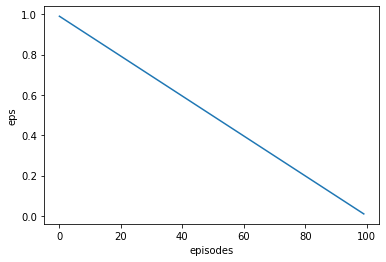

In [14]:
plt.plot(epsilons)
plt.xlabel('episodes')
plt.ylabel('eps')
plt.savefig('epsilons.jpg')

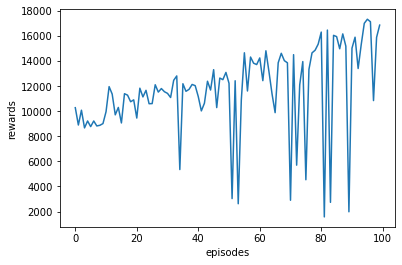

In [15]:
plt.plot(rews)
plt.xlabel('episodes')
plt.ylabel('rewards')
plt.savefig('rewards.jpg')

In [16]:
def calc_spread(prices, spread_coefficients):
    """Calculate the spread based on spread_coefficients.
    Args:
        spread_coefficients (list): A list of signed integers defining how much
            of each product to buy (positive) or sell (negative) when buying or
            selling the spread.
        prices (numpy.array): Array containing the prices (bid, ask) of
            different products, i.e: [p1_b, p1_a, p2_b, p2_a].
    Returns:
        tuple:
            - (float) spread bid price,
            - (float) spread ask price.
    """
    spread_bid = sum([
        spread_coefficients[i] *
        prices[2 * i + int(spread_coefficients[i] < 0)]
        for i in range(len(spread_coefficients))]
    )
    spread_ask = sum([
        spread_coefficients[i] *
        prices[2 * i + int(spread_coefficients[i] > 0)]
        for i in range(len(spread_coefficients))]
    )
    return spread_bid, spread_ask

[1087.9508 1112.8334 1110.0732]
flat buy long


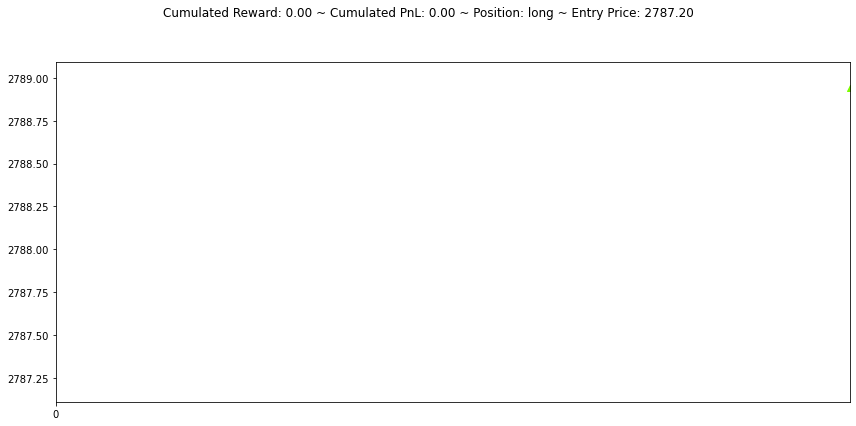

[1124.1232 1144.1814 1118.5392]
long hold long


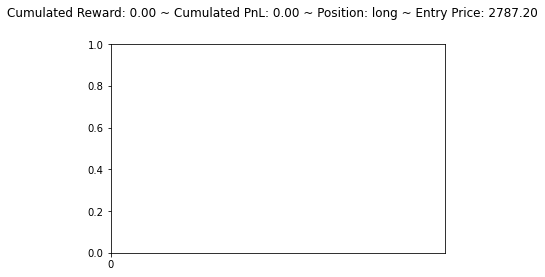

[1105.9937 1117.0249 1094.5085]
long hold long


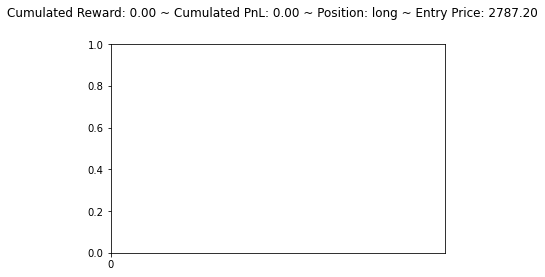

[1096.8257 1098.2109 1075.5005]
long hold long


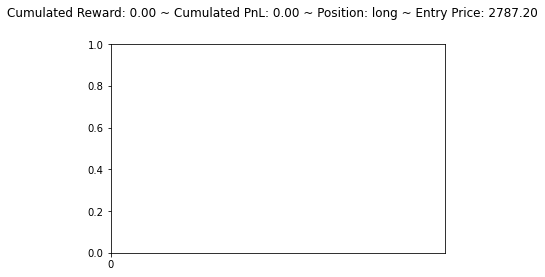

[1095.4574 1096.301  1073.8359]
long hold long


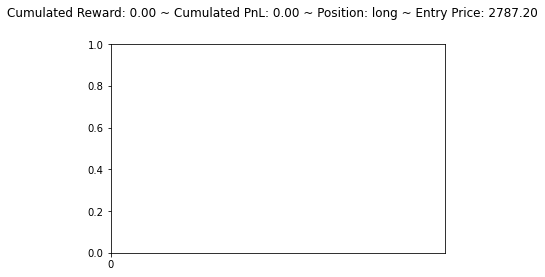

[1091.7765 1090.262  1068.3716]
long hold long


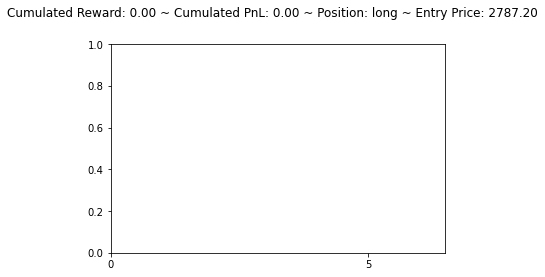

[1093.7141 1092.3867 1069.5299]
long hold long


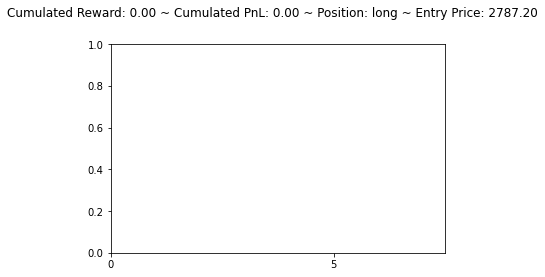

[1093.1561 1091.9651 1069.2216]
long hold long


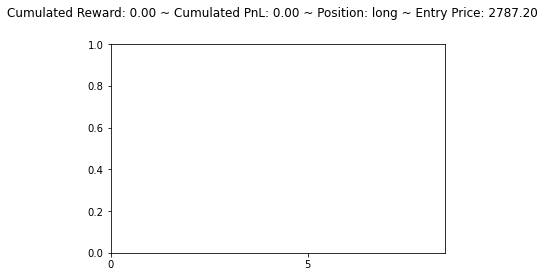

[1094.4575 1093.6531 1070.4578]
long hold long


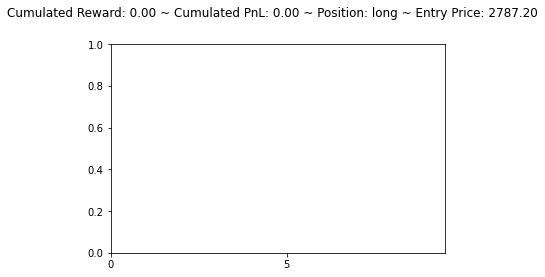

[1100.0477 1102.2012 1077.6163]
long hold long


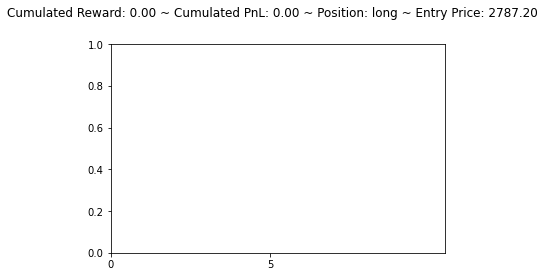

[1100.3816 1103.3079 1078.6874]
long hold long


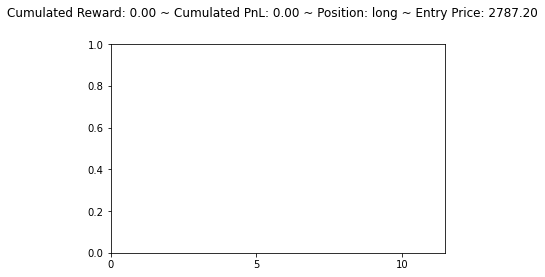

[1052.3164 1031.5142 1018.9932]
long hold long


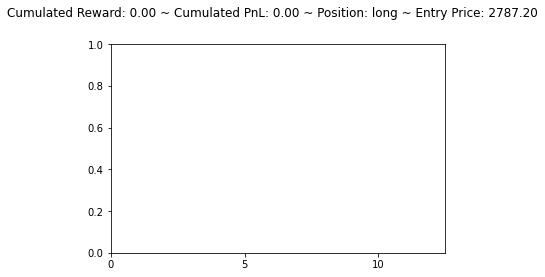

[1097.8615 1094.1437 1069.5983]
long hold long


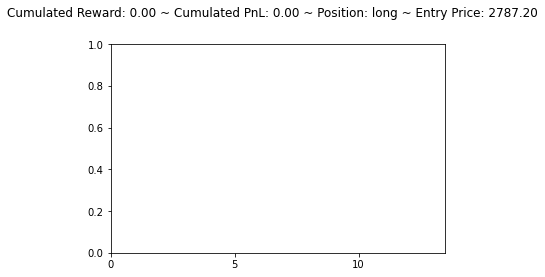

[1350.174  1402.479  1323.0769]
long hold long


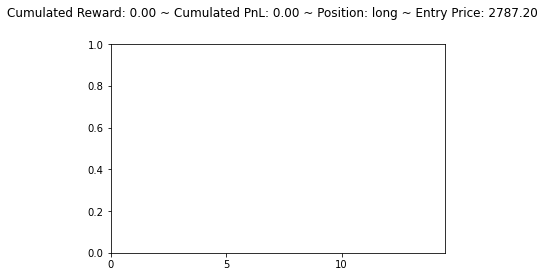

[1290.3064 1339.3965 1284.4294]
long hold long


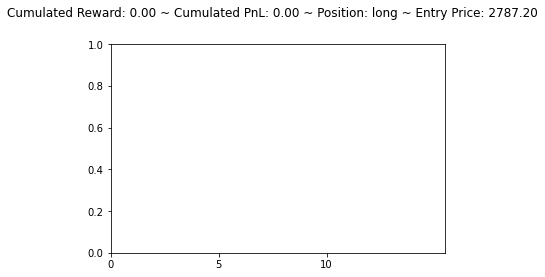

[1217.4163 1278.6687 1237.4343]
long sell flat


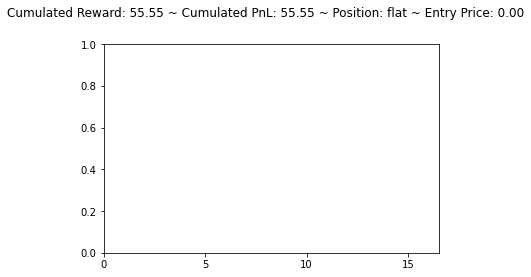

[1089.417  1156.8018 1156.2719]
flat buy long


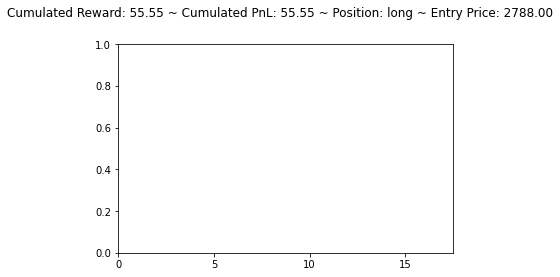

[1207.0675 1255.402  1211.7124]
long sell flat


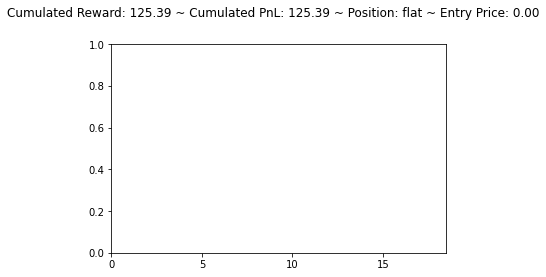

[1114.304  1168.8843 1177.467 ]
flat sell short


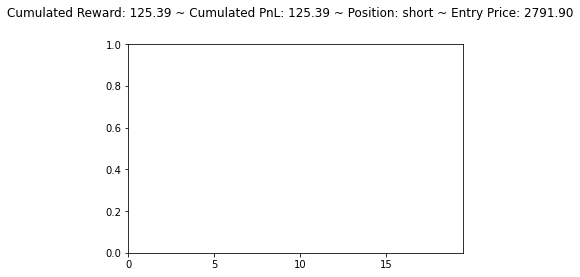

[1155.3787 1183.7963 1149.0315]
short buy flat


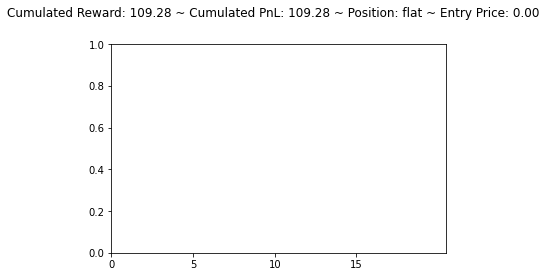

[1066.8617 1081.7332 1088.1106]
flat sell short


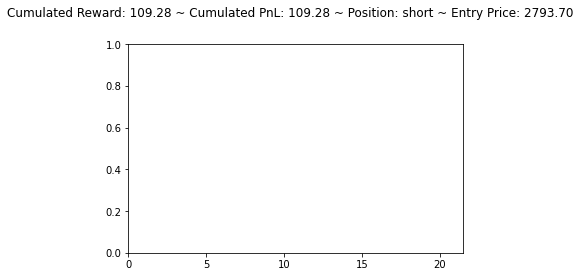

[1132.0609 1146.2725 1115.0345]
short buy flat


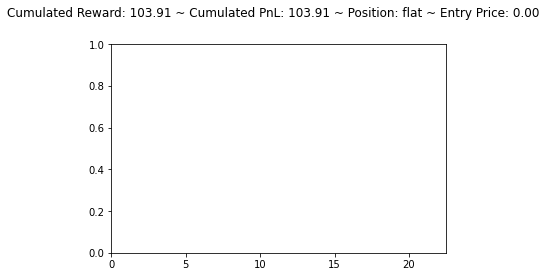

[1090.3217 1102.837  1108.944 ]
flat sell short


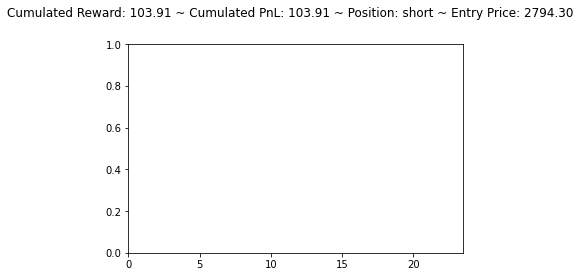

[1055.6628 1038.3325 1025.7545]
short hold short


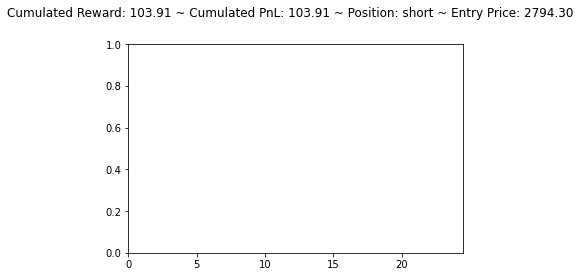

[1050.9652  1022.90796 1010.6057 ]
short hold short


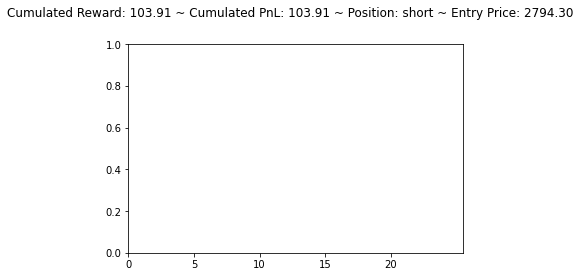

[1060.3636  1037.6278  1022.94867]
short hold short


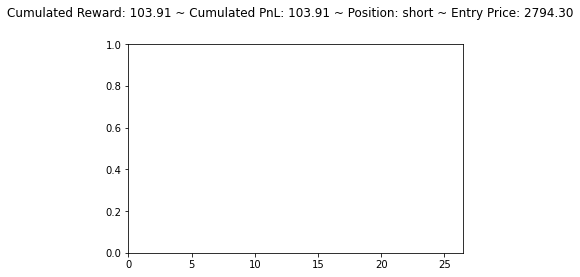

[1125.4148 1135.4161 1104.3809]
short buy flat


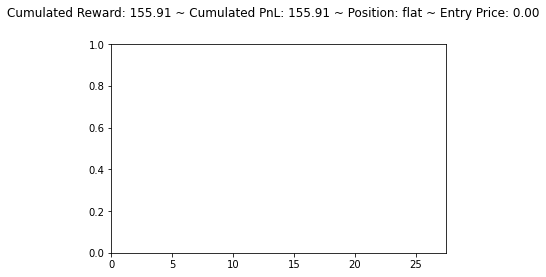

[1025.5194 1012.587  1019.7183]
flat hold flat


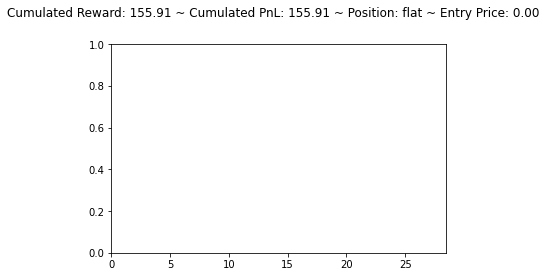

[1023.6604  1012.56885 1000.8714 ]
flat hold flat


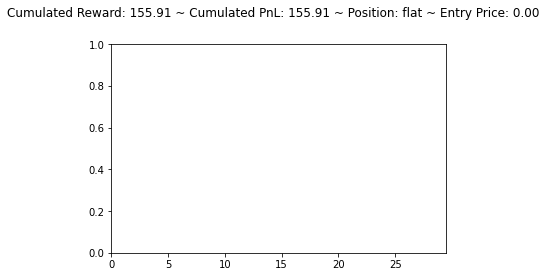

[1050.2053 1051.842  1037.0237]
flat buy long


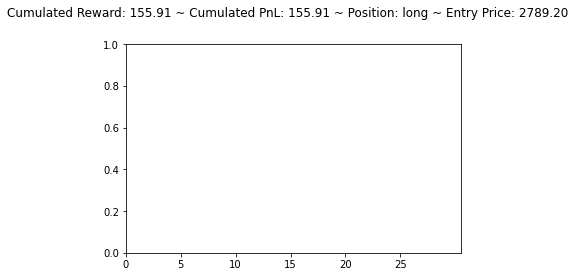

[1094.0183 1097.4724 1080.3423]
long hold long


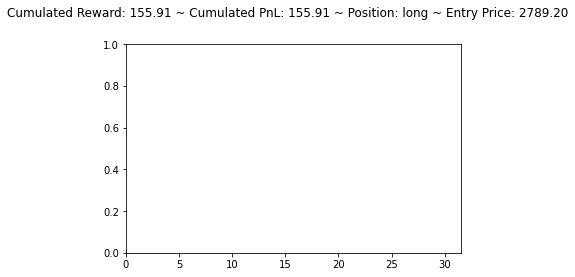

[1120.6539 1134.989  1108.4194]
long hold long


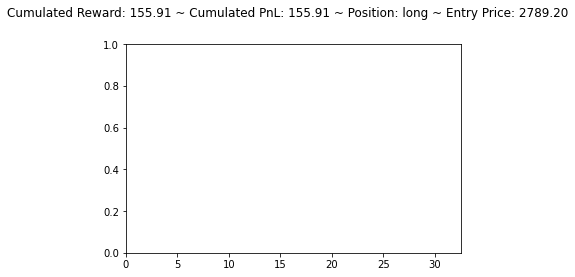

[1057.9563 1041.0309 1028.3016]
long hold long


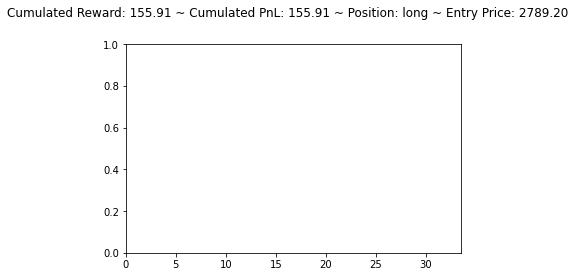

[1074.7316 1059.9841 1043.6316]
long hold long


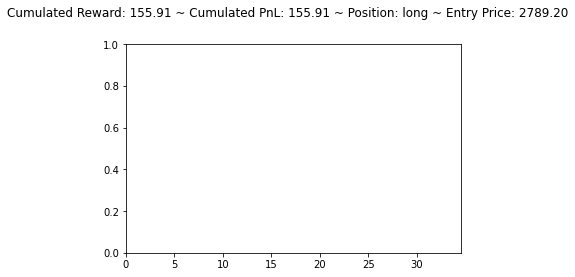

[1087.4806 1085.1918 1068.671 ]
long hold long


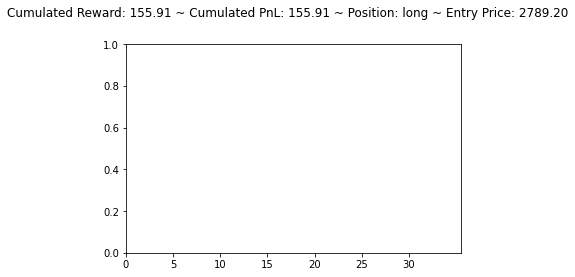

[1087.6703 1085.3479 1068.935 ]
long hold long


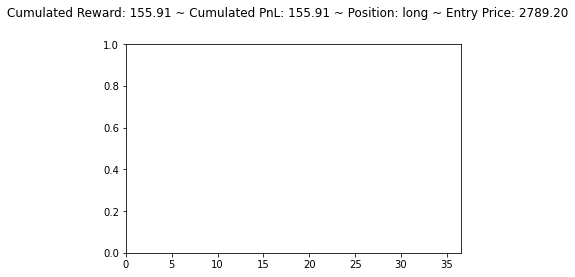

[1065.0088 1051.6392 1039.3474]
long hold long


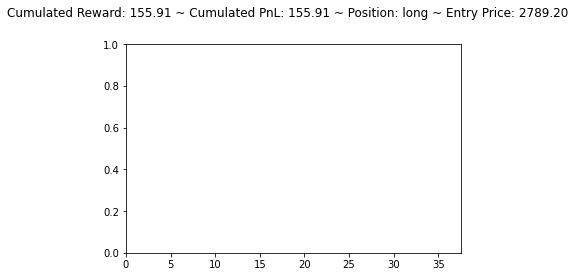

[1107.424  1108.3993 1082.2074]
long hold long


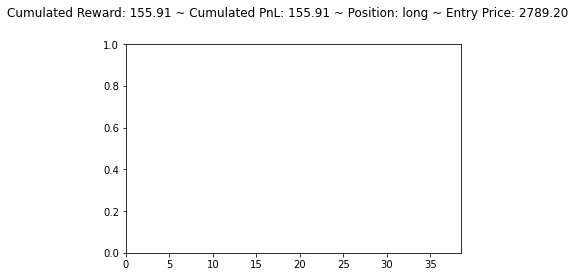

[1167.7375 1203.971  1167.536 ]
long hold long


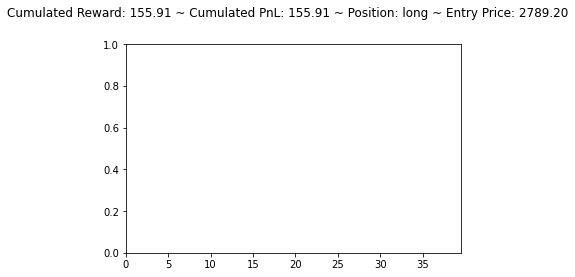

[1142.1774 1182.6589 1156.3073]
long sell flat


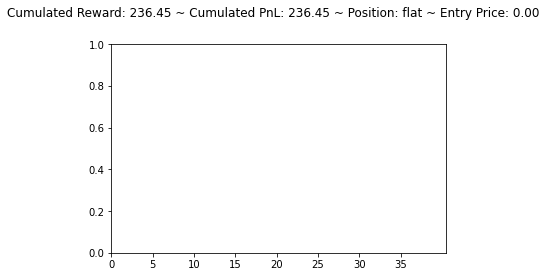

[1090.5873 1103.939  1103.0409]
flat buy long


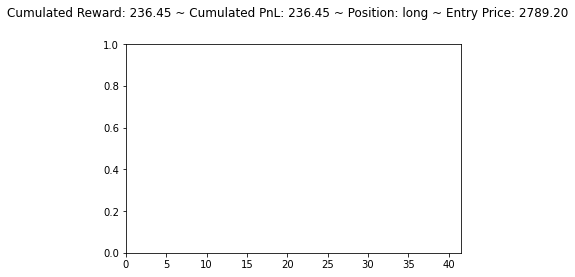

[1179.2583 1226.9932 1191.1818]
long sell flat


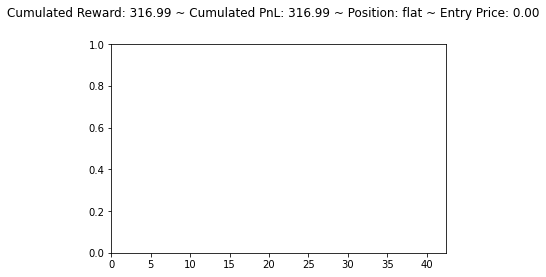

[1143.734  1198.4634 1197.9186]
flat buy long


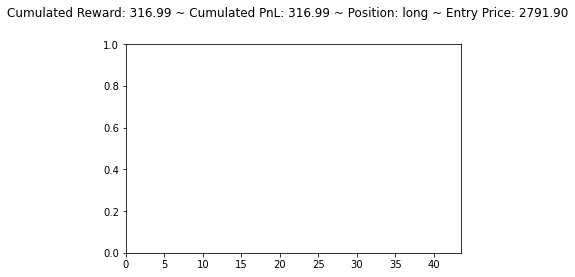

[1200.4712 1269.3945 1232.4003]
long sell flat


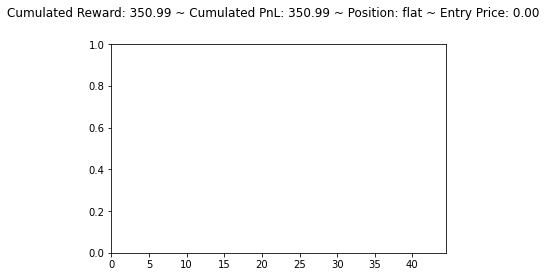

[1080.513  1110.6713 1113.2527]
flat sell short


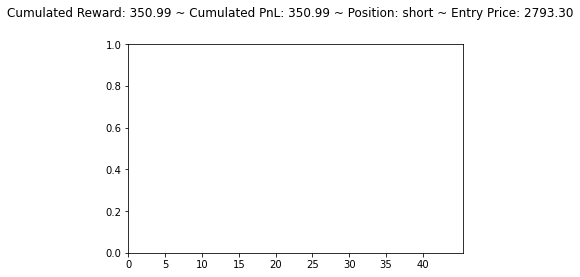

[1127.8596 1149.356  1123.2074]
short buy flat


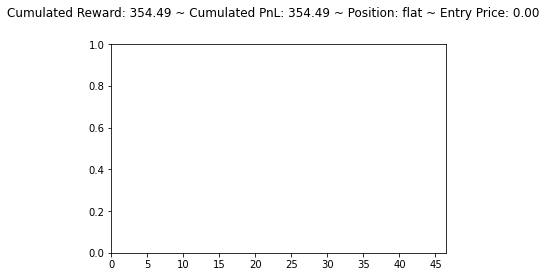

[1107.5319 1127.9155 1125.579 ]
flat buy long


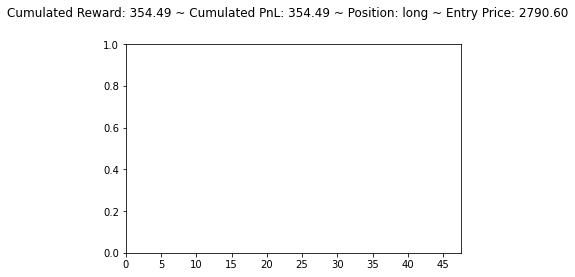

[1158.8407 1203.291  1172.1781]
long sell flat


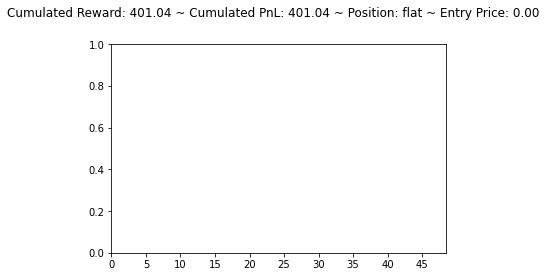

[1082.9646 1098.887  1102.4832]
flat sell short


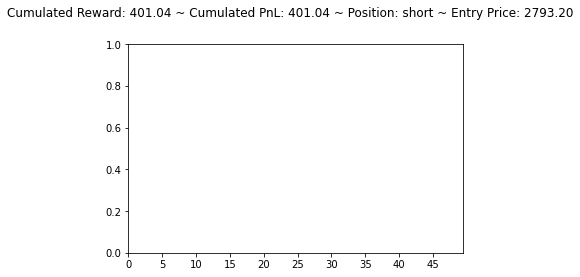

[1055.8312  1036.6028  1023.84796]
short hold short


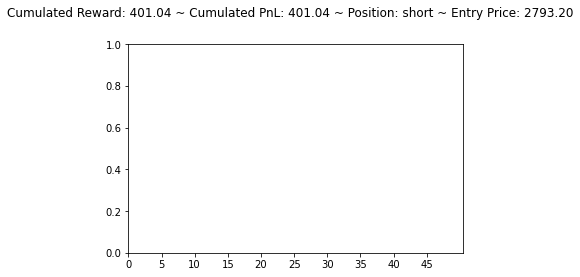

[1105.2314 1104.1895 1078.3745]
short hold short


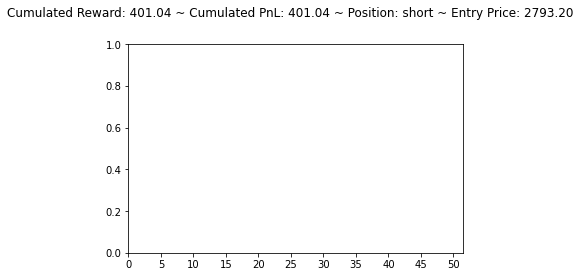

[1055.7963 1036.4307 1023.6579]
short hold short


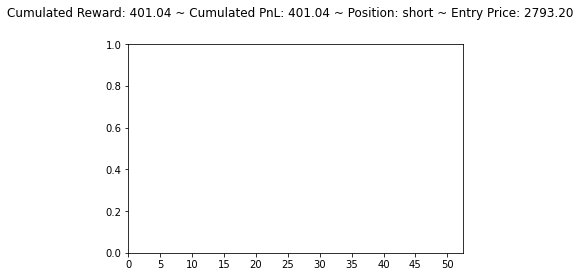

[1104.562  1103.1558 1077.5444]
short hold short


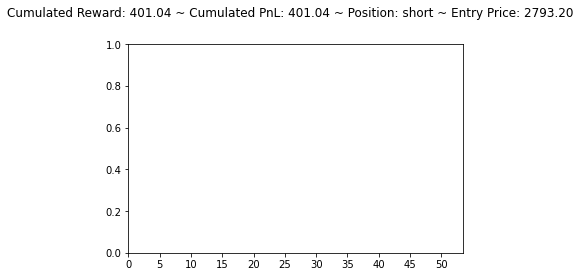

[1055.6603  1036.1726  1023.47174]
short hold short


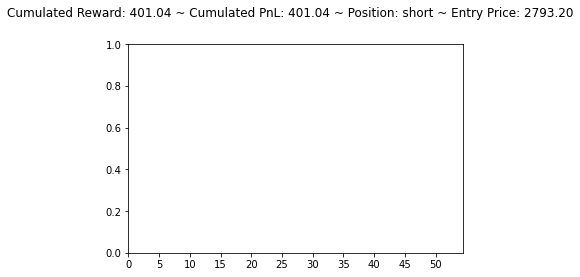

[1105.7378 1104.9688 1079.0027]
short hold short


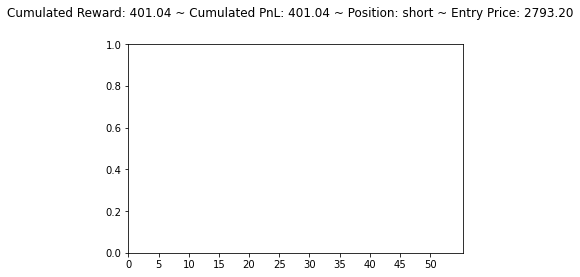

[1110.4404 1118.1272 1091.5532]
short buy flat


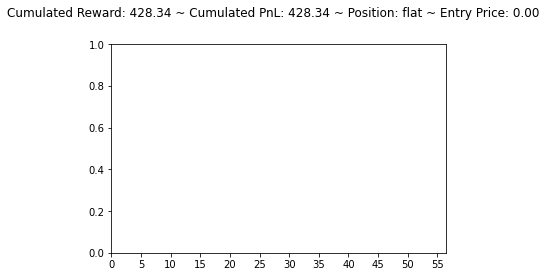

[1072.1486 1076.0894 1077.871 ]
flat sell short


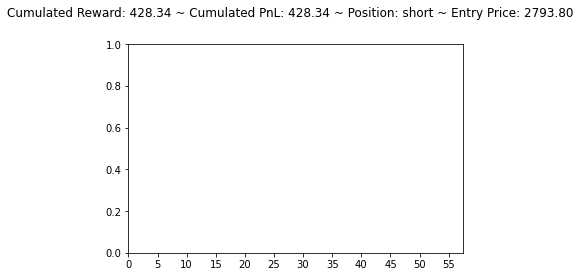

[1108.1422 1114.5042 1088.5635]
short buy flat


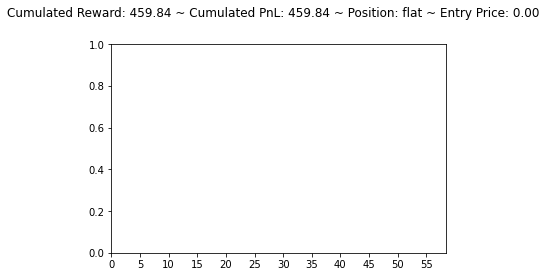

[1023.9255  1010.67847 1012.7304 ]
flat hold flat


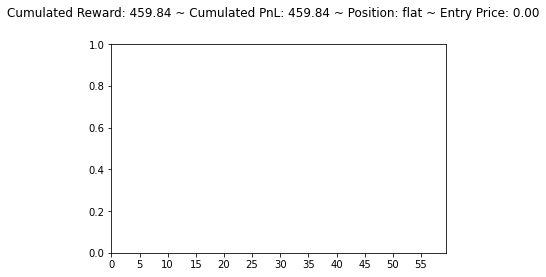

[1042.1125 1039.505  1025.6257]
flat hold flat


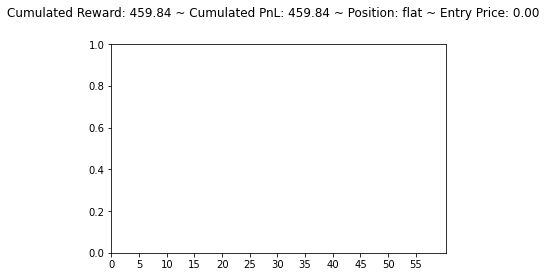

[1101.7595 1128.6388 1115.7482]
flat buy long


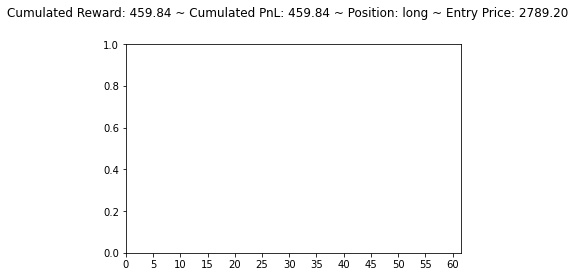

[1145.3098 1177.5994 1147.3235]
long sell flat


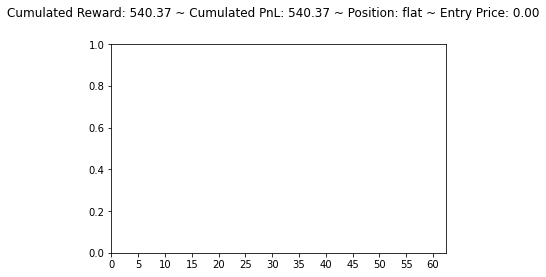

[1081.3003 1096.7505 1099.6443]
flat sell short


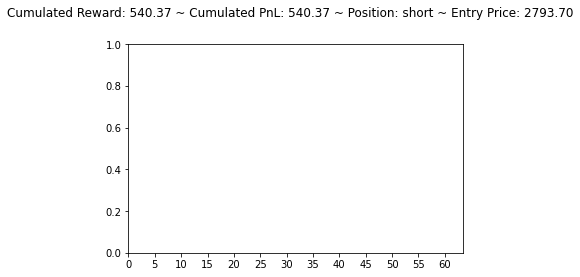

[1112.6533 1121.3237 1094.6638]
short buy flat


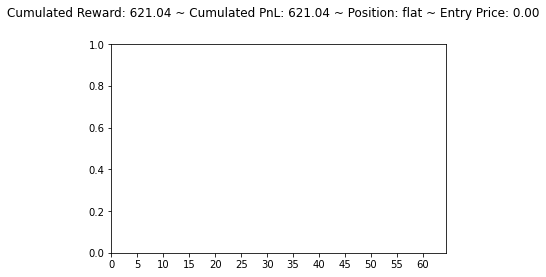

[1077.1123 1084.6737 1085.8691]
flat sell short


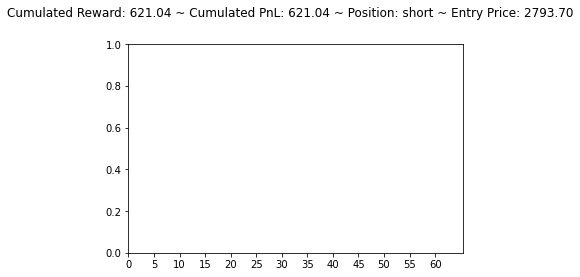

[1111.5511 1121.0441 1094.6348]
short buy flat


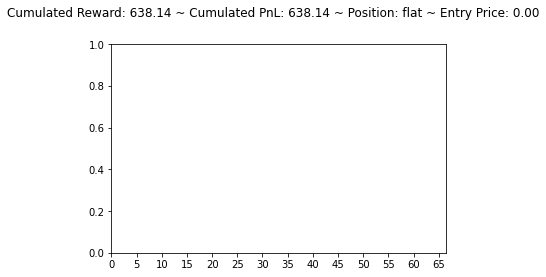

[1099.5568 1116.7393 1115.1499]
flat buy long


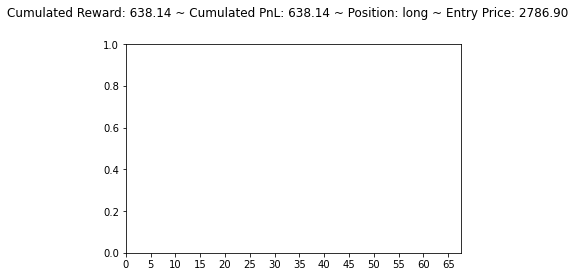

[1133.927  1163.7316 1136.6447]
long sell flat


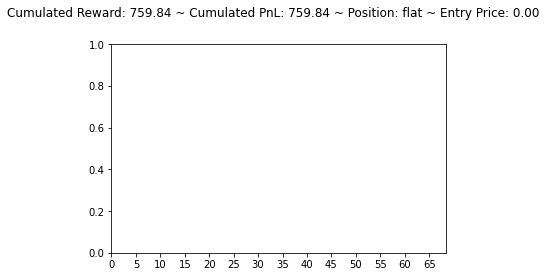

[1077.9363 1086.2634 1088.069 ]
flat sell short


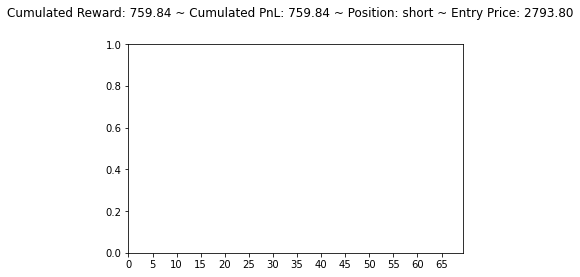

[1127.4601 1144.9952 1115.2585]
short buy flat


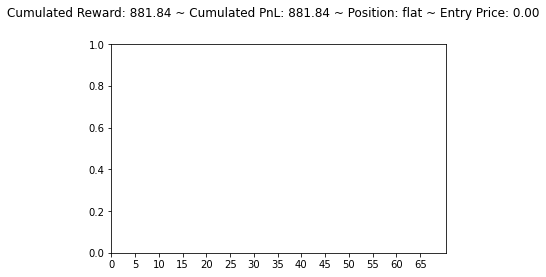

[1080.8885 1089.9614 1094.2197]
flat sell short


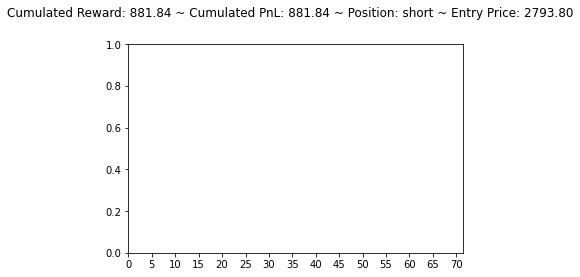

[1116.6958 1127.9337 1101.2773]
short buy flat


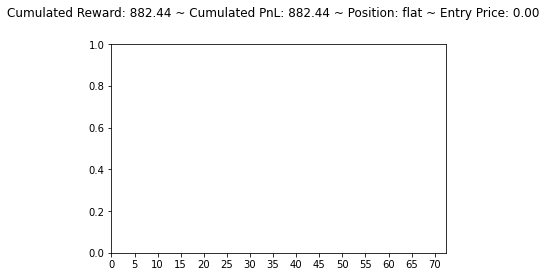

[1122.3098 1149.9751 1146.3972]
flat buy long


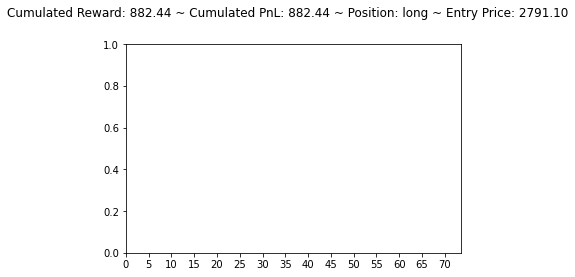

[1164.2715 1215.607  1185.0166]
long sell flat


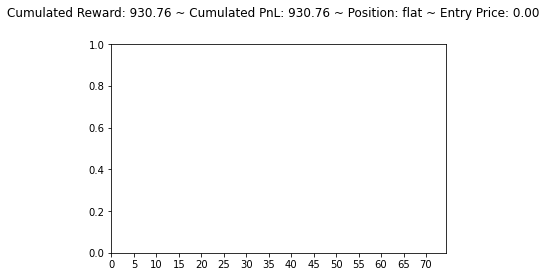

[1109.695  1134.7278 1136.4086]
flat sell short


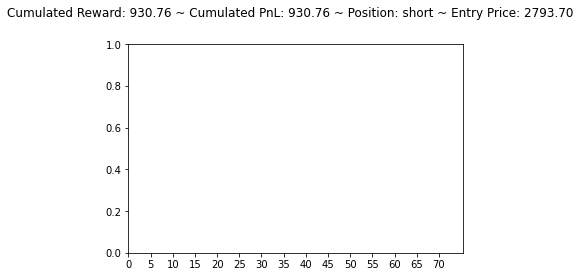

[1146.4125 1178.3755 1147.1335]
short buy flat


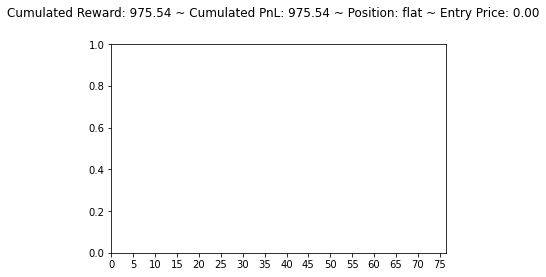

[1086.1565 1102.3558 1105.9613]
flat sell short


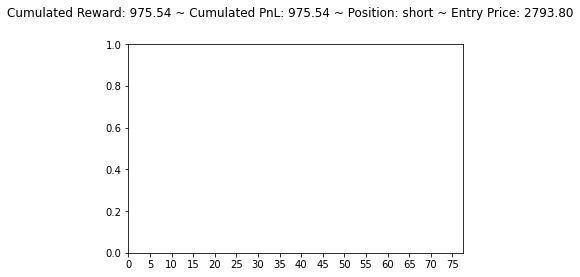

[1148.8369 1176.6443 1143.0264]
short buy flat


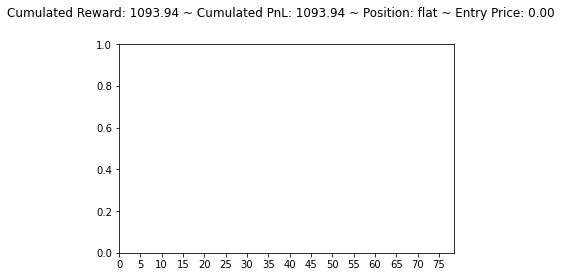

[1103.9596 1131.1299 1135.7766]
flat sell short


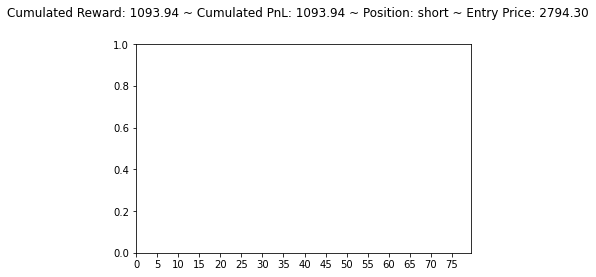

[1157.3073 1190.4719 1154.7098]
short buy flat


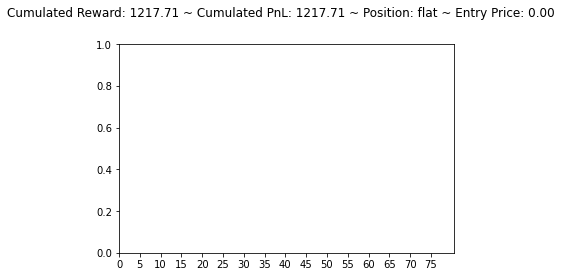

[1101.1155 1124.125  1132.0715]
flat sell short


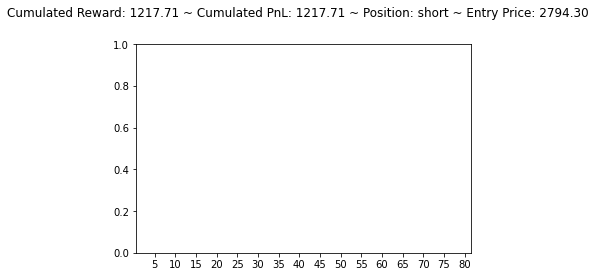

[1133.492  1153.7499 1122.8312]
short buy flat


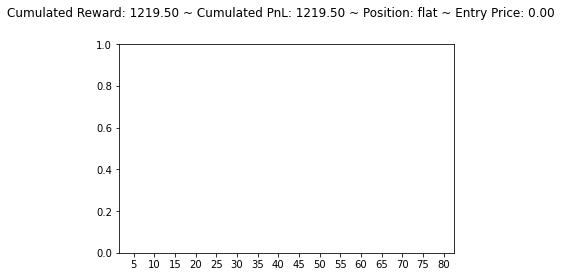

[1082.94   1090.7097 1096.492 ]
flat sell short


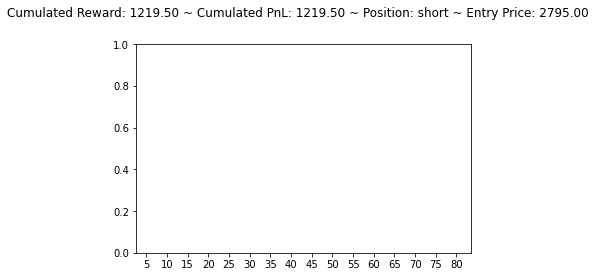

[1122.1632 1136.2534 1107.4342]
short buy flat


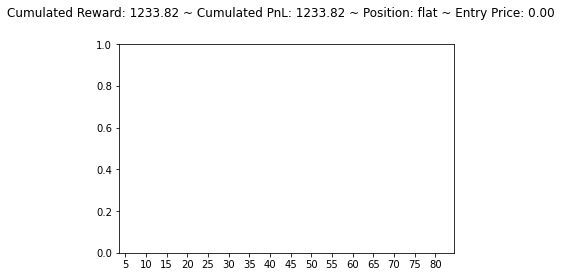

[1113.624  1137.669  1136.8593]
flat buy long


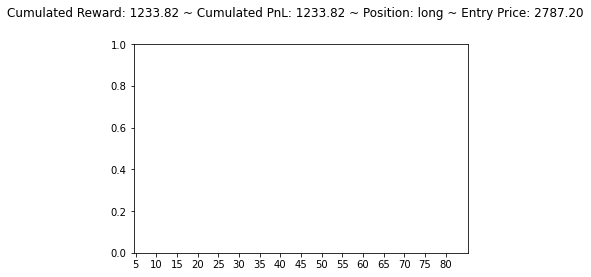

[1190.9725 1251.3455 1213.8683]
long sell flat


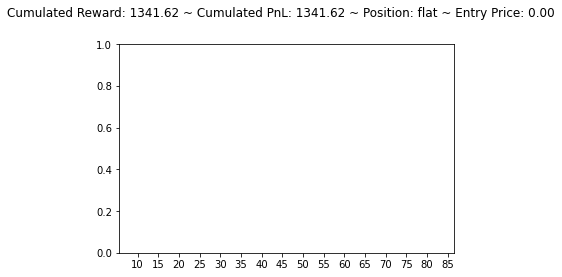

[1110.8508 1141.8293 1149.9557]
flat sell short


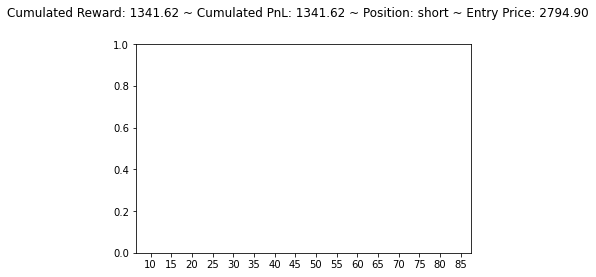

[1131.8064 1153.1025 1123.1522]
short buy flat


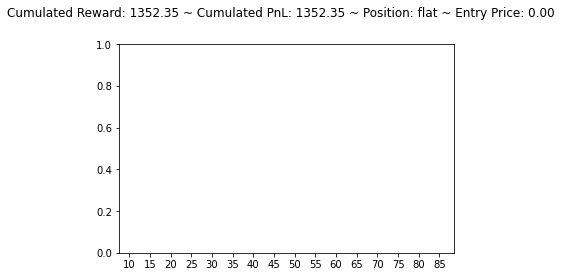

[1085.0195 1095.6223 1099.2819]
flat sell short


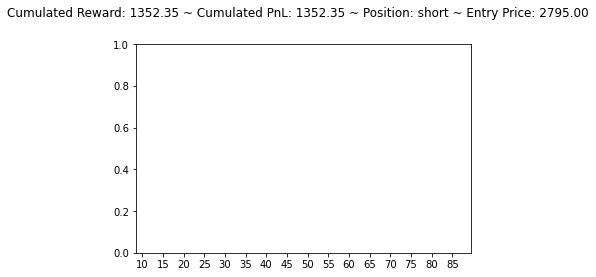

[1173.3064 1213.7157 1174.5342]
short buy flat


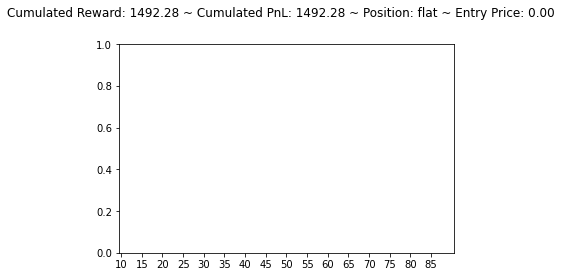

[1145.101  1195.0647 1199.2638]
flat sell short


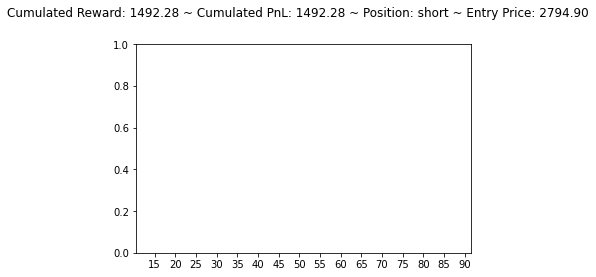

[1196.0192 1261.341  1224.0924]
short buy flat


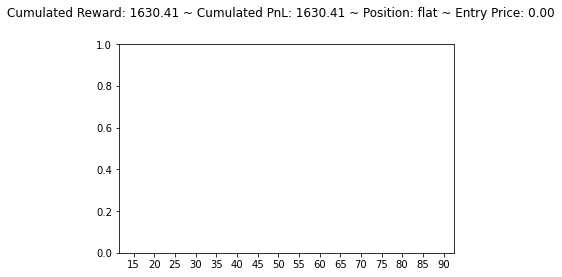

[1147.7773 1200.0144 1202.318 ]
flat sell short


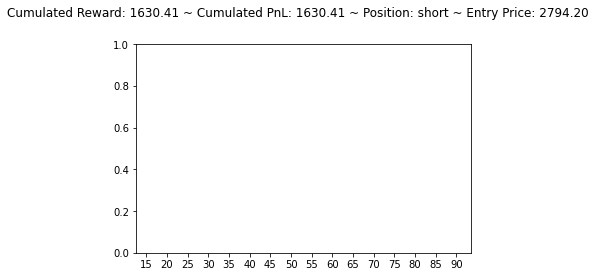

[1149.0563 1190.427  1162.0818]
short buy flat


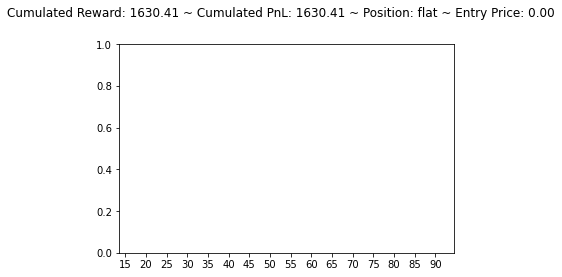

[1080.3539 1086.9988 1090.3405]
flat sell short


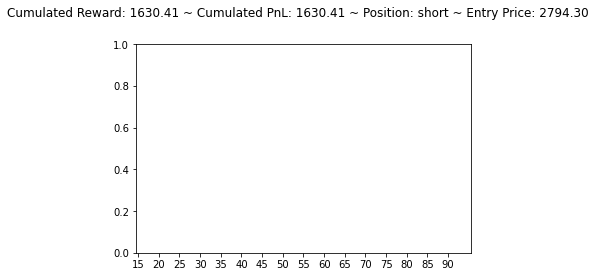

short hold short


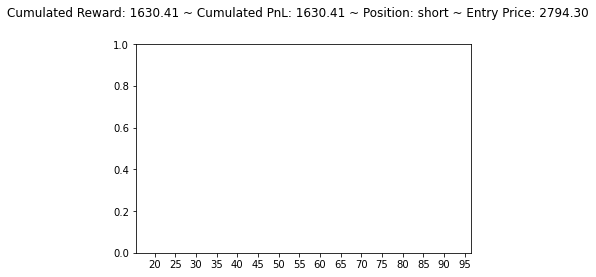

[1099.5968 1100.7096 1076.5742]
short buy flat


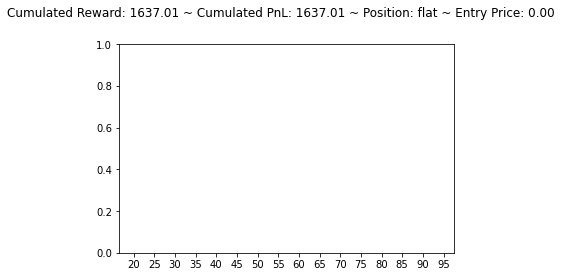

[1066.2433 1067.4541 1066.8109]
flat buy long


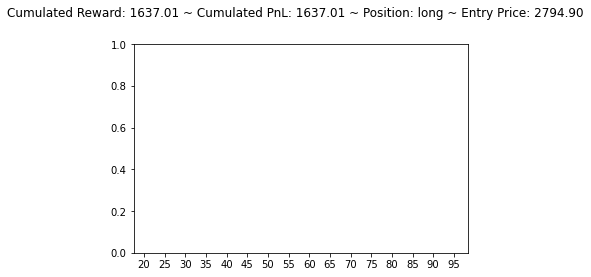

[1129.8906 1146.3813 1115.2527]
long hold long


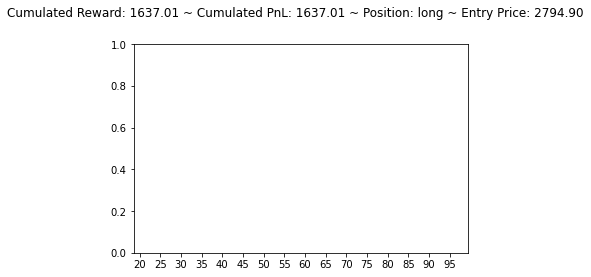

[1129.2085 1149.0833 1117.9   ]
long hold long


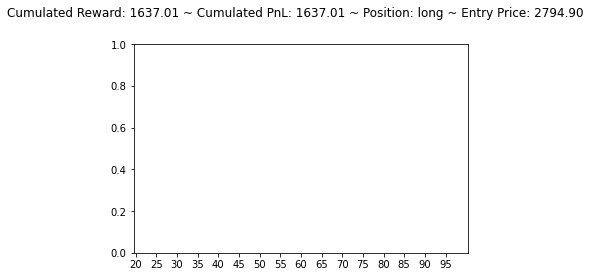

[1127.3197 1145.8701 1114.768 ]
long hold long


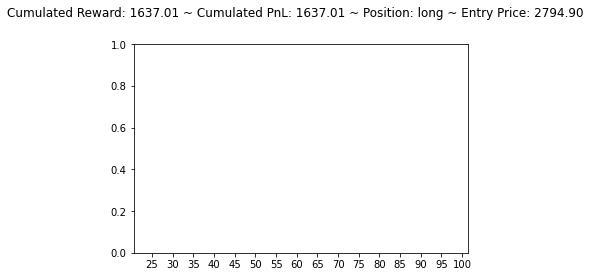

[1074.1564 1066.175  1048.8625]
long hold long


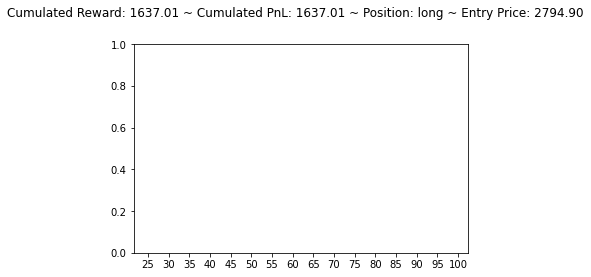

[1073.8374 1059.7681 1042.1727]
long hold long


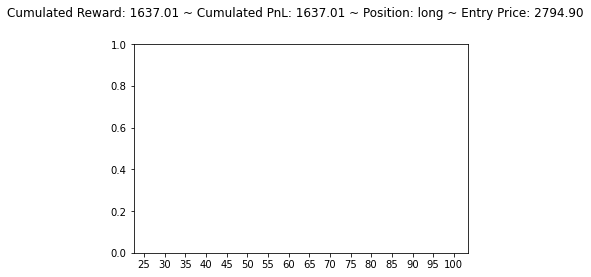

[1087.964  1082.1323 1061.5942]
long hold long


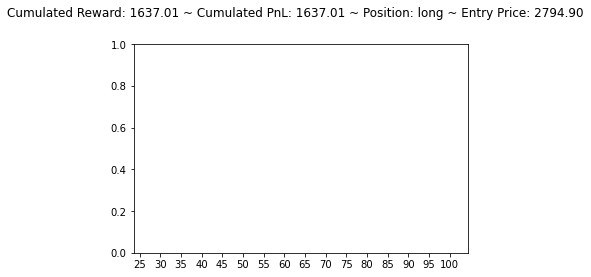

[1091.9175 1089.3064 1068.1222]
long hold long


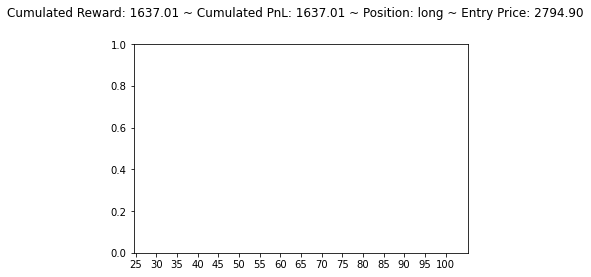

[1111.7123 1119.7086 1093.946 ]
long hold long


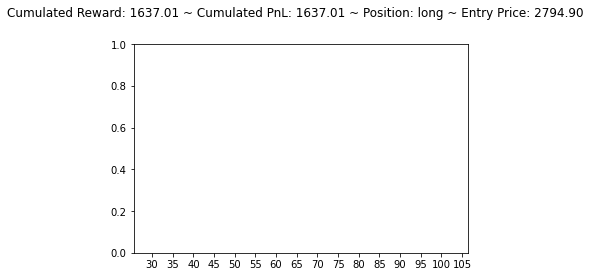

[1115.1237 1126.8252 1100.4012]
long hold long


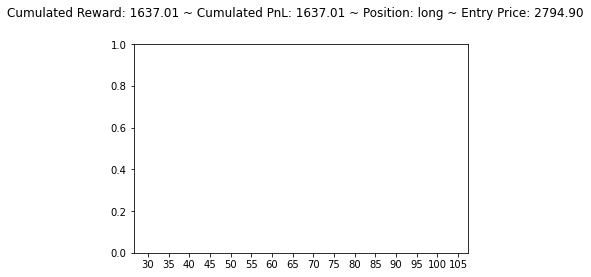

[1122.1805 1137.4867 1109.8398]
long hold long


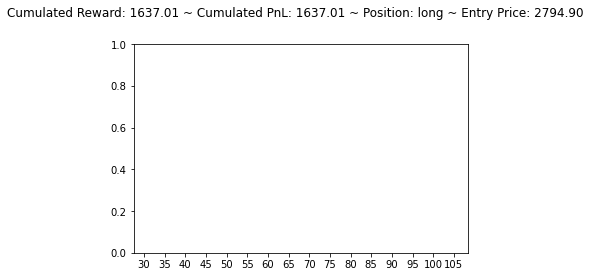

[1124.4222 1142.8348 1115.46  ]
long hold long


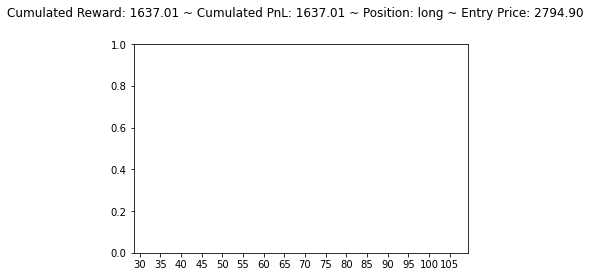

[1125.1781 1143.4304 1115.7534]
long hold long


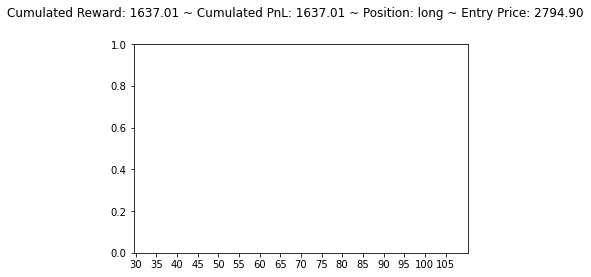

[1124.0143 1142.2112 1114.9092]
long hold long


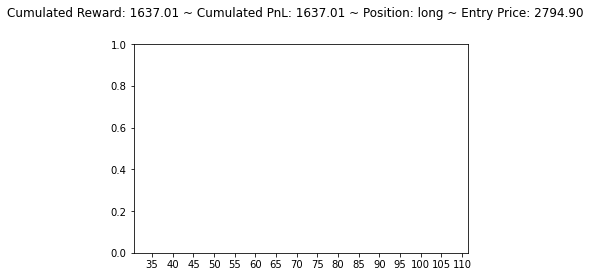

[1124.955  1142.9521 1115.2727]
long hold long


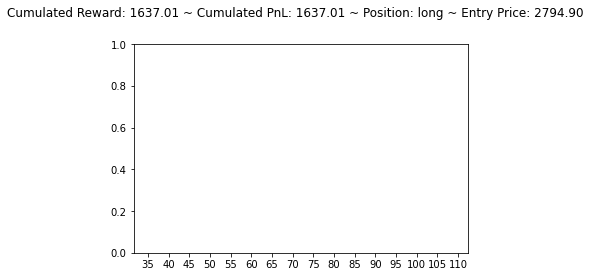

[1123.6061 1141.5874 1114.358 ]
long hold long


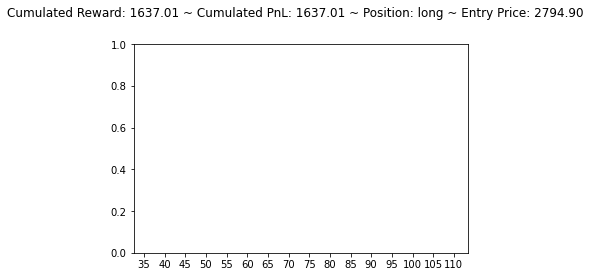

[1124.7318 1142.4738 1114.7921]
long hold long


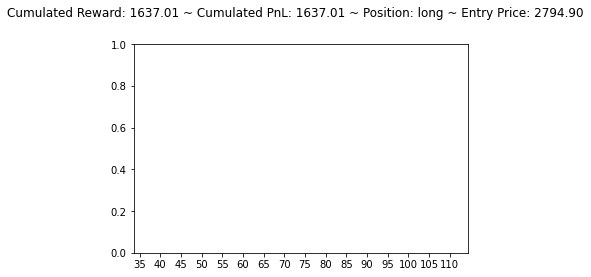

[1123.3444 1141.1809 1113.9988]
long hold long


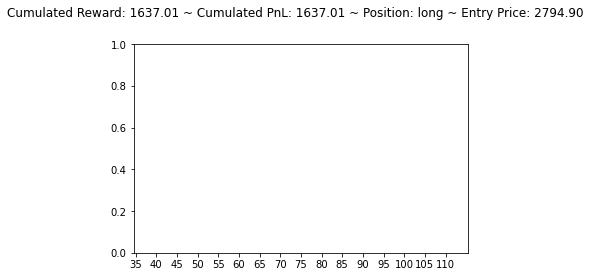

[1124.5936 1142.1643 1114.4796]
long hold long


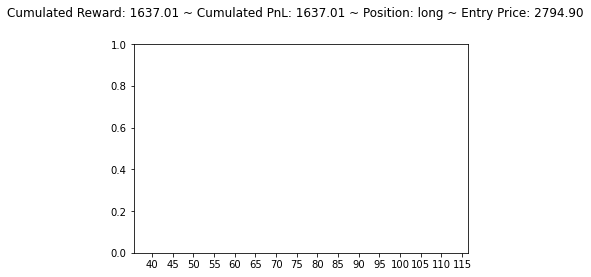

[1122.9362 1140.5575 1113.4479]
long hold long


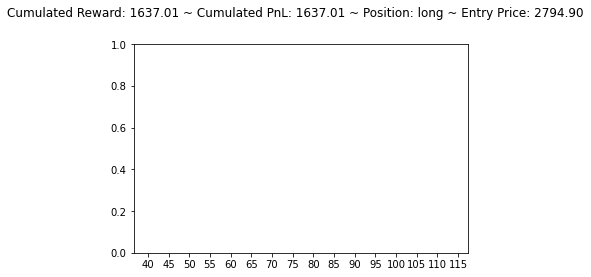

[1124.3705 1141.6859 1113.9991]
long hold long


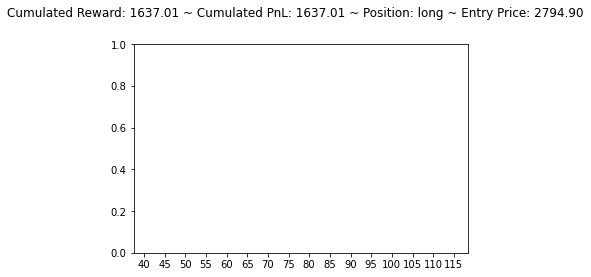

[1129.2509 1149.9363 1121.708 ]
long hold long


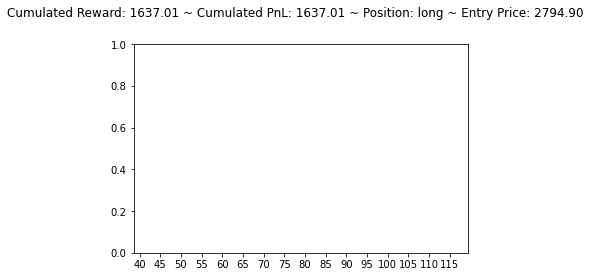

[1124.2228 1143.3137 1116.262 ]
long hold long


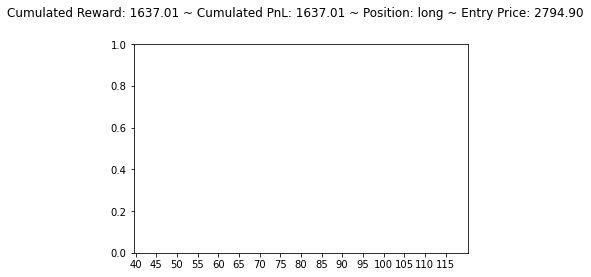

[1124.1472 1141.2075 1113.5183]
long hold long


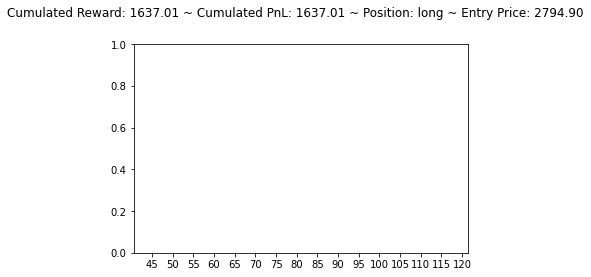

[1135.9523 1160.5233 1129.5435]
long hold long


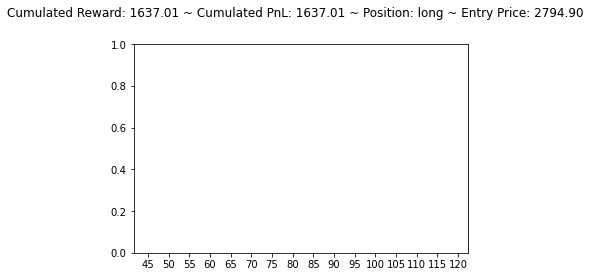

[1121.2975 1137.0841 1108.6312]
long hold long


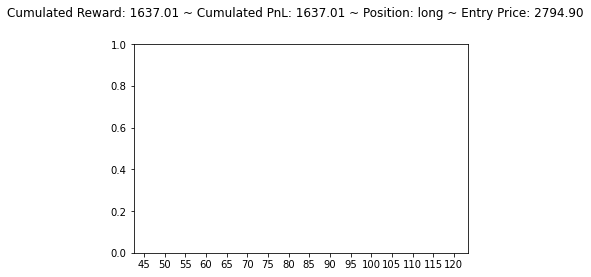

[1125.9034 1145.0436 1117.2341]
long hold long


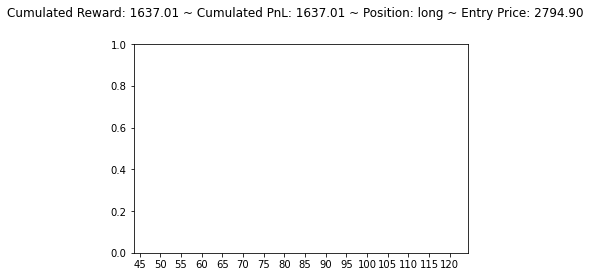

[1122.2275 1139.3923 1112.3806]
long hold long


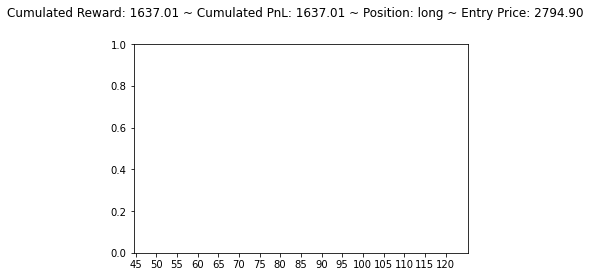

[1123.7854 1140.6179 1112.9788]
long hold long


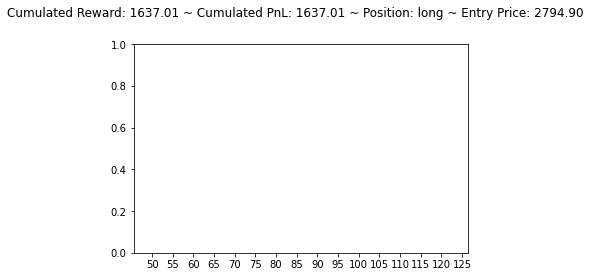

long sell flat


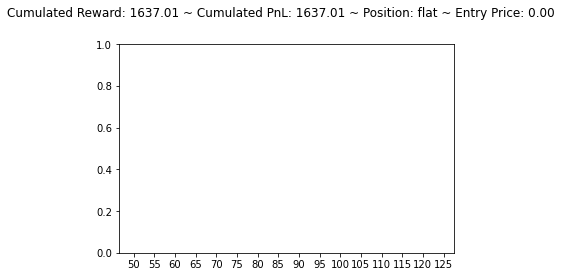

[1081.0511 1093.5353 1094.365 ]
flat sell short


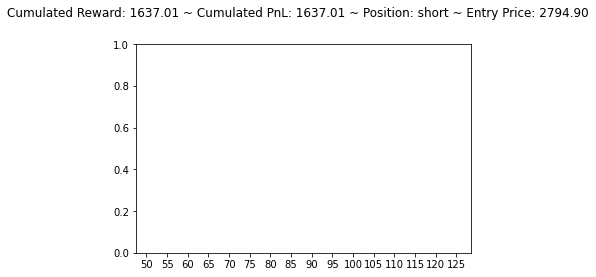

[1123.6094 1139.572  1112.0576]
short buy flat


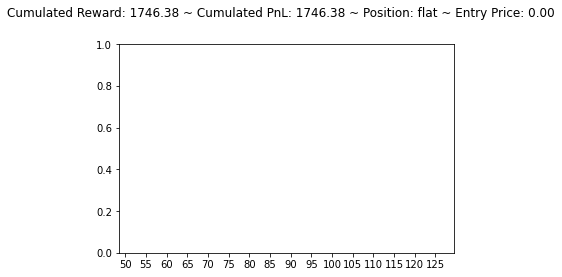

[1102.898  1123.8868 1124.403 ]
flat sell short


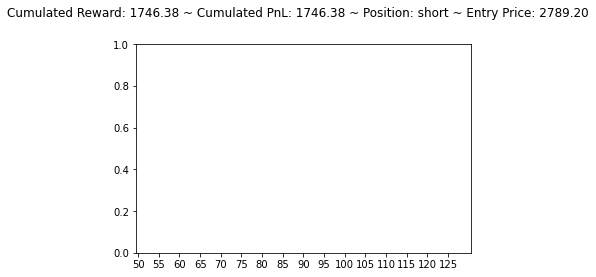

[1127.1738 1148.3687 1120.3646]
short buy flat


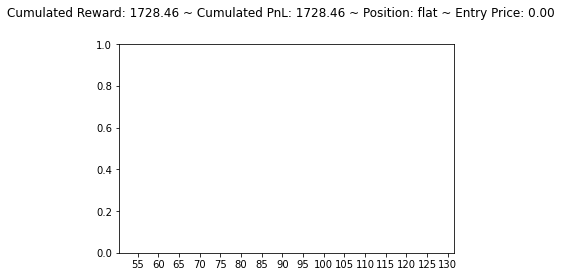

[1083.7856 1097.7385 1098.0267]
flat sell short


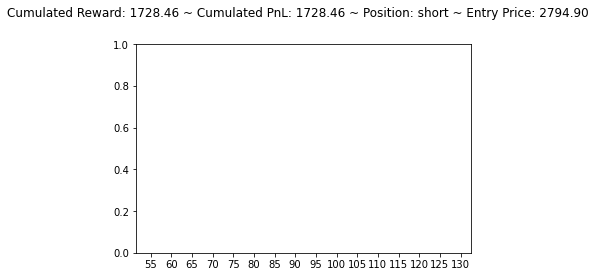

[1125.3177 1143.1503 1115.6838]
short buy flat


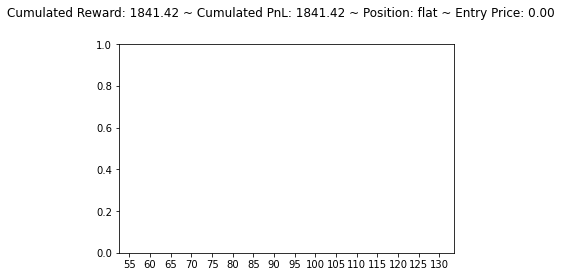

[1083.5376 1097.1471 1097.6373]
flat sell short


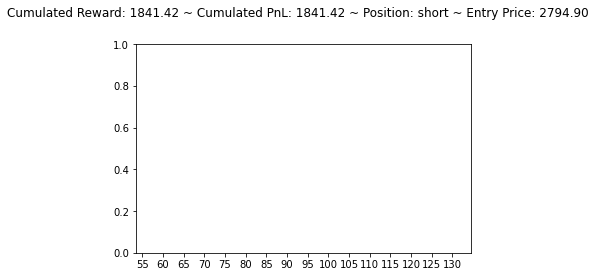

[1124.8865 1142.4058 1114.988 ]
short buy flat


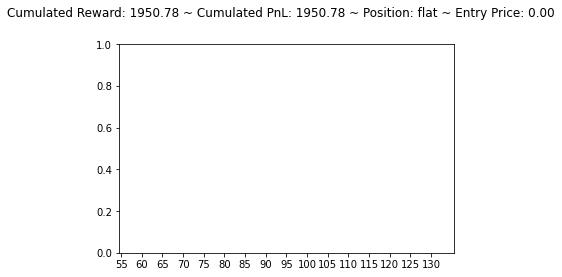

[1102.4854 1122.9756 1123.3917]
flat sell short


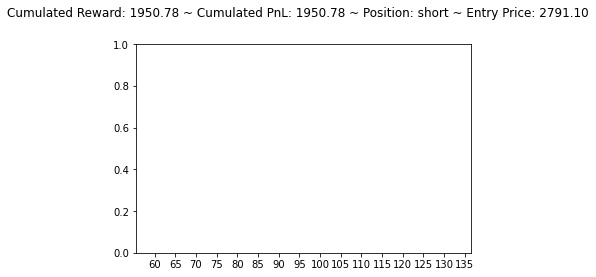

[1148.207  1180.0856 1146.7555]
short buy flat


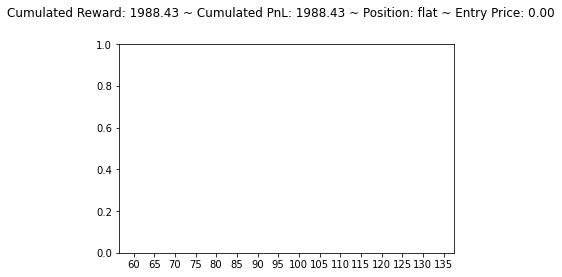

[1101.1708 1120.8601 1126.4926]
flat sell short


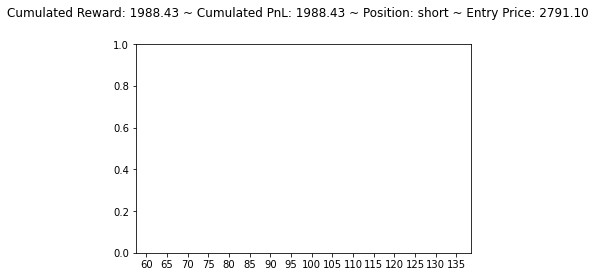

[1146.8333 1177.7427 1144.463 ]
short buy flat


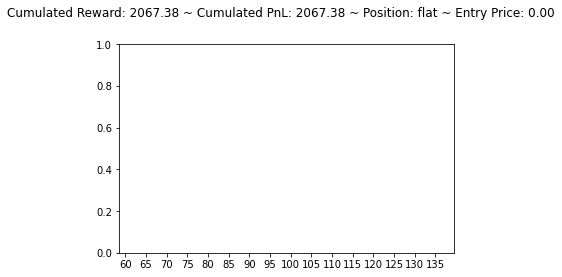

[1106.1389 1127.9211 1133.1929]
flat sell short


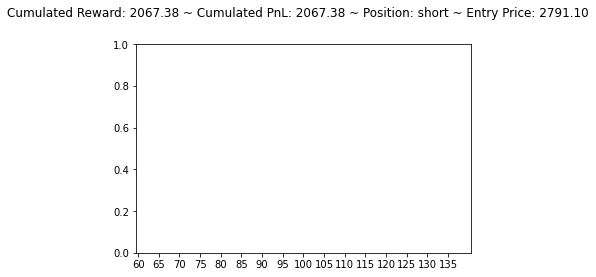

[1143.0865 1173.9829 1141.957 ]
short buy flat


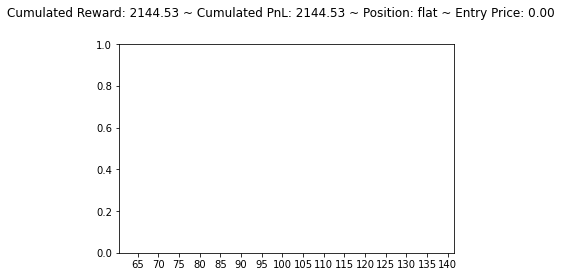

[1095.808  1110.5192 1116.1538]
flat sell short


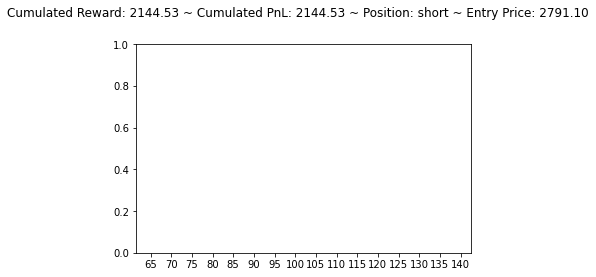

[1145.2537 1174.5602 1141.2899]
short buy flat


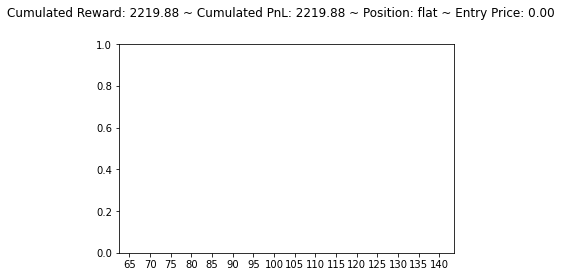

[1096.4062 1113.4928 1119.9318]
flat sell short


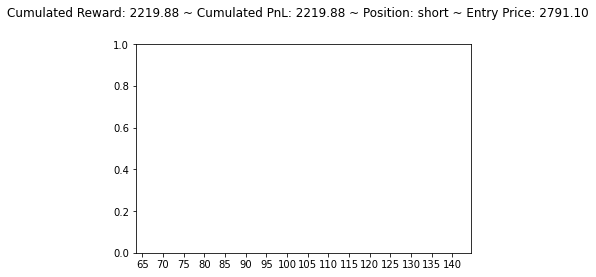

[1115.6648 1129.269  1102.3877]
short buy flat


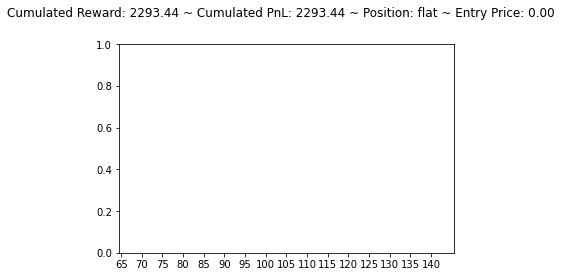

[1074.723  1081.7268 1082.9325]
flat sell short


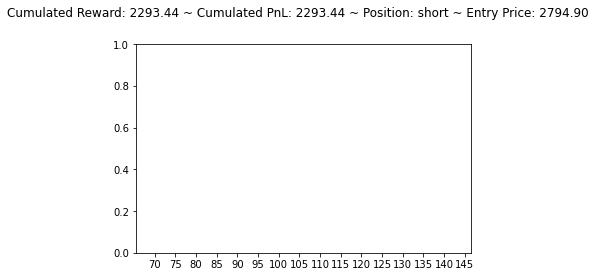

[1113.5542 1123.606  1097.2827]
short buy flat


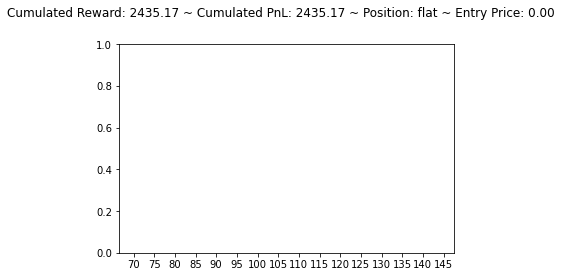

[1078.0043 1086.4536 1087.2108]
flat sell short


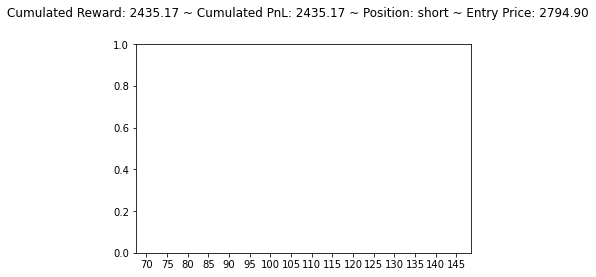

[1143.1183 1168.7351 1137.6362]
short buy flat


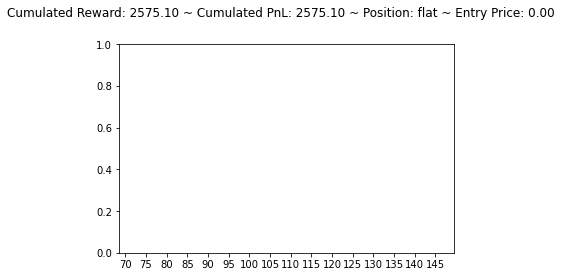

[1092.8514 1116.2129 1118.425 ]
flat sell short


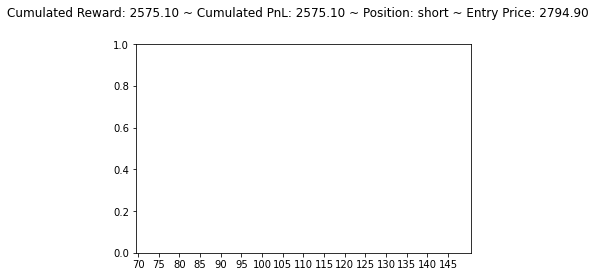

[1145.6073 1173.665  1142.5403]
short buy flat


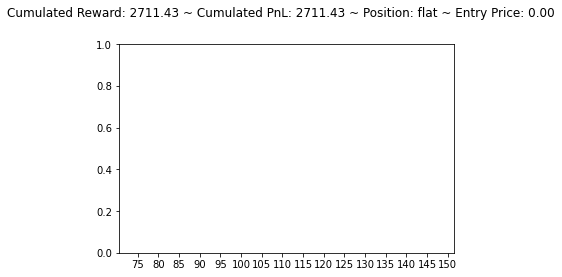

[1107.4546 1137.8196 1138.2543]
flat sell short


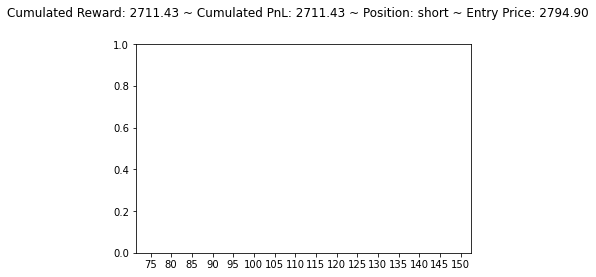

[1139.2438 1169.4897 1141.0453]
short buy flat


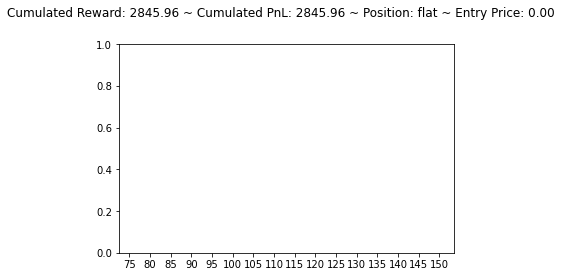

[1101.5596 1123.3136 1122.9586]
flat buy long


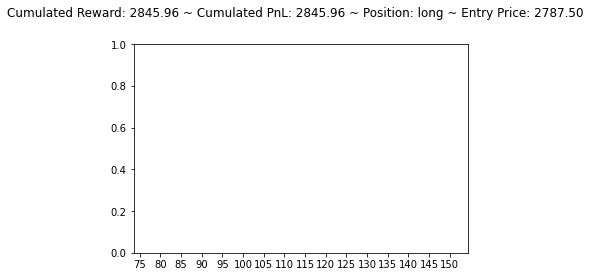

[1139.9615 1171.3221 1142.9835]
long sell flat


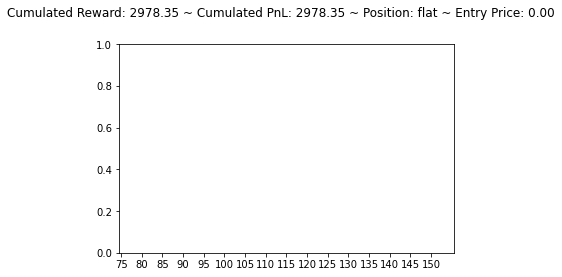

[1102.157  1124.5642 1124.284 ]
flat buy long


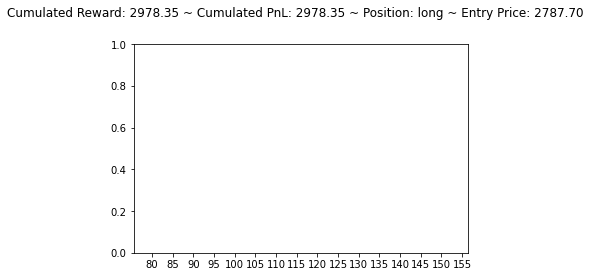

[1156.8331 1196.3793 1165.0564]
long sell flat


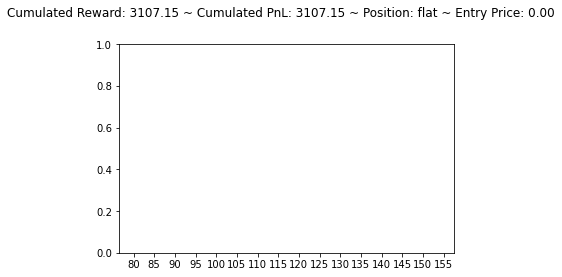

[1095.0098 1118.8474 1121.4423]
flat sell short


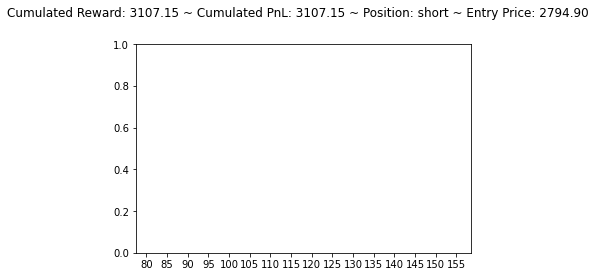

[1147.587  1176.943  1145.3589]
short buy flat


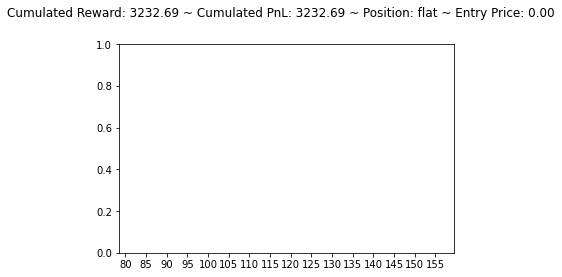

[1094.8163 1118.5481 1121.155 ]
flat sell short


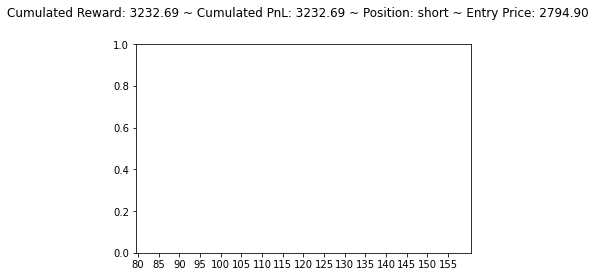

[1147.4487 1176.6334 1145.0465]
short buy flat


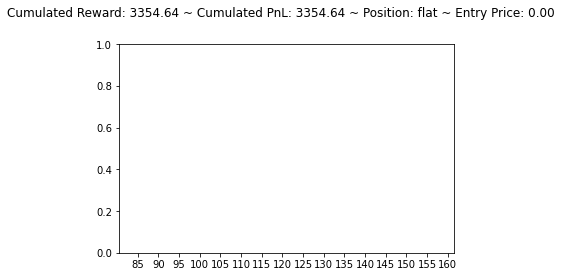

[1110.7778 1141.9717 1142.8077]
flat sell short


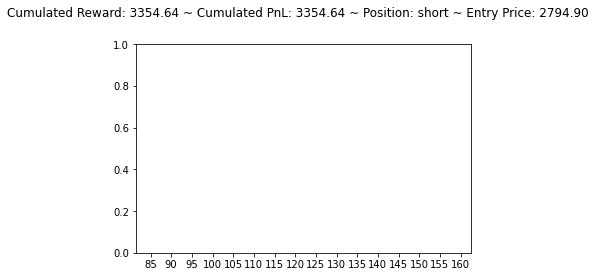

[1143.057  1175.5002 1146.2543]
short buy flat


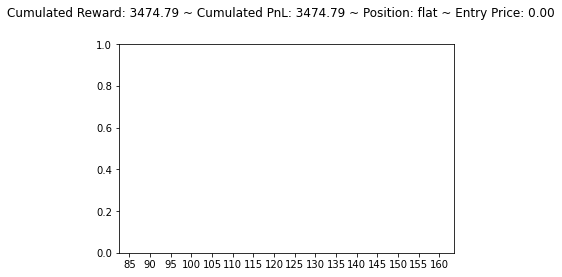

[1103.9382 1126.988  1127.1313]
flat sell short


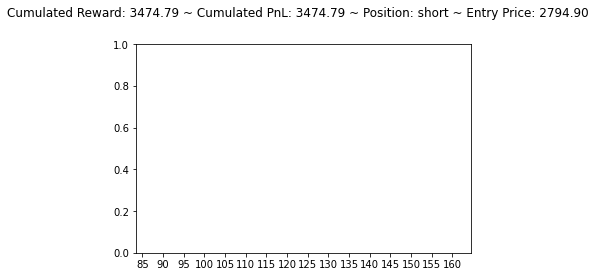

[1142.6489 1174.8767 1145.7034]
short buy flat


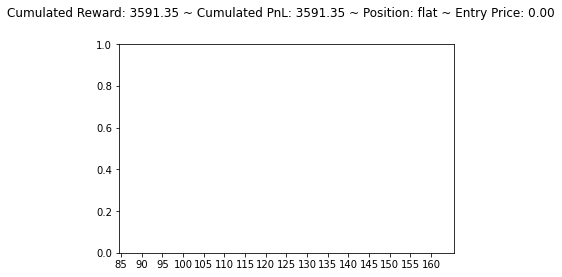

[1103.7999 1126.6433 1126.7394]
flat sell short


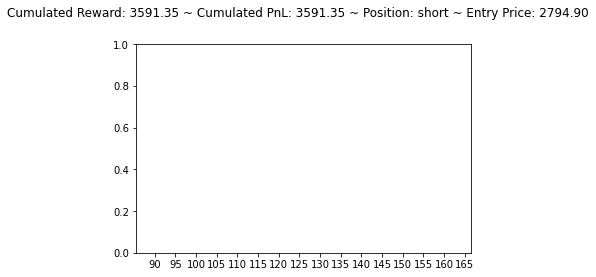

[1169.53   1215.3442 1180.7632]
short buy flat


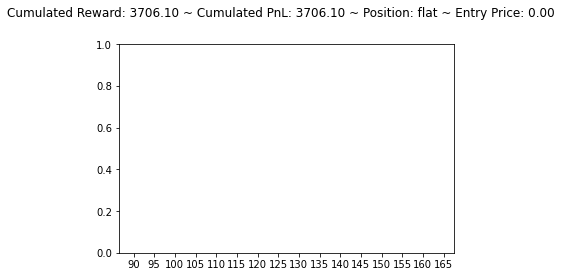

[1170.623  1229.9689 1227.1073]
flat buy long


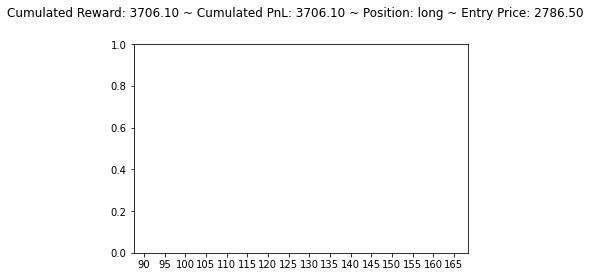

[1238.0409 1301.0322 1256.4221]
long sell flat


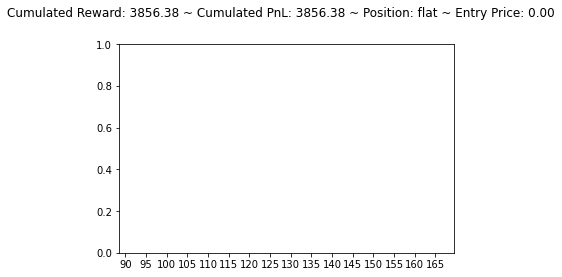

[1104.457  1138.987  1143.6871]
flat sell short


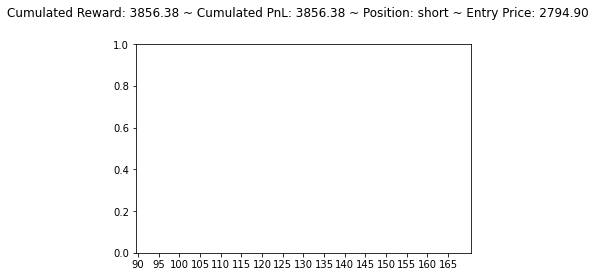

[1171.0424 1211.0349 1174.9531]
short buy flat


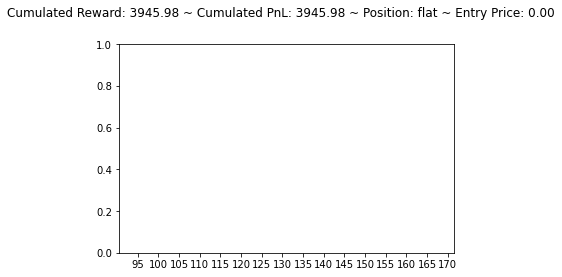

[1109.1078 1146.459  1150.437 ]
flat sell short


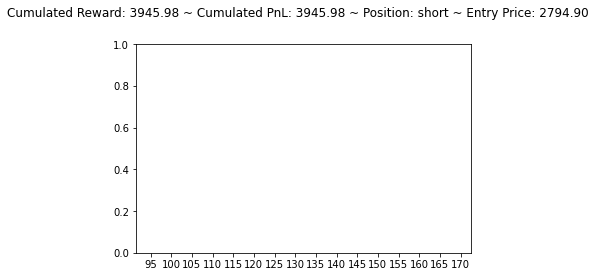

[1174.2883 1218.0278 1181.9827]
short buy flat


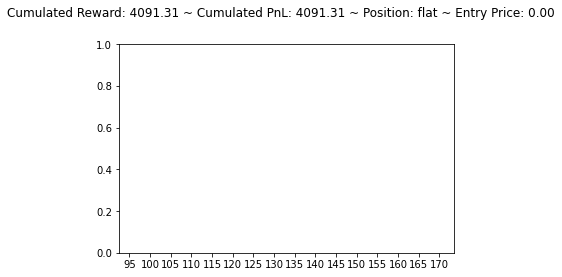

[1108.6945 1145.4473 1149.7998]
flat sell short


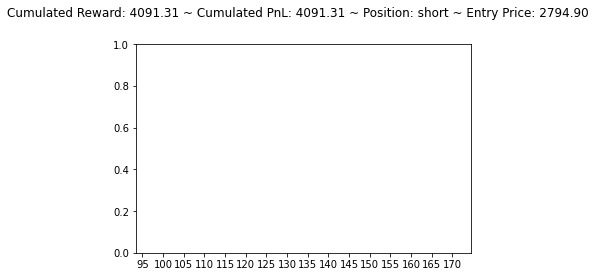

[1174.0653 1217.5498 1181.5022]
short buy flat


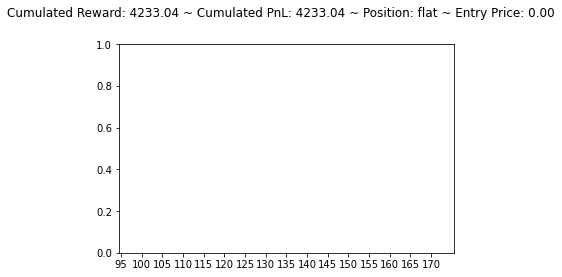

[1108.3816 1144.9712 1149.3501]
flat sell short


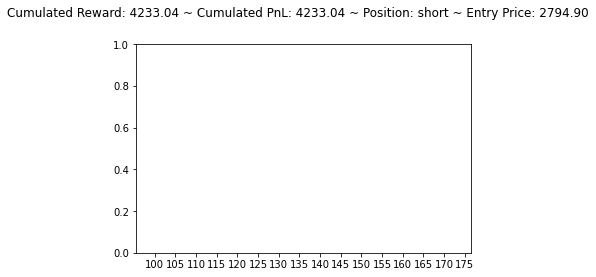

[1173.8422 1217.071  1181.0214]
short buy flat


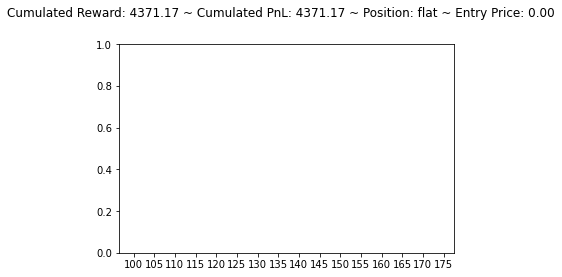

[1108.0688 1144.4954 1148.9009]
flat sell short


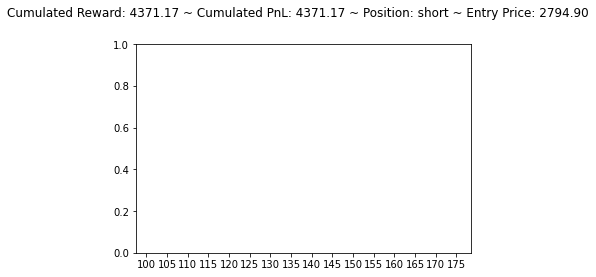

[1173.619  1216.5927 1180.5408]
short buy flat


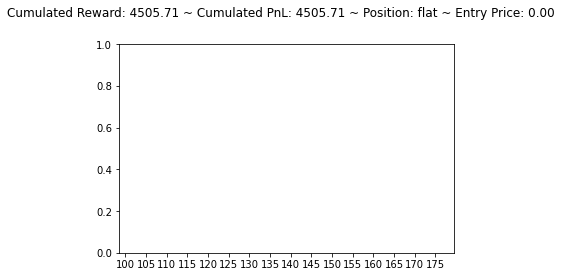

[1107.8756 1144.1959 1148.6135]
flat sell short


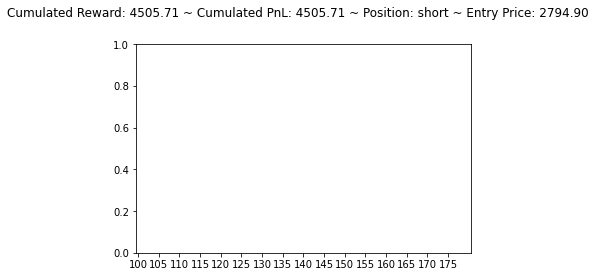

[1173.481  1216.2834 1180.2285]
short buy flat


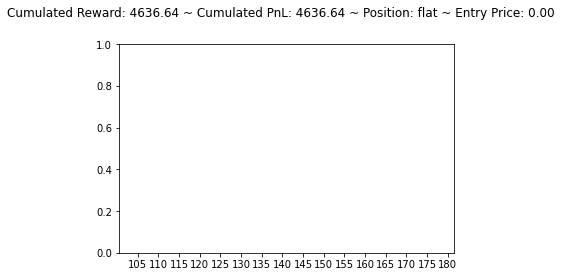

[1107.5627 1143.7201 1148.164 ]
flat sell short


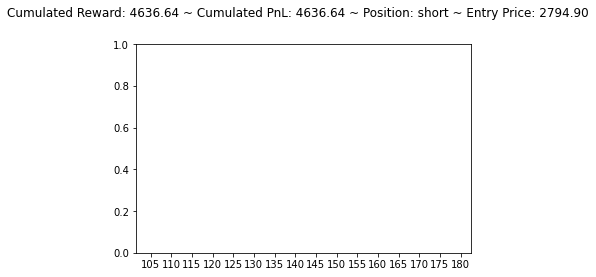

[1173.2577 1215.8049 1179.7477]
short buy flat


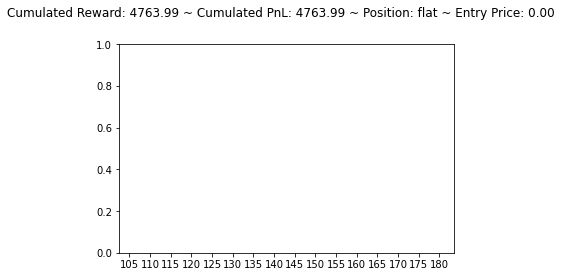

[1107.2498 1143.244  1147.7144]
flat sell short


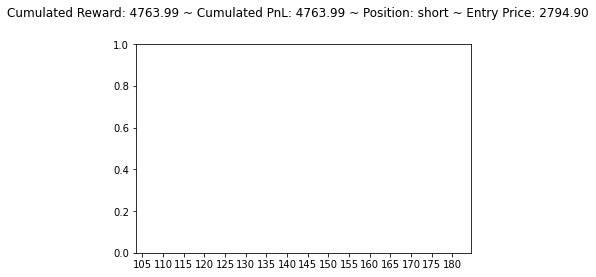

[1173.0345 1215.3264 1179.267 ]
short buy flat


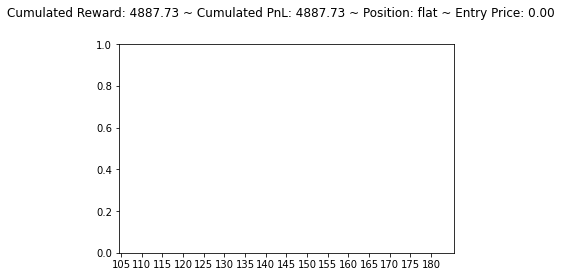

[1106.937  1142.768  1147.2648]
flat sell short


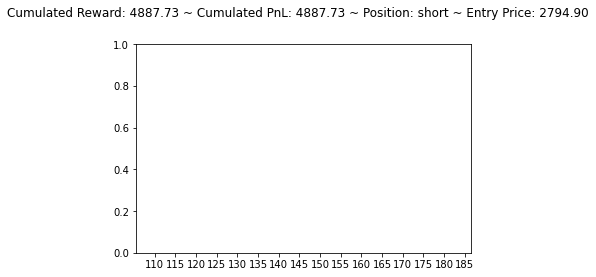

[1172.8116 1214.8481 1178.7865]
short buy flat


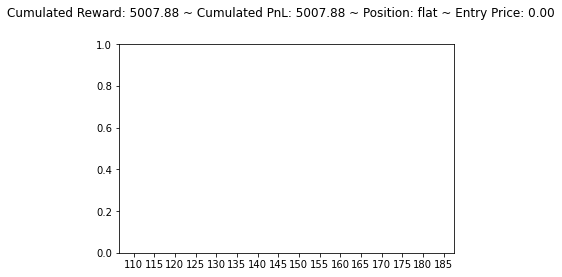

[1106.6239 1142.292  1146.8153]
flat sell short


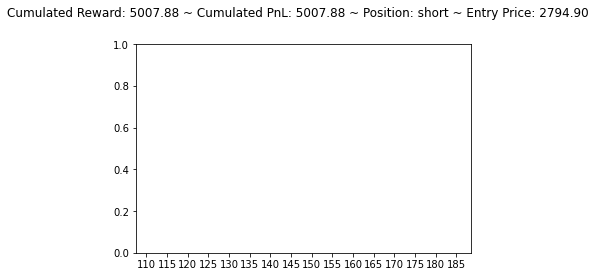

[1172.5884 1214.3696 1178.3055]
short buy flat


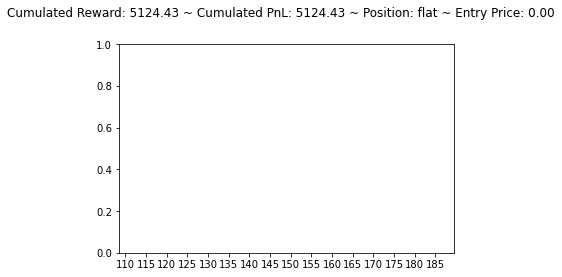

[1106.4309 1141.9928 1146.5281]
flat sell short


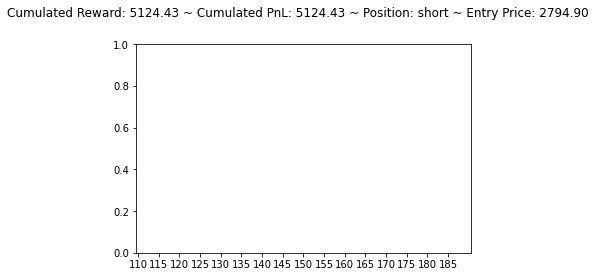

[1172.4501 1214.0602 1177.9933]
short buy flat


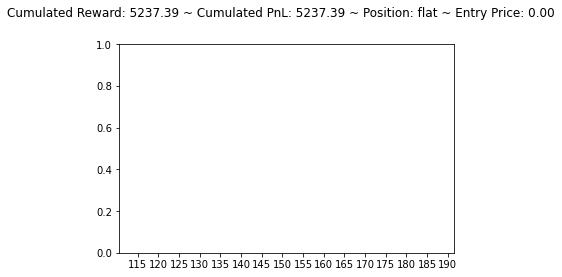

[1106.118  1141.5167 1146.0785]
flat sell short


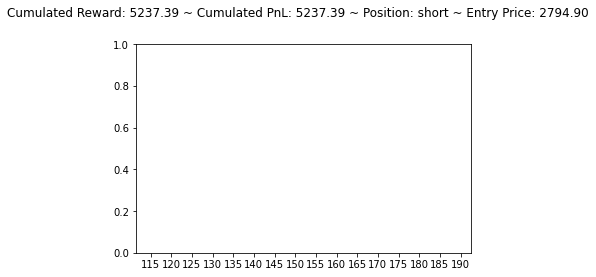

short buy flat


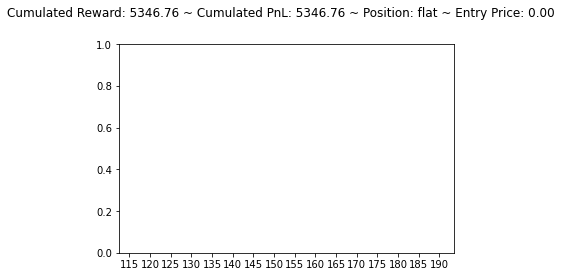

[1139.0421 1190.1882 1190.7712]
flat sell short


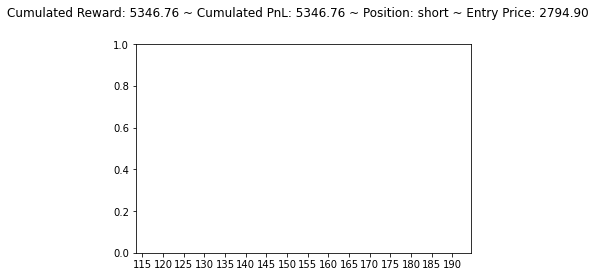

[1154.4313 1198.9983 1169.9521]
short buy flat


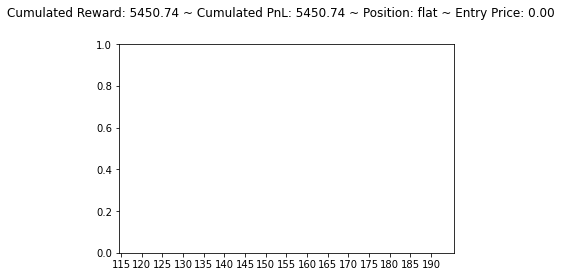

[1121.8667 1152.9001 1150.6013]
flat buy long


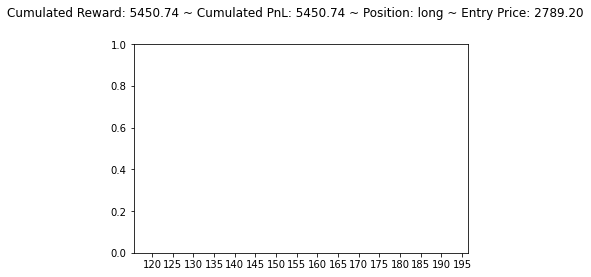

[1153.3103 1197.8784 1169.1702]
long sell flat


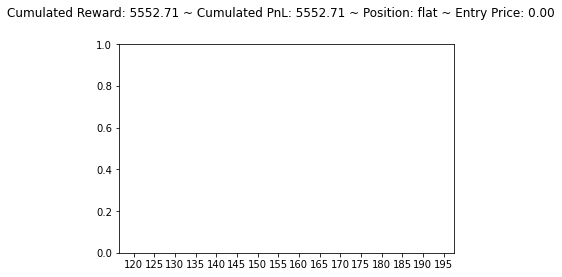

[1121.7285 1152.5557 1150.2097]
flat buy long


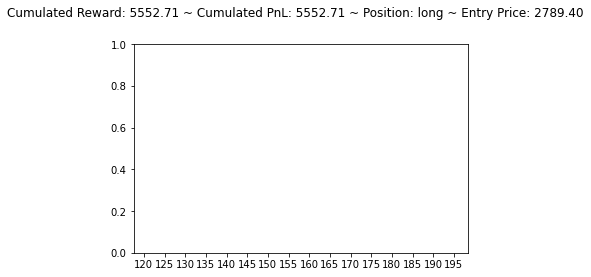

[1153.0615 1197.4943 1168.8209]
long sell flat


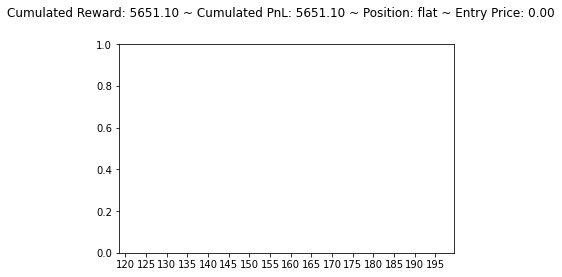

[1121.6515 1152.3441 1149.9608]
flat buy long


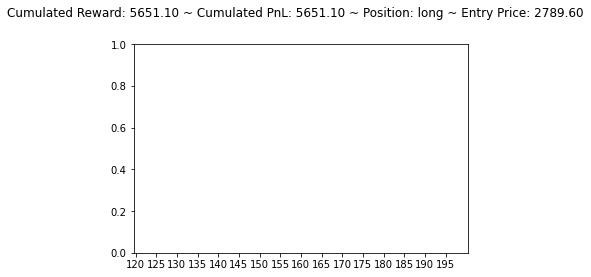

[1195.0028 1259.7356 1223.6915]
long sell flat


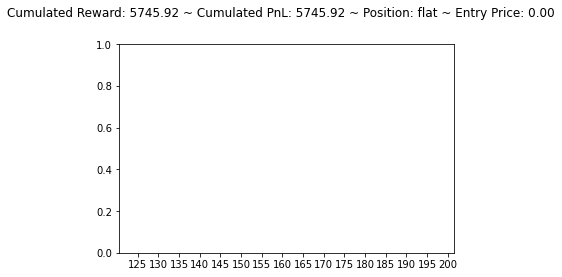

[1104.3606 1138.8374 1143.5436]
flat sell short


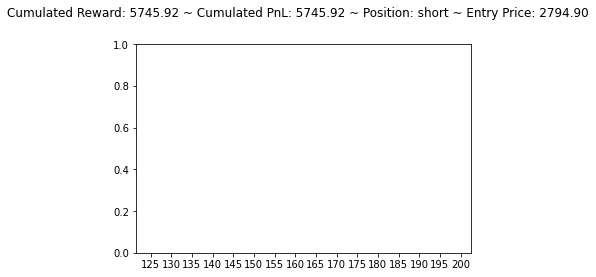

[1170.9733 1210.8804 1174.797 ]
short buy flat


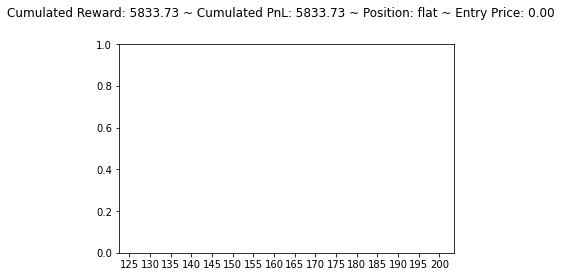

[1104.0477 1138.3616 1143.0941]
flat sell short


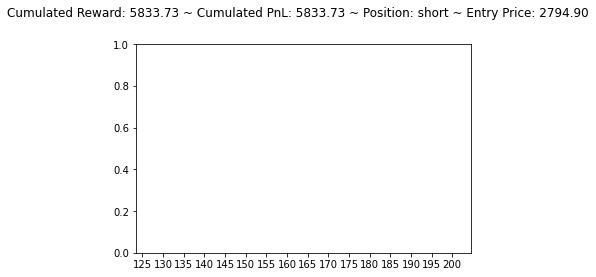

[1170.7504 1210.402  1174.3164]
short buy flat


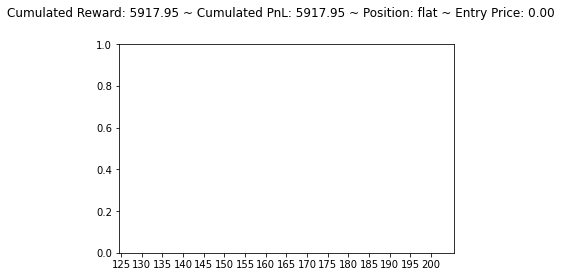

[1098.0526 1128.6547 1134.303 ]
flat sell short


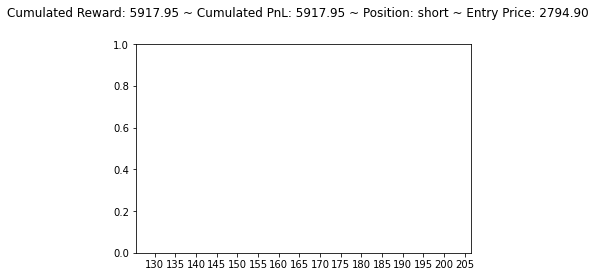

[1168.1876 1203.5294 1165.8834]
short buy flat


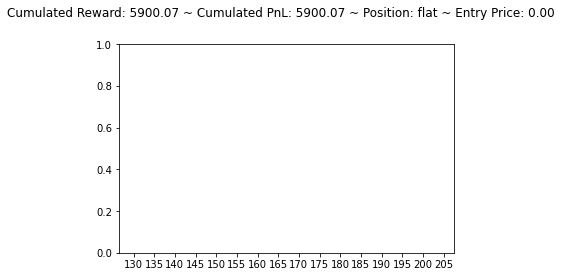

[1107.1698 1135.8187 1143.968 ]
flat sell short


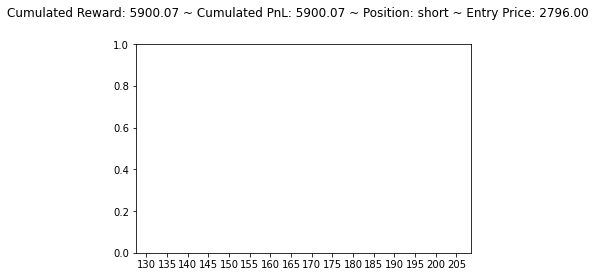

[1129.4609 1147.3773 1118.7418]
short buy flat


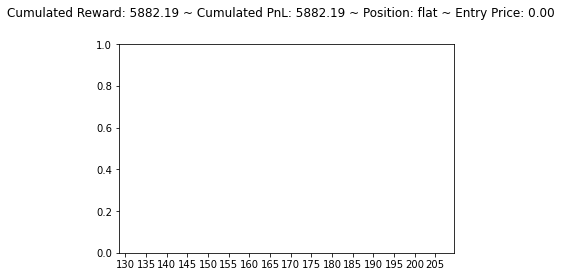

[1077.8241 1091.73   1092.5854]
flat sell short


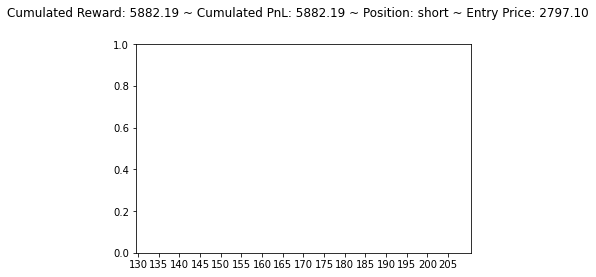

[1117.2798 1126.8491 1099.2242]
short buy flat


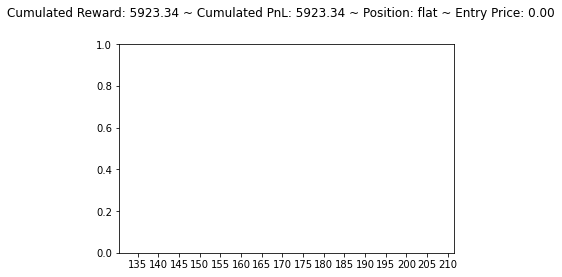

[1091.7277 1102.779  1105.1417]
flat sell short


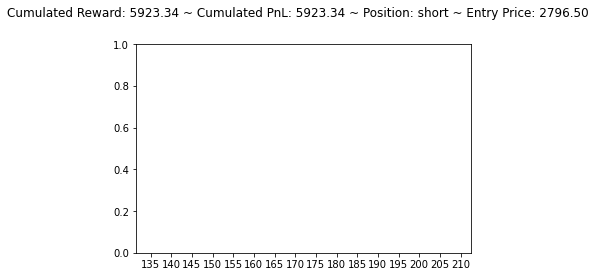

[1148.5399 1177.4149 1143.7493]
short buy flat


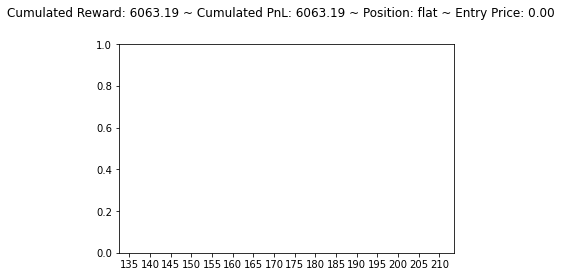

[1109.0591 1139.5682 1141.7479]
flat sell short


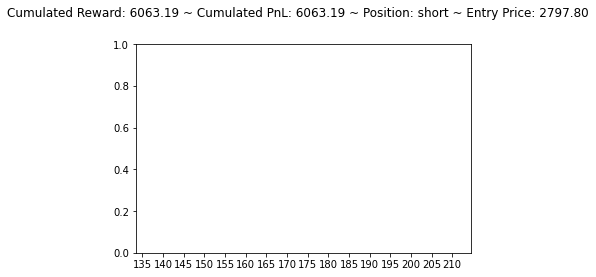

[1176.8597 1225.5452 1189.4417]
short buy flat


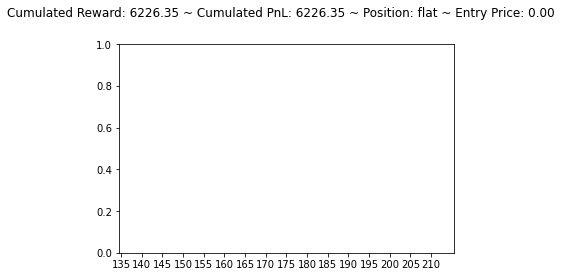

[1126.1986 1162.7166 1167.8058]
flat sell short


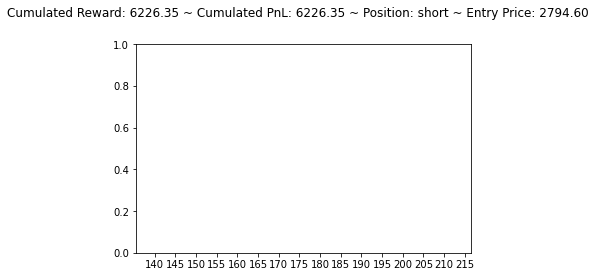

[1176.4082 1227.1132 1190.8893]
short buy flat


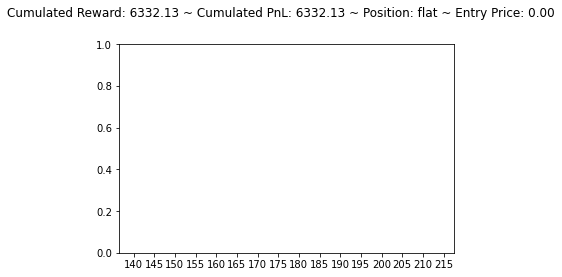

[1102.4733 1126.0496 1134.0531]
flat sell short


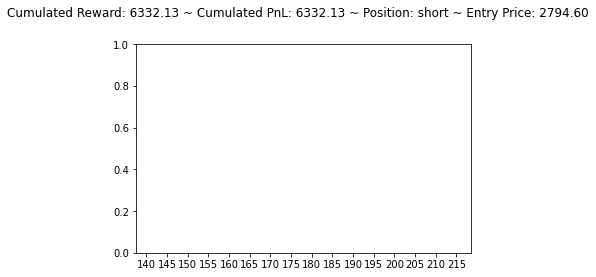

[1139.0278 1163.5795 1130.5085]
short buy flat


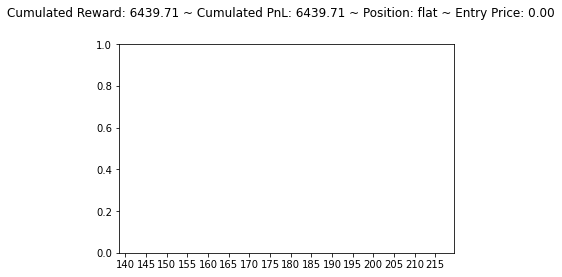

[1101.5063 1119.8138 1125.2367]
flat sell short


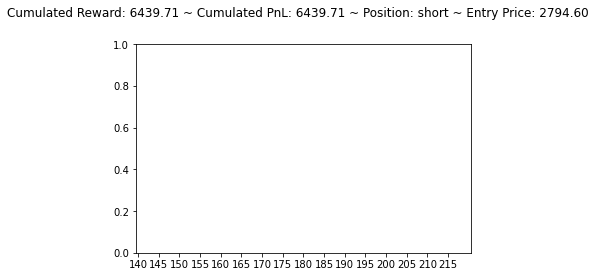

[1146.2881 1176.8113 1144.0645]
short buy flat


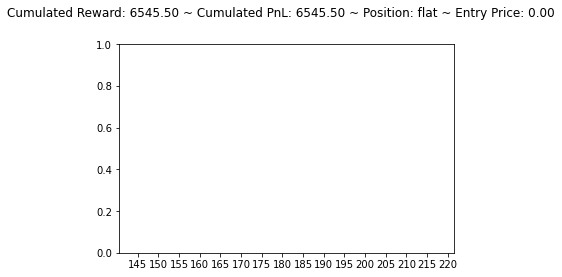

[1096.7965 1113.4749 1119.0062]
flat sell short


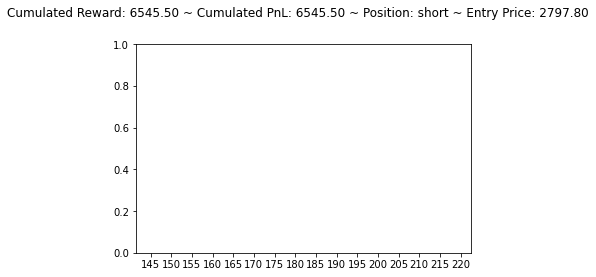

[1133.0458 1153.8984 1124.7229]
short buy flat


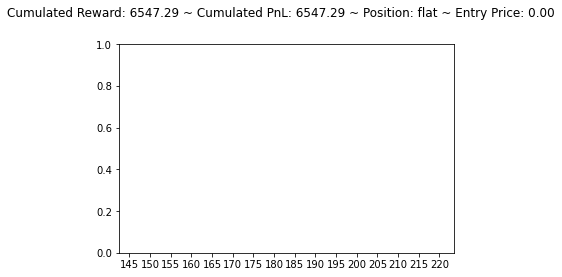

[1080.206  1086.6738 1091.033 ]
flat sell short


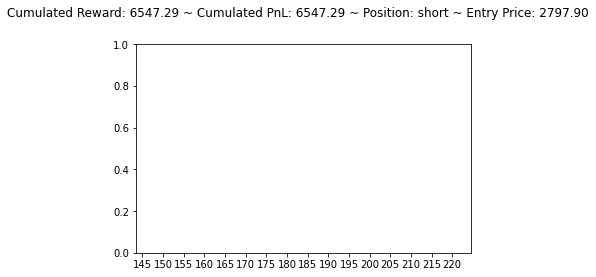

[1118.5194 1129.6952 1101.9794]
short buy flat


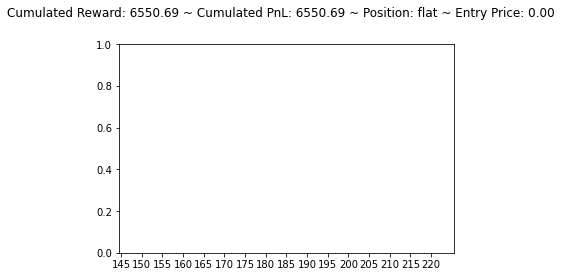

[1078.8018 1084.8048 1087.1208]
flat sell short


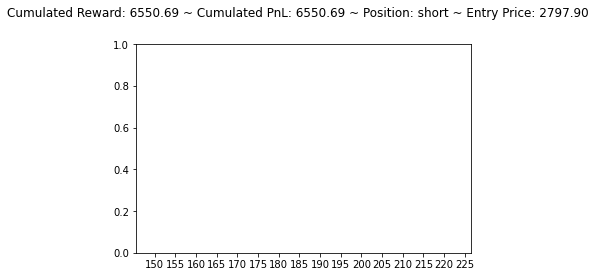

[1163.0944 1197.3252 1160.7516]
short buy flat


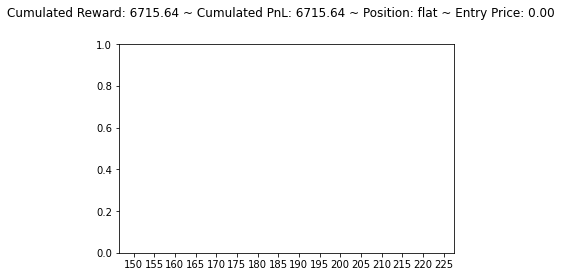

[1140.6469 1189.6638 1191.2106]
flat sell short


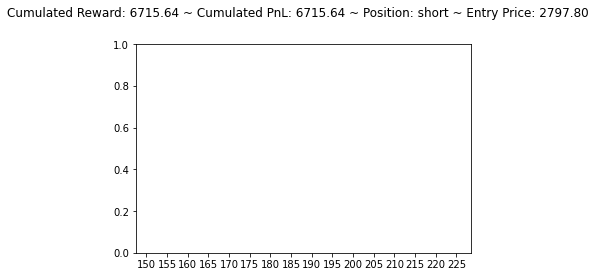

[1199.1504 1264.641  1226.5802]
short buy flat


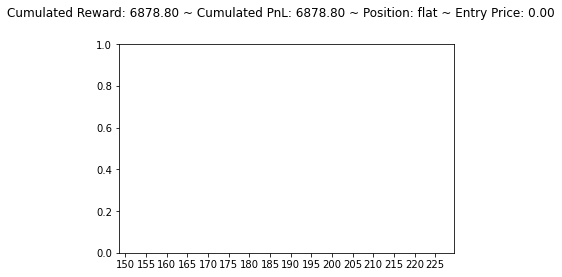

[1144.0397 1194.0164 1197.5798]
flat sell short


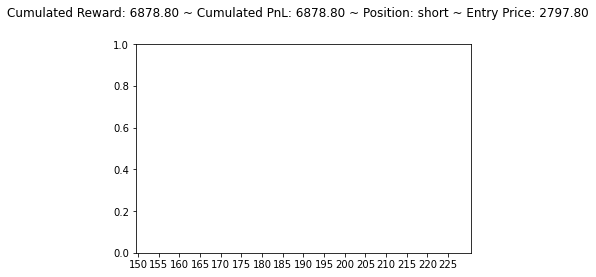

[1203.0905 1270.928  1231.9137]
short buy flat


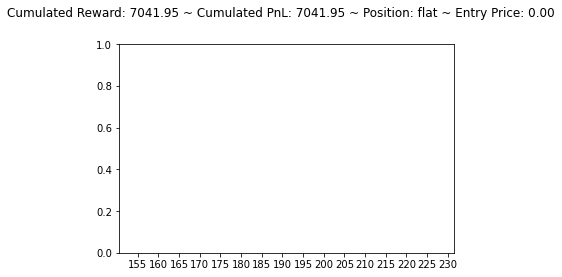

[1153.5107 1207.6895 1211.2181]
flat sell short


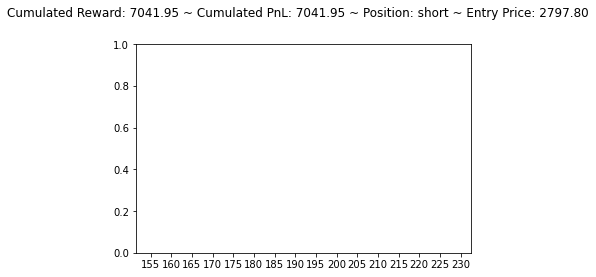

[1194.291  1260.8419 1224.3125]
short buy flat


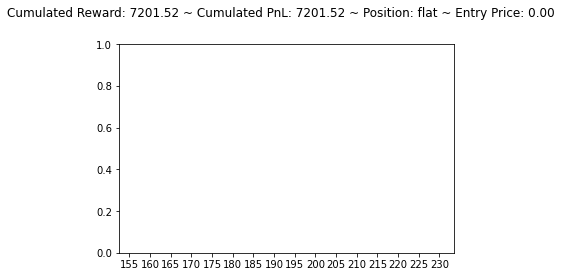

[1124.5348 1161.0432 1165.9515]
flat sell short


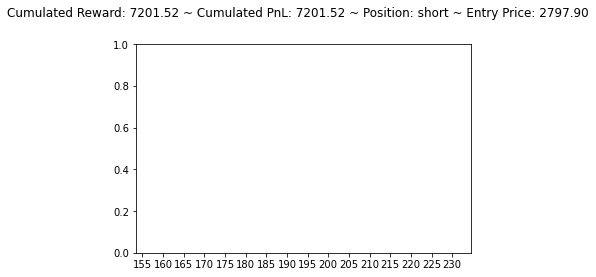

[1175.8406 1225.9119 1190.5737]
short buy flat


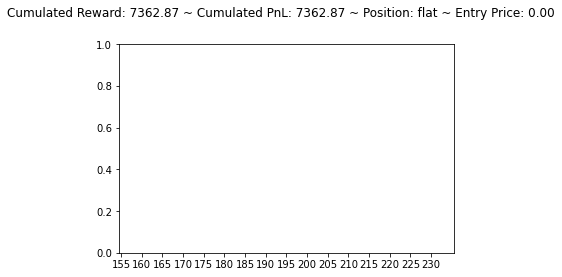

[1129.6338 1167.9019 1171.7961]
flat sell short


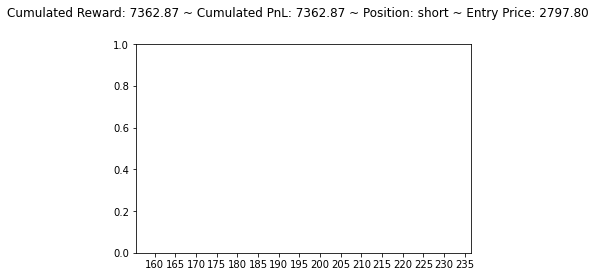

[1155.8682 1196.9021 1164.5663]
short buy flat


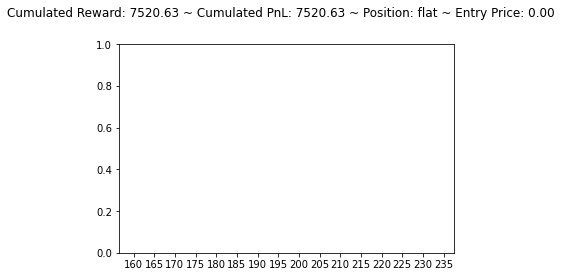

[1120.1713 1145.9186 1149.4056]
flat sell short


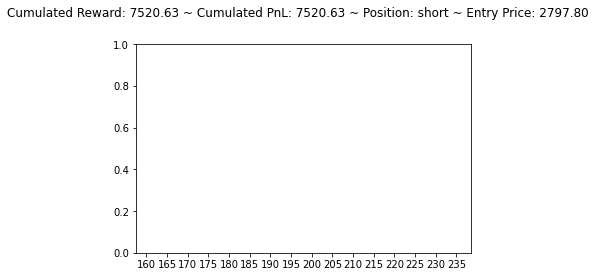

[1157.0011 1199.1279 1166.778 ]
short buy flat


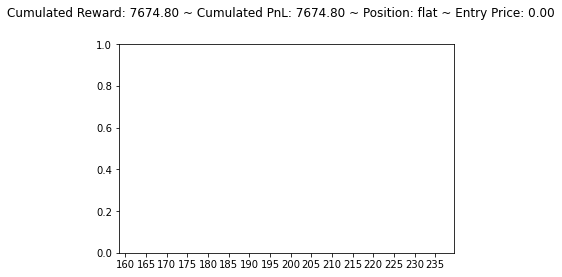

[1119.8583 1145.4426 1148.956 ]
flat sell short


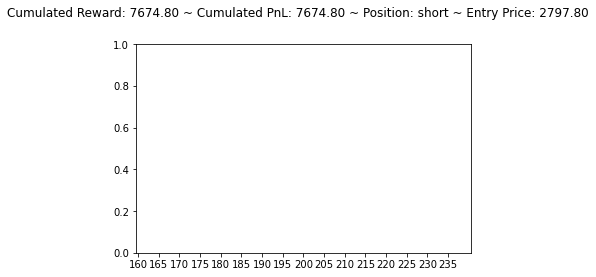

[1156.7781 1198.6495 1166.2972]
short buy flat


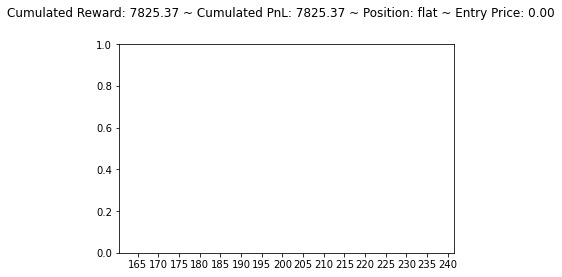

[1119.5455 1144.9666 1148.5065]
flat sell short


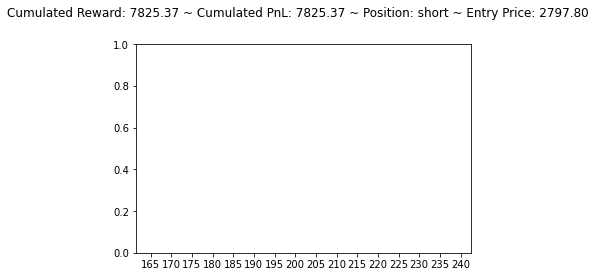

[1156.5549 1198.1711 1165.8167]
short buy flat


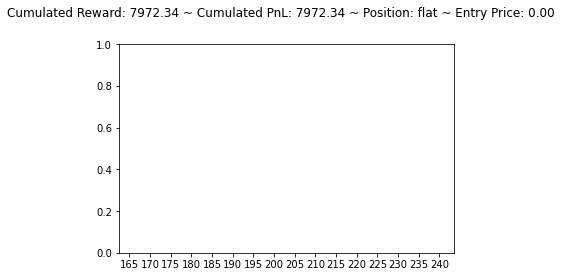

[1119.2328 1144.4907 1148.0571]
flat sell short


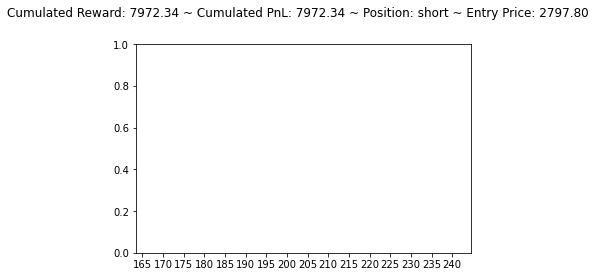

[1156.332  1197.6926 1165.3358]
short buy flat


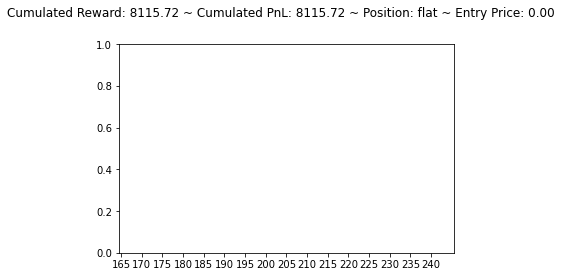

[1119.0393 1144.1915 1147.7699]
flat sell short


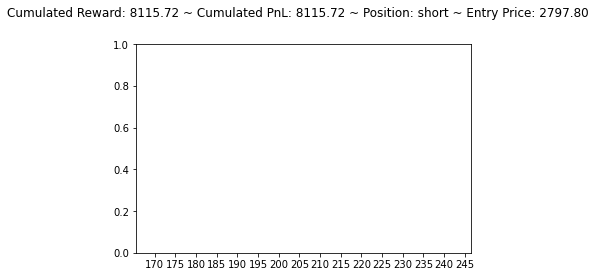

[1156.1936 1197.3832 1165.0236]
short buy flat


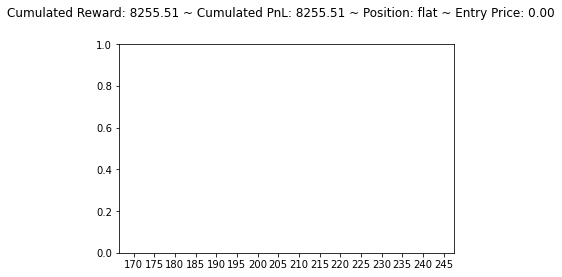

[1118.7264 1143.7153 1147.3202]
flat sell short


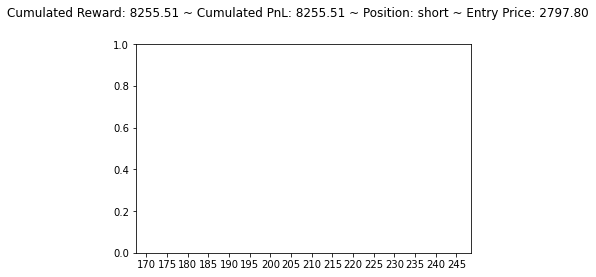

[1155.9706 1196.9048 1164.5428]
short buy flat


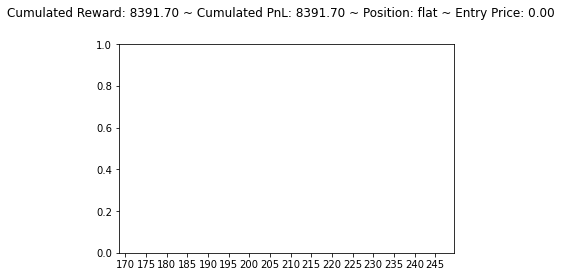

[1118.4137 1143.2394 1146.8707]
flat sell short


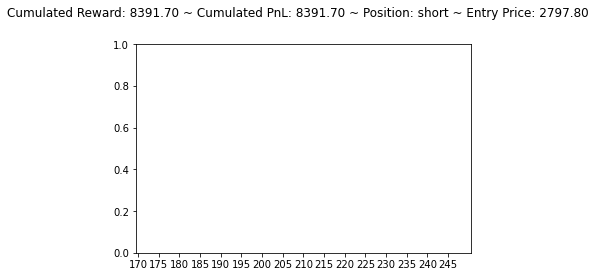

[1193.823  1252.9634 1213.9065]
short buy flat


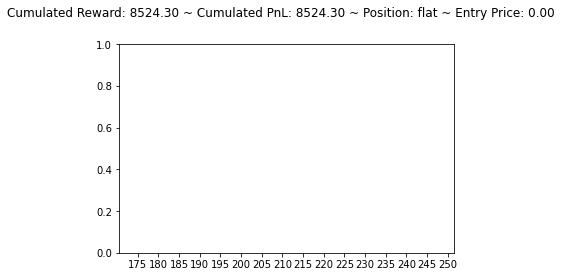

[1134.0375 1177.3301 1183.6289]
flat sell short


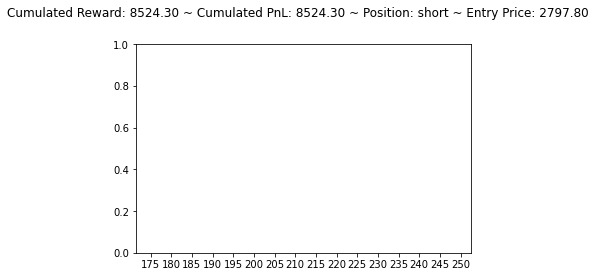

[1193.6    1252.4847 1213.4258]
short buy flat


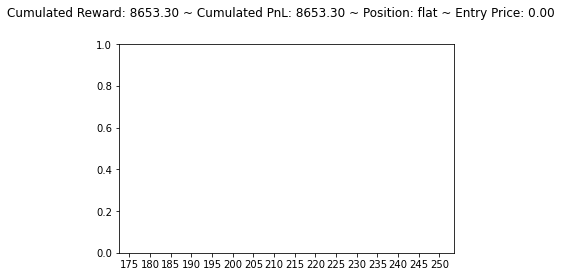

[1133.7245 1176.8542 1183.1793]
flat sell short


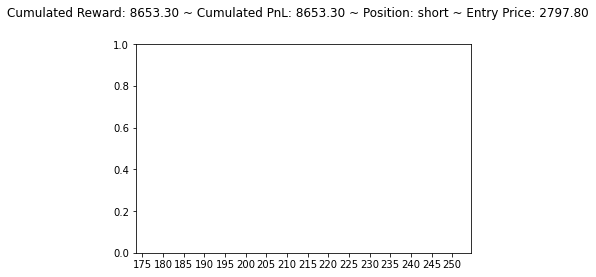

[1193.3771 1252.0063 1212.9452]
short buy flat


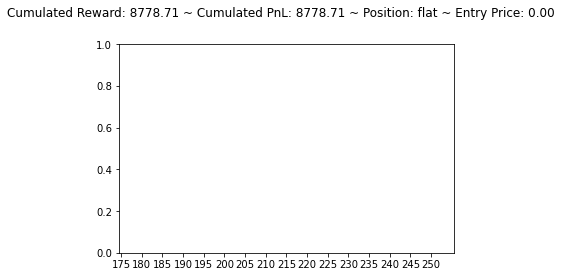

[1133.531  1176.555  1182.8922]
flat sell short


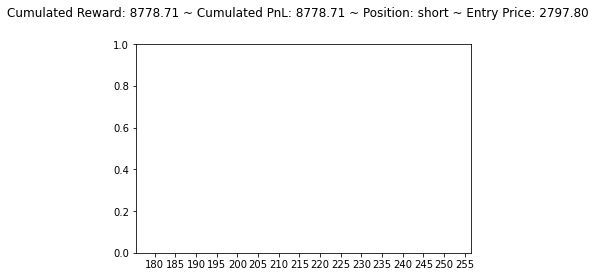

[1193.2385 1251.6969 1212.6327]
short buy flat


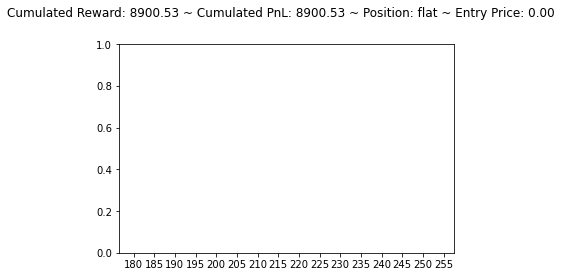

[1144.2307 1192.3508 1197.3906]
flat sell short


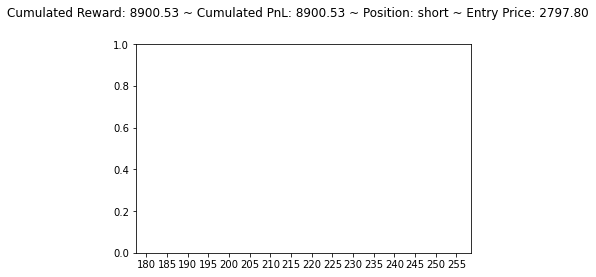

[1186.9166 1246.1235 1209.4323]
short buy flat


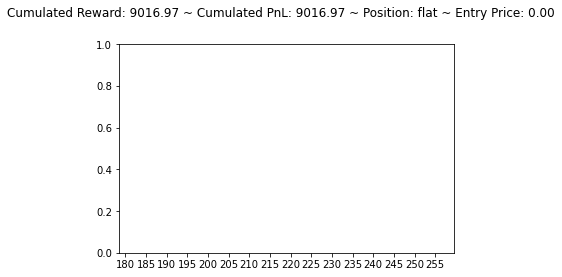

[1138.4564 1179.7913 1183.8385]
flat sell short


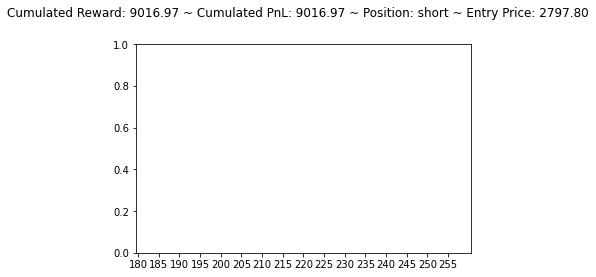

[1186.5085 1245.4999 1208.8815]
short buy flat


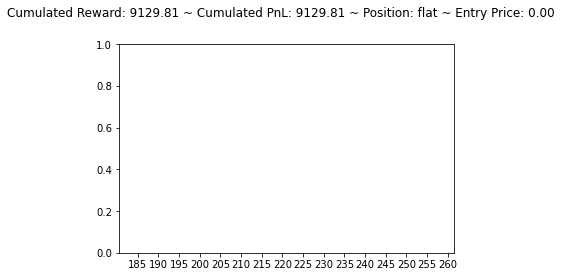

[1138.3182 1179.4465 1183.4465]
flat sell short


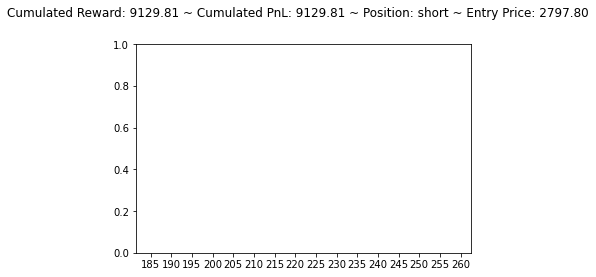

[1186.1003 1244.8761 1208.3304]
short buy flat


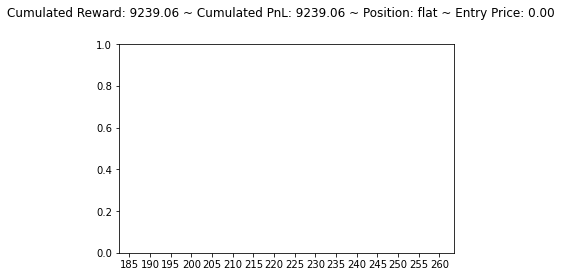

[1138.18   1179.1018 1183.0548]
flat sell short


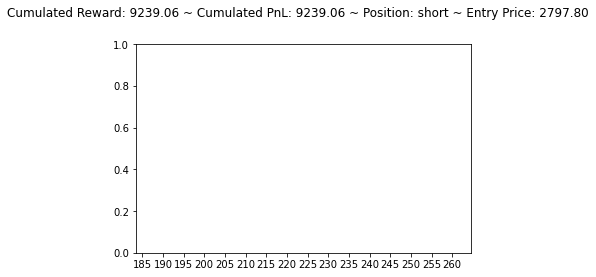

[1185.8385 1244.47   1207.9712]
short buy flat


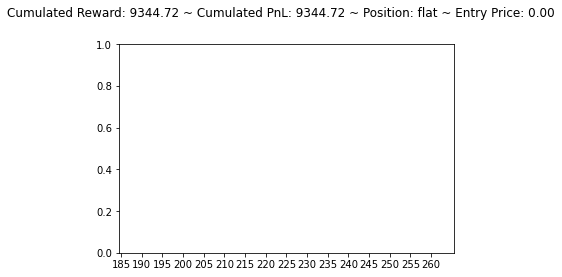

[1138.103  1178.8901 1182.8059]
flat sell short


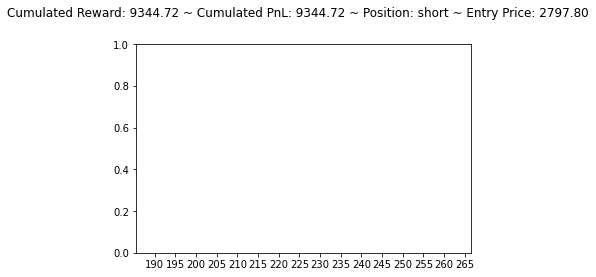

[1200.967  1266.8958 1227.7487]
short buy flat


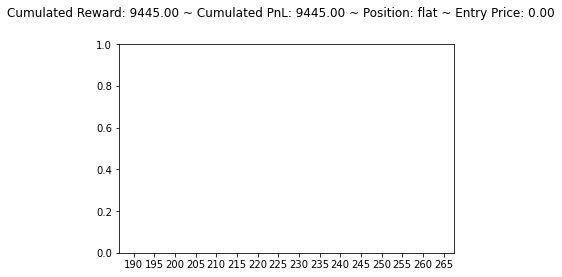

[1131.4609 1173.3997 1179.9077]
flat sell short


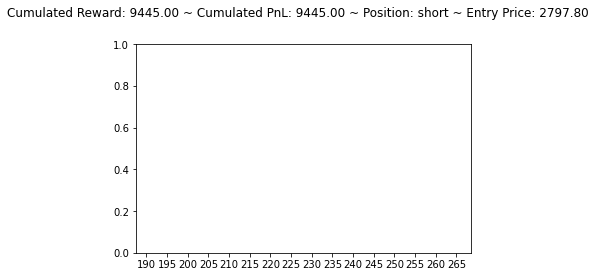

[1191.283  1248.518  1209.1733]
short buy flat


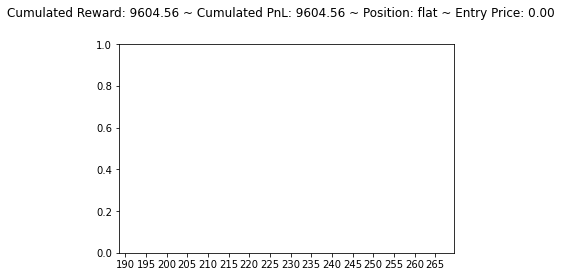

[1144.404  1192.1405 1197.4276]
flat sell short


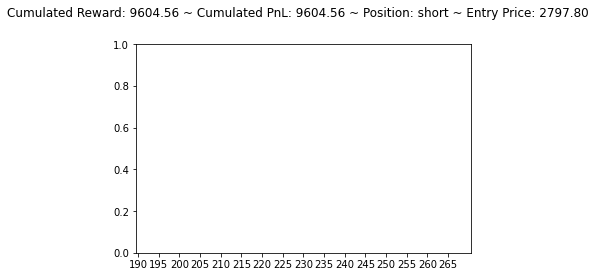

[1200.5372 1266.954  1227.5266]
short buy flat


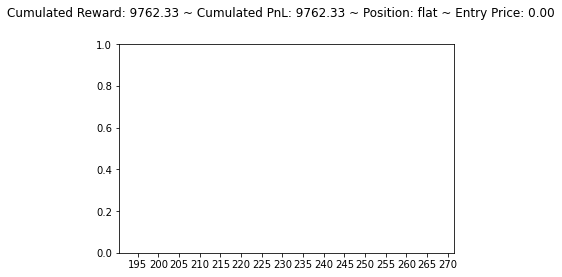

[1143.7747 1191.8083 1197.0161]
flat sell short


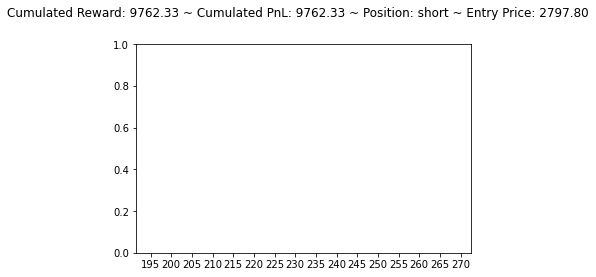

[1200.5309 1266.4954 1227.4108]
short buy flat


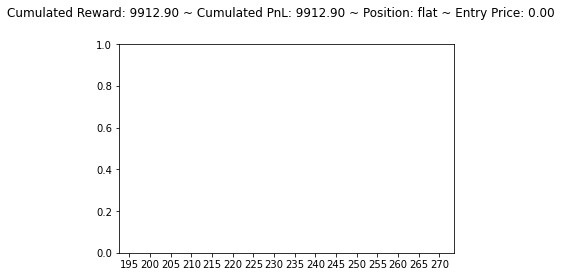

[1139.0344 1185.384  1190.6198]
flat sell short


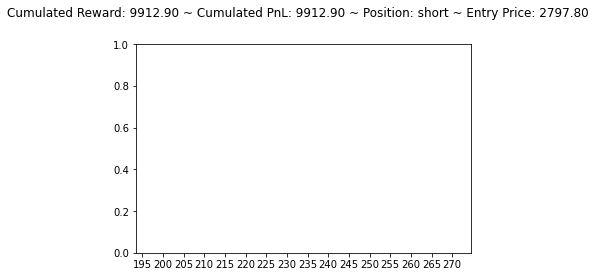

[1184.2404 1241.654  1205.8158]
short buy flat


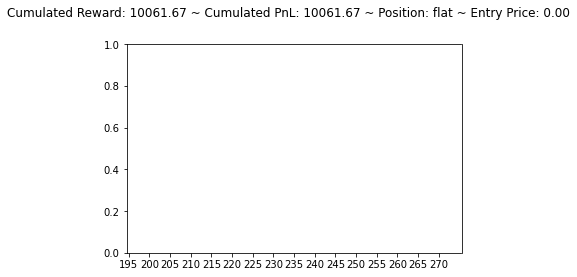

[1134.5935 1175.978  1179.103 ]
flat sell short


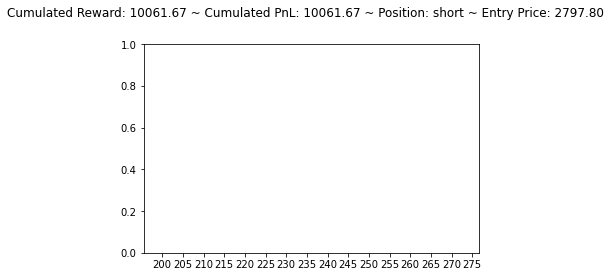

[1183.8324 1241.0304 1205.2649]
short buy flat


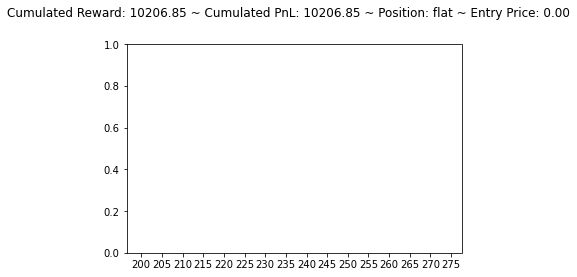

[1134.4552 1175.6335 1178.7113]
flat sell short


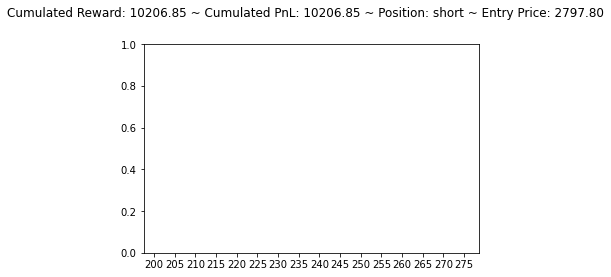

[1191.0668 1251.746  1214.9764]
short buy flat


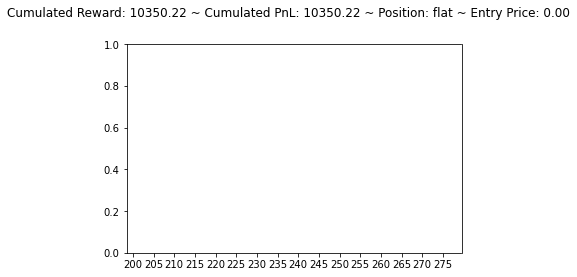

[1126.5311 1167.5454 1171.598 ]
flat sell short


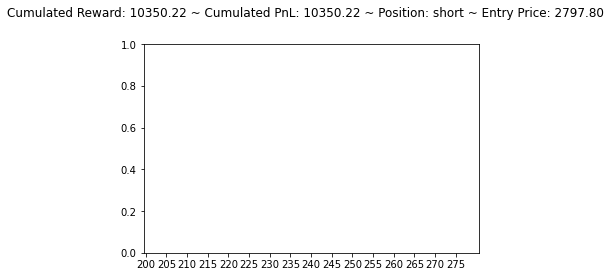

[1184.2495 1237.8639 1201.1975]
short buy flat


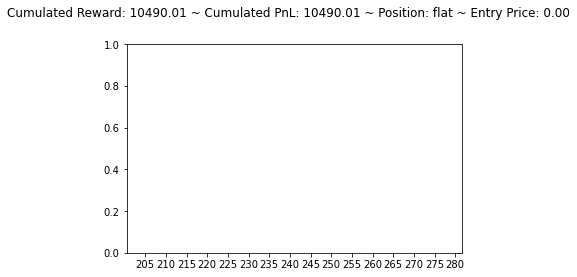

[1141.348  1188.7948 1191.6415]
flat sell short


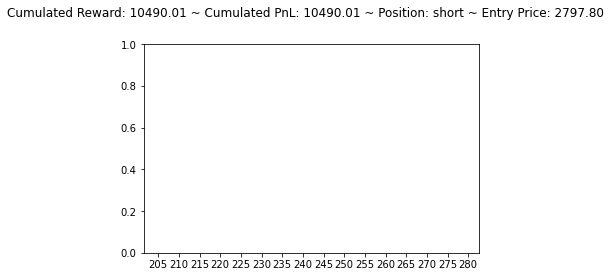

[1186.0609 1245.1777 1208.9242]
short buy flat


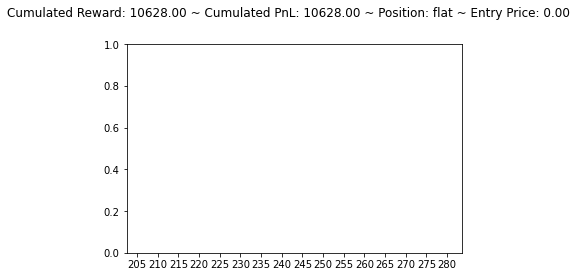

[1136.4515 1178.7087 1182.0131]
flat sell short


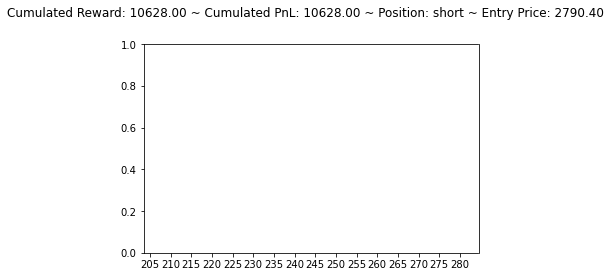

[1151.6448 1194.8608 1163.8416]
short buy flat


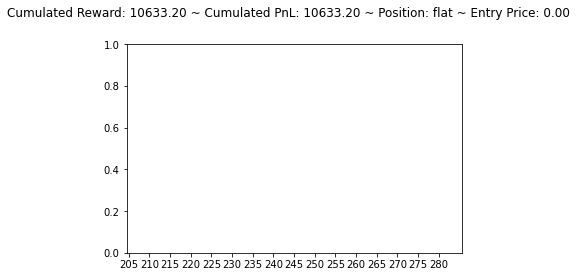

[1111.     1131.7117 1132.822 ]
flat sell short


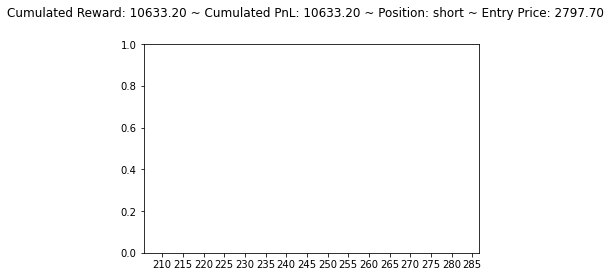

[1169.073  1217.3816 1184.7523]
short buy flat


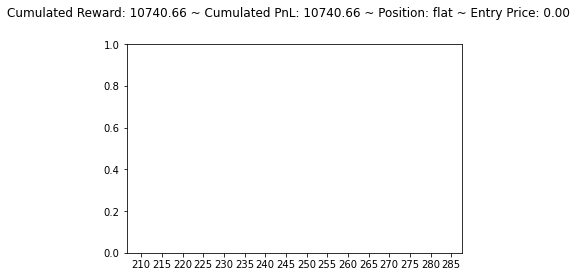

[1087.114  1106.4059 1111.1028]
flat sell short


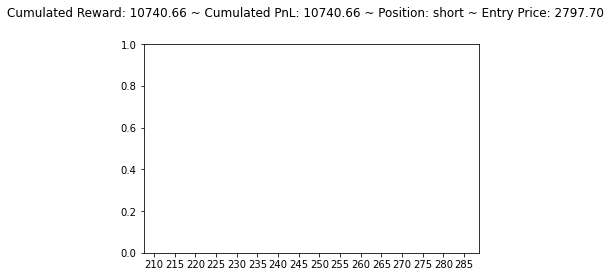

[1157.0828 1186.2612 1151.8887]
short buy flat


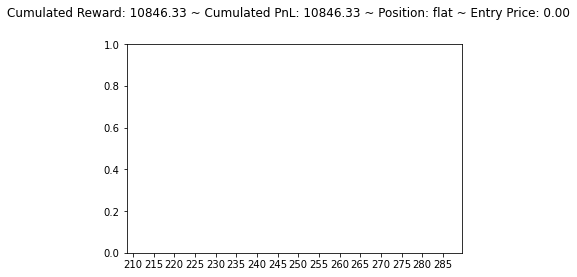

[1094.3674 1120.9951 1126.4039]
flat sell short


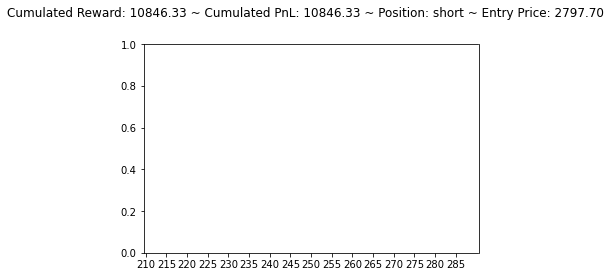

[1152.1709 1180.3654 1146.6665]
short buy flat


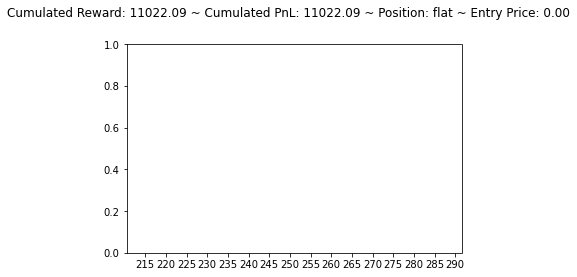

[1125.893  1165.5286 1166.8735]
flat sell short


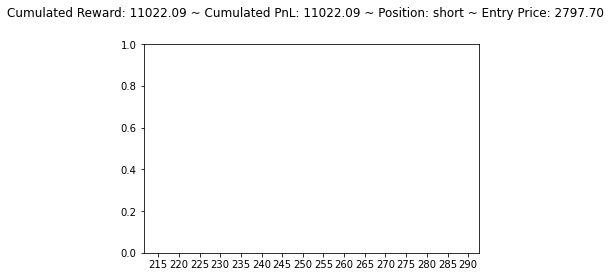

[1175.8341 1227.7393 1193.9033]
short buy flat


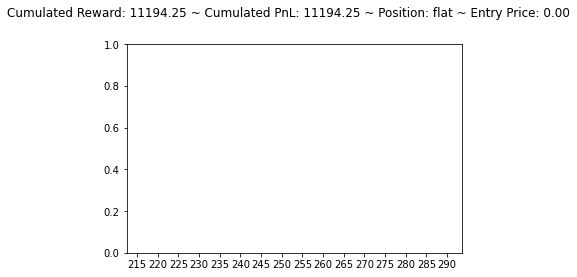

[1125.7548 1165.1838 1166.4816]
flat sell short


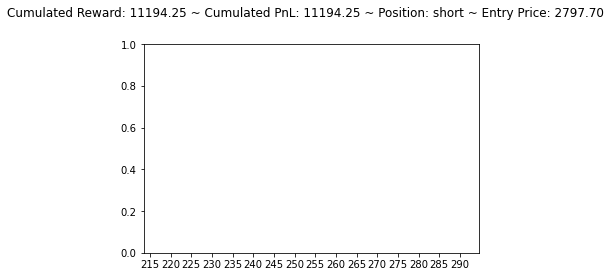

[1175.7189 1227.5503 1193.7356]
short buy flat


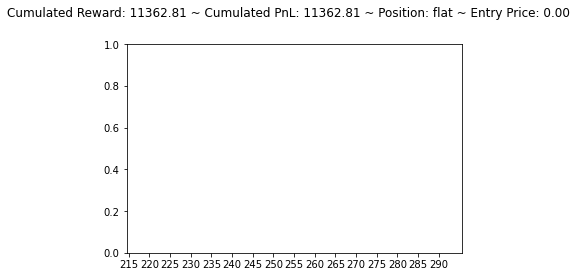

[1125.7393 1165.1055 1166.3762]
flat sell short


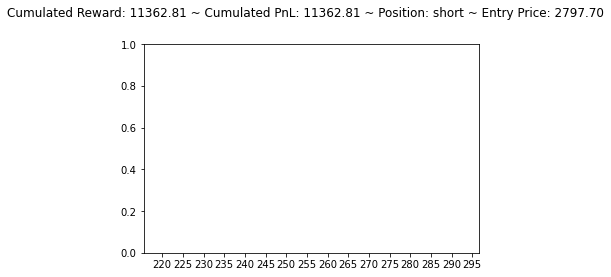

[1175.3107 1226.9266 1193.1846]
short buy flat


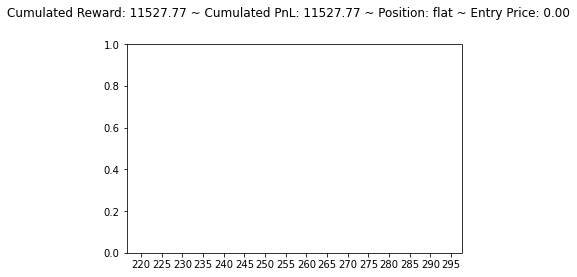

[1125.601  1164.7607 1165.9841]
flat sell short


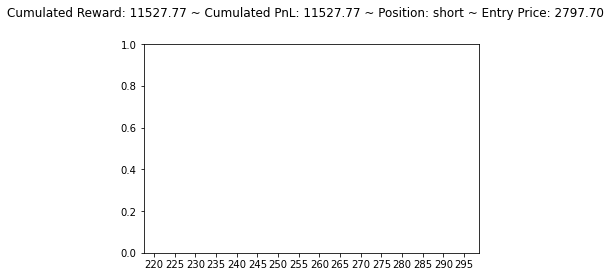

[1174.9026 1226.3029 1192.6338]
short buy flat


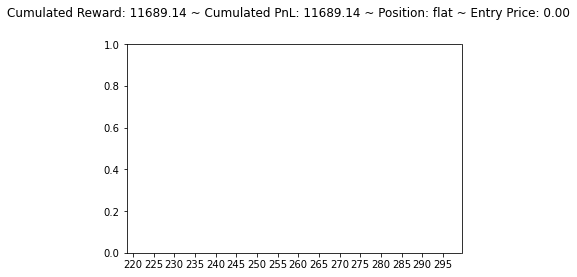

[1125.4626 1164.4163 1165.5924]
flat sell short


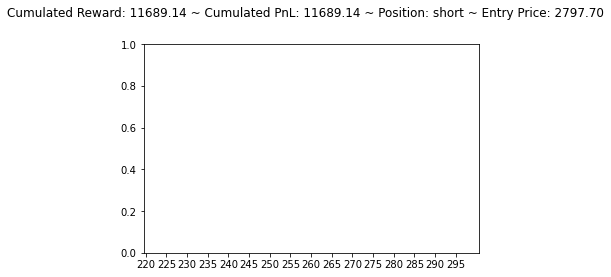

[1174.6409 1225.8965 1192.2744]
short buy flat


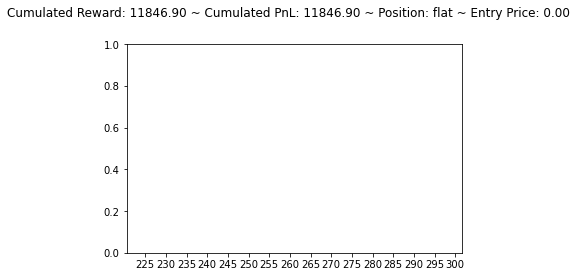

[1125.3857 1164.2046 1165.3436]
flat sell short


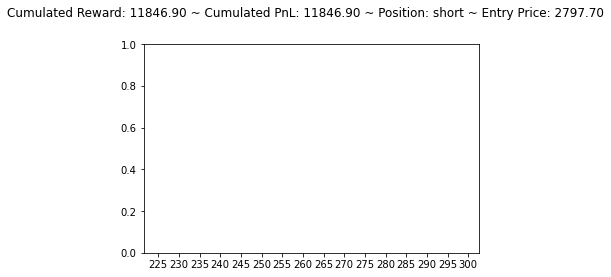

[1174.2325 1225.2727 1191.7234]
short buy flat


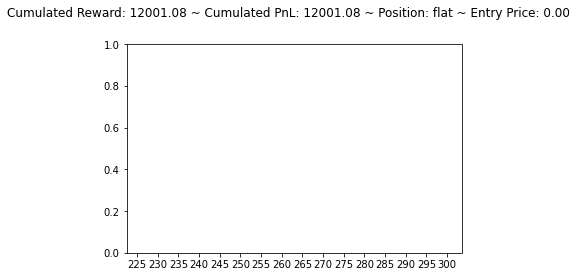

[1125.2472 1163.86   1164.9517]
flat sell short


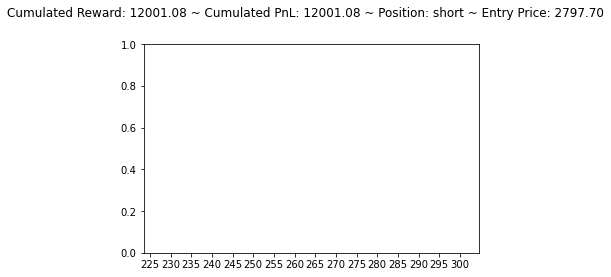

[1173.8246 1224.6489 1191.1725]
short buy flat


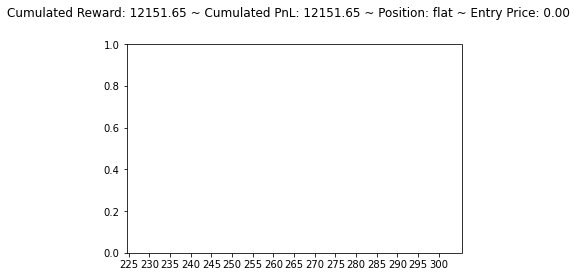

[1124.9895 1163.3384 1164.3973]
flat sell short


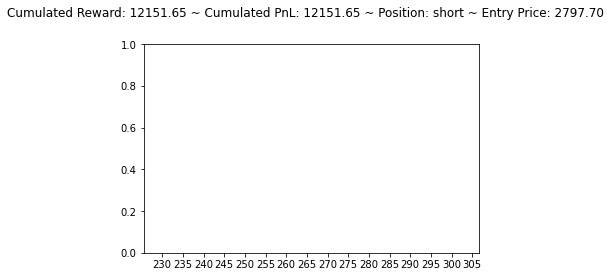

[1173.3317 1223.8563 1190.4532]
short buy flat


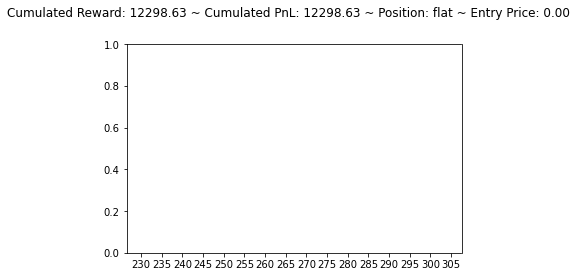

[1124.8514 1162.9938 1164.0055]
flat sell short


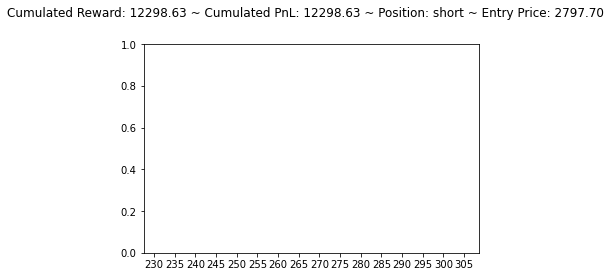

[1172.9235 1223.2324 1189.9022]
short buy flat


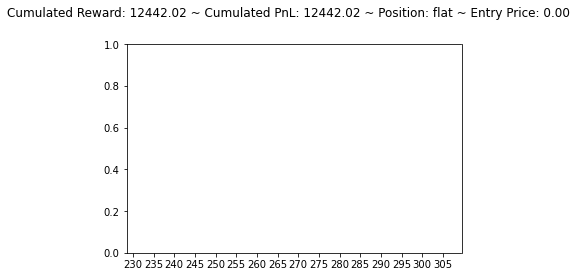

[1124.7131 1162.6494 1163.6138]
flat sell short


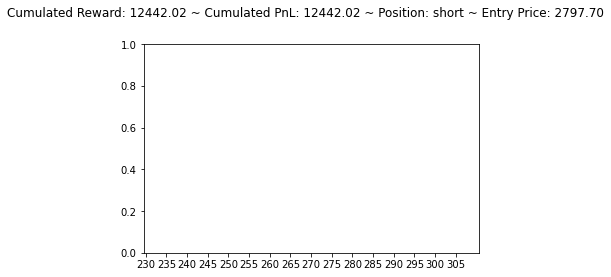

[1172.6616 1222.8263 1189.5428]
short buy flat


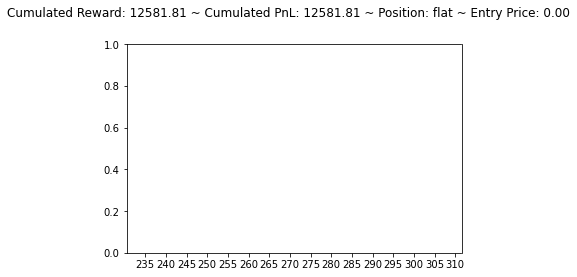

[1124.636  1162.4377 1163.365 ]
flat sell short


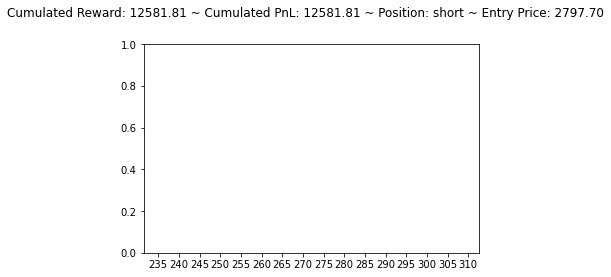

[1172.2535 1222.2024 1188.992 ]
short buy flat


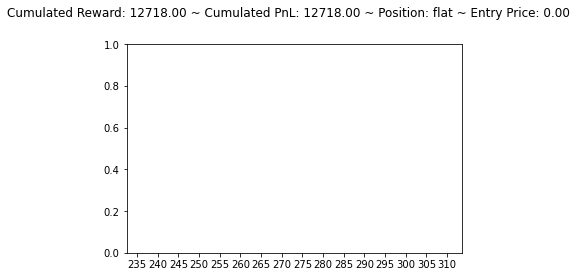

[1124.498 1162.093 1162.973]
flat sell short


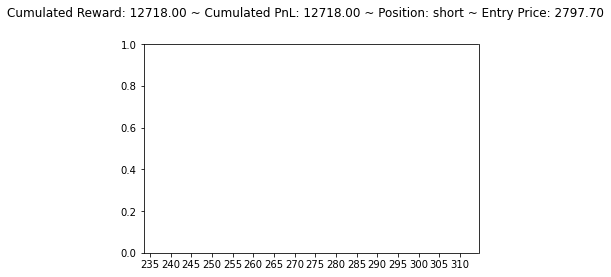

[1171.8455 1221.5787 1188.4409]
short buy flat


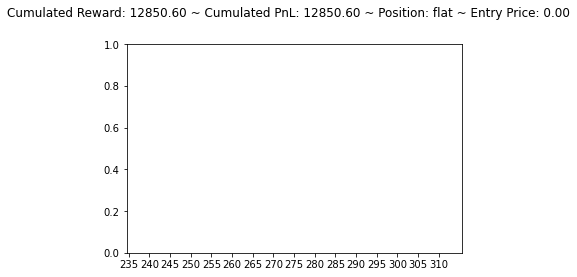

[1124.3597 1161.7485 1162.5813]
flat sell short


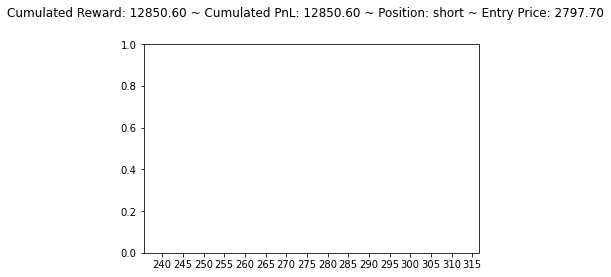

[1171.4374 1220.9551 1187.89  ]
short buy flat


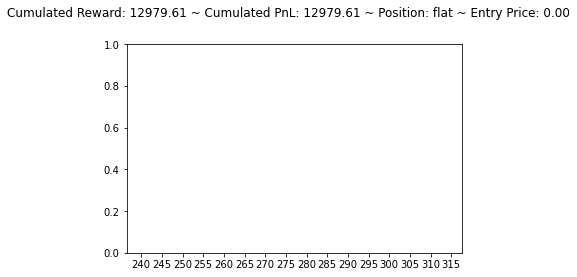

[1124.2217 1161.4039 1162.1895]
flat sell short


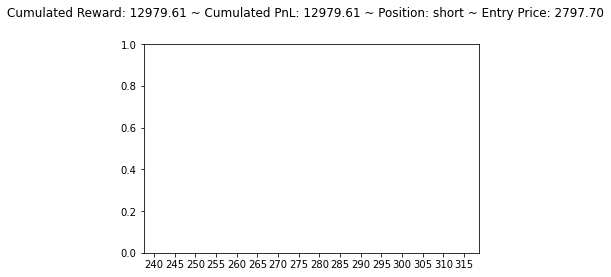

[1171.0293 1220.331  1187.3389]
short buy flat


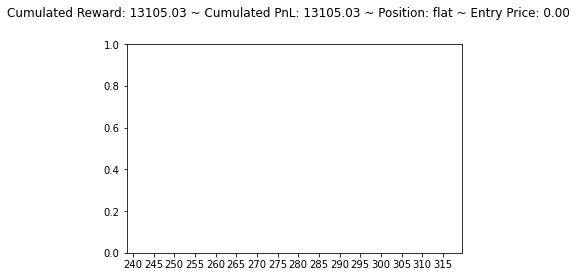

[1124.083  1161.0594 1161.7975]
flat sell short


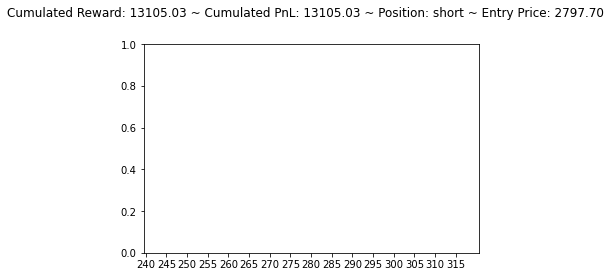

[1170.7675 1219.925  1186.9799]
short buy flat


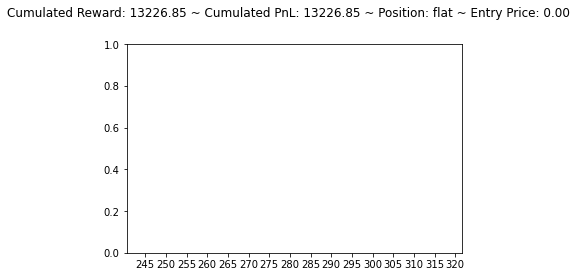

[1118.6735 1153.4727 1154.6902]
flat sell short


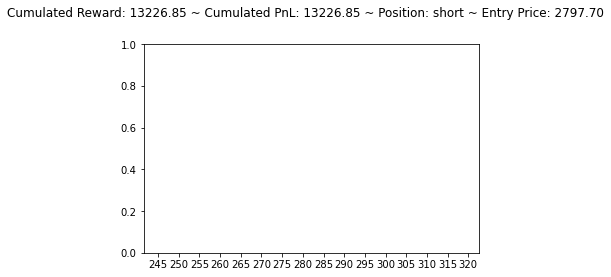

[1216.1637 1285.8558 1244.3418]
short buy flat


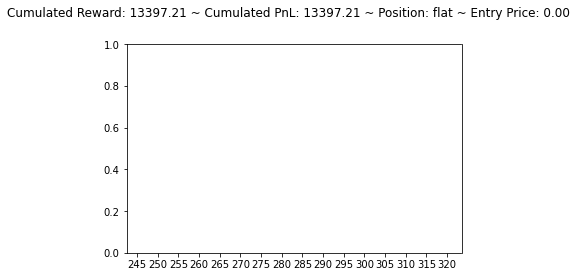

[1184.4794 1244.9347 1241.2443]
flat buy long


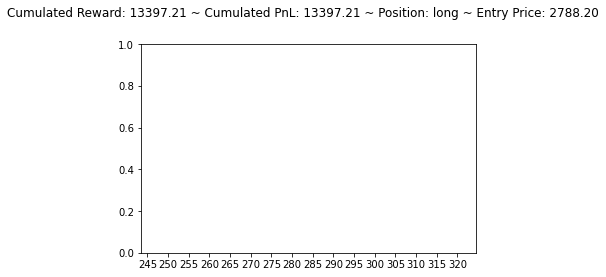

[1284.3732 1341.206  1283.4551]
long hold long


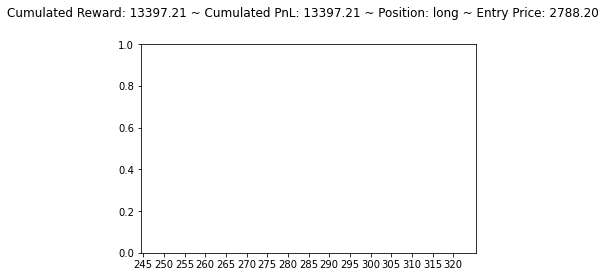

[1279.6938 1337.0117 1280.6888]
long sell flat


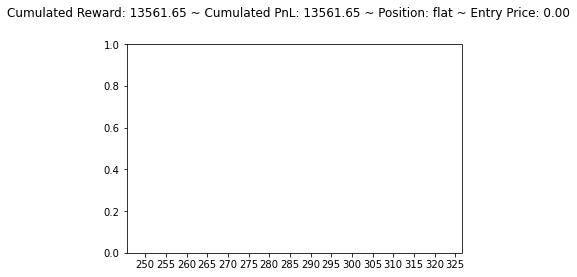

[1205.2372 1255.7072 1249.9863]
flat buy long


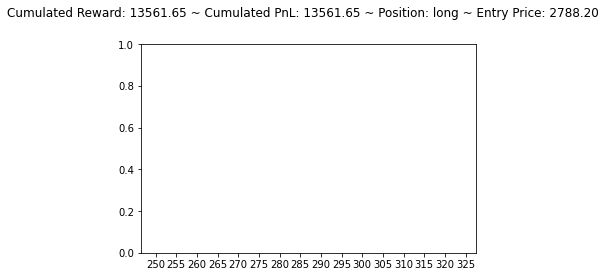

[1282.9993 1339.8613 1282.4833]
long hold long


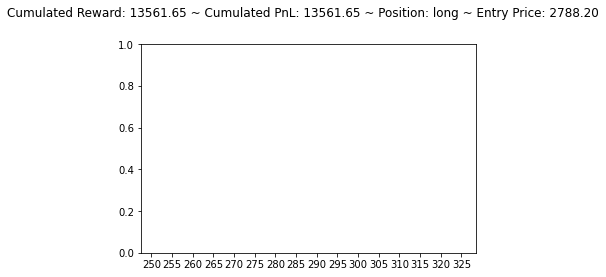

[1285.6995 1342.1741 1284.1223]
long hold long


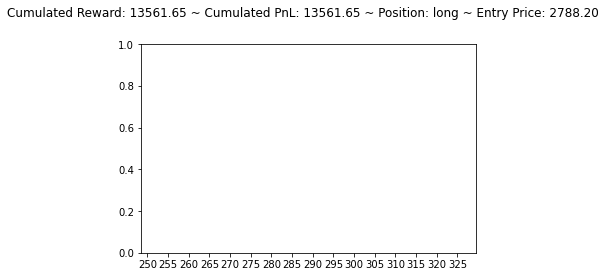

[1290.9049 1346.452  1287.022 ]
long hold long


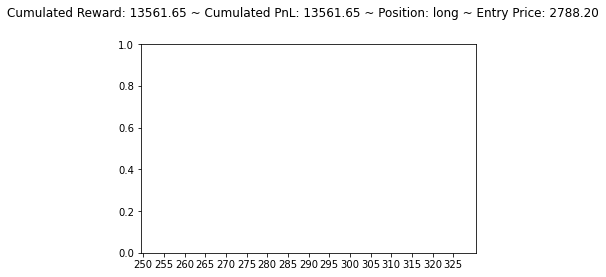

[1289.4617 1345.2312 1286.2454]
long hold long


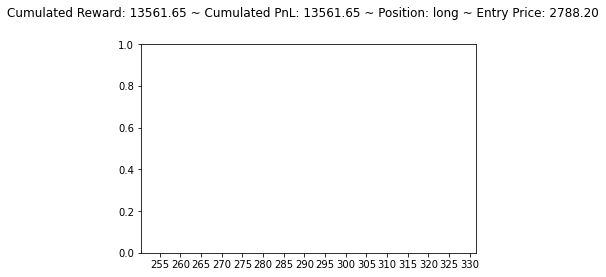

[1292.7496 1347.9541 1288.0173]
long hold long


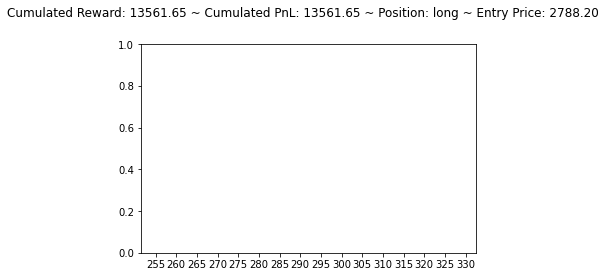

[1286.4043 1342.6265 1284.5818]
long hold long


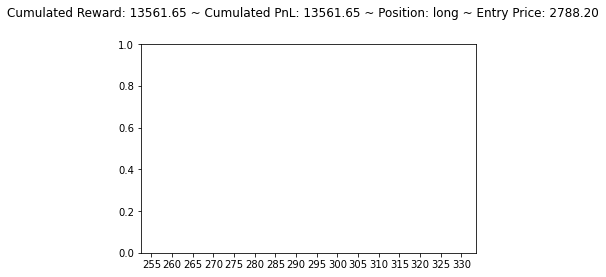

[1290.8345 1346.3442 1287.0103]
long hold long


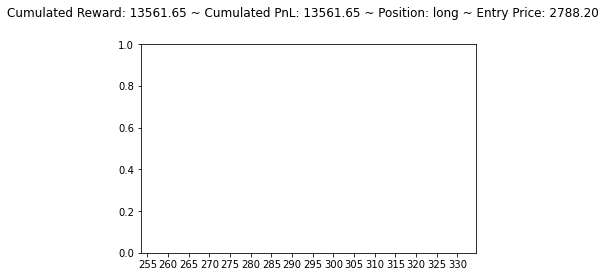

[1291.7162 1347.1538 1287.4608]
long hold long


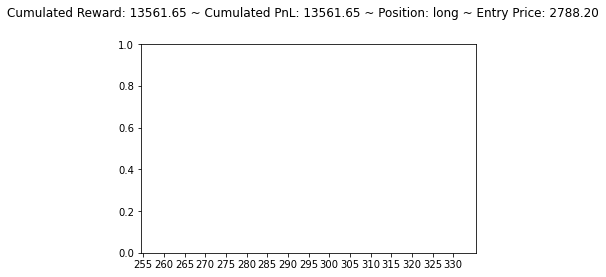

[1287.3322 1343.3656 1285.0973]
long hold long


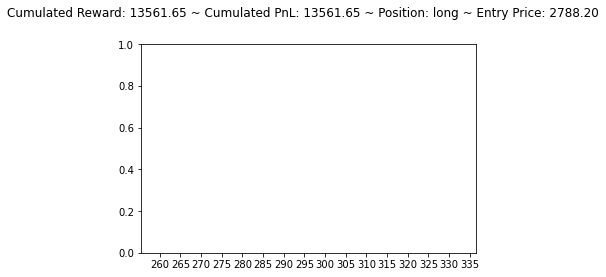

[1283.4967 1340.1621 1282.9178]
long hold long


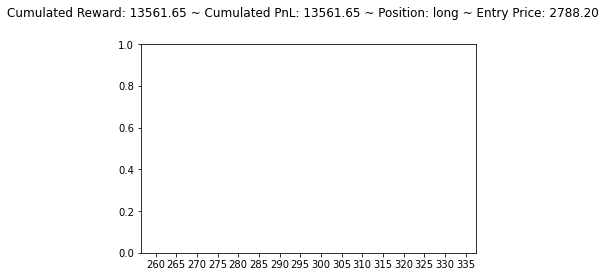

[1285.5094 1342.0112 1283.9218]
long hold long


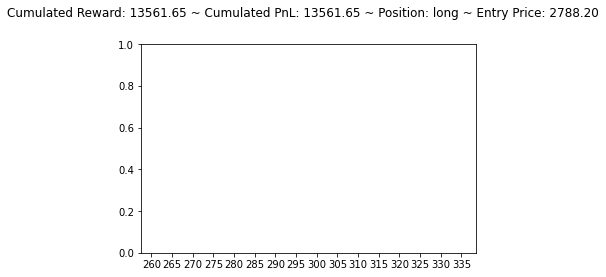

[1179.7174 1246.2839 1214.6578]
long sell flat


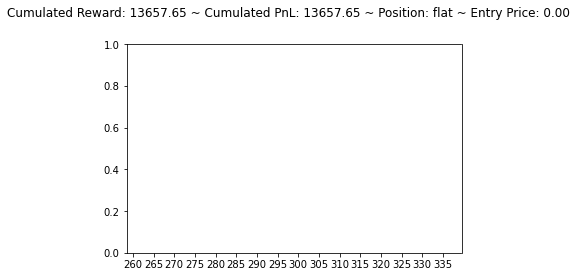

[1156.531  1199.9805 1198.5472]
flat buy long


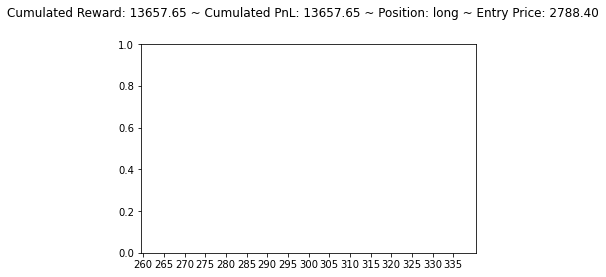

[1292.5889 1347.8275 1287.9933]
long hold long


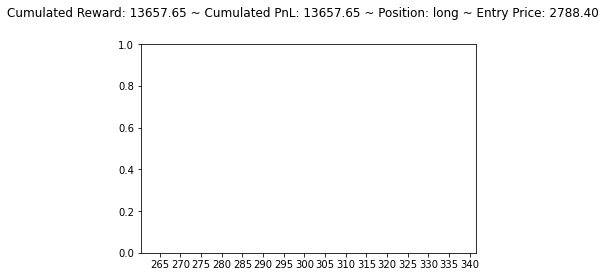

[1075.9323 1092.0168 1092.7106]
long sell flat


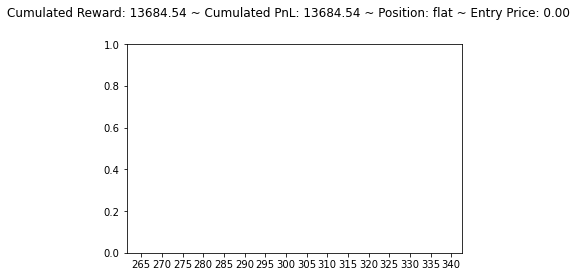

[960.75885 959.673   926.9663 ]
flat hold flat


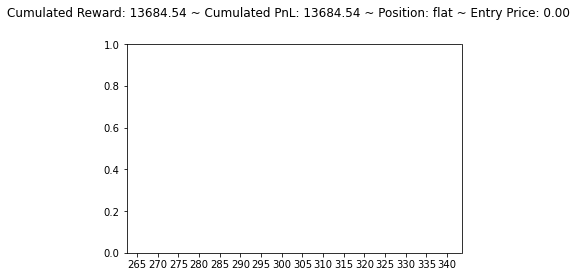

[977.3208 977.1388 939.5446]
flat hold flat


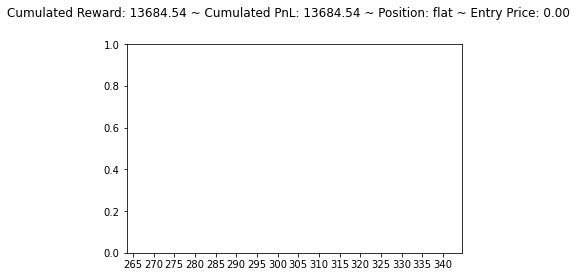

[987.7163  967.03156 944.05005]
flat hold flat


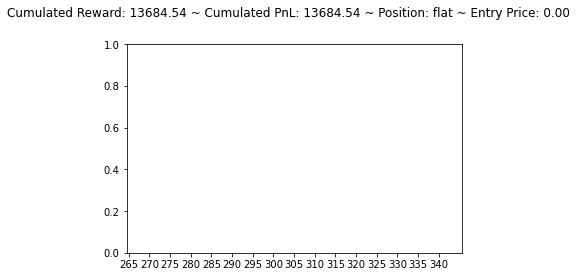

[984.512  962.8833 940.5341]
flat hold flat


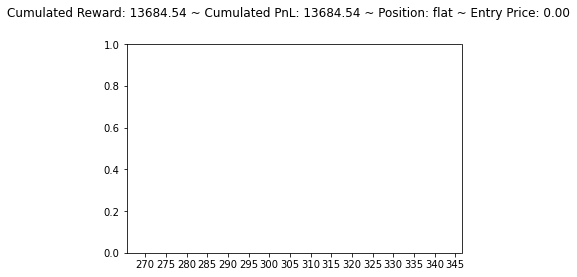

[983.25104 959.9029  937.2192 ]
flat hold flat


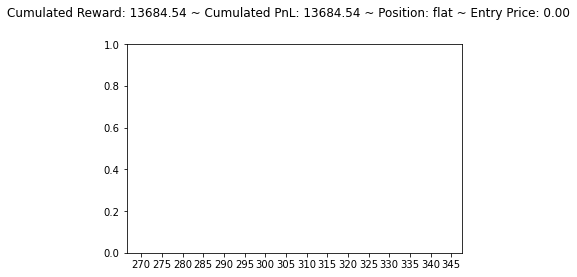

[985.00995 961.83655 939.3835 ]
flat hold flat


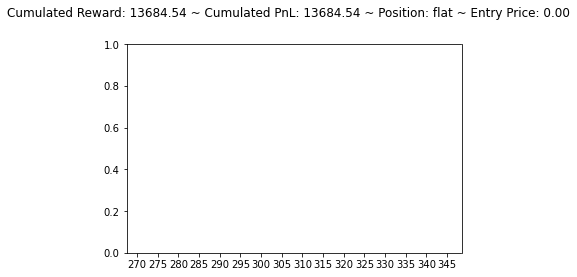

[1009.1123   997.7207   972.75385]
flat hold flat


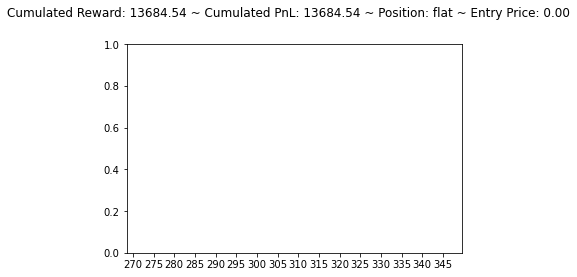

[1104.93   1137.856  1113.9885]
flat buy long


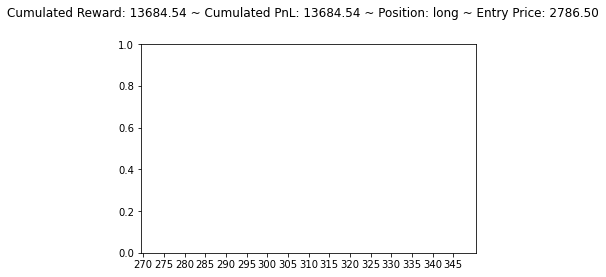

[1152.859  1191.0475 1160.221 ]
long sell flat


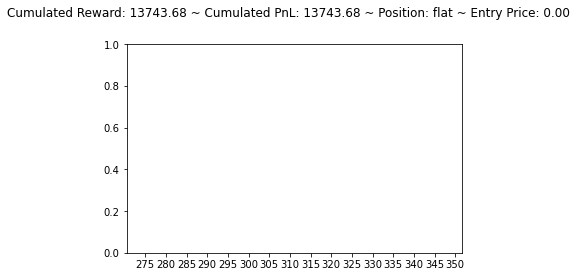

[1085.287  1105.7322 1107.9353]
flat sell short


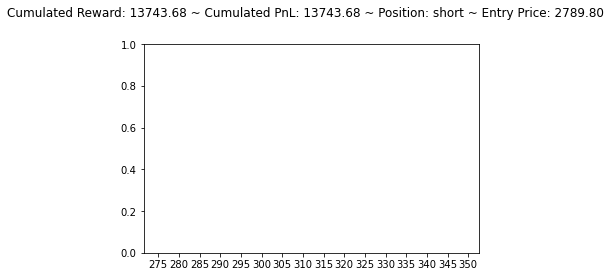

[1118.3589 1131.6776 1104.4769]
short buy flat


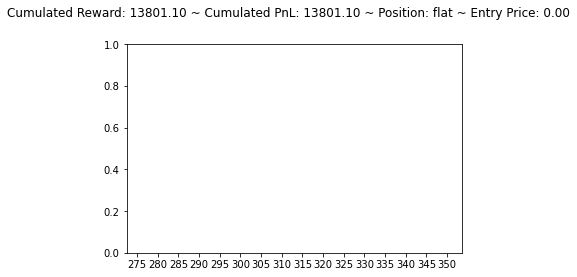

[1074.3193 1083.6008 1084.6593]
flat sell short


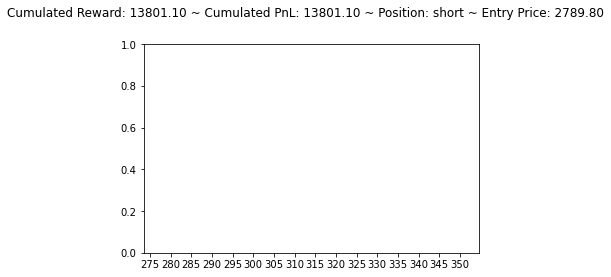

[1111.1515 1120.1274 1093.7721]
short buy flat


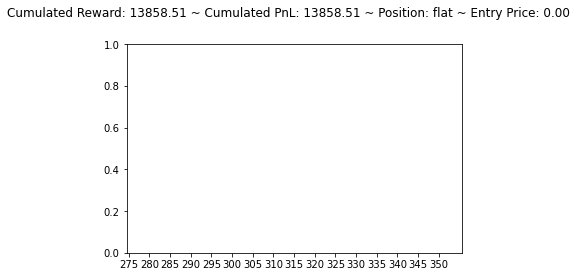

[1076.0907 1083.4656 1084.4117]
flat sell short


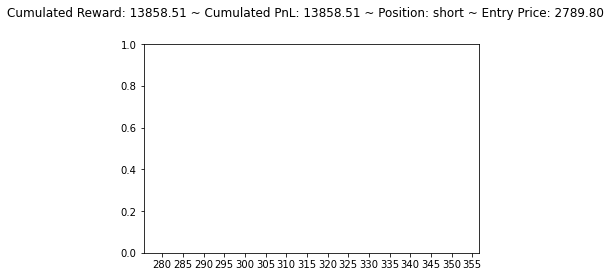

[1111.4578 1121.202  1094.5494]
short buy flat


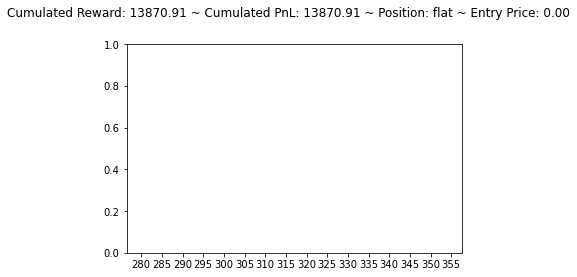

[1071.3812 1075.2671 1077.252 ]
flat sell short


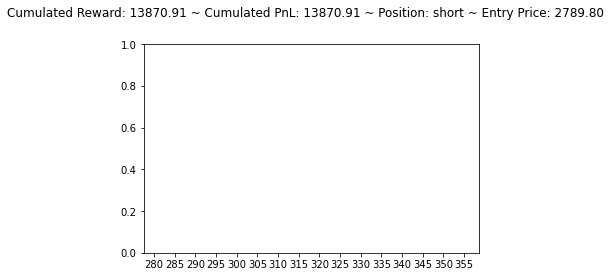

[1110.8351 1119.1381 1092.065 ]
short buy flat


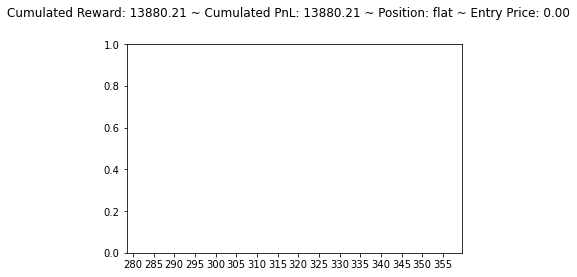

[1074.5586 1079.4761 1081.868 ]
flat sell short


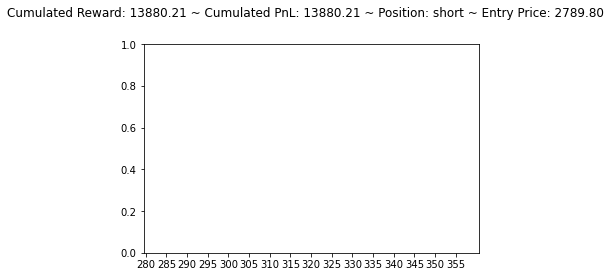

[1124.6534 1140.1194 1110.4745]
short buy flat


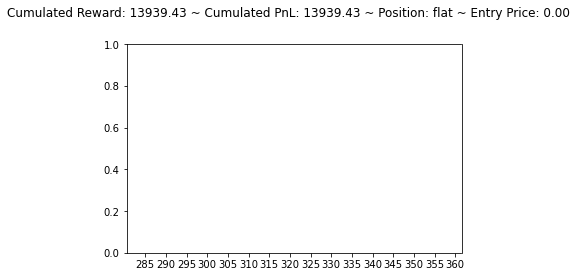

[1084.2811 1097.8915 1100.64  ]
flat sell short


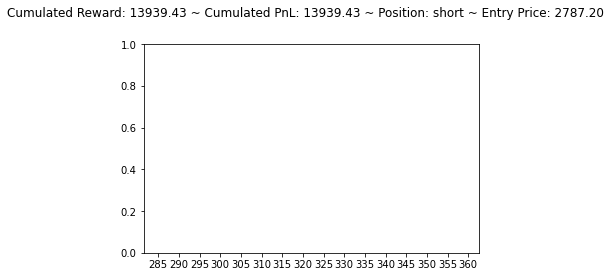

[1117.7179 1132.9032 1105.8491]
short buy flat


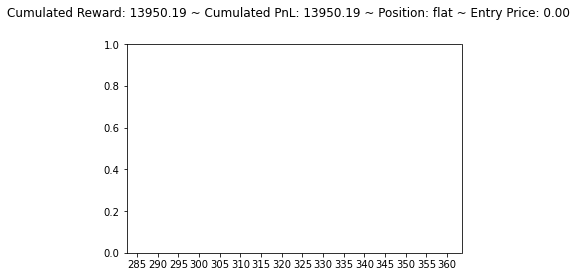

[1074.4899 1081.4565 1082.808 ]
flat sell short


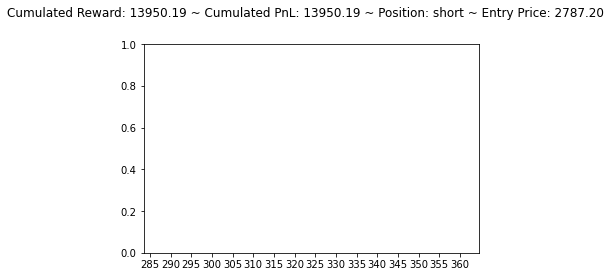

[1040.286  1014.8235 1006.1243]
short hold short


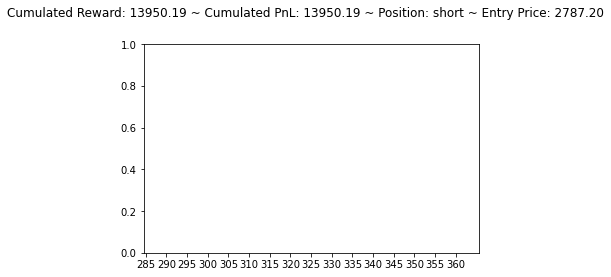

[1104.9747 1103.1108 1077.5469]
short hold short


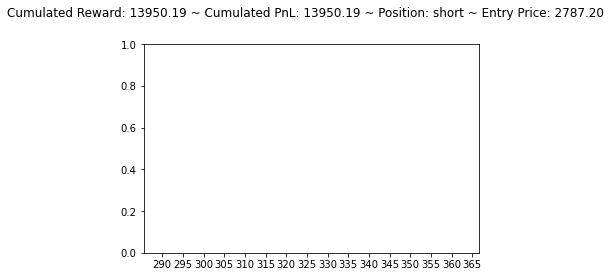

[1111.9225 1121.218  1094.5918]
short buy flat


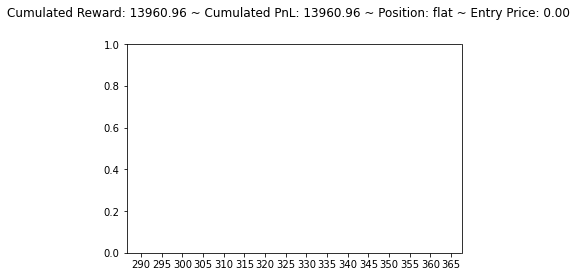

[1072.1593 1077.5427 1079.2317]
flat sell short


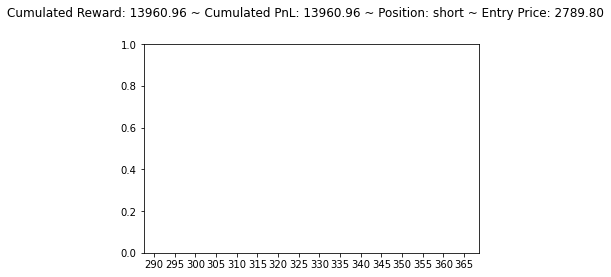

[1012.55334  972.3693   970.2945 ]
short hold short


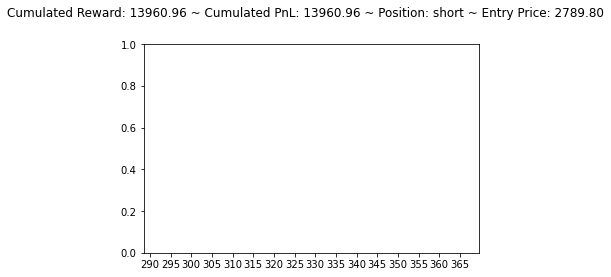

[997.0327  977.4946  971.97266]
short hold short


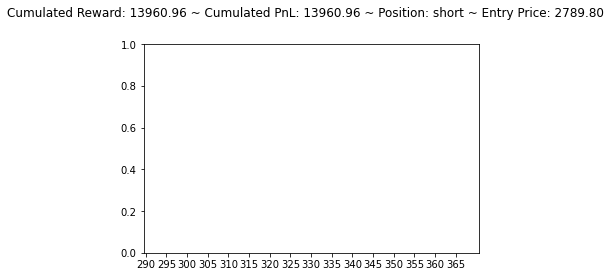

[1000.21344  979.9415   974.381  ]
short hold short


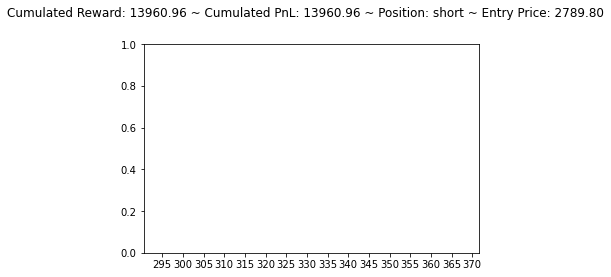

[1002.40594  981.01825  975.7881 ]
short hold short


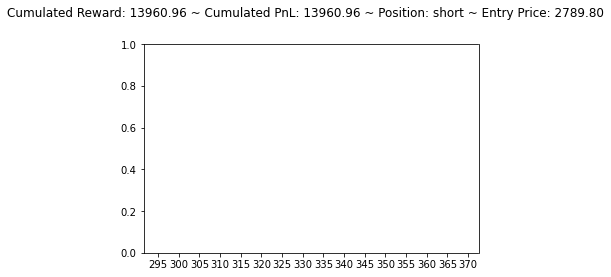

[1001.7213  979.3629  974.631 ]
short hold short


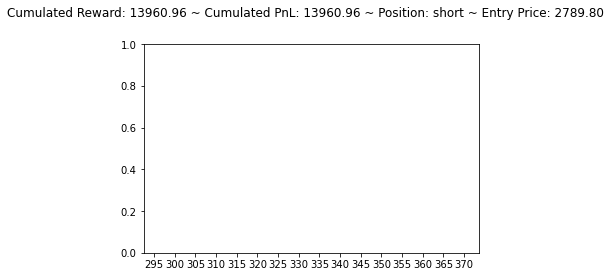

[1001.8191   979.44965  974.6546 ]
short hold short


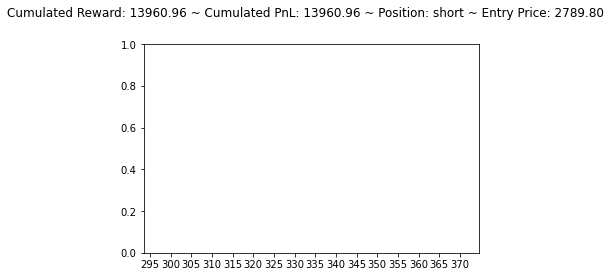

[1003.29816  980.3466   975.6579 ]
short hold short


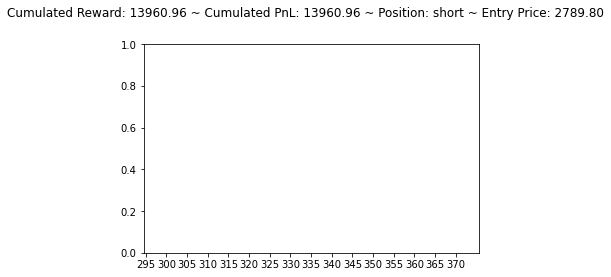

[1009.4481  984.6763  980.0207]
short hold short


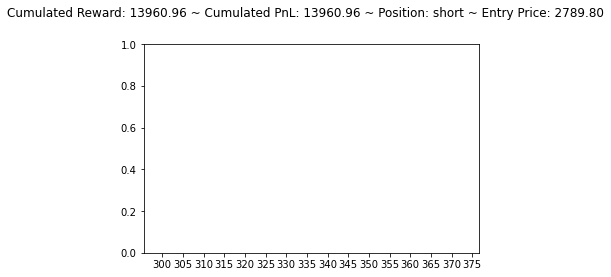

[1012.0121   984.79675  981.30505]
short hold short


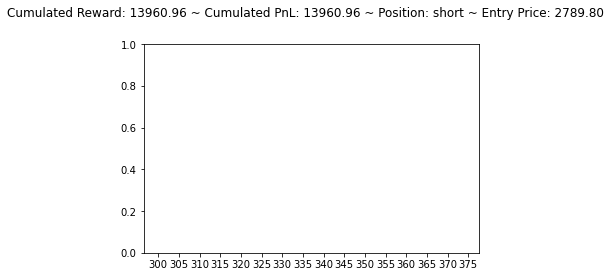

[1119.2235 1122.481  1092.7385]
short buy flat


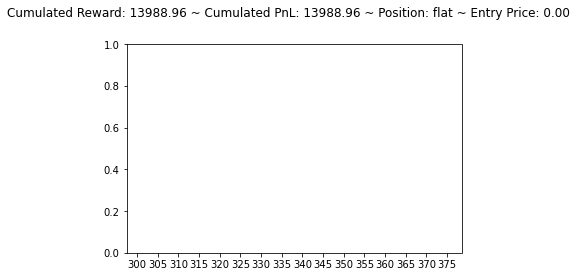

[1000.9437   979.68536  986.3471 ]
flat hold flat


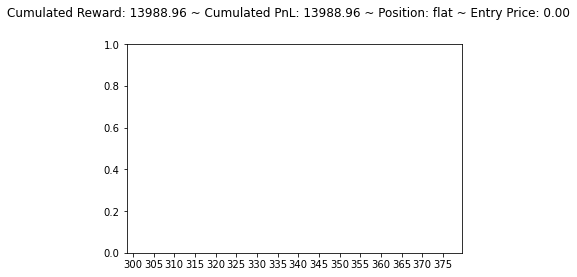

[1000.171   981.7683  963.5209]
flat hold flat


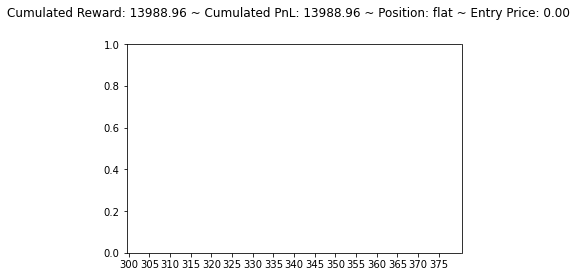

[1001.8122   983.94006  966.1318 ]
flat hold flat


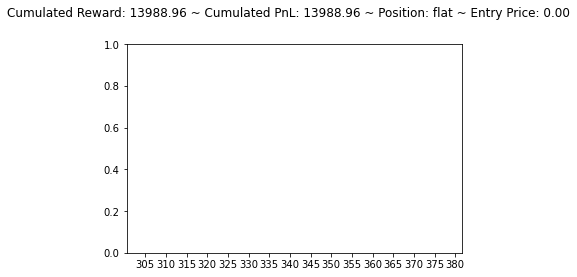

[1004.2457  987.4766  969.8413]
flat hold flat


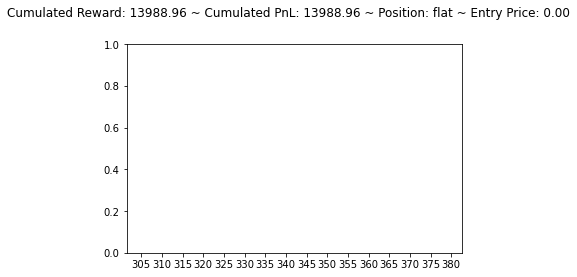

[1007.069    992.30585  974.8516 ]
flat hold flat


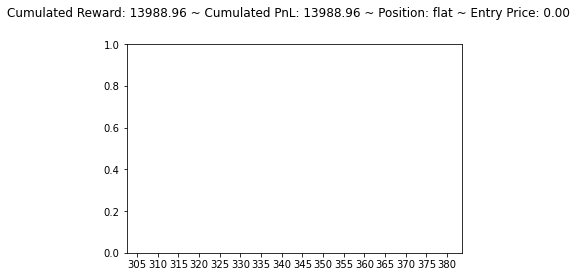

[1015.3772  1004.51404  986.5285 ]
flat hold flat


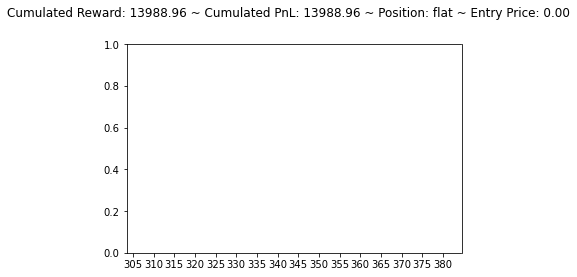

[1021.2069  1015.87415  998.55707]
flat hold flat


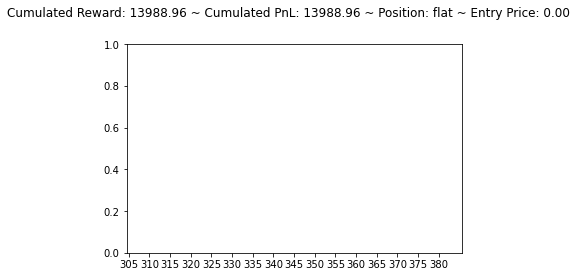

[1022.8477  1018.0458  1001.16785]
flat hold flat


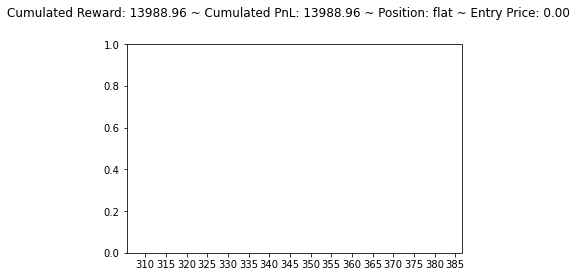

[1024.4889  1020.21765 1003.7788 ]
flat hold flat


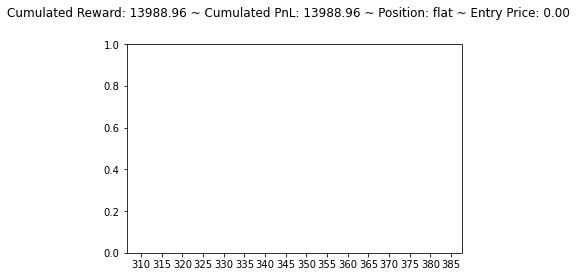

[1026.1302  1022.38965 1006.3899 ]
flat hold flat


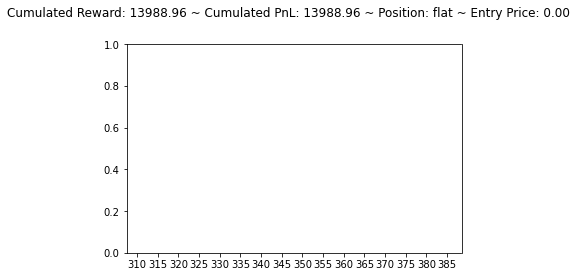

[1027.369  1024.1586 1008.4759]
flat hold flat


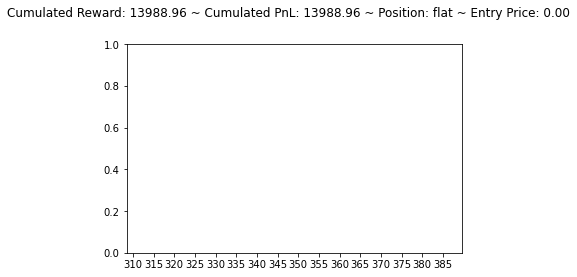

[1029.579  1027.6583 1012.0552]
flat hold flat


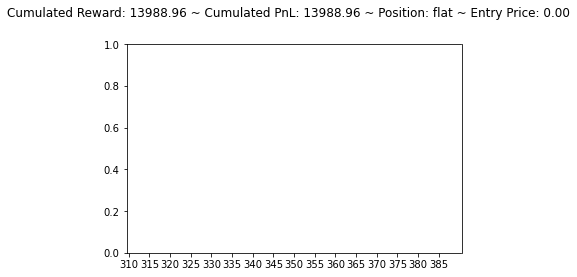

[1030.2618 1028.528  1013.3773]
flat hold flat


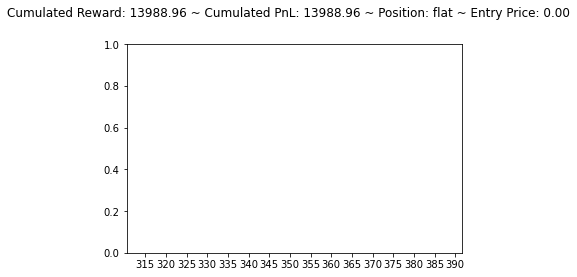

[1031.877  1030.6989 1015.7107]
flat hold flat


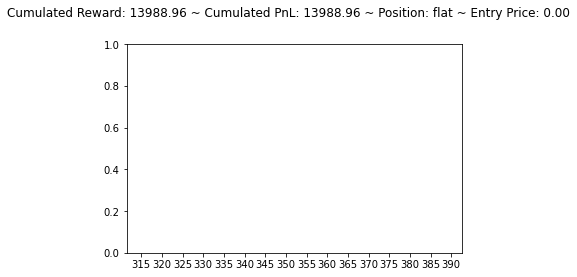

[1052.1139 1060.5712 1043.6082]
flat buy long


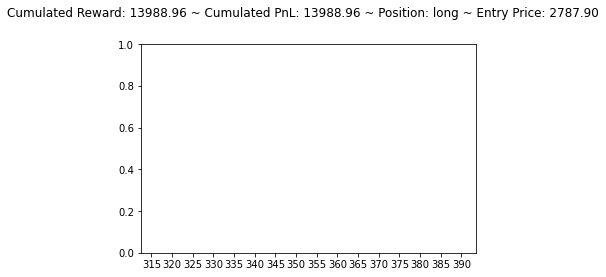

[1104.6862 1114.6023 1097.4114]
long hold long


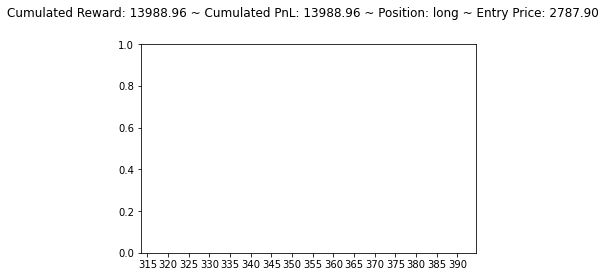

[1108.1912 1120.6846 1103.0227]
long hold long


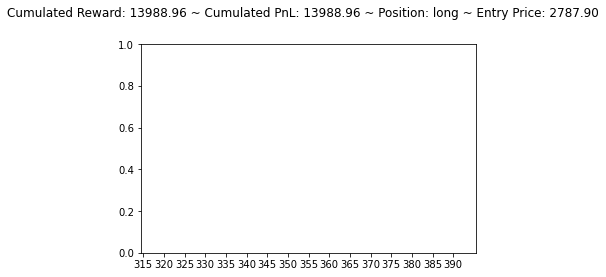

[1111.9713 1126.5303 1107.935 ]
long hold long


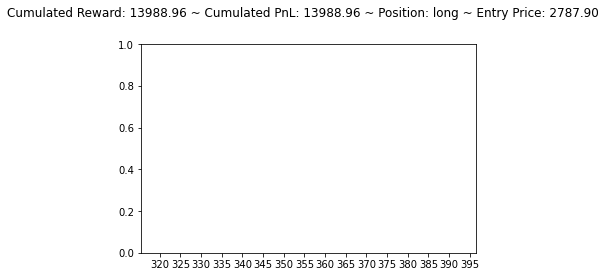

[1114.1014 1130.1156 1111.0228]
long hold long


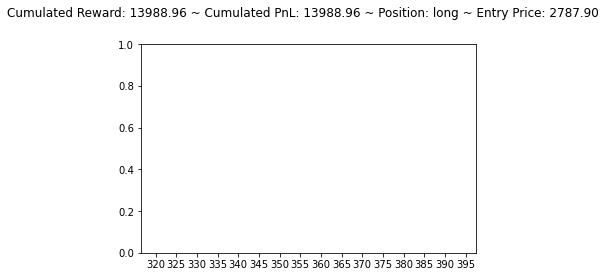

[1132.5425 1157.8492 1134.1268]
long sell flat


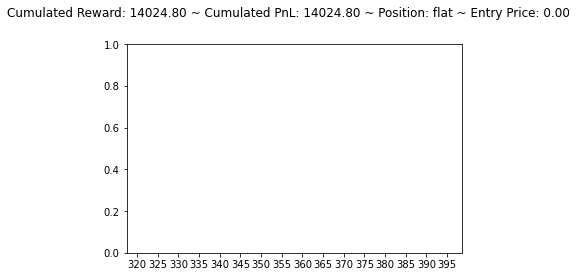

[1088.034  1118.0889 1109.0938]
flat buy long


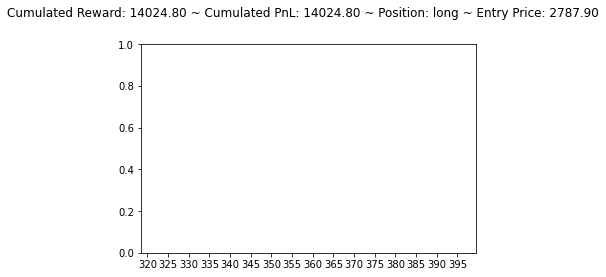

[1135.4674 1163.8474 1139.27  ]
long sell flat


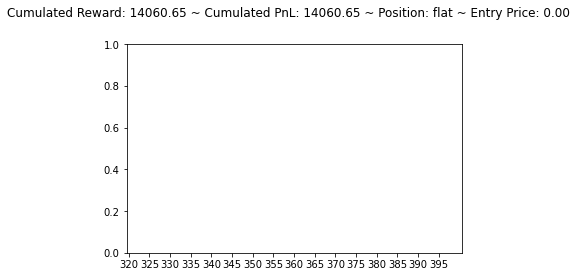

[1132.872  1178.3995 1169.6007]
flat buy long


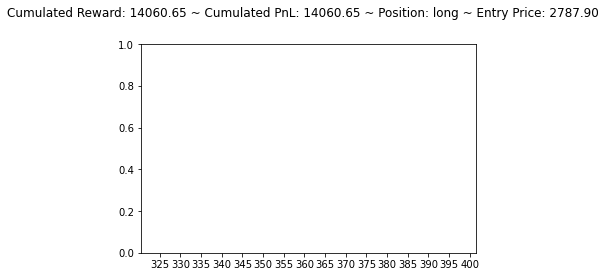

[1186.7731 1246.2002 1209.173 ]
long sell flat


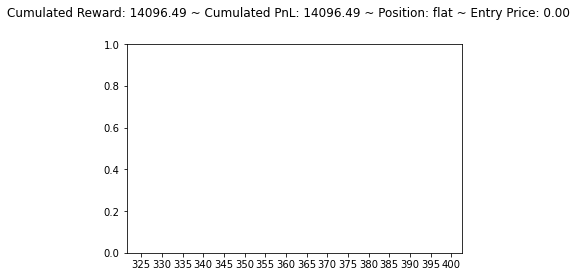

[1134.3624 1178.4421 1181.8254]
flat sell short


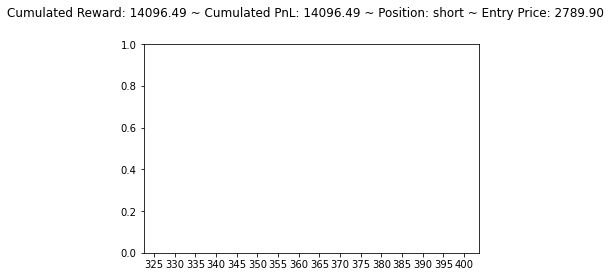

[1190.4307 1250.9509 1212.9517]
short buy flat


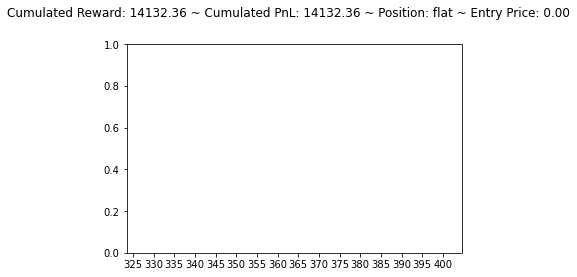

[1137.6448 1182.786  1187.0475]
flat sell short


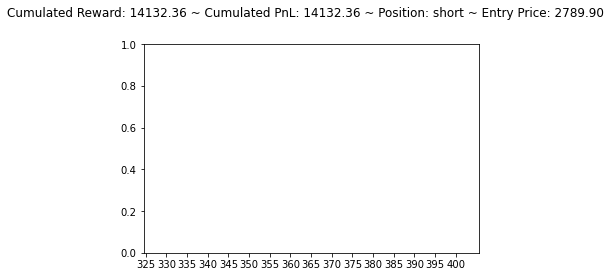

[1154.1353 1197.1079 1168.2891]
short buy flat


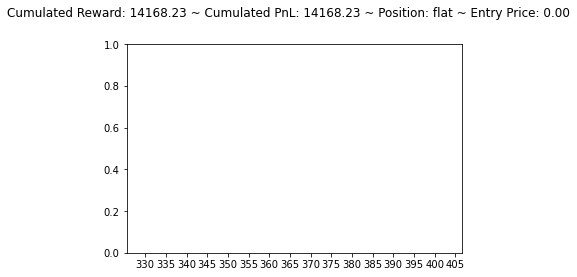

[1104.458  1138.7944 1134.2098]
flat buy long


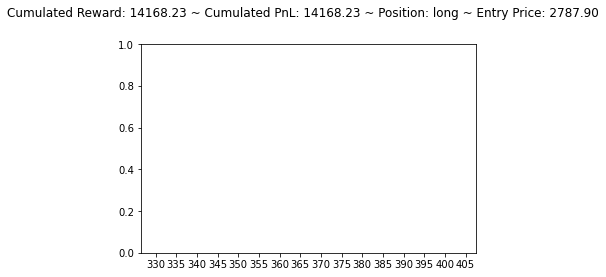

[1154.0533 1193.4602 1164.2882]
long sell flat


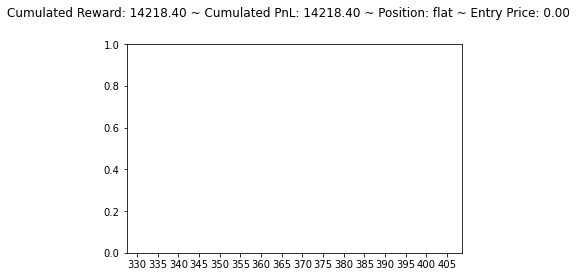

[1107.7406 1143.1383 1139.4319]
flat buy long


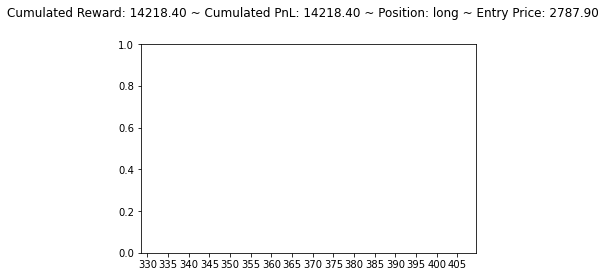

[1116.6571 1138.334  1115.622 ]
long hold long


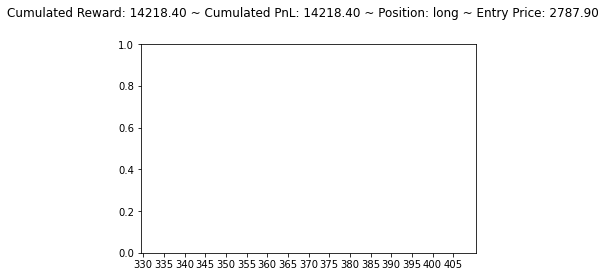

[1135.4727 1154.6707 1124.6432]
long hold long


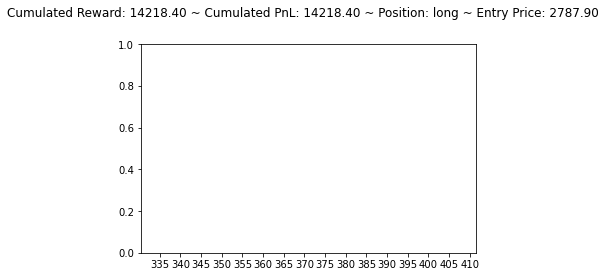

[1167.5975 1214.3287 1181.8052]
long sell flat


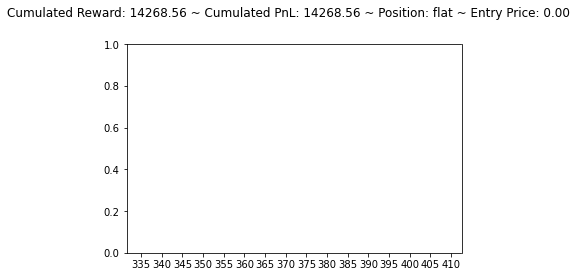

[1085.838  1109.0706 1112.4279]
flat sell short


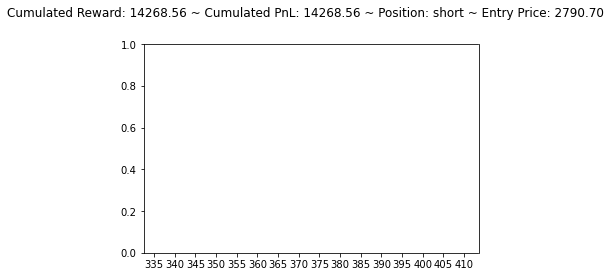

[1115.793  1126.2809 1098.402 ]
short buy flat


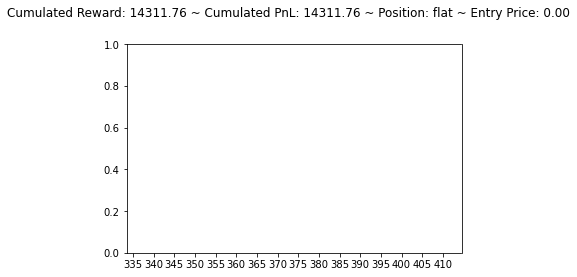

[1085.2252 1094.6003 1097.3046]
flat sell short


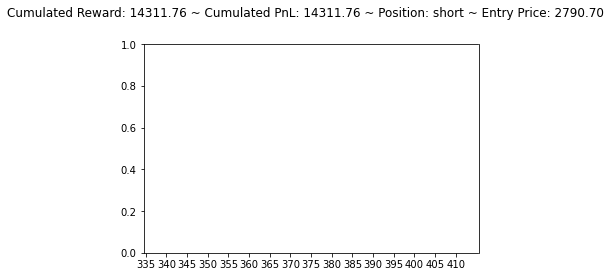

[1129.6698 1148.9819 1117.7988]
short buy flat


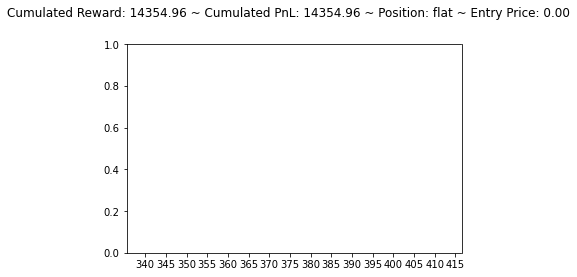

[1093.02   1105.3142 1110.5916]
flat sell short


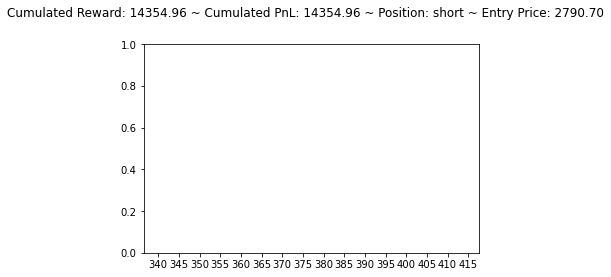

[1297.1691 1356.8208 1291.2299]
short buy flat


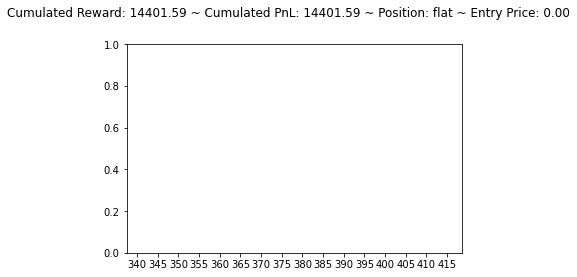

[1164.5618 1220.2029 1228.7146]
flat sell short


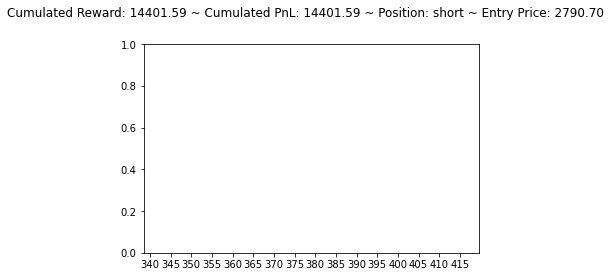

[1230.8007 1299.4265 1250.4318]
short buy flat


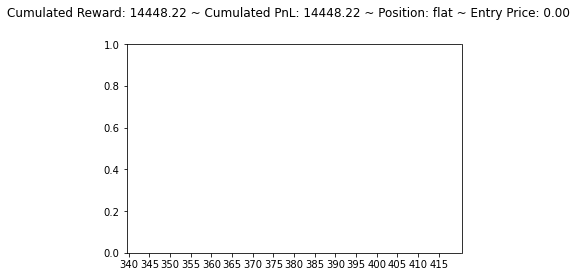

[1229.8798 1281.7554 1247.0635]
flat buy long


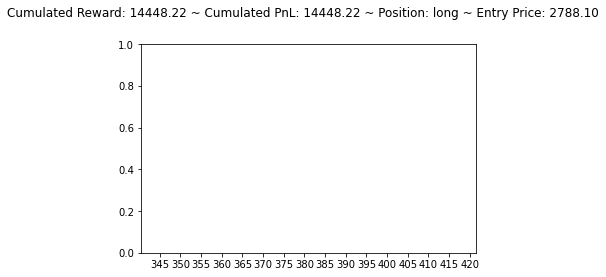

[1326.3748 1375.6498 1308.1622]
long hold long


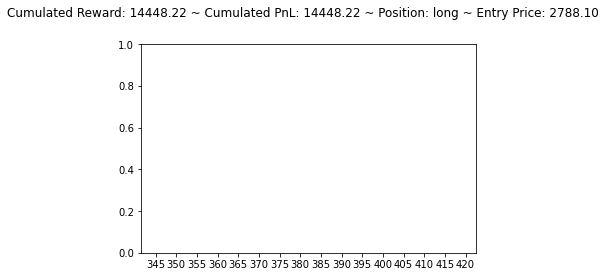

[1338.8872 1386.161  1315.3817]
long hold long


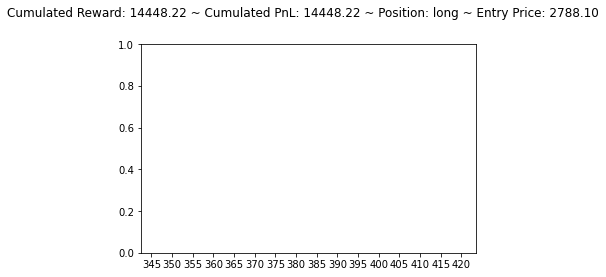

[1189.3876 1259.1089 1227.2374]
long sell flat


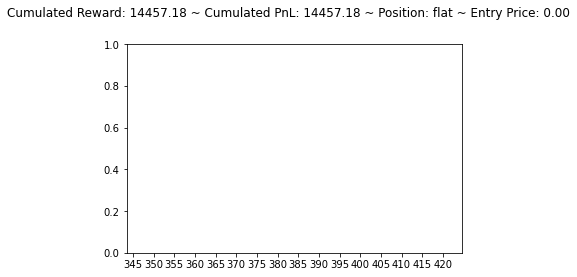

[1146.9948 1186.8315 1182.8687]
flat buy long


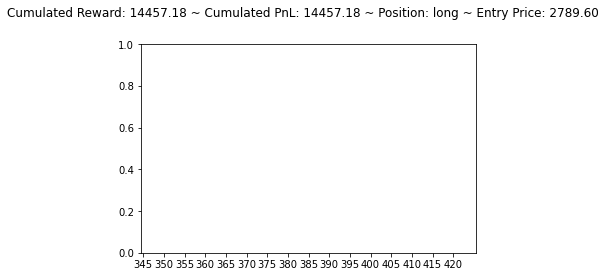

[1248.8481 1311.9006 1262.6532]
long sell flat


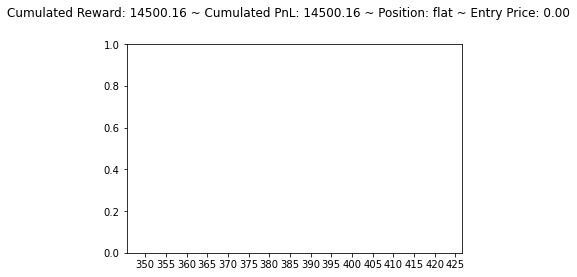

[1126.3446 1175.4237 1181.8191]
flat sell short


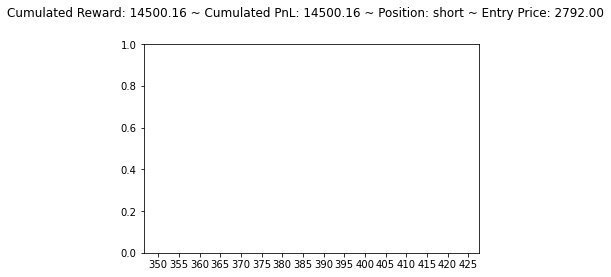

[1153.4204 1187.8308 1158.3999]
short buy flat


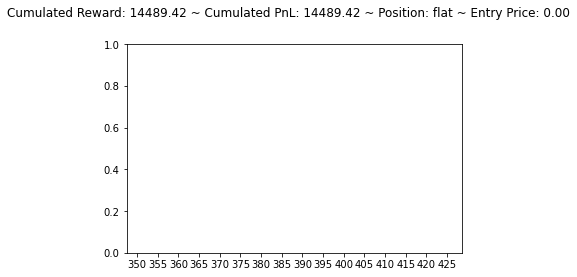

[1115.0397 1158.4908 1154.2197]
flat buy long


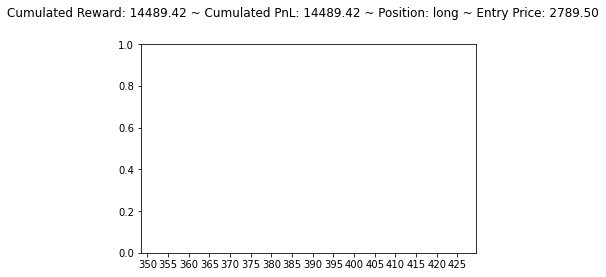

[1126.0645 1146.8438 1120.302 ]
long hold long


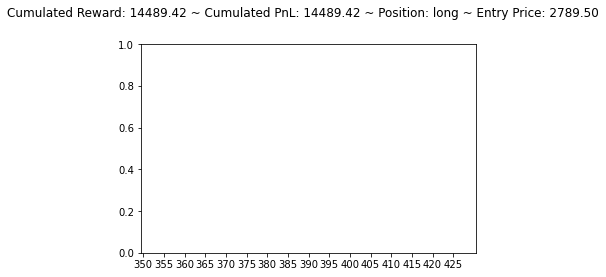

[1133.4762 1153.5801 1123.3362]
long hold long


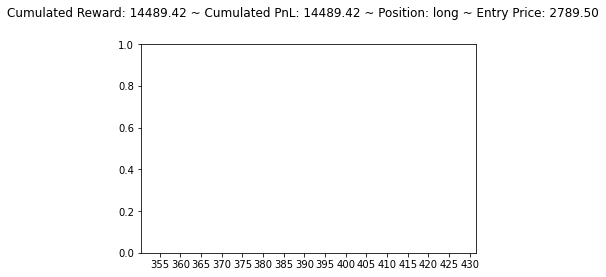

[1132.1614 1156.6338 1128.7028]
long hold long


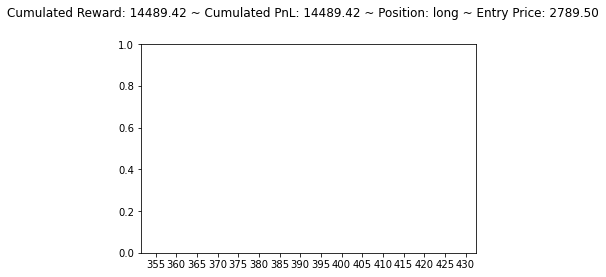

[1178.1785 1221.4576 1184.292 ]
long sell flat


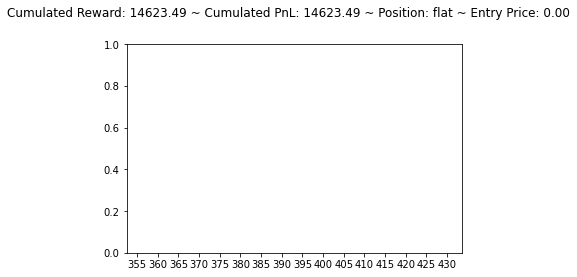

[1167.9551 1235.1401 1233.415 ]
flat buy long


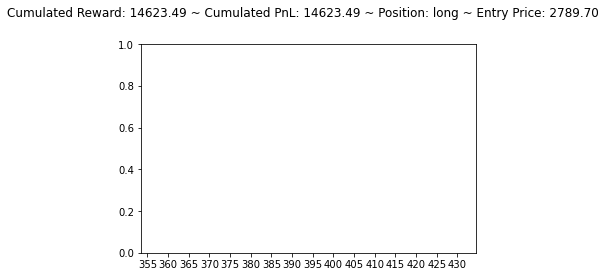

[1168.2125 1228.7045 1200.5166]
long sell flat


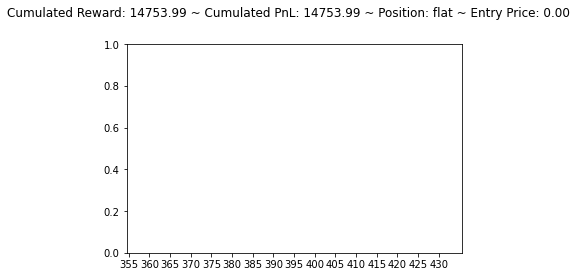

[1094.3073 1110.7825 1111.5518]
flat sell short


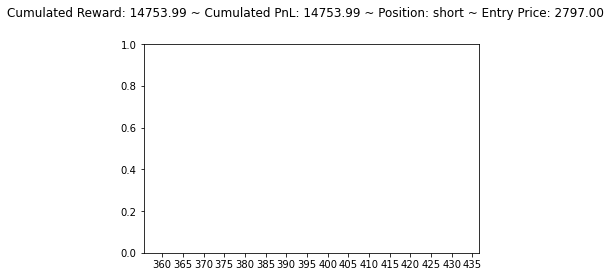

[1207.874  1268.5015 1227.0283]
short buy flat


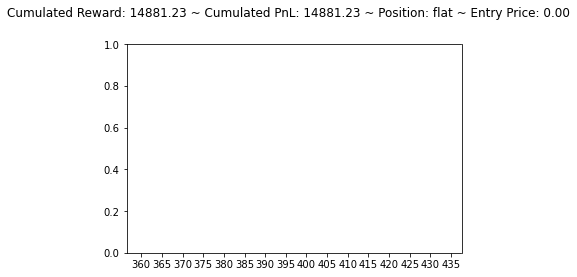

[1115.4406 1163.7678 1171.0043]
flat sell short


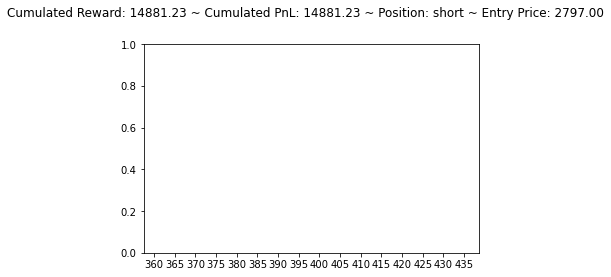

[1137.558  1160.3093 1129.9741]
short buy flat


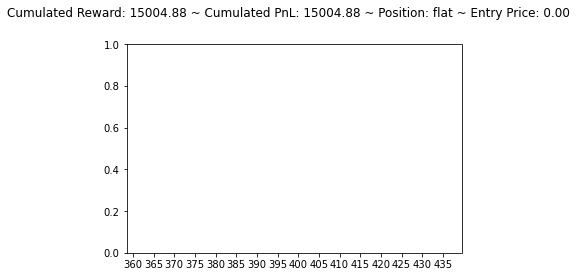

[1150.8837 1198.023  1193.42  ]
flat buy long


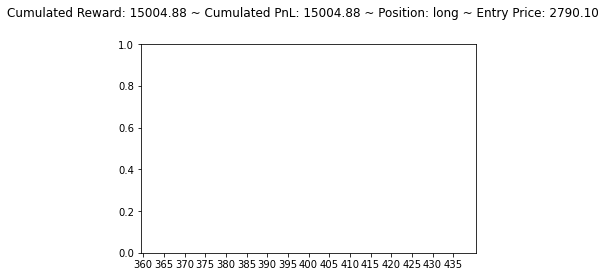

[1167.4224 1227.5012 1199.4348]
long sell flat


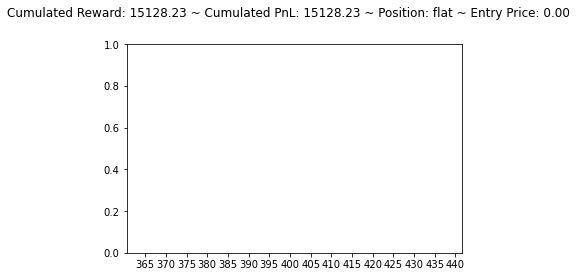

[1145.4098 1186.0958 1180.5723]
flat buy long


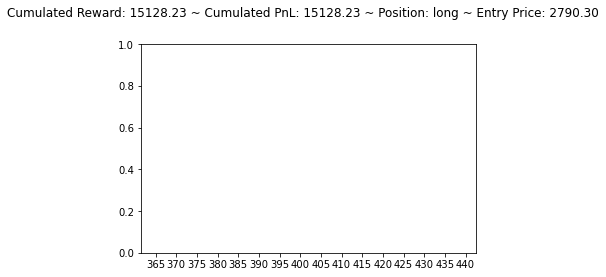

[1180.6329 1247.1221 1216.7152]
long sell flat


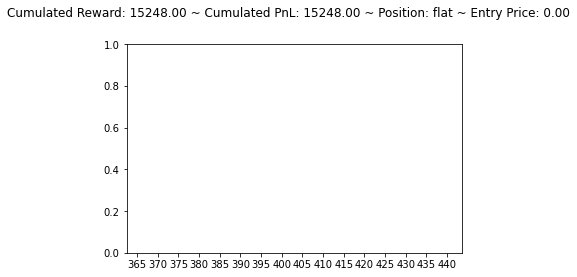

[1088.4581 1105.648  1108.5691]
flat sell short


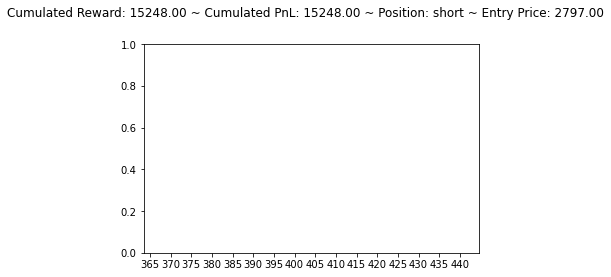

[1200.0831 1252.8556 1211.4475]
short buy flat


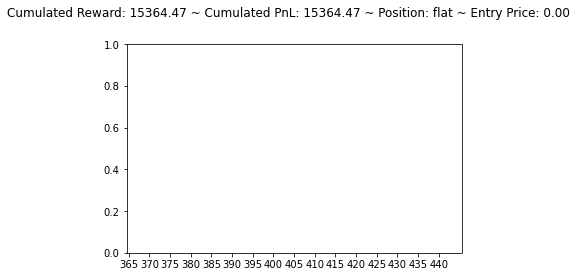

[1114.6216 1162.5166 1169.818 ]
flat sell short


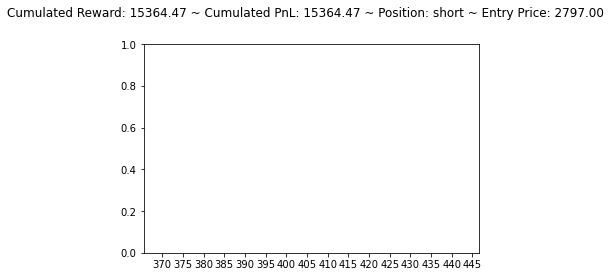

[1177.9779 1219.9287 1182.3788]
short buy flat


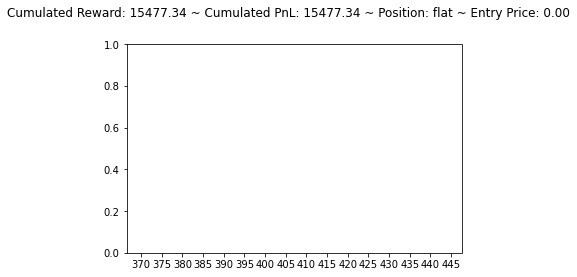

[1168.1832 1235.4115 1233.6024]
flat buy long


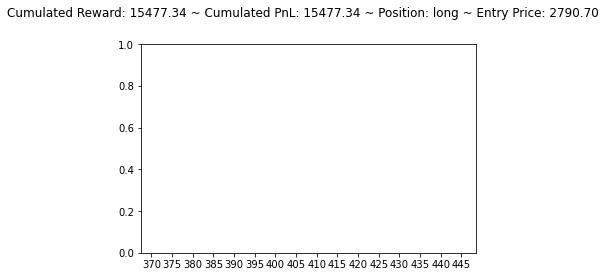

[1166.3835 1225.9136 1198.0039]
long sell flat


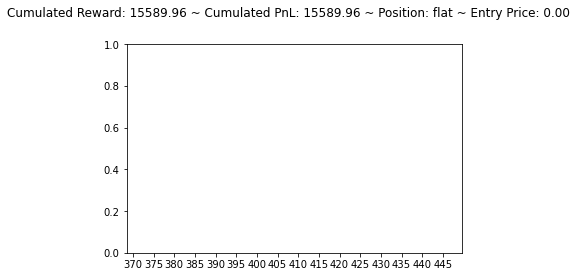

[1093.6774 1109.1926 1109.7355]
flat sell short


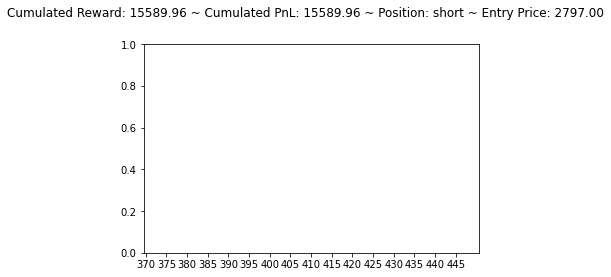

[1208.0302 1268.6445 1227.149 ]
short buy flat


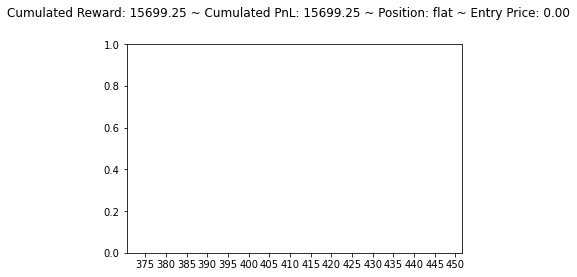

[1113.9958 1161.5648 1168.919 ]
flat sell short


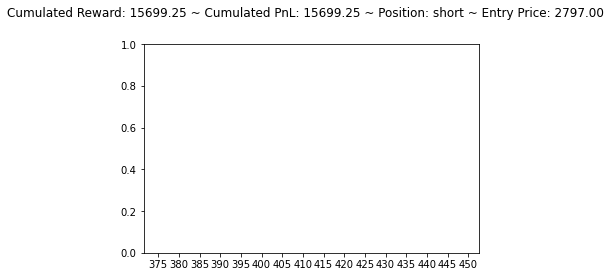

[1115.9698 1127.6434 1100.8698]
short buy flat


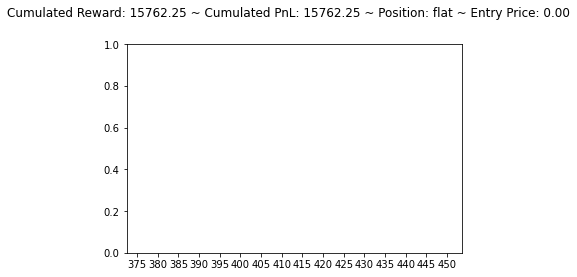

[1142.5187 1179.6165 1173.5496]
flat buy long


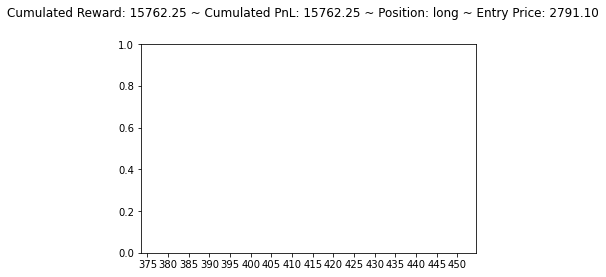

[1165.5936 1224.7101 1196.9224]
long sell flat


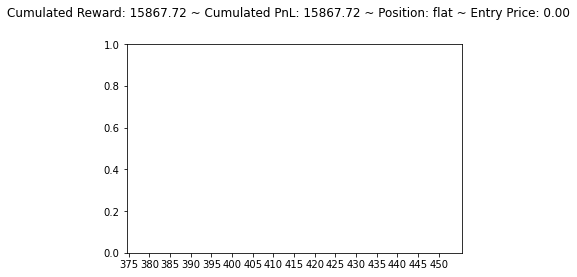

[1080.8353 1089.9336 1091.8934]
flat sell short


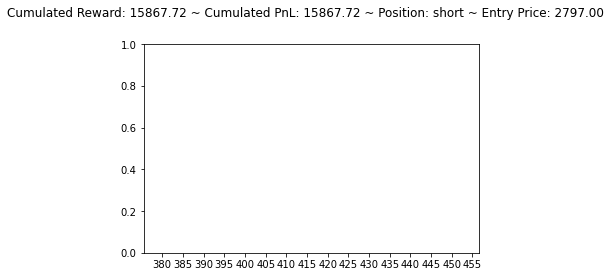

[1123.7576 1138.9558 1110.7874]
short buy flat


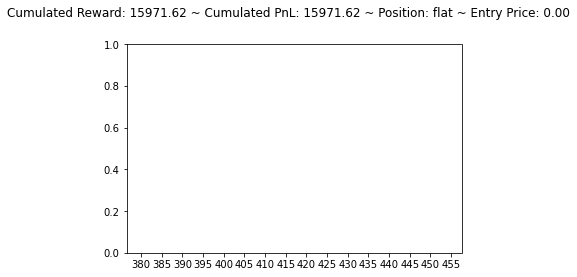

[1128.0215 1160.5195 1157.1249]
flat buy long


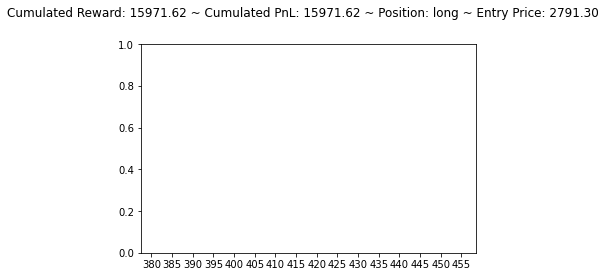

[1245.913  1310.2312 1262.6785]
long sell flat


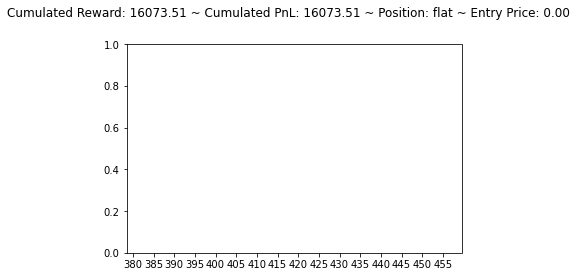

[1113.2505 1160.436  1167.8573]
flat sell short


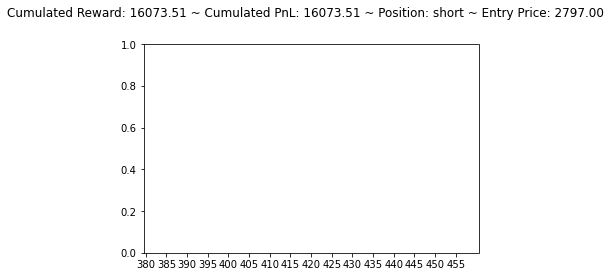

[1123.0953 1137.8248 1109.7314]
short buy flat


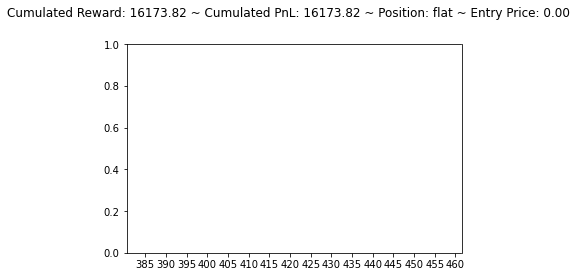

[1127.8834 1160.1748 1156.733 ]
flat buy long


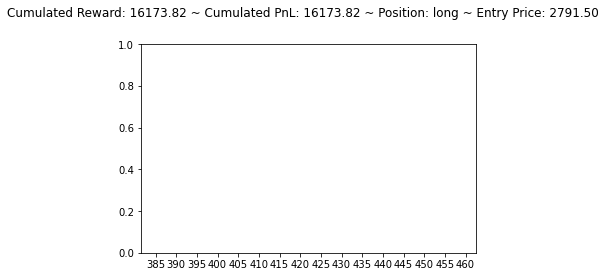

[1245.945  1310.2863 1262.7219]
long sell flat


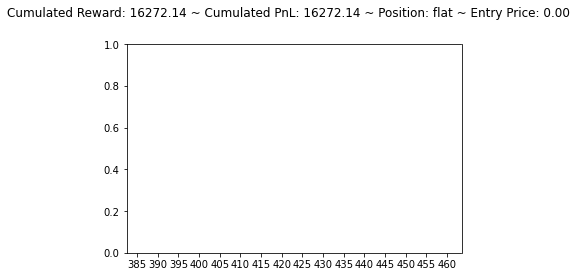

[1113.0575 1160.1368 1167.5701]
flat sell short


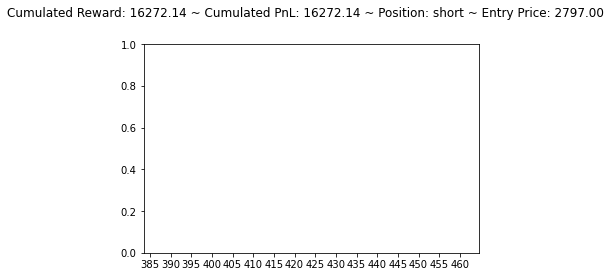

[1136.4822 1157.6885 1125.9281]
short buy flat


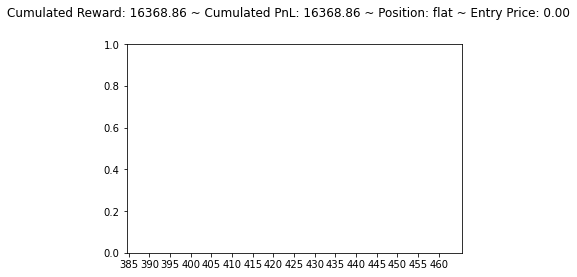

[1089.9801 1101.4005 1107.5247]
flat sell short


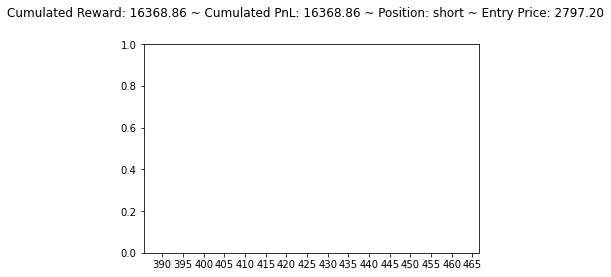

[1127.9507 1145.122  1115.9126]
short buy flat


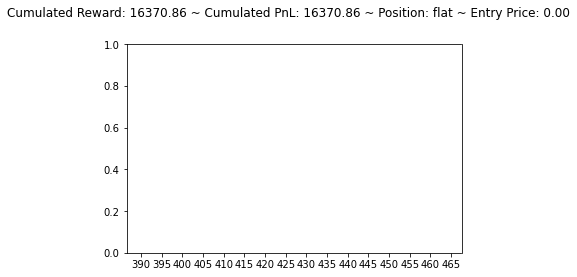

[1148.4507 1185.6144 1182.8228]
flat buy long


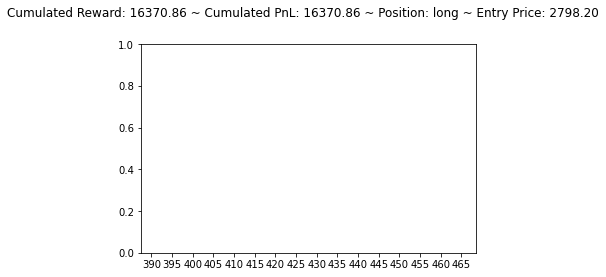

[1183.5778 1248.4268 1216.425 ]
long sell flat


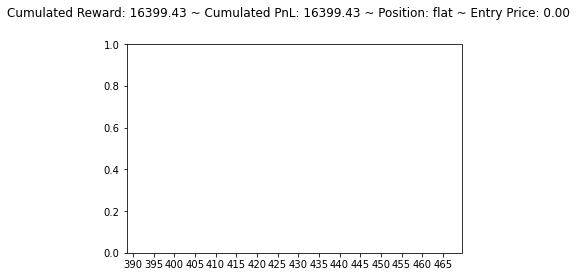

[1086.1287 1104.9429 1107.8987]
flat sell short


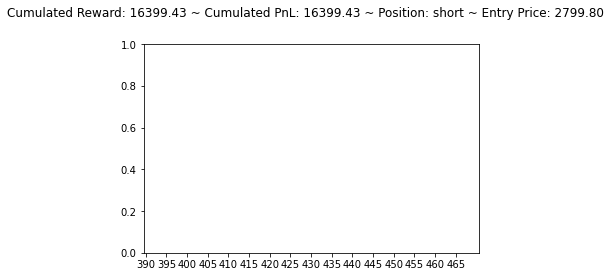

[1147.8646 1172.1072 1139.1096]
short buy flat


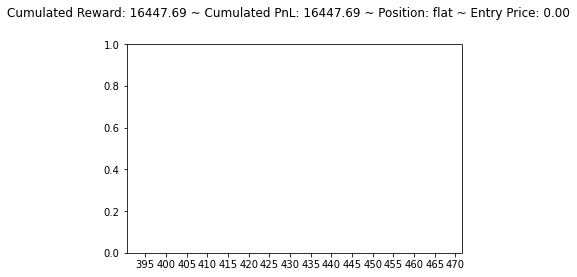

[566.2694 857.5255 609.0373]
flat buy long


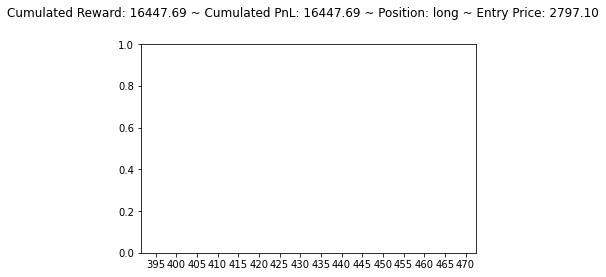

[1122.1754 1227.1755 1129.8059]
long sell flat


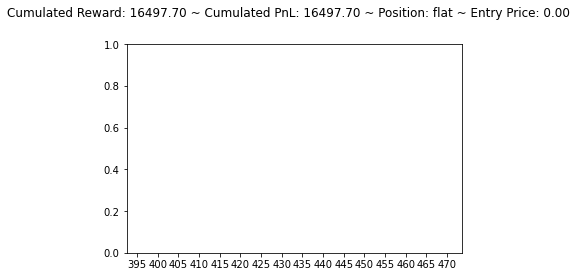

[1116.1866 1148.1711 1150.0974]
flat sell short


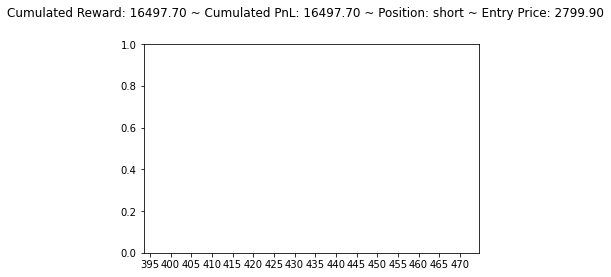

short hold short


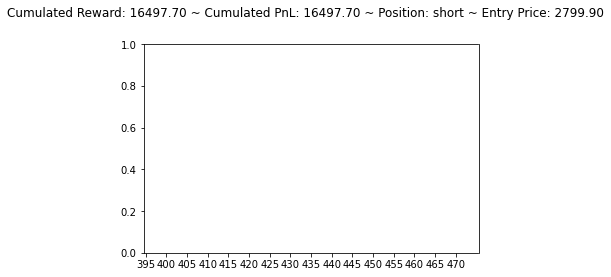

[1265.4465 1330.5284 1274.6117]
short buy flat


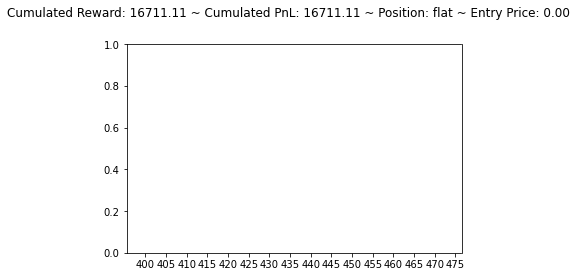

[1160.6066 1222.443  1229.151 ]
flat sell short


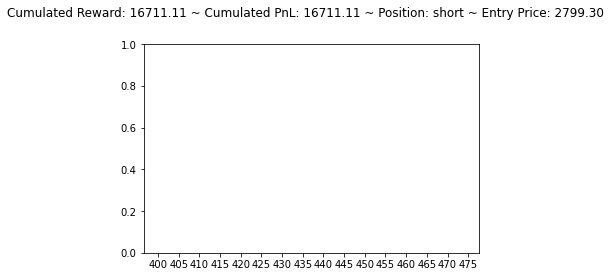

[1142.849  1175.5767 1147.8878]
short buy flat


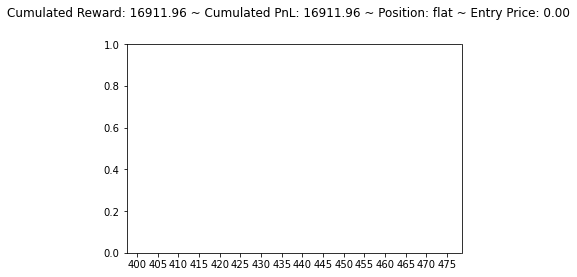

[1083.5837 1103.36   1102.1797]
flat buy long


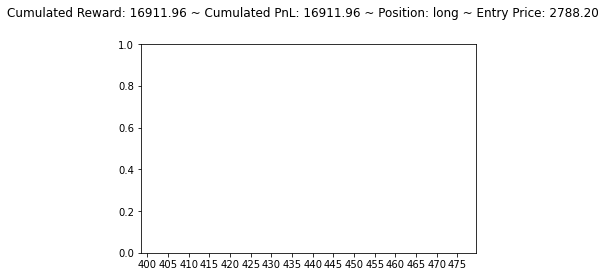

[1131.4459 1151.9408 1125.2189]
long hold long


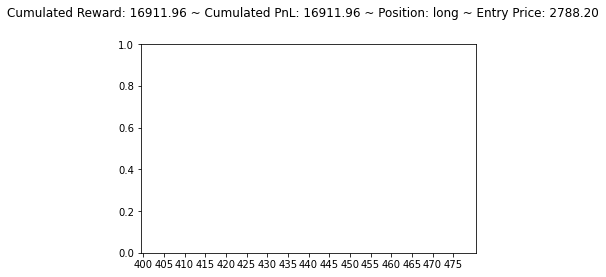

[1125.2854 1146.7974 1122.4755]
long hold long


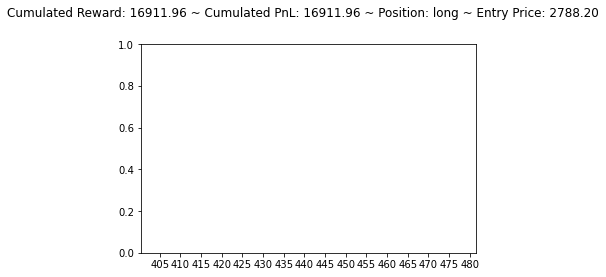

[1131.2225 1151.4623 1124.7379]
long hold long


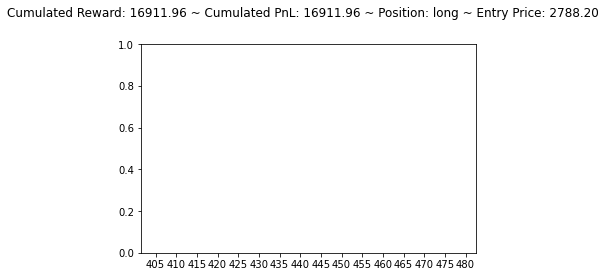

[1124.8771 1146.1736 1121.9244]
long hold long


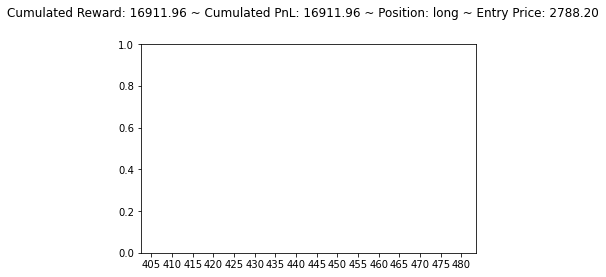

[1130.9996 1150.9838 1124.2573]
long hold long


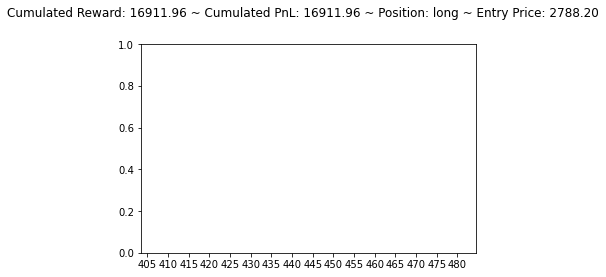

[1124.6155 1145.7672 1121.5653]
long hold long


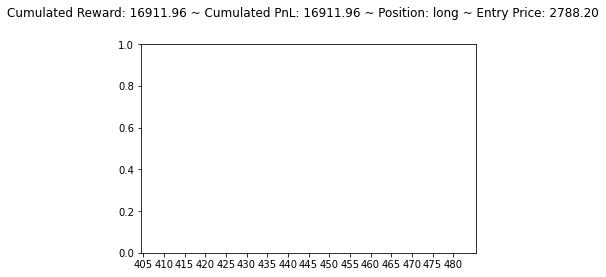

[1130.8612 1150.6746 1123.945 ]
long hold long


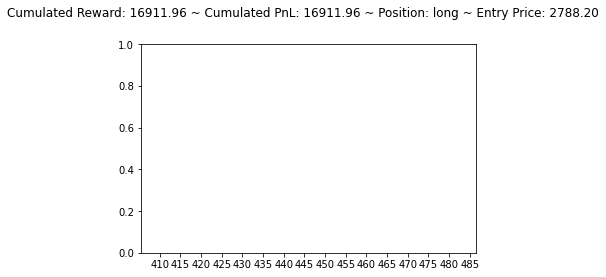

[1149.9678 1183.4147 1154.7474]
long sell flat


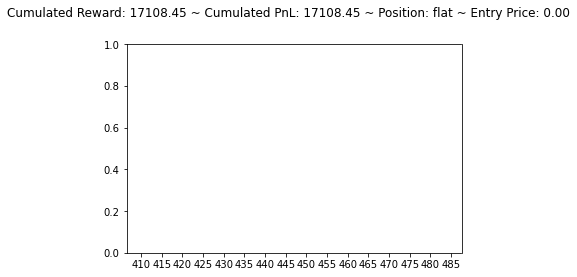

[1086.8651 1111.2051 1110.8474]
flat buy long


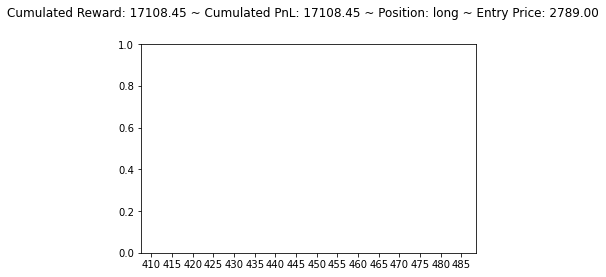

[1130.6906 1150.2842 1123.5046]
long hold long


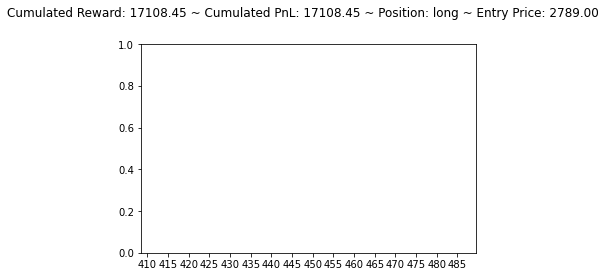

[1123.8513 1144.6079 1120.5037]
long hold long


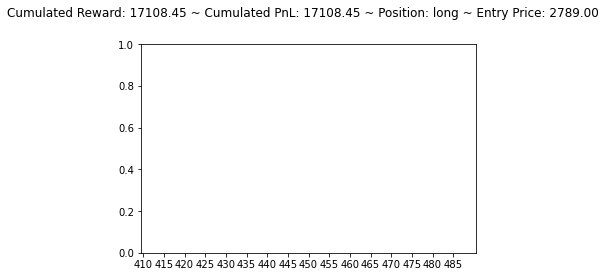

[1130.4677 1149.8057 1123.024 ]
long hold long


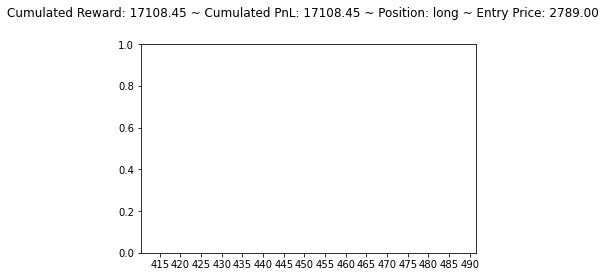

[1123.4434 1143.9844 1119.9528]
long hold long


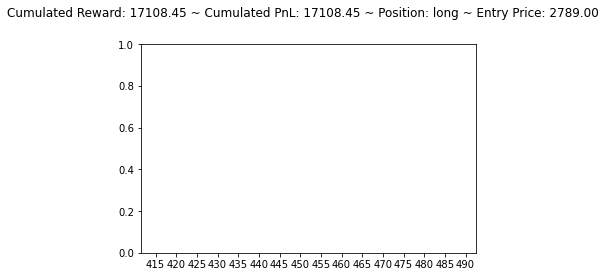

[1130.2445 1149.3273 1122.5435]
long hold long


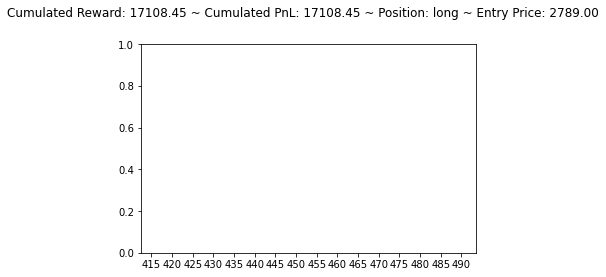

[1123.0352 1143.3607 1119.4019]
long hold long


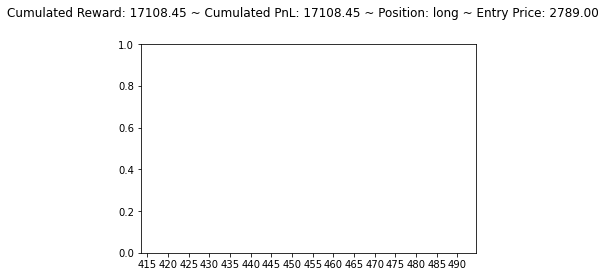

[1130.0211 1148.849  1122.0627]
long hold long


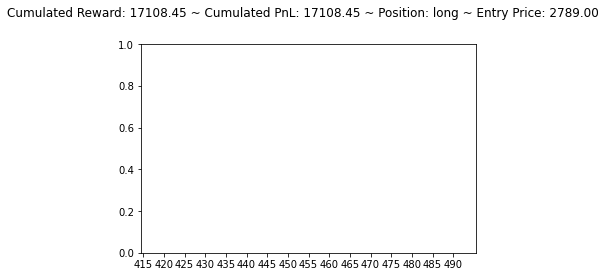

[965.54004 924.4927  945.7367 ]
long hold long


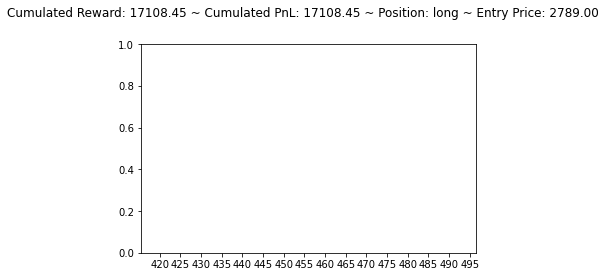

[1114.4641 1114.8988 1083.848 ]
long hold long


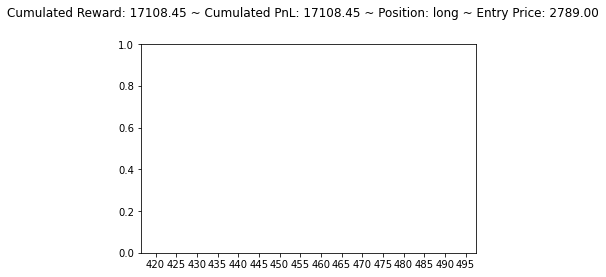

[1133.6257 1154.7013 1127.2334]
long hold long


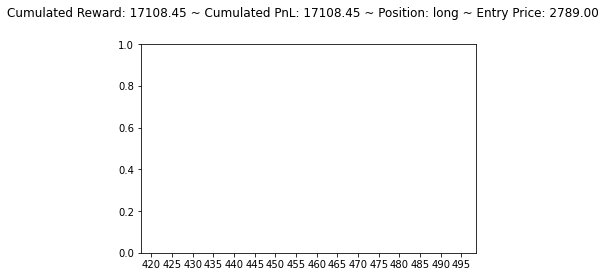

[1126.6011 1148.88   1124.1621]
long hold long


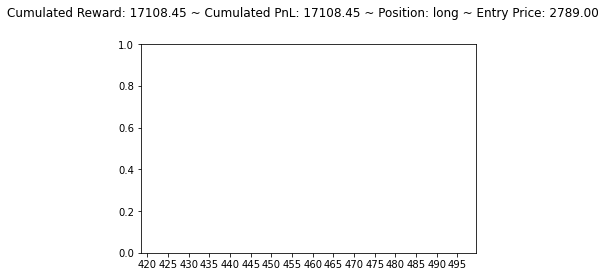

[1133.4027 1154.2229 1126.7527]
long hold long


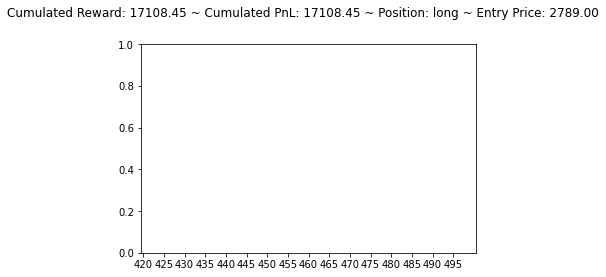

[1126.1932 1148.256  1123.6112]
long hold long


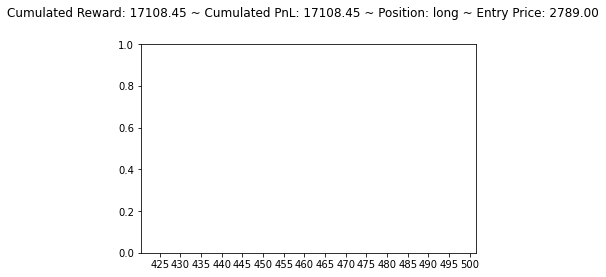

[1133.1799 1153.7444 1126.2722]
long hold long


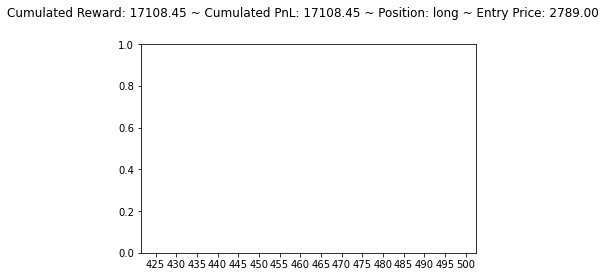

[1066.152  1058.6079 1049.0952]
long hold long


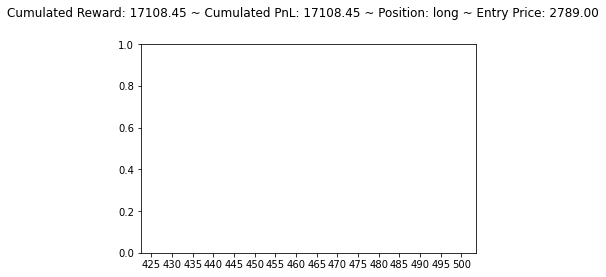

[1067.8976 1049.5339 1037.835 ]
long hold long


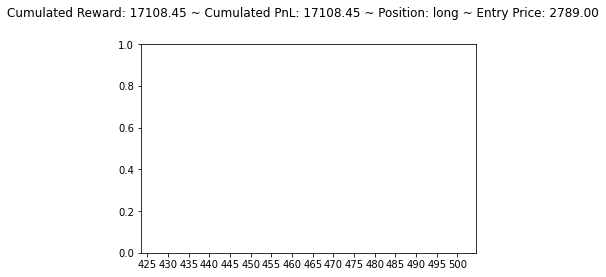

[1136.0085 1156.0803 1129.5521]
long hold long


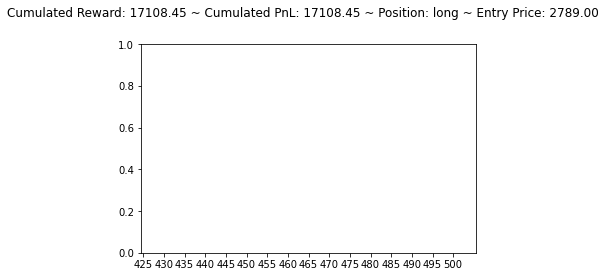

[1120.6029 1140.1136 1116.3683]
long hold long


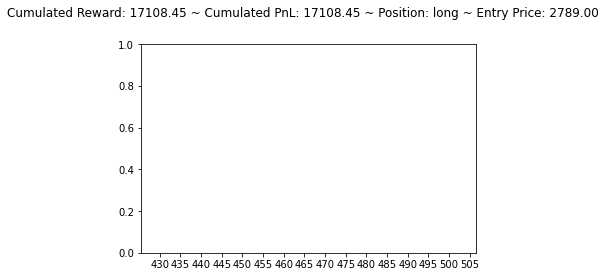

[1111.6594 1120.3064 1096.4847]
long hold long


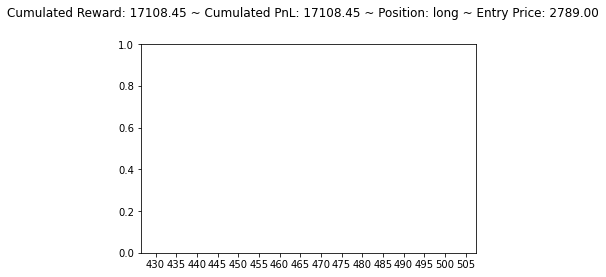

[1130.9513 1149.9031 1122.7953]
long hold long


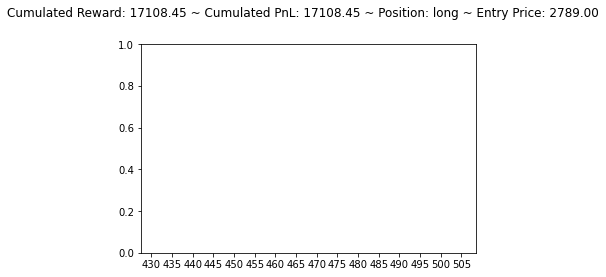

[1123.0634 1143.4036 1119.3958]
long hold long


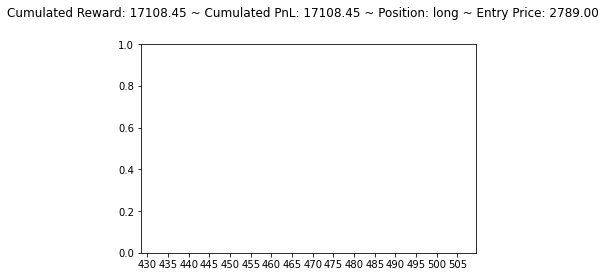

[1130.7284 1149.4248 1122.3146]
long hold long


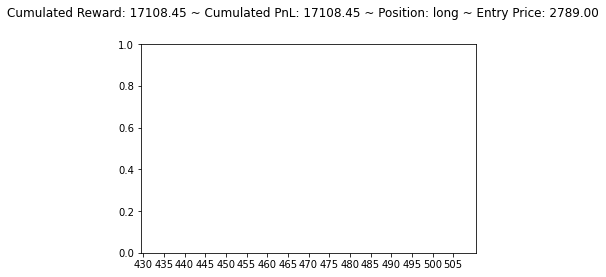

[1122.6553 1142.78   1118.8448]
long hold long


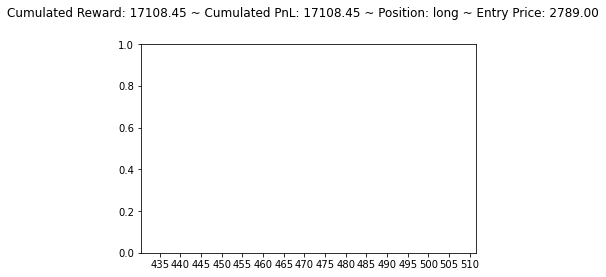

[1130.5051 1148.9465 1121.8341]
long hold long


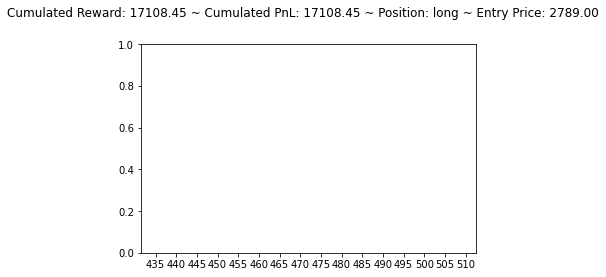

[1122.3934 1142.3738 1118.4856]
long hold long


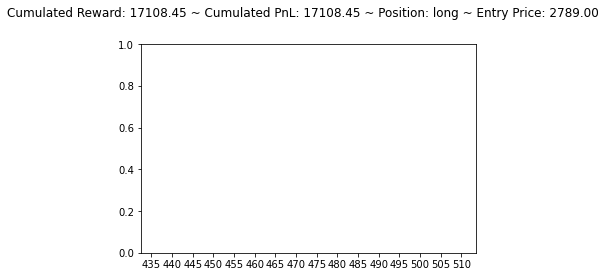

[1130.3667 1148.6371 1121.5216]
long hold long


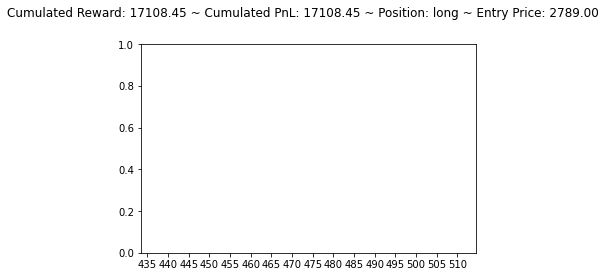

[1121.9855 1141.7499 1117.9346]
long hold long


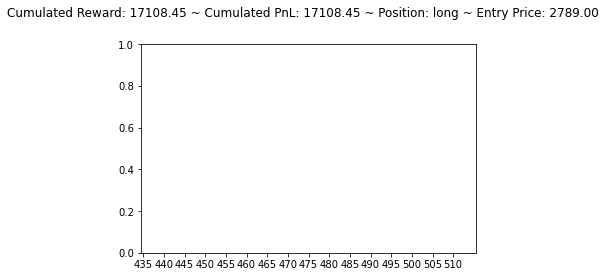

[1130.1436 1148.1586 1121.041 ]
long hold long


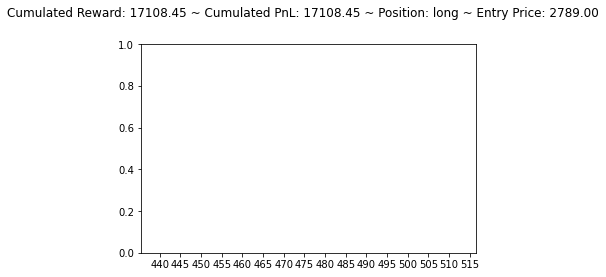

[1121.577  1141.126  1117.3835]
long hold long


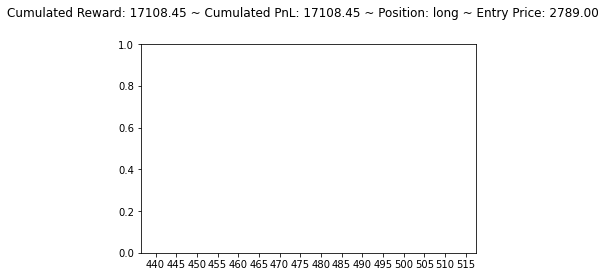

[1129.9205 1147.6802 1120.5603]
long hold long


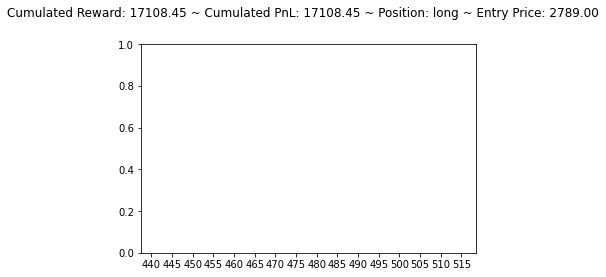

[1121.1691 1140.5022 1116.8324]
long hold long


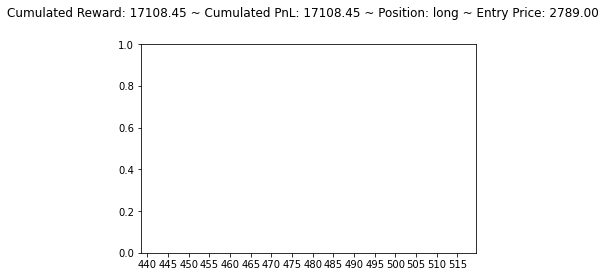

[1129.6971 1147.2019 1120.0797]
long hold long


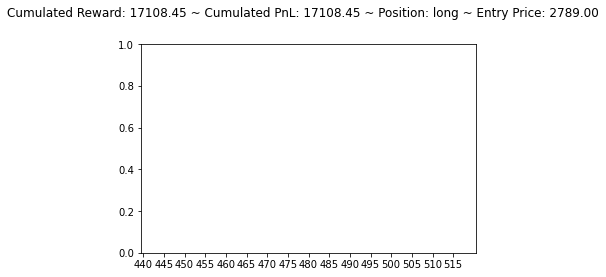

[1120.7609 1139.8787 1116.2817]
long hold long


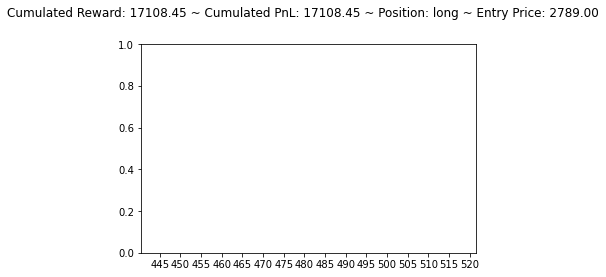

[1129.4746 1146.7235 1119.5991]
long hold long


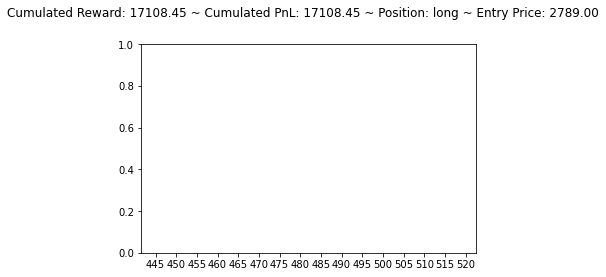

[1120.4991 1139.4723 1115.9222]
long hold long


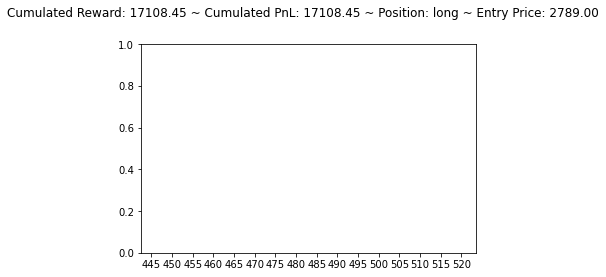

[1129.3359 1146.4141 1119.2866]
long hold long


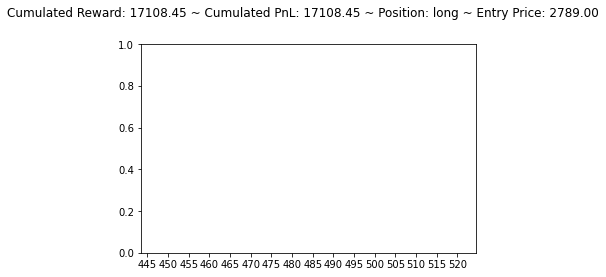

[1120.0911 1138.8486 1115.3715]
long hold long


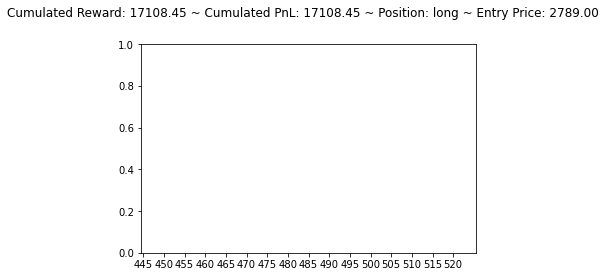

[1129.1128 1145.9354 1118.8059]
long hold long


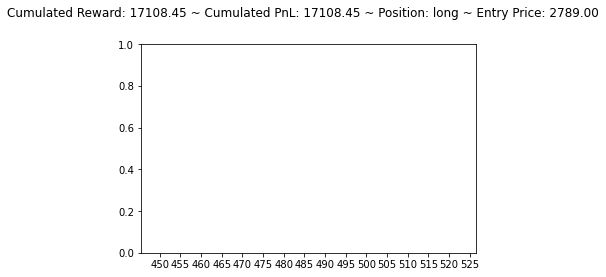

[1119.683  1138.2247 1114.8204]
long hold long


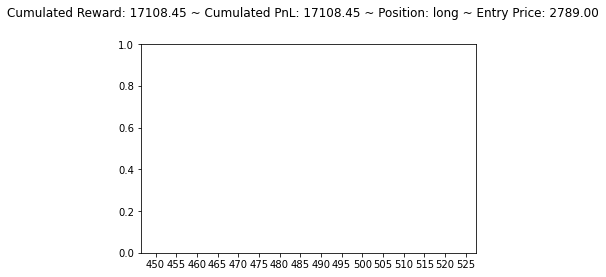

[1128.8899 1145.4573 1118.3253]
long hold long


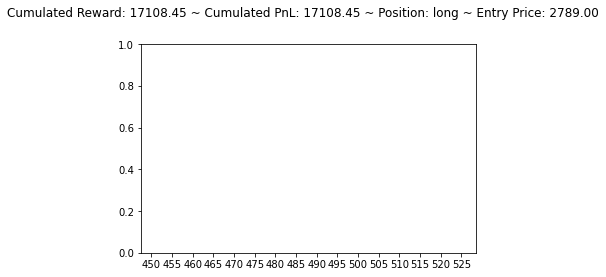

[1119.2748 1137.601  1114.2694]
long hold long


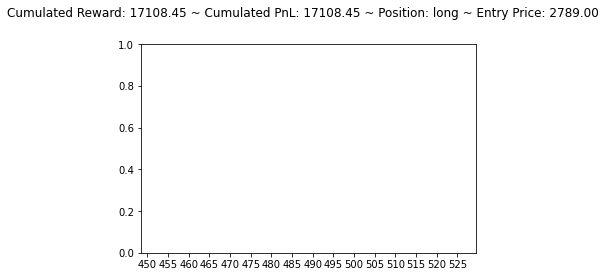

[1128.6666 1144.9788 1117.8446]
long hold long


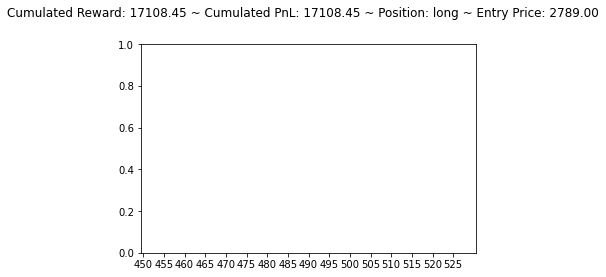

[1118.8667 1136.9773 1113.7185]
long hold long


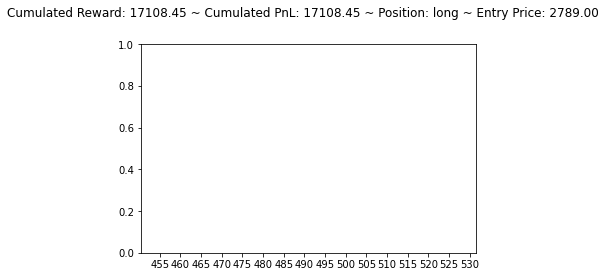

[1128.4437 1144.5002 1117.364 ]
long hold long


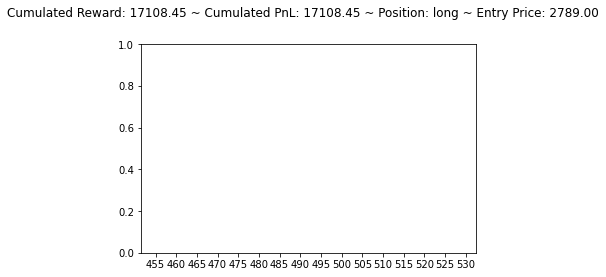

[1118.6046 1136.5712 1113.3591]
long hold long


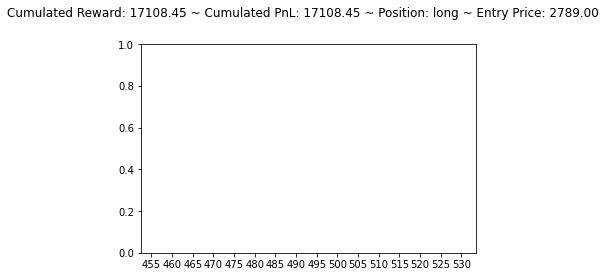

[1128.3053 1144.191  1117.0518]
long hold long


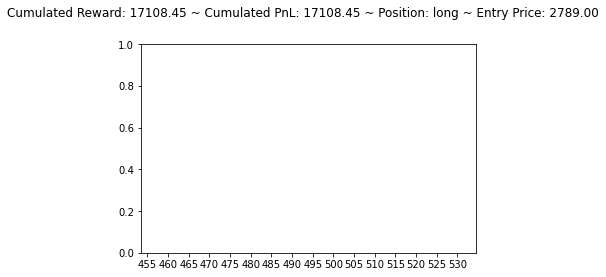

[1126.5277 1149.2129 1124.1716]
long hold long


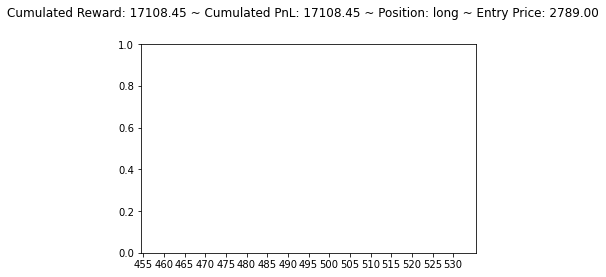

[1132.5664 1153.3926 1126.304 ]
long hold long


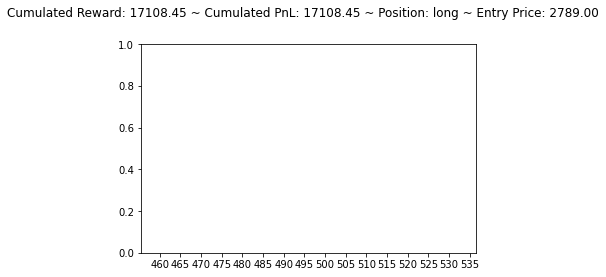

[1126.1823 1148.1761 1123.612 ]
long hold long


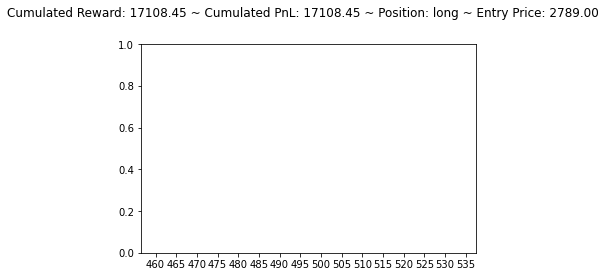

[1132.4285 1153.0833 1125.9918]
long hold long


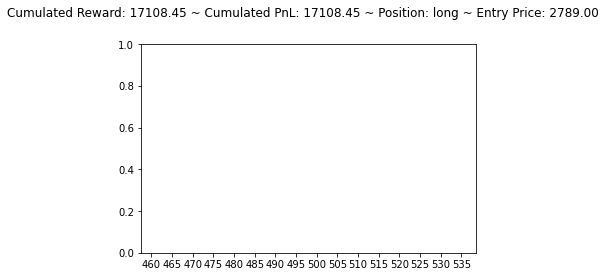

[1125.7742 1147.5525 1123.061 ]
long hold long


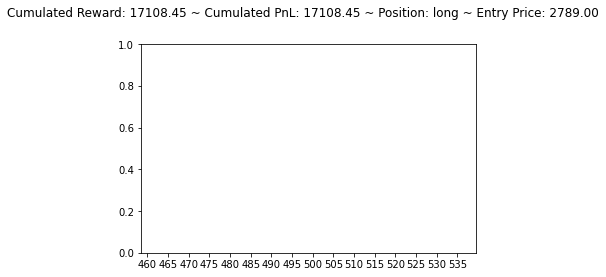

[1132.2052 1152.6047 1125.5111]
long hold long


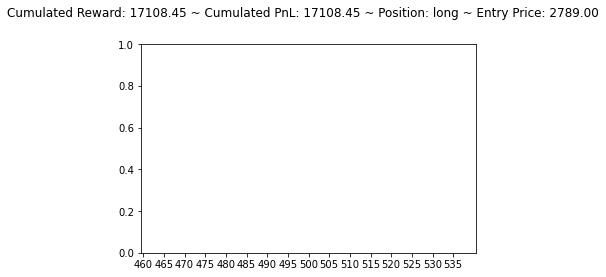

[1125.3658 1146.9287 1122.51  ]
long hold long


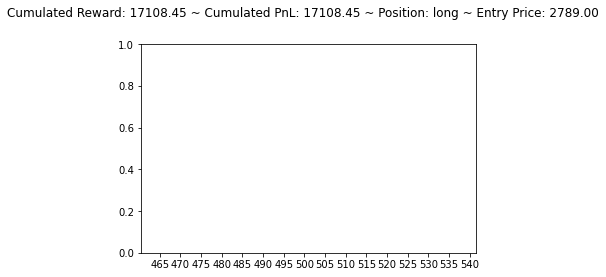

[1131.982  1152.1266 1125.0304]
long hold long


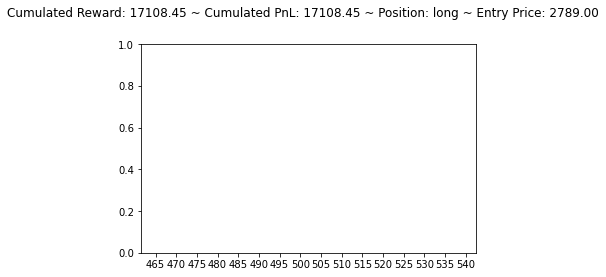

[1079.3302 1078.1932 1065.3528]
long hold long


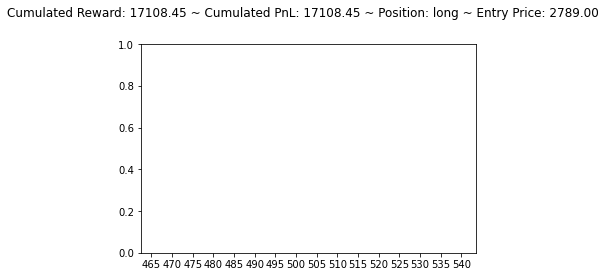

[1126.061  1138.0602 1111.8876]
long hold long


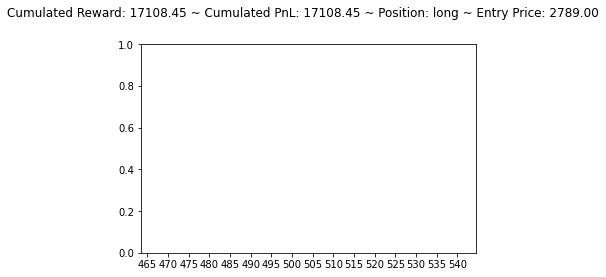

[1111.1251 1123.6824 1102.7909]
long hold long


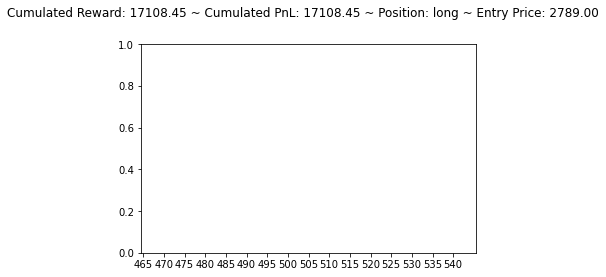

[1088.4917 1082.4281 1062.2217]
long hold long


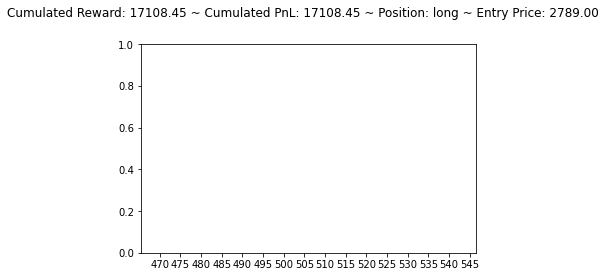

[1121.8604 1131.5786 1102.9058]
long hold long


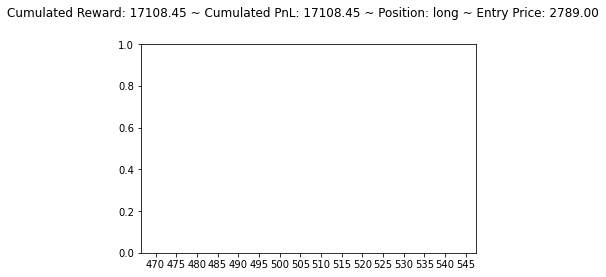

[1150.2045 1179.6951 1145.9729]
long hold long


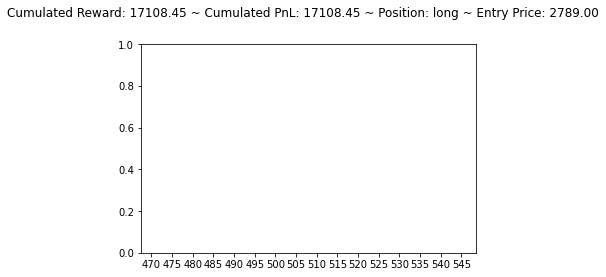

[1142.7529 1177.3062 1148.9971]
long sell flat


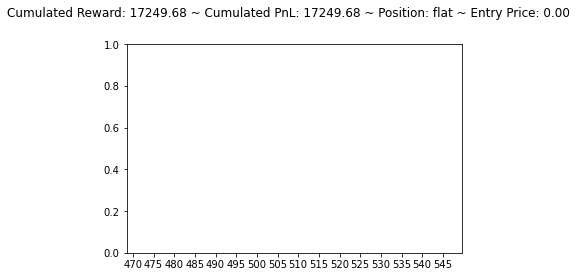

[1077.2725 1086.8462 1089.1998]
flat sell short


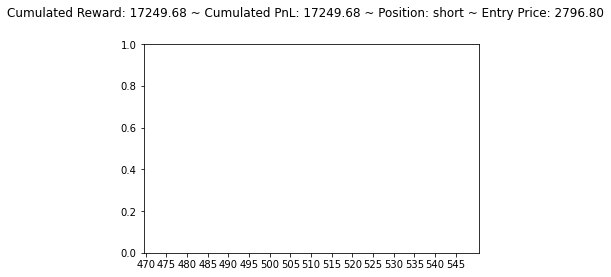

[1122.3086 1137.1775 1109.8904]
short buy flat


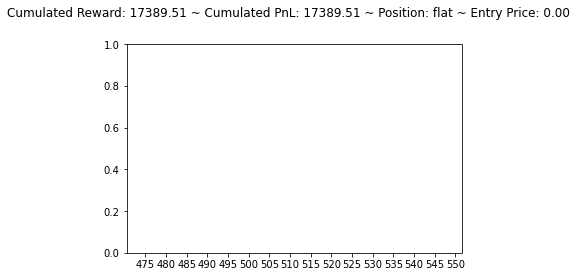

[1084.2445 1096.8254 1097.6129]
flat sell short


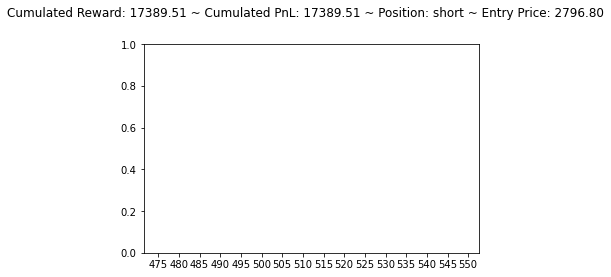

[1114.9187 1126.3973 1101.331 ]
short buy flat


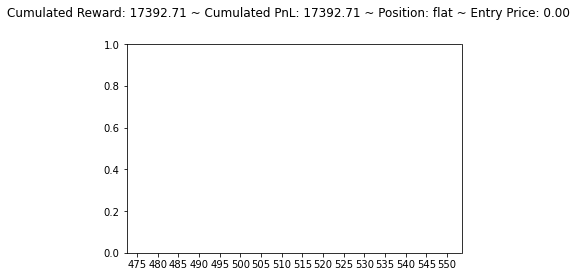

[1074.6035 1078.6436 1079.4376]
flat sell short


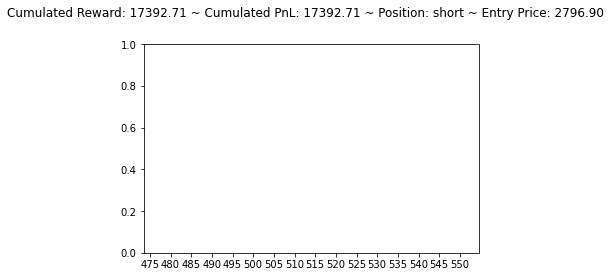

[1112.0328 1120.107  1093.022 ]
short buy flat


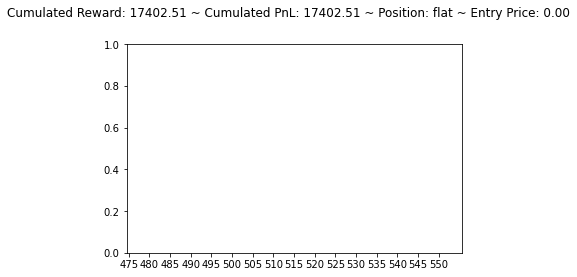

[1074.7778 1078.2101 1080.5724]
flat sell short


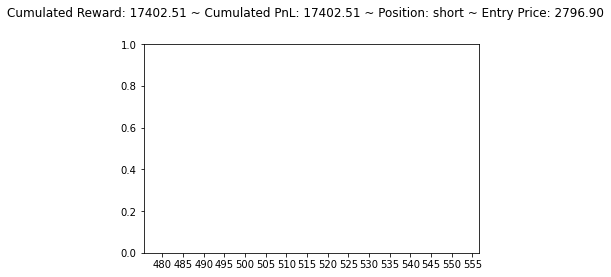

[1009.54785  967.30115  966.3564 ]
short hold short


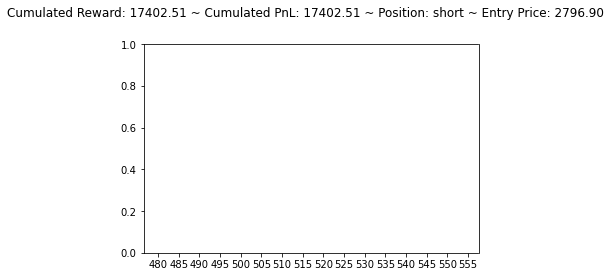

[990.9519 973.5978 967.5767]
short hold short


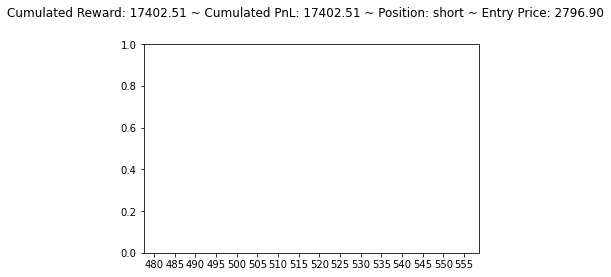

[991.54956 973.4313  967.93884]
short hold short


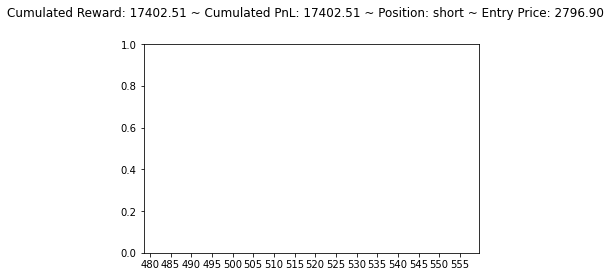

[1113.6938 1110.0112 1082.123 ]
short hold short


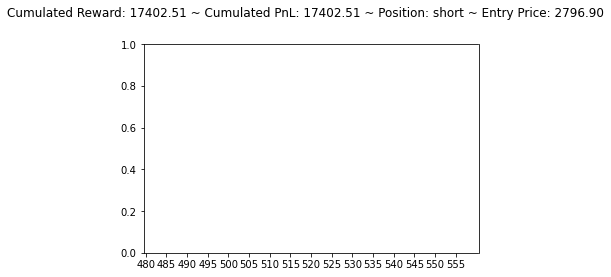

[1122.9944 1137.5631 1107.8602]
short buy flat


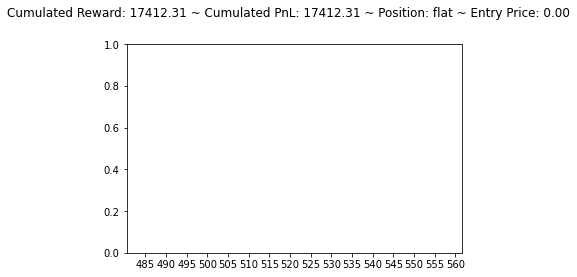

[1073.5078 1076.6572 1081.5809]
flat sell short


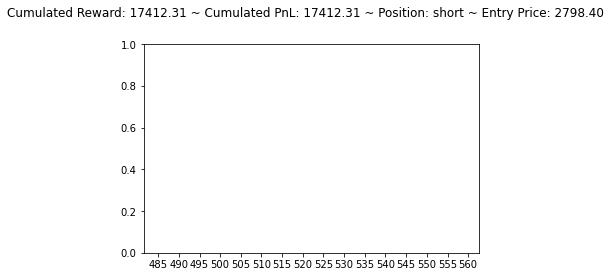

[1122.64   1134.3916 1105.5106]
short buy flat


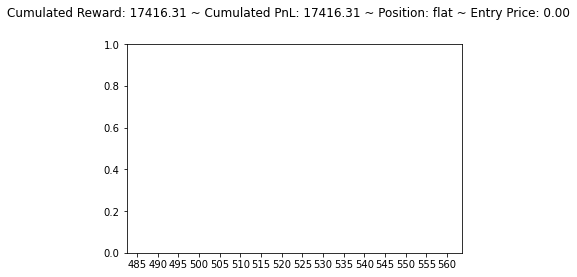

[1078.2549 1082.8667 1087.2864]
flat sell short


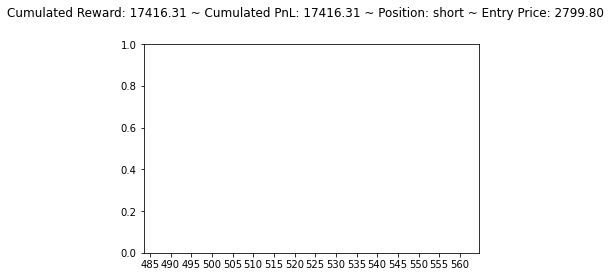

[1123.3757 1136.319  1106.9946]
short buy flat


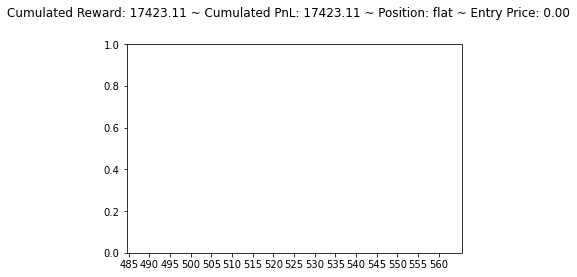

[1082.037  1087.9677 1092.5153]
flat sell short


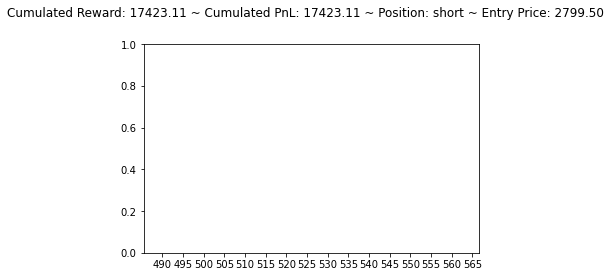

[1120.5812 1133.5487 1104.468 ]
short buy flat


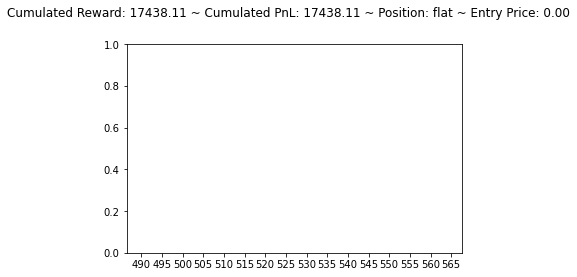

[1081.901  1087.2891 1091.6467]
flat sell short


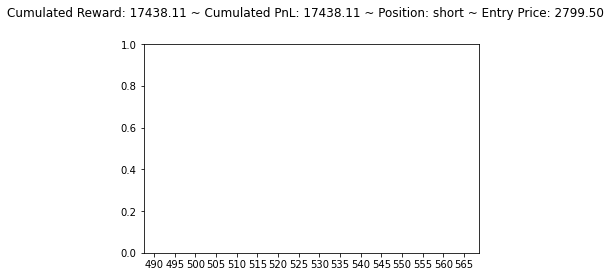

[1123.4941 1137.0997 1107.7954]
short buy flat


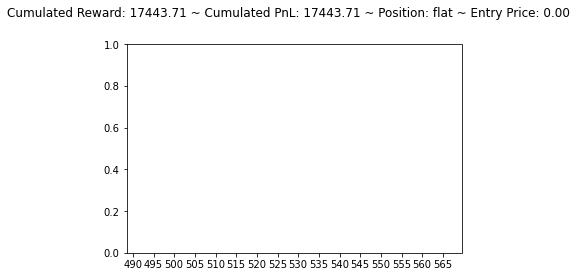

[1083.1384 1090.3744 1094.6041]
flat sell short


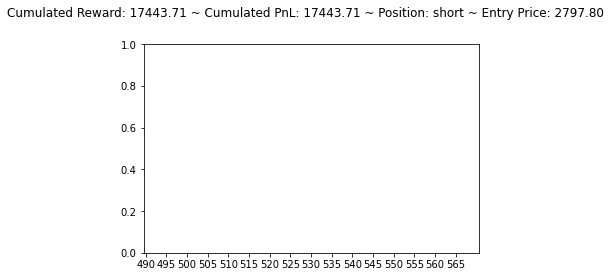

[1123.4084 1136.8636 1107.8433]
short buy flat


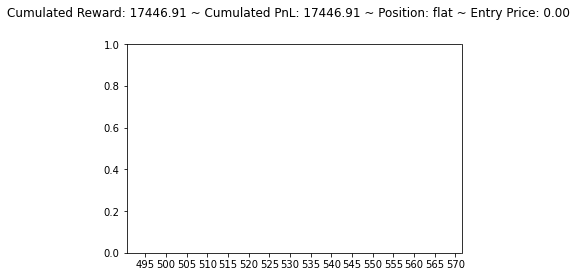

[1086.0011 1093.493  1097.7902]
flat sell short


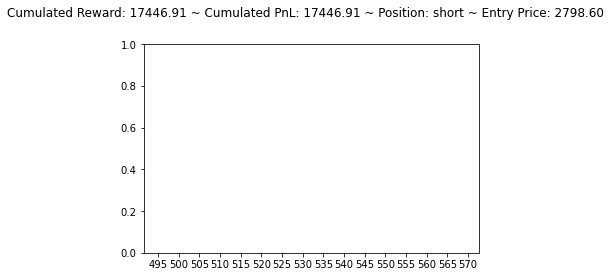

[1125.4764 1141.4529 1111.1418]
short buy flat


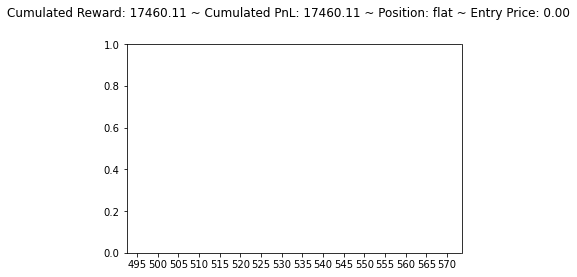

[1085.9633 1092.794  1098.2097]
flat sell short


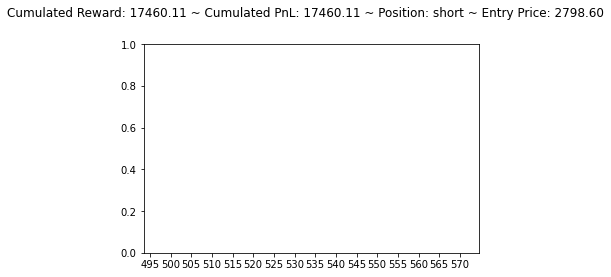

[1125.9357 1141.263  1111.2898]
short buy flat


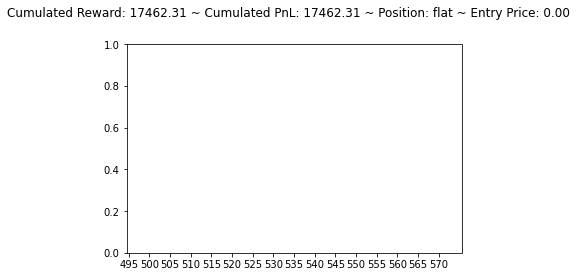

[1089.7046 1098.311  1103.1732]
flat sell short


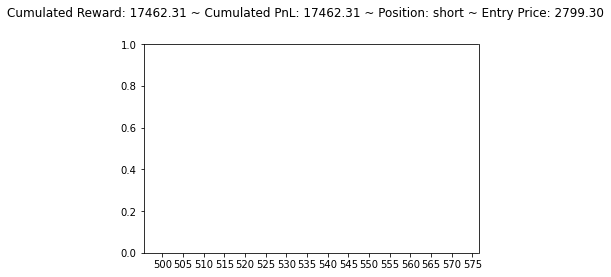

[1130.1003 1148.73   1117.3112]
short buy flat


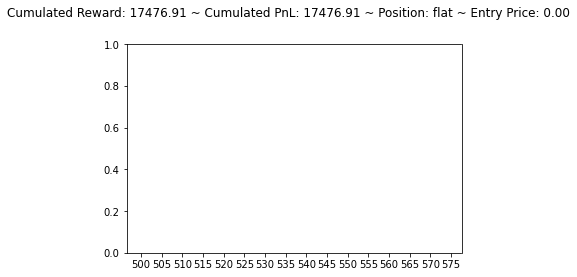

[1089.7714 1097.7192 1104.2239]
flat sell short


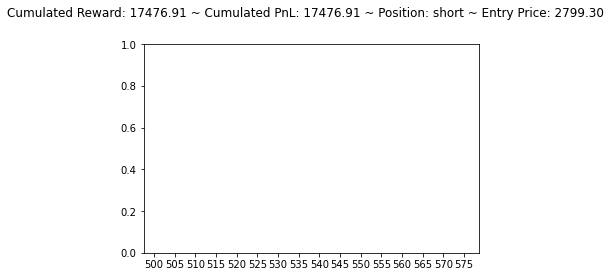

[1126.2017 1142.0994 1112.1575]
short buy flat


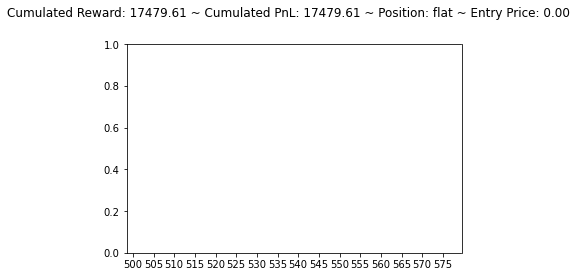

[1085.0592 1092.8436 1097.6093]
flat sell short


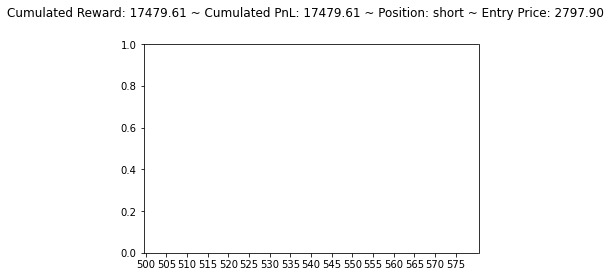

[1125.6646 1140.4453 1110.8868]
short buy flat


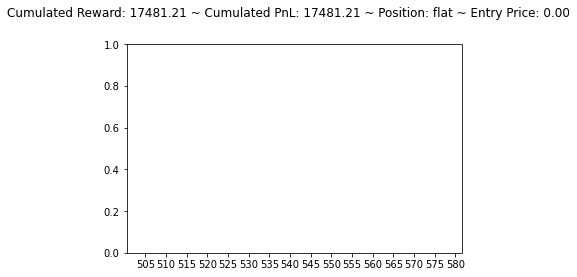

[1083.913  1090.5339 1095.4458]
flat sell short


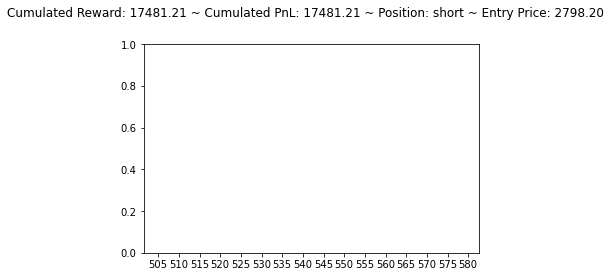

[1123.7183 1137.7246 1108.2365]
short buy flat


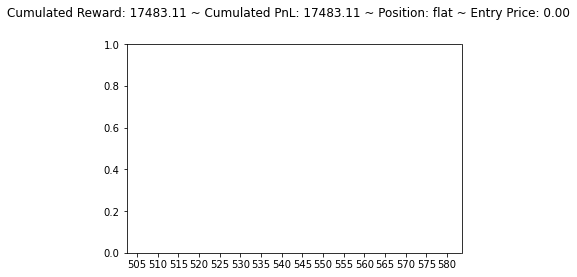

[1085.4913 1092.8165 1097.3811]
flat sell short


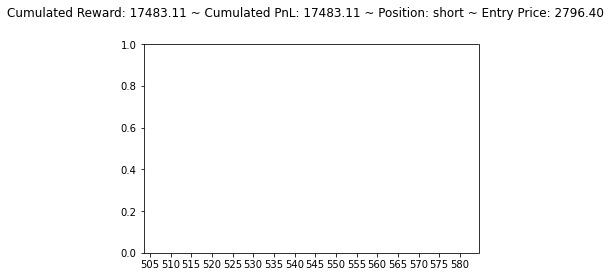

[1126.3755 1142.1128 1111.8445]
short buy flat


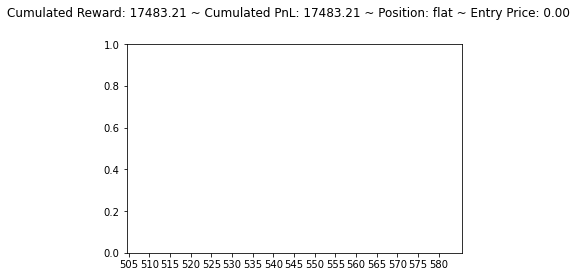

[1085.7928 1093.9164 1098.8479]
flat sell short


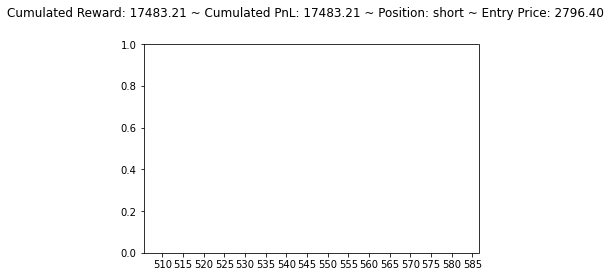

[1126.4198 1141.9304 1112.0391]
short buy flat


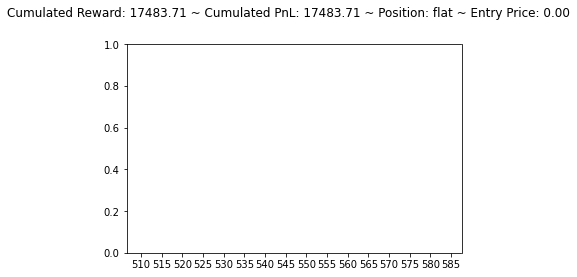

[1083.8514 1090.5028 1095.5039]
flat sell short


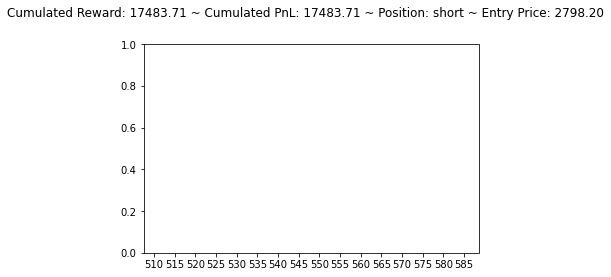

[1122.9226 1137.3613 1107.6483]
short buy flat


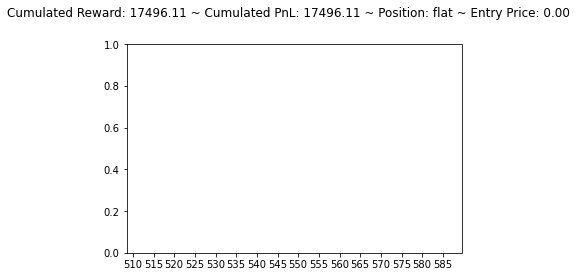

[1086.4689 1093.6516 1098.5522]
flat sell short


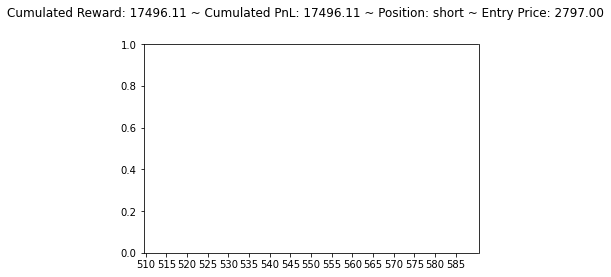

[1126.1787 1142.7566 1112.1327]
short buy flat


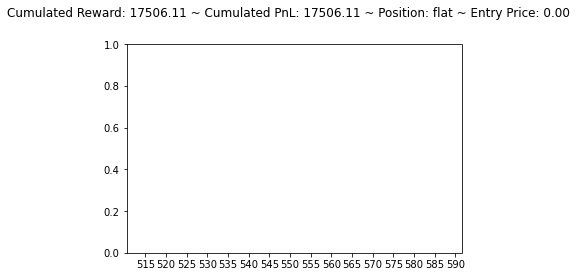

[1086.4911 1093.6829 1099.2302]
flat sell short


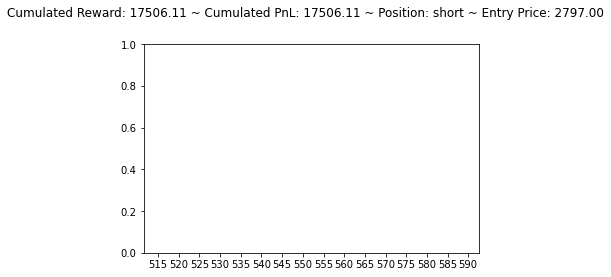

[1184.8141 1229.2576 1188.6144]
short buy flat


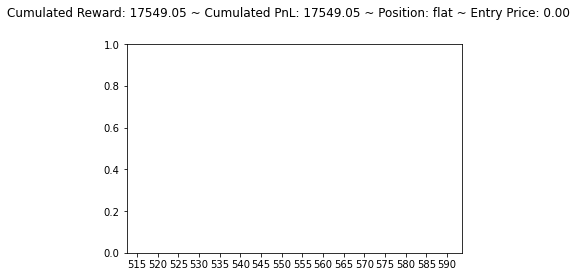

[1158.3241 1217.3672 1220.8977]
flat sell short


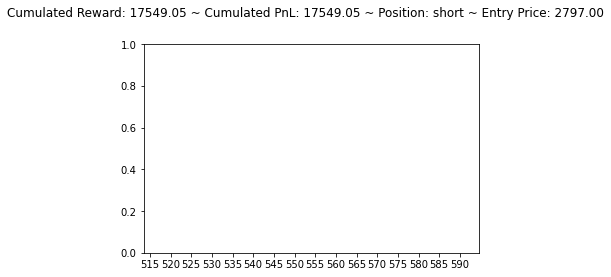

[1225.9451 1293.8145 1249.9504]
short buy flat


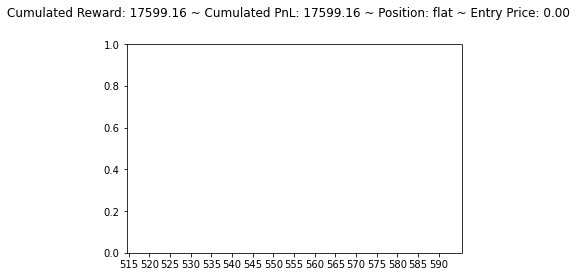

[1158.2526 1217.2698 1220.836 ]
flat sell short


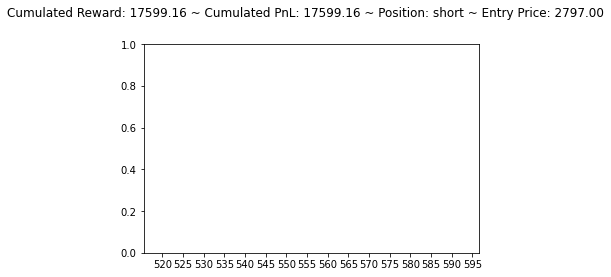

[1225.9242 1293.7675 1249.9125]
short buy flat


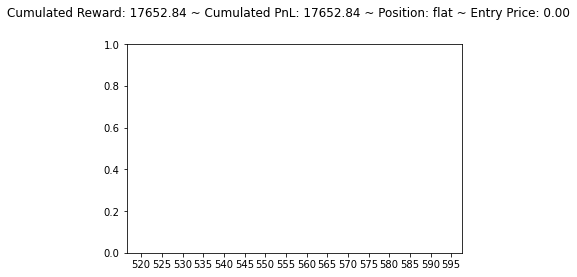

[1108.4445 1143.4554 1152.7924]
flat sell short


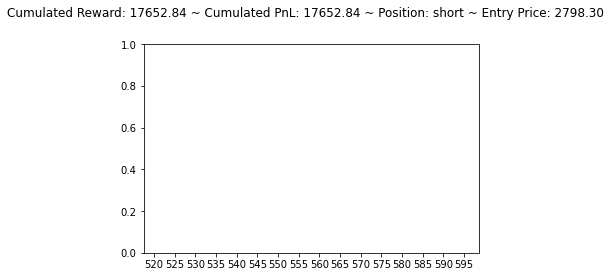

[1123.1462 1137.717  1107.9475]
short buy flat


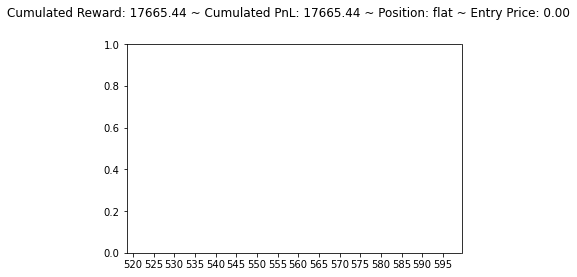

[1073.9594 1077.2842 1082.2303]
flat sell short


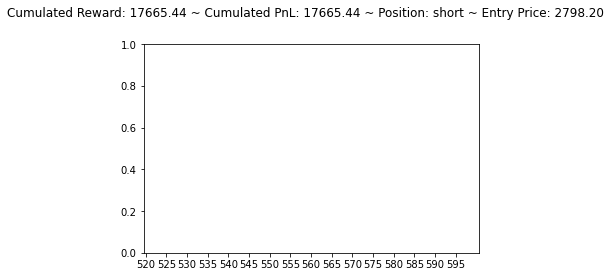

[1122.6593 1134.5234 1105.6067]
short buy flat


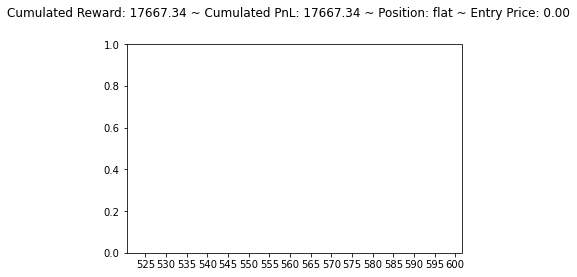

[1084.0597 1090.7572 1095.2146]
flat sell short


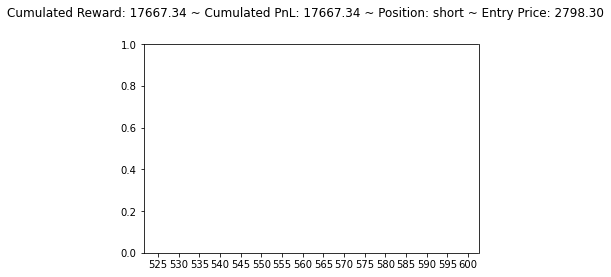

[1126.4642 1141.9241 1111.7714]
short buy flat


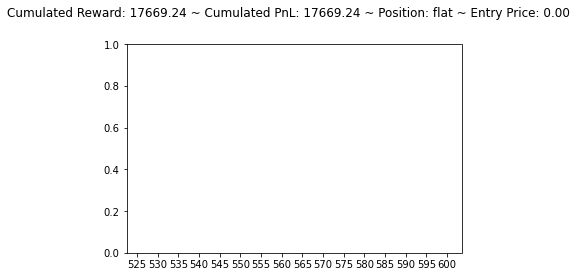

[1085.8767 1093.9932 1098.9573]
flat sell short


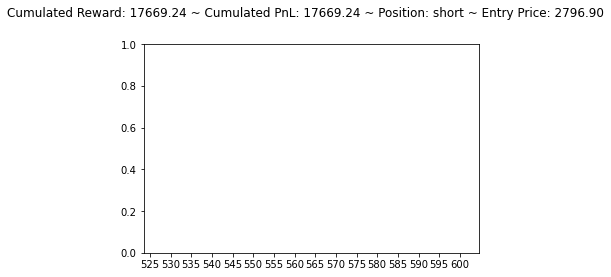

[1126.5574 1142.0642 1112.186 ]
short buy flat


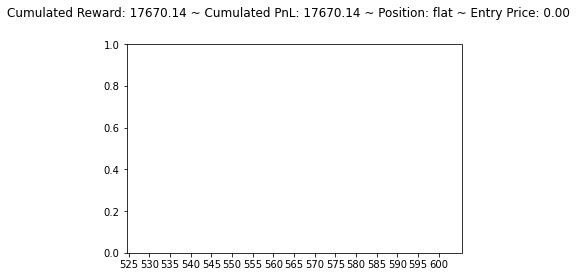

[1088.5505 1096.8949 1101.9384]
flat sell short


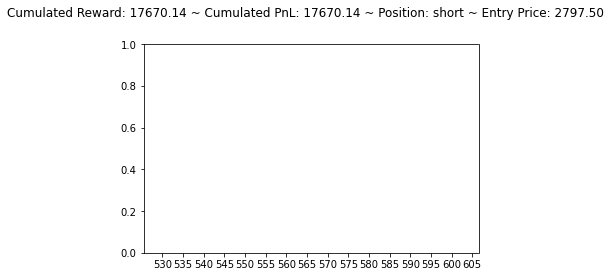

[1128.661  1146.6196 1115.4583]
short buy flat


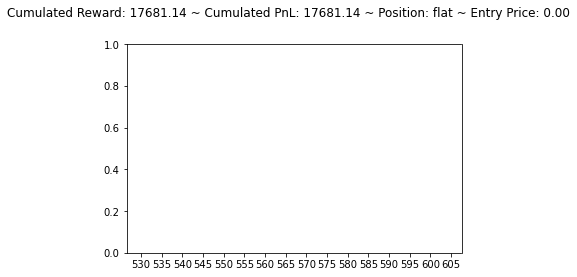

[1088.5808 1096.3715 1102.4932]
flat sell short


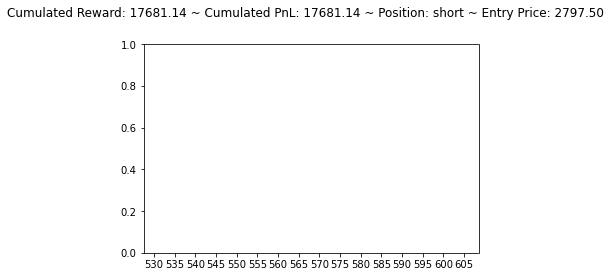

[1153.599  1184.4854 1148.5239]
short buy flat


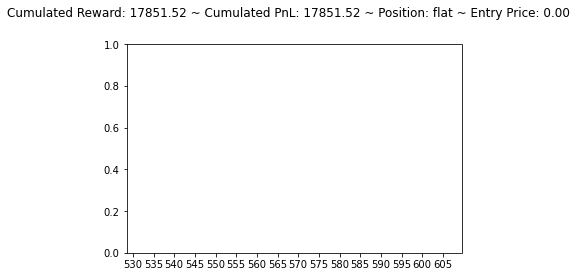

[1120.8032 1152.4281 1157.7523]
flat sell short


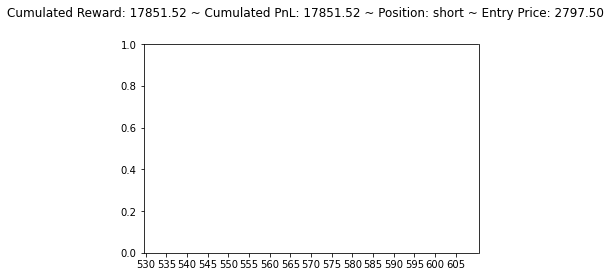

[1155.1239 1194.4423 1163.167 ]
short buy flat


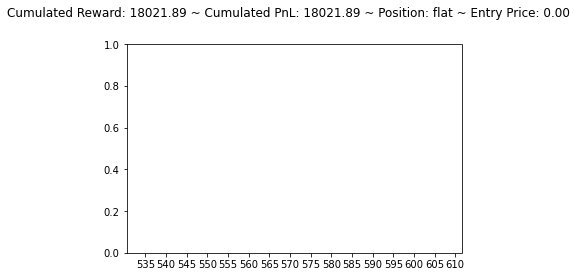

[1083.2789 1100.1488 1104.0002]
flat sell short


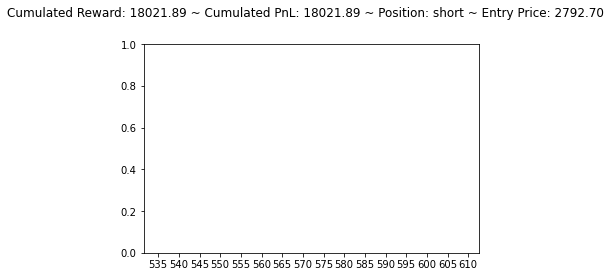

[1111.3263 1119.6174 1092.5367]
short buy flat


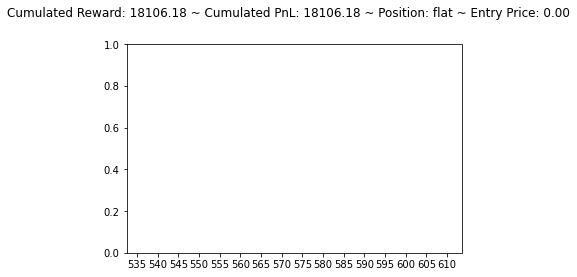

[1080.76   1088.8835 1090.5223]
flat sell short


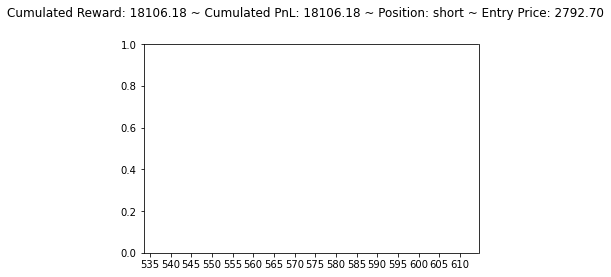

[1117.9122 1130.7648 1102.5895]
short buy flat


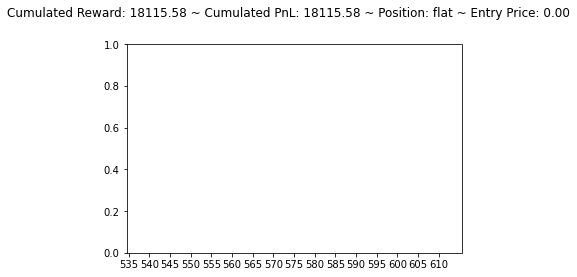

[1077.3794 1082.7285 1086.3033]
flat sell short


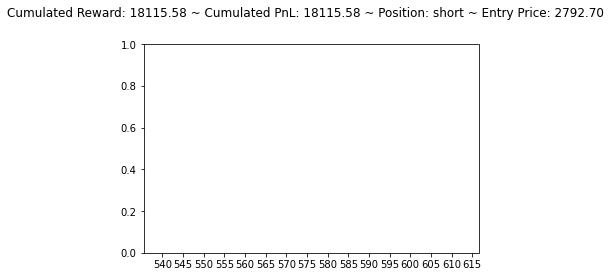

[1116.3322 1127.4275 1099.298 ]
short buy flat


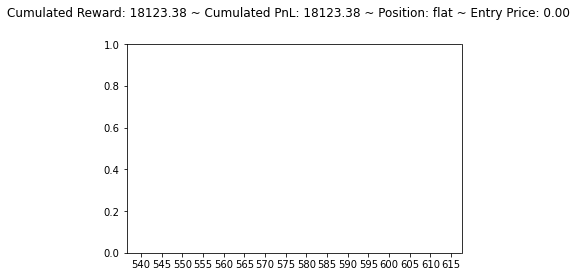

[1083.2529 1090.726  1094.1481]
flat sell short


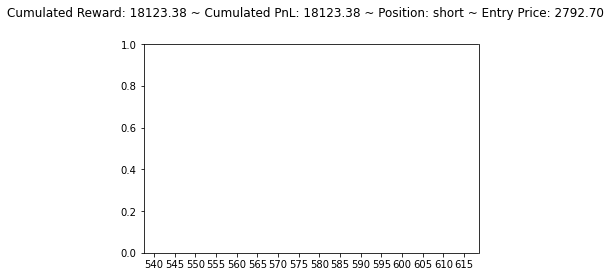

[1123.3243 1138.8163 1108.8608]
short buy flat


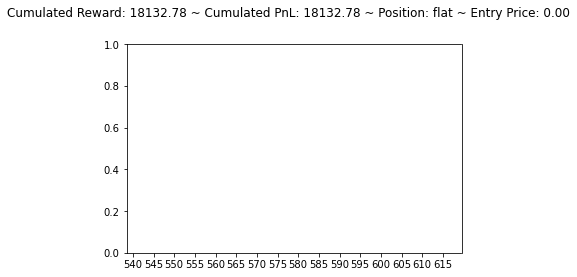

[1083.4852 1090.656  1095.8334]
flat sell short


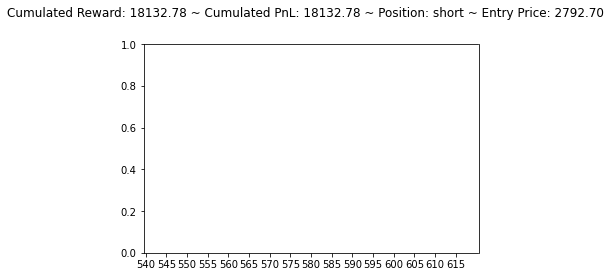

[1125.3217 1141.5898 1111.227 ]
short buy flat


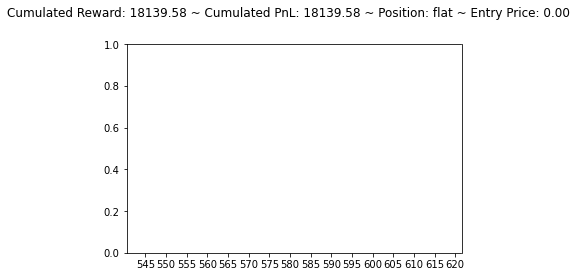

[1085.2064 1093.1719 1098.6284]
flat sell short


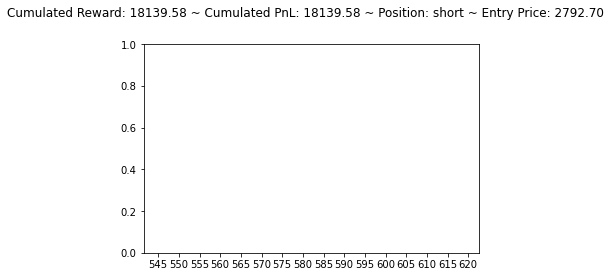

[1125.5043 1142.143  1111.7681]
short buy flat


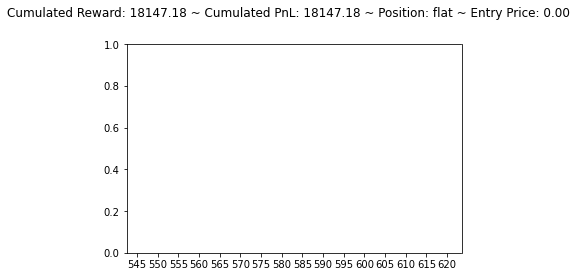

[1084.9552 1092.7535 1098.2811]
flat sell short


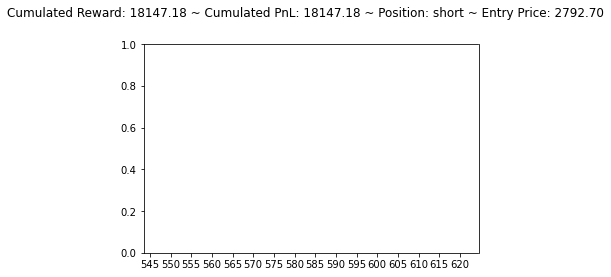

[1125.2528 1141.8052 1111.3865]
short buy flat


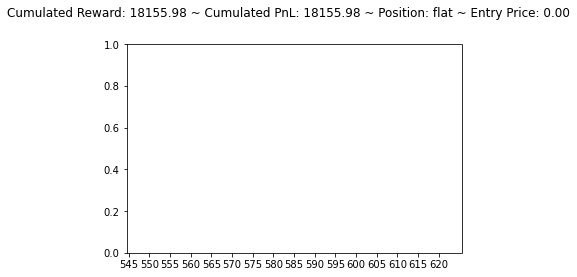

[1075.8774 1080.2971 1085.7957]
flat sell short


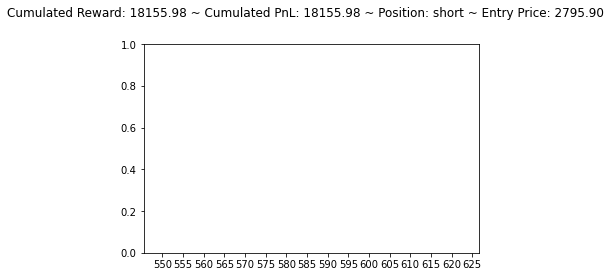

[1126.5914 1142.6741 1112.1858]
short buy flat


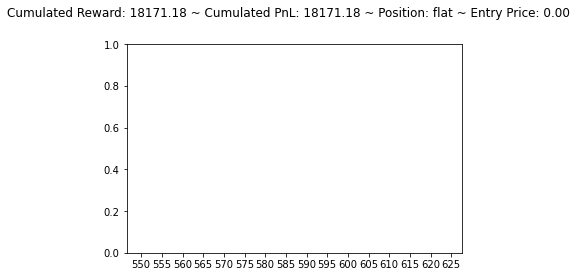

[1106.5266 1124.7493 1128.2443]
flat sell short


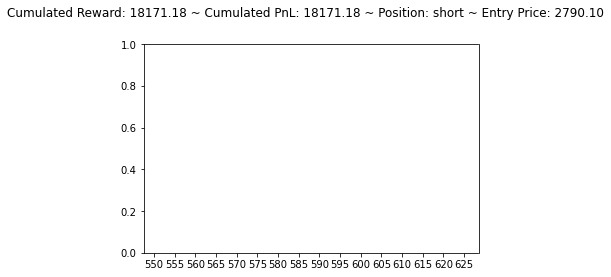

[1165.6444 1209.5433 1174.1462]
short buy flat


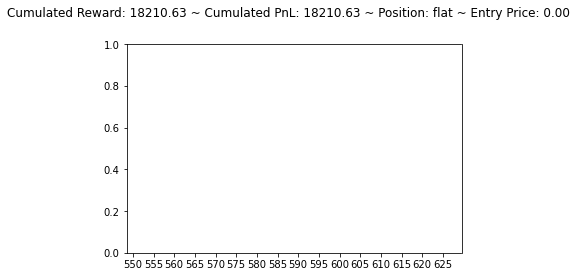

[1116.4503 1146.4004 1151.6526]
flat sell short


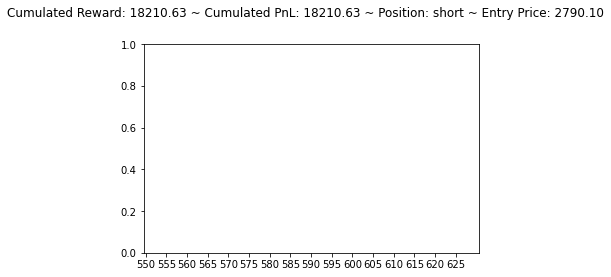

[1165.1821 1208.7706 1173.4264]
short buy flat


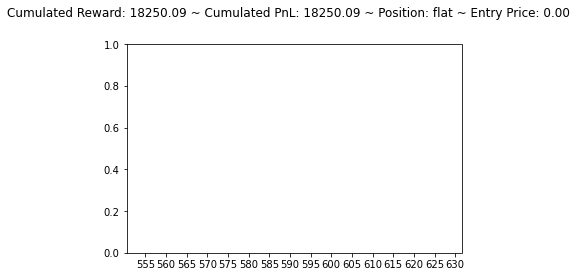

[1096.0187 1116.5327 1124.1058]
flat sell short


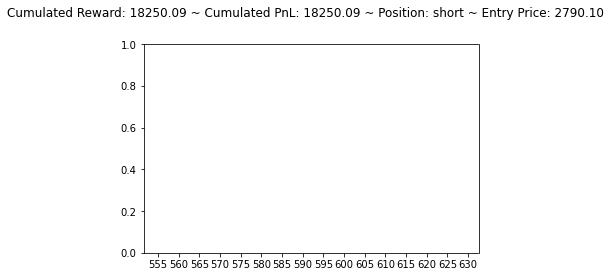

[1127.0356 1144.7102 1113.9368]
short buy flat


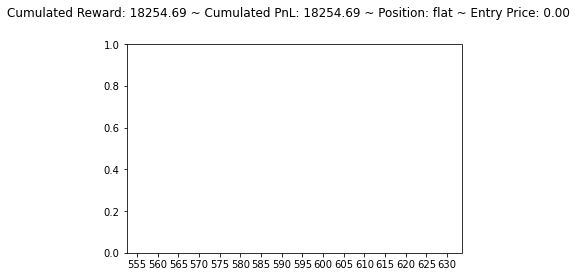

[1086.3594 1095.042  1100.9752]
flat sell short


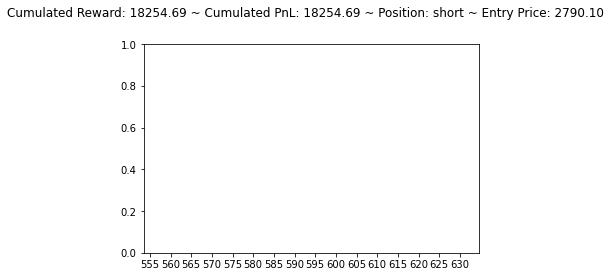

[1126.9557 1145.0798 1114.0636]
short buy flat


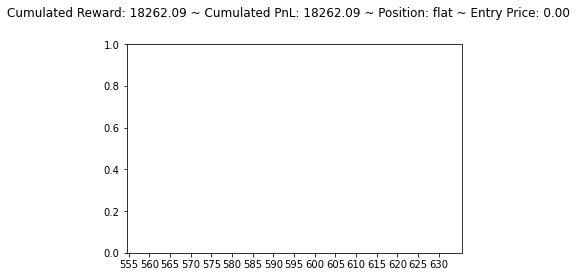

[1089.8026 1100.0627 1105.7006]
flat sell short


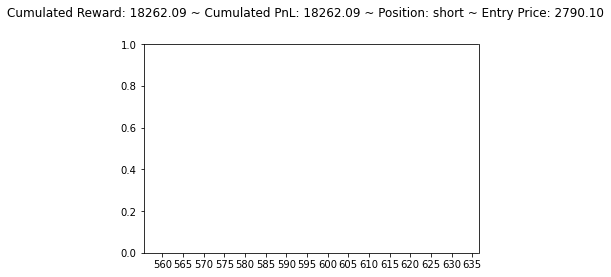

[1133.7357 1156.3845 1124.6483]
short buy flat


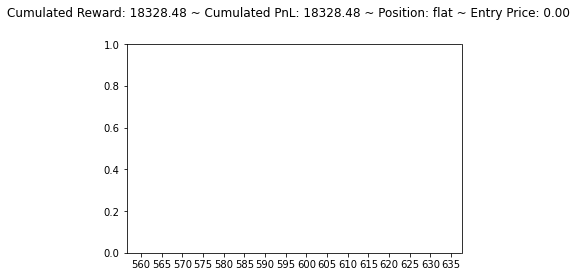

[1090.245  1101.8517 1107.9679]
flat sell short


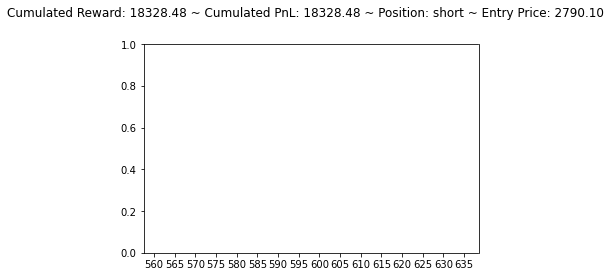

[1128.8507 1148.1212 1117.2953]
short buy flat


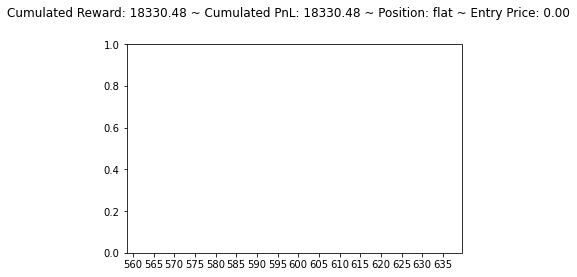

[1086.7551 1095.449  1101.2839]
flat sell short


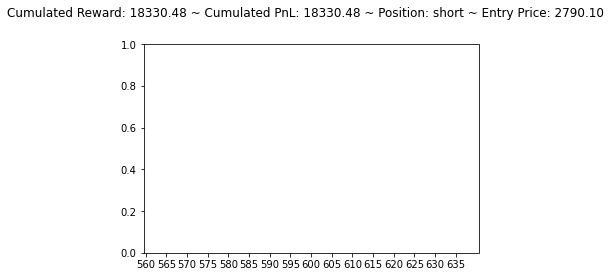

[1127.1581 1145.1198 1114.1267]
short buy flat


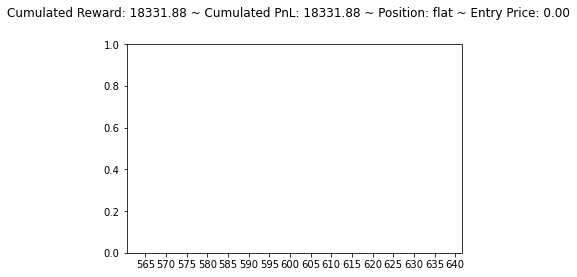

[1134.0985 1165.5215 1165.6364]
flat sell short


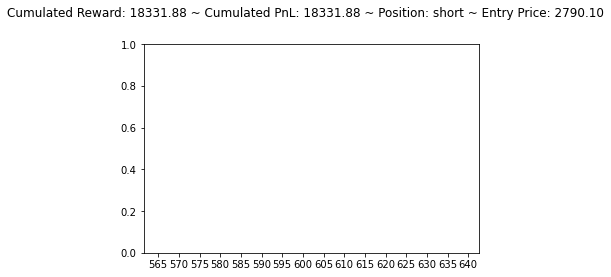

[1161.1208 1212.5011 1181.3094]
short buy flat


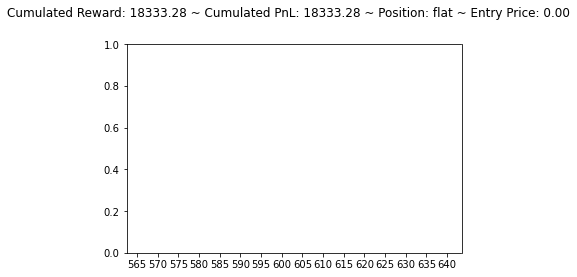

[1091.8865 1103.644  1108.6887]
flat sell short


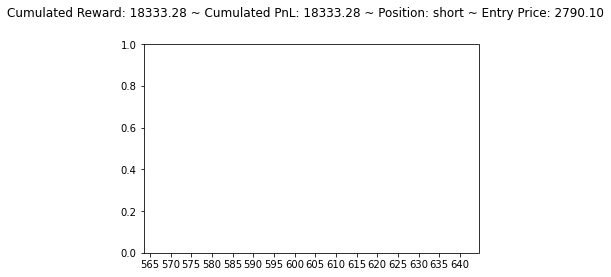

[1131.3276 1153.0054 1122.2617]
short buy flat


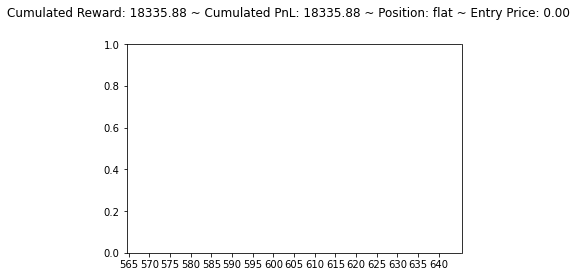

[1088.7579 1098.5056 1104.0975]
flat sell short


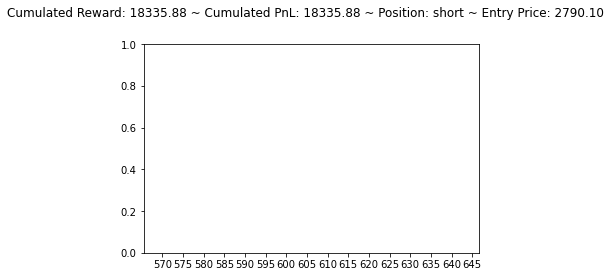

[1128.7661 1148.0615 1117.1763]
short buy flat


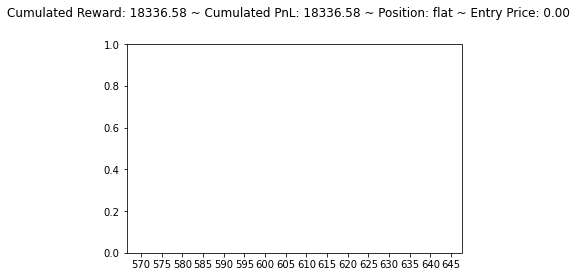

[1086.6425 1095.221  1101.0347]
flat sell short


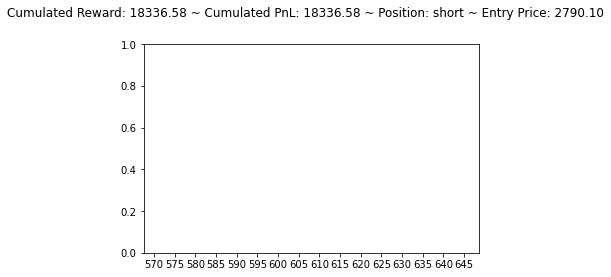

[1185.4835 1231.7561 1190.449 ]
short buy flat


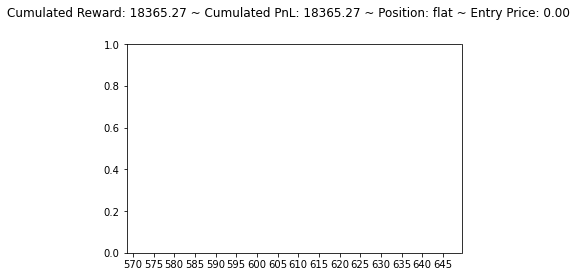

[1111.2102 1148.1975 1158.1746]
flat sell short


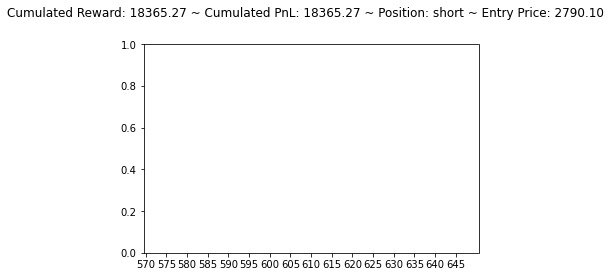

[961.6594  884.08527 909.3422 ]
short hold short


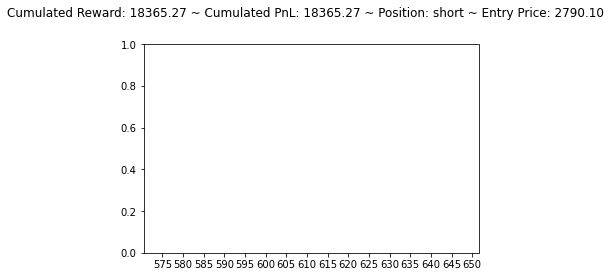

[922.7499  929.8192  915.43976]
short buy flat


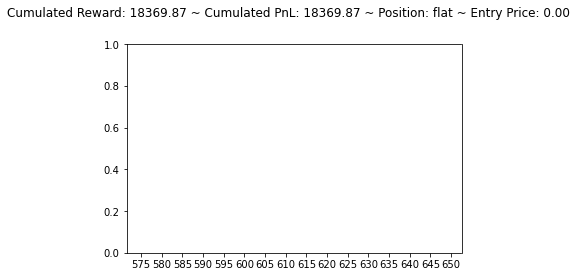

[1036.8506 1033.4729  994.1655]
flat hold flat


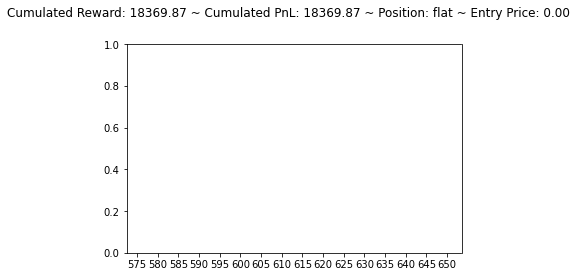

[919.734   888.18445 884.7752 ]
flat hold flat


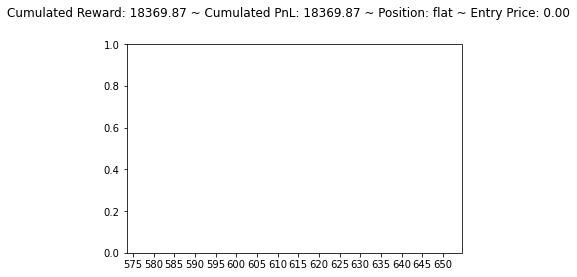

[902.28235 905.08997 882.9508 ]
flat buy long


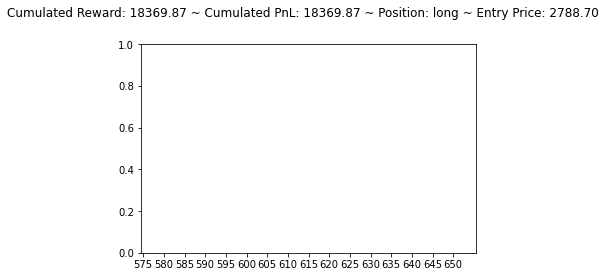

[923.62897 934.8566  919.48145]
long hold long


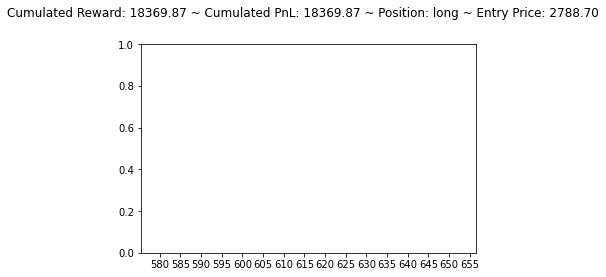

[1059.563  1047.6785 1023.8835]
long hold long


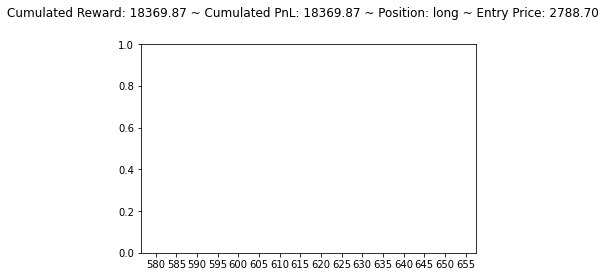

[1084.1887 1076.2324 1055.3221]
long hold long


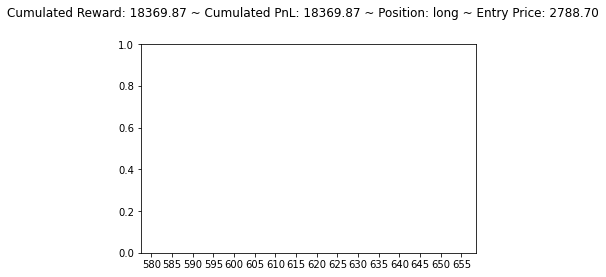

[1088.2543 1083.7157 1062.145 ]
long hold long


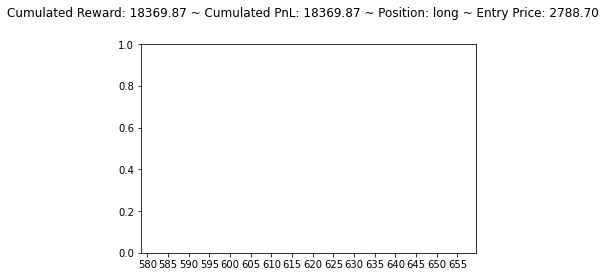

[1091.2166 1088.9873 1067.0824]
long hold long


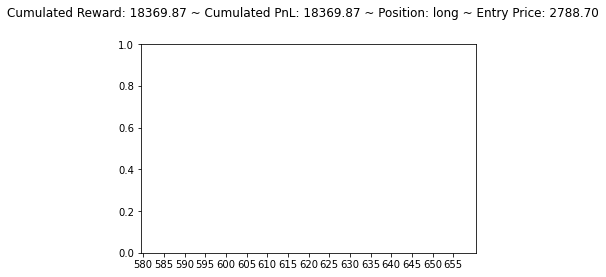

[1121.1765 1133.7511 1105.202 ]
long hold long


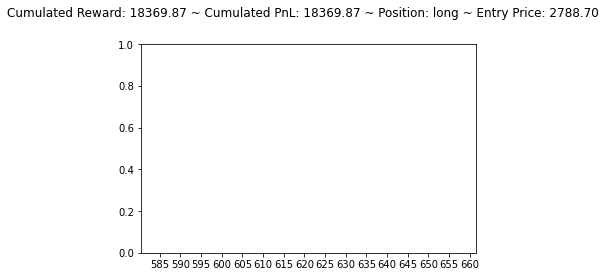

[1111.9163 1125.3479 1100.9434]
long hold long


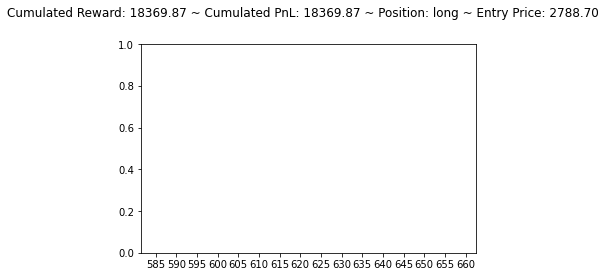

[1113.2898 1125.4155 1100.6826]
long hold long


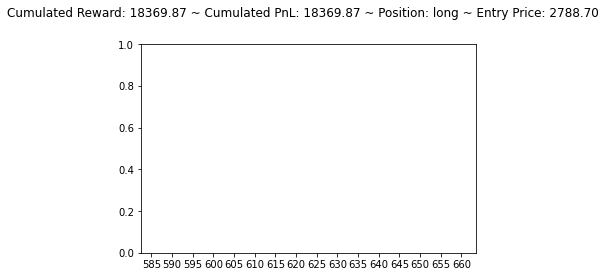

[1114.8385 1128.5784 1103.8562]
long hold long


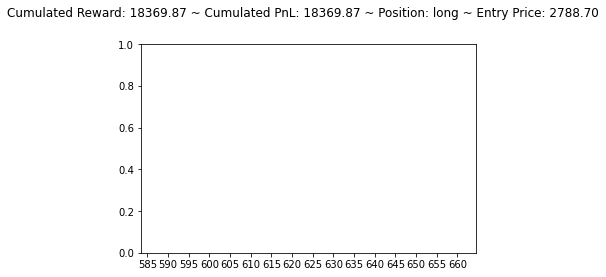

[1111.8246 1124.0603 1099.8535]
long hold long


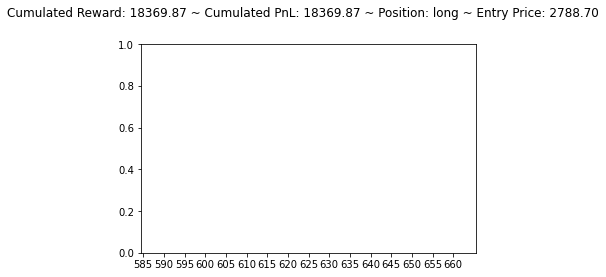

[1109.5437 1119.8105 1095.7216]
long hold long


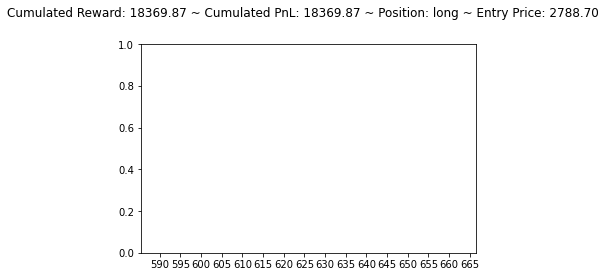

[908.95074 790.3385  837.47943]
long hold long


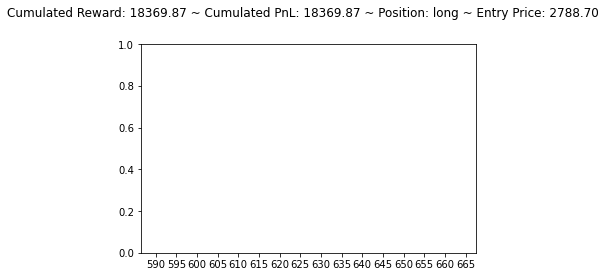

[1091.4012 1110.2378 1061.0994]
long hold long


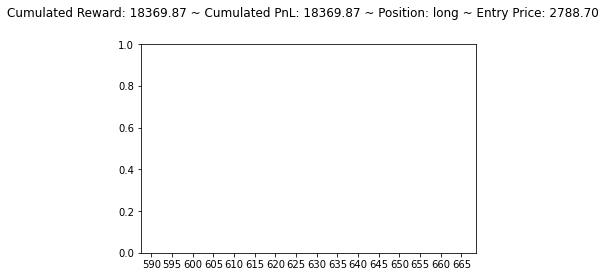

[1111.3363 1122.7134 1096.6108]
long hold long


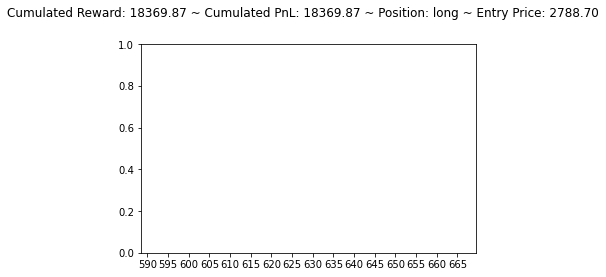

[1116.2853 1131.3503 1105.0862]
long hold long


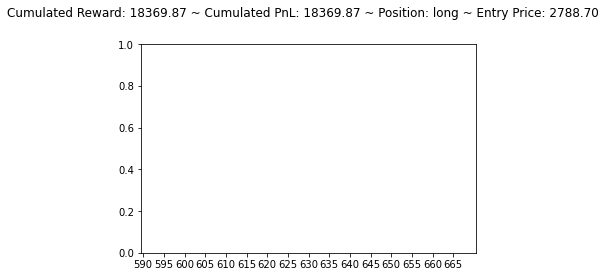

[1120.7587 1138.0945 1111.0477]
long hold long


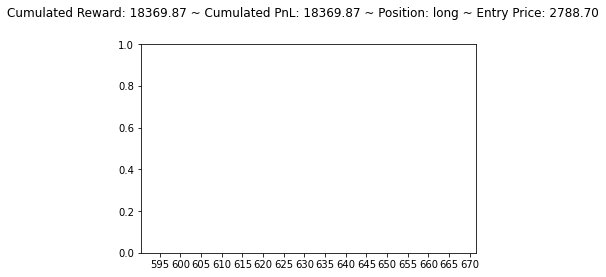

[1124.5685 1145.0562 1117.668 ]
long hold long


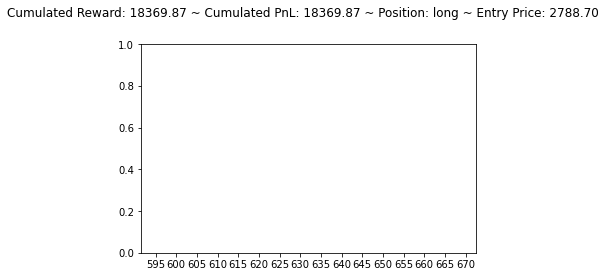

[1127.0332 1148.8782 1120.8822]
long hold long


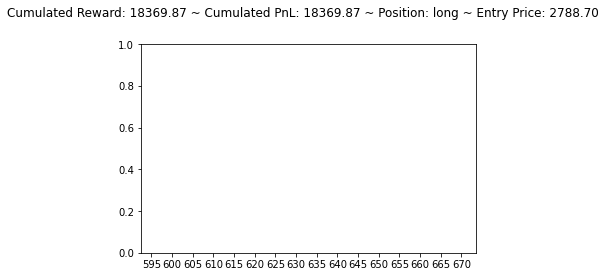

[1136.2915 1162.9629 1132.6586]
long hold long


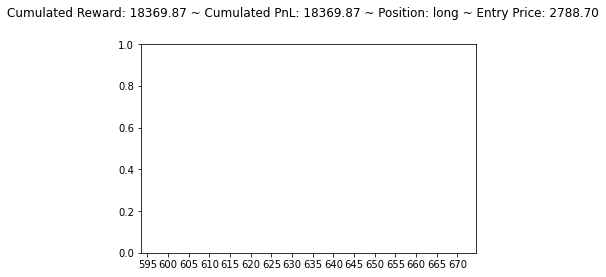

[1146.142  1178.6813 1145.9927]
long hold long


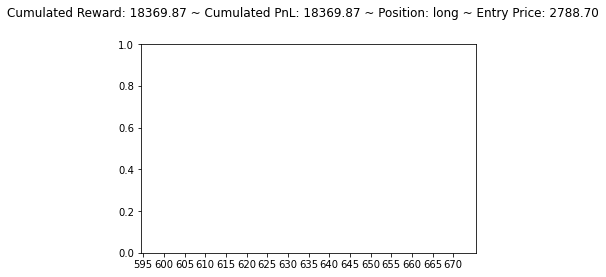

[1137.9083 1167.3936 1136.8788]
long hold long


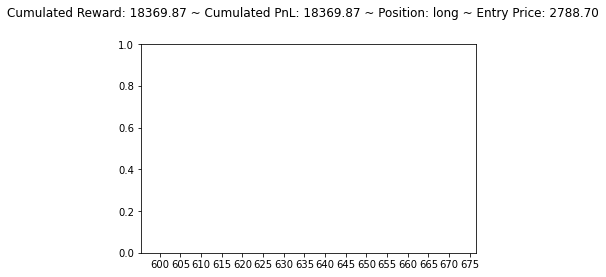

[1146.1603 1178.6969 1146.0154]
long hold long


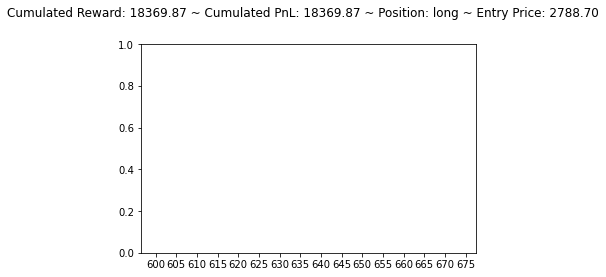

[922.1329 806.3037 856.3122]
long hold long


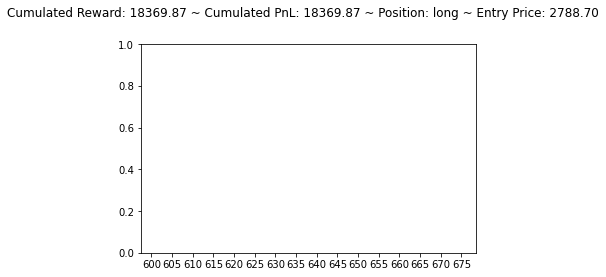

[1115.0502 1135.9419 1086.0006]
long hold long


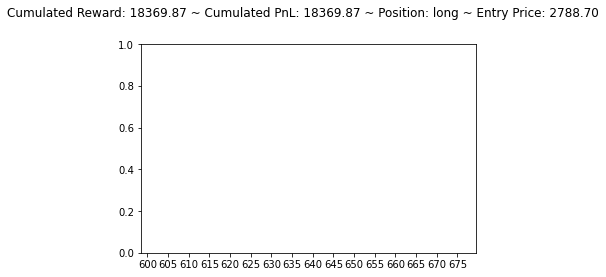

[1134.9656 1161.8651 1132.0005]
long hold long


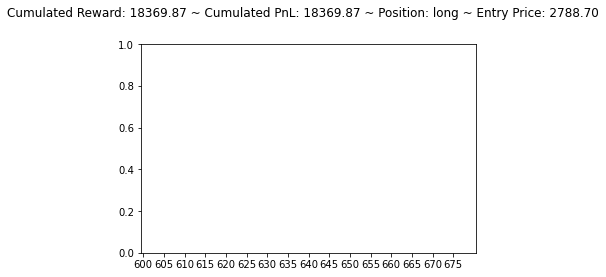

[1120.2787 1140.1084 1112.6869]
long hold long


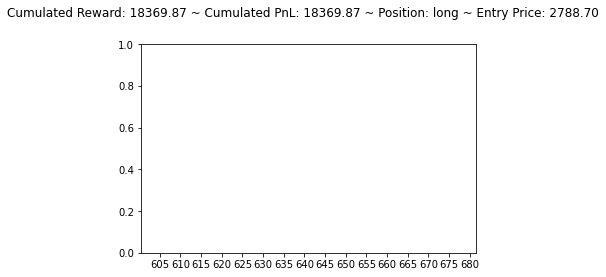

[1113.1564 1125.2859 1097.6929]
long hold long


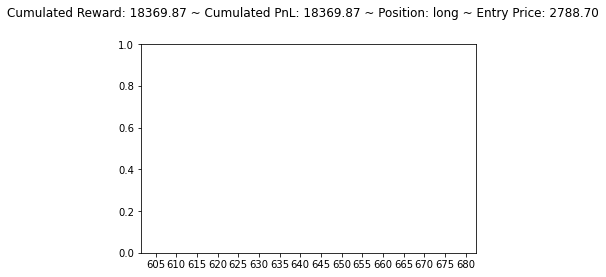

[1123.0375 1140.4752 1110.5284]
long hold long


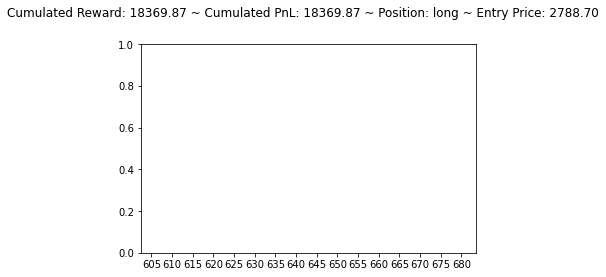

[1114.8835 1129.2678 1101.4686]
long hold long


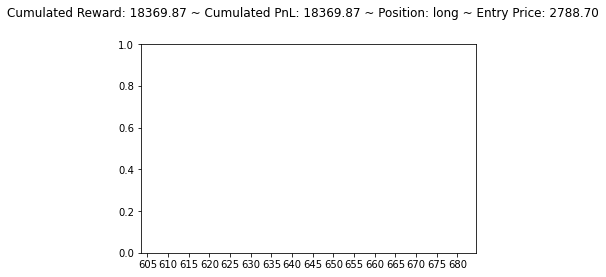

[1123.1473 1140.5692 1110.6652]
long hold long


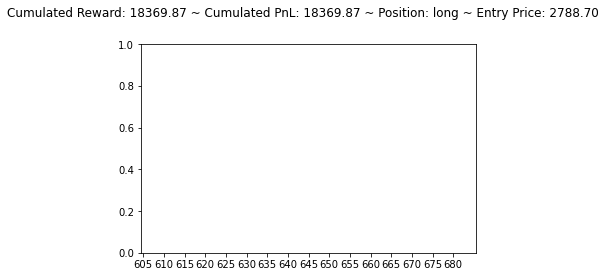

[1114.9137 1129.2815 1101.5514]
long hold long


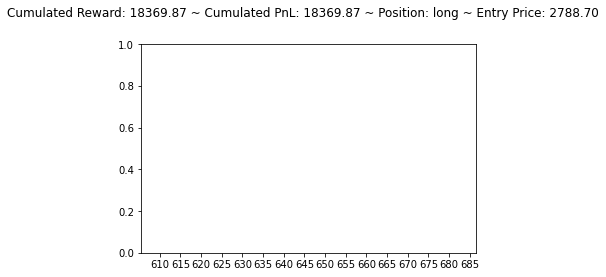

[1114.0176 1127.0582 1099.4028]
long hold long


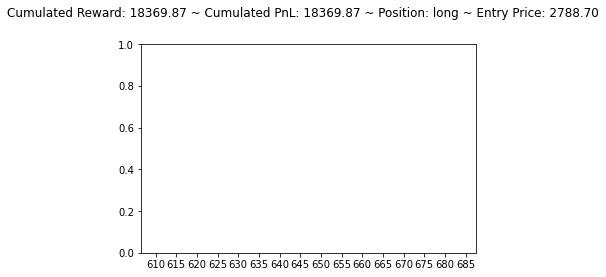

[1108.5894 1118.7092 1092.1611]
long hold long


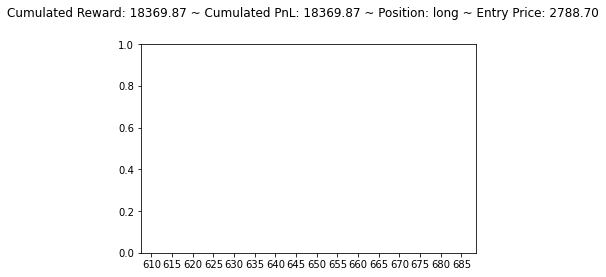

[1128.6538 1147.2657 1115.7585]
long hold long


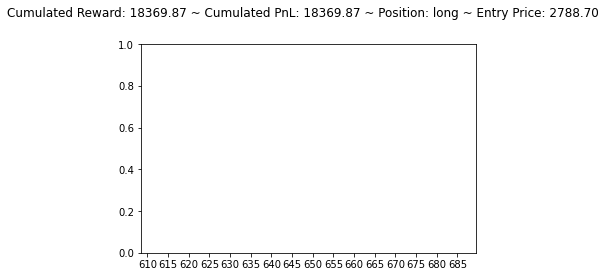

[1128.7076 1152.3973 1123.0894]
long hold long


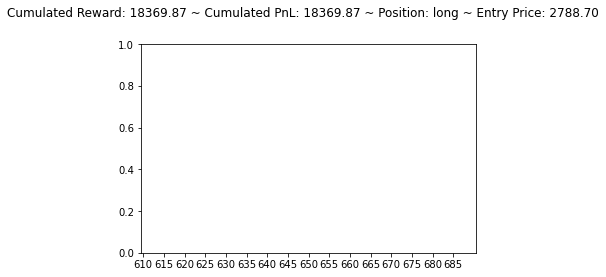

[1136.9595 1163.7009 1132.226 ]
long hold long


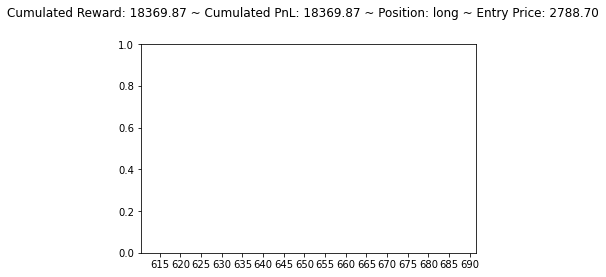

[1142.0977 1172.3002 1139.615 ]
long hold long


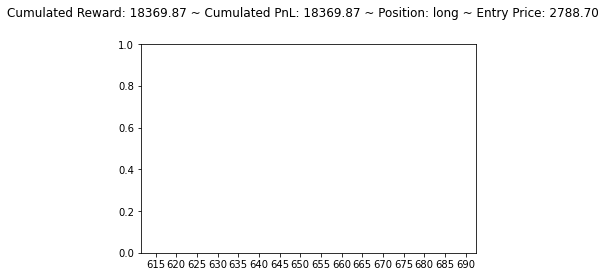

[1142.5746 1173.3112 1140.7603]
long hold long


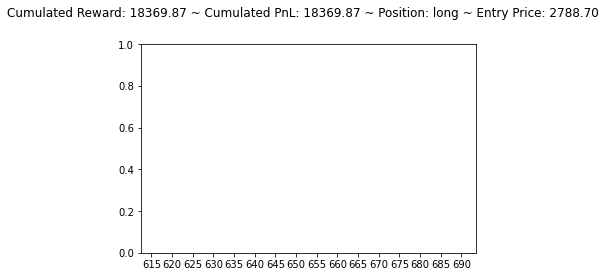

[921.0277  799.92566 851.172  ]
long hold long


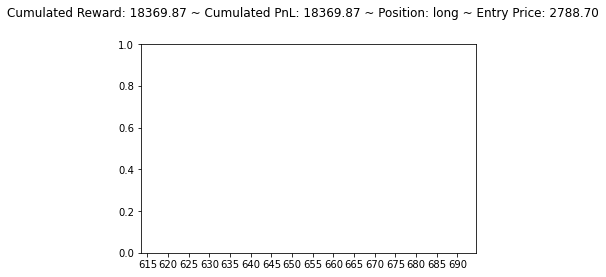

[1008.9496 1043.997  1000.0208]
long hold long


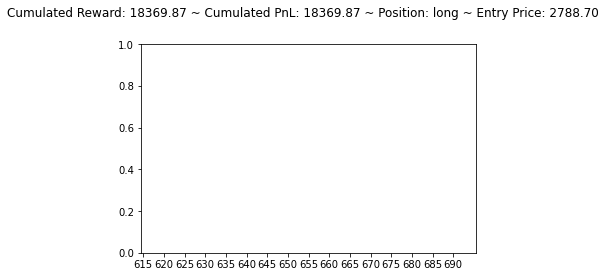

[1016.28143  987.13403  982.5057 ]
long hold long


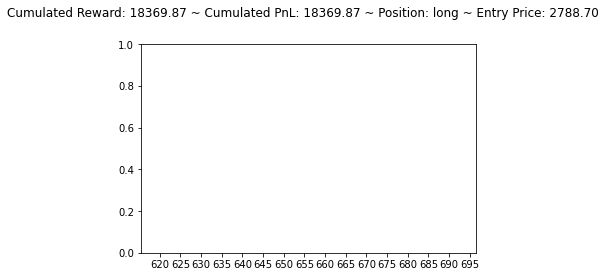

[1027.6176 1004.9349  997.8911]
long hold long


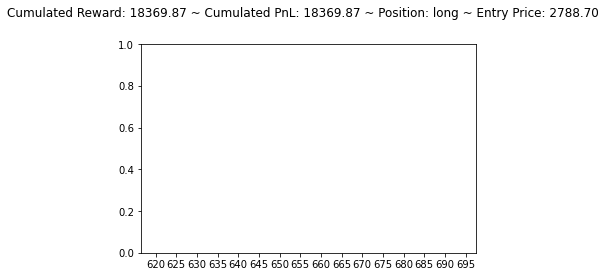

[1050.454  1025.398  1015.0155]
long hold long


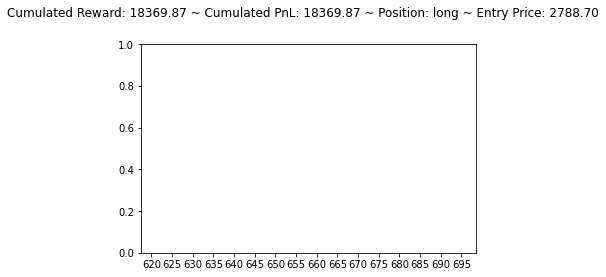

[1036.8888  1006.29517  998.32513]
long hold long


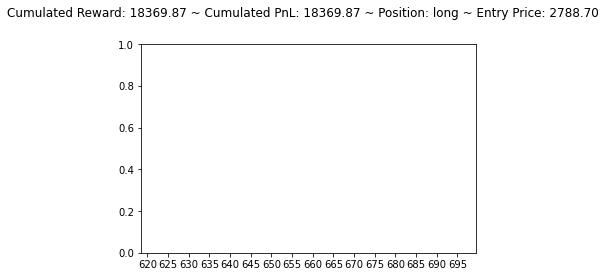

[1027.8744   996.8408   988.94434]
long hold long


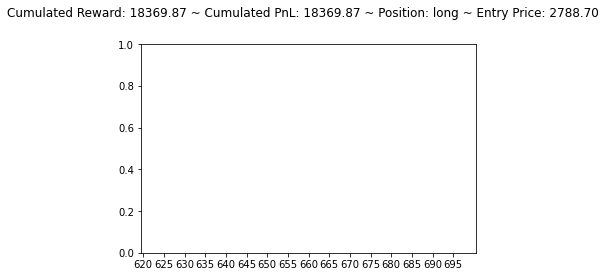

long sell flat


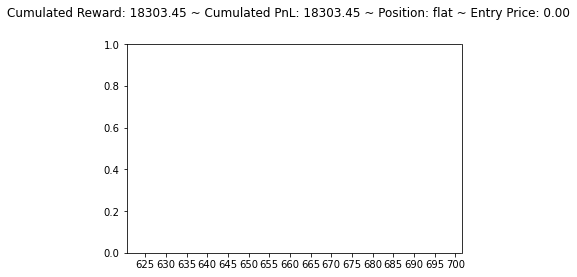

[1031.6592 1030.3087 1014.5771]
flat hold flat


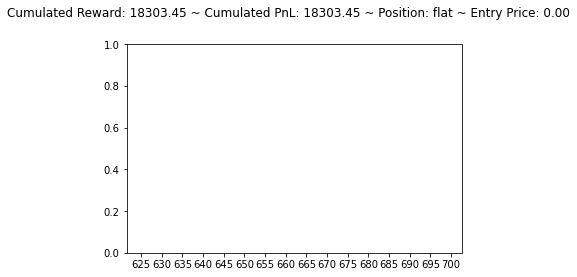

[1020.1491 1012.984  1000.9686]
flat hold flat


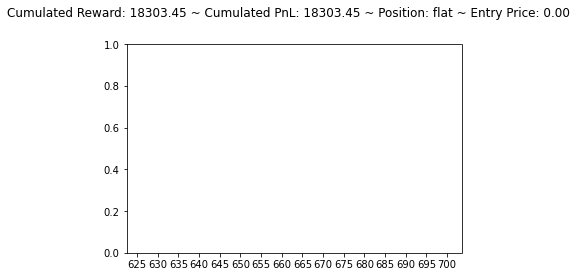

[1033.8549  1028.1227  1013.60175]
flat hold flat


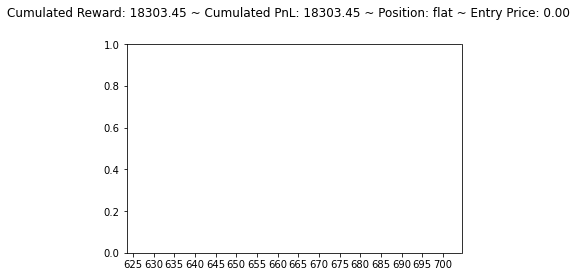

[1028.355   1023.84314 1014.0234 ]
flat hold flat


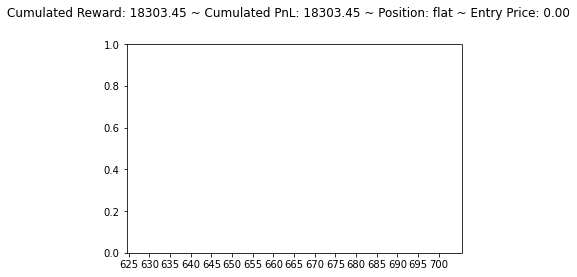

[1042.0609 1038.9819 1026.657 ]
flat hold flat


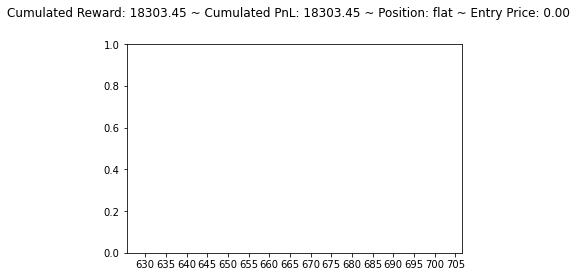

[1048.2112 1051.9912 1042.9482]
flat buy long


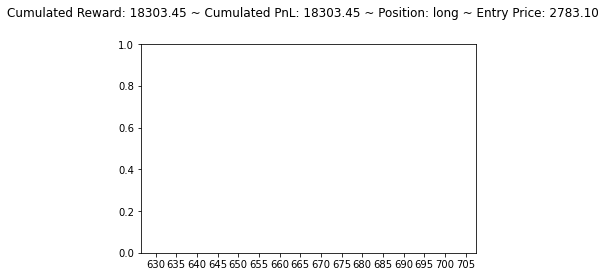

[1085.2762 1081.5779 1063.2917]
long hold long


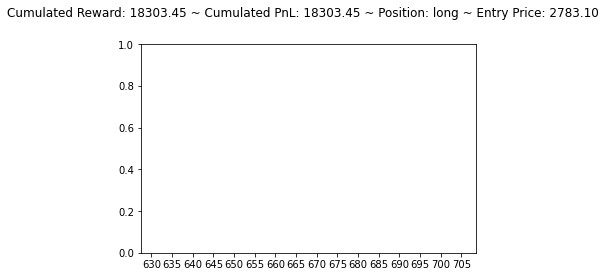

[1096.0211 1098.469  1077.8862]
long hold long


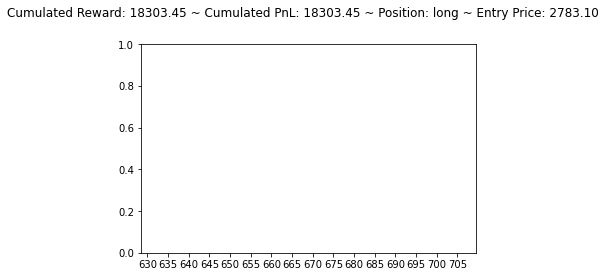

[1105.8717 1114.1871 1091.2201]
long hold long


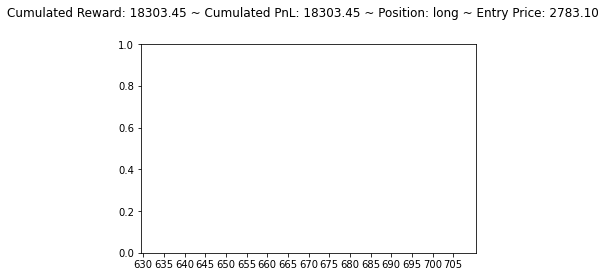

[1112.1023 1124.5009 1100.0623]
long hold long


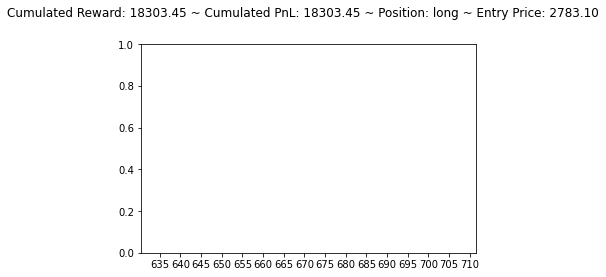

[1116.2024 1131.2297 1105.8168]
long hold long


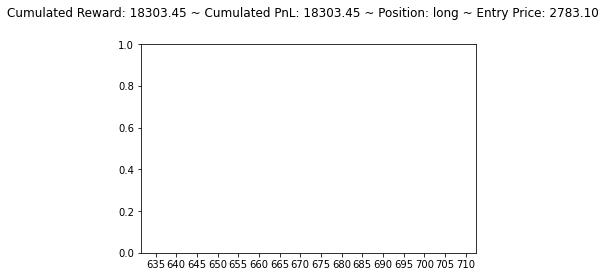

[1125.5726 1145.6238 1117.8881]
long hold long


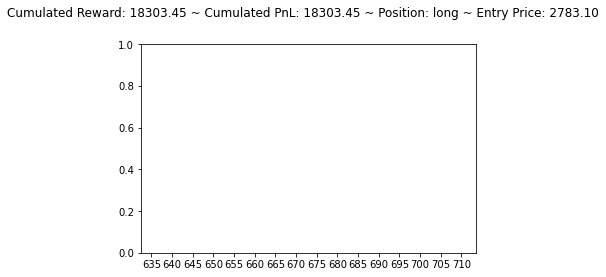

[1109.1608 1122.1715 1097.4083]
long hold long


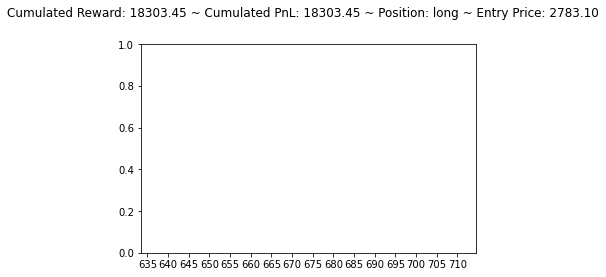

[1113.5344 1123.6106 1096.3708]
long hold long


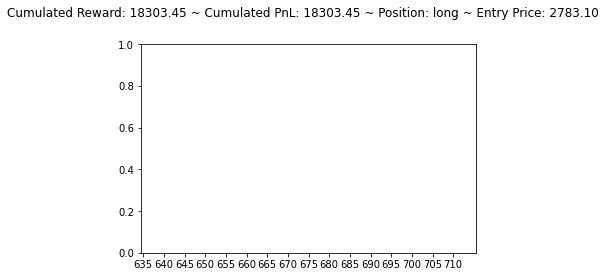

[1136.8651 1162.6157 1131.5059]
long hold long


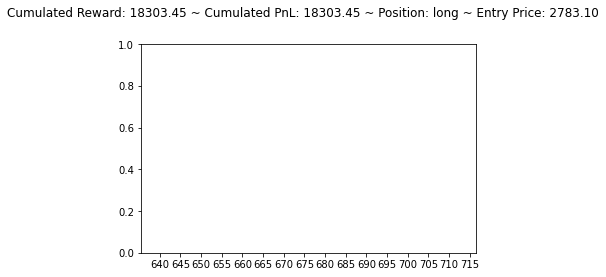

[1140.2233 1168.9438 1137.0905]
long hold long


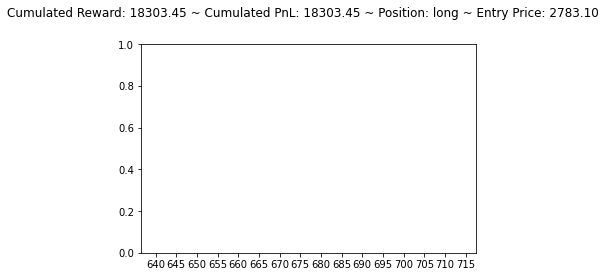

[1133.5797 1158.3607 1128.6233]
long hold long


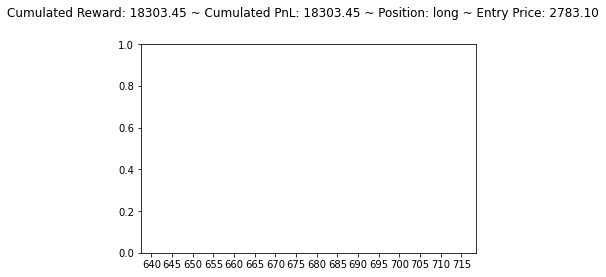

[1136.7405 1161.2556 1129.9532]
long hold long


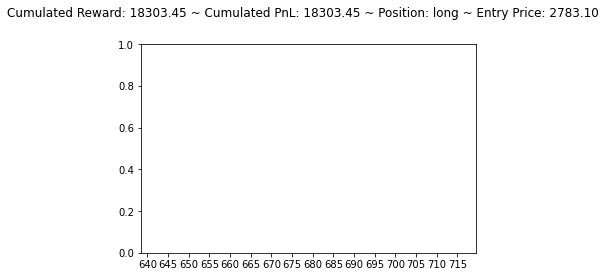

[1135.1226 1161.0222 1130.7026]
long hold long


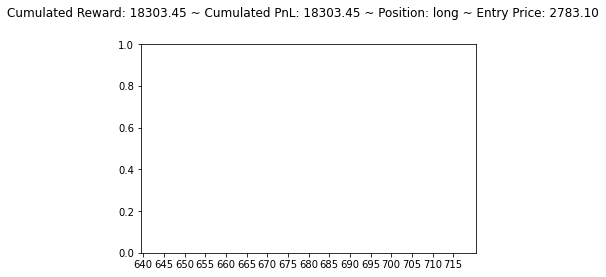

[1121.0693 1138.3352 1110.7323]
long hold long


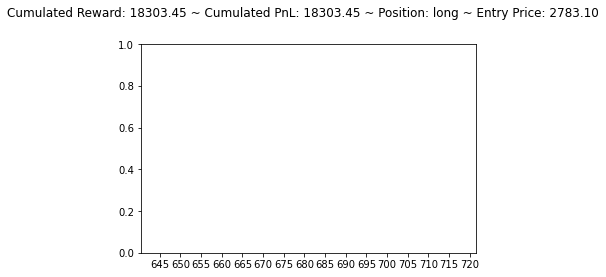

[1119.765  1135.1898 1107.8116]
long hold long


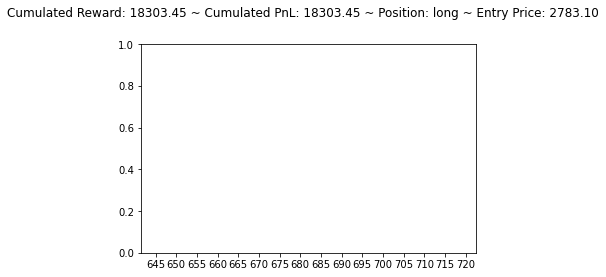

[1121.5426 1137.8037 1109.9733]
long hold long


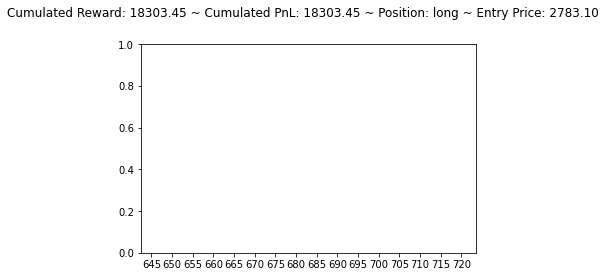

[1123.513  1140.9473 1112.64  ]
long hold long


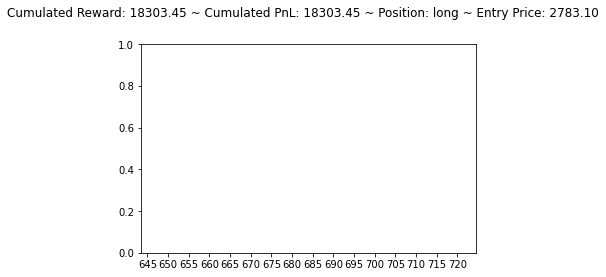

[1137.9403 1162.7042 1130.7817]
long hold long


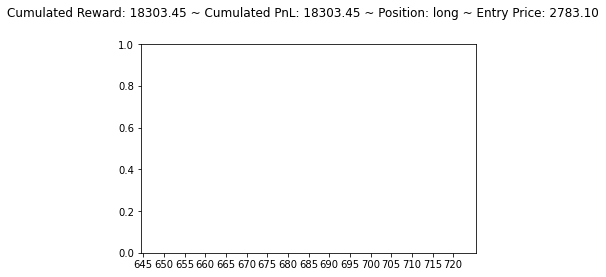

[1121.6276 1139.9647 1112.2874]
long hold long


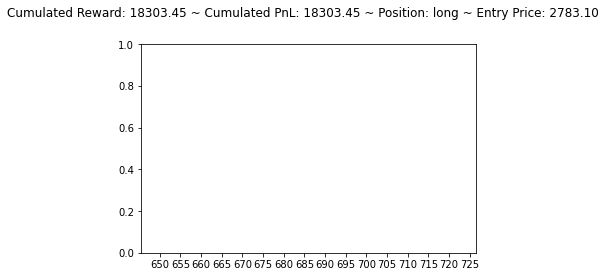

[1123.6923 1141.0876 1112.6842]
long hold long


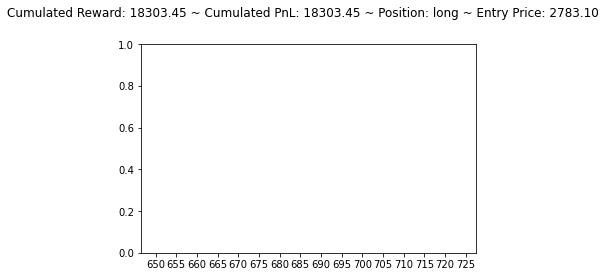

[1123.866  1141.7529 1113.3342]
long hold long


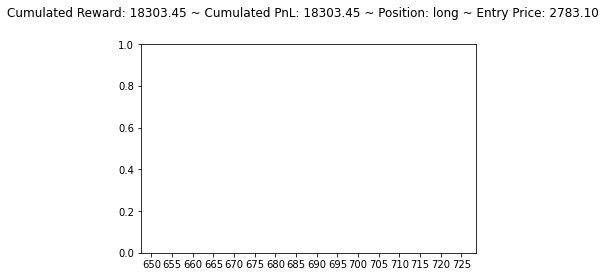

[1129.211  1149.6906 1119.9036]
long hold long


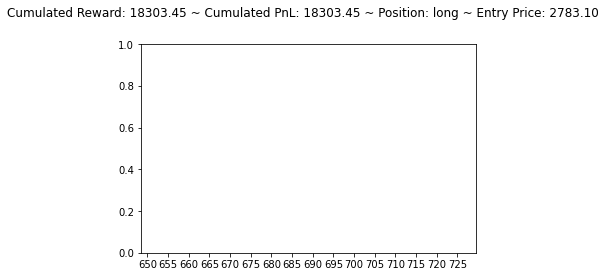

[1131.5015 1153.7173 1123.4122]
long hold long


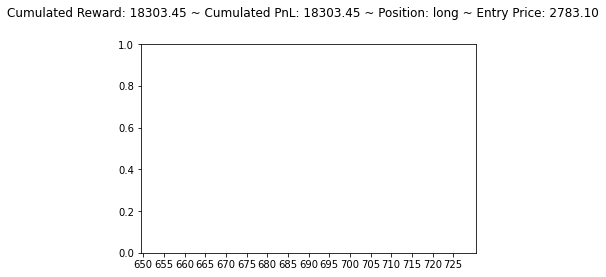

[1138.2855 1164.1694 1132.1946]
long hold long


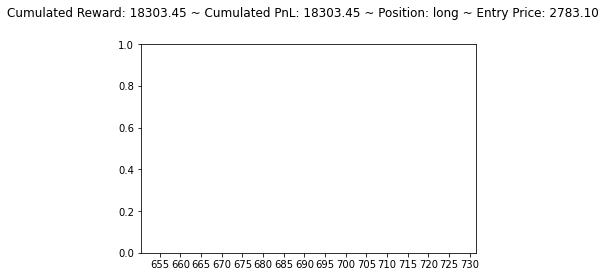

[1128.82   1150.9093 1121.0784]
long hold long


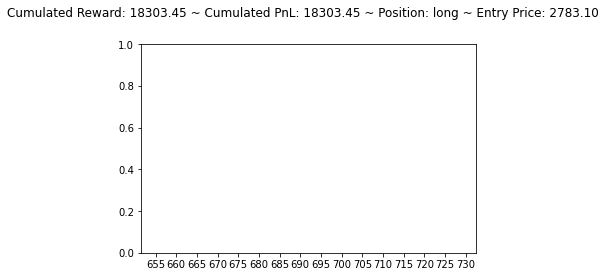

[1127.5543 1147.5293 1117.7107]
long hold long


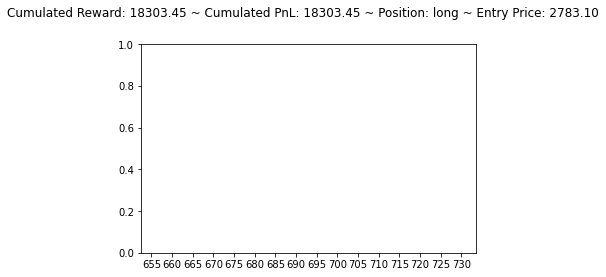

[1134.931  1158.3949 1127.5076]
long hold long


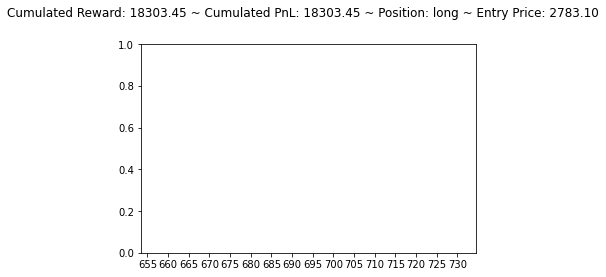

[1147.6049 1179.5726 1146.5326]
long hold long


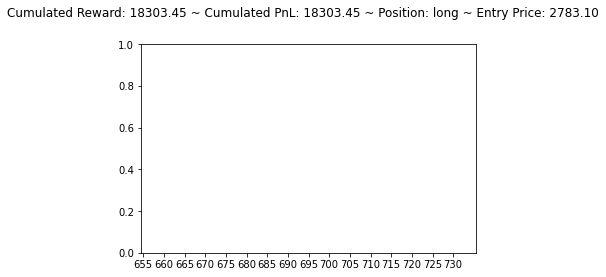

[1139.631  1168.7109 1137.5702]
long hold long


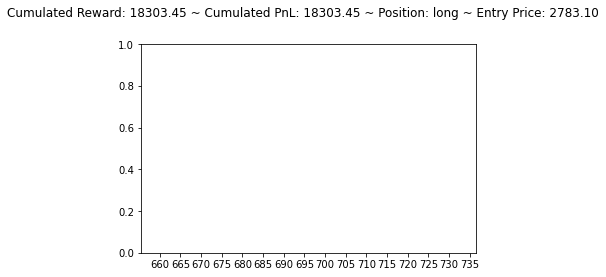

[1131.6476 1155.7764 1125.9368]
long hold long


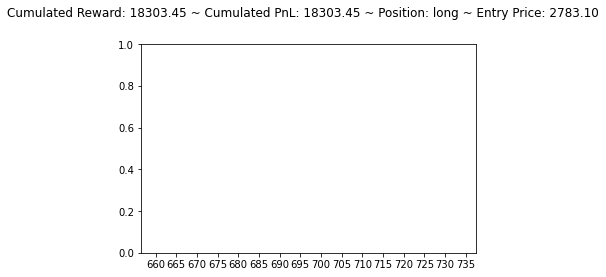

[1135.798  1159.8491 1128.1619]
long hold long


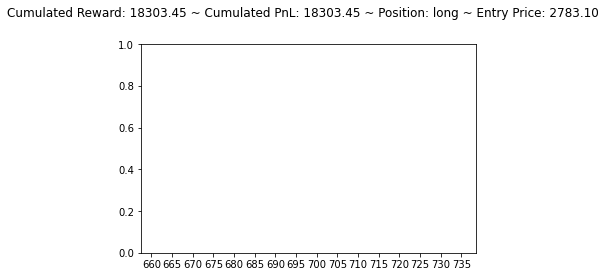

[1127.8241 1148.9872 1119.1992]
long hold long


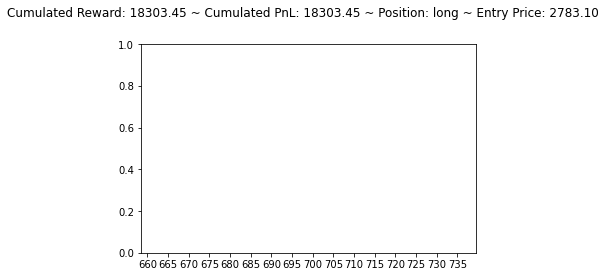

[1135.846  1159.8594 1127.917 ]
long hold long


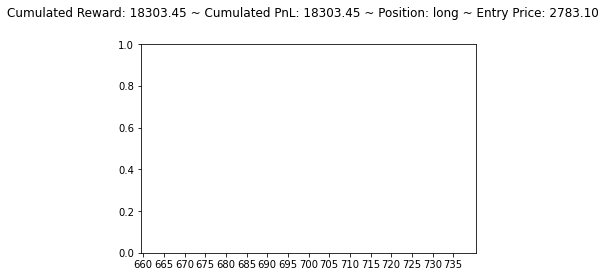

[1135.0247 1159.5917 1128.7549]
long hold long


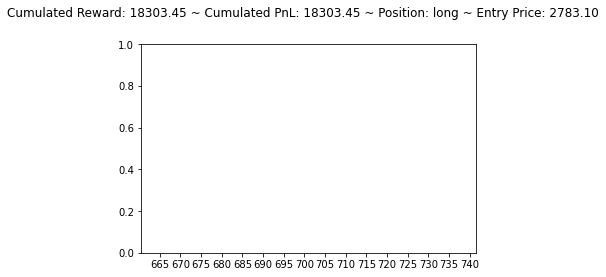

[1138.6521 1166.0791 1134.9895]
long hold long


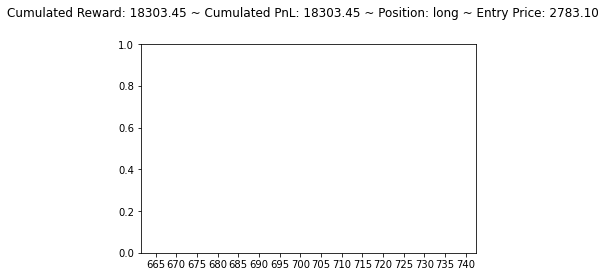

[1147.1267 1178.7855 1145.8007]
long hold long


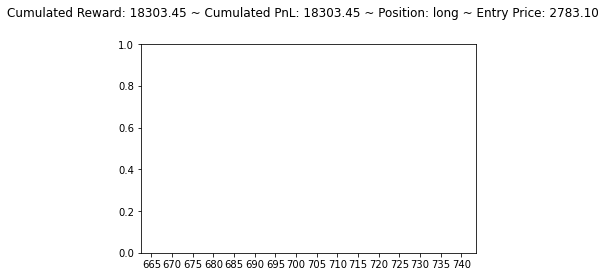

[1147.9458 1180.914  1147.5883]
long hold long


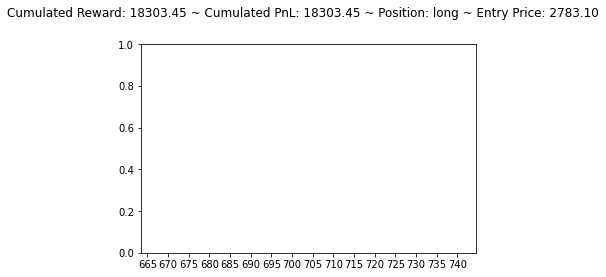

[1142.1068 1172.2218 1140.8341]
long hold long


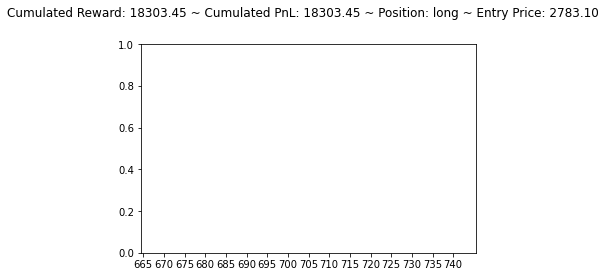

[1143.1492 1173.6794 1142.1025]
long hold long


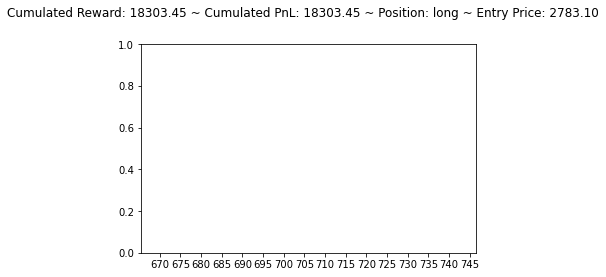

[1140.5483 1169.7617 1138.7672]
long hold long


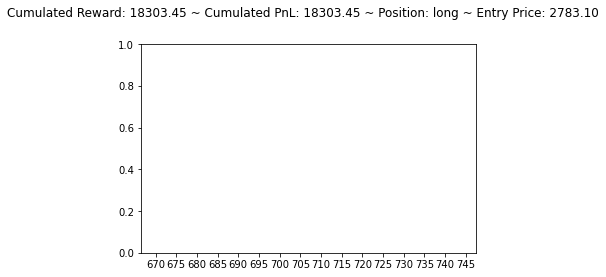

[1141.4722 1170.4708 1139.0674]
long hold long


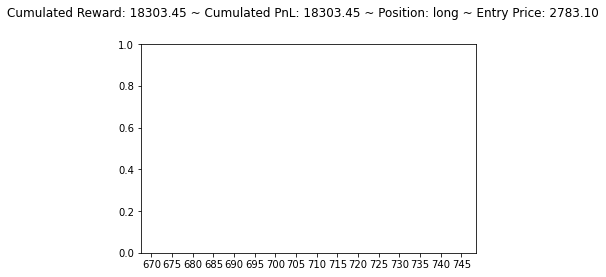

[1140.0251 1169.138  1138.1147]
long hold long


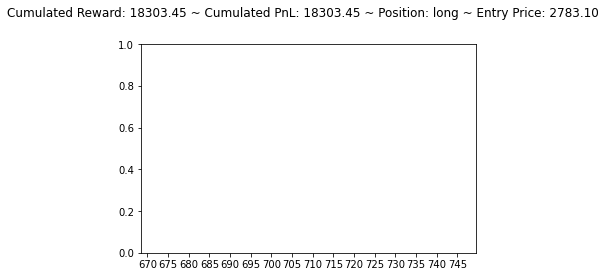

[1138.3114 1165.742  1134.7266]
long hold long


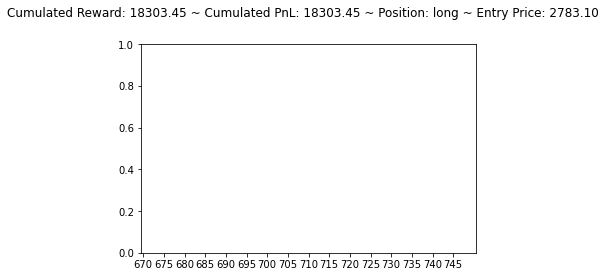

[1138.4679 1165.9036 1134.8228]
long hold long


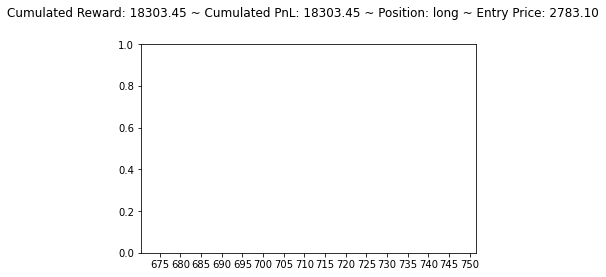

long hold long


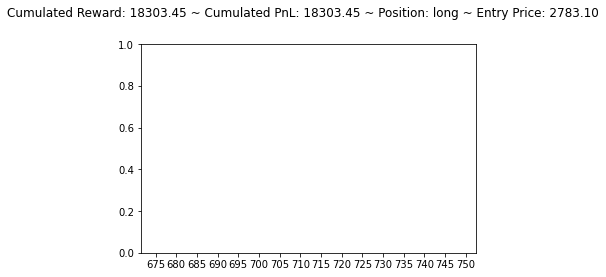

[1139.0618 1167.8452 1136.7241]
long hold long


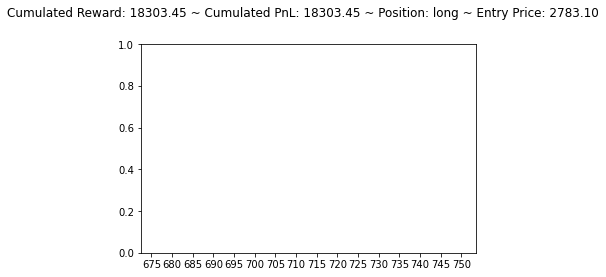

[1137.9448 1165.2024 1134.2534]
long hold long


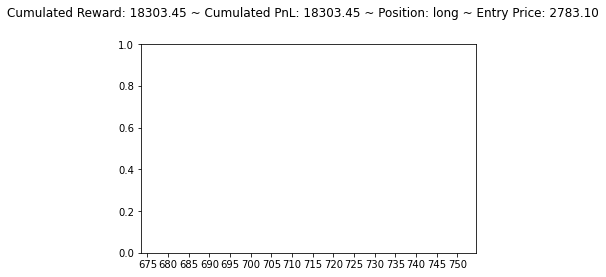

[1147.2714 1179.0596 1145.8014]
long hold long


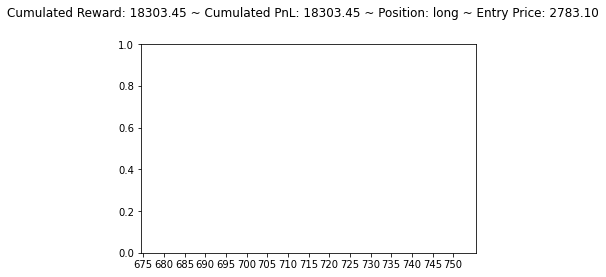

[1131.587  1156.3743 1126.6802]
long hold long


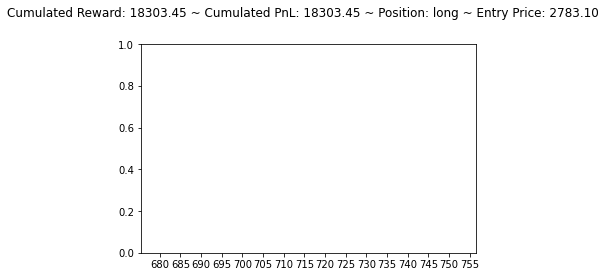

[1127.7893 1147.3475 1117.4615]
long hold long


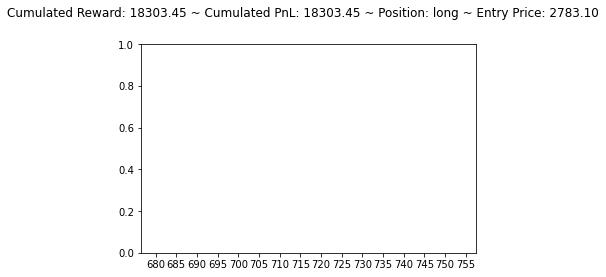

[1127.6564 1147.3542 1117.4991]
long hold long


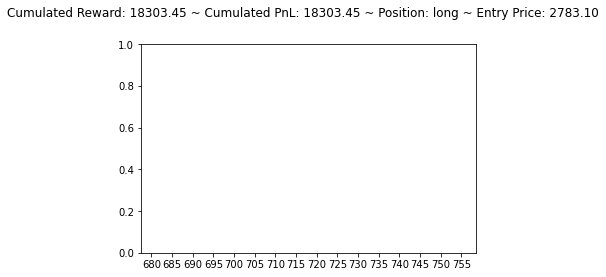

[1127.194  1146.5813 1116.7793]
long hold long


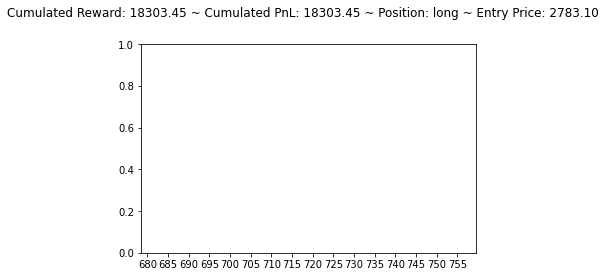

[1133.737  1156.2574 1124.7631]
long hold long


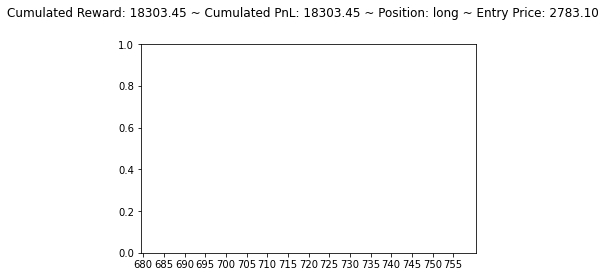

[1134.4971 1158.1444 1126.5463]
long hold long


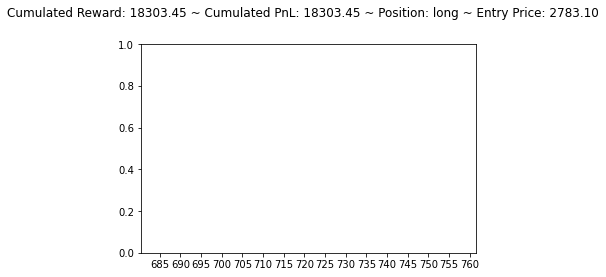

[1134.2178 1157.7542 1126.1929]
long hold long


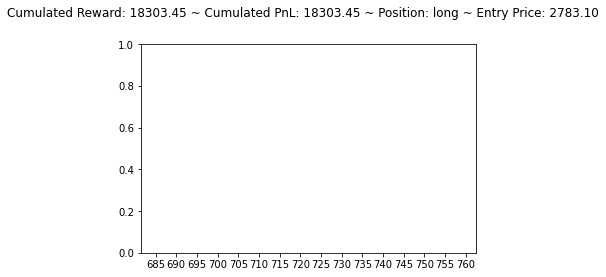

[1133.7556 1156.9812 1125.4731]
long hold long


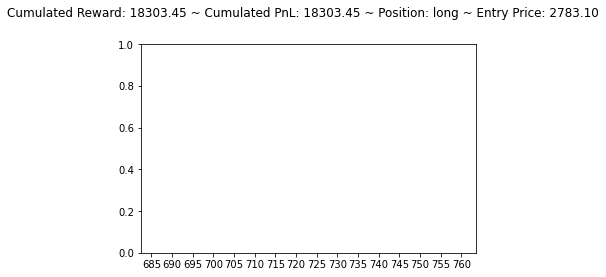

[1143.0597 1170.9951 1137.6841]
long hold long


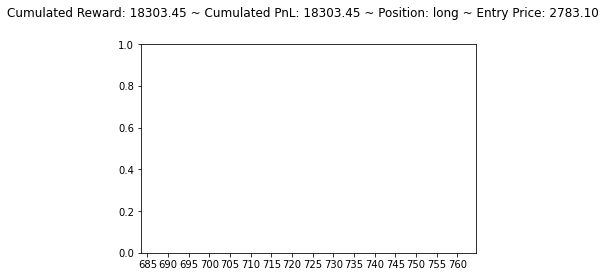

[1148.4807 1181.7316 1148.5342]
long sell flat


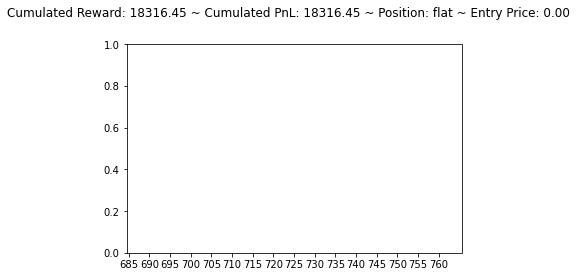

[1106.0585 1128.2483 1133.4717]
flat sell short


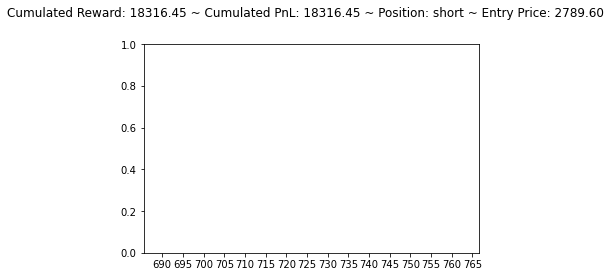

[936.52563 828.67236 875.30536]
short hold short


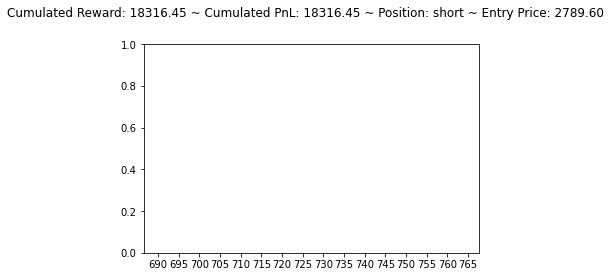

[1136.5144 1143.033  1098.2192]
short buy flat


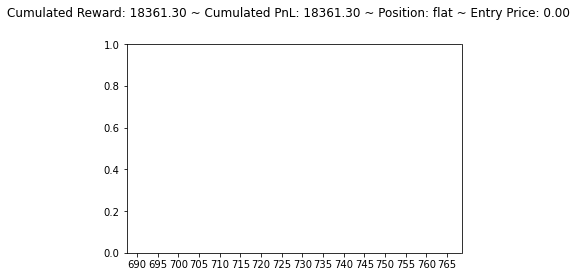

[856.1792  823.15186 835.3638 ]
flat hold flat


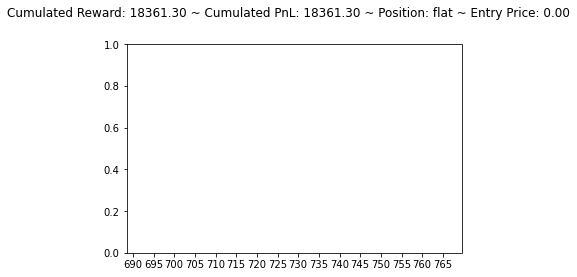

[862.0702  882.4664  886.13666]
flat sell short


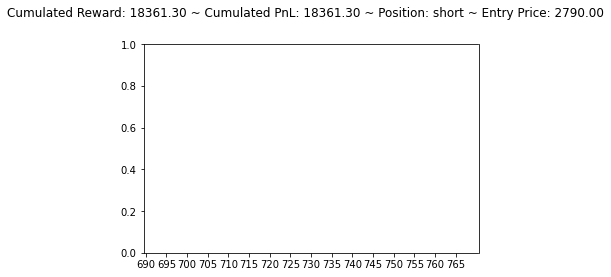

[899.46423 931.3812  907.56824]
short buy flat


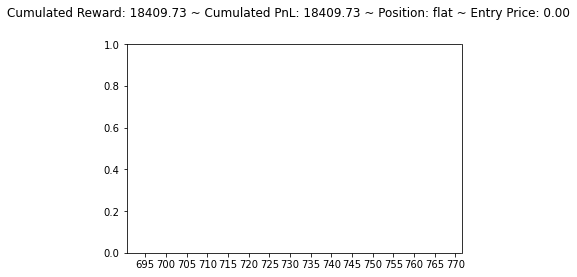

[832.1621  835.37714 844.7895 ]
flat sell short


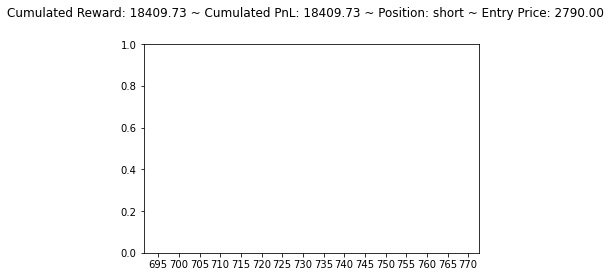

[878.95654 902.0037  880.7912 ]
short buy flat


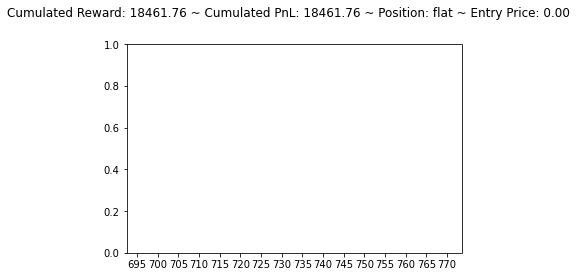

[835.7758  840.1541  848.71295]
flat sell short


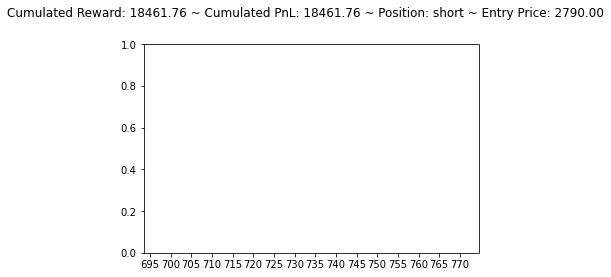

[881.9204  909.7554  887.26447]
short buy flat


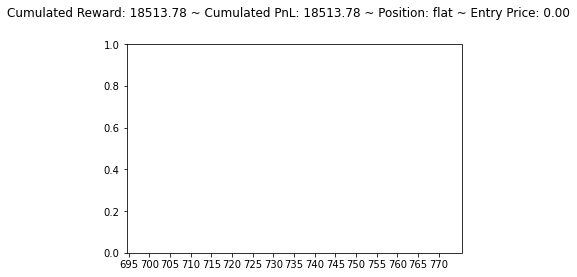

[1097.9962 1128.0039 1075.2628]
flat buy long


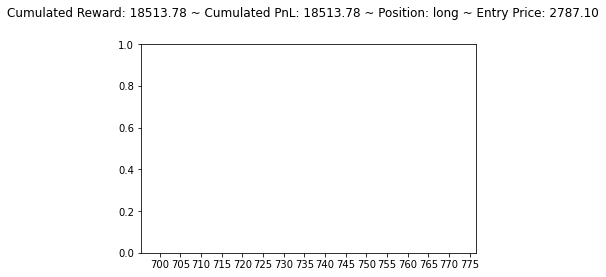

[1136.5565 1164.7008 1133.7485]
long hold long


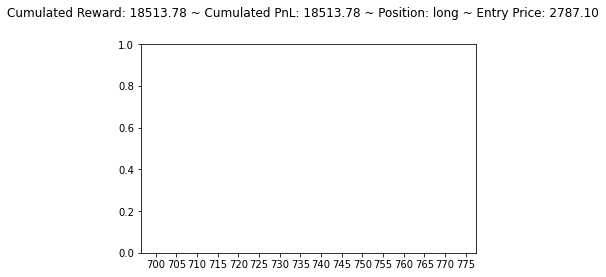

long sell flat


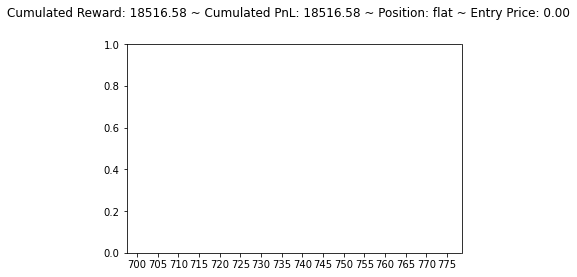

[1098.2344 1112.4484 1116.9731]
flat sell short


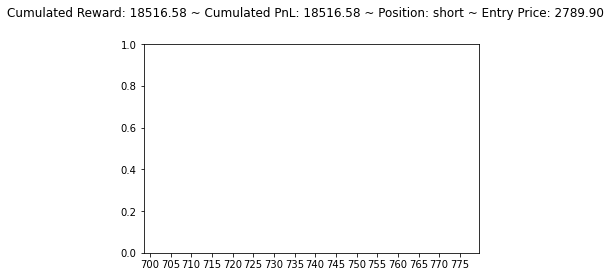

[937.6093 829.2445 875.3795]
short hold short


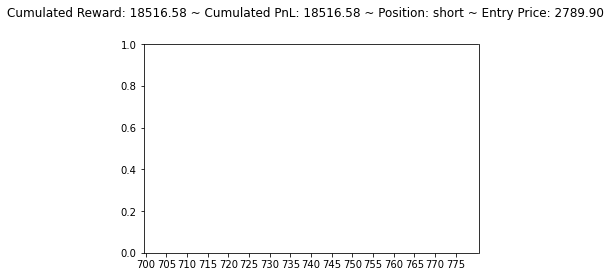

[ 961.39996 1003.6485   967.72437]
short buy flat


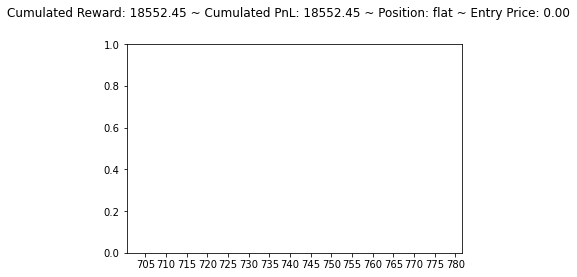

[955.43506 955.8856  925.582  ]
flat buy long


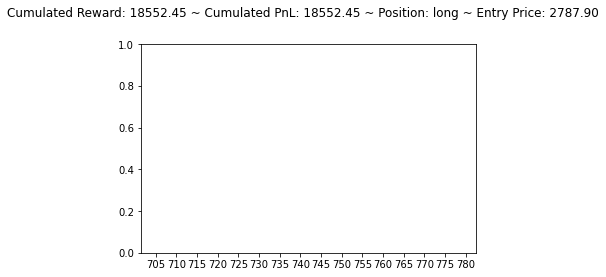

[1135.4473 1144.9575 1113.1891]
long hold long


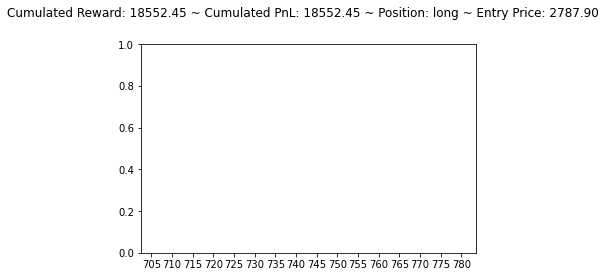

[1148.9397 1182.3501 1148.8481]
long hold long


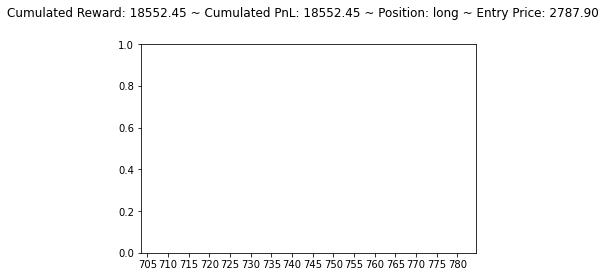

[999.13635 960.5758  964.77875]
long hold long


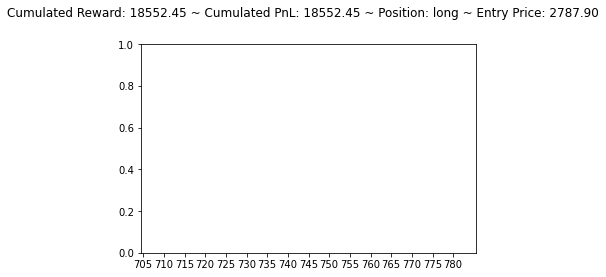

[1118.2194 1119.7601 1092.3817]
long hold long


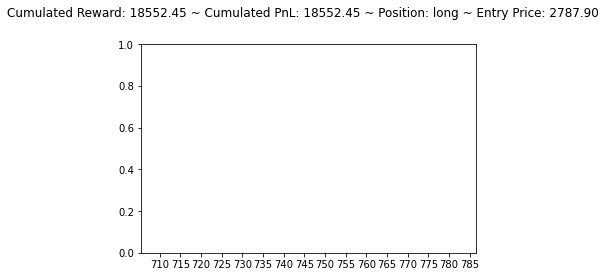

[1129.9009 1152.1467 1123.2054]
long hold long


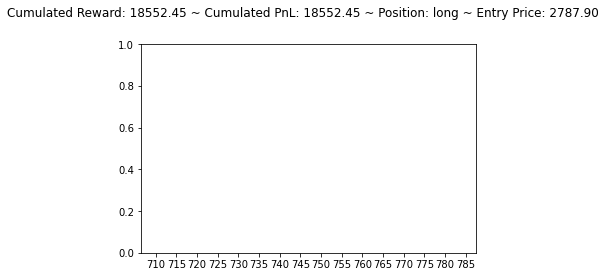

[1129.6637 1151.8064 1123.0177]
long hold long


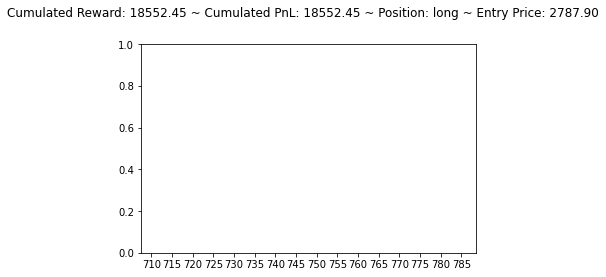

[1132.5591 1156.161  1126.6841]
long hold long


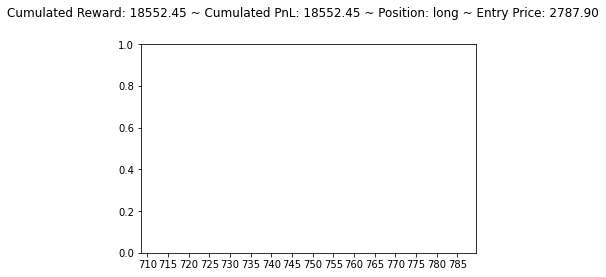

[1119.6095 1137.7963 1110.8785]
long hold long


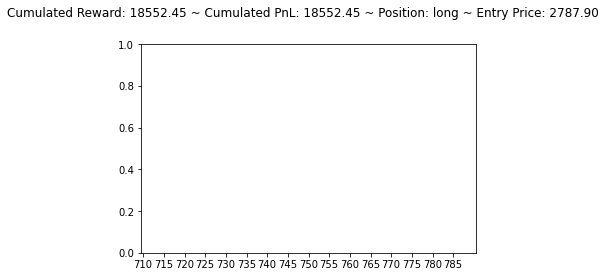

[1124.2704 1140.8733 1110.3627]
long hold long


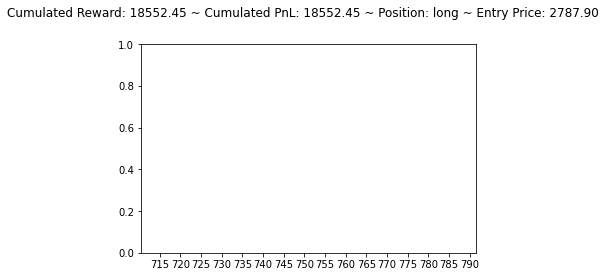

[1138.2694 1162.5487 1129.6011]
long hold long


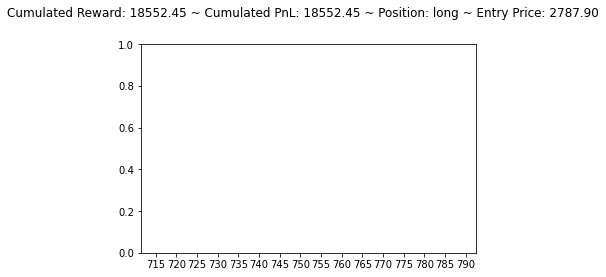

[1150.7169 1185.1421 1151.3423]
long sell flat


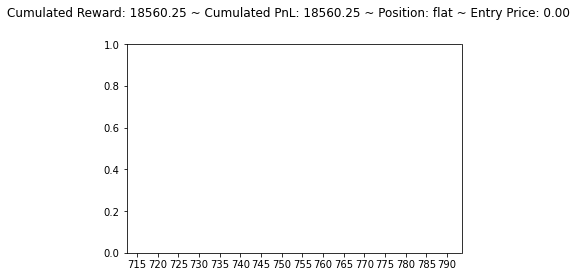

[1106.8053 1131.1805 1136.1315]
flat sell short


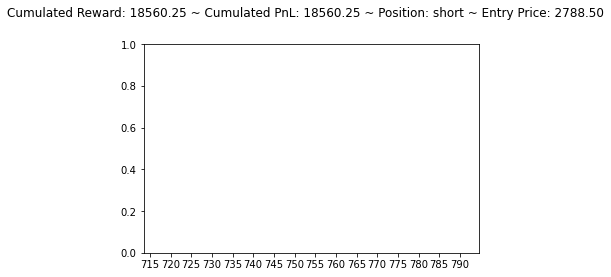

[1149.0143 1183.2358 1150.2521]
short buy flat


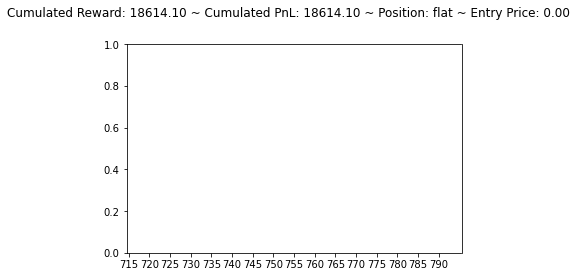

[1124.3813 1155.8694 1158.1558]
flat sell short


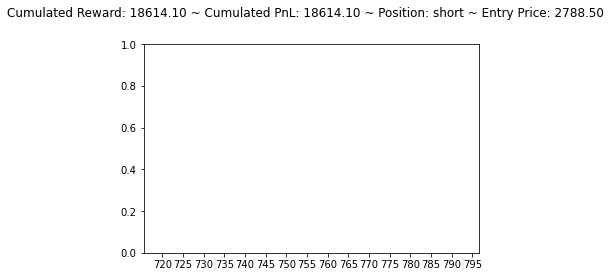

[1161.5256 1208.8269 1175.9619]
short buy flat


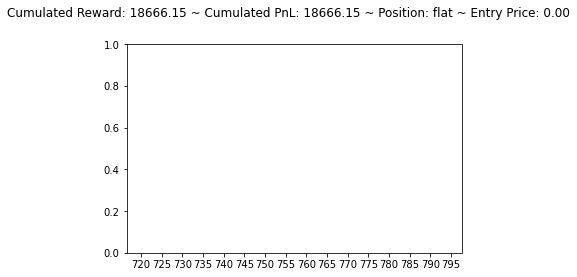

[1103.301  1124.299  1128.9648]
flat sell short


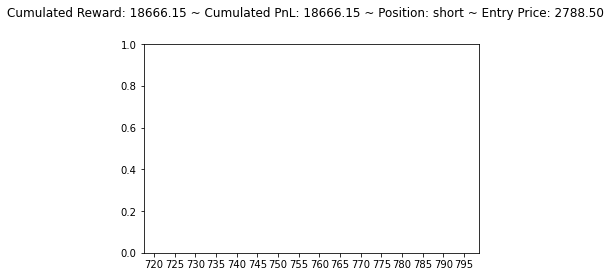

[1126.6783 1149.5381 1121.5535]
short buy flat


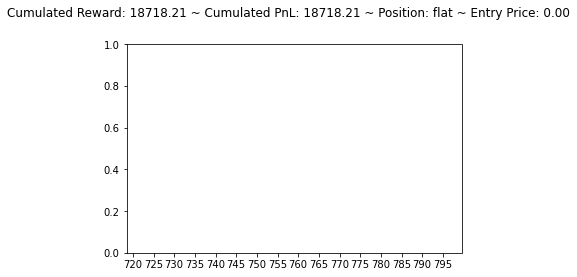

[1076.3851 1085.3875 1087.2235]
flat sell short


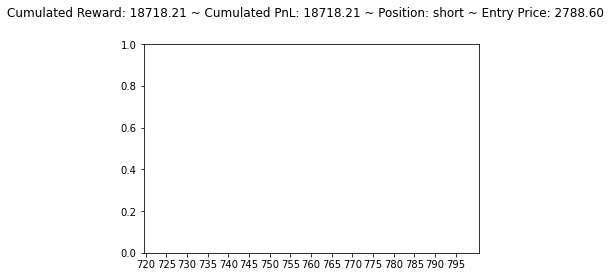

[1115.2292 1126.8938 1099.4507]
short buy flat


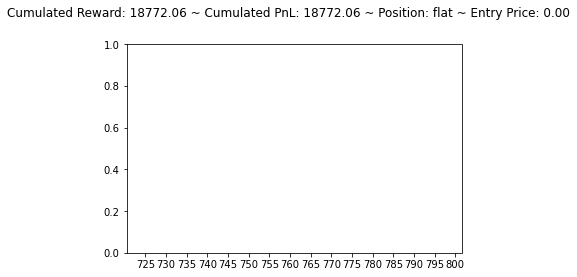

[1076.1292 1083.5269 1085.522 ]
flat sell short


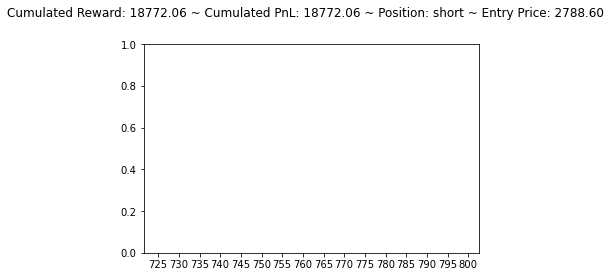

[1139.1615 1162.6106 1130.9445]
short buy flat


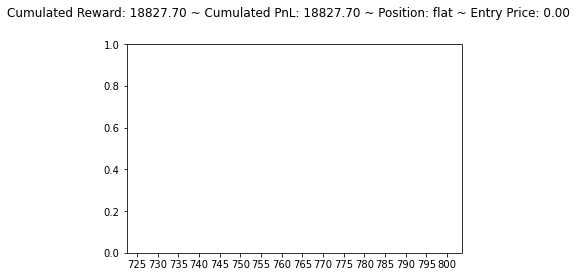

[1104.4983 1132.3898 1133.8293]
flat sell short


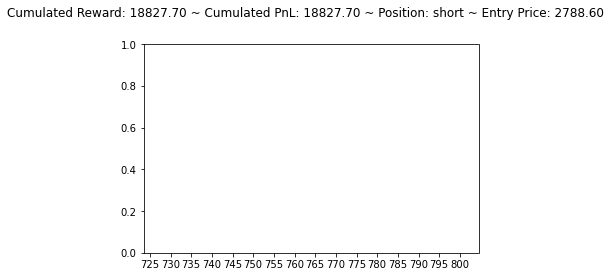

[1147.8188 1182.0996 1151.1016]
short buy flat


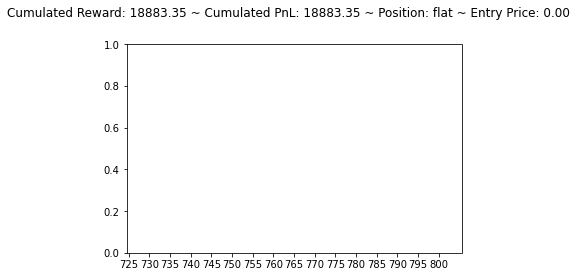

[1106.3972 1133.2717 1134.7053]
flat sell short


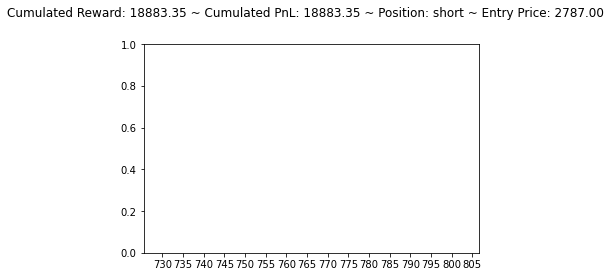

[1153.4608 1190.6489 1157.7661]
short buy flat


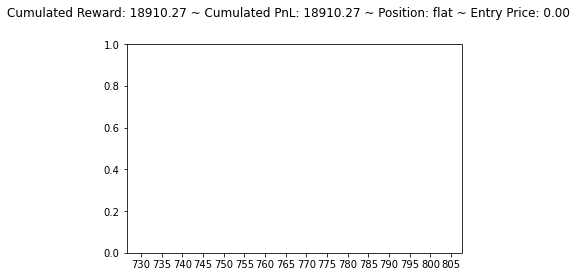

[1104.0056 1129.5151 1132.8496]
flat sell short


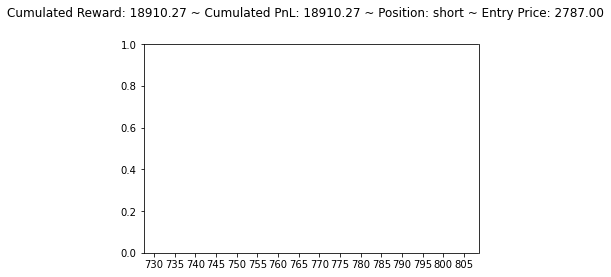

[1147.2876 1180.5764 1148.4813]
short buy flat


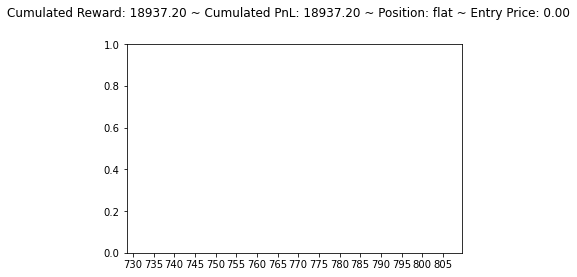

[1097.1681 1118.114  1121.7513]
flat sell short


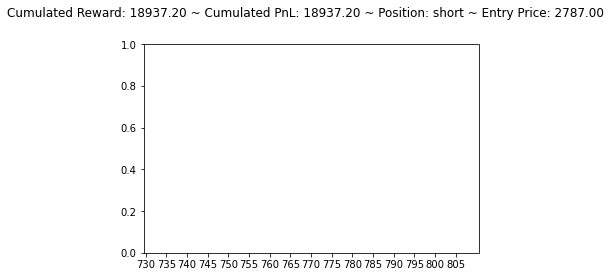

[1141.6548 1170.3816 1138.479 ]
short buy flat


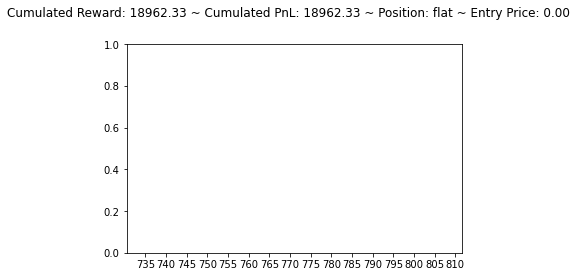

[1102.2167 1123.3209 1127.2612]
flat sell short


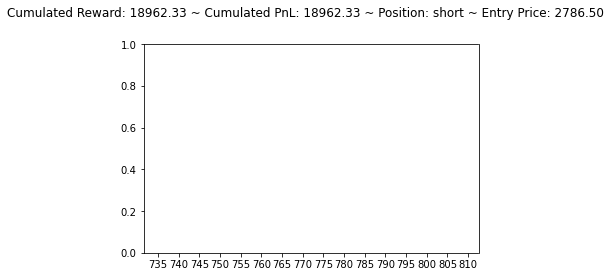

[1139.9551 1168.6644 1137.2203]
short buy flat


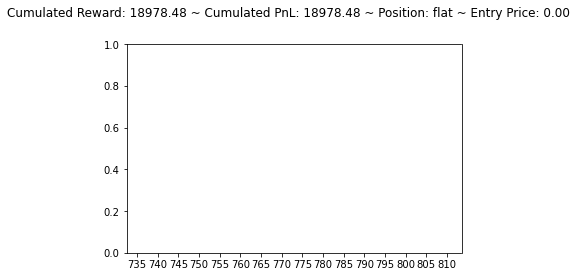

[1095.7552 1114.4746 1117.9072]
flat sell short


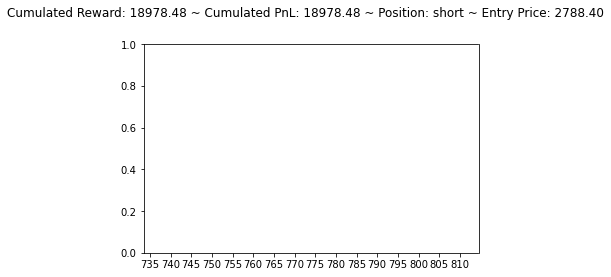

[1139.6521 1167.3197 1136.0232]
short buy flat


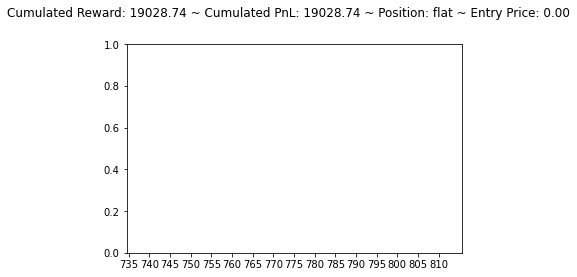

[1097.353  1116.6196 1120.163 ]
flat sell short


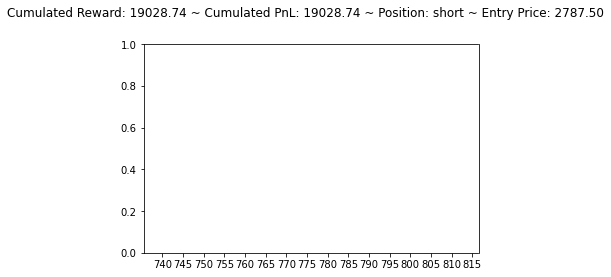

[1137.891  1164.9917 1134.0771]
short buy flat


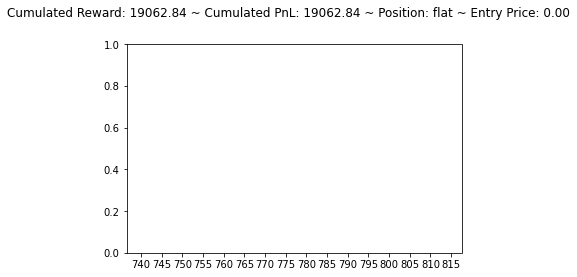

[1097.8678 1117.9163 1120.4714]
flat sell short


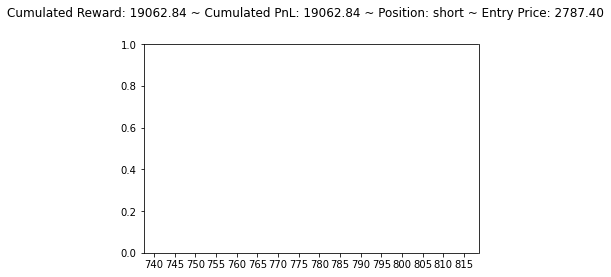

[1140.4873 1169.8342 1138.916 ]
short buy flat


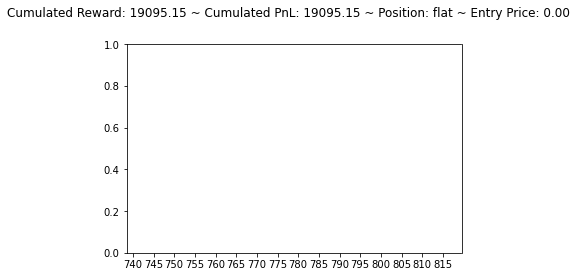

[1094.2726 1112.5592 1115.5326]
flat sell short


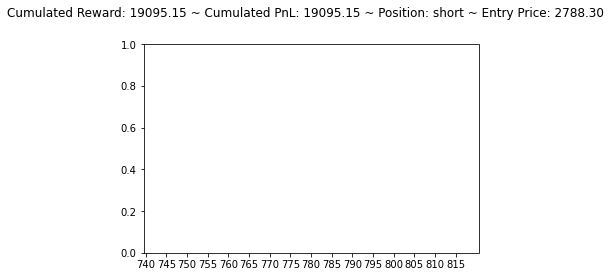

[1140.1565 1167.9075 1136.4711]
short buy flat


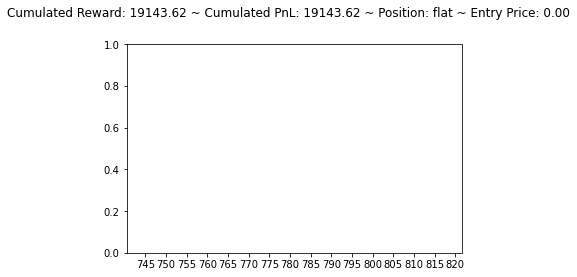

[1100.0278 1120.7524 1123.9136]
flat sell short


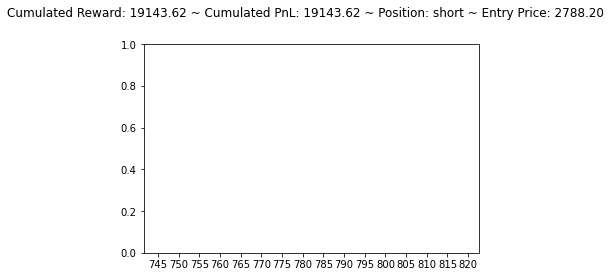

[1140.8453 1170.6553 1139.4519]
short buy flat


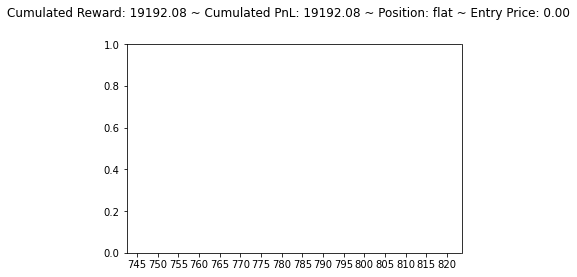

[1096.0044 1113.6007 1117.2913]
flat sell short


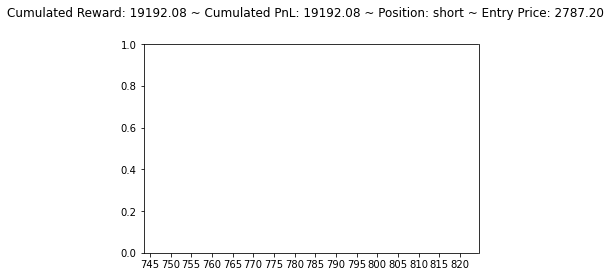

[1148.0372 1180.2128 1146.7386]
short buy flat


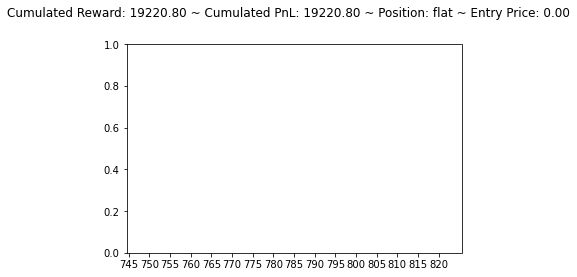

[1103.2831 1124.4272 1129.8197]
flat sell short


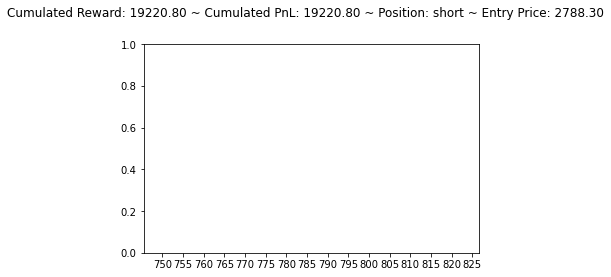

[1148.6552 1181.6814 1148.169 ]
short buy flat


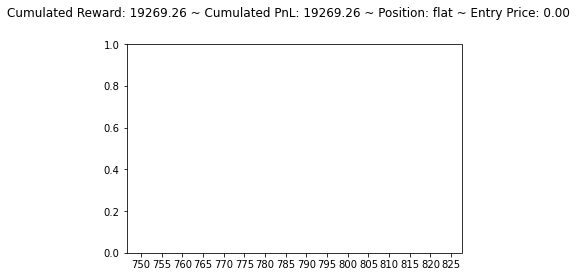

[1097.3497 1116.2432 1121.8962]
flat sell short


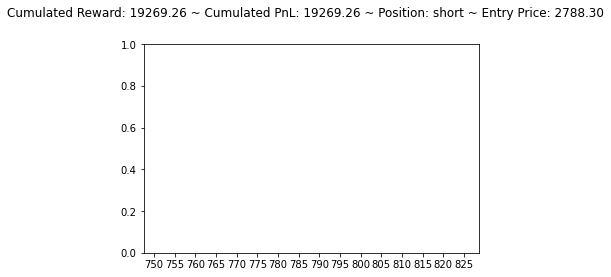

[1140.0144 1168.0176 1136.593 ]
short buy flat


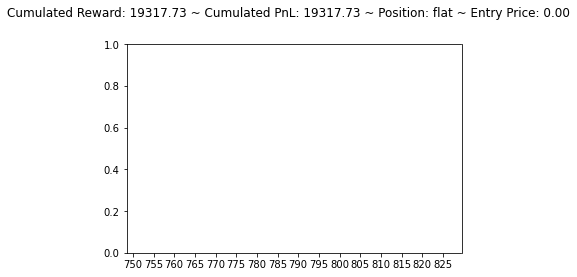

[1095.743  1114.3113 1117.9587]
flat sell short


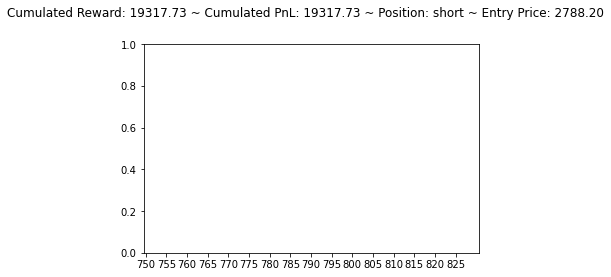

[1141.1099 1169.4452 1137.6866]
short buy flat


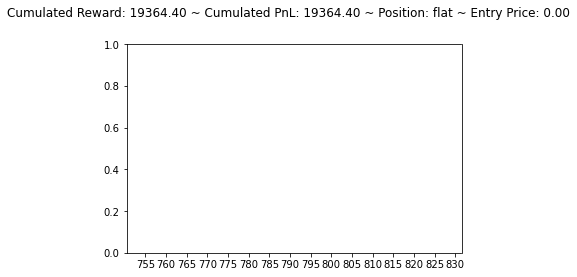

[1102.7611 1123.741  1127.659 ]
flat sell short


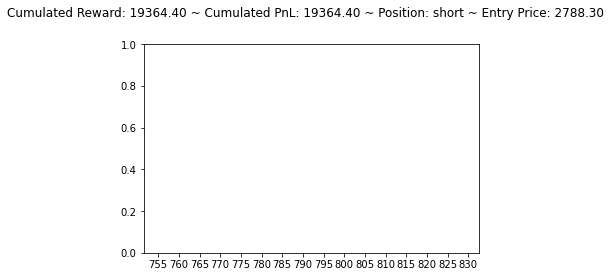

[1141.9884 1171.6521 1139.7695]
short buy flat


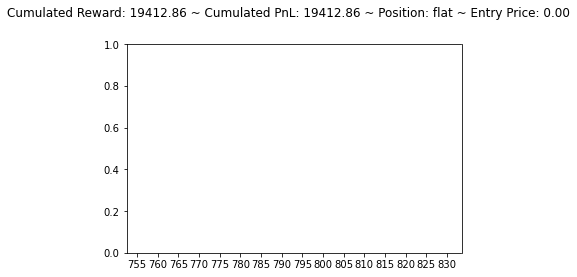

[1094.5103 1112.2336 1116.581 ]
flat sell short


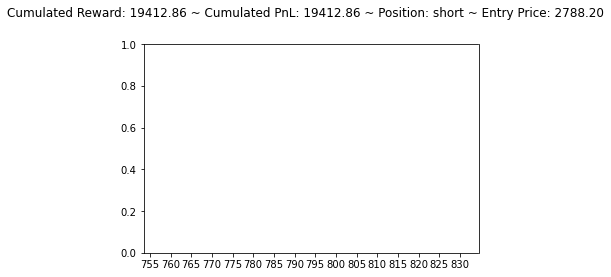

[1142.6678 1171.0542 1138.2189]
short buy flat


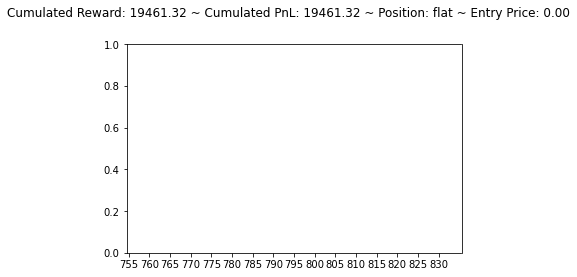

[1098.5013 1116.3684 1122.09  ]
flat sell short


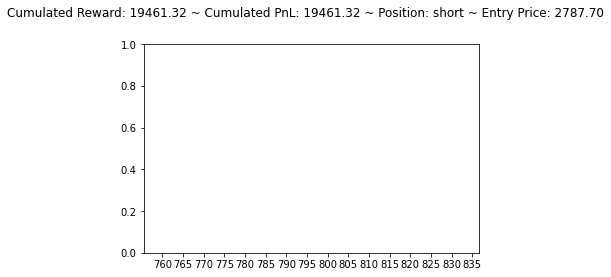

[1146.4801 1177.3694 1143.8846]
short buy flat


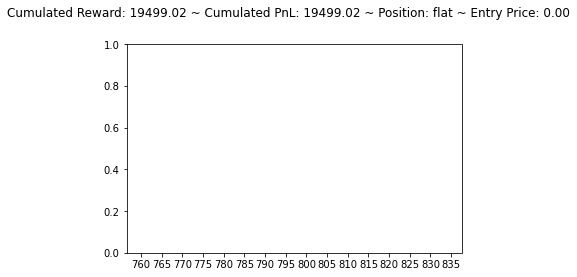

[1093.246  1110.7971 1116.4197]
flat sell short


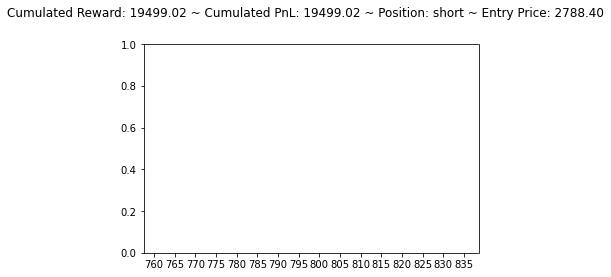

[1136.0164 1161.6045 1130.9127]
short buy flat


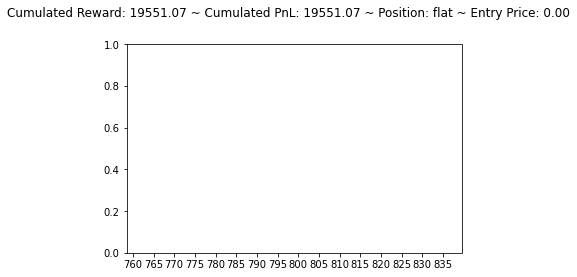

[1091.2501 1106.7385 1110.4131]
flat sell short


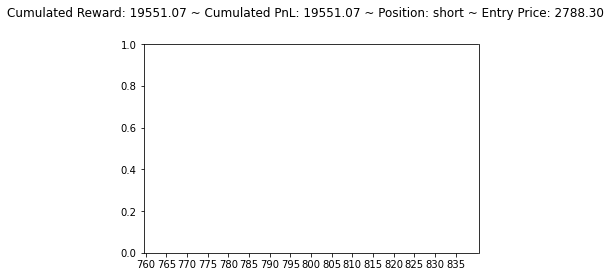

[1141.812  1169.5555 1136.8989]
short buy flat


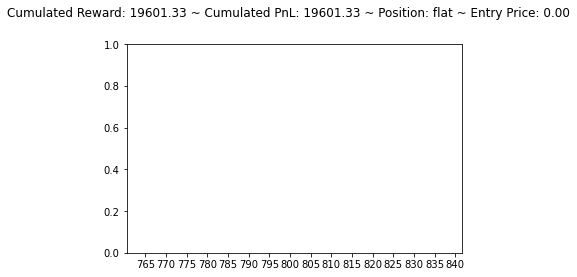

[1098.1934 1115.9125 1121.4719]
flat sell short


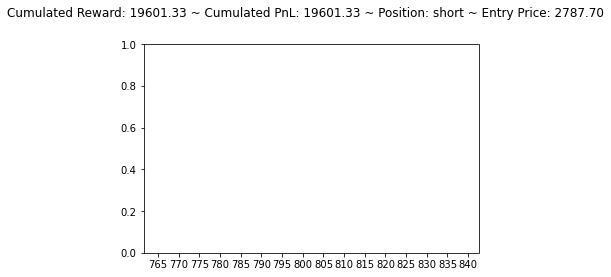

[1142.2794 1171.096  1138.3213]
short buy flat


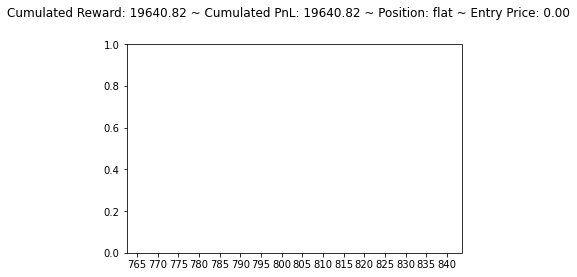

[1092.4303 1108.0026 1113.6569]
flat sell short


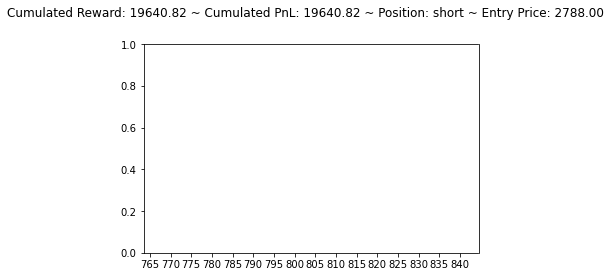

[1134.4738 1158.7135 1127.8627]
short buy flat


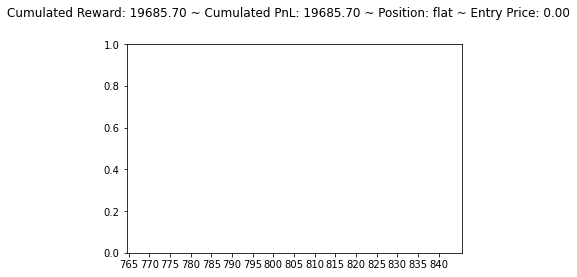

[1098.0543 1115.8665 1119.5637]
flat sell short


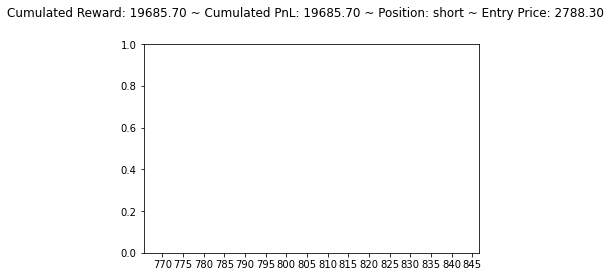

[1146.3484 1177.0791 1143.6395]
short buy flat


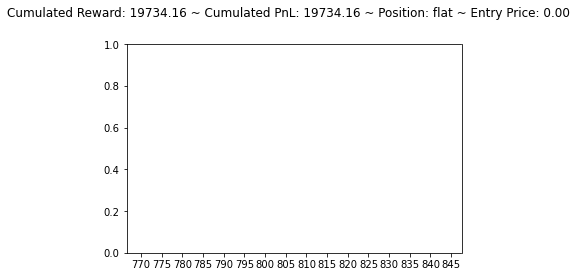

[1091.9005 1108.6066 1114.581 ]
flat sell short


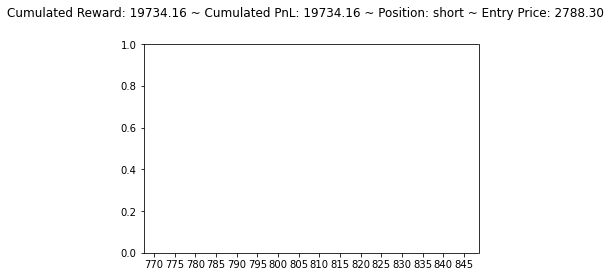

[1135.0405 1159.3025 1128.2783]
short buy flat


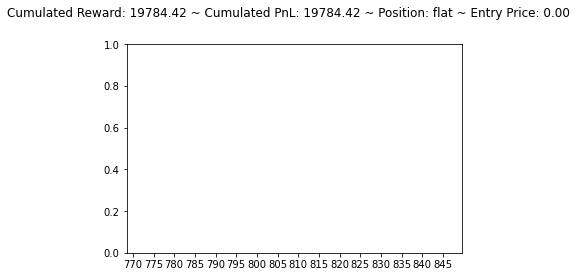

[1092.0221 1107.4822 1111.5923]
flat sell short


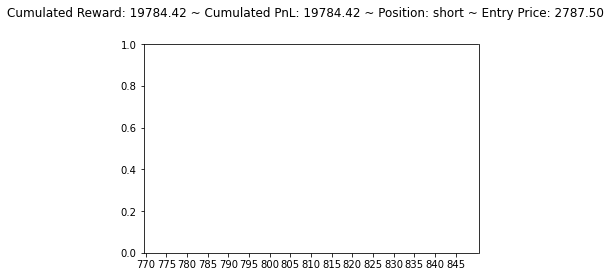

[1139.3097 1165.8152 1133.9434]
short buy flat


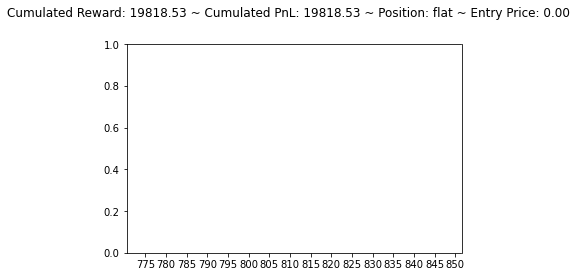

[1093.7448 1111.31   1115.7288]
flat sell short


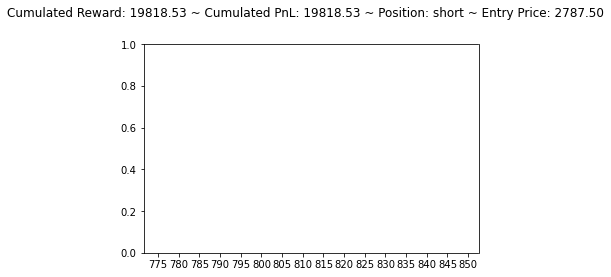

[1132.4957 1155.5902 1125.035 ]
short buy flat


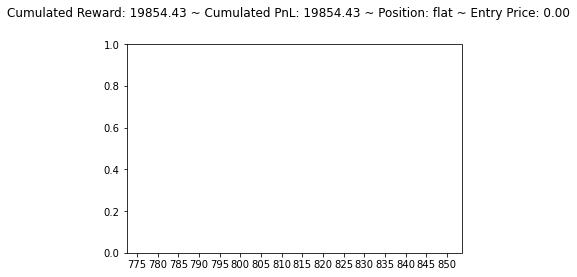

[1090.0995 1104.7424 1108.4009]
flat sell short


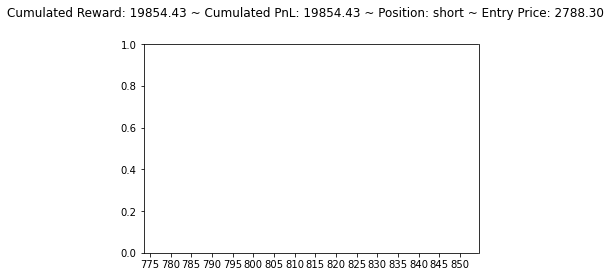

[1126.0402 1145.7157 1116.8369]
short buy flat


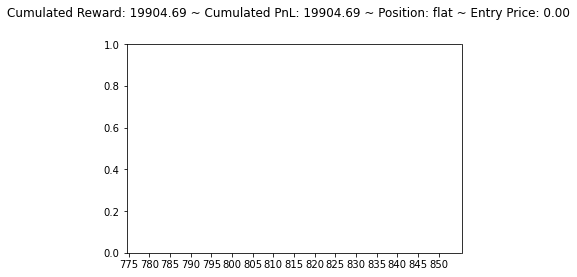

[1095.6898 1112.9961 1114.5466]
flat sell short


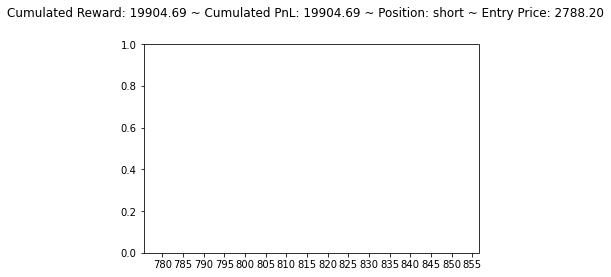

[1137.6099 1164.6119 1133.4836]
short buy flat


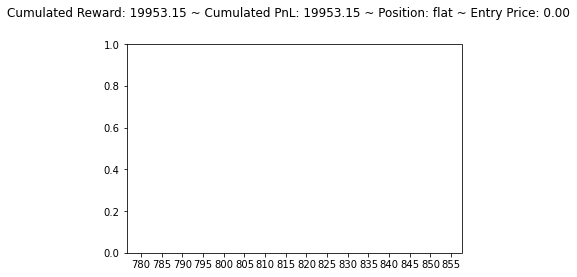

[1090.444  1105.1543 1109.3906]
flat sell short


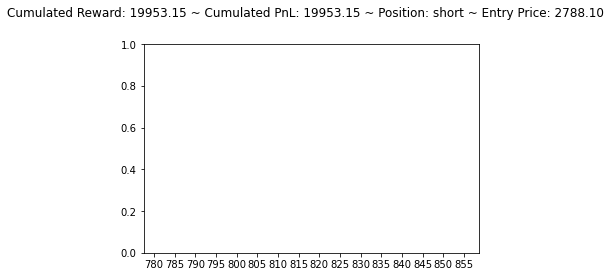

[1134.371  1158.2899 1127.3131]
short buy flat


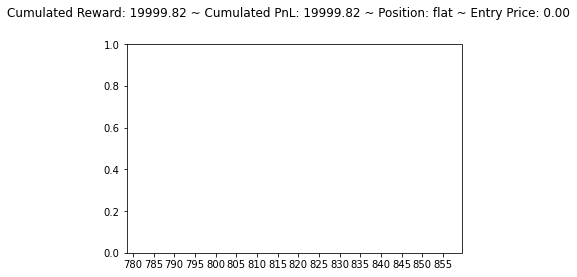

[1091.5958 1106.8142 1110.8984]
flat sell short


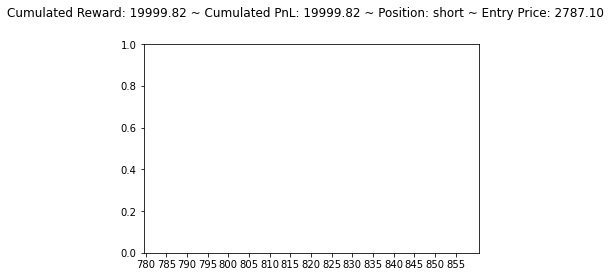

[1061.7953 1050.106  1037.3275]
short hold short


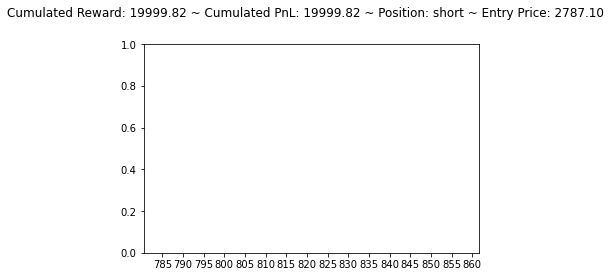

[1061.9067 1042.177  1028.5756]
short hold short


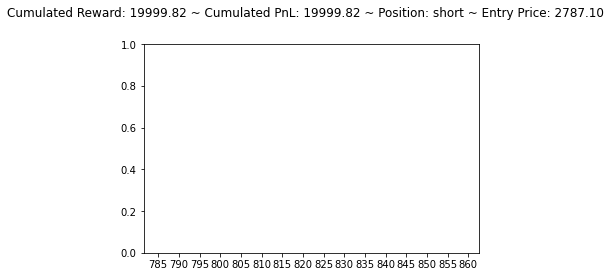

[1116.6398 1124.6875 1097.369 ]
short buy flat


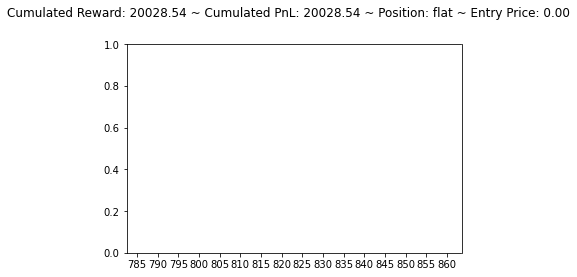

[1080.7662 1092.4956 1093.6959]
flat sell short


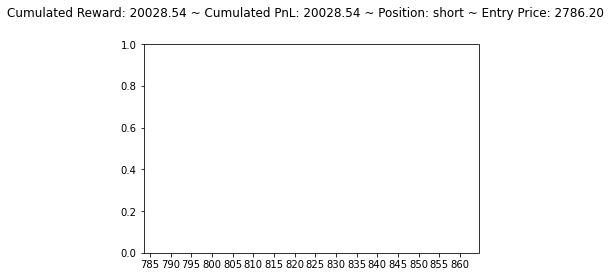

[1120.9849 1137.2307 1109.2917]
short buy flat


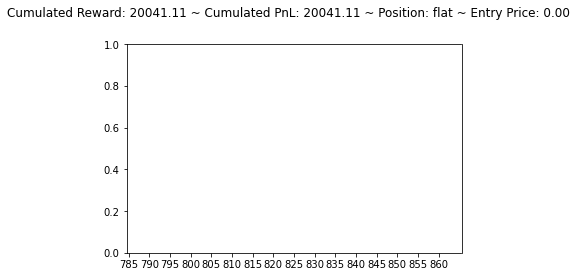

[1084.7263 1098.2502 1098.9424]
flat sell short


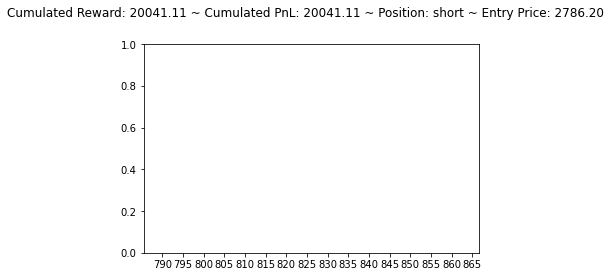

[1128.2758 1149.5146 1120.7762]
short buy flat


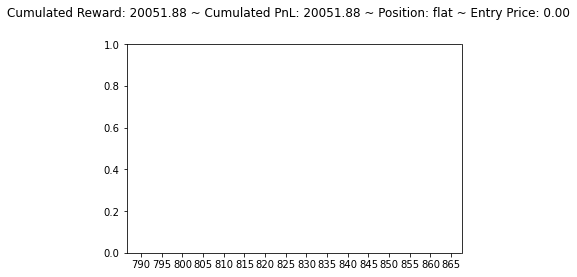

[1085.7318 1101.0177 1102.105 ]
flat sell short


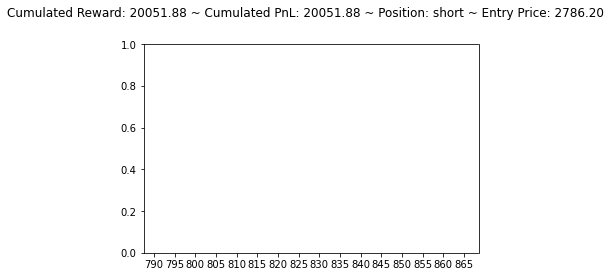

[1117.578  1133.3278 1106.3706]
short buy flat


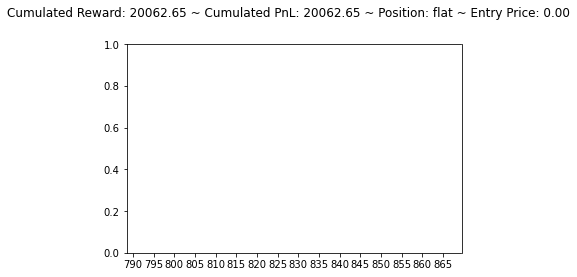

[1080.6659 1090.6069 1091.094 ]
flat sell short


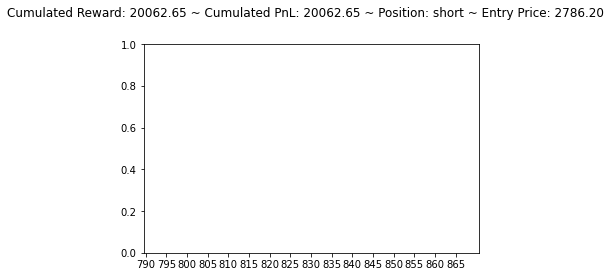

[1136.784  1161.6862 1130.1685]
short buy flat


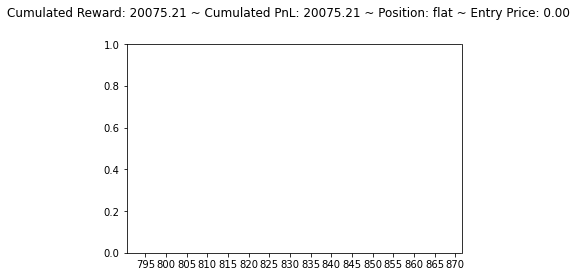

[1082.7673 1094.6573 1099.4137]
flat sell short


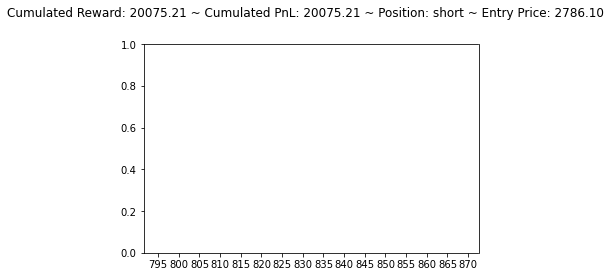

[1183.971  1231.4878 1191.1904]
short buy flat


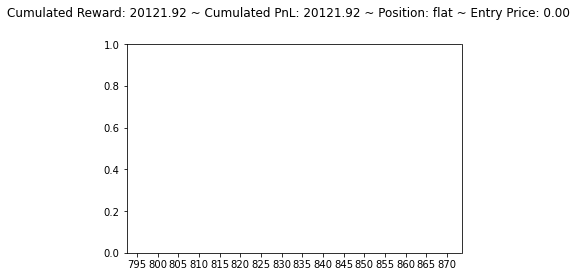

[1108.0513 1145.2675 1154.048 ]
flat sell short


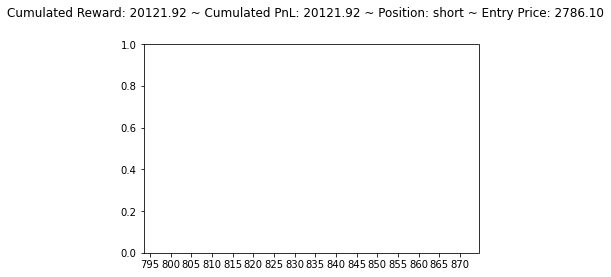

[1128.0568 1147.7705 1116.9462]
short buy flat


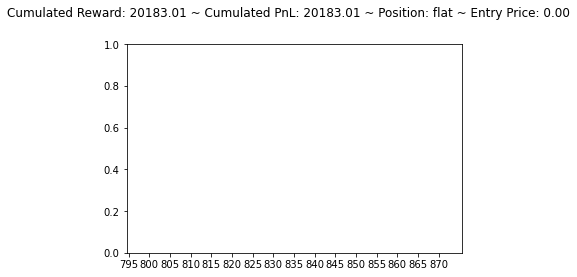

[1087.4891 1099.3737 1104.3535]
flat sell short


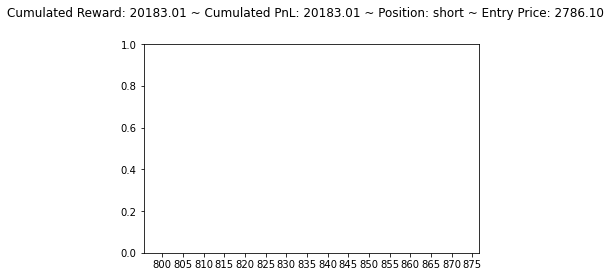

[1105.4186 1114.3181 1089.4141]
short buy flat


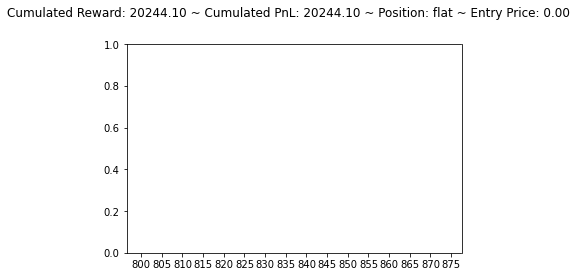

[1090.7427 1104.1799 1103.2462]
flat buy long


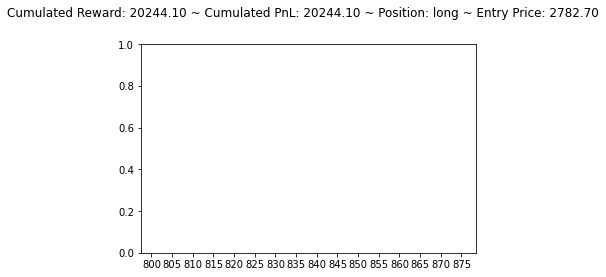

[1114.292  1128.468  1101.7986]
long hold long


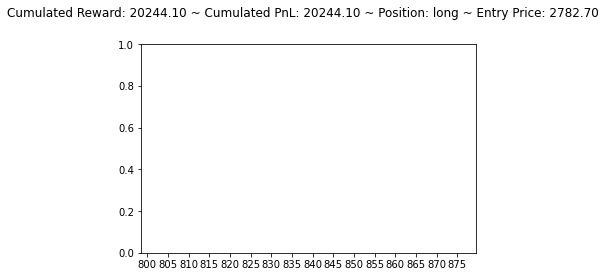

[1131.1079 1151.6909 1120.6145]
long hold long


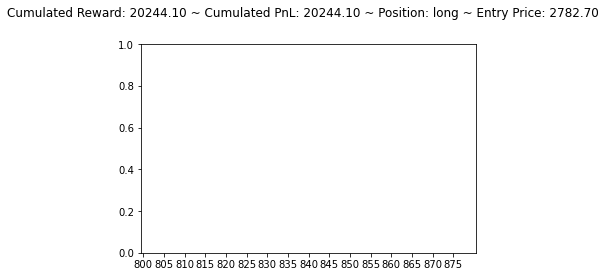

[1136.9591 1162.6447 1130.2098]
long hold long


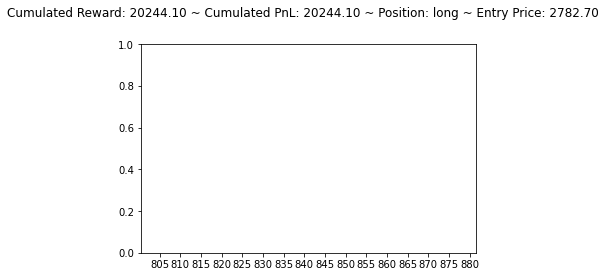

[1139.9089 1168.0449 1135.4246]
long hold long


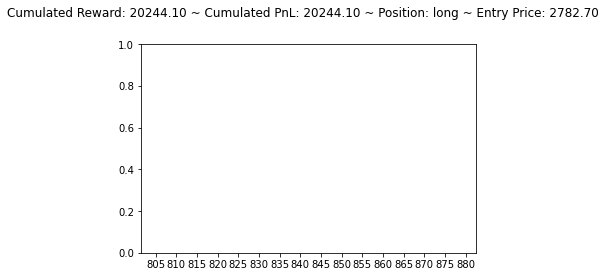

[1131.0985 1154.7759 1124.781 ]
long hold long


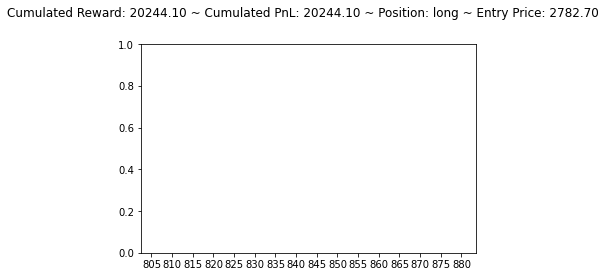

[1139.1487 1165.8218 1133.6893]
long hold long


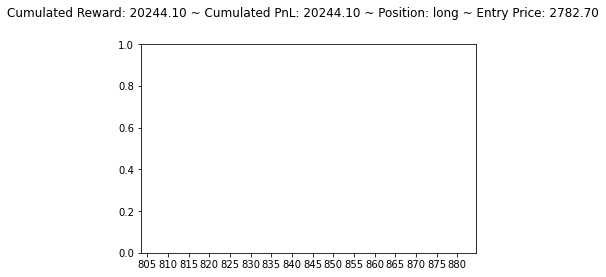

[1125.1023 1145.8434 1117.3228]
long hold long


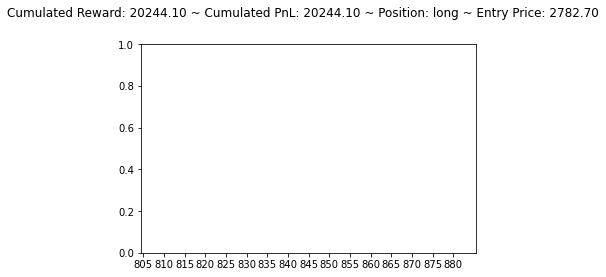

[1172.8651 1215.0687 1178.113 ]
long sell flat


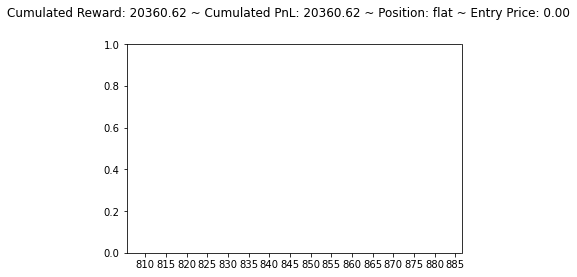

[1107.2211 1145.0618 1150.477 ]
flat sell short


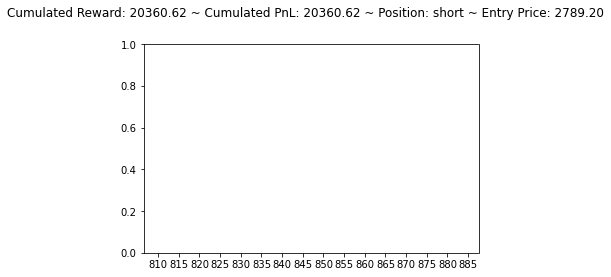

[1073.8214 1068.2848 1053.3611]
short hold short


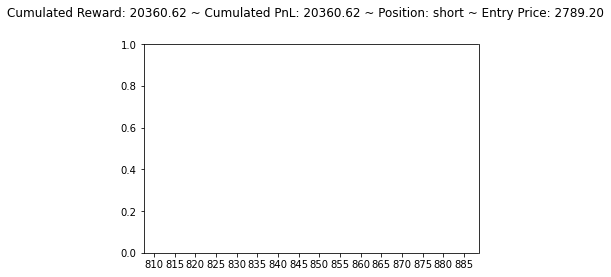

[1128.624  1143.7214 1114.2606]
short buy flat


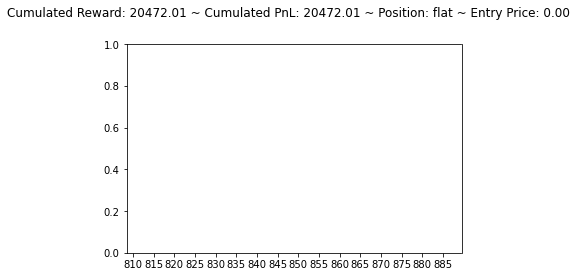

[1094.1046 1112.4814 1114.895 ]
flat sell short


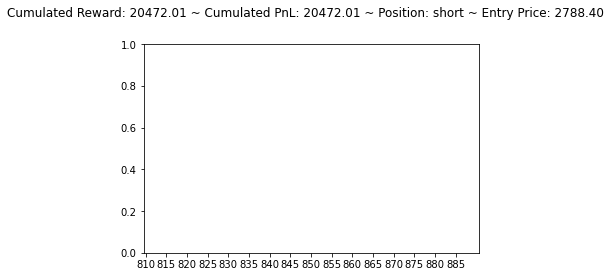

[1140.4271 1169.2347 1138.3884]
short buy flat


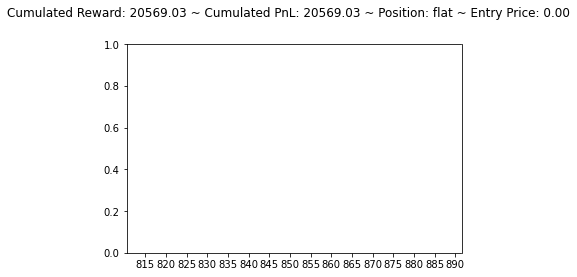

[1100.8909 1123.1029 1125.7737]
flat sell short


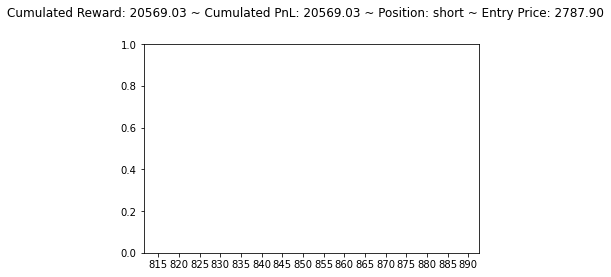

[1146.5732 1179.0886 1146.6896]
short buy flat


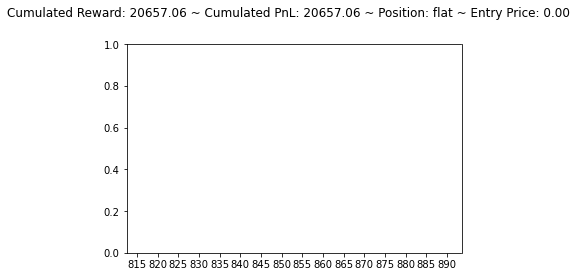

[1095.6665 1115.748  1119.9128]
flat sell short


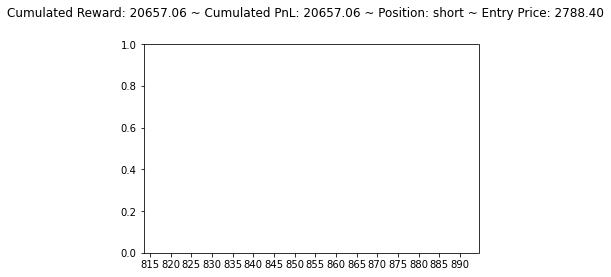

[1141.4637 1170.7441 1139.5918]
short buy flat


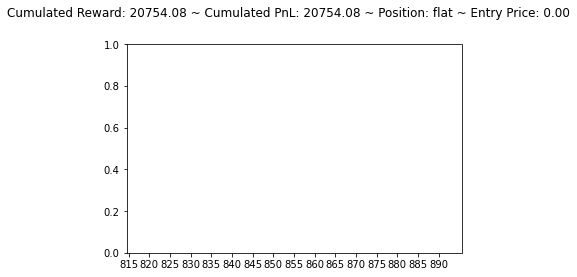

[1096.6174 1117.2053 1120.2363]
flat sell short


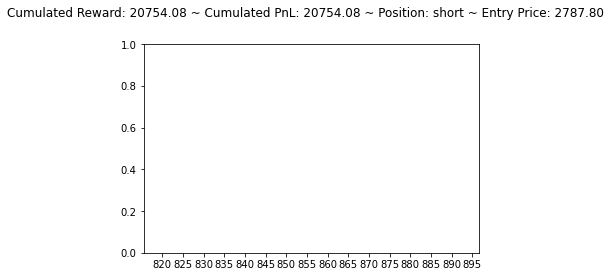

[1146.0986 1177.8464 1145.4653]
short buy flat


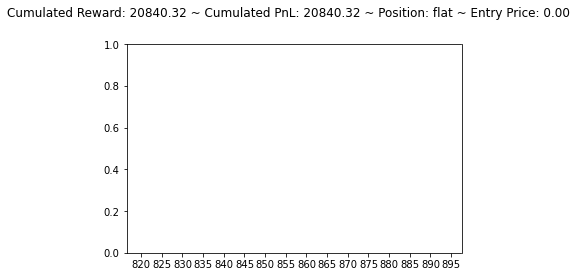

[1100.3909 1122.2402 1126.467 ]
flat sell short


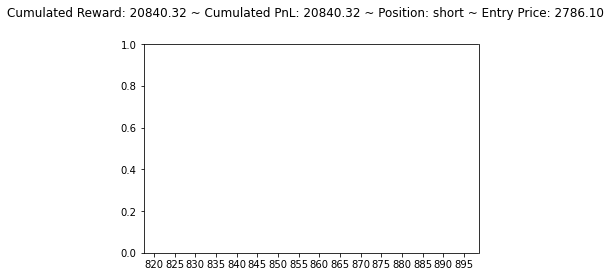

[1140.8856 1170.6304 1139.4689]
short buy flat


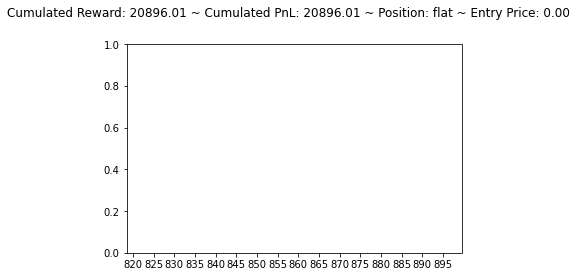

[1100.2922 1122.2803 1125.0818]
flat sell short


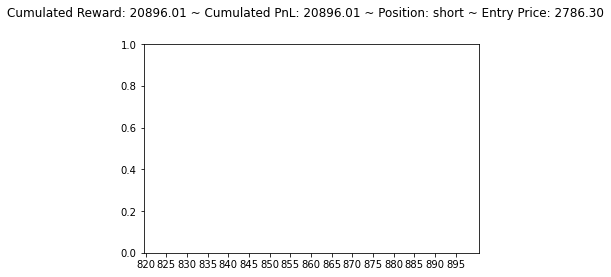

[1145.7137 1177.888  1145.5239]
short buy flat


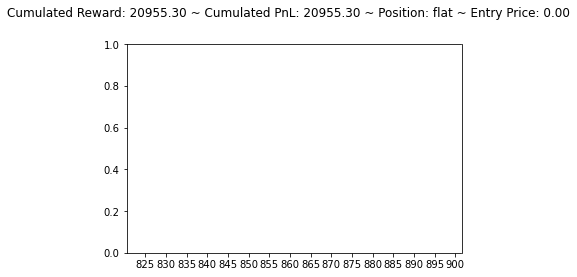

[1100.7352 1122.6339 1126.5558]
flat sell short


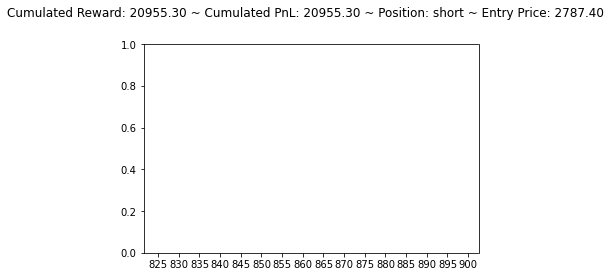

[1152.0623 1187.3495 1153.4661]
short buy flat


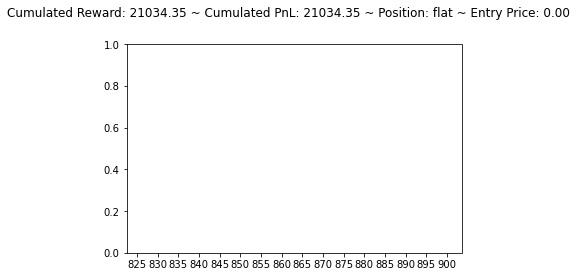

[1100.1974 1121.7744 1127.3673]
flat sell short


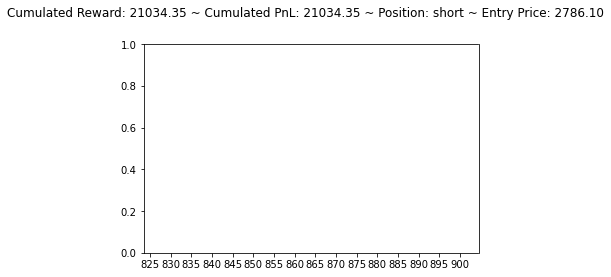

[1142.4535 1173.002  1141.1991]
short buy flat


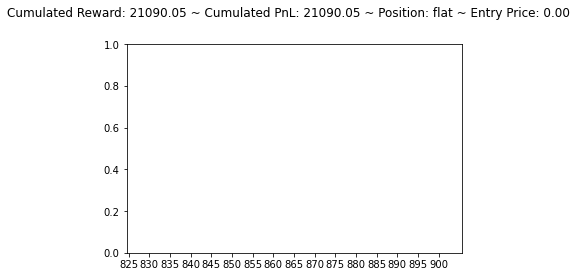

[1098.963  1119.0304 1123.0192]
flat sell short


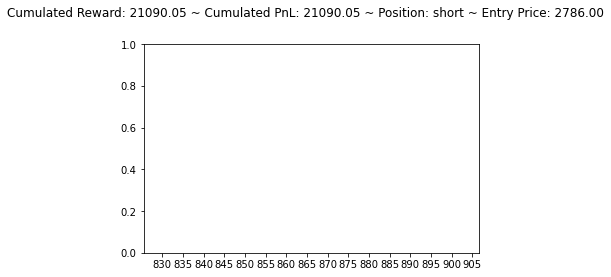

[1139.6388 1168.3188 1136.5133]
short buy flat


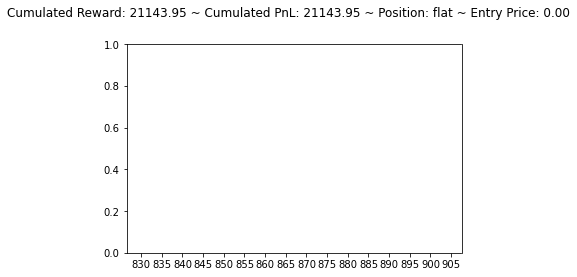

[1088.7131 1102.6006 1108.0348]
flat sell short


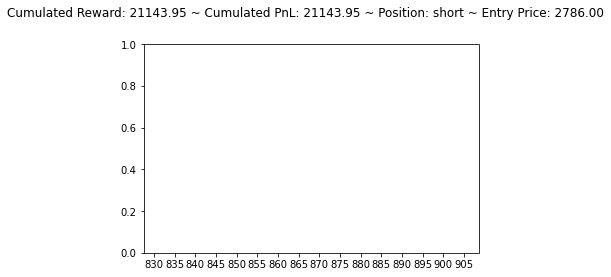

[1127.2584 1146.8896 1116.2645]
short buy flat


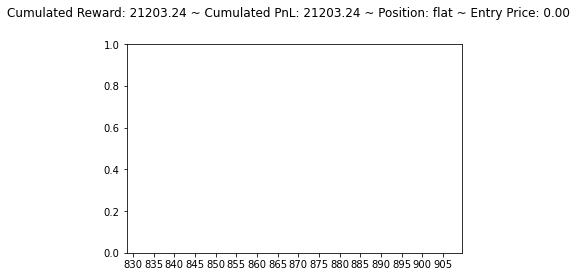

[1089.3362 1101.3206 1106.2783]
flat sell short


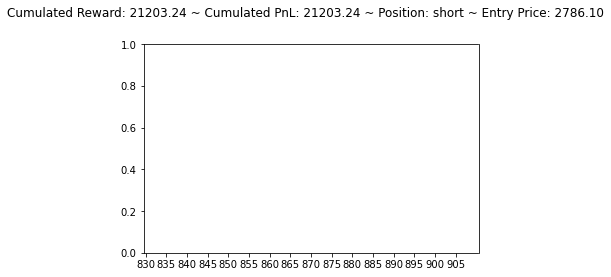

[1124.9899 1143.9355 1113.936 ]
short buy flat


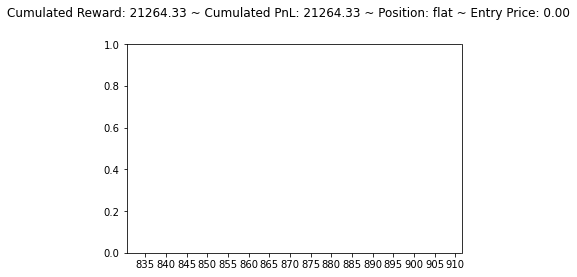

[1083.8899 1094.0562 1098.4249]
flat sell short


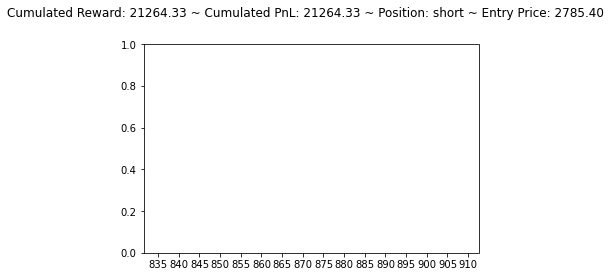

[1134.7865 1157.9159 1126.1259]
short buy flat


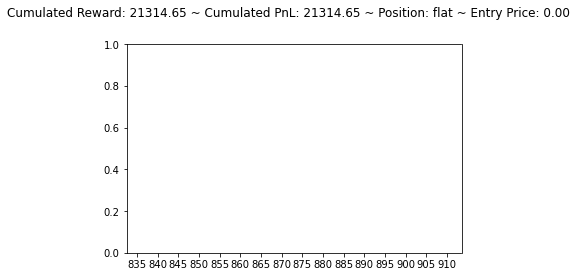

[1096.3484 1115.6592 1119.653 ]
flat sell short


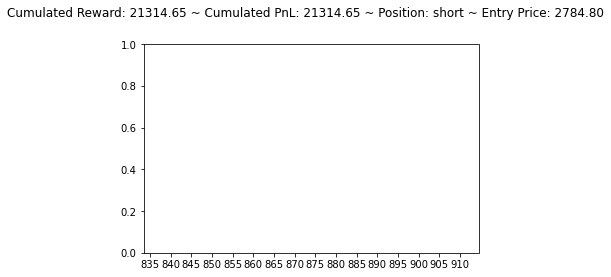

[1146.8894 1178.9729 1145.5396]
short buy flat


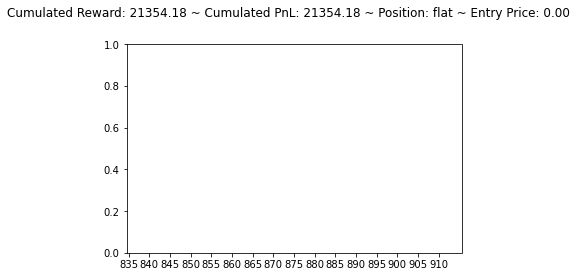

[1100.8197 1121.3479 1127.004 ]
flat sell short


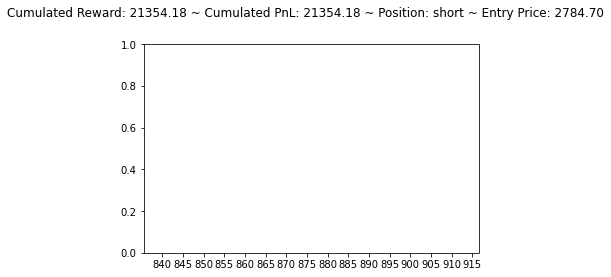

[1143.4459 1174.0696 1141.2368]
short buy flat


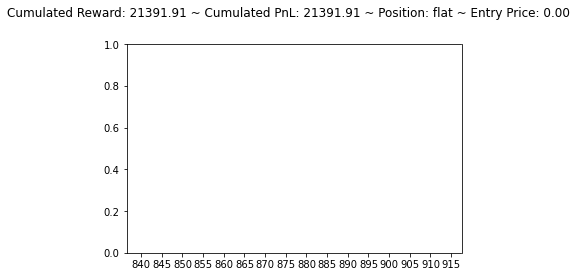

[1090.5895 1105.9357 1112.1019]
flat sell short


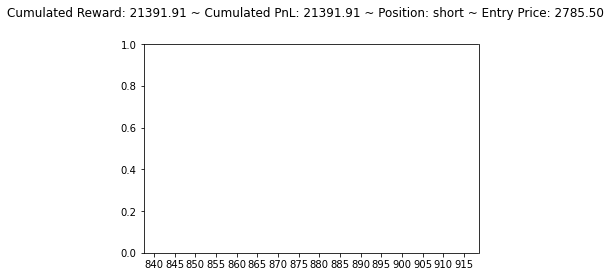

[1122.983  1140.5481 1110.774 ]
short buy flat


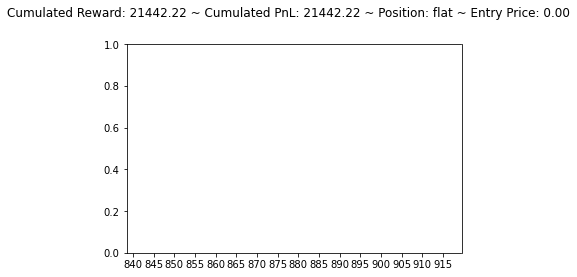

[1094.2587 1108.7892 1112.048 ]
flat sell short


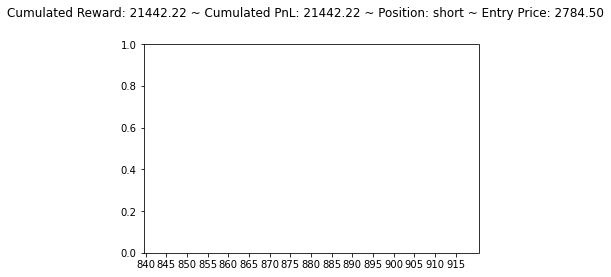

[1143.1727 1173.51   1140.7169]
short buy flat


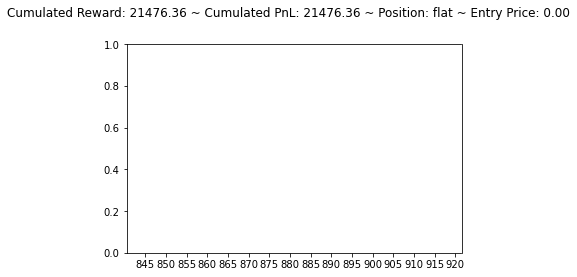

[1089.2885 1105.1866 1110.4058]
flat sell short


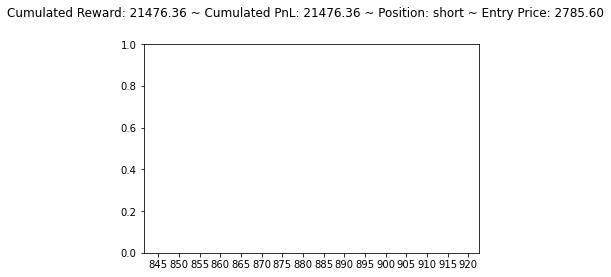

[1137.8014 1164.2671 1132.8064]
short buy flat


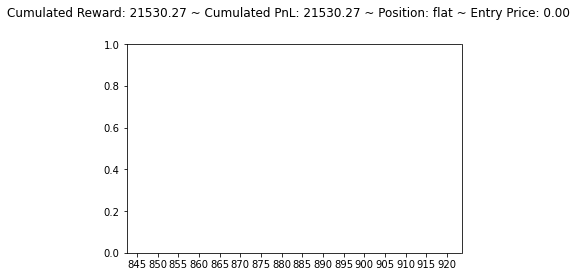

[1098.472  1117.8501 1121.8358]
flat sell short


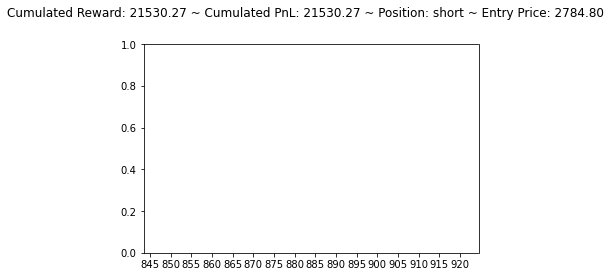

[1143.0372 1173.3085 1140.5656]
short buy flat


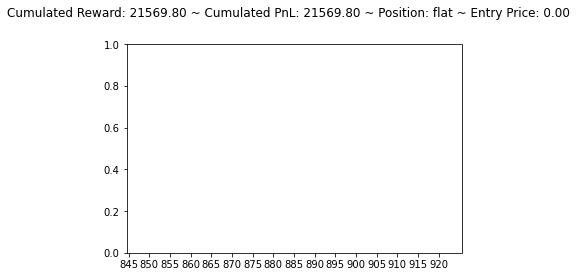

[1097.5737 1116.3848 1121.477 ]
flat sell short


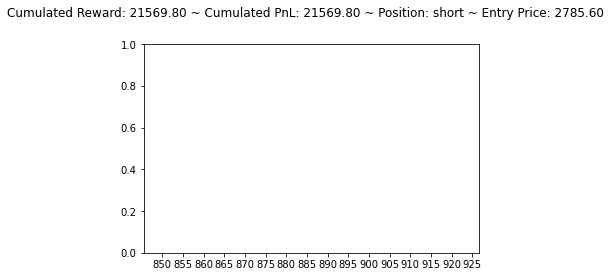

[1144.8491 1175.7747 1142.6027]
short buy flat


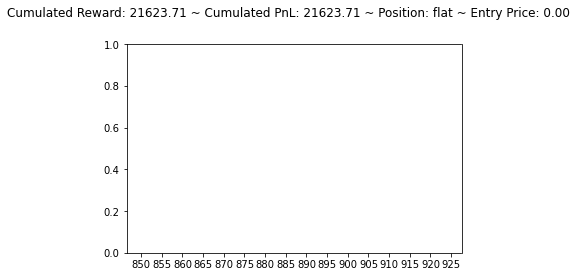

[1092.4084 1108.3281 1114.8947]
flat sell short


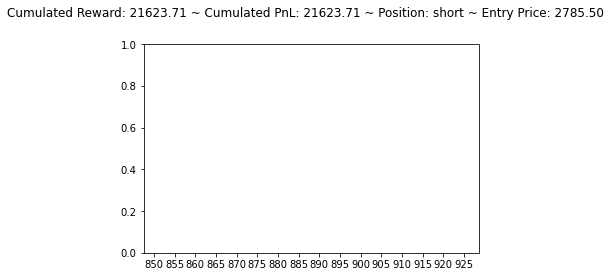

[1126.4149 1145.3173 1114.9668]
short buy flat


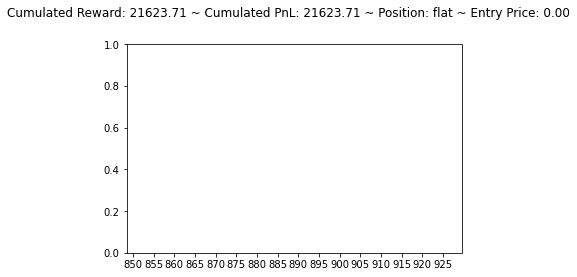

[1084.8907 1094.345  1099.3601]
flat sell short


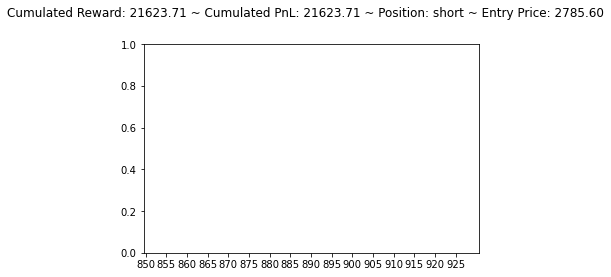

[1126.2465 1145.2422 1114.2468]
short buy flat


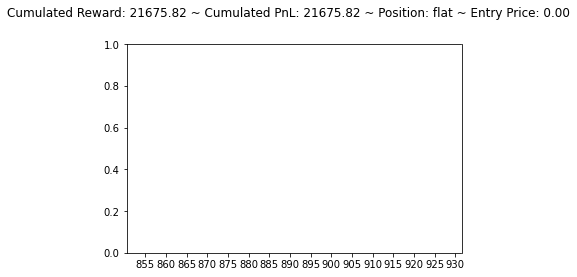

[1085.698  1096.063  1101.2792]
flat sell short


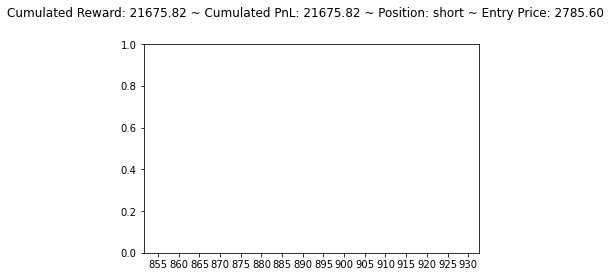

[1123.6798 1141.4138 1111.4773]
short buy flat


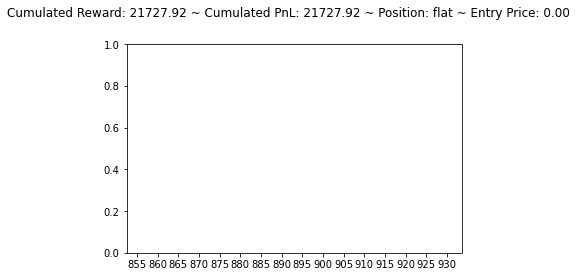

[1088.1993 1099.4758 1103.8615]
flat sell short


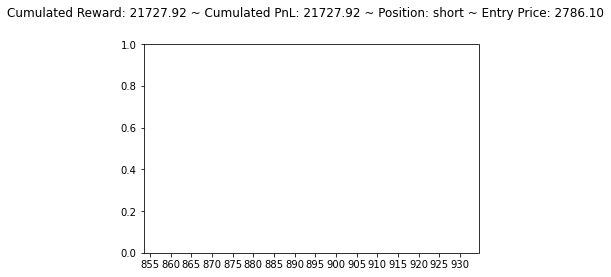

[1129.8546 1150.9215 1119.488 ]
short buy flat


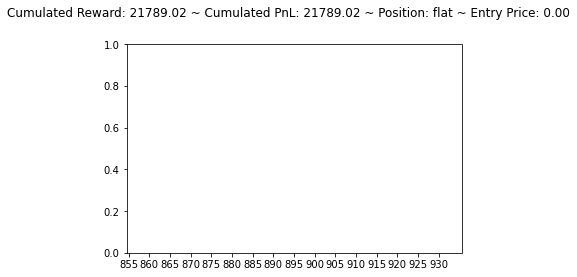

[1082.732  1091.7769 1097.8076]
flat sell short


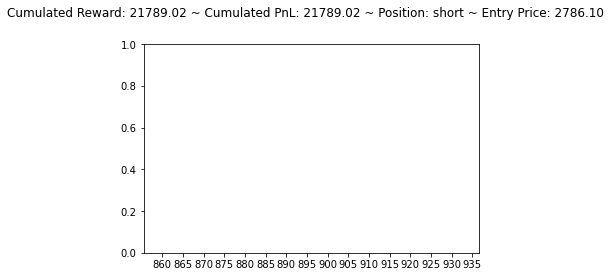

[1116.5558 1130.3362 1102.1678]
short buy flat


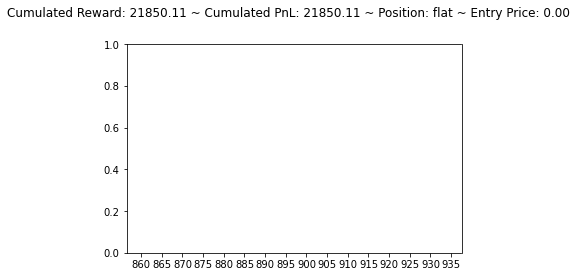

[1082.5681 1091.9661 1094.7727]
flat sell short


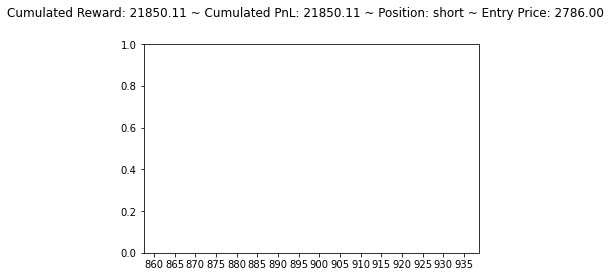

[1120.1671 1135.758  1106.6738]
short buy flat


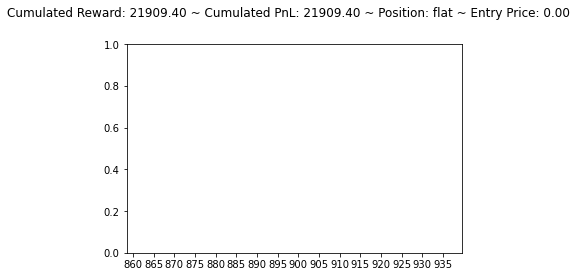

[1079.8209 1088.1079 1091.8739]
flat sell short


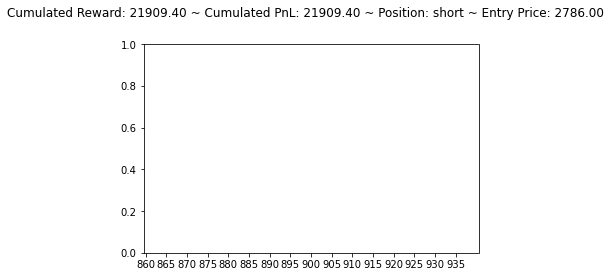

[1122.7405 1139.215  1109.416 ]
short buy flat


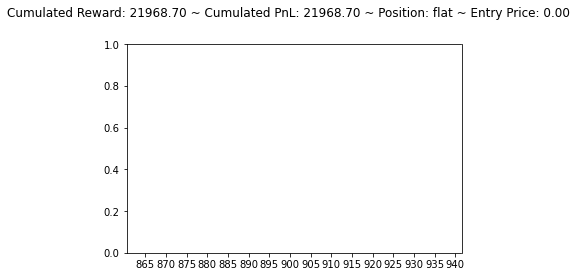

[1082.4064 1091.467  1095.9655]
flat sell short


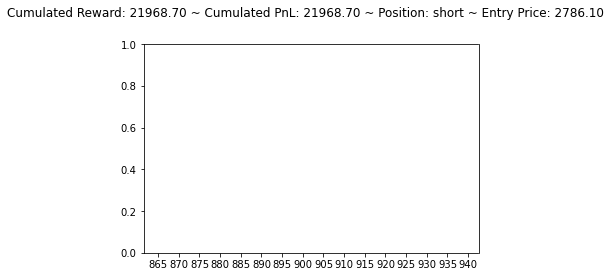

[1128.9943 1148.8652 1117.5287]
short buy flat


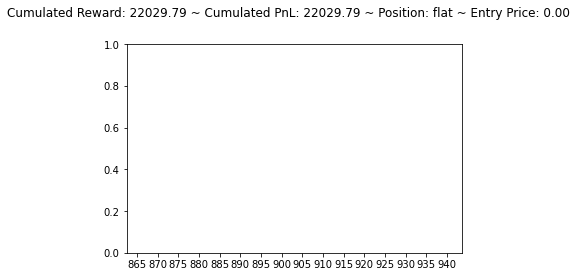

[1096.0874 1110.8542 1115.8323]
flat sell short


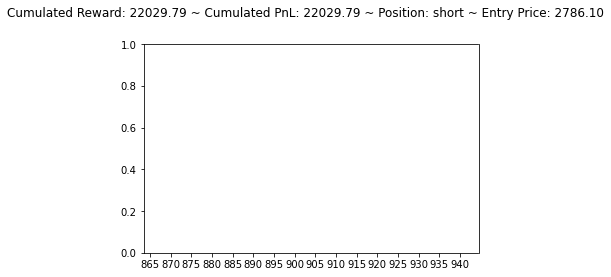

[1126.8976 1149.4441 1120.9004]
short buy flat


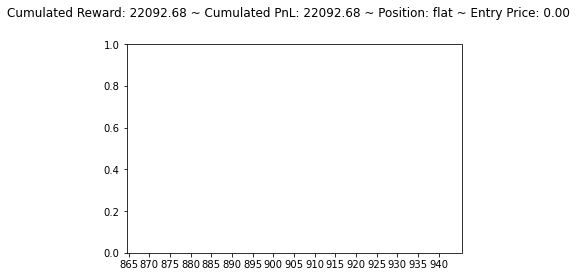

[1083.2102 1097.5195 1098.6621]
flat sell short


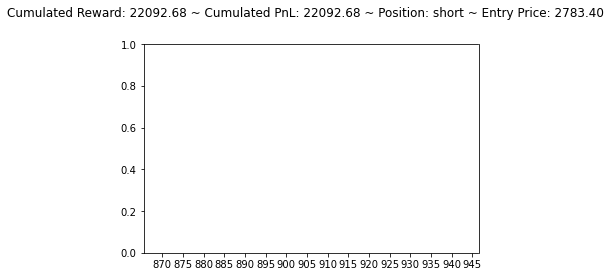

[1132.5677 1156.0107 1124.8062]
short buy flat


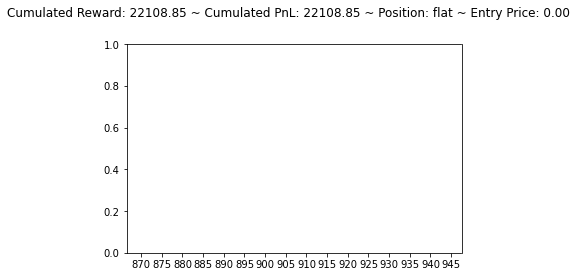

[1083.9899 1095.3134 1099.6155]
flat sell short


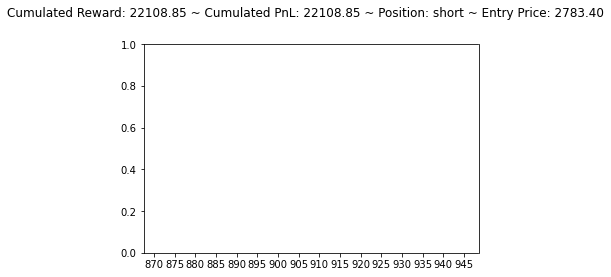

[1134.5297 1160.3279 1130.5106]
short buy flat


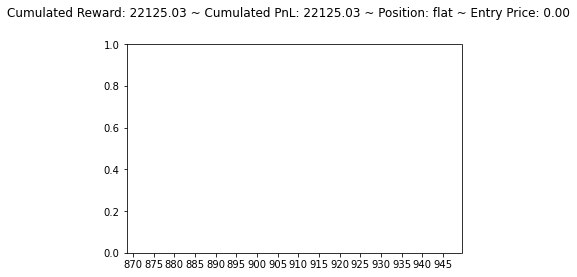

[1079.2046 1092.8203 1095.6112]
flat sell short


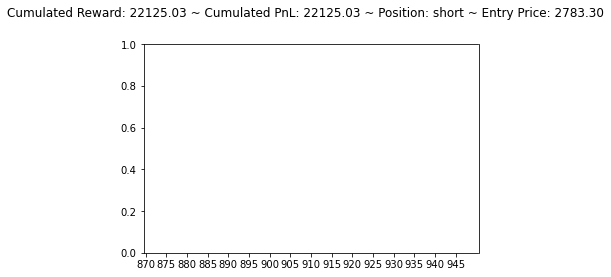

[1110.0803 1119.8948 1092.958 ]
short buy flat


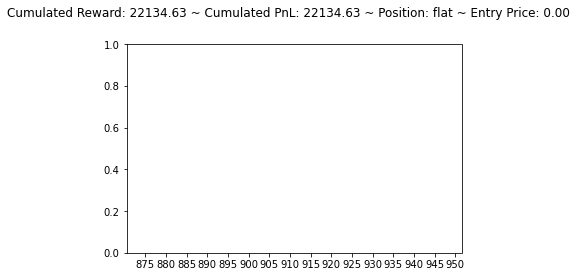

[1070.0726 1074.6609 1076.6227]
flat sell short


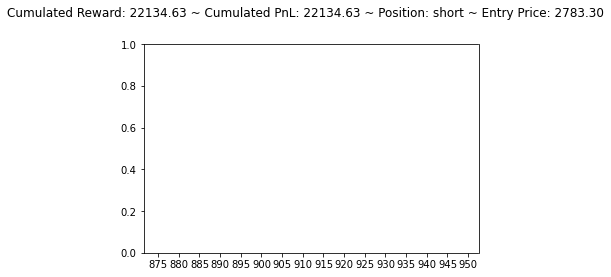

[1124.4175 1140.4377 1109.7755]
short buy flat


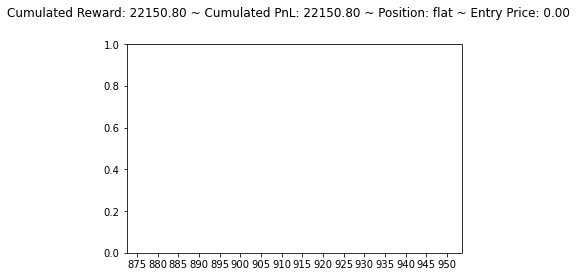

[1076.9154 1085.5168 1090.2631]
flat sell short


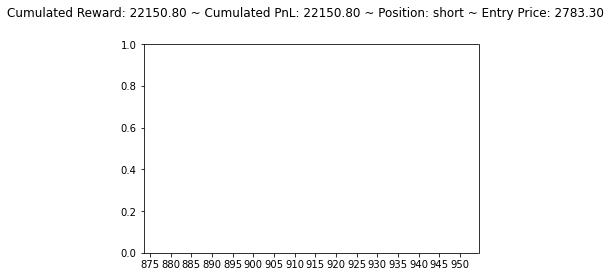

[1116.0436 1129.6399 1101.8533]
short buy flat


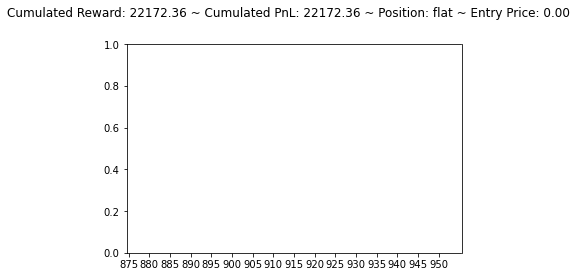

[1080.0312 1090.5515 1091.9534]
flat sell short


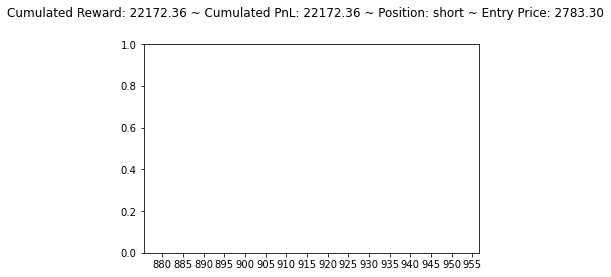

[1122.0104 1139.7168 1111.3203]
short buy flat


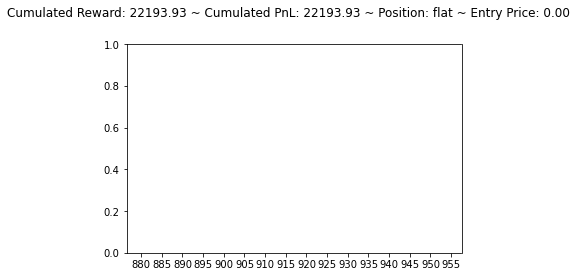

[1083.2946 1096.3936 1097.8231]
flat sell short


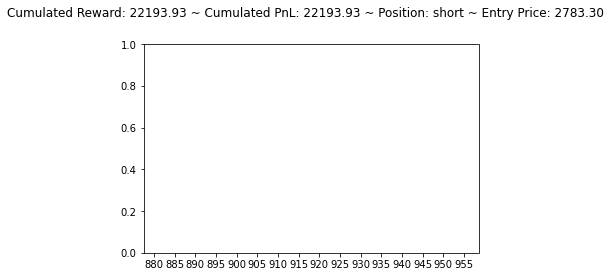

[1128.5679 1150.0801 1120.7534]
short buy flat


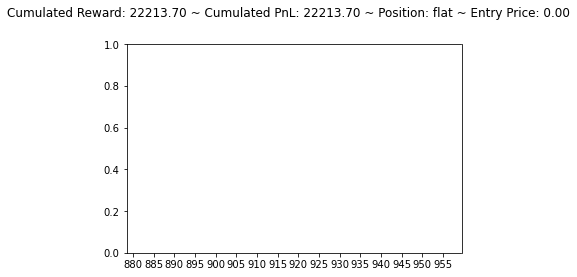

[1087.1968 1103.6812 1105.2662]
flat sell short


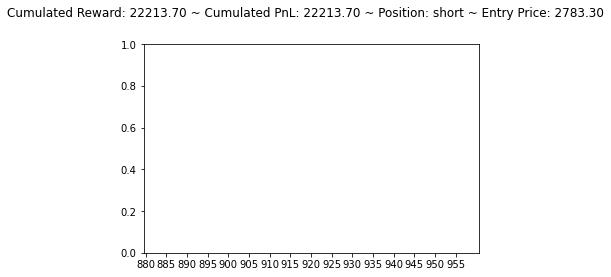

[1129.6447 1152.2958 1122.9548]
short buy flat


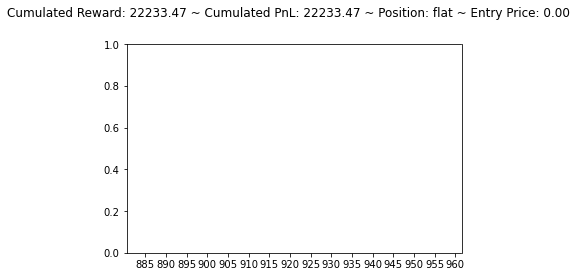

[1089.628  1107.1675 1108.4879]
flat sell short


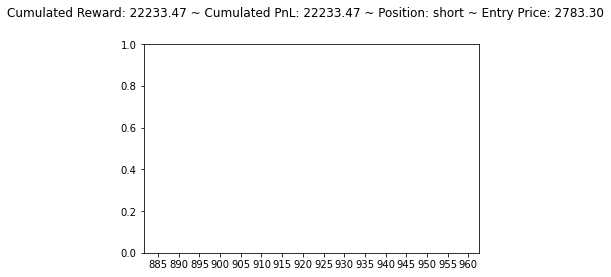

[1143.3345 1173.5801 1141.4258]
short buy flat


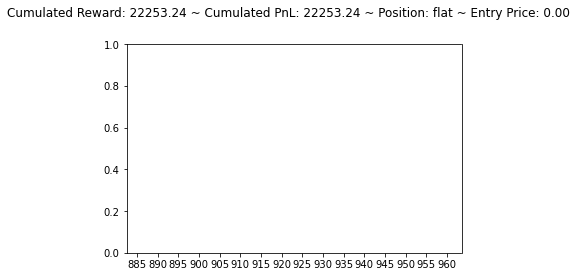

[1089.173  1107.2468 1111.0963]
flat sell short


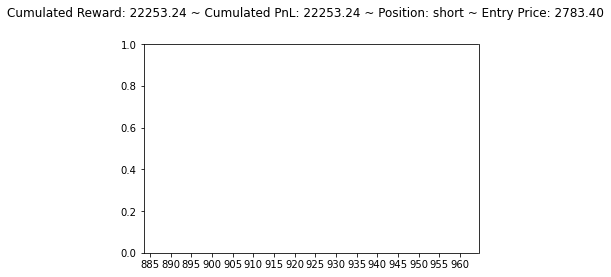

[1149.3741 1182.354  1148.6393]
short buy flat


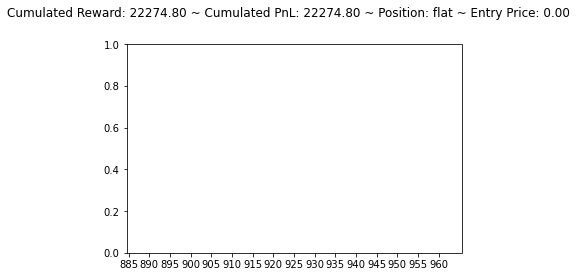

[1085.8414 1101.8038 1107.7493]
flat sell short


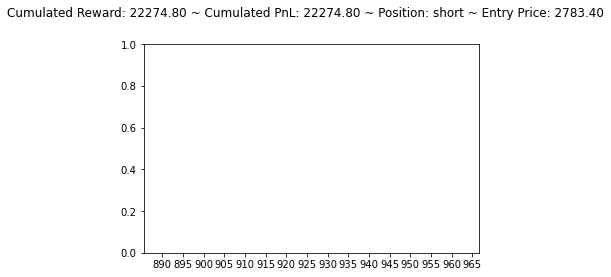

[1116.1008 1131.4053 1104.4717]
short buy flat


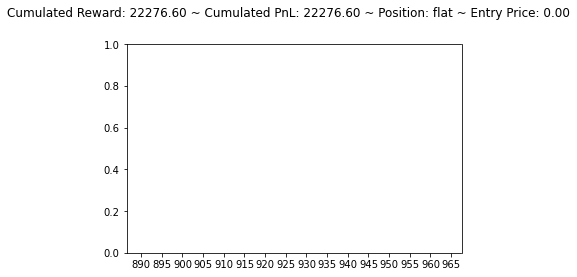

[1071.086  1076.9175 1078.3948]
flat sell short


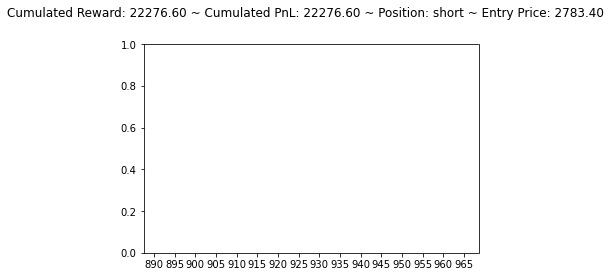

[1107.7787 1115.8544 1089.3359]
short buy flat


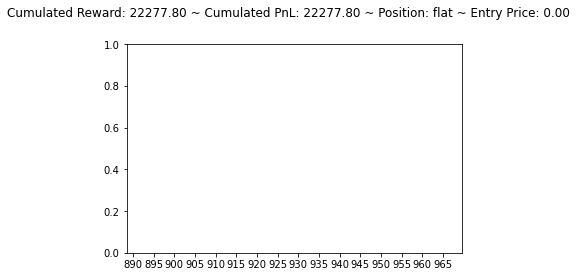

[1070.7273 1075.9968 1077.2218]
flat sell short


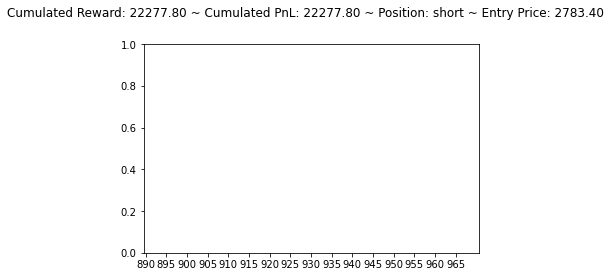

[1121.0167 1135.8464 1107.0907]
short buy flat


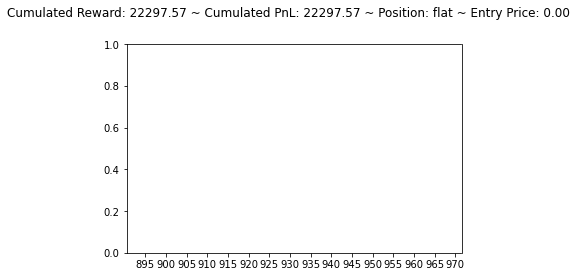

[1088.0393 1105.2089 1105.9918]
flat sell short


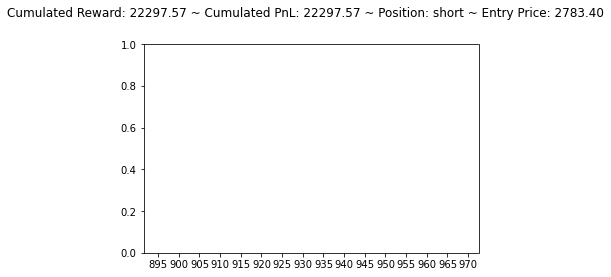

[1116.2986 1133.1768 1106.6561]
short buy flat


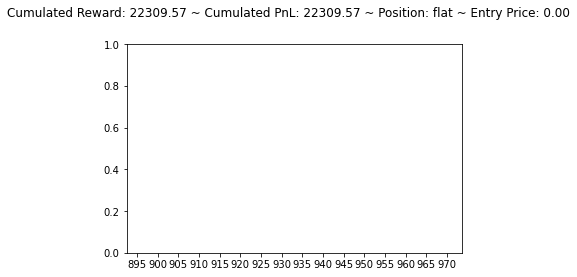

[1081.325  1091.46   1091.4834]
flat sell short


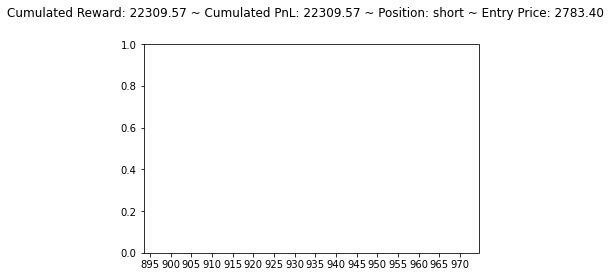

[1129.9491 1153.0143 1123.9526]
short buy flat


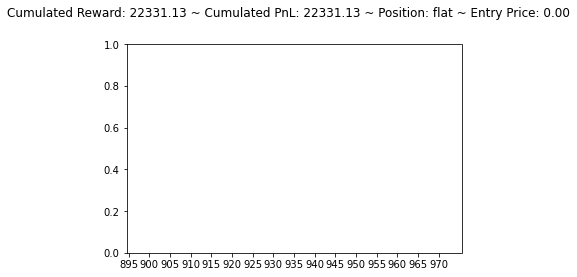

[1086.1984 1102.8544 1104.0275]
flat sell short


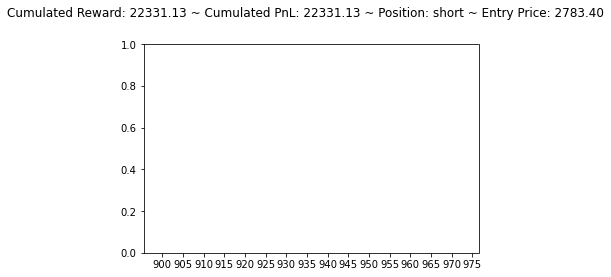

[1132.0302 1155.6732 1126.1041]
short buy flat


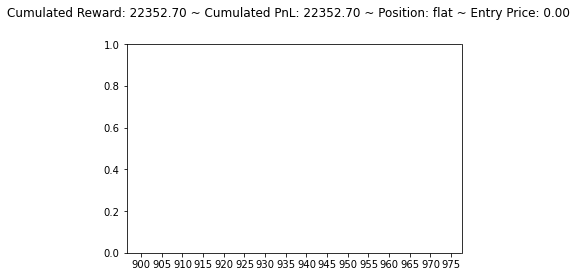

[1090.6503 1110.2856 1111.2727]
flat sell short


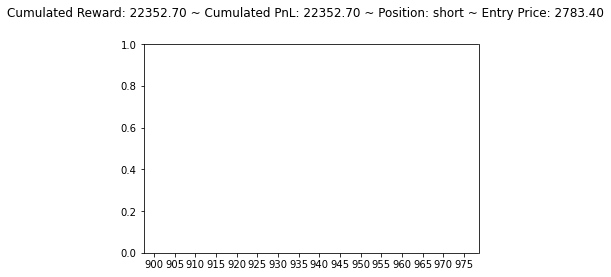

[1152.3574 1186.9722 1152.7788]
short buy flat


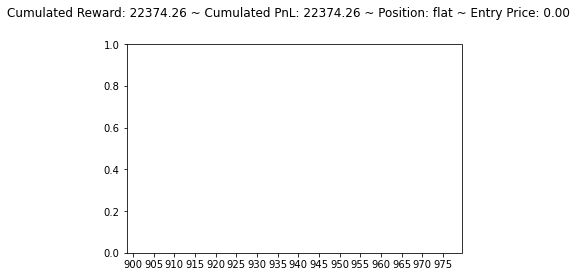

[1091.3821 1110.35   1116.1058]
flat sell short


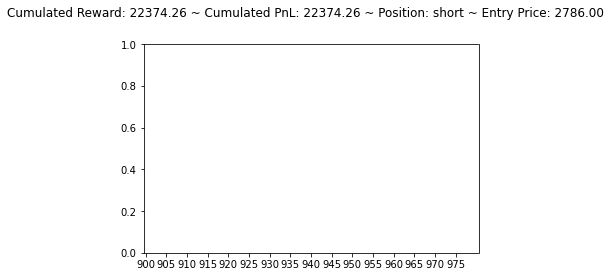

[1117.6969 1135.2723 1108.7573]
short buy flat


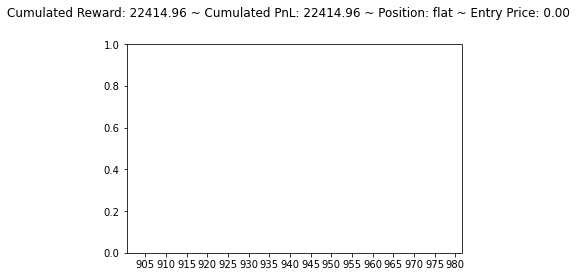

[1071.5808 1076.5901 1078.2502]
flat sell short


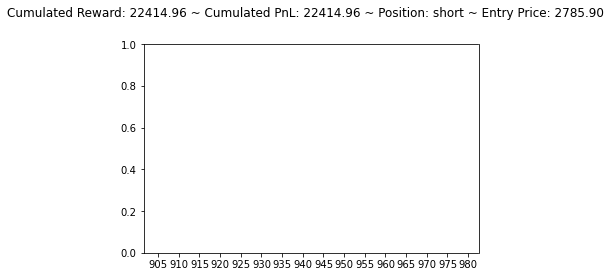

[1109.6656 1118.5813 1091.69  ]
short buy flat


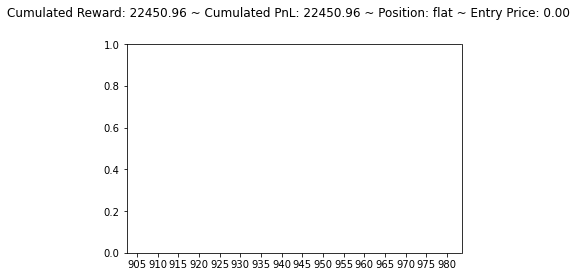

[1087.2162 1099.618  1099.826 ]
flat sell short


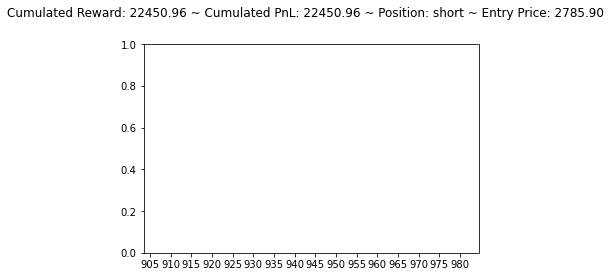

[1138.3055 1166.7383 1136.8035]
short buy flat


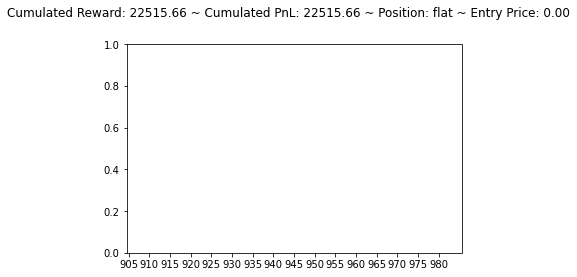

[1097.1472 1120.1333 1120.8335]
flat sell short


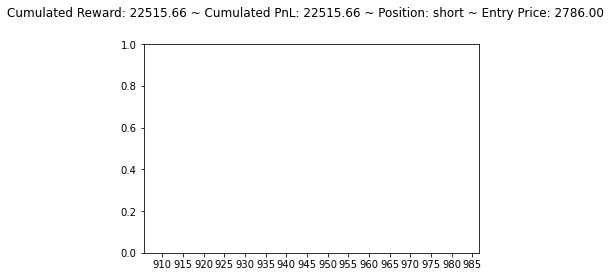

[1145.5917 1178.602  1147.7975]
short buy flat


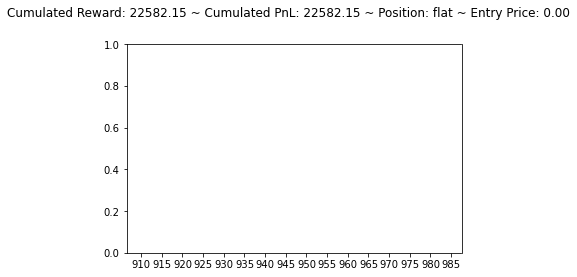

[1113.6646 1144.5015 1145.4803]
flat sell short


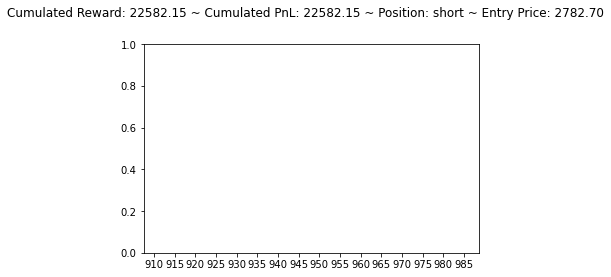

[1091.2231 1099.6512 1082.4534]
short buy flat


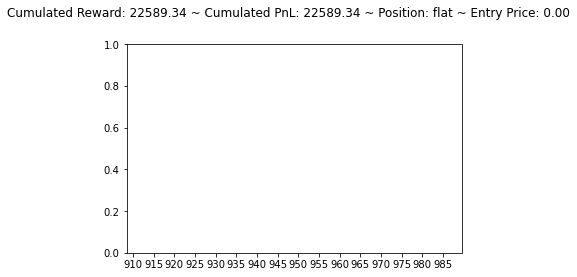

[1096.5101 1122.2439 1109.3373]
flat buy long


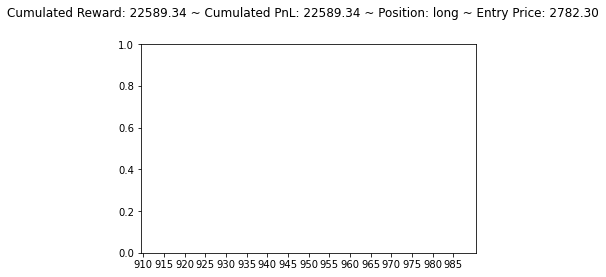

[1119.968  1140.955  1114.4829]
long hold long


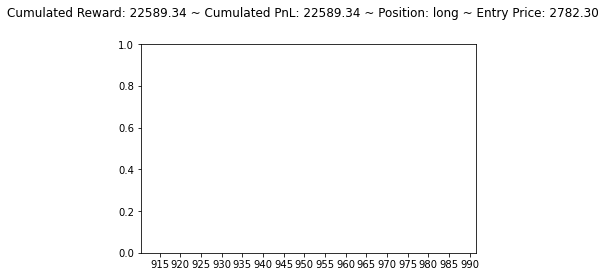

[1120.0934 1134.267  1105.69  ]
long hold long


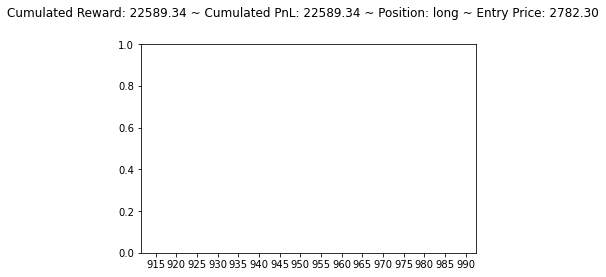

[1114.141  1129.3895 1103.1619]
long hold long


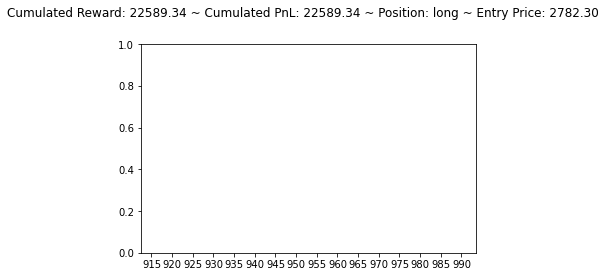

[1119.6487 1133.5227 1104.9867]
long hold long


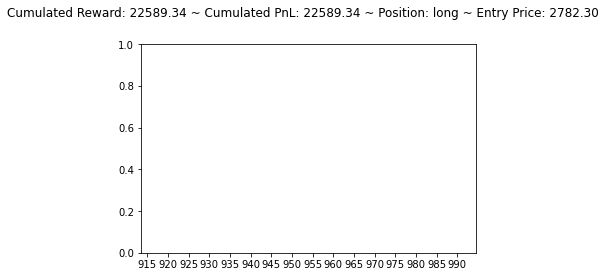

[1145.381  1175.8394 1142.7119]
long hold long


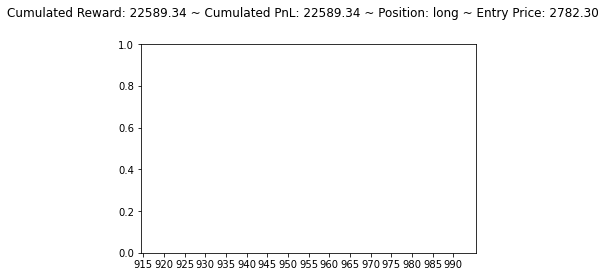

[1147.289  1180.6438 1147.2896]
long sell flat


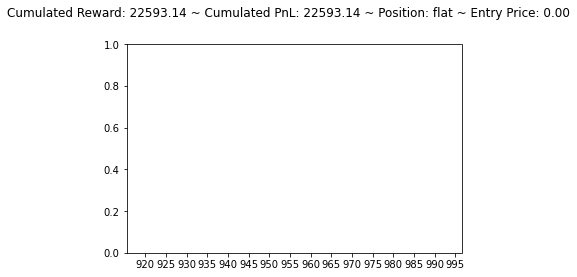

[1090.8969 1106.5154 1113.5271]
flat sell short


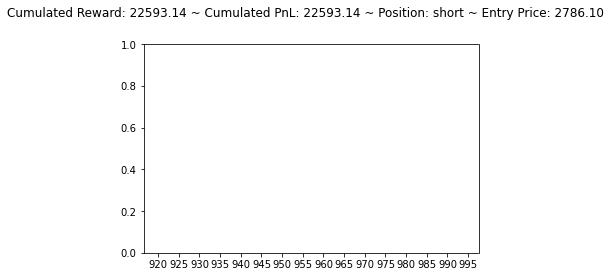

[1126.829  1145.3469 1114.2968]
short buy flat


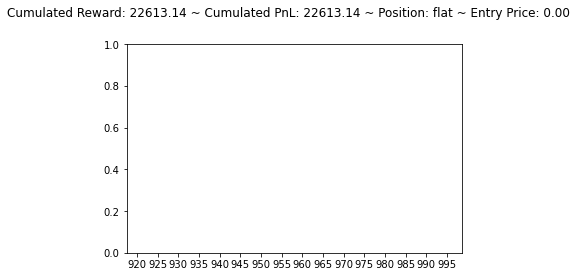

[1097.267  1112.0474 1116.6373]
flat sell short


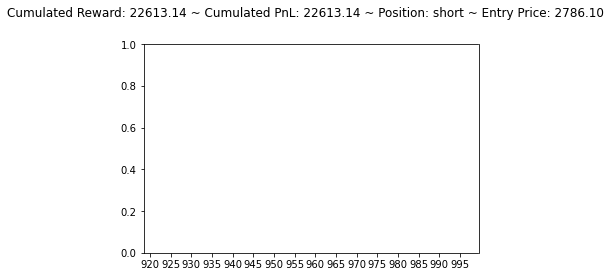

[1076.0349 1073.6627 1058.3188]
short hold short


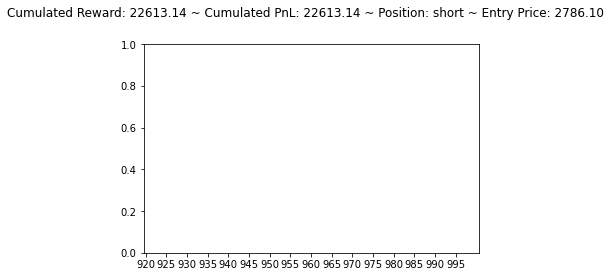

In [17]:
# Running the agent
done = False
state = environment.reset()
while not done:
    action = agent.act(np.asarray(state).astype('float32'))
    
    for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            position_name = position
        
    for _action in environment._actions:
          if all(action==environment._actions[_action]):
            action_name = _action
    
    state, _, done, info = environment.step(action)
    
    for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            next_position_name = position
               
    print(position_name, action_name, next_position_name)
    
    if 'status' in info and info['status'] == 'Closed plot':
        done = True
    else:
        try:
            environment.render()
        except TypeError as e:
            print(e)
            continue